# Evaluation Script for Vertical Bar Plots

In [ ]:
import tensorflow
print(tensorflow.__version__) # 2.6.0

2021-10-25 14:54:23.014151: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2021-10-25 14:54:23.014164: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


2.6.0


In [ ]:
# Load the binary classifier

# Running Sequence
# Terminate Session
# Tapas -> Reset
# Load Classifier -> Reset
# Tapas -> No Reset

In [ ]:
!pip install tensorflow==2.6

  Using cached tensorflow-2.6.0-cp37-cp37m-manylinux2010_x86_64.whl (458.3 MB)
  Using cached tensorboard-2.7.0-py3-none-any.whl (5.8 MB)
  Using cached gast-0.4.0-py3-none-any.whl (9.8 kB)
  Using cached numpy-1.19.5-cp37-cp37m-manylinux2010_x86_64.whl (14.8 MB)
  Using cached h5py-3.1.0-cp37-cp37m-manylinux1_x86_64.whl (4.0 MB)
  Using cached tensorflow_estimator-2.6.0-py2.py3-none-any.whl (462 kB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.18.5
    Uninstalling numpy-1.18.5:
      Successfully uninstalled numpy-1.18.5
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.2.0
    Uninstalling tensorflow-estimator-2.2.0:
      Successfully uninstalled tensorflow-estimator-2.2.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.2.2
    Uninstalling tensorboard-2.2.2:
      Successfully uninstalled tensorboard-2.2.2
  Attempting uninstall: h5py
    Found existing installation: h5p

In [ ]:
import tensorflow
from tensorflow import keras
from tensorflow.keras.preprocessing.sequence import pad_sequences
import pickle

2021-10-25 14:58:25.171918: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2021-10-25 14:58:25.171930: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [ ]:
model = tensorflow.keras.models.load_model('/home/pessat/Capstone/Binary_Classifier/binary_classifier.h5')

with open('/home/pessat/Capstone/Binary_Classifier/tokenizer.pickle', 'rb') as handle:
    loaded_tokenizer = pickle.load(handle)

2021-10-25 14:58:26.095254: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2021-10-25 14:58:26.095273: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2021-10-25 14:58:26.095285: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (pessat163): /proc/driver/nvidia/version does not exist
2021-10-25 14:58:26.095480: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
def binary_classifier_predict(questions):
  maxlen = 100
  seq= loaded_tokenizer.texts_to_sequences(questions)
  padded = pad_sequences(seq, maxlen=maxlen)
  predictions = model.predict(padded)

  result = []
  for e in predictions:
    result.append(e[0])

  THRESHOLD = 0.5
  tapas_questions = []
  tabfact_questions = []
  for i in range(len(result)):
      # print("Question = ", questions[i])

      # Class 0
      if result[i] < THRESHOLD:
          # print("Class 0: Tabfact")
          tabfact_questions.append(questions[i])

      else:
          # print("Class 1: Tapas")
          tapas_questions.append(questions[i])

  return tapas_questions, tabfact_questions

In [ ]:
binary_classifier_predict(
    ['How many different coloured dotlines are there ?' ,
'Is the number of dotlines equal to the number of legend labels ?' ,
'What is the number of tourist arrivals in 1997 ?' ,
'Across all years, what is the maximum number of tourist arrivals ?' ,
'Across all years, what is the minimum number of tourist departures ?' ,
'In which year was the number of tourist arrivals maximum?' ,
'In which year was the number of tourist departures minimum?' ,
'What is the total number of tourist departures in the graph ?']
) # returns tapas_questions and tabfact_questions

2021-10-25 14:58:28.059826: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


(['How many different coloured dotlines are there ?',
  'What is the number of tourist arrivals in 1997 ?',
  'Across all years, what is the maximum number of tourist arrivals ?',
  'Across all years, what is the minimum number of tourist departures ?',
  'In which year was the number of tourist arrivals maximum?',
  'In which year was the number of tourist departures minimum?',
  'What is the total number of tourist departures in the graph ?'],
 ['Is the number of dotlines equal to the number of legend labels ?'])

## Download TAPAS

In [ ]:
! pip install tapas-table-parsing

  Using cached tensorflow-2.2.3-cp37-cp37m-manylinux2010_x86_64.whl (516.4 MB)


  Using cached numpy-1.18.5-cp37-cp37m-manylinux1_x86_64.whl (20.1 MB)
  Using cached gast-0.3.3-py2.py3-none-any.whl (9.7 kB)
  Using cached tensorboard-2.2.2-py3-none-any.whl (3.0 MB)
  Using cached h5py-2.10.0-cp37-cp37m-manylinux1_x86_64.whl (2.9 MB)
  Using cached tensorflow_estimator-2.2.0-py2.py3-none-any.whl (454 kB)


  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.6.0
    Uninstalling tensorflow-estimator-2.6.0:
      Successfully uninstalled tensorflow-estimator-2.6.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.7.0
    Uninstalling tensorboard-2.7.0:
      Successfully uninstalled tensorboard-2.7.0
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0
  Attempting uninstall: gast
    Found existing installation: gast 0.4.0
    Uninstalling gast-0.4.0:
      Successfully uninstalled gast-0.4.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.6.0
    Uninstalling tensorflow-2.6.0:
      Successfully uninstalled tensorflow-2.6.0


In [ ]:
import tensorflow
print(tensorflow.__version__) 
# First = 2.2.3
# Then = 2.6.0

2.6.0


In [ ]:


# from google.colab import files
import os
import glob
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
import json
from natsort import natsorted 
import shutil
import pandas as pd
from statistics import median
from math import floor
from math import ceil

import numpy as np
import pickle
%matplotlib inline

import tensorflow.compat.v1 as tf
import os 
import shutil
import csv
import pandas as pd
import numpy as np
import IPython
print(tf.__version__)
tf.get_logger().setLevel('ERROR')

import random

from tapas.utils import tf_example_utils
from tapas.protos import interaction_pb2
from tapas.utils import number_annotation_utils
import math




from tapas.utils import tf_example_utils
from tapas.protos import interaction_pb2
from tapas.utils import number_annotation_utils
from tapas.scripts import prediction_utils

2.6.0


In [ ]:
os.makedirs('results/tabfact/tf_examples', exist_ok=True)
os.makedirs('results/tabfact/model', exist_ok=True)
with open('results/tabfact/model/checkpoint', 'w') as f:
  f.write('model_checkpoint_path: "model.ckpt-0"')
for suffix in ['.data-00000-of-00001', '.index', '.meta']:
  shutil.copyfile(f'tabfact_model/model.ckpt{suffix}', f'results/tabfact/model/model.ckpt-0{suffix}')

In [ ]:
max_seq_length = 512
tabfact_vocab_file = "tabfact_model/vocab.txt"
tabfact_config = tf_example_utils.ClassifierConversionConfig(
    vocab_file=tabfact_vocab_file,
    max_seq_length=max_seq_length,
    max_column_id=max_seq_length,
    max_row_id=max_seq_length,
    strip_column_names=False,
    add_aggregation_candidates=False,
)
tabfact_converter = tf_example_utils.ToClassifierTensorflowExample(tabfact_config)

def tabfact_convert_interactions_to_examples(tables_and_queries, question_answer):
  """Calls Tapas converter to convert interaction to example."""
  for idx, (table, queries) in enumerate(tables_and_queries):
    interaction = interaction_pb2.Interaction()
    for position, query in enumerate(queries):
      question = interaction.questions.add()
      question.original_text = query
      question.id = f"{idx}-0_{position}"
    for header in table[0]:
      interaction.table.columns.add().text = header
    for line in table[1:]:
      row = interaction.table.rows.add()
      for cell in line:
        row.cells.add().text = cell
    number_annotation_utils.add_numeric_values(interaction)
    for i in range(len(interaction.questions)):
      try:
        yield tabfact_converter.convert(interaction, i)
      except ValueError as e:
        print(f"Can't convert interaction: {interaction.id} error: {e}")
        
def tabfact_write_tf_example(filename, examples):
  with tf.io.TFRecordWriter(filename) as writer:
    for example in examples:
      writer.write(example.SerializeToString())

def tabfact_predict_new(table_data, queries, question_answer):
  global TOTAL_CORRECT_QA, TOTAL_QA

  table = table_data
  examples = tabfact_convert_interactions_to_examples([(table, queries)], question_answer)
  tabfact_write_tf_example("results/tabfact/tf_examples/test.tfrecord", examples)
  tabfact_write_tf_example("results/tabfact/tf_examples/dev.tfrecord", [])
  
  ! python -m tapas.run_task_main \
    --task="TABFACT" \
    --output_dir="results" \
    --noloop_predict \
    --test_batch_size={len(queries)} \
    --tapas_verbosity="ERROR" \
    --compression_type= \
    --reset_position_index_per_cell \
    --init_checkpoint="tabfact_model/model.ckpt" \
    --bert_config_file="tabfact_model/bert_config.json" \
    --mode="predict" 2> error


  results_path = "results/tabfact/model/test.tsv"
  all_results = []
  df = pd.DataFrame(table[1:], columns=table[0])
  # display(IPython.display.HTML(df.to_html(index=False)))
  print()
  with open(results_path) as csvfile:
    reader = csv.DictReader(csvfile, delimiter='\t')
    for row in reader:
      supported = int(row["pred_cls"])
      all_results.append(supported)
      score = float(row["logits_cls"])
      position = int(row['position'])
      print("> " + queries[position])
      print("EXPECTED = ", question_answer[queries[position]])
      
    #   print(queries[position])
      if supported:
        # print("> YES")
        print("PREDICTED = ", "Yes")
        answer_text = "Yes"
      else:
        # print("> NO")
        print("PREDICTED = ", "No")
        answer_text = "No"

      print()

      TOTAL_QA += 1

      if answer_text == question_answer[queries[position]]:
          TOTAL_CORRECT_QA += 1

          
      print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)} \n\n")


  print()
  return all_results

## Load TAPAS

In [ ]:
os.makedirs('results/wtq/tf_examples', exist_ok=True)
os.makedirs('results/wtq/model', exist_ok=True)
with open('results/wtq/model/checkpoint', 'w') as f:
  f.write('model_checkpoint_path: "model.ckpt-0"')
for suffix in ['.data-00000-of-00001', '.index', '.meta']:
  shutil.copyfile(f'tapas_model/model.ckpt{suffix}', f'results/wtq/model/model.ckpt-0{suffix}')

In [ ]:
def isfloat(value):
  try:
    float(value)
    return True
  except ValueError:
    return False

In [ ]:
def Average(Values) :  
  if '' in Values:
    return str('0')
  res_avg = sum(float(x) for x in Values if x != 'nan') / len(Values)
  return str(res_avg)
  # res_average = np.mean(Values)
  # return str(res_average)

def Count(Values) :
  return str(len(Values))

def Sum(Values):
  if isfloat(Values[0]):
    return str(sum(float(x) for x in Values if x != 'nan'))
  else:
    return str("")
  # return str(np.sum(Values))

def Max(Values):
  pass

def Min(Values):
  pass

In [ ]:
def predict_new(table_data, queries, question_answer, display = False):
  global TOTAL_CORRECT_QA, TOTAL_QA
  table = table_data
  examples = convert_interactions_to_examples([(table, queries)])
  write_tf_example("results/wtq/tf_examples/test.tfrecord", examples)
  write_tf_example("results/wtq/tf_examples/random-split-1-dev.tfrecord", [])
  
  ! python -m tapas.run_task_main \
    --task="WTQ" \
    --output_dir="results" \
    --noloop_predict \
    --test_batch_size={len(queries)} \
    --tapas_verbosity="ERROR" \
    --compression_type= \
    --reset_position_index_per_cell \
    --init_checkpoint="tapas_model/model.ckpt" \
    --bert_config_file="tapas_model/bert_config.json" \
    --mode="predict" 2> error

  ANSWERS = []
  results_path = "results/wtq/model/test.tsv"
  all_coordinates = []
  df = pd.DataFrame(table[1:], columns=table[0])
  print("\n\n\n")
  # display(IPython.display.HTML(df.to_html(index=False)))
  Method_mapper = {'AVERAGE' : Average , 'SUM' : Sum , 'COUNT' : Count , 'MAX' : Max , 'MIN' : Min}
  print()
  with open(results_path) as csvfile:
    reader = csv.DictReader(csvfile, delimiter='\t')
    query_index = 0

    for row in reader:
      coordinates = sorted(prediction_utils.parse_coordinates(row["answer_coordinates"]))
      all_coordinates.append(coordinates)
      answers = ', '.join([table[row + 1][col] for row, col in coordinates])
      position = int(row['position'])
      aggregation = aggregation_to_string(int(row["pred_aggr"]))
      
      if display:
        print(">", queries[position])
      answer_text = str(answers)
      #print(aggregation ,  type(aggregation)  , answers , type(answers) , answer_text , type(answer_text) , sep = "\n")
      # print(aggregation, answer_text)

      if re.search("list", queries[position]):
          answer_text += "\n"
          ANSWERS.append(answer_text)

      elif aggregation != "NONE":
        num_results = answer_text.split(",")
        num_results = [num.strip() for num in num_results]

        num_results = [float(x) if x.isnumeric() else x for x in num_results]
        
        #print("NUMS : " , num_results)

        # answer_text = f"{answer_text}"

        actual_answer = Method_mapper[aggregation](num_results)

        answer_text =  actual_answer + "\n"
        ANSWERS.append(actual_answer)
    
      else:
          # answer_text += "\n"
          ANSWERS.append(answer_text)
    
      if display:
        # print(answer_text)

        print("EXPECTED = ", question_answer[queries[position]])
        print("PREDICTED = ", answer_text)

        print("\n")

        TOTAL_QA += 1

        if isfloat(answer_text):
            buffer = float(question_answer[queries[position]]) * 0.05
            lower = float(question_answer[queries[position]]) - buffer
            upper = float(question_answer[queries[position]]) + buffer
            
            if float(answer_text) * -1 > 0:
              lower, upper = upper, lower

            if lower <= float(answer_text) <= upper:
              TOTAL_CORRECT_QA += 1

        elif answer_text == question_answer[queries[position]]:
          TOTAL_CORRECT_QA += 1

          
        print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)} \n\n")

  return ANSWERS

In [ ]:
max_seq_length = 512
vocab_file = "tapas_model/vocab.txt"
config = tf_example_utils.ClassifierConversionConfig(
    vocab_file=vocab_file,
    max_seq_length=max_seq_length,
    max_column_id=max_seq_length,
    max_row_id=max_seq_length,
    strip_column_names=False,
    add_aggregation_candidates=False,
)
converter = tf_example_utils.ToClassifierTensorflowExample(config)


def convert_interactions_to_examples(tables_and_queries):
  """Calls Tapas converter to convert interaction to example."""
  for idx, (table, queries) in enumerate(tables_and_queries):
    interaction = interaction_pb2.Interaction()
    for position, query in enumerate(queries):
      question = interaction.questions.add()
      question.original_text = query
      question.id = f"{idx}-0_{position}"
    for header in table[0]:
      interaction.table.columns.add().text = header
    for line in table[1:]:
      row = interaction.table.rows.add()
      for cell in line:
        row.cells.add().text = cell
    number_annotation_utils.add_numeric_values(interaction)
    for i in range(len(interaction.questions)):
      try:
        yield converter.convert(interaction, i)
      except ValueError as e:
        print(f"Can't convert interaction: {interaction.id} error: {e}")
        
def write_tf_example(filename, examples):
  with tf.io.TFRecordWriter(filename) as writer:
    for example in examples:
      writer.write(example.SerializeToString())

def aggregation_to_string(index):
  if index == 0:
    return "NONE"
  if index == 1:
    return "SUM"
  if index == 2:
    return "AVERAGE"
  if index == 3:
    return "COUNT"
  raise ValueError(f"Unknown index: {index}")

## Load Functions used in TAPAS

In [ ]:
def get_list_of_list(path, display = False):
    df = pd.read_csv(path)
    df = df.astype(str)
    df.drop(axis = 1 , labels = ['Unknown' , 'xlabel' , 'ylabel' ,'title' , 'legend orientation'] , inplace= True, errors = 'ignore')
    df = df.sort_values(df.columns[0],ignore_index=True)
    if display:
        print(df)

    list_of_list_1 = [[]]
    list_of_list_1[0] = list(df.columns)
    list_of_list_1.extend(df.values.tolist()) 
    return list_of_list_1

In [ ]:
def display_image_qa_pairs(img_id):

  # print("png/"+str(img_id)+".png")
  for i, path in enumerate(images):
    if re.search("png/"+str(img_id)+".png", path):
      break

  # Image
  print("\nImage:\n")
  print(images[i])
  img = mpimg.imread(images[i])
  imgplot = plt.imshow(img)
  plt.show()

  questions = list()
  answers = list()
  # print("\nQA Pairs:\n")
  img_index = annot[i]["image_index"]
  count = 0

  for j in qa["qa_pairs"]:
    if j["image_index"] == img_index:
      count  += 1

      if j['template'] != "structural":
        questions.append(j['question_string'])
        answers.append(j['answer'])

  print("Number of QA = ", len(questions))
  print("\n\n")
  return i, questions, answers

In [ ]:
def spilt_ratio(query):
    s1 = []
    s2 = []
    flag = False
    query = query.split()
    i = 0
    while i < len(query):
        # print(s1, s2)
        if query[i] != "to":
            s1.append(query[i])
            i = i + 1
        elif i+1 < len(query):
            s2 = s1[:-1]
            s2.append(query[i+1])
            flag = True
            i = i + 2
        while flag and i < len(query):
            # s1.append(query[i])
            s2.append(query[i])
            i += 1
    return " ".join(s1), " ".join(s2)

# works - "What is the ratio of male workers in 1981 to 1980 for the country Hong Kong"
# doesn't work - What is the ratio of the education completion rate of male students in Burkina Faso to that in Cabo Verde ?

In [ ]:
def find_ratio(q, list_of_list, question_answer):
    q = re.sub("ratio", "", q , flags = re.I)
    q1, q2 = spilt_ratio(q)
    # print(q1)
    # print(q2)
    res = predict_new(list_of_list, [q1, q2], question_answer)
    # print(res)
    return str(float(res[0]) / float(res[1]))

def find_trend(q, list_of_list, question_answer):
    def is_increasing(vals):
        return all(i <= j for i, j in zip(vals, vals[1:]))

    def is_decreasing(vals):
        return all(i >= j for i, j in zip(vals, vals[1:]))


    query = "get the list of all values" + q[re.search("trend", q, flags = re.I).end():]
    list_val = predict_new(list_of_list, [query], question_answer) 
    vals = list(map(lambda val: float(val), list_val[0].split(", ")))

    if is_increasing(vals):
        return "INCREASING"
    elif is_decreasing(vals):
        return "DECREASING"
    else:
        return "NONE"

from difflib import SequenceMatcher
def find_median(q, list_of_list, columns, question_answer, percent):
    for col in columns:
        q = q.lower()
        p = col.lower()
        match = SequenceMatcher(None, p, q).find_longest_match(0, len(p), 0, len(q))

        LOWER_BOUND = int((percent * len(p)) / 100)

        # print( LOWER_BOUND , len(p[match.a: match.a + match.size]) ,  len(p))
        if LOWER_BOUND < len(p[match.a: match.a + match.size]) <= len(p):
            # print(p[match.a: match.a + match.size])
            query = "get the list of all values in " + col

            # print(query)
            list_val = predict_new(list_of_list, [query], question_answer)

            # print(list_val)
            vals = list(map(lambda val: float(val), list_val[0].split(", ")))
            return median(vals)

def find_difference(q, list_of_list, column, question_answer):
    q = "".join(q.split("difference between")[-1]).strip()
    pat = re.compile(r'\band\b')
    x = pat.search(q) 
    if x != None:
      q1 = q[0: x.span()[0]]
      name2 = q[x.span()[1] :] 
      qsplit = q1.split()
      q2 = qsplit[:-1]
      q2 = ' '.join(q2) + name2
      # print(q1)
      # print(q2)
      val1, val2 = predict_new(list_of_list, [q1, q2], question_answer) 
      # print(val1, val2)
      return str(float(val1) - float(val2))

def find_range(q, list_of_list, question_answer):
  subquery = q.split("range")[-1].strip()
  q1 = "maximum " + subquery
  q2 = "minimum " + subquery
  maximum, minimum = predict_new(list_of_list, [q1, q2], question_answer)
  return str(float(maximum) - float(minimum))

def find_quartiles(q, list_of_list, columns, question_answer):
  for col in columns:
    if re.search(col, q):
      query = "get the list of all values in " + col
      list_val = predict_new(list_of_list, [query], question_answer)
      vals = list(map(lambda val: float(val), list_val[0].split(", ")))
      vals.sort()
      n = len(vals)

      q1 = (n + 1)/4
      q3 = 3*(n + 1)/4
      # print(n, q1, q3)
      if (n + 1) % 4:
        q1_left = floor(q1)
        q1_right = ceil(q1)
        q1_value = ( vals[q1_left-1] + vals[q1_right-1] ) / 2

      else:
        q1_value = vals[q1-1]


      if (3*(n + 1)) % 4:
        q3_left = floor(q3)
        q3_right = ceil(q3)
        q3_value = ( vals[q3_left-1] + vals[q3_right-1] ) / 2
      else:
        q3_value = vals[q3-1]

      q2_value = median(vals)

      return str(q1_value), str(q2_value), str(q3_value)

def find_iqr(q1, q3):
  return str(float(q3) - float(q1))

def tapas_find_answers(question, columns, list_of_list, question_answer, dic_labels):

    global TOTAL_CORRECT_QA, TOTAL_QA

    unanswered = []
    for qes in question:

        try:

          qes = qes.lower()
          ANSWERED = False
          if re.search("x-axis", qes):
              ans = dic_labels['xlabel']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("y-axis", qes):
              ans = dic_labels['ylabel']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("title", qes):
              ans = dic_labels['title']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          
          elif re.search("ratio", qes):
              ans = find_ratio(qes.lower(), list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("median", qes):
              ans = find_median(qes, list_of_list, columns, question_answer, 40)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("trend", qes):
              ans = find_trend(qes, list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("difference", qes):
              ans = find_difference(qes, list_of_list, columns, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          # elif re.search("interquartile range", qes):
          #     q1, _, q3 = find_quartiles(qes, list_of_list, columns)
          #     ans = find_iqr(q1, q3)
          #     print(">", qes)
          #     print("PREDICTED = ", answer_text)
          #     print("EXPECTED = ", question_answer[qes])
          #     print("\n")

          # elif re.search("quartiles", qes):
          #     q1, q2, q3 = find_quartiles(qes, list_of_list, columns)
          #     print(">", qes)
          #     print("FIRST QUARTILE (Q1) = ", q1)
          #     print("SECOND QUARTILE (Q2) = ", q2)
          #     print("THIRD QUARTILE (Q3) = ", q3)
          #     print("\n")

              
          elif re.search("range", qes):
              ans = find_range(qes, list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          else:
              unanswered.append(qes)

          if ANSWERED:
            TOTAL_QA += 1

            if isfloat(ans):
              buffer = float(question_answer[qes]) * 0.05
              lower = float(question_answer[qes]) - buffer
              upper = float(question_answer[qes]) + buffer
              
              if float(ans) * -1 > 0:
                lower, upper = upper, lower

              if lower <= float(ans) <= upper:
                TOTAL_CORRECT_QA += 1

            elif ans == question_answer[qes]:
              TOTAL_CORRECT_QA += 1
            
            print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")

        except:
          TOTAL_QA += 1
          print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")
          pass
        
    try:

      if unanswered:
          res = predict_new(list_of_list, unanswered, question_answer, True) 

    except:
      pass

## Load Functions used in TABFACT

In [ ]:
def part_answer(parts, columns, list_of_list, question_answer):
  to_return = []
  for part in parts:
    if re.search("ratio", part, flags = re.I):
        ans = find_ratio(part, list_of_list, question_answer)
        to_return.append(ans)

    elif re.search("median", part, flags = re.I):
        ans = find_median(part, list_of_list, columns, question_answer, 40)
        to_return.append(ans)

    elif re.search("sum", part, flags = re.I):
        ans = predict_new(list_of_list, [part], question_answer)
        to_return.append(ans[0])

    elif re.search("difference", part, flags = re.I):
        ans = find_difference(part, list_of_list, columns, question_answer)
        to_return.append(ans)

    elif re.search("trend", part, flags = re.I):
        ans = find_trend(part, list_of_list, question_answer)
        to_return.append(ans)

    else:
        ans = predict_new(list_of_list, [part], question_answer)
        to_return.append(ans[0])
        # return "NOT_FOUND"
  return to_return        

def tabfact_find_answers(list_of_list, question, columns, question_answer):

    global TOTAL_CORRECT_QA, TOTAL_QA

    unanswered = []
    pattern = re.compile(r'\bgreat\b|\bgreater\b|\bhigh\b|\bhigher\b|\blow\b|\blower\b|\bless\b|\blesser\b|\bsmall\b|\bsmaller\b|\bequal\b', flags=re.I | re.X)
    prelim = re.compile(r'\bratio\b|\bmedian\b|\bdifference\b|\bsum\b', flags=re.I | re.X)
    incdec = re.compile(r'\bincrease\b|\bincreasing\b|\bdecrease\b|\bdecreasing\b', flags=re.I | re.X)
    for qes in question:
        qes = qes.lower()
        if prelim.search(qes) != None:
          x = pattern.search(qes)
          if x != None:
            try:
              first_part = qes[0: x.span()[0]]
              second_part = qes[x.span()[1] : ] 

              first_ans , second_ans = part_answer([first_part, second_part],  columns, list_of_list, question_answer)
              # second_ans = part_answer(second_part, columns, list_of_list) 

              exact_match = x.group().lower()
              fl_fans = round(float(first_ans), 2)
              fl_sans = round(float(second_ans), 2)

              answer_got = "No"
              if exact_match == "equal":
                if fl_fans == fl_sans:
                    answer_got = "Yes"
                else:
                  answer_got = "No"

              elif exact_match == "great" or exact_match == "greater" or exact_match == "high" or exact_match == "higher":
                if fl_fans > fl_sans:
                  answer_got = "Yes"
                else:
                  answer_got = "No"

              else:
                if fl_fans < fl_sans:
                  answer_got = "Yes"
                else:
                  answer_got = "No"

              print("PREDICTED = ", answer_got)
              print("EXPECTED = ", question_answer[qes])
              print("\n")

              TOTAL_QA +=1

              if question_answer[qes] == answer_got:
                TOTAL_CORRECT_QA +=1
              
              print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")
            except:
              unanswered.append(qes)
          else:
            unanswered.append(qes) 
        else:
          unanswered.append(qes)
          # find_incdec  = incdec.search(qes)
          # if find_incdec != None:
          #   get_trend_for_qes = qes[0: find_incdec.span()[0]]
          #   final_qes = ' '.join(get_trend_for_qes.split()[:-1])
          #   final_qes = "get trend for " + final_qes
          #   got_ans = part_answer([final_qes],  columns, list_of_list)
          #   ans = got_ans[0]

          #   exact_match = find_incdec.group().lower()

          #   if exact_match in ["increase", "increasing"]:
          #     if ans == "INCREASING":
          #        print("> SUPPORTS:", qes)
          #     else:
          #        print("> REFUTES", qes)
          #   elif exact_match in ["decrease", "decreasing"]:
          #     if ans == "DECREASING":
          #       print("> SUPPORTS:", qes)
          #     else:
          #       print("> REFUTES", qes)
          #   else:
          #     print("> REFUTES", qes)
          
          # else:
          #   unanswered.append(qes)


    if unanswered:
        res = tabfact_predict_new(list_of_list, unanswered, question_answer) 

## Load Images and Annotations

In [ ]:
# from google.colab import files
import os
import glob
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
import json
from natsort import natsorted 
import shutil
import pandas as pd
from statistics import median
from math import floor
from math import ceil
from distutils.dir_util import copy_tree

import numpy as np
import pickle
%matplotlib inline

In [ ]:
images = natsorted(glob.glob("/home/pessat/Capstone/plotqa/TEST/png/*png"))
print(f"Number of Images in Testing set = {len(images)}")

Number of Images in Testing set = 33657


In [ ]:
with open('/home/pessat/Capstone/plotqa/TEST/annotations.json') as f:
  annot = json.load(f)

print(type(annot))   # List of dict 
print(len(annot))
annot = sorted(annot, key=lambda k: k['image_index']) 

<class 'list'>
33657


In [ ]:
with open('/home/pessat/Capstone/plotqa/TEST/qa_pairs.json') as fp:
    qa = json.load(fp)
print(len(qa["qa_pairs"]))
print(qa["qa_pairs"][0])

1228313
{'image_index': 0, 'qid': 'S7', 'question_string': 'How many different coloured dotlines are there ?', 'answer_bbox': [], 'template': 'structural', 'answer': 2, 'answer_id': 0, 'type': 'dot', 'question_id': 0}


In [ ]:
import glob

csvs = glob.glob("/home/pessat/Capstone/plotqa/TEST/final_csv/*.csv")

len(csvs)

6760

In [ ]:
plot_types = dict()
for item in annot:
  if item["type"] not in plot_types:
    plot_types[item["type"]] = [item["image_index"]]
  else:
    plot_types[item["type"]].append(item["image_index"])

In [ ]:
for k in plot_types:
    print(f"{k} = {len(plot_types[k])}")

dot_line = 5574
hbar_categorical = 11292
line = 5549
vbar_categorical = 11242


## Testing

In [ ]:
completed_v_100 = ['32448',
 '32897',
 '22421',
 '22955',
 '33321',
 '31624',
 '28322',
 '32410',
 '23249',
 '25674',
 '31570',
 '25689',
 '23002',
 '22659',
 '32682',
 '26734',
 '27511',
 '24699',
 '28182',
 '32435',
 '25322',
 '24365',
 '31180',
 '28414',
 '31267',
 '22716',
 '24746',
 '29007',
 '26252',
 '23549',
 '31259',
 '22427',
 '27741',
 '27633',
 '25641',
 '30126',
 '33176',
 '31323',
 '30825',
 '23831',
 '24049',
 '25222',
 '28781',
 '33000',
 '22605',
 '25284',
 '22842',
 '32414',
 '26737',
 '26720',
 '27191',
 '32029',
 '27952',
 '26235',
 '28384',
 '25772',
 '24896',
 '23115',
 '28742',
 '33031',
 '24381',
 '31550',
 '30253',
 '31745',
 '26533',
 '29382',
 '25872',
 '32613',
 '22714',
 '28051',
 '30321',
 '23992',
 '22970',
 '33441',
 '33457',
 '32721',
 '24656',
 '33565',
 '32626',
 '24589',
 '24370',
 '29272',
 '27803',
 '26477',
 '30025',
 '27155',
 '23711',
 '30854',
 '25442',
 '27925',
 '24425',
 '23108',
 '25130',
 '33574',
 '31640',
 '31377',
 '22696',
 '25551',
 '27150',
 '30482']

In [ ]:
completed_v_100 = list(map(int, completed_v_100))

In [ ]:
df_500 = pd.read_csv("/home/pessat/Capstone/vertical_500.csv")

In [ ]:
completed_500 = list(df_500['Image ID'])

In [ ]:
completed_600 = completed_v_100 + completed_500

In [ ]:
v_IMAGE_IDs = []
count = 1500
# files = random.sample(csvs)
for f in csvs:
  if not count:
    break

  w = f.split("/home/pessat/Capstone/plotqa/TEST/final_csv/")[-1]
  imgid = w.split(".csv")[0]
  if int(imgid) in plot_types["vbar_categorical"] and int(imgid) not in completed_600:
    v_IMAGE_IDs.append(imgid)
    count -= 1

In [ ]:
v_IMAGE_IDs

['27406',
 '26494',
 '28350',
 '31519',
 '32262',
 '24555',
 '25789',
 '28740',
 '22788',
 '31806',
 '31328',
 '22978',
 '33313',
 '27060',
 '22827',
 '22453',
 '23963',
 '29659',
 '33403',
 '25073',
 '31785',
 '28451',
 '26629',
 '31215',
 '33421',
 '32836',
 '23616',
 '30731',
 '26178',
 '26079',
 '23837',
 '29746',
 '25773',
 '33111',
 '28696',
 '23664',
 '26719',
 '26936',
 '29748',
 '25875',
 '29181',
 '29548',
 '28023',
 '25412',
 '33629',
 '30019',
 '32689',
 '31197',
 '26340',
 '26326',
 '31425',
 '26110',
 '22603',
 '28974',
 '23995',
 '27459',
 '28505',
 '25544',
 '24275',
 '27587',
 '27918',
 '30889',
 '22928',
 '25831',
 '33109',
 '31774',
 '29051',
 '29665',
 '24596',
 '22925',
 '23758',
 '32475',
 '33541',
 '26919',
 '31111',
 '25570',
 '29857',
 '29176',
 '29352',
 '29491',
 '33242',
 '27075',
 '28686',
 '28802',
 '27506',
 '28998',
 '29061',
 '31014',
 '25315',
 '22510',
 '33015',
 '26354',
 '25285',
 '25847',
 '32345',
 '30773',
 '28473',
 '28088',
 '32061',
 '22880',


In [ ]:
len(v_IMAGE_IDs)

1500

Image number =  1




Image:

/home/pessat/Capstone/plotqa/TEST/png/27406.png


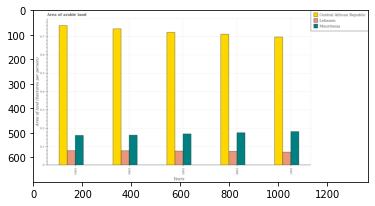

Number of QA =  29





,Years,Lebanon,Mauritania,Central African Republic
0,1986,0.077633,0.180081,0.718131
1,1987,0.072479,0.185423,0.706273
2,1983,0.081119,0.163022,0.769176
3,1984,0.080679,0.165221,0.752154
4,1985,0.078928,0.173420,0.731329


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in lebanon in 1984 and that in 1985 ?
PREDICTED =  0.0017516494599496418
EXPECTED =  0.0017672608465535006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in central african republic in 1987 and the total arable land in lebanon in 1983?
PREDICTED =  -0.06290302375665313
EXPECTED =  0.6194344475001632




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the total arable land in lebanon and total arable land in central african republic ?
PREDICTED =  -4.609163276060025
EXPECTED =  -0.68190736

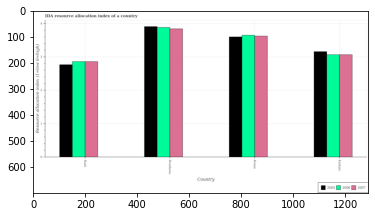

Number of QA =  29





,Country,2007,2005,2006
0,Kiribati,3.072687,3.182679,3.088654
1,Kenya,3.652019,3.624611,3.678206
2,Honduras,3.875645,3.937401,3.913193
3,Haitt,2.886957,2.789387,2.883120


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in 2005 in haiti and that in honduras ?
PREDICTED =  9.596677588546259
EXPECTED =  -1.14166666666666




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in 2005 in haiti and the ida resource allocation index in 2006 in honduras?
PREDICTED =  9.596677588546259
EXPECTED =  -1.11666666666666




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index of/in 2006 and ida resource allocation index of/in 2007 in kenya?
PREDICTED =  9.91115390098974
EXPECTED =  0.024999

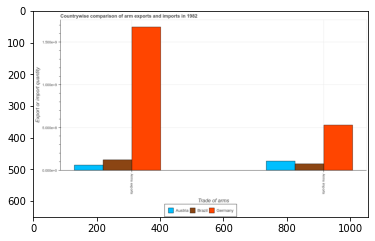

Number of QA =  23





,Trade of arms,Austria,Brazil,Germany
0,Arms imports,0.115096,0.082954,0.53960
1,Arms exports,0.067625,0.130534,1.69398


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in germany and that in austria ?
PREDICTED =  1.6263557738777679
EXPECTED =  1617000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports and arms imports in austria ?
PREDICTED =  0.8849036999989524
EXPECTED =  -47000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Export or import q

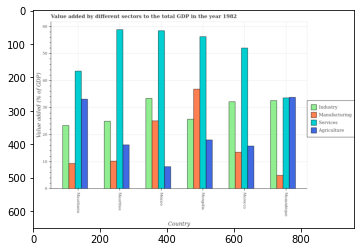

Number of QA =  30





,Country,Industry,Agriculture,Manufacturing,Services
0,Mongolia,26.008257,18.419311,37.204556,56.518340
1,NaN,34.364193,8.332711,25.446615,59.282201
2,Mozambique,33.085331,34.370935,5.088998,34.113943
3,Mauritius,25.500365,16.360886,10.424194,60.027038
4,Mauritania,23.582198,33.603468,9.561165,43.706989
5,Morocco,32.595716,16.108854,13.670211,52.619025


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in mongolia and that in mozambique ?
PREDICTED =  -15.951624201578163
EXPECTED =  -15.763626752290204




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in mexico and the value added by industrial sector in mauritius?
PREDICTED =  26.780362231838513
EXPECTED =  0.1545750060845883




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector and value added by manufacturing sector in morocco ?
PREDICTED =  1.7684768528792958
EXPECTED =  18.7023934936

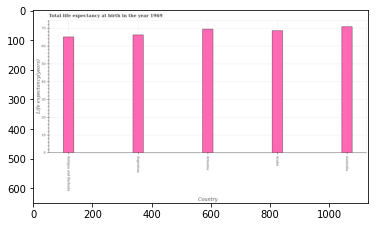

Number of QA =  22





,Country,Life expectancy(years)
0,Armenia,69.678710
1,NaN,68.786059
2,Argentina,66.141754
3,Australia,70.920970
4,Antigua and Barbuda,65.137527


> what is the title of the graph ?
PREDICTED =  Total life expectancy at birth in the year 1969
EXPECTED =  Total life expectancy at birth in the year 1969




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Life expectancy(years)
EXPECTED =  Life expectancy(years)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in argentina and aruba ?
PREDICTED =  1.0042263608452657
EXPECTED =  -2.393




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median life expectancy at birth ?
PREDICTED =  68.78605885017693
EXPECTED =  68.72841463414639




				 4 / 5 = 0.8


is_built_with

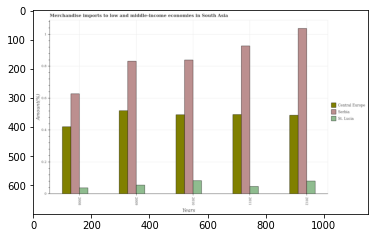

Number of QA =  29





,Years,Central Europe,Serbia,St. Lucia
0,2009,0.526977,0.840669,0.059006
1,2012,0.499491,1.045662,0.084388
2,2008,0.425736,0.633481,0.041087
3,2010,0.503383,0.851467,0.086762
4,2011,0.499652,0.936496,0.049810


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in central europe in 2010 and that in 2011 ?
PREDICTED =  0.0037313597828592115
EXPECTED =  -0.0009905688133948765




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in central europe in 2011 and the percentage of amount earned from merchandise imports in st. lucia in 2008?
PREDICTED =  0.07391611875570081
EXPECTED =  0.4594221603274543




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of amount earned from

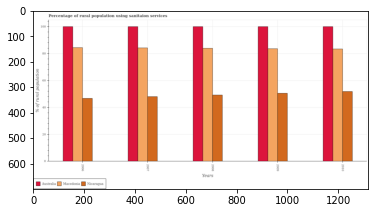

Number of QA =  29





,Years,Australia,Nicaragua,Macedonia
0,2010,100.332420,51.870645,83.416700
1,2006,100.182152,47.210045,84.512453
2,2008,99.972094,49.694621,84.338699
3,2009,100.146067,50.792485,84.085264
4,2007,100.175073,48.281664,83.944751


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population using sanitaion services in nicaragua in 2006 and that in 2007 ?
PREDICTED =  -1.0716182086198742
EXPECTED =  -1.2999999999999972




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population using sanitaion services in macedonia in 2007 and the percentage of rural population using sanitaion services in nicaragua in 2010?
PREDICTED =  0.5280511420766345
EXPECTED =  32.400000000000006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of rural population using sa

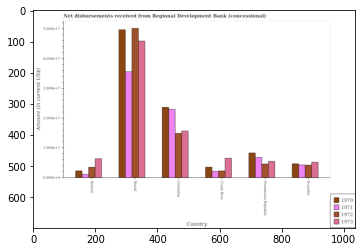

Number of QA =  30





,Country,1972,1971,1970,1973
0,Bolivia,0.370031,0.129114,0.245777,0.657889
1,Dominican Republic,0.477445,0.699605,0.851770,0.570112
2,Costa Rica,0.248520,0.235364,0.369188,0.669491
3,Colombia,1.500121,2.321110,2.383908,1.563480
4,Brazil,5.041709,3.572908,4.879779,4.613583
5,Ecuador,0.438687,0.445963,0.480772,0.538662


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in 1970 in bolivia and that in dominican republic ?
PREDICTED =  -0.6059931475712849
EXPECTED =  -6016000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in 1971 in costa rica and the amount of disbursements received from regional development bank in 1970 in brazil?
PREDICTED =  -3.3375436483331895
EXPECTED =  -47592000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from 

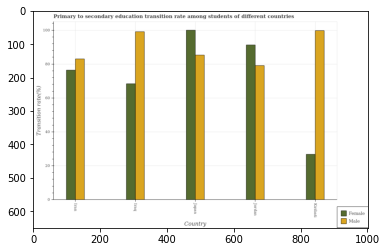

Number of QA =  28





,Country,Female,Male
0,NaN,76.669402,83.070295
1,Iraq,68.592956,99.608585
2,Japan,100.438632,85.778646
3,Jordan,91.503076,79.340819
4,Kiribati,27.091148,100.091390


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students in jordan and that in kiribati ?
PREDICTED =  64.4119282810149
EXPECTED =  64.52300000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in iran and the transition rate among female students in japan?
PREDICTED =  -6.4378268851524325
EXPECTED =  -16.968220000000002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students and transition rate among female students in iran ?
PREDICTED =  76.3408193221362
EXPECTED =  6.601619999999997


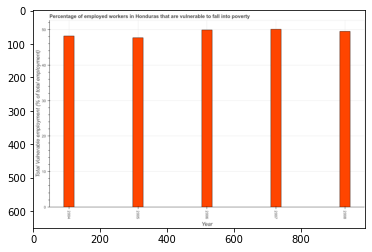

Number of QA =  23





,Year,Total Vulnerable employment (% of total employment)
0,2005,47.782806
1,2008,49.632268
2,2004,48.395756
3,2007,50.367501
4,2006,50.066783


> what is the title of the graph ?
PREDICTED =  Percentage of employed workers in Honduras that are vulnerable to fall into poverty
EXPECTED =  Percentage of employed workers in Honduras that are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total Vulnerable employment (% of total employment)
EXPECTED =  Total Vulnerable employment (% of total employment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total vulnerable employment in 2006 and 2007 ?
PREDICTED =  -0.30071802964037886
EXPECTED =  -0.2




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median tot

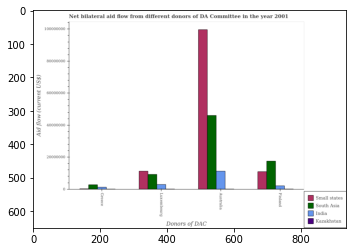

Number of QA =  29





,Donors of DAC,Small states,India,South Asia,Kazakhstan
0,Luxembourg,1.151293e+07,3.270570e+06,9.510545e+06,NaN
1,Australia,9.971128e+07,1.163789e+07,4.609646e+07,NaN
2,Greece,NaN,1.680399e+06,3.095242e+06,NaN
3,Finland,1.114502e+07,2.395456e+06,1.790392e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by greece in south asia and that in small states ?
PREDICTED =  3095238.575044846
EXPECTED =  2530000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by greece in kazakhstan and the amount of aid given by finland in small states?
PREDICTED =  -11145018.662194718
EXPECTED =  -10920000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by luxembourg and amount of aid given by finland in india ?
PREDICTED =  -2395455.0166445323
EXPECTED =  830000




				 1 / 3 = 0.3333


is_built_

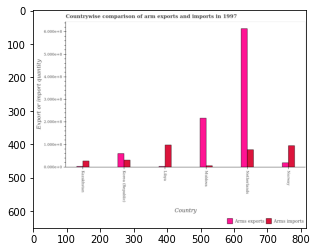

Number of QA =  28





,Country,Arms imports,Arms exports
0,Libya,0.996306,NaN
1,Netherlands,0.797140,6.097768
2,Korea (Republic),0.335603,0.612358
3,Kazakhstan,0.291390,NaN
4,Norway,0.959061,0.214613
5,Moldova,NaN,2.144541


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in libya and that in norway ?
PREDICTED =  0.03724508564072182
EXPECTED =  3000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in netherlands and the arms imports in korea (republic)?
PREDICTED =  5.485410532054498
EXPECTED =  583000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports and arms exports in norway ?
PREDICTED =  3.1648879114185915
EXPECTED =  76000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished af

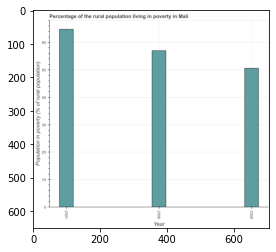

Number of QA =  23





,Year,Population in poverty (% of rural population)
0,2001,64.974351
1,2009,50.634313
2,2006,56.886456


> what is the title of the graph ?
PREDICTED =  Percentage of the rural population living in poverty in Mali
EXPECTED =  Percentage of the rural population living in poverty in Mali




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population in poverty (% of rural population)
EXPECTED =  Population in poverty (% of rural population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population living below poverty line in 2006 and 2009 ?
PREDICTED =  6.252143789706068
EXPECTED =  6.4




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of rural population living

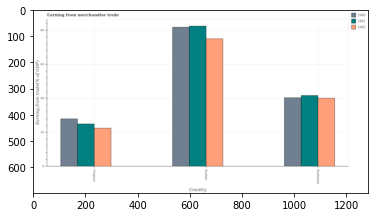

Number of QA =  29





,Country,1962,1961,1960
0,Zambia,74.994741,82.866624,82.757635
1,Uruguay,22.585139,25.053377,27.981811
2,Zimbabwe,40.257456,41.577567,40.587531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in 1960 in uruguay and that in zambia ?
PREDICTED =  -54.77582357426732
EXPECTED =  -53.93419510639049




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in 1962 in uruguay and the earnings from trade in 1960 in zambia?
PREDICTED =  -52.40960154624389
EXPECTED =  -59.410850793024




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade of/in 1962 and earnings from trade of/in 1960 in uruguay?
PREDICTED =  47.01292956526389
EXPECTED =  -5.476655686633503




				 1 / 3 = 0.3333


is_built

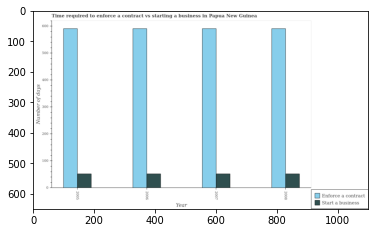

Number of QA =  28





,Year,Enforce a contract,Start a business
0,2007,593.916384,53.876813
1,2008,592.669813,53.954082
2,2006,591.686984,54.118062
3,2005,595.122091,53.913122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2005 and that in 2007 ?
PREDICTED =  52.91312210864722
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2005 and the number of days to enforece a contract in 2008?
PREDICTED =  52.91312210864722
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of days to enforece a contract and number of days to start a business ?
PREDICTED =  -1.0
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available:

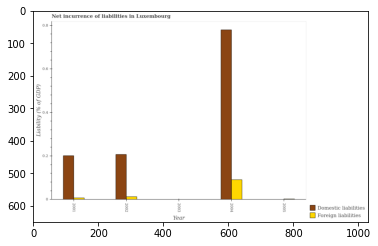

Number of QA =  23





,Year,Foreign liabilities,Domestic liabilities
0,2002,0.015080,0.210250
1,2004,0.093322,0.783345
2,2005,NaN,NaN
3,2001,0.009454,0.204042
4,2003,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities in 2001 and that in 2004 ?
PREDICTED =  -0.08386818295844377
EXPECTED =  -0.08352728640384505




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities in 2002 and the incurrence of domestic liabilities in 2003?
PREDICTED =  0.015080398828489888
EXPECTED =  0.0127980017572834




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the incurrence of foreign liabilities and incurrence of domestic liabilities ?
PREDICTED =  -1.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_b

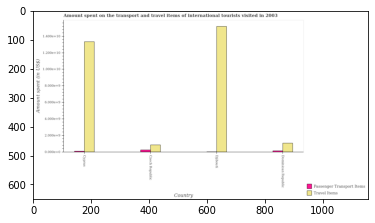

Number of QA =  28





,Country,Travel Items,Passenger Transport Items
0,Djibouti,1.523026,NaN
1,Dominican Republic,0.114648,NaN
2,Czech Republic,0.094417,0.033044
3,Cyprus,1.337202,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in czech republic and that in djibouti ?
PREDICTED =  0.0
EXPECTED =  -14337000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in djibouti and the amount spent on passenger transport items in dominican republic?
PREDICTED =  1.3139610180608545
EXPECTED =  15051000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items and amount spent in travel items in czech republic ?
PREDICTED =  0.0
EXPECTED =  -607000000.0




				 0 / 3 = 0.0


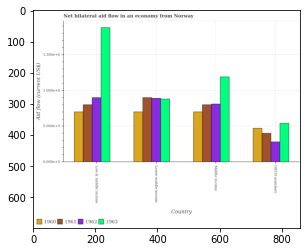

Number of QA =  30





,Country,1963,1962,1961,1960
0,Middle income,1.195233,0.814614,0.801660,0.703108
1,Lower middle income,0.884977,0.892659,0.899919,0.706337
2,Low & middle income,1.889203,0.902171,0.807969,0.708292
3,OECD members,0.545753,0.282227,0.407585,0.474111


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1961 in low & middle income and that in oecd members ?
PREDICTED =  1.3003027863145122
EXPECTED =  400000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in oecd members and the net bilateral aid flow in 1962 in middle income?
PREDICTED =  -0.22899643350522203
EXPECTED =  -340000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow of/in 1960 and net bilateral aid flow of/in 1961 in middle income?
PREDICTED =  -0.15369832424019403
EXPECTED =  -100000.0






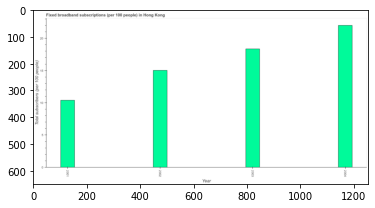

Number of QA =  23





,Year,Total subscribers (per 100 people)
0,2003,18.337453
1,2002,15.102098
2,2001,10.413988
3,2004,21.961453


> what is the title of the graph ?
PREDICTED =  Fixed broadband subscriptions (per 100 people) in Hong Kong
EXPECTED =  Fixed broadband subscriptions (per 100 people) in Hong Kong




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total subscribers (per 100 people)
EXPECTED =  Total subscribers (per 100 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of fixed broadband subscriptions in 2002 and 2003 ?
PREDICTED =  -3.2353551104773057
EXPECTED =  -3.327




				 4 / 4 = 1.0


> what is the median total number of fixed broadband subscriptions ?
PREDICTED =  None
EXPECTED =  16.6951302253803




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

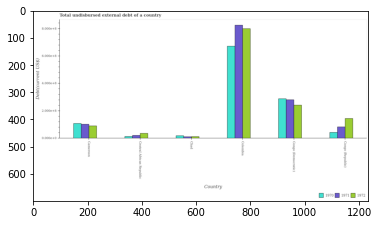

Number of QA =  29





,Country,1972,1971,1970
0,Congo (Democratic),2.444862,2.843515,2.924405
1,Central African Republic,0.370846,0.227374,0.138074
2,Cameroon,0.924287,1.047483,1.105655
3,Congo (Republic),1.466295,0.847282,0.443403
4,Colombia,8.058882,8.283293,6.787430
5,Chad,0.132241,0.121860,0.205475


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1972 in colombia and that in congo (republic) ?
PREDICTED =  6.592587190474978
EXPECTED =  655827000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1972 in chad and the total undisbursed external debt in 1970 in cameroon?
PREDICTED =  -0.7920453524274005
EXPECTED =  -95837000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt of/in 1971 and total undisbursed external debt of/in 1970 in chad?
PREDICTED =  -0.08361460933543895
EXPECTE

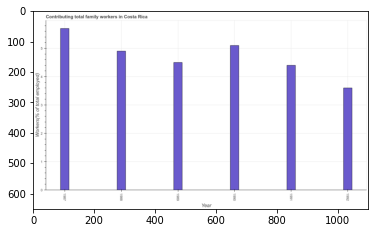

Number of QA =  23





,Year,Workers(% of total employed)
0,1987,5.741057
1,1989,4.537672
2,1990,5.152166
3,1992,3.632240
4,1988,4.944060
5,1991,4.437285


> what is the title of the graph ?
PREDICTED =  Contributing total family workers in Costa Rica
EXPECTED =  Contributing total family workers in Costa Rica




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Workers(% of total employed)
EXPECTED =  Workers(% of total employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing family workers in 1988 and 1992 ?
PREDICTED =  1.3118200532396784
EXPECTED =  1.3




				 4 / 4 = 1.0


> what is the median contributing family workers ?
PREDICTED =  None
EXPECTED =  4.700000047683715




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio o

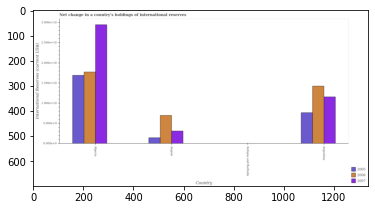

Number of QA =  29





,Country,2007,2005,2006
0,Antigua and Barbuda,NaN,NaN,NaN
1,Angola,0.326712,0.162487,0.715813
2,NaN,2.989531,1.712331,1.803709
3,Argentina,1.179313,0.788137,1.442212


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the international reserves in 2006 in angola and that in antigua and barbuda ?
PREDICTED =  0.7158131177749419
EXPECTED =  6958037786.94




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the international reserves in 2006 in argentina and the international reserves in 2007 in algeria?
PREDICTED =  0.36319920345484524
EXPECTED =  -15219134526.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the international reserves of/in 2007 and international reserves of/in 2006 in argentina?
PREDICTED =  0.5577884753153677
EXPECTED =  -2665027794.0




				 0 /

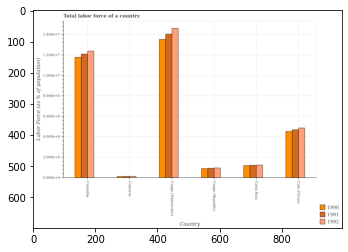

Number of QA =  29





,Country,1992,1990,1991
0,Comoros,0.021398,NaN,0.020924
1,Congo (Democratic),1.460601,1.355211,1.412740
2,Cote d'Ivoire,0.489849,0.459699,0.474449
3,Congo (Republic),0.102467,0.097153,0.099812
4,Costa Rica,0.131575,0.126135,0.129351
5,Colombia,1.243209,1.182607,1.213934


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in 1991 in congo (democratic) and that in cote d'ivoire ?
PREDICTED =  0.9382911600090593
EXPECTED =  9363736




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in 1991 in colombia and the percentage of labor force in 1990 in cote d'ivoire?
PREDICTED =  0.7394851388137864
EXPECTED =  7570370




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force of/in 1991 and percentage of labor force of/in 1990 in congo (democratic)?
PREDICTED =  0.05752878184952559
EXPECTED =  5210

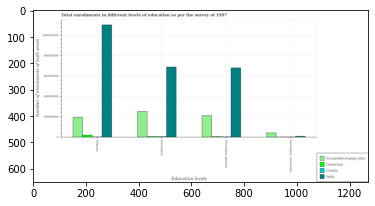

Number of QA =  29





,Education levels,India,Europe(developing only),Croatia,Cameroon
0,Secondary vocational,NaN,4.774259e+06,NaN,NaN
1,Primary,1.108352e+08,2.008029e+07,NaN,2.531213e+06
2,Secondary general,6.865247e+07,2.170807e+07,NaN,NaN
3,Secondary,6.942235e+07,2.576289e+07,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in primary education in india and that in croatia ?
PREDICTED =  110835161.8245988
EXPECTED =  110186475.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary vocational education in europe(developing only) and the number of enrolments in secondary education in croatia?
PREDICTED =  -25762890.304471426
EXPECTED =  3735979.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education and number of enrolments in secondary vocational education in cameroon 

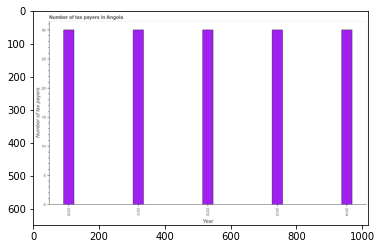

Number of QA =  23





,Year,Number of tax payers
0,2012,30.322668
1,2013,30.276433
2,2014,30.413137
3,2011,30.469046
4,2010,30.407504


> what is the title of the graph ?
PREDICTED =  Number of tax payers in Angola
EXPECTED =  Number of tax payers in Angola




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of tax payers
EXPECTED =  Number of tax payers




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in 2010 and 2014 ?
PREDICTED =  -0.005632915398848581
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tax payers ?
PREDICTED =  2012.0
EXPECTED =  30.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation

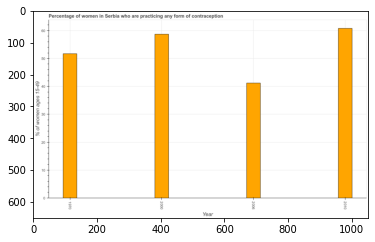

Number of QA =  23





,Year,% of women ages 15-49
0,2000,59.399149
1,1970,51.718211
2,2010,61.285610
3,2006,41.420925


> what is the title of the graph ?
PREDICTED =  Percentage of women in Serbia who are practicing any form of contraception
EXPECTED =  Percentage of women in Serbia who are practicing any form of contraception




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of women ages 15-49
EXPECTED =  % of women ages 15-49




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contraceptive prevalence in 2006 and 2010 ?
PREDICTED =  -19.86468474596804
EXPECTED =  -19.6




				 4 / 4 = 1.0


> what is the median contraceptive prevalence ?
PREDICTED =  None
EXPECTED =  55.2




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





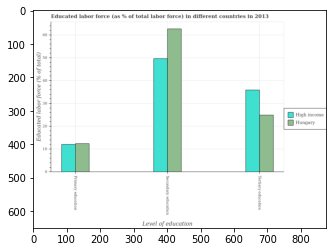

Number of QA =  28





,Level of education,Hungary,High income
0,Tertiary education,25.205872,36.041050
1,Primary education,12.690027,12.396480
2,Secondary education,62.712222,49.687619


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in high income and that in hungary ?
PREDICTED =  10.83517802162746
EXPECTED =  10.996214287024294




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received secondary education in hungary and the percentage of labor force who received tertiary education in high income?
PREDICTED =  -23.016447010887077
EXPECTED =  26.8037868573849




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education and percentage 

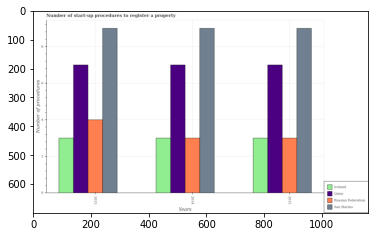

Number of QA =  30





,Years,Iceland,San Marino,Russian Federation,Qatar
0,2014,3.030114,9.028480,3.043884,7.020154
1,2015,3.033229,9.044309,3.043153,7.015605
2,2013,3.023389,9.101986,4.038964,7.016406


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum number of procedures required to register a property in russian federation ?
PREDICTED =  1.0
EXPECTED =  3.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total number of procedures required to register a property in russian federation in the graph ?
PREDICTED =  1.0
EXPECTED =  10.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures required to register a property in san marino in 2014 and that in 2015 ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

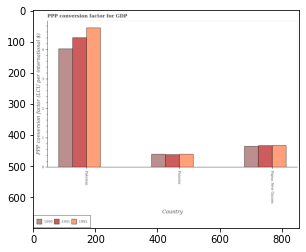

Number of QA =  29





,Country,1992,1990,1991
0,Papua New Guinea,0.773728,0.747775,0.767496
1,Panama,0.469507,0.470927,0.459908
2,Pakistan,4.795274,4.078090,4.426866


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1990 in panama and that in papua new guinea ?
PREDICTED =  -0.27684740520304585
EXPECTED =  -0.26946762599167307




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1991 in pakistan and the ppp conversion factor for gdp in 1992 in papua new guinea?
PREDICTED =  3.659369761347347
EXPECTED =  3.6630142388777793




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp of/in 1990 and ppp conversion factor for gdp of/in 1992 in panama?
PREDICTED =  4.3563572

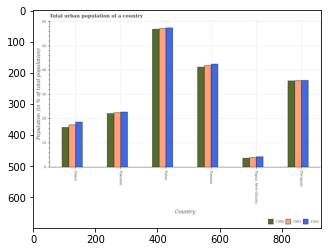

Number of QA =  29





,Country,1962,1961,1960
0,Palau,57.703714,57.374783,57.072418
1,Oman,18.850235,17.655177,16.556604
2,Papua New Guinea,4.570858,4.214759,3.953033
3,Panama,42.639603,42.112436,41.454752
4,Paraguay,35.996501,35.961426,35.867578
5,Pakistan,22.963341,22.654857,22.367326


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1961 in palau and that in panama ?
PREDICTED =  15.262346845712415
EXPECTED =  15.260999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1962 in oman and the urban population in 1960 in pakistan?
PREDICTED =  -4.113105923718106
EXPECTED =  -3.497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population of/in 1962 and urban population of/in 1960 in palau?
PREDICTED =  0.6312961663443133
EXPECTED =  0.5820000000000007




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avail

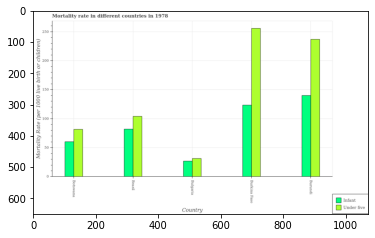

Number of QA =  28





,Country,Infant,Under five
0,Brazil,82.627679,104.930325
1,Burkina Faso,123.905866,257.267502
2,Botswana,61.452912,82.302753
3,Bulgaria,27.450431,32.020711
4,Burundi,141.136962,237.207068


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in botswana and that in burkina faso ?
PREDICTED =  -62.452954214938806
EXPECTED =  -63.2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate in burkina faso and the infant mortality rate in burundi?
PREDICTED =  -237.2070682925068
EXPECTED =  115.80000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate and under-5 mortality rate in brazil ?
PREDICTED =  4.687090959603111
EXPECTED =  -22.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPU

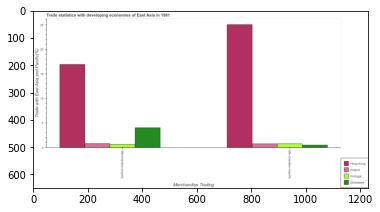

Number of QA =  23





,Merchandise Trading,Portugal,Poland,Zimbabwe,Hong Kong
0,Merchandise imports,0.903841,0.899150,0.623644,25.284667
1,Merchandise exports,0.767989,0.942162,4.207029,17.127819


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in hong kong and the merchandise exports in portugal?
PREDICTED =  8.156847839863516
EXPECTED =  24.407943293747607




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports and merchandise imports in poland ?
PREDICTED =  3.3078795493920805
EXPECTED =  0.0412631858865391




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in zimbabwe to that in ho

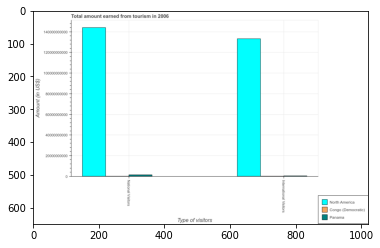

Number of QA =  23





,Type of visitors,North America,Panama,Congo (Democratic)
0,National Visitors,1.469848e+11,NaN,NaN
1,International Visitors,1.362494e+11,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors and amount earned from international visitors in congo (democratic) ?
PREDICTED =  146984841320.62845
EXPECTED =  -89900000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Amount (in US$)
EXPECTED =  20000000000.0




				 0 / 5 = 0.0


> what is the title of the gr

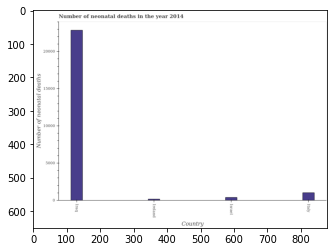

Number of QA =  22





,Country,Number of neonatal deaths
0,Israel,454.565049
1,Iraq,22996.799113
2,Ireland,229.914408
3,Italy,1106.411352


> what is the title of the graph ?
PREDICTED =  Number of neonatal deaths in the year 2014
EXPECTED =  Number of neonatal deaths in the year 2014




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of neonatal deaths
EXPECTED =  Number of neonatal deaths




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in iraq and israel ?
PREDICTED =  22542.23406340598
EXPECTED =  22482.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of neonatal deaths ?
PREDICTED =  780.4882006298233
EXPECTED =  701.0




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_

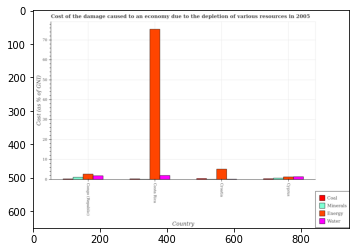

Number of QA =  30





,Country,Water,Coal,Energy,Minerals
0,Costa Rica,2.290109,NaN,76.011622,NaN
1,Congo (Republic),2.251716,NaN,3.056347,1.417619
2,Cy prus,1.726839,NaN,1.688731,NaN
3,Croatia,NaN,NaN,5.553513,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of water in costa rica and that in croatia ?
PREDICTED =  2.290108925713696
EXPECTED =  1.851099170676354




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of damage due to depletion of energy in croatia to that in cyprus ?
PREDICTED =  0.7202648147235796
EXPECTED =  4.152785785576912




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: 

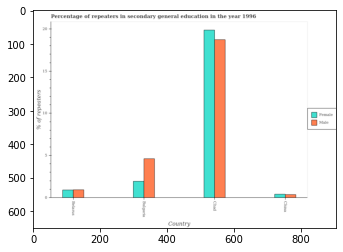

Number of QA =  28





,Country,Female,Male
0,China,0.472245,0.421920
1,Belarus,0.979512,0.983465
2,Chad,19.907607,18.740785
3,Bulgaria,1.995616,4.663281


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in belarus and that in bulgaria ?
PREDICTED =  -3.6798153883150984
EXPECTED =  -3.6856200000000015




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female repeaters in bulgaria and the percentage of male repeaters in belarus?
PREDICTED =  1.016104302779902
EXPECTED =  1.00475




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters and percentage of female repeaters in chad ?
PREDICTED =  -18.318865416083852
EXPECTED =  -1.140150000000002




				 2 / 3 = 0.6667


is_built_

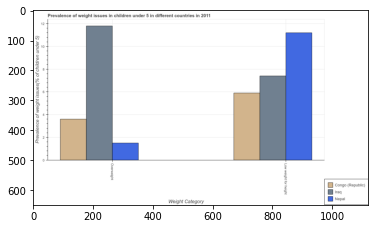

Number of QA =  23





,Weight Category,Congo (Republic),Nepal,Iraq
0,Low weight for height,5.928919,11.183390,7.488724
1,NaN,3.599242,1.546072,11.786693


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of overweight children in nepal to that in iraq ?
PREDICTED =  0.0848414391064084
EXPECTED =  0.12711864201305412




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Prevalence of weight issues(% of children under 5)
EXPECTED =  2.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Pr

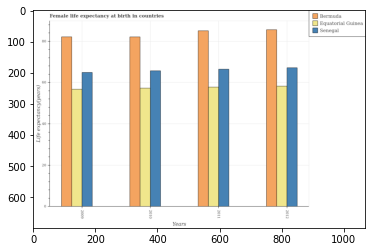

Number of QA =  29





,Years,Bermuda,Senegal,Equatorial Guinea
0,2009,82.341094,65.576337,57.285329
1,2012,87.111132,67.755381,58.588605
2,2011,85.827638,67.178004,58.360472
3,2010,82.913217,66.211431,58.011859


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in equatorial guinea in 2010 and that in 2011 ?
PREDICTED =  1951.6395282656413
EXPECTED =  -0.5039999999999978




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in senegal in 2009 and the female life expectancy at birth in equatorial guinea in 2012?
PREDICTED =  1941.2446186611899
EXPECTED =  6.6270000000000095




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the female life expectancy at birth in senegal and female life expectancy at birth in equatorial guine

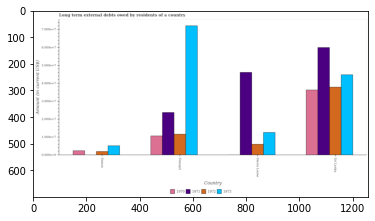

Number of QA =  27





,Country,1972,1971,1970,1973
0,Samoa,0.210823,NaN,0.254072,0.522264
1,Sierra Leone,0.608142,4.537510,NaN,1.254474
2,Sri Lanka,3.742537,5.936424,3.613093,4.435820
3,Senegal,1.160840,2.355837,1.062426,7.090782


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of long-term external debts owed by residents in 1972 in sierra leone and that in sri lanka ?
PREDICTED =  -1.0
EXPECTED =  -31899000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of long-term external debts owed by residents in 1972 in sri lanka and the amount of long-term external debts owed by residents in 1973 in senegal?
PREDICTED =  -0.16083972670789515
EXPECTED =  -34242000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of long-term external debts owed by residents of/in 1971 and amount of long-term 

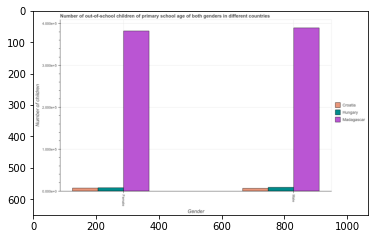

Number of QA =  23





,Gender,Hungary,Croatia,Madagascar
0,Female,0.101113,0.091814,3.834920
1,Male,0.109530,0.087308,3.897495


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students in madagascar and that in hungary ?
PREDICTED =  3.733806682364852
EXPECTED =  374311




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students in hungary and the number of male out-of-school students in madagascar?
PREDICTED =  -7.631301395934105
EXPECTED =  -381626




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students and number of male out-of-school students in madagascar ?
PREDICTED =  -7.631301395934105
EXPECTED =  -7315




		

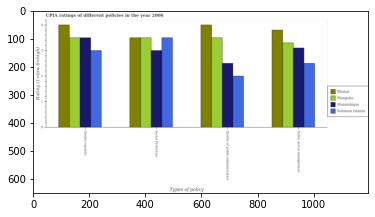

Number of QA =  29





,Types of policy,Bhutan,Mozambique,Mongolia,Solomon Islands
0,Social Protection,3.543161,3.040017,3.534097,3.549328
1,Public sector management,3.851129,3.136222,3.341652,2.560268
2,Gender equality,4.055263,3.535233,3.540089,3.045532
3,Quality of public administration,4.037065,2.531228,3.538718,2.022530


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of social protection in mozambique and that in bhutan ?
PREDICTED =  -0.5031446610222514
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of public sector management in bhutan and the cpia rating of quality of public administration in solomon islands?
PREDICTED =  0.25
EXPECTED =  1.7999999999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of quality of public administration and cpia rating of social protection in solomon islands ?
PREDICTED =  0.25
EXPECTED =  -1.5




				 1

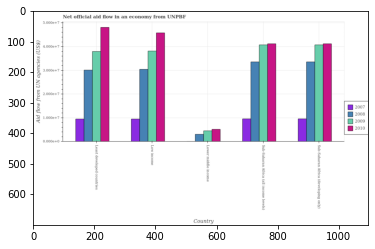

Number of QA =  30





,Country,2007,2008,2010,2009
0,Lower middle income,NaN,0.318391,0.527937,0.461480
1,Least developed countries,0.955973,3.007148,4.809364,3.778213
2,Low income,0.952458,3.039507,4.558260,3.794915
3,Sub-Saharan Africa (all income levels),0.960988,3.349515,4.118682,4.056035
4,Sub-Saharan Africa (developing only),0.962907,3.355341,4.114426,4.059991


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 2008 in lower middle income and that in sub-saharan africa (all income levels) ?
PREDICTED =  0.0
EXPECTED =  -30520000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 2007 in low income and the net official aid flow in 2008 in sub-saharan africa (developing only)?
PREDICTED =  -0.010448373172675884
EXPECTED =  -24080000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





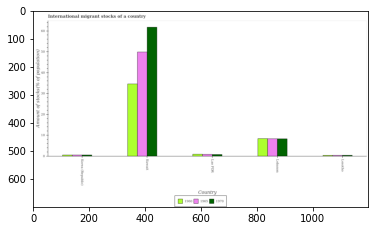

Number of QA =  29





,Country,1965,1970,1960
0,Kuwait,50.512639,62.287151,35.234776
1,Korea (Republic),NaN,NaN,NaN
2,Lesotho,NaN,NaN,NaN
3,Lebanon,8.593384,8.554227,8.688927
4,Lao PDR,NaN,1.043668,1.191300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in 1960 in kuwait and that in lebanon ?
PREDICTED =  26.54584938735763
EXPECTED =  26.205705903246688




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in 1960 in korea (republic) and the amount of stocks in in 1965 in lebanon?
PREDICTED =  -4.688927011512359
EXPECTED =  -7.79164450066817




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in of/in 1960 and amount of stocks in of/in 1965 in lao pdr?
PREDICTED =  1.0
EXPECTED =  0.07932796262677133




				 1 / 3 = 0.3333


is_built_wi

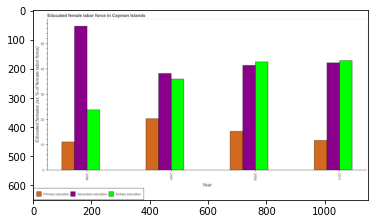

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,2008,41.901903,43.391454,15.654117
1,2006,57.312174,24.263536,11.344400
2,2007,38.699711,36.414970,20.453900
3,2011,42.772985,43.667822,11.930878


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 2006 and that in 2008 ?
PREDICTED =  15.410271559861457
EXPECTED =  15.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in 2006 and the percentage of female labor force who received secondary education in 2008?
PREDICTED =  -19.127917132131373
EXPECTED =  -18.999999999999996




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of female labor force who received primary education

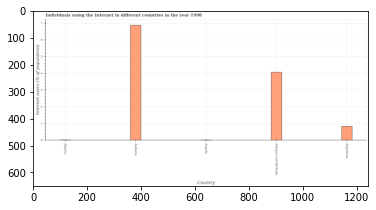

Number of QA =  22





,Country,Internet users (% of population)
0,Angola,NaN
1,NaN,NaN
2,Antigua and Barbuda,4.136692
3,Argentina,0.856186
4,Andorra,6.990570


> what is the title of the graph ?
PREDICTED =  Individuals using the Internet in different countries in the year 1998
EXPECTED =  Individuals using the Internet in different countries in the year 1998




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Internet users (% of population)
EXPECTED =  Internet users (% of population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of internet users in angola and antigua and barbuda ?
PREDICTED =  -4.136692035513014
EXPECTED =  -4.053




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of internet users ?
PREDICTED =  4.136692

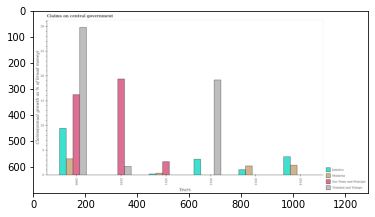

Number of QA =  25





,Years,Malaysia,Jamaica,Trinidad and Tobago,Sao Tome and Principe
0,2013,1.945538,1.176782,NaN,NaN
1,2014,2.062799,3.797125,NaN,NaN
2,2012,NaN,3.284106,19.256270,NaN
3,2011,0.462501,NaN,NaN,2.809898
4,2009,3.362007,9.549366,30.064909,16.323751
5,2010,NaN,NaN,1.832784,19.462888


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on centeral government in jamaica in 2012 and that in 2014 ?
PREDICTED =  -0.5130186358749831
EXPECTED =  -0.5079718591726698




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on centeral government in sao tome and principe in 2010 and the percentage of broad money claimed on centeral government in malaysia in 2009?
PREDICTED =  -0.5521087091401395
EXPECTED =  16.107608029601888




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of broad money 

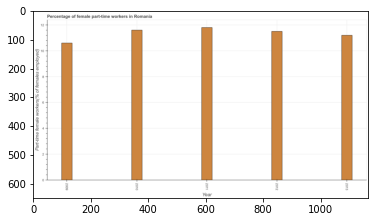

Number of QA =  23





,Year,Part-time female workers(% of females employed)
0,2013,11.190514
1,2012,11.524742
2,2009,10.649981
3,2010,11.596336
4,2011,11.838913


> what is the title of the graph ?
PREDICTED =  Percentage of female part-time workers in Romania
EXPECTED =  Percentage of female part-time workers in Romania




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time female workers(% of females employed)
EXPECTED =  Part-time female workers(% of females employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time female workers in 2009 and 2010 ?
PREDICTED =  -0.9463547862732167
EXPECTED =  -1.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time female workers ?
PREDICTED =  2011.0
EXPECTED

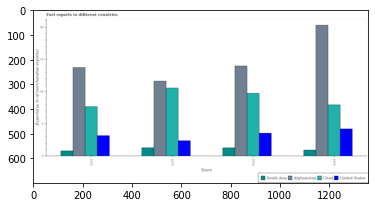

Number of QA =  30





,Years,South Asia,Chad,Afghanistan,United States
0,1974,1.350356,9.843049,14.094612,3.623661
1,1973,1.353746,10.710781,11.752520,2.474522
2,1975,1.011722,8.041225,20.366043,4.281461
3,1972,0.887505,7.749226,13.832851,3.262627


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in south asia in 1972 and that in 1973 ?
PREDICTED =  -0.4662410228121532
EXPECTED =  -0.4865441213132409




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in afghanistan in 1973 and the percentage of exports to different countries in south asia in 1972?
PREDICTED =  -2.0803309663968914
EXPECTED =  10.81484994621222




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the percentage of exports to different countries in south asia and perce

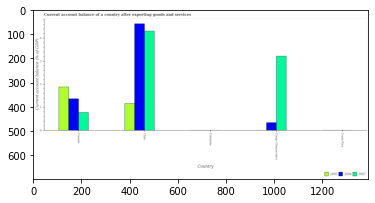

Number of QA =  25





,Country,2007,2005,2006
0,Congo (Democratic),3.230735,NaN,0.354298
1,Canada,0.796294,1.915161,1.383788
2,Chile,4.312169,1.184059,4.624596
3,Costa Rica,NaN,NaN,NaN
4,Colombia,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the account balance in 2007 in canada and that in congo (democratic) ?
PREDICTED =  -2.4344413438762103
EXPECTED =  -2.4448801815822767




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the account balance in 2007 in congo (democratic) and the account balance in 2005 in canada?
PREDICTED =  2.4344413438762103
EXPECTED =  1.3383939307181698




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the account balan

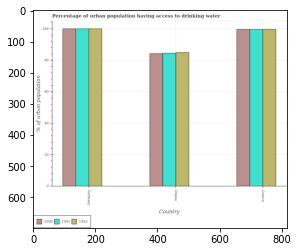

Number of QA =  29





,Country,1992,1990,1991
0,Greece,100.573615,100.445960,100.369772
1,Ghana,85.563071,84.562059,85.090669
2,Germany,101.060949,100.889171,100.507068


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in 1990 in germany and that in greece ?
PREDICTED =  0.4432101920794054
EXPECTED =  0.4000000000000057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in 1990 in ghana and the percentage of urban population having access to drinking water in 1992 in greece?
PREDICTED =  -15.883901354944356
EXPECTED =  -15.399999999999991




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having acces

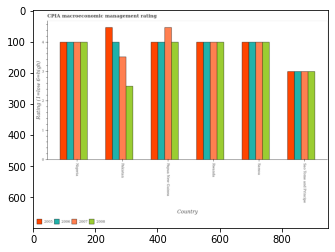

Number of QA =  30





,Country,2007,2005,2008,2006
0,Papua New Guinea,4.542026,4.032179,4.021376,3.998668
1,Samoa,4.035446,4.026705,4.026838,4.036904
2,Sao Tome and Principe,3.035762,3.028685,3.020908,3.025378
3,Rwanda,4.012597,4.038189,4.019800,4.033272
4,Pakistan,3.517918,4.563021,2.511680,4.024114
5,Nigeria,4.004995,4.031336,4.026146,4.031546


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in rwanda and that in sao tome and principe ?
PREDICTED =  0.9768351664628052
EXPECTED =  1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in pakistan and the cpia rating in 2005 in samoa?
PREDICTED =  -0.5175286858795554
EXPECTED =  -0.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2006 and cpia rating of/in 2007 in rwanda?
PREDICTED =  -0.1542830808417861
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

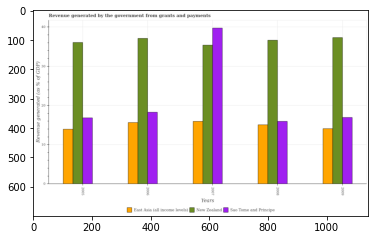

Number of QA =  29





,Years,New Zealand,East Asia (all income levels),Sao Tome and Principe
0,2005,36.041333,13.968568,16.929486
1,2006,37.044481,15.668032,18.346427
2,2008,36.541298,15.241917,16.062035
3,2007,35.470781,16.025824,39.810837
4,2009,37.456120,14.041180,16.980486


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in sao tome and principe in 2005 and that in 2008 ?
PREDICTED =  22.88135187818272
EXPECTED =  0.8932685489601102




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in east asia (all income levels) in 2005 and the revenue generated by the government in new zealand in 2009?
PREDICTED =  -0.07261256445617903
EXPECTED =  -23.364723626398195




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the revenue generated by the government in east asia (all income leve

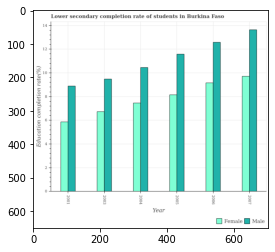

Number of QA =  28





,Year,Female,Male
0,2003,6.835160,9.619748
1,2005,8.263439,11.869294
2,2007,9.903972,13.817924
3,2006,9.301429,12.719299
4,2004,7.496370,10.620222
5,2001,5.968367,9.128586


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of female students in 2003 and that in 2004 ?
PREDICTED =  -0.6612108592042247
EXPECTED =  -0.7285699844360289




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students in 2007 and the education completion rate of female students in 2004?
PREDICTED =  3.1977024997444605
EXPECTED =  3.1820201873778995




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the education completion rate of female students and education completion rate of male students ?
PREDICTED =  0.0
EX

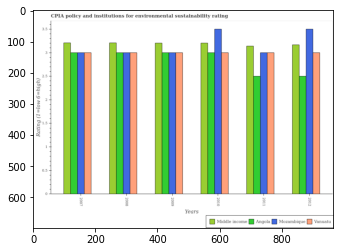

Number of QA =  30





,Years,Angola,Mozambique,Vanuatu,Middle income
0,2012,2.513765,3.494283,2.999055,3.184582
1,2010,3.002097,3.487438,3.012005,3.183620
2,2011,2.501003,2.994271,2.988039,3.176692
3,2009,2.987038,2.991113,2.991900,3.192385
4,2008,2.999636,2.989896,2.990210,3.207186
5,2007,3.001243,2.992167,2.996767,3.225230


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in vanuatu in 2009 and that in 2012 ?
PREDICTED =  -0.007154823984161673
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in angola in 2011 and the cpia rating in vanuatu in 2007?
PREDICTED =  -0.5002404075001126
EXPECTED =  -0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in mozambique and cpia rating in vanuatu ?
PREDICTED =  -2.505717091381571
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

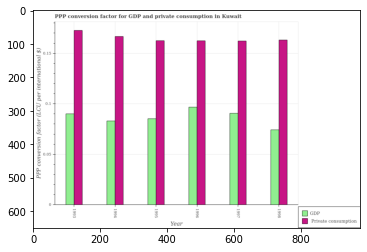

Number of QA =  28





,Year,Private consumption,GDP
0,1996,0.163191,0.097770
1,1997,0.162846,0.091322
2,1995,0.163960,0.085944
3,1993,0.174270,0.090998
4,1994,0.166961,0.084493
5,1998,0.164147,0.075806


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in 1995 and that in 1996 ?
PREDICTED =  0.000769169610477155
EXPECTED =  0.00011564119198098632




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1994 and the ppp conversion factor for private consumption in 1993?
PREDICTED =  -0.006505491401499322
EXPECTED =  -0.007055807500504094




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the ppp conversion factor for gdp and ppp conversion factor for private consumption ?
PREDICTED =  0.00768081922560789

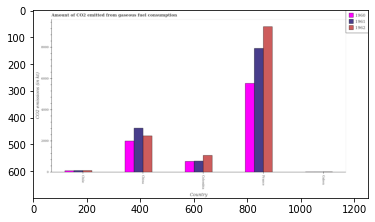

Number of QA =  29





,Country,1962,1961,1960
0,Chile,126.348235,130.251782,116.087991
1,Gabon,NaN,NaN,NaN
2,France,9321.568412,7927.419702,5685.544852
3,Colombia,1090.056782,722.387768,710.702171
4,China,2348.519097,2843.852658,1993.599477


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1960 in colombia and that in france ?
PREDICTED =  -4974.842680341427
EXPECTED =  -5001.7880000000005




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1962 in france and the amount of co2 emitted in 1960 in chile?
PREDICTED =  9195.220177089122
EXPECTED =  9233.506000000001




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted of/in 1960 and amount of co2 emitted of/in 1961 in chile?
PREDICTED =  5555.293069900456
EXPECTED =  -11.001000000000005




				 2 / 3 = 0.6667



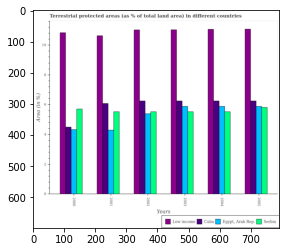

Number of QA =  30





,Years,Low income,"Egypt, Arab Rep.",Cuba,Serbia
0,2005,11.088463,5.939868,6.248351,5.818085
1,2002,11.013696,5.406468,6.254985,5.556293
2,2004,11.055239,5.967074,6.245019,5.541039
3,2003,11.038039,5.915054,6.236571,5.560638
4,2000,10.846861,4.419492,4.506314,5.759115
5,2001,10.712115,4.362450,6.102127,5.522735


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of terrestrial protected land in egypt, arab rep. in 2003 and that in 2005 ?
PREDICTED =  -0.02481432302837039
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of terrestrial protected land in low income in 2003 and the percentage of terrestrial protected land in egypt, arab rep. in 2004?
PREDICTED =  -0.017200165792196742
EXPECTED =  5.142247306896721




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of terrestrial protected land in cuba and percentage of terrestrial pro

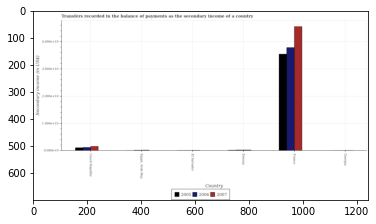

Number of QA =  29





,Country,2007,2005,2006
0,Egypt. Arab Rep.,NaN,NaN,NaN
1,Estonia,NaN,NaN,NaN
2,France,4.560502,3.555513,3.831024
3,El Salvador,NaN,NaN,NaN
4,Czech Republic,0.169751,0.117817,0.124537
5,Georgia,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in 2006 in estonia and that in france ?
PREDICTED =  0.0
EXPECTED =  -37626196503.6




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in 2006 in egypt, arab rep. and the secondary income of in 2005 in estonia?
PREDICTED =  0.0
EXPECTED =  -10464167.199999988




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the secondary income of in 2005 in czech republic to th

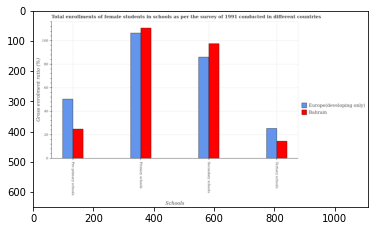

Number of QA =  29





,Schools,Europe(developing only),Bahrain
0,Secondary schools,86.477452,98.194622
1,Pre-primary schools,50.740733,25.436569
2,Primary schools,106.852327,111.242519
3,Tertiary schools,25.713349,15.177021


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(female) in pre-primary schools in bahrain ?
PREDICTED =  6.359142354326521
EXPECTED =  24.87813




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(female) in secondary schools ?
PREDICTED =  21.619363085890193
EXPECTED =  97.4652




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio(female) in secondary schools ?
PREDICTED =  21.619363085890193
EXPECTED =  86.0076065063477




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluati

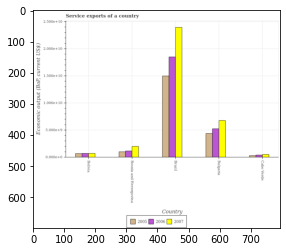

Number of QA =  29





,Country,2007,2005,2006
0,Brazil,2.403370,1.501646,1.856950
1,Bosnia and Herzegovina,0.208606,0.108659,0.123415
2,Bulgaria,0.682465,0.447696,0.531263
3,Bolivia,0.075225,0.074913,0.076356
4,Cabo Verde,0.058424,0.037148,0.048222


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in 2005 in bolivia and that in bosnia and herzegovina ?
PREDICTED =  -0.03374640524306949
EXPECTED =  -331784596.3000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in 2005 in bosnia and herzegovina and the service exports in 2007 in brazil?
PREDICTED =  -0.6964935973844867
EXPECTED =  -22965299541.3




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports of/in 2006 and service exports of/in 2005 in brazil?
PREDICTED =  -1.4534236154352504
EXPECTED =  3519177244.0




				 0 / 3 = 0.0


is_b

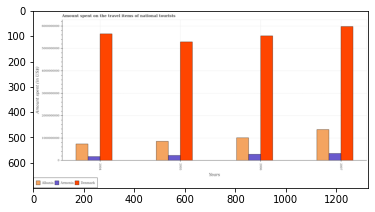

Number of QA =  29





,Years,Denmark,Albania,Armenia
0,2006,5.619374e+09,1.031270e+09,2.928627e+08
1,2004,5.695379e+09,7.592713e+08,1.907460e+08
2,2007,6.026522e+09,1.406233e+09,3.295129e+08
3,2005,5.325645e+09,8.691011e+08,2.419868e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in albania in 2004 and that in 2006 ?
PREDICTED =  -271999019.6558399
EXPECTED =  -277000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in armenia in 2007 and the amount spent on the travel items of national tourists in denmark in 2004?
PREDICTED =  -5365866322.563322
EXPECTED =  -5341000000




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount spent on the travel items of national tourists in armenia and

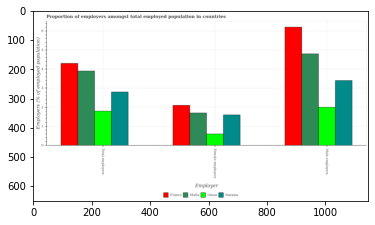

Number of QA =  28





,Employer,Oman,Panama,Malta,France
0,Total employers,1.839375,2.835567,3.949516,4.337723
1,Male employers,2.015407,3.426490,4.844210,6.226455
2,Female employers,0.617683,1.638161,1.723793,2.121870


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female employers in oman to that in malta ?
PREDICTED =  0.3583278325432199
EXPECTED =  0.35294118059547613




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

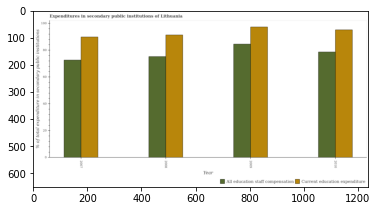

Number of QA =  28





,Year,All education staff compensation,Current education expenditure
0,2009,85.036874,97.468521
1,2010,79.091477,96.047351
2,2008,74.675987,91.544247
3,2007,72.922295,90.464202


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2007 and that in 2010 ?
PREDICTED =  -5.5831491060496745
EXPECTED =  -5.333206176757898




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2009 and the expenditure in education in 2007?
PREDICTED =  12.114579323883092
EXPECTED =  11.909866333007798




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the expenditure in education and expenditure in staff compensation ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available:

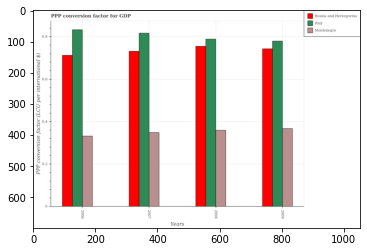

Number of QA =  29





,Years,Montenegra,Bosnia and Herzegovina,Italy
0,2008,0.360946,0.749255,0.784986
1,2009,0.367809,0.739838,0.776551
2,2006,0.333473,0.711876,0.831315
3,2007,0.348695,0.728149,0.812373


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in italy in 2006 and that in 2009 ?
PREDICTED =  0.05476378960895767
EXPECTED =  0.05362699999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in montenegro in 2008 and the ppp conversion factor for gdp in italy in 2006?
PREDICTED =  -0.4703685182056328
EXPECTED =  -0.473647625507705




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the ppp conversion factor for gdp in bosnia and herzegovina and ppp conversion factor for gdp in italy ?
PREDICTED =  -0.060303

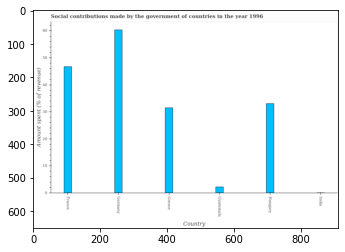

Number of QA =  22





,Country,Amount spent (% of revenue)
0,Guatemala,2.457988
1,France,46.632185
2,Greece,31.749071
3,India,0.309262
4,Hungary,33.180105
5,Germany,60.404926


> what is the title of the graph ?
PREDICTED =  Social contributions made by the government of countries in the year 1996
EXPECTED =  Social contributions made by the government of countries in the year 1996




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount spent (% of revenue)
EXPECTED =  Amount spent (% of revenue)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in making social contributions in france and germany ?
PREDICTED =  -13.772740568465757
EXPECTED =  -13.626




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: 

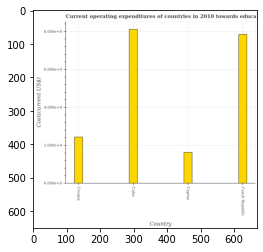

Number of QA =  22





,Country,Cost(current US$)
0,Cuba,8.169453
1,Croatia,2.474594
2,Cyprus,1.677383
3,Czech Republic,7.916253


> what is the title of the graph ?
PREDICTED =  Current operating expenditures of countries in 2010 towards educa
EXPECTED =  Current operating expenditures of countries in 2010 towards education




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Cost(current US$)
EXPECTED =  Cost(current US$)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education expenditure in cyprus and czech republic ?
PREDICTED =  -6.238869991534174
EXPECTED =  -6220956012.879




				 2 / 4 = 0.5


> what is the median education expenditure ?
PREDICTED =  None
EXPECTED =  5142380464.889




				 2 / 6 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

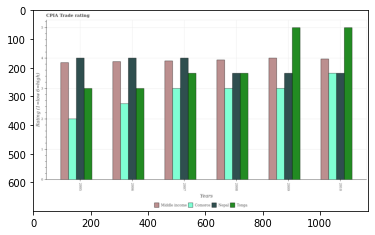

Number of QA =  30





,Years,Comoros,Nepal,Middle income,Tonga
0,2008,3.002329,3.494461,3.938701,3.512902
1,2009,2.999398,3.506303,4.004116,4.995917
2,2006,2.517984,3.996056,3.885255,3.001492
3,2005,2.015994,4.002357,3.862877,3.027715
4,2010,3.513797,3.509538,3.990020,5.000722
5,2007,3.000662,3.994870,3.908219,3.502123


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in middle income in 2008 and that in 2010 ?
PREDICTED =  -0.05131936551171723
EXPECTED =  -0.03188775510203978




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in nepal in 2008 and the cpia rating in comoros in 2006?
PREDICTED =  -0.5015944943123918
EXPECTED =  1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating in nepal and cpia rating in tonga ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

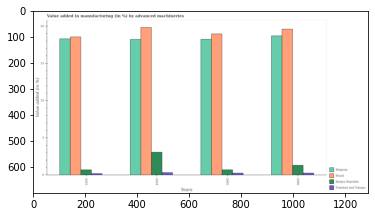

Number of QA =  30





,Years,Kyrgyz Republic,Belgium,Brazil,Trinidad and Tobago
0,2003,0.763602,18.419189,18.716364,0.262088
1,2004,3.115598,18.265707,20.027521,0.384511
2,2006,1.375156,18.775150,19.637807,0.315203
3,2005,0.771407,18.271478,19.024479,0.315262


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by advanced machineries in trinidad and tobago in 2004 and that in 2006 ?
PREDICTED =  0.6154887352108307
EXPECTED =  0.061979459282238025




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by advanced machineries in belgium in 2006 and the percentage of value added in manufacturing by advanced machineries in kyrgyz republic in 2004?
PREDICTED =  -36.537184626049694
EXPECTED =  15.630223841826322




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference bet

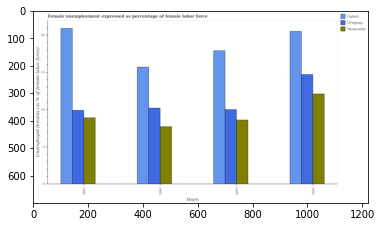

Number of QA =  29





,Years,Uruguay,Gabon,Venezuela
0,1992,9.996772,20.939439,8.964766
1,1995,14.761828,20.513555,12.168059
2,1994,10.030474,18.047779,8.665865
3,1993,10.278037,15.687387,7.723030


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in gabon in 1994 and that in 1995 ?
PREDICTED =  -2.465775680771582
EXPECTED =  -2.6000003814697017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in venezuela in 1993 and the unemployment in females in in gabon in 1994?
PREDICTED =  -0.9428352490077687
EXPECTED =  -10.199999809265158




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the unemployment in females in in gabon and unemployment in females in in venezuela ?
PREDICTED =  0.0
EXPECTED =  7.99999999999996




	

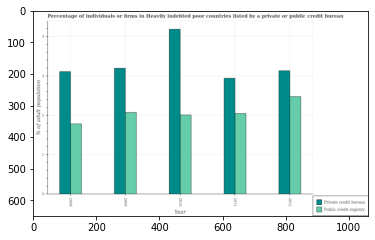

Number of QA =  28





,Year,Private credit bureau,Public credit registry
0,2008,3.102960,1.777396
1,2009,3.191922,2.073803
2,2012,3.125763,2.469203
3,2010,4.175056,2.014277
4,2011,2.943297,2.053172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in 2008 and that in 2011 ?
PREDICTED =  0.15966295715575596
EXPECTED =  0.16842105263157992




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in 2008 and the percentage of firms listed by public credit bureau in 2012?
PREDICTED =  -0.02280310599264812
EXPECTED =  -0.0210526315789501




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of firms listed by private credit bureau and percentage of firms listed by pu

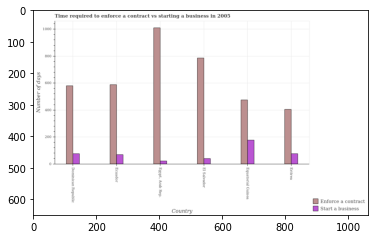

Number of QA =  28





,Country,Enforce a contract,Start a business
0,"Egypt, Arab Rep.",1013.329671,24.578852
1,El Salvador,779.690888,41.940440
2,Entrea,404.530435,77.943493
3,Dominican Republic,577.516027,77.238093
4,Ecuador,586.241467,70.813039
5,Equatorial Guinea,473.529549,177.376716


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to enforece a contract in ecuador and that in el salvador ?
PREDICTED =  -777.6908884418477
EXPECTED =  -198.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in ecuador and the number of days to enforece a contract in egypt, arab rep.?
PREDICTED =  46.23418755765536
EXPECTED =  -941.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business and number of days to enforece a contract in egypt, arab rep. ?
PREDICTED =  152.7978646157635
EXPECTED =  -988.0




		

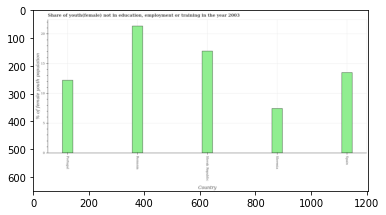

Number of QA =  22





,Country,% of female youth population
0,Romania,21.380218
1,NaN,13.554738
2,Slovenia,7.588319
3,Slovak Republic,17.203398
4,Portugal,12.344429


> what is the title of the graph ?
PREDICTED =  Share of youth(female) not in education, employment or training in the year 2003
EXPECTED =  Share of youth(female) not in education, employment or training in the year 2003




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of female youth population
EXPECTED =  % of female youth population




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth population in slovak republic and slovenia ?
PREDICTED =  9.615078903324086
EXPECTED =  9.65




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth populat

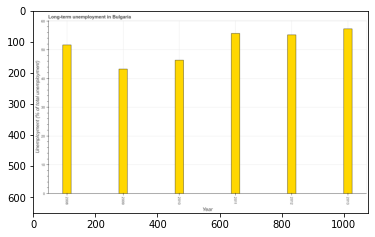

Number of QA =  23





,Year,Unemployment (% of total unemployment)
0,2010,46.803630
1,2013,58.095845
2,2009,43.817460
3,2012,55.908440
4,2008,52.351851
5,2011,56.350910


> what is the title of the graph ?
PREDICTED =  Long-term unemployment in Bulgaria
EXPECTED =  Long-term unemployment in Bulgaria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployment (% of total unemployment)
EXPECTED =  Unemployment (% of total unemployment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term unemployment in 2009 and 2012 ?
PREDICTED =  -12.090979955797287
EXPECTED =  -11.9




				 4 / 4 = 1.0


> what is the median long-term unemployment ?
PREDICTED =  None
EXPECTED =  53.4500007629395




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-ter

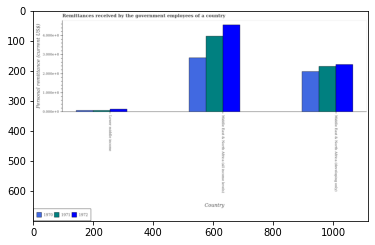

Number of QA =  29





,Country,1972,1971,1970
0,Lower middle income,0.171593,0.105370,0.105596
1,Middle East & North Africa (all income levels),4.611017,4.004784,2.851839
2,Middle East & North Afmica (developing only),2.512996,2.430023,2.158679


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the remittances received by the government employees in 1970 in lower middle income and that in middle east & north africa (all income levels) ?
PREDICTED =  -1.8944040539028792
EXPECTED =  -275739999.771




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the remittances received by the government employees in 1971 in middle east & north africa (developing only) and the remittances received by the government employees in 1972 in lower middle income?
PREDICTED =  2.3246537644031764
EXPECTED =  224140000.34




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built

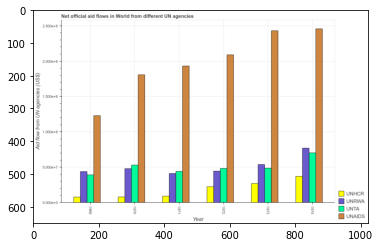

Number of QA =  30





,Year,UNTA,UNRWA,UNAIDS,UNHCR
0,1973,0.499446,0.545631,2.438854,0.275888
1,1972,0.490461,0.461112,2.087265,0.230051
2,1970,0.538679,0.490738,1.813439,0.087568
3,1974,0.712449,0.781705,2.467598,0.378638
4,1971,0.451461,0.420804,1.907851,0.099233
5,1969,0.400195,0.447229,1.240785,0.085118


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unaids in 1969 and that in 1971 ?
PREDICTED =  -0.6670660814439462
EXPECTED =  -70190000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unhcr in 1969 and the amount of aid given by unta in 1972?
PREDICTED =  -0.14493302142713094
EXPECTED =  -14680000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the amount of aid given by unaids and amount of aid given by unhcr ?
PREDICTED =  -3.5324022470896392
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available

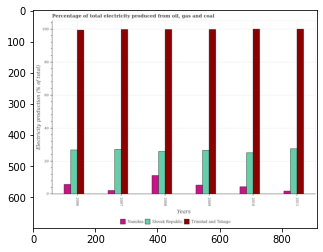

Number of QA =  29





,Years,Namibia,Trinidad and Tobago,Slovak Republic
0,2006,6.174155,99.718042,27.111553
1,2010,4.794551,100.257444,25.159438
2,2008,11.454254,100.097309,25.968858
3,2011,2.163939,100.468188,27.757960
4,2009,5.752304,100.036502,26.693978
5,2007,2.465721,98.936626,27.382287


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in in trinidad and tobago in 2006 and that in 2010 ?
PREDICTED =  499.25666753279825
EXPECTED =  -0.6258692628650806




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in in slovak republic in 2010 and the electricity production in in namibia in 2006?
PREDICTED =  -1.9521146381807277
EXPECTED =  19.21977154560579




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the electricity production in in namibia and electricity production in in slovak republic ?
PREDICTED =  -21.21152508103

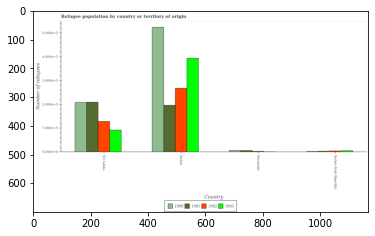

Number of QA =  30





,Country,1992,1993,1990,1991
0,Suriname,NaN,NaN,0.087553,0.082522
1,Sri Lanka,1.296592,0.939318,2.096091,2.113838
2,Syrian Arab Republic,NaN,0.075543,NaN,NaN
3,Sudan,2.696387,3.969638,5.241051,1.994843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in 1990 in suriname and that in syrian arab republic ?
PREDICTED =  0.08755299223538712
EXPECTED =  4472.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in 1992 in sri lanka and the number of refugees in 1991 in syrian arab republic?
PREDICTED =  1.2965917438026044
EXPECTED =  125078.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees of/in 1991 and number of refugees of/in 1990 in sudan?
PREDICTED =  -3.1636865603760205
EXPECTED =  -327756.0




				 0 / 3 = 0.0


is_built_with

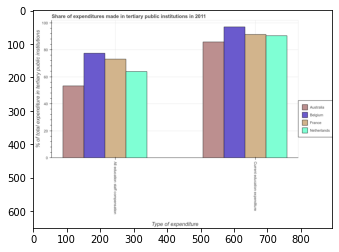

Number of QA =  23





,Type of expenditure,Australia,Belgium,France,Netherlands
0,Current education expenditure,86.982887,98.183464,92.759110,91.727517
1,All education staff compensation,54.208127,78.359565,74.177773,64.883858


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of total expenditure in tertiary public institutions
EXPECTED =  20.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Share of expenditures made in tertiary public institutions in 2011
EXPECTED =  Share of expenditures made in tertiary public institutions in 2011




	

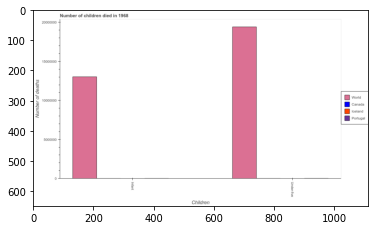

Number of QA =  23





,Children,Iceland,Portugal,World,Canada
0,Infant,NaN,NaN,1.313743e+07,NaN
1,Under-five,NaN,NaN,1.933192e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in world and that in portugal ?
PREDICTED =  0.0
EXPECTED =  19407957




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in world and the number of under-five deaths in canada?
PREDICTED =  32469350.662884176
EXPECTED =  13019261




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths and number of under-five deaths in portugal ?
PREDICTED =  0.0
EXPECTED =  -2839




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


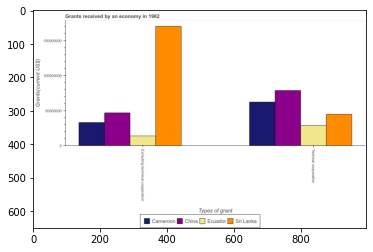

Number of QA =  23





,Types of grant,China,Cameroon,Sri Lanka,Ecuador
0,Techinal cooperation,8.000984e+07,6.258633e+07,4.601651e+07,2.949081e+07
1,Excluding technical cooperation,4.837413e+07,3.395385e+07,1.718274e+08,1.455777e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount of grants received(excluding technical cooperation) in ecuador ?
PREDICTED =  2.0
EXPECTED =  13870000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum amount of grants received(including technical cooperation) ?
PREDICTED =  2.0
EXPECTED =  78840000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum amount of grants received(excluding technical cooperation) ?
PREDICTED =  1.0
EXPECTED =  13870000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training st

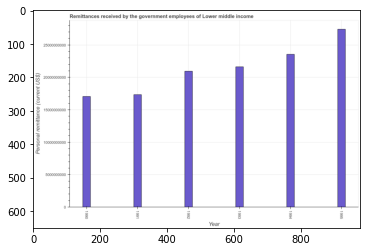

Number of QA =  23





,Year,Personal remittance (current US$)
0,1990,1.729217e+10
1,1995,2.779554e+10
2,1994,2.384290e+10
3,1993,2.180525e+10
4,1992,2.118706e+10
5,1991,1.752102e+10


> what is the title of the graph ?
PREDICTED =  Remittances received by the government employees of Lower middle income
EXPECTED =  Remittances received by the government employees of Lower middle income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Personal remittance (current US$)
EXPECTED =  Personal remittance (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the personal remittances in 1990 and 1992 ?
PREDICTED =  -3894887333.510105
EXPECTED =  -3895942172.553




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median personal remittances ?
PREDICTED =  21496154713.891224
EXPECTE

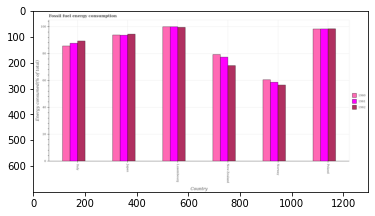

Number of QA =  29





,Country,1962,1961,1960
0,Luxembourg,99.959010,100.415923,100.719552
1,Japan,95.092551,93.900368,94.131718
2,Norway,56.997493,59.152973,61.330972
3,Poland,99.114234,99.280254,98.759402
4,New Zealand,71.609788,77.854252,79.692949
5,Italy,89.559744,88.049102,86.229375


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1962 in new zealand and that in poland ?
PREDICTED =  -27.504446174696483
EXPECTED =  -27.360029953284695




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1961 in new zealand and the percentage of energy consumed in 1960 in poland?
PREDICTED =  -21.426002417337344
EXPECTED =  -20.919290245304893




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed of/in 1960 and percentage of energy consumed of/in 1962 in new zealand?
PREDICTED =  29.109763810817

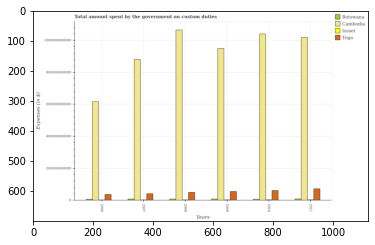

Number of QA =  30





,Years,Togo,Cambodia,Botswana,Israel
0,2009,5.822973e+10,9.487682e+11,1.249627e+10,NaN
1,2008,5.364706e+10,1.068172e+12,1.248533e+10,NaN
2,2007,4.520283e+10,8.793108e+11,NaN,NaN
3,2006,4.071329e+10,6.177648e+11,1.057940e+10,NaN
4,2010,6.461870e+10,1.042313e+12,NaN,NaN
5,2011,7.583554e+10,1.020706e+12,1.241055e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in togo in 2007 and that in 2009 ?
PREDICTED =  -13026902932.695335
EXPECTED =  -13672848140.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in israel in 2011 and the amount spent on custom duties by the government in togo in 2010?
PREDICTED =  11216838252.363968
EXPECTED =  -58522183825.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

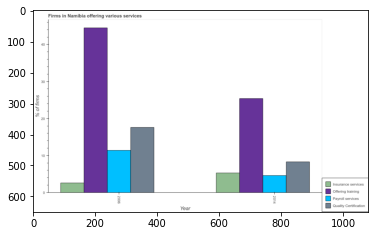

Number of QA =  26





,Year,Offering training,Payroll services,Quality Certification,Insurance services
0,2014,25.651819,4.743737,8.404913,5.394115
1,2006,44.767047,11.360069,17.767919,2.739183


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering insurance services in 2006 and that in 2014 ?
PREDICTED =  -2.6549324072774443
EXPECTED =  -2.6999999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering insurance services in 2014 and the percentage of firms offering payroll services in 2006?
PREDICTED =  2.6549324072774443
EXPECTED =  2.6999999999999997




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of firms offering payroll services and percentage of firms offering training ?
PREDICTED =  7

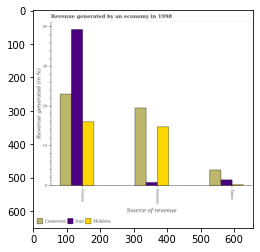

Number of QA =  28





,Source of revenue,Moldova,Iran,Cameroon
0,Taxes,NaN,1.561663,4.062952
1,Interest,15.013189,0.891217,19.717201
2,Grants,16.087418,39.734197,23.228539


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes in iran and that in cameroon ?
PREDICTED =  -2.501289696687988
EXPECTED =  -2.488177396930509




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by grants in cameroon and the percentage of revenue generated by taxes in iran?
PREDICTED =  21.66687592890912
EXPECTED =  21.59151610342818




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by grants and percentage of revenue generated by interest in iran ?
PREDICTED =  0.1087828808851048
EXPE

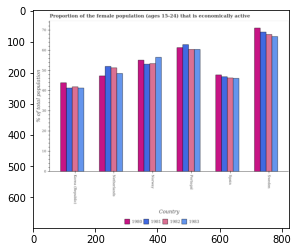

Number of QA =  30





,Country,1982,1980,1983,1981
0,Korea (Republic),42.300761,44.012878,41.454669,41.632362
1,Norway,53.583109,54.790674,56.413120,53.379317
2,Netherlands,51.407999,47.382256,48.765194,52.281916
3,Sweden,67.956972,71.172824,66.839482,68.873742
4,NaN,46.668385,47.761719,46.267166,47.411016
5,Portugal,60.363053,61.279657,60.432612,62.989097


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in 1983 in portugal and that in sweden ?
PREDICTED =  -6.406870883741462
EXPECTED =  -6.400001525878899




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in 1981 in netherlands and the proportion of the female population that is economically active in 1980 in korea (republic)?
PREDICTED =  10.649553660747621
EXPECTED =  8.0999984741211




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female pop

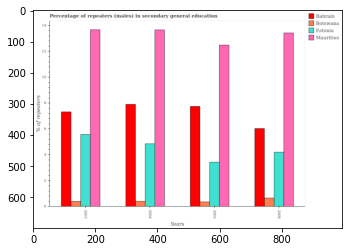

Number of QA =  30





,Years,Estonia,Botswana,Bahrain,Mauritius
0,2003,5.573733,0.439313,7.342288,13.722757
1,2004,4.888962,0.442169,7.925028,13.706744
2,2008,4.246920,0.705076,6.017479,13.481732
3,2005,3.482363,0.401140,7.787583,12.530609


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in botswana in 2004 and that in 2005 ?
PREDICTED =  0.041028444447111845
EXPECTED =  0.043809980154036976




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in estonia in 2008 and the percentage of male repeaters in botswana in 2005?
PREDICTED =  0.7645570354456543
EXPECTED =  3.846870213747021




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of male repeaters in bahrain and percentage of male repeaters in mauritius ?
PREDICTED =  16.541769356706457
EXP

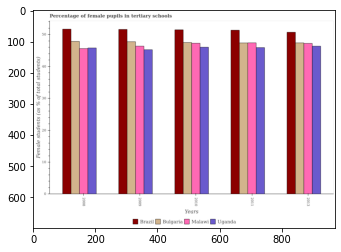

Number of QA =  30





,Years,Malawi,Bulgaria,Brazil,Uganda
0,2011,47.015322,47.205259,51.453256,45.700950
1,2010,47.204857,47.648012,51.589625,46.019406
2,2008,45.423985,47.877093,51.792464,45.873664
3,2013,47.402603,47.306434,50.705041,46.088472
4,2009,46.305652,47.716686,51.622718,45.232823


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in tertiary schools in malawi in 2009 and that in 2013 ?
PREDICTED =  -1.096951847108997
EXPECTED =  -0.864109039306598




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in tertiary schools in malawi in 2011 and the percentage of female pupils in tertiary schools in brazil in 2009?
PREDICTED =  0.7096699051914328
EXPECTED =  -4.208179473876896




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of female pupils in tertiary schools in uganda and percentage o

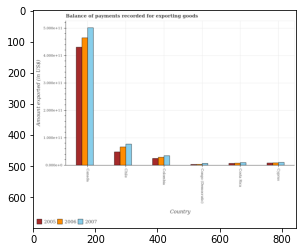

Number of QA =  29





,Country,2007,2005,2006
0,Colombia,0.370315,0.273001,0.310574
1,Congo (Democratic),0.083383,NaN,NaN
2,Canada,5.054389,4.361733,4.678432
3,Cyprus,0.121486,0.100287,0.106535
4,Chile,0.796621,0.505559,0.687294
5,Costa Rica,0.113585,0.086084,0.097595


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2007 in chile and that in costa rica ?
PREDICTED =  0.6830357493479386
EXPECTED =  67457539489.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2005 in canada and the amount exported in 2006 in congo (democratic)?
PREDICTED =  4.361733043943913
EXPECTED =  427599400000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported of/in 2005 and amount exported of/in 2007 in colombia?
PREDICTED =  4.956348548754927
EXPECTED =  -9827835885.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gp

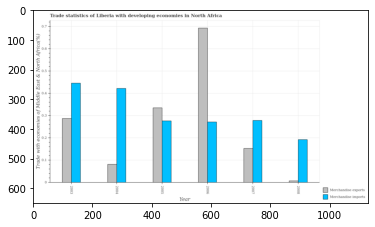

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,2003,0.446374,0.289417
1,2008,0.195012,0.009015
2,2005,0.278480,0.336198
3,2007,0.280906,0.154819
4,2004,0.427190,0.083553
5,2006,0.274219,0.696878


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2004 and that in 2006 ?
PREDICTED =  0.1529705307511498
EXPECTED =  0.15046211975197804




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2003 and the merchandise exports in 2006?
PREDICTED =  0.17215472483914607
EXPECTED =  0.174175119582826




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  0.06663439251142586
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

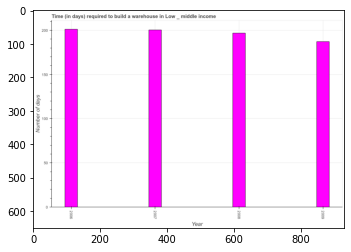

Number of QA =  23





,Year,Number of days
0,2007,201.670992
1,2008,197.375837
2,2009,187.558157
3,2006,202.466899


> what is the title of the graph ?
PREDICTED =  Time (in days) required to build a warehouse in Low __ middle income
EXPECTED =  Time (in days) required to build a warehouse in Low _ middle income




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Number of days
EXPECTED =  Number of days




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time required to build a warehouse in 2007 and 2009 ?
PREDICTED =  14.112834337292668
EXPECTED =  13.174




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median time required to build a warehouse ?
PREDICTED =  2007.5
EXPECTED =  198.616379310345




				 2 / 

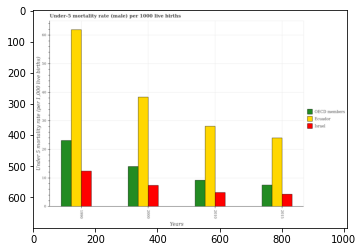

Number of QA =  29





,Years,OECD members,Israel,Ecuador
0,2010,9.319781,5.061210,28.285882
1,1990,23.289298,12.507576,61.959003
2,2000,14.173093,7.504224,38.331382
3,2015,7.628011,4.503439,23.985701


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in oecd members in 1990 and that in 2015 ?
PREDICTED =  0.0
EXPECTED =  15.601586674300684




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in oecd members in 2000 and the under-five mortality rate in ecuador in 2010?
PREDICTED =  4.8533123432097955
EXPECTED =  -14.102022084551201




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2015, what is the difference between the under-five mortality rate in ecuador and under-five mortality rate in oecd members ?
PREDICTED =  16.357690585590532
EXPECTED =  16.493225059

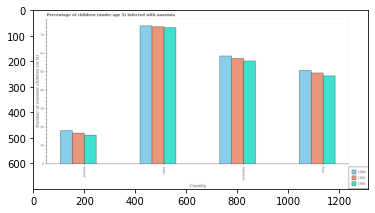

Number of QA =  29





,Country,1992,1990,1991
0,Iceland,15.763161,18.072515,16.934866
1,lran,47.641052,50.690864,49.327513
2,Indonesia,55.831051,58.483246,57.125962
3,India,73.740561,74.870884,74.383921


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children infected with anaemia in in 1990 in indonesia and the percentage of children infected with anaemia in in 1992 in iceland?
PREDICTED =  40.410730833067596
EXPECTED =  43.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0

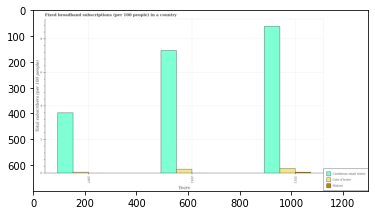

Number of QA =  29





,Years,Malawi,Cote d'Ivoire,Caribbean small states
0,2007,NaN,NaN,3.615570
1,2012,NaN,0.255188,7.356886
2,2013,NaN,0.297747,8.764877


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in malawi in 2007 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  -0.0009723113820197891




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in caribbean small states in 2007 and the number of broadband subscriptions in malawi in 2013?
PREDICTED =  2.6155701982828106
EXPECTED =  3.538478955324026




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the

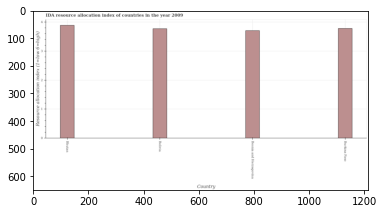

Number of QA =  22





,Country,Resource allocation index (1=low 6=high)
0,Bhutan,3.893375
1,Bolivia,3.780207
2,Bosnia and Herzegovina,3.709915
3,Burkina Faso,3.790240


> what is the title of the graph ?
PREDICTED =  IDA resource allocation index of countries in the year 2009
EXPECTED =  IDA resource allocation index of countries in the year 2009




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Resource allocation index (1=low 6=high)
EXPECTED =  Resource allocation index (1=low 6=high)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in bolivia and bosnia and herzegovina ?
PREDICTED =  0.07029192736209255
EXPECTED =  0.067




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ida resource allocation index ?
PREDICTED =  

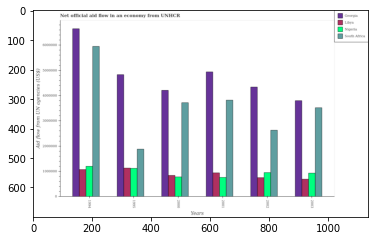

Number of QA =  30





,Years,Unnamed: 1,South Africa,Georgia,Nigeria
0,2000,8.482042e+05,3.715861e+06,4.161399e+06,7.944898e+05
1,2002,7.675461e+05,2.633301e+06,4.315356e+06,9.666506e+05
2,1994,1.084195e+06,5.931629e+06,6.633390e+06,1.211873e+06
3,2003,7.053157e+05,3.523783e+06,3.801762e+06,9.408134e+05
4,1995,1.137212e+06,1.888343e+06,4.801423e+06,1.112798e+06
5,2001,9.458107e+05,3.809652e+06,4.916935e+06,7.804385e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in georgia in 1995 and that in 2001 ?
PREDICTED =  -115511.9253134979
EXPECTED =  -110000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in nigeria in 2002 and the net official aid flow in libya in 1995?
PREDICTED =  -146147.78387364838
EXPECTED =  -180000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the net official aid flow in nigeria and net official aid flow in georgia ?
PREDICTED =  2005301.4979414213
EXPECTED =  -3390000.0




				 0 / 3 = 0.0


is_built_with_cuda

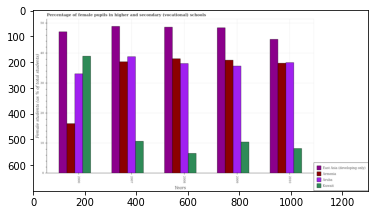

Number of QA =  30





,Years,Unnamed: 1,East Asia (developing only),Armenia,Kuwait
0,2010,36.871301,44.810707,36.826947,8.350953
1,2000,33.294383,47.137694,16.720751,39.121783
2,2007,39.032646,48.994240,37.142581,10.679761
3,2009,35.814873,48.826934,37.810007,10.518958
4,2008,36.767605,48.880163,38.227339,6.658677


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in east asia (developing only) in 2000 and that in 2009 ?
PREDICTED =  1960.8623063895102
EXPECTED =  -1.3392181396484872




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in kuwait in 2008 and the percentage of female pupils in higher and secondary schools in armenia in 2010?
PREDICTED =  1999.6490469825258
EXPECTED =  -30.06214046478273




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of f

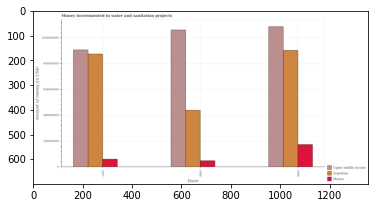

Number of QA =  29





,Years,Unnamed: 1,Mexico,Upper middle income
0,1999,9.127666e+08,1.780408e+08,1.092592e+09
1,1998,4.464918e+08,5.262407e+07,1.073143e+09
2,1997,8.867350e+08,6.325908e+07,9.134894e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the money investmented in water and sanitation projects in upper middle income in 1997 and that in 1999 ?
PREDICTED =  0.0
EXPECTED =  -179800000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the money investmented in water and sanitation projects in mexico in 1998 and the money investmented in water and sanitation projects in upper middle income in 1999?
PREDICTED =  861926706.6527925
EXPECTED =  -1037500000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the money investmented in water and sanitation projects in mexico a

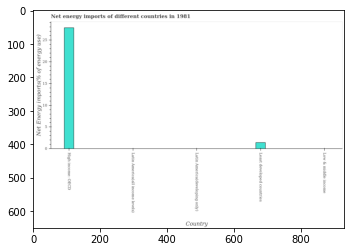

Number of QA =  18





,Country,Net Energy imports(% of energy use)
0,Latin America(al!l ncome levels),NaN
1,Low & middle income,NaN
2,Least developed countries,1.592778
3,High income: OECD,28.045306
4,Latin America(developing only),NaN


> what is the title of the graph ?
PREDICTED =  Net energy imports of different countries in 1981
EXPECTED =  Net energy imports of different countries in 1981




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Net Energy imports(% of energy use)
EXPECTED =  Net Energy imports(% of energy use)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the energy imports in high income: oecd and least developed countries ?
PREDICTED =  26.45252796622937
EXPECTED =  26.411




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median energy imports ?
PREDICTED =  14.81904232165444
EXPECTED =  0.0




				 4 / 5

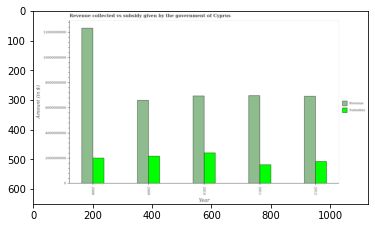

Number of QA =  28





,Year,Revenue,Subsidies
0,2008,1.228368e+10,2.042360e+09
1,2012,6.966308e+09,1.769872e+09
2,2009,6.578458e+09,2.202481e+09
3,2010,6.956691e+09,2.447007e+09
4,2011,7.025094e+09,1.513871e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of subsidies given in 2008 and that in 2010 ?
PREDICTED =  -404647187.5921185
EXPECTED =  -411915894.74020004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of revenue collected in 2009 and the amount of subsidies given in 2010?
PREDICTED =  -378233635.51432514
EXPECTED =  -348100000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of revenue collected and amount of subsidies given ?
PREDICTED =  29834642503.576176
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_availa

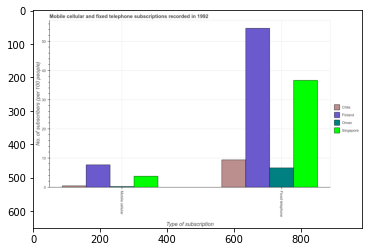

Number of QA =  23





,Type of subscription,Unnamed: 1,Finland,Singapore,Chile
0,Mobde cellular,NaN,7.946536,4.019519,NaN
1,Fixed telephone,6.893464,54.844526,36.825821,9.674943


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in singapore and that in oman ?
PREDICTED =  0.0
EXPECTED =  3.517984140704267




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers in singapore and the number of mobile cellular subscribers in oman?
PREDICTED =  -1.0
EXPECTED =  36.3734143474724




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers and number of mobile cellular subscribers in oman ?
PREDICTED =  -1.0
EXPECTED =  6.379064563951918




				 0 / 3 = 0.0


is_built_with

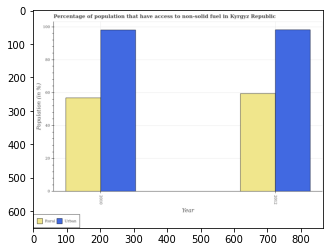

Number of QA =  24





,Year,Urban,Rural
0,2012,98.691703,59.733776
1,2010,98.887274,57.056856


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 2010 and that in 2012 ?
PREDICTED =  -2.6769206690720537
EXPECTED =  -2.6003092527388887




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 2012 and the urban population in 2010?
PREDICTED =  2.6769206690720537
EXPECTED =  2.6003092527388887




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the rural population and urban population ?
PREDICTED =  -40.39417234091202
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting 

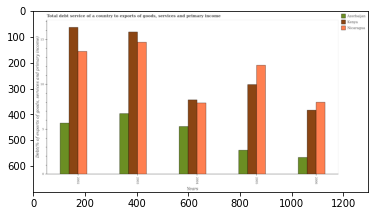

Number of QA =  29





,Years,Azerbaijan,Kenya,Nicaragua
0,2005,2.706852,10.082339,12.238717
1,2003,6.827625,15.944309,14.766455
2,2004,5.367028,8.400995,7.998011
3,2006,1.912381,7.191027,8.084794
4,2002,5.762492,16.510507,13.813266


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in kenya in 2004 and that in 2006 ?
PREDICTED =  1.2099682671767953
EXPECTED =  1.1454052857953494




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in kenya in 2002 and the total debt service in azerbaijan in 2004?
PREDICTED =  8.109512155131348
EXPECTED =  11.046658978190848




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the total debt service in nicaragua and total debt service in azerbaijan ?
PREDICTED =  51.90124195807294
EXPECTED =  7.948417950755132




				 0 / 3 = 0.0


is_bu

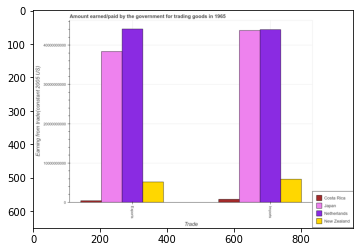

Number of QA =  23





,Trade,Japan,New Zealand,Costa Rica,Netherlands
0,NaN,3.889204e+10,5.380215e+09,NaN,4.427689e+10
1,Imports,4.394477e+10,6.044267e+09,9.327968e+08,4.416668e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from exports in japan and that in netherlands ?
PREDICTED =  -5274635370.437126
EXPECTED =  -5732523677.7808




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from exports in japan and the amount paid for imports in netherlands?
PREDICTED =  -5274635370.437126
EXPECTED =  -5574963996.092697




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from exports and amount paid for imports in japan ?
PREDICTED =  -43944766236.51473
EXPECTED =  -5359481519.600197




				 0 / 3 = 0.0


is_built_with_cuda: Tr

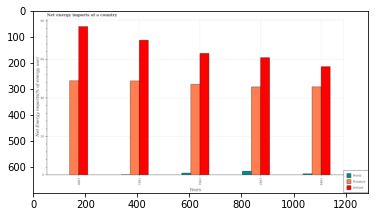

Number of QA =  26





,Years,World,Hungary,Ireland
0,1983,2.141842,46.181386,61.407645
1,1984,0.809350,46.058416,56.588325
2,1981,NaN,48.732765,69.952144
3,1982,1.181256,47.378558,63.300492
4,1980,NaN,49.246314,77.860170


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in ireland in 1980 and that in 1984 ?
PREDICTED =  21.271844999871774
EXPECTED =  20.79794899903031




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in ireland in 1981 and the net energy imports in hungary in 1984?
PREDICTED =  13.363819191943136
EXPECTED =  24.152043113326307




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the net energy imports in hungary and net energy imports in world ?
PREDICTED =  234.597438702187
EXPECTED =  45.11389425591868




				 1 / 3 = 0.3333


is_built_

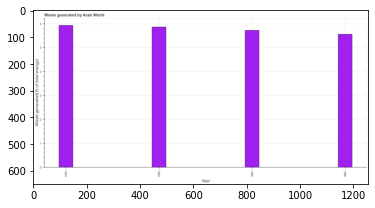

Number of QA =  23





,Year,Waste generated(% of total energy)
0,1983,5.967341
1,1986,5.552575
2,1984,5.891131
3,1985,5.778325


> what is the title of the graph ?
PREDICTED =  Waste generated by Arab World
EXPECTED =  Waste generated by Arab World




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Waste generated(% of total energy)
EXPECTED =  Waste generated(% of total energy)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of waste generated in 1984 and 1985 ?
PREDICTED =  0.11280585887874484
EXPECTED =  0.141




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of waste generated ?
PREDICTED =  5.834728313658481
EXPECTED =  5.797927916121




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_availa

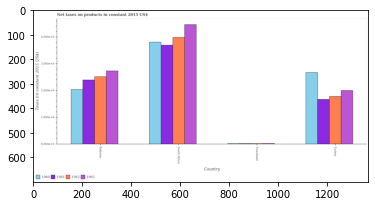

Number of QA =  30





,Country,1963,1962,1961,1960
0,Swaziland,NaN,NaN,NaN,NaN
1,Turkey,2.015610,1.787068,1.685103,2.685646
2,Pakistan,2.736508,2.515043,2.401192,2.047050
3,South Africa,4.466993,3.980703,3.709126,3.822298


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in 1962 in swaziland and that in turkey ?
PREDICTED =  -1.7870676960324563
EXPECTED =  -176043878.47064415




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in 1963 in turkey and the net taxes on products in 1960 in south africa?
PREDICTED =  -2.451383088280459
EXPECTED =  -180620927.90387702




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products of/in 1960 and net taxes on products of/in 1962 in pakistan?
PREDICTED =  0.48495675169623986
EXPECTED =  -47879020.575773




				 0 

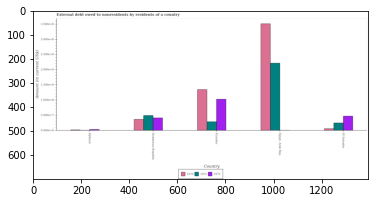

Number of QA =  26





,Country,1972,1971,1970
0,Djibou ti,NaN,NaN,NaN
1,Dominican Republic,0.431535,0.506857,0.380886
2,"Egypt, Arab Rep.",NaN,2.226278,3.525613
3,El Salvador,0.487076,0.262800,0.075144
4,Ecuador,1.048435,0.305367,1.360270


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in 1970 in djibouti and that in dominican republic ?
PREDICTED =  4.961026702147846
EXPECTED =  -34689000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in 1971 in ecuador and the external debt owed by residents in 1970 in egypt, arab rep.?
PREDICTED =  -1.9209109914609355
EXPECTED =  -322974000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents of/in 1970 and external debt owed by residents of/in 1972 in dominican republic?
PREDICTED =  

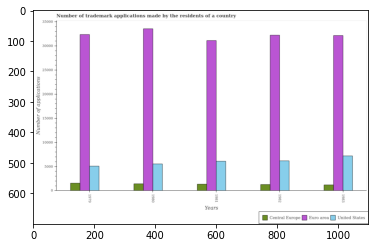

Number of QA =  29





,Years,United States,Central Europe,Euro area
0,1983,7274.441183,1287.367493,32232.419426
1,1979,5153.602085,1631.293603,32325.994821
2,1980,5649.455708,1518.129250,33783.035538
3,1982,6302.995182,1371.020607,32188.738529
4,1981,6223.842637,1437.003245,30950.785674


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the residents in united states in 1980 and that in 1982 ?
PREDICTED =  5648.455708100323
EXPECTED =  -647.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the residents in euro area in 1981 and the number of trademark applications made by the residents in central europe in 1979?
PREDICTED =  -4.0
EXPECTED =  29557.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1979, what is the difference between the number of trademark applications made by the residents in united states a

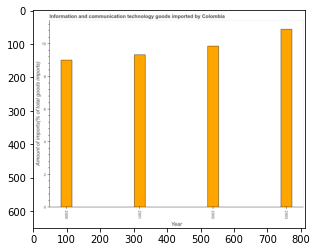

Number of QA =  23





,Year,Amount of imports(% of total goods imports)
0,2003,10.934553
1,2002,9.839576
2,2000,9.032236
3,2001,9.311166


> what is the title of the graph ?
PREDICTED =  Information and communication technology goods imported by Colombia
EXPECTED =  Information and communication technology goods imported by Colombia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of imports(% of total goods imports)
EXPECTED =  Amount of imports(% of total goods imports)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods imports in 2002 and 2003 ?
PREDICTED =  -1.0949772621590412
EXPECTED =  -1.033




				 3 / 4 = 0.75


> what is the median amount of ict goods imports ?
PREDICTED =  None
EXPECTED =  9.59579551495




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
E

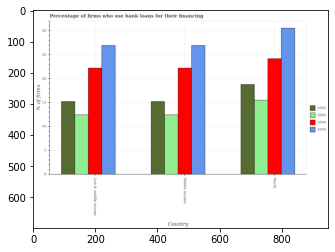

Number of QA =  30





,Country,2002,2003,2004,2005
0,World,18.856243,15.642490,24.164106,30.584302
1,Low & middle income,15.348586,12.687209,22.419483,26.987425
2,Middle income,15.313221,12.486197,22.337537,27.012056


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?

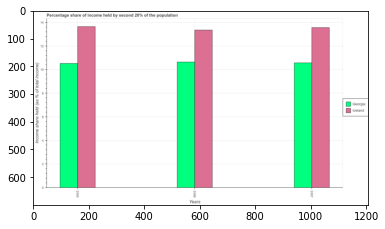

Number of QA =  28





,Years,Georgia,iceland
0,2007,10.569443,13.623077
1,2005,10.510054,13.676578
2,2006,10.649536,13.376284


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by second 20% of the population in georgia in 2005 and that in 2007 ?
PREDICTED =  -0.059388973380237076
EXPECTED =  -0.05000000000000071




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by second 20% of the population in iceland in 2007 and the share of income held by second 20% of the population in georgia in 2005?
PREDICTED =  -0.05350133375225674
EXPECTED =  3.040000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

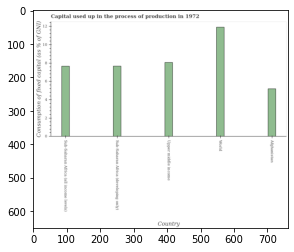

Number of QA =  22





,Country,Consumption of fixed capital (as % of GNI)
0,World,11.954157
1,Afghanistan,5.226923
2,Upper middie income,8.077175
3,Sub-Saharan Africa (developing only),7.725572
4,Sub-Saharan Africa (all income levels),7.682999


> what is the title of the graph ?
PREDICTED =  Capital used up in the process of production in 1972
EXPECTED =  Capital used up in the process of production in 1972




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Consumption of fixed capital (as % of GNI)
EXPECTED =  Consumption of fixed capital (as % of GNI)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in afghanistan and world ?
PREDICTED =  -6.72723431265711
EXPECTED =  -6.723




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median consumption of fixed capital ?
PREDICTED =  7.725572376904341
EXPECTED

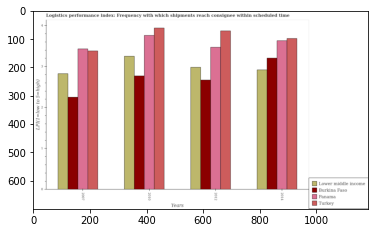

Number of QA =  30





,Years,Turkey,Panama,Burkina Faso,Lower middle income
0,2010,3.950925,3.795324,2.784037,3.245090
1,2014,3.679004,3.631053,3.209937,2.926313
2,2012,3.894259,3.481966,2.684181,2.989595
3,2007,3.385488,3.438624,2.246774,2.840343


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistics performance index in panama in 2007 and that in 2012 ?
PREDICTED =  -0.043342126802622616
EXPECTED =  -0.040000000000000036




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistics performance index in panama in 2014 and the logistics performance index in burkina faso in 2012?
PREDICTED =  0.14908653546195438
EXPECTED =  0.9603920000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the logistics performance index in turkey and logistics performance index in panama ?
PREDICTED =  11.322932732434943
EXPECTE

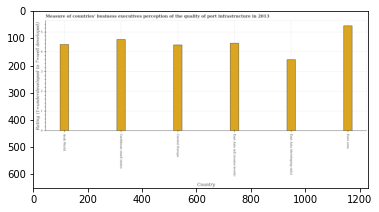

Number of QA =  22





,Country,Rating (1=underdeveloped to 7=well developed)
0,Central Europe,4.415566
1,Caribbean small states,4.686136
2,East Asia (all income levels),4.506630
3,Euro area,5.386342
4,Arab World,4.468330
5,East Asia (developing only),3.644469


> what is the title of the graph ?
PREDICTED =  Measure of countries’ business executives perception of the quality of port infrastructure in 2013
EXPECTED =  Measure of countries' business executives perception of the quality of port infrastructure in 2013




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Rating (1=underdeveloped to 7=well developed)
EXPECTED =  Rating (1=underdeveloped to 7=well developed) 




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring quality of port infrastructure in east asia (developing only) and euro area ?
PREDICTED =  -0.43108026708560754
EXPECTED =  -1.716




				 1 / 4 = 0.25


> what is the median rating measuring quality of port infrastructure ?
PREDICTE

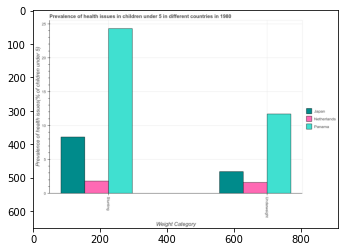

Number of QA =  23





,Weight Category,Japan,Panama,Netherlands
0,Stunting,8.484118,24.407770,1.924437
1,Underweight,3.337194,11.796446,1.715646


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted children in panama and that in japan ?
PREDICTED =  15.923651839469578
EXPECTED =  15.99999904632564




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweight children in japan and the percentage of stunted children in panama?
PREDICTED =  -8.459251574402366
EXPECTED =  -21.09999918937678




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of und

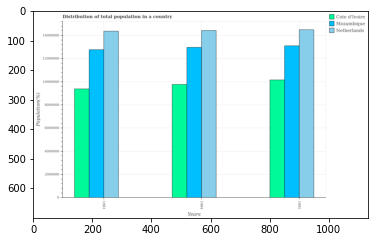

Number of QA =  29





,Years,Mozambique,Cote d'Ivoire,Netherlands
0,1983,1.293741e+07,9.512084e+06,1.447509e+07
1,1984,1.306852e+07,9.860632e+06,1.455233e+07
2,1985,1.322204e+07,1.026203e+07,1.463652e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of in netherlands in 1983 and that in 1985 ?
PREDICTED =  -161436.80950997025
EXPECTED =  -124562




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of in netherlands in 1983 and the population of in mozambique in 1984?
PREDICTED =  -77244.70503995754
EXPECTED =  1398735




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the population of in netherlands and population of in mozambique ?
PREDICTED =  1332602.3065615613
EXPECTED =  1388650




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available:

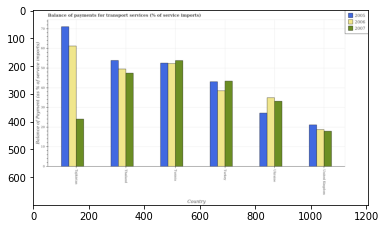

Number of QA =  29





,Country,2007,2005,2006
0,Turkey,44.061664,43.610403,39.126760
1,Tunisia,54.805106,53.432680,52.780359
2,Ukraine,33.714263,27.713684,35.598877
3,United Kingdom,18.433880,21.731171,19.212830
4,Thailand,48.236000,54.567265,50.184772
5,Tajikistan,24.580903,72.005411,62.131462


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2007 in tunisia and that in turkey ?
PREDICTED =  10.7434419665964
EXPECTED =  10.453833577175395




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2005 in turkey and the balance of payments for transport services in 2007 in tunisia?
PREDICTED =  -9.822277003213358
EXPECTED =  -10.778961796457807




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services of/in 2006 and balance of payments for transport services of/

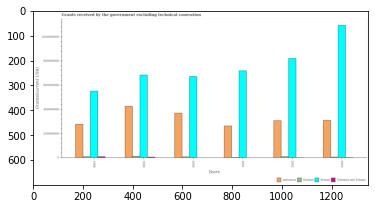

Number of QA =  30





,Years,Indonesia,Trinidad and Tobago,Poland,Kiribati
0,2003,3.152156e+08,NaN,1.108427e+09,NaN
1,2001,2.709543e+08,NaN,7.311337e+08,NaN
2,1999,4.348521e+08,NaN,6.916831e+08,1.578385e+07
3,1998,2.826850e+08,1.281429e+07,5.597886e+08,1.281658e+07
4,2002,3.130224e+08,NaN,8.312806e+08,1.298874e+07
5,2000,3.763124e+08,NaN,6.824056e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in poland in 2000 and that in 2003 ?
PREDICTED =  -426021837.1216426
EXPECTED =  -423180000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in kiribati in 2000 and the total grants received by the government in poland in 2002?
PREDICTED =  -831280630.6060848
EXPECTED =  -812620000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the total grants received by the government in trinidad and tobago and total grants received by the government i

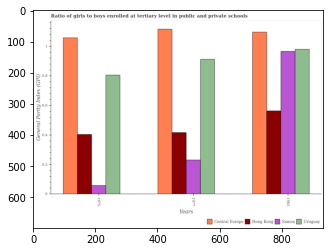

Number of QA =  30





,Years,Uruguay,Central Europe,Hong Kong,Samoa
0,1977,0.910483,1.116438,0.417261,0.234336
1,1975,0.805775,1.055719,0.406207,0.060445
2,1983,0.978343,1.099119,0.565834,0.967529


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in samoa in 1977 and that in 1983 ?
PREDICTED =  -0.7331929679867929
EXPECTED =  -0.73566




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in hong kong in 1975 and the general parity index in central europe in 1983?
PREDICTED =  -0.159626728702979
EXPECTED =  -0.6933399968337999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the general parity index in uruguay and general parity index in hong kong ?
PREDICTED =  2.5368992918650433
EXPECTED =  0.40228




				 1 / 3 = 0.3333


is_

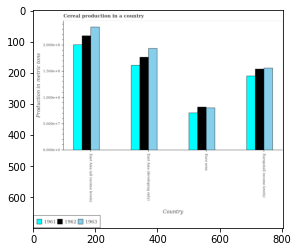

Number of QA =  29





,Country,1963,1962,1961
0,Euro area,0.816427,0.837617,0.725125
1,Europe(all income levels),1.580268,1.556141,1.427862
2,East Asia (all income levels),2.357045,2.191806,2.034514
3,East Asia (developing only),1.956395,1.778684,1.634449


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in 1963 in euro area and that in europe(all income levels) ?
PREDICTED =  -0.7638410255774729
EXPECTED =  -75870750.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in 1963 in europe(all income levels) and the total cereal production in 1962 in east asia (developing only)?
PREDICTED =  -0.3761272079371085
EXPECTED =  -20654889.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production of/in 1961 and total cereal production of/in 1963 in euro area?
PREDICTED =  -0.09130215

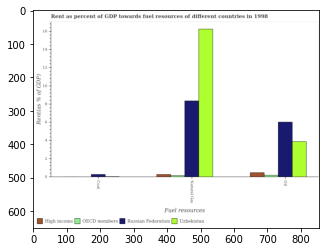

Number of QA =  28





,Fuel resources,Uzbekistan,OECD members,Russian Federation,High income
0,Natural Gas,16.387876,0.193739,8.312900,0.302763
1,Coal,NaN,NaN,0.297784,NaN
2,Oil,3.953145,0.226060,6.079426,0.516175


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the rent towards oil in russian federation ?
PREDICTED =  2.026475453147993
EXPECTED =  6.0182085710588




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in high income and that in russian federation ?
PREDICTED =  0.3333333333333333
EXPECTED =  -8.086419661355077




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards coal in high income and the rent towards natural gas in uzbekistan?
PREDICTED =  -0.30276341536104473
EXPECTED =  -16.231746977301874




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

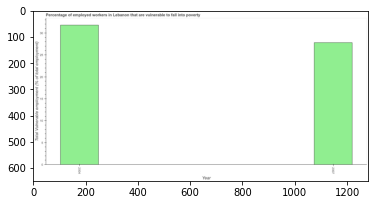

Number of QA =  19





,Year,Total Vulnerable employment (% of total employment)
0,2004,32.052516
1,2007,28.136867


> what is the title of the graph ?
PREDICTED =  Percentage of employed workers in Lebanon that are vulnerable to fall into poverty
EXPECTED =  Percentage of employed workers in Lebanon that are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total Vulnerable employment (% of total employment)
EXPECTED =  Total Vulnerable employment (% of total employment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total vulnerable employment in 2004 and 2007 ?
PREDICTED =  3.9156486839576203
EXPECTED =  4.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total vul

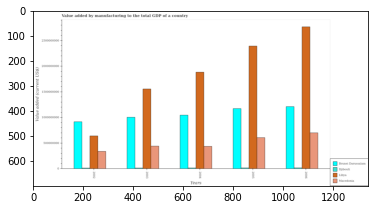

Number of QA =  30





,Years,Unnamed: 1,Brunei Darussalam,Djibouti,Macedonia
0,2002,6.539772e+08,9.293850e+08,NaN,3.447959e+08
1,2006,2.782326e+09,1.229489e+09,2.575069e+07,7.036427e+08
2,2003,1.567287e+09,1.018730e+09,NaN,4.486233e+08
3,2004,1.896698e+09,1.055793e+09,NaN,4.456166e+08
4,2005,2.398261e+09,1.184543e+09,NaN,6.170783e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in macedonia in 2004 and that in 2006 ?
PREDICTED =  -258026104.43648213
EXPECTED =  -264208225.184384




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in djibouti in 2003 and the value added by manufacturing to the total gdp in libya in 2002?
PREDICTED =  0.0
EXPECTED =  -625851876.4725759




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the value added by manufacturing to the total gdp in djibouti and value added by manufacturing 

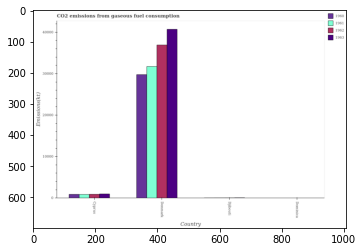

Number of QA =  30





,Country,1963,1962,1961,1960
0,Dominica,NaN,NaN,NaN,NaN
1,Denmark,40912.460448,37126.351029,32029.517691,30084.319008
2,NaN,1125.606672,1051.958172,979.351564,1035.122655
3,Djibouti,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1961 in denmark and that in djibouti ?
PREDICTED =  31050.166127662204
EXPECTED =  31690.214




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1961 in djibouti and the amount of co2 emitted in 1960 in denmark?
PREDICTED =  -31050.166127662204
EXPECTED =  -29735.702999999998




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted of/in 1960 and amount of co2 emitted of/in 1961 in dominica?
PREDICTED =  30140.090099044923
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_wit

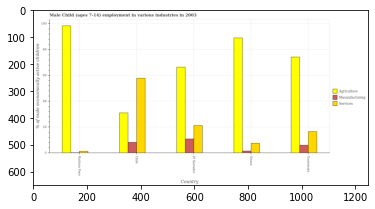

Number of QA =  29





,Country,Agriculture,Maunufacturing,Services
0,Ghana,89.562276,1.890728,7.836264
1,Guatemala,74.730575,6.365478,16.958076
2,Chile,31.336108,8.617747,58.373607
3,Burkina Faso,98.799097,NaN,1.685266
4,E] Salvador,66.880241,11.165603,21.659091


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in agriculture in burkina faso and that in ghana ?
PREDICTED =  9.236821281557326
EXPECTED =  9.400000000000006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing in chile and the percentage of economically active children in agriculture in el salvador?
PREDICTED =  -35.544133565374
EXPECTED =  -58.1842140009




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing and percentage of eco

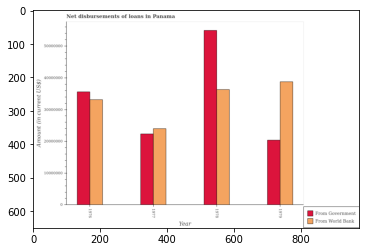

Number of QA =  28





,Year,From World Bank,From Government
0,1976,3.316553e+07,3.566656e+07
1,1979,3.892181e+07,2.062759e+07
2,1978,3.645941e+07,5.491622e+07
3,1977,2.419064e+07,2.252340e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from world bank in 1977 and that in 1978 ?
PREDICTED =  -12268771.071265358
EXPECTED =  -12321000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from world bank in 1978 and the net disbursements of loan from government in 1976?
PREDICTED =  3293887.252961628
EXPECTED =  3185000




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net disbursem

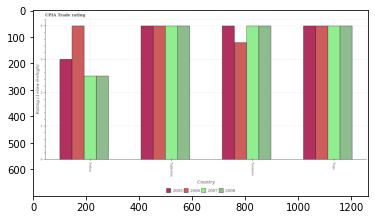

Number of QA =  29





,Country,2007,2005,2008,2006
0,Sudan,2.495995,3.007781,2.499406,4.026424
1,Tanzania,3.993331,4.002650,4.004782,3.513972
2,Tajikistan,4.001193,3.979587,3.993622,3.988853
3,Togo,4.006502,3.964927,4.000822,3.992468


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in tajikistan and that in tanzania ?
PREDICTED =  0.007861140394541
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in tajikistan and the cpia rating in 2005 in tanzania?
PREDICTED =  -0.011159975849845072
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2007 and cpia rating of/in 2005 in sudan?
PREDICTED =  11.489240303504612
EXPECTED =  -0.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

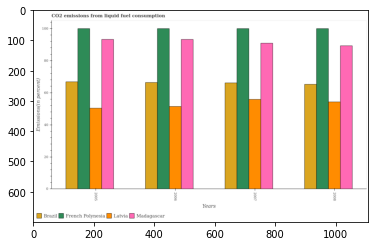

Number of QA =  30





,Years,Brazil,French Polynesia,Latvia,Madagascar
0,2007,66.464116,100.649072,55.951611,91.222395
1,2008,65.420734,100.423785,54.477294,90.200420
2,2006,66.631814,100.209905,51.820437,93.301040
3,2005,67.002357,100.077287,50.659986,93.380777


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in latvia in 2005 and that in 2007 ?
PREDICTED =  -5.29162515573681
EXPECTED =  -5.480957878334806




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in latvia in 2008 and the total co2 emitted in french polynesia in 2006?
PREDICTED =  2.656856820267514
EXPECTED =  -45.707656612529




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the total co2 emitted in brazil and total co2 emitted in madagascar ?
PREDICTED =  -102.58561239234211
EXPECTED =  -26.848128087386797




				 1 / 3 = 0.3333


i

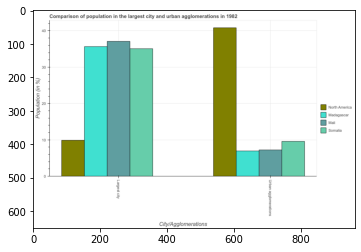

Number of QA =  23





,City/Agglomerations,Unnamed: 1,Mali,Somalia,North America
0,Urban aggiome rations,7.074542,7.343481,9.714549,41.137909
1,Largest city,35.508988,37.058034,35.230867,10.053348


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city in madagascar and that in north america ?
PREDICTED =  27.00468590031113
EXPECTED =  25.78649106059882




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

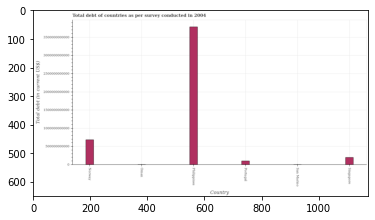

Number of QA =  22





,Country,Total debt (in current US$)
0,Singapore,2.148825e+11
1,Oman,NaN
2,Philippines,3.839212e+12
3,San Marmo,NaN
4,Norway,7.090652e+11
5,Portugal,1.183709e+11


> what is the title of the graph ?
PREDICTED =  Total debt of countries as per survey conducted in 2004
EXPECTED =  Total debt of countries as per survey conducted in 2004




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total debt (in current US$)
EXPECTED =  Total debt (in current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in san marino and singapore ?
PREDICTED =  0.0
EXPECTED =  -197451776758.11




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total debt ?
PREDICTED =  461973855192.26
EXPECTED =  149256785000.0




				 3 / 5 = 0.6


is_built_with_cuda: 

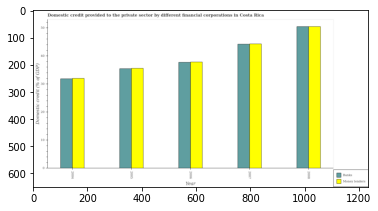

Number of QA =  28





,Year,Banks,Money lenders
0,2004,32.032538,32.266820
1,2006,37.904880,38.240611
2,2007,44.489687,44.555127
3,2008,50.654710,50.760539
4,2005,35.697036,35.794298


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by money lenders in 2005 and that in 2006 ?
PREDICTED =  -2.4463126782266755
EXPECTED =  -2.2449540831991044




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by banks in 2008 and the domestic credit provided by money lenders in 2007?
PREDICTED =  6.1650224923987835
EXPECTED =  6.250944205741597




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the domestic credit provided by banks and domestic credit provided by money lenders ?
PREDICTED =  -4.362988880435083
EXPECTED =  0.0

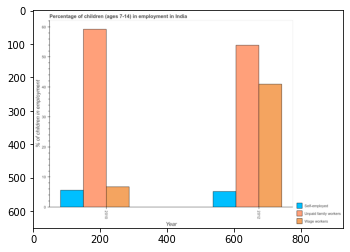

Number of QA =  25





,Year,Self-employed,Unpaid family workers,Wage workers
0,2012,5.465646,54.436203,41.242496
1,2010,5.860692,60.033030,6.987691


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children employed as unpaid family workers in 2010 and that in 2012 ?
PREDICTED =  5.5968268362461515
EXPECTED =  5.329999999999998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children employed as wage workers in 2010 and the percentage of self employed children in 2012?
PREDICTED =  1.522045511525505
EXPECTED =  -34.19




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of children employed as wage workers and percentage of self employed children ?
PREDICTED =  42.7645412175454

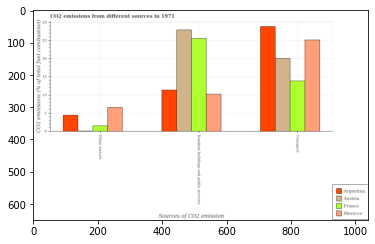

Number of QA =  28





,Sources of CO2 emission,Unnamed: 1,Austria,France,Morocco
0,Other sectors,4.572040,NaN,1.613437,6.689260
1,Transport,29.126526,20.205670,14.071876,25.313755
2,Resident buildings and public services,11.440756,27.978183,25.853683,10.306914


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in france and that in morocco ?
PREDICTED =  -11.241879183272612
EXPECTED =  -11.2815573707785




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in argentina and the percentage of co2 emissions from other sectors in morocco?
PREDICTED =  -24.313754820232344
EXPECTED =  22.268600348418747




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.






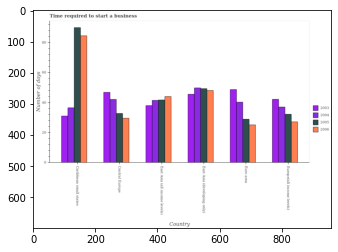

Number of QA =  30





,Country,2005,2004,2003,2006
0,Europe(all income levels),32.465596,37.777554,42.737974,27.759939
1,Euro area,29.424638,40.510989,49.187638,25.952918
2,Caribbean small states,90.763240,37.111655,31.564024,84.840204
3,East Asia (all income levels),42.276569,42.050677,38.551516,44.468594
4,East Asia (developing only),49.536167,50.532440,46.259689,48.467462
5,Central Europe,33.171132,42.828528,47.339280,29.981300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in 2004 in caribbean small states and that in east asia (all income levels) ?
PREDICTED =  -4.939022251695754
EXPECTED =  -4.9583333333333




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in 2005 in central europe and the number of days required to start a business in 2006 in euro area?
PREDICTED =  -29.424637748567193
EXPECTED =  7.639037433155099




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business of/in 2005

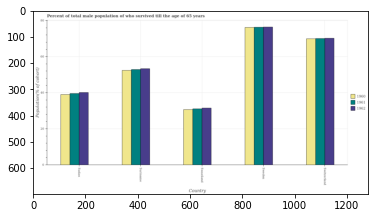

Number of QA =  29





,Country,1962,1961,1960
0,Suriname,53.700245,53.144601,52.557927
1,Sudan,40.441121,39.977437,39.261591
2,Switzerland,70.718154,70.774119,70.261204
3,Swaziland,31.736251,31.292307,30.823460
4,Sweden,76.965149,76.973275,76.542439


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in 1960 in suriname and that in swaziland ?
PREDICTED =  -30.73625116681233
EXPECTED =  21.749719999999996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in 1960 in switzerland and the percentage of total male population who survived till the age of 65 years in 1962 in suriname?
PREDICTED =  -52.700244725117024
EXPECTED =  16.600779999999986




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the

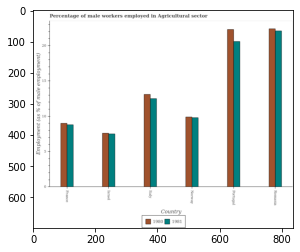

Number of QA =  28





,Country,1980,1981
0,Italy,13.210687,12.639413
1,Norway,9.998768,9.917868
2,Portugal,22.617667,20.702627
3,Israel,7.711310,7.638733
4,France,9.117351,8.839474
5,Romania,22.614281,22.190401


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1981 in italy and that in romania ?
PREDICTED =  -9.550987180701352
EXPECTED =  -9.600000381469691




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1981 in portugal and the percentage of male workers employed in agricultural sector in 1980 in norway?
PREDICTED =  10.784758897235754
EXPECTED =  10.700000762939432




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sec

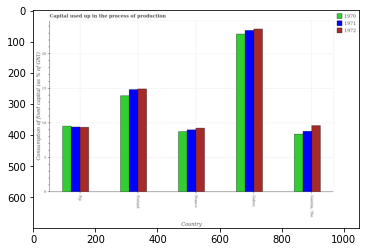

Number of QA =  29





,Country,1972,1971,1970
0,France,9.294231,9.056012,8.734955
1,Gabon,23.737414,23.475309,22.870472
2,Finland,14.951983,14.834232,13.976382
3,"Gambia, The",9.633213,8.869440,8.418353
4,Fiji,9.449869,9.416646,9.558655


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the capital used up in the process of production in 1971 in fiji to that in france?
PREDICTED =  1.0398225691667884
EXPECTED =  1.045701233426392




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


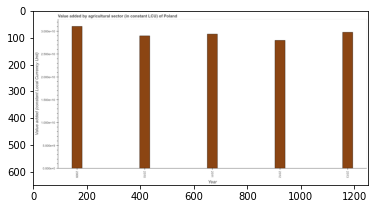

Number of QA =  23





,Year,Value added (constant Local Currency Unit)
0,2012,2.810152
1,2010,2.920062
2,2013,2.996871
3,2009,3.139091
4,2011,2.964731


> what is the title of the graph ?
PREDICTED =  Value added by agricultural sector (in constant LCU) of Poland
EXPECTED =  Value added by agricultural sector (in constant LCU) of Poland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Value added (constant Local Currency Unit)
EXPECTED =  Value added (constant Local Currency Unit)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in 2009 and 2011 ?
PREDICTED =  0.1743599945900587
EXPECTED =  1685655400.0




				 3 / 4 = 0.75


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  29390380200.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting 

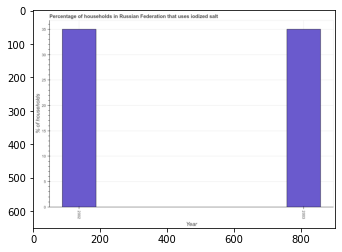

Number of QA =  19





,Year,% of households
0,2002,35.167492
1,2003,35.194821


> what is the title of the graph ?
PREDICTED =  Percentage of households in Russian Federation that uses iodized salt
EXPECTED =  Percentage of households in Russian Federation that uses iodized salt




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of households
EXPECTED =  % of households




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of households where iodized salt is consumed in 2002 and 2003 ?
PREDICTED =  -0.027329014662427653
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of households where iodized salt is consumed ?
PREDICTED =  35.1

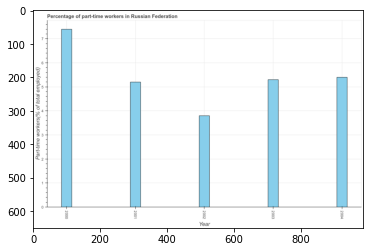

Number of QA =  23





,Year,Part-time workers(% of total employed)
0,2003,5.313638
1,2001,5.215528
2,2000,7.418578
3,2002,3.818417
4,2004,5.410221


> what is the title of the graph ?
PREDICTED =  Percentage of part-time workers in Russian Federation
EXPECTED =  Percentage of part-time workers in Russian Federation




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time workers(% of total employed)
EXPECTED =  Part-time workers(% of total employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in 2000 and 2003 ?
PREDICTED =  2.104940046033496
EXPECTED =  2.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  2002.0
EXPECTED =  5.300000190734862




		

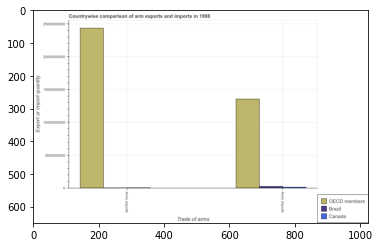

Number of QA =  23





,Trade of arms,OECD members,Brazil,Canada
0,NaN,1.369511e+10,NaN,NaN
1,Arms exports,2.451412e+10,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Export or import quantity
EXPECTED =  5000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Countrywise comparison of arm exports and imports in 1998
EXPECTED =  Countrywise comparison of arm exports and imports in 1998




				 1 / 6 = 0.1667


> what is the labe

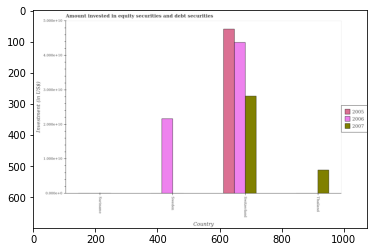

Number of QA =  24





,Country,2007,2005,2006
0,Thailand,0.686402,NaN,NaN
1,Sweden,NaN,NaN,2.168031
2,Suriname,NaN,NaN,NaN
3,Switzerland,2.814459,4.757558,4.405332


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in 2005 in suriname and that in switzerland ?
PREDICTED =  0.0
EXPECTED =  -47625000164.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in 2006 in switzerland and the amount invested in equity securities and debt securities in 2005 in suriname?
PREDICTED =  0.0
EXPECTED =  43747137530.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities of/in 2006 and amount invested 

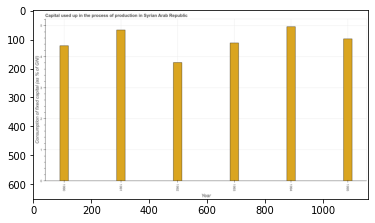

Number of QA =  23





,Year,Consumption of fixed capital (as % of GNI)
0,1995,4.579586
1,1991,4.866124
2,1993,4.468662
3,1994,4.995148
4,1992,3.828194
5,1990,4.373185


> what is the title of the graph ?
PREDICTED =  Capital used up in the process of production in Syrian Arab Republic
EXPECTED =  Capital used up in the process of production in Syrian Arab Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Consumption of fixed capital (as % of GNI)
EXPECTED =  Consumption of fixed capital (as % of GNI)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in 1991 and 1994 ?
PREDICTED =  -0.12902447644880066
EXPECTED =  -0.108




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median consumption of fixed capital ?
PREDICTED =  3.82

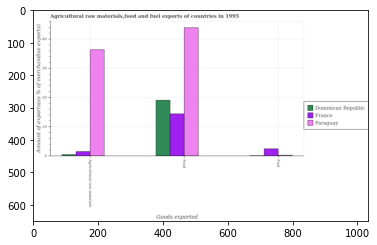

Number of QA =  28





,Goods exported,Dominican Republic,France,Paraguay
0,Fuel,NaN,2.573541,NaN
1,Food,19.228395,14.479574,44.085195
2,Agricultural raw materials,NaN,1.660889,36.414605


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports and percentage of food exports in dominican republic ?
PREDICTED =  -19.228395387821827
EXPECTED =  -18.979507256668256




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of raw materials exports in paraguay to that in dominican republic ?
PREDICTED =  1.8937932216668973
EXPECTED =  87.37313371999632




				 1 / 4 = 0.25


is_built_with_cuda: Tru

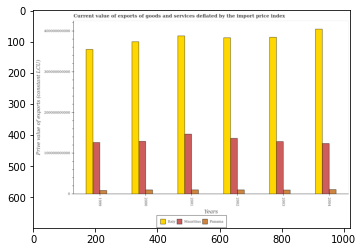

Number of QA =  29





,Years,Mauritius,Panama,Italy
0,1999,1.264957e+11,9.884400e+09,3.537510e+11
1,2001,1.481814e+11,1.163170e+10,3.879570e+11
2,2004,1.244376e+11,1.214580e+10,4.057332e+11
3,2003,1.295945e+11,1.102204e+10,3.854096e+11
4,2002,1.383793e+11,1.176271e+10,3.851795e+11
5,2000,1.298542e+11,1.181305e+10,3.746285e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in panama in 2001 and that in 2002 ?
PREDICTED =  -131004640.08725166
EXPECTED =  117532474.02190018




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in mauritius in 2001 and the prive value of exports in panama in 2002?
PREDICTED =  9802085717.9823
EXPECTED =  136747499570.5437




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the prive value of exports in mauritius and prive value of exports in panama ?
PREDICTED =  113060978466.61679
EXPECTED =  112920570120.3798




				 1 /

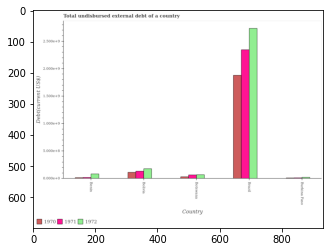

Number of QA =  29





,Country,1972,1971,1970
0,Benin,0.087542,NaN,NaN
1,Brazil,2.754079,2.352129,1.903157
2,Bolivia,0.184296,0.139239,0.118683
3,Botswana,0.074658,0.070397,0.039117
4,Burkina Faso,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1972 in botswana and that in burkina faso ?
PREDICTED =  0.07465767547963237
EXPECTED =  46677000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1971 in botswana and the total undisbursed external debt in 1970 in brazil?
PREDICTED =  -2.2817316451850154
EXPECTED =  -1813948000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt of/in 1970 and total undisbursed external debt of/in 1971 in brazil?
PREDICTED =  -0.29117246094031124
EXPE

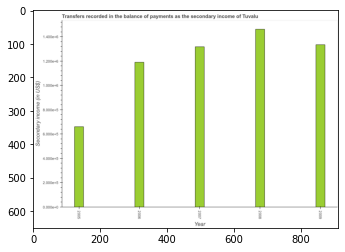

Number of QA =  23





,Year,Secondary income (in US$)
0,2008,1.466084
1,2006,1.187256
2,2005,0.662917
3,2009,1.329461
4,2007,1.315536


> what is the title of the graph ?
PREDICTED =  Transfers recorded in the balance of payments as the secondary income of Tuvalu
EXPECTED =  Transfers recorded in the balance of payments as the secondary income of Tuvalu




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Secondary income (in US$)
EXPECTED =  Secondary income (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of secondary income in 2007 and 2009 ?
PREDICTED =  -0.013925477083564841
EXPECTED =  -16944.964




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of secondary income ?
PREDICTED =  2007.0
EXPECTED

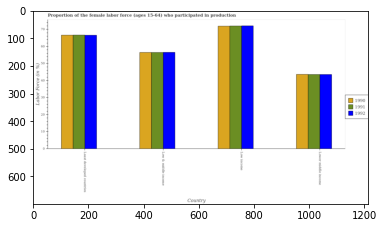

Number of QA =  29





,Country,1992,1990,1991
0,Least developed countries,65.991099,66.123743,66.023502
1,Lower middle income,43.184478,43.372193,43.253718
2,Low & middle income,56.152254,56.059014,55.969022
3,Low income,71.596178,71.498650,71.433721


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1990 in least developed countries and that in lower middle income ?
PREDICTED =  22.751549847145263
EXPECTED =  22.991064948691097




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1991 in low income and the proportion of the female labor force who participated in production in 1992 in least developed countries?
PREDICTED =  5.410218740278552
EXPECTED =  5.416595019295315




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

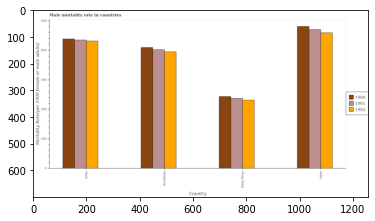

Number of QA =  29





,Country,1962,1961,1960
0,Honduras,399.252632,406.035652,413.908278
1,India,464.679847,475.359050,484.116860
2,Hong Kong,235.055517,241.315692,247.399209
3,Haiti,434.757894,441.179921,441.743943


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in 1962 in haiti and that in india ?
PREDICTED =  -29.921953322811873
EXPECTED =  -28.01400000000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in 1960 in honduras and the male mortality rate in 1962 in haiti?
PREDICTED =  -27.83566515272065
EXPECTED =  -21.946000000000026




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate of/in 1961 and male mortality rate of/in 1960 in haiti?
PREDICTED =  -200.42825155876946
EXPECTED =  -3.469000000000051




				 0 / 3 = 0.0


is_built_w

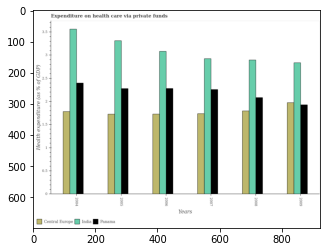

Number of QA =  29





,Years,Panama,India,Central Europe
0,2009,1.942700,2.851860,1.986455
1,2006,2.299896,3.100896,1.733903
2,2008,2.095361,2.882644,1.813414
3,2004,NaN,3.546673,1.790569
4,2007,2.263877,2.945143,1.748861
5,2005,2.286968,3.335093,1.734411


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure made on health care in india in 2004 and that in 2005 ?
PREDICTED =  0.21157991685138366
EXPECTED =  0.25064503927451964




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure made on health care in india in 2005 and the expenditure made on health care in central europe in 2006?
PREDICTED =  0.23419668625176282
EXPECTED =  1.5843438454882302




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the expenditure made on health care in central europe and expenditure made on health care in india ?
PREDICTED =  -0.

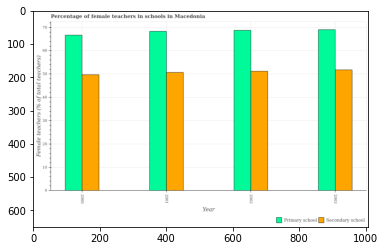

Number of QA =  28





,Year,Primary school,Secondary school
0,2003,70.090095,52.670516
1,2000,67.370306,50.567135
2,2002,70.130768,52.114958
3,2001,69.130192,51.495031


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in 2001 and that in 2003 ?
PREDICTED =  -0.959903350489995
EXPECTED =  -0.7062454223633097




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in 2000 and the percentage of female teachers in secondary schools in 2002?
PREDICTED =  -2.7604615208693133
EXPECTED =  -2.058479309082003




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of female teachers in secondary schools and percentage of female teachers in primary s

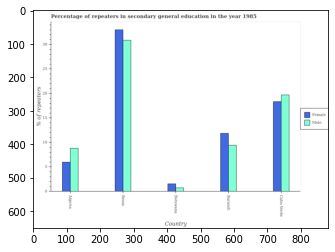

Number of QA =  28





,Country,Female,Male
0,Benin,33.174327,30.853041
1,NaN,6.017741,8.949300
2,Botswana,1.609288,0.787563
3,Cabo Verde,18.408893,19.699814
4,Burundi,11.849894,9.477252


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in benin and that in botswana ?
PREDICTED =  30.06547796281477
EXPECTED =  30.14048




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female repeaters in benin and the percentage of male repeaters in cabo verde?
PREDICTED =  14.765434372795273
EXPECTED =  13.297289999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters and percentage of female repeaters in algeria ?
PREDICTED =  5.132407621032788
EXPECTED =  2.8392800000000005




				 1 / 3 = 0.3333


is_built_wi

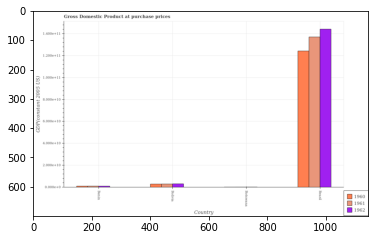

Number of QA =  29





,Country,1962,1961,1960
0,Bolivia,0.036214,0.034211,0.033877
1,Brazil,1.450611,1.376381,1.244095
2,Botswana,NaN,NaN,NaN
3,Benin,0.014336,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at purchase prices in 1960 in bolivia and that in botswana ?
PREDICTED =  0.0
EXPECTED =  2732552208.53514




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at purchase prices in 1960 in botswana and the gdp at purchase prices in 1961 in bolivia?
PREDICTED =  0.0
EXPECTED =  -2793528066.75393




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the gdp at purchase prices in 1960 in benin to that 

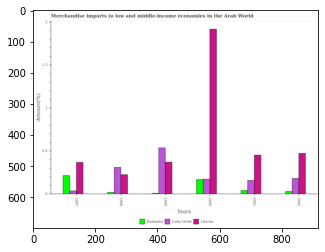

Number of QA =  29





,Years,Liberia,Cabo Verde,Barbados
0,1999,0.376361,0.542355,NaN
1,1997,0.373488,0.043460,0.220005
2,1998,0.230897,0.317184,0.025414
3,2000,1.923098,0.176821,0.172802
4,2001,0.464928,0.162631,0.048431
5,2002,0.477841,0.187994,0.035831


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in liberia in 1997 and that in 1999 ?
PREDICTED =  -0.0028730735571109722
EXPECTED =  -0.0023464598087479804




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in liberia in 1998 and the percentage of amount earned from merchandise imports in cabo verde in 2002?
PREDICTED =  0.042902574537382804
EXPECTED =  0.04343528503985902




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of amount earned from merchandi

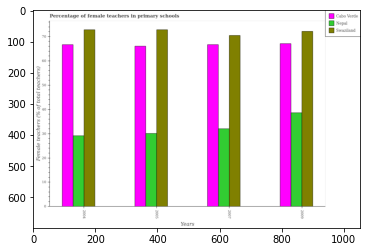

Number of QA =  29





,Years,Cabo Verde,Nepal,Swaziland
0,2007,66.021439,32.270827,70.648010
1,2009,67.260919,38.477893,72.631943
2,2005,65.823776,30.339022,73.118419
3,2004,66.690482,29.307133,73.374298


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in cabo verde in 2004 and that in 2005 ?
PREDICTED =  0.8667066317155587
EXPECTED =  0.6270294189452983




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in swaziland in 2007 and the percentage of female teachers in nepal in 2004?
PREDICTED =  -2.726288170793211
EXPECTED =  41.3185405731201




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of female teachers in cabo verde and percentage of female teachers in nepal ?
PREDICTED =  34.66220067419653
EXPE

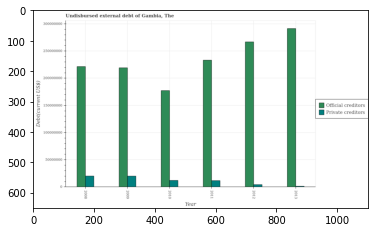

Number of QA =  28





,Year,Private creditors,Official creditors
0,2013,NaN,2.938653e+08
1,2011,1.256034e+07,2.345374e+08
2,2012,5.346615e+06,2.668007e+08
3,2008,2.094874e+07,2.234055e+08
4,2009,2.072631e+07,2.203246e+08
5,2010,1.292825e+07,1.793619e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors in 2008 and that in 2012 ?
PREDICTED =  15602125.618304577
EXPECTED =  15757000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors in 2012 and the undisbursed external debt of private creditors in 2013?
PREDICTED =  -27064591.737306327
EXPECTED =  -24572000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the undisbursed external debt of official creditors and undisbursed external debt of private creditors ?
PREDICTED =  -111150187

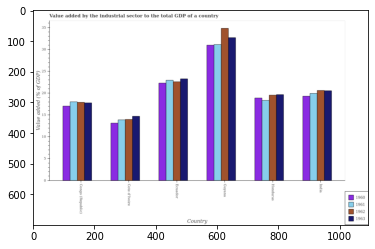

Number of QA =  30





,Country,1963,1962,1961,1960
0,Guyana,32.994926,35.301748,31.377650,31.208259
1,India,20.758213,20.761273,20.044385,19.475017
2,Congo (Republic),17.867128,18.116025,18.200373,17.209042
3,Honduras,19.876279,19.712422,18.501956,19.051526
4,Cote d'Ivoire,14.857029,14.147171,14.050855,13.347647
5,Ecuador,23.562997,22.766896,23.295571,22.425636


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1960 in honduras and that in india ?
PREDICTED =  -0.42349143388545585
EXPECTED =  -0.41362187965620123




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1962 in india and the value added by the industrial sector to the total gdp in 1963 in ecuador?
PREDICTED =  -2.0056233096461575
EXPECTED =  -2.6630333440695004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp of/in 1963 

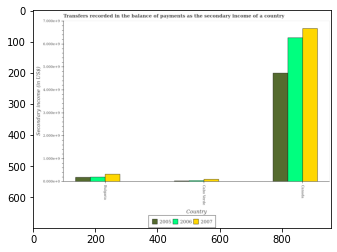

Number of QA =  29





,Country,2007,2005,2006
0,Bulgaria,0.338637,0.205689,0.213546
1,Canada,6.642104,4.714865,6.266884
2,Cabo Verde,0.119012,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in 2007 in bulgaria and that in cabo verde ?
PREDICTED =  0.21962444923961938
EXPECTED =  223094970.93




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in 2007 in cabo verde and the secondary income of in 2005 in canada?
PREDICTED =  -6.523091221325197
EXPECTED =  -4633645582.73




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the secondary income of in 2006 i

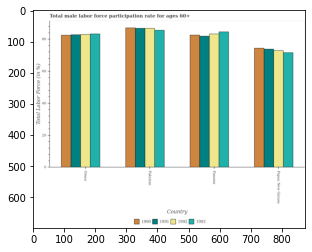

Number of QA =  30





,Country,1992,1993,1990,1991
0,Oman,82.988447,83.325461,82.610516,82.664230
1,Pakistan,87.003239,85.723273,87.088670,86.791793
2,Papua New Guinea,73.085066,71.642389,74.614319,73.776006
3,Panama,83.385070,84.532161,82.639695,81.831342


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1991 in oman and that in panama ?
PREDICTED =  0.8328887916873668
EXPECTED =  0.900001525878892




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1992 in papua new guinea and the male labor force participation rate in 1991 in pakistan?
PREDICTED =  -13.918173431795722
EXPECTED =  -13.900001525878892




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate of/in 1992 and male labor force participation rate of/in 1991 in oman?
PREDICTE

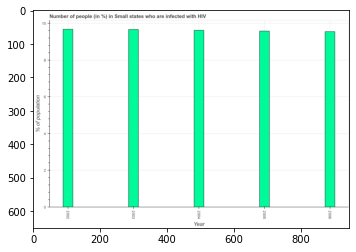

Number of QA =  23





,Year,% of population
0,2002,9.688096
1,2005,9.597984
2,2003,9.686444
3,2006,9.625874
4,2004,9.695502


> what is the title of the graph ?
PREDICTED =  Number of people (in %) in Small states who are infected with HIV
EXPECTED =  Number of people (in %) in Small states who are infected with HIV




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of population
EXPECTED =  % of population




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people infected with hiv in 2002 and 2006 ?
PREDICTED =  0.06222255333637072
EXPECTED =  0.132




				 3 / 4 = 0.75


> what is the median number of people infected with hiv ?
PREDICTED =  None
EXPECTED =  9.61984018286248




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.




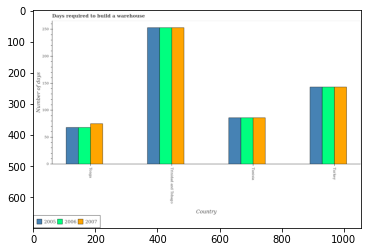

Number of QA =  29





,Country,2007,2005,2006
0,Trinidad and Tobago,253.017702,252.862603,252.188503
1,Tunisia,86.501177,86.200936,86.591131
2,Turkey,143.425207,143.277873,143.771555
3,Tonga,75.296548,68.485997,69.546173


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2007 in tonga and that in trinidad and tobago ?
PREDICTED =  -177.7211533799287
EXPECTED =  -178.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2007 in turkey and the days required to build a warehouse in in 2006 in tunisia?
PREDICTED =  56.92402995211884
EXPECTED =  57.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in of/in 2006 and days required to build a warehouse in of/in 2005 in turkey?
PREDICTED =  -142.277

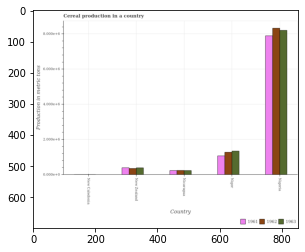

Number of QA =  29





,Country,1963,1962,1961
0,Niger,1.352989,1.303513,1.095802
1,Nigeria,8.235785,8.365230,7.861256
2,New Caledonia,NaN,NaN,NaN
3,Nicaragua,0.255927,0.261386,0.253198
4,New Zealand,0.409732,0.371756,0.421353


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in 1961 in new zealand and that in nigeria ?
PREDICTED =  -7.439903614132544
EXPECTED =  -7502295.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in 1961 in new caledonia and the total cereal production in 1963 in niger?
PREDICTED =  -1.0958020174885
EXPECTED =  -1335069.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production of/in 1963 and total cereal production of/in 1961 in nigeria?
PREDICTED =  2.3931776625077212
EXPECTED =  312000.0




				 0 / 3 = 0.0


is_bui

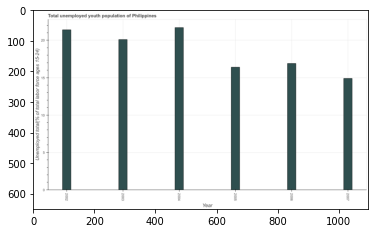

Number of QA =  23





,Year,Unemployed total(% of total labor force ages 15-24)
0,2007,14.845121
1,2006,16.822747
2,2002,21.346462
3,2003,19.955296
4,2005,16.338740
5,2004,21.667367


> what is the title of the graph ?
PREDICTED =  Total unemployed youth population of Philippines
EXPECTED =  Total unemployed youth population of Philippines




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed total(% of total labor force ages 15-24)
EXPECTED =  Unemployed total(% of total labor force ages 15-24)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth in 2003 and 2004 ?
PREDICTED =  -1.7120710171516684
EXPECTED =  -1.6




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed youth ?
PREDICTED =  2004.5
EXPECTED =  18.5




				 3 / 5 = 0.6


is_bui

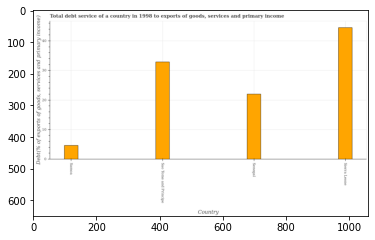

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,samoa,4.834316
1,Sierra Leone,44.851865
2,Sao Tome and Principe,33.171136
3,Senegal,22.187057


> what is the title of the graph ?
PREDICTED =  Total debt service of a country in 1998 to exports of goods, services and primary income
EXPECTED =  Total debt service of a country in 1998 to exports of goods, services and primary income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in senegal and sierra leone ?
PREDICTED =  -22.664808505178826
EXPECTED =  -22.478




				 4 / 4 = 1.0


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  27.448080086176894




				 4 / 6 = 0.6667


is_built_wi

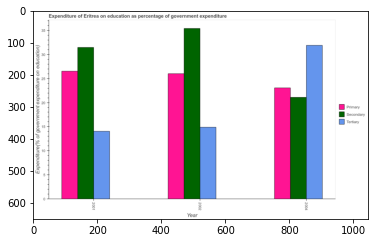

Number of QA =  29





,Year,Secondary,Tertiary,Primary
0,2002,35.463517,15.063285,26.219347
1,2004,21.424190,31.887017,23.079181
2,2001,31.305720,13.976123,26.554826


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on primary education in 2001 and that in 2004 ?
PREDICTED =  3.475645219069655
EXPECTED =  3.4660701751708913




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on primary education in 2002 and the expenditure on secondary education in 2004?
PREDICTED =  3.14016649541653
EXPECTED =  2.946271896362301




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the expenditure on primary education and expenditure on secondary education ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda

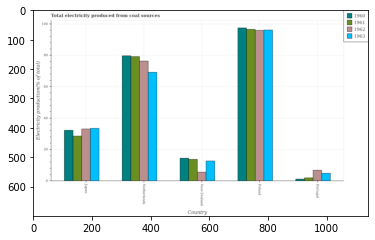

Number of QA =  30





,Country,1963,1962,1961,1960
0,Poland,97.509775,96.793143,98.315710,98.466717
1,Japan,33.964864,33.505841,29.032871,32.560997
2,Netherlands,69.671700,77.230634,79.962724,80.287096
3,New Zealand,12.943341,5.852001,14.077675,14.783508
4,Portugal,5.150321,6.980617,2.217121,1.428356


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1963 in netherlands and that in new zealand ?
PREDICTED =  56.728358882054096
EXPECTED =  56.530962589216394




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1960 in netherlands and the total electricity produced in 1962 in poland?
PREDICTED =  -18.179621878308836
EXPECTED =  -16.19605468248031




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced of/in 1961 and total electricity produced of/in 1960 in poland?
PREDICTED =  125.13938398402229
EXPECTED =  -0

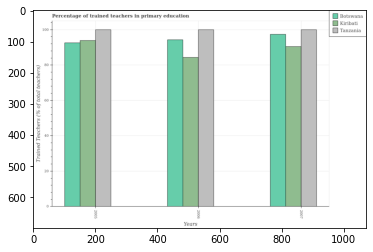

Number of QA =  29





,Years,Botswana,Tanzania,Kiribati
0,2006,94.786275,101.601663,85.189087
1,2005,93.237380,100.719804,94.350689
2,2007,97.622593,100.779835,91.544085


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in botswana in 2005 and that in 2007 ?
PREDICTED =  -4.385212776514621
EXPECTED =  -4.8023910522460085




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in botswana in 2005 and the percentage of trained teachers in tanzania in 2006?
PREDICTED =  -1.5488945353677224
EXPECTED =  -7.412292480468707




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of trained teachers in kiribati and percentage of trained teachers in botswana ?
PREDICTED =  -0.864727128

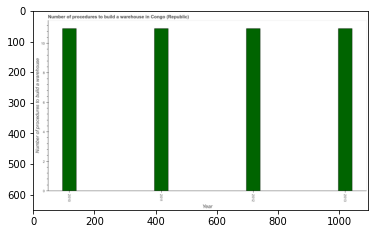

Number of QA =  23





,Year,Number of procedures to build a warehouse
0,2013,11.109772
1,2012,11.106919
2,2011,11.055564
3,2010,11.113034


> what is the title of the graph ?
PREDICTED =  Number of procedures to build a warehouse in Congo (Republic)
EXPECTED =  Number of procedures to build a warehouse in Congo (Republic)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of procedures to build a warehouse
EXPECTED =  Number of procedures to build a warehouse




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in 2011 and 2012 ?
PREDICTED =  -0.05135476147832918
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of procedures to build a warehouse ?
PREDICTED 

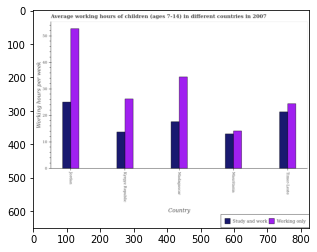

Number of QA =  28





,Country,Study and work,Working only
0,Mauritania,13.399440,14.364731
1,Jordan,25.280483,52.804767
2,Madagascar,17.913915,34.748989
3,Timor-Leste,21.613933,24.732468
4,Kyrgyz Republic,13.977588,26.386683


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of children involved in study and work in madagascar and that in mauritania ?
PREDICTED =  -4.1414615762261775
EXPECTED =  4.600000000000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of children involved in only work in timor-leste and the average working hour of children involved in study and work in kyrgyz republic?
PREDICTED =  -1.6542144797323175
EXPECTED =  10.7




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of children involved in study and work and average wo

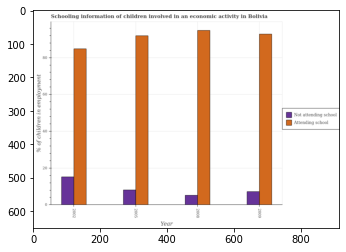

Number of QA =  28





,Year,Attending school,Not attending school
0,2005,92.578251,8.366873
1,2008,95.730917,5.505808
2,2002,85.358679,15.570742
3,2009,93.691436,7.572731


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are attending school in 2002 and that in 2009 ?
PREDICTED =  -8.332756613262788
EXPECTED =  -8.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are not attending school in 2005 and the percentage of employed children who are attending school in 2009?
PREDICTED =  0.7941414382535692
EXPECTED =  0.8999999999999995




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of employed children who are attending school and percentage of employed chi

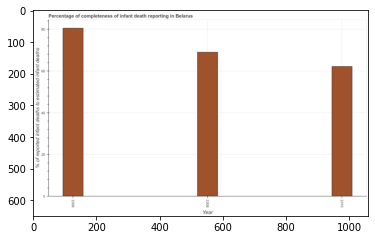

Number of QA =  23





,Year,% of reported infant deaths to estimated infant deaths
0,2008,69.313336
1,2010,62.266000
2,2006,80.467734


> what is the title of the graph ?
PREDICTED =  Percentage of completeness of infant death reporting in Belarus
EXPECTED =  Percentage of completeness of infant death reporting in Belarus




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of reported infant deaths to estimated infant deaths
EXPECTED =  % of reported infant deaths to estimated infant deaths




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of infant death reporting in 2008 and 2010 ?
PREDICTED =  7.047336334772488
EXPECTED =  6.826




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median completeness of infant death 

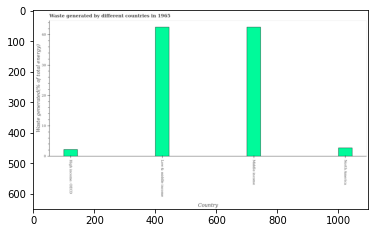

Number of QA =  22





,Country,Waste generated(% of total energy)
0,Middle income,42.340741
1,North America,2.846102
2,Low & middle income,42.425956
3,High income: OECD,2.343397


> what is the title of the graph ?
PREDICTED =  Waste generated by different countries in 1965
EXPECTED =  Waste generated by different countries in 1965




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Waste generated(% of total energy)
EXPECTED =  Waste generated(% of total energy)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of waste generated in high income: oecd and middle income ?
PREDICTED =  -39.99734406383398
EXPECTED =  -40.295




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


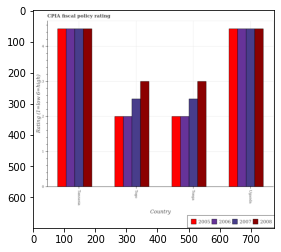

Number of QA =  30





,Country,2007,2005,2008,2006
0,Tanzania,4.520336,4.497968,4.502254,4.504782
1,Tonga,2.507443,2.005120,2.996362,2.008933
2,Uganda,4.532657,4.507772,4.517723,4.510455
3,NaN,2.479399,2.014870,3.006816,2.001377


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in togo and that in tonga ?
PREDICTED =  6.023614641888265
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in togo and the cpia rating in 2007 in uganda?
PREDICTED =  -1.5104548742371087
EXPECTED =  -2.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2005 and cpia rating of/in 2008 in togo?
PREDICTED =  -0.009950669356120656
EXPECTED =  -1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

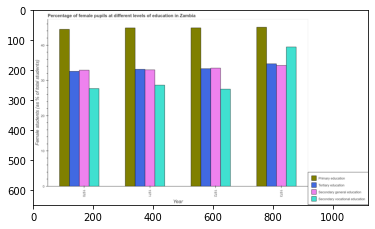

Number of QA =  30





,Year,Secondary vocational education,Tertiary education,Secondary general education,Primary education
0,1971,29.034866,33.586815,33.472812,45.423065
1,1972,27.914277,33.655857,33.968137,45.593620
2,1970,27.985058,32.959799,33.201627,44.894318
3,1973,39.738358,35.132199,34.658195,45.502357


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary education in 1970 and that in 1972 ?
PREDICTED =  0.0707813314238237
EXPECTED =  -0.5778000000000034




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in 1970 and the percentage of female students in tertiary education in 1973?
PREDICTED =  -11.753300067107304
EXPECTED =  -11.794569999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1971, what is the difference between the percentage of female students in secondary vocational education and percenta

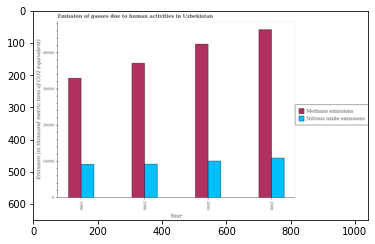

Number of QA =  28





,Year,Nitrous oxide emissions,Methane emissions
0,2008,11086.534691,46478.359940
1,1990,9410.613544,33129.851261
2,2000,9402.824887,37445.073855
3,2005,10200.181158,42514.015938


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in 1990 and that in 2000 ?
PREDICTED =  7.788657052797134
EXPECTED =  -53.399999999999636




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in 1990 and the amount of methane emissions in 2008?
PREDICTED =  -1675.921147341678
EXPECTED =  -1728.3999999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of methane emissions and amount of nitrous oxide emissions ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True

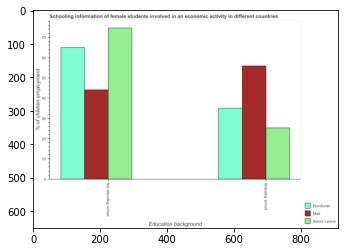

Number of QA =  23





,Education background,Mali,Sierra Leone,Honduras
0,Attending school,55.491178,25.183045,35.132143
1,Not attending school,43.859006,74.836348,64.790275


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are not attending school in honduras and that in mali ?
PREDICTED =  20.931269638956444
EXPECTED =  20.9




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of children employment
EXPECTED =  10.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =

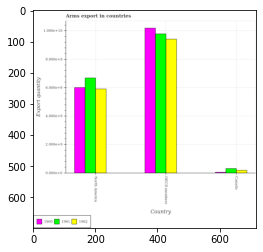

Number of QA =  29





,Country,1962,1961,1960
0,North America,20.684017,23.273046,21.165457
1,Canada,0.816978,1.261337,NaN
2,OECD members,32.835700,34.007434,35.667167


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arms export in 1960 in canada and that in oecd members ?
PREDICTED =  -35.667166734462754
EXPECTED =  -10144000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arms export in 1962 in north america and the total arms export in 1960 in oecd members?
PREDICTED =  -12.151682850872614
EXPECTED =  -4281000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arms export of/in 1962 and total arms export of/in 1961 in north america?
PREDICTED =  31.06364892490266
EXPECTED =  -774000000.0




				 0 / 3 = 0.0


is_built_

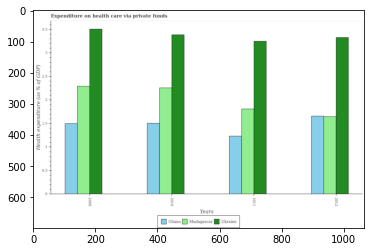

Number of QA =  29





,Years,Ukraine,Ghana,Madagascar
0,2012,3.360609,1.679430,1.665420
1,2010,3.420781,1.538992,2.273088
2,2009,3.540762,1.526026,2.309236
3,2011,3.283185,1.251374,1.846988


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure made on health care in ghana in 2009 and that in 2010 ?
PREDICTED =  -0.01296605029922282
EXPECTED =  -0.007063996859169919




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure made on health care in ghana in 2011 and the expenditure made on health care in madagascar in 2012?
PREDICTED =  -0.42805583234903044
EXPECTED =  -0.4142287375298699




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the expenditure made on health care in ghana and expenditure made on health care in ukraine ?
PREDICTED =  -1.721904

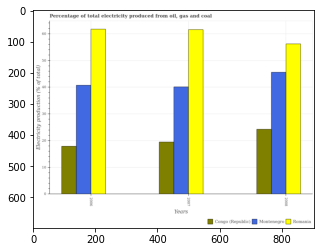

Number of QA =  29





,Years,Congo (Republic),Montenegro,Romania
0,2008,24.431719,45.815853,56.100210
1,2006,17.999199,41.025246,61.507740
2,2007,19.518279,40.587737,61.637704


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in in montenegro in 2006 and that in 2008 ?
PREDICTED =  -4.7906070489201085
EXPECTED =  -4.861757952798804




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in in congo (republic) in 2008 and the electricity production in in montenegro in 2006?
PREDICTED =  6.432520358683458
EXPECTED =  -16.475732939147598




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the electricity production in in congo (republic) and electricity production in in romania ?
PREDICTED =  58.94919727909512
E

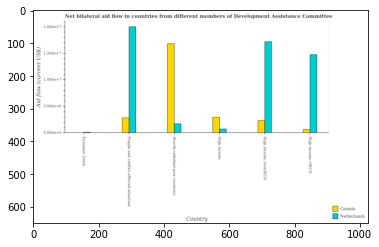

Number of QA =  28





,Country,Netherlands,Canada
0,European Union,NaN,NaN
1,High income,0.083720,0.303878
2,High income: nonOECD,1.734263,0.241024
3,Heavily indebted poor countries,0.182189,1.693570
4,High income: OECD,1.486973,0.077896
5,Fragile and conflict affected situations,2.023772,0.295229


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by canada in european union and that in high income: oecd ?
PREDICTED =  2.5337007295822334
EXPECTED =  -630000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by netherlands in heavily indebted poor countries and the amount of aid given by canada in high income: nonoecd?
PREDICTED =  0.0
EXPECTED =  -590000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by netherlands and amount of aid given by canada in high income: nonoecd ?
PREDICTED =  5.2698943054563
EXPECTED =  148800

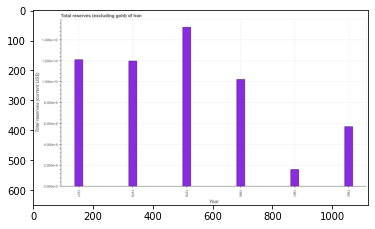

Number of QA =  23





,Year,Total reserves (current US$)
0,1980,1.023911
1,1979,1.522803
2,1977,1.210604
3,1982,0.573005
4,1981,0.164686
5,1978,1.199609


> what is the title of the graph ?
PREDICTED =  Total reserves (excluding gold) of Iran
EXPECTED =  Total reserves (excluding gold) of Iran




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total reserves (current US$)
EXPECTED =  Total reserves (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in 1979 and 1981 ?
PREDICTED =  3.1197196225543906
EXPECTED =  13604227418.64




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (excluding gold) ?
PREDICTED =  1.111760033190134
EXPECTED =  11100068992.2517




				 3 / 5 = 0.6


is_built

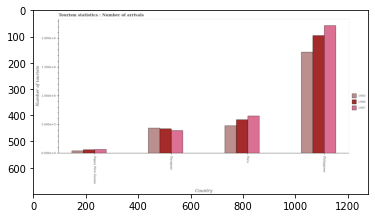

Number of QA =  29





,Country,1997,1996,1995
0,Paraguay,0.401274,0.434196,0.443450
1,Peru,0.649793,0.591681,0.489193
2,Papua New Guinea,0.073570,0.068745,0.051261
3,Philippines,2.220194,2.042281,1.763185


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals in 1997 in papua new guinea and that in peru ?
PREDICTED =  -0.5762227326870935
EXPECTED =  -583000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals in 1996 in paraguay and the number of tourist arrivals in 1997 in papua new guinea?
PREDICTED =  0.3654506015879849
EXPECTED =  360000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist arrivals of/in 1995 and number of tourist arrivals of/in 1997 in papua new guinea?
PREDICTED =  3.9264300132329186
EXPECTED =  -24000

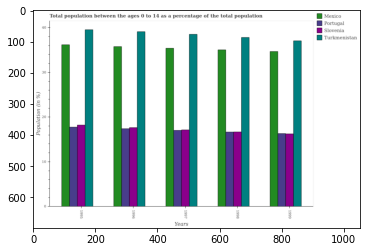

Number of QA =  30





,Years,Portugal,Slovenia,Mexico,Turkmenistan
0,1996,17.398889,17.818527,35.793437,39.150212
1,1995,17.869706,18.303798,36.242378,39.655271
2,1997,16.909761,17.218110,35.378969,38.520415
3,1999,16.350312,16.326374,34.692933,37.077487
4,1998,16.672434,16.728887,34.981489,37.931246


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in portugal in 1995 and that in 1996 ?
PREDICTED =  0.47081695171762306
EXPECTED =  0.35303447814320066




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in slovenia in 1997 and the percentage of the population ages 0 to 14 in turkmenistan in 1995?
PREDICTED =  -1.085687859946514
EXPECTED =  -22.413313660368402




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of the population ages 0 to 14 in turkmenistan and percentage of the

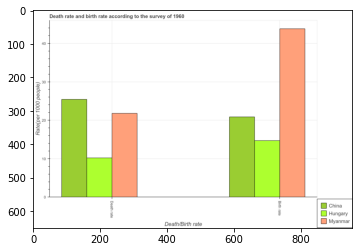

Number of QA =  23





,Death/Birth rate,Myanmar,Hungary,China
0,Death rate,21.946256,10.367854,25.323716
1,Birth rate,43.704474,14.818743,21.072843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in myanmar and the birth rate in china?
PREDICTED =  -3.377459482750016
EXPECTED =  0.9330000000000105




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the birth rate in myanmar to that in china ?
PREDICTED =  2.07397146942079
EXPECTED =  2.09928092042186




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Rate(per 10

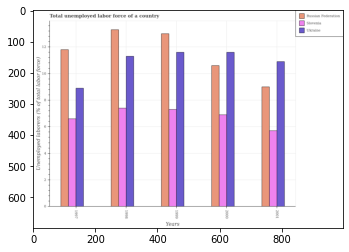

Number of QA =  29





,Years,Slovenia,Russian Federation,Ukraine
0,2000,6.878406,10.571413,11.581348
1,1997,6.550398,11.770740,8.930431
2,1998,7.389030,13.291059,11.270479
3,1999,7.309969,12.982454,11.592728
4,2001,5.725538,8.982944,10.839819


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the total unemployed labor force in russian federation minimum?
PREDICTED =  295.5395146509756
EXPECTED =  2001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed labor force in russian federation in 1999 and that in 2000 ?
PREDICTED =  0.2953918187416048
EXPECTED =  2.3999996185303




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed labor force in ukraine in 2000 and the total unemployed labor force in slovenia in 2001?
PREDICTED =  0.7415290308419085
EXPECTED =  5.9000005722045605




				 0 / 3 = 0.0


is_built_with_cuda:

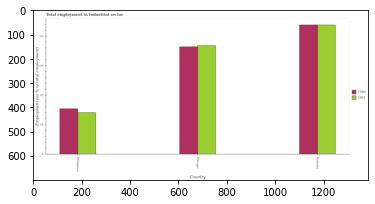

Number of QA =  28





,Country,1980,1981
0,Romania,44.165099,43.719432
1,Portugal,36.465472,36.965573
2,Philippines,15.367557,14.071727


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in industrial sector in 1981 in portugal and that in romania ?
PREDICTED =  -6.753858799496278
EXPECTED =  -7.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in industrial sector in 1981 in portugal and the employment in industrial sector in 1980 in philippines?
PREDICTED =  22.893846333962234
EXPECTED =  21.399999618530195




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in industrial sector of/in 1981 and employment in industrial sector of/in 1980 in portugal?
PREDICTED =  -4.8798947796855
EXPECTED 

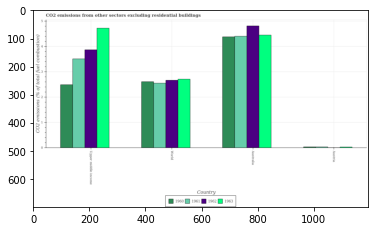

Number of QA =  27





,Country,1963,1962,1961,1960
0,Austria,NaN,NaN,NaN,NaN
1,World,2.737253,2.693445,2.566239,2.633150
2,Upper middle income,4.751326,3.871195,3.519439,2.493254
3,Australia,4.477847,4.820921,4.434066,4.395777


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1963 in australia and that in upper middle income ?
PREDICTED =  -0.27347849433664884
EXPECTED =  -0.273250977176561




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in upper middle income and the total co2 emitted in 1961 in austria?
PREDICTED =  2.871195424269524
EXPECTED =  3.8383379898314716




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted of/in 1963 and total co2 emitted of/in 1961 in austria?
PREDICTED =  3.0
EXPECTED =  -0.005674048092869598




				 1 / 3 = 0.3333


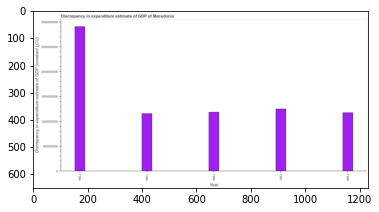

Number of QA =  23





,Year,Discrepancy in expenditure estimate of GDP (constant LCU)
0,1994,2.930806e+09
1,1995,1.169882e+09
2,1997,1.269433e+09
3,1998,1.190362e+09
4,1996,1.200073e+09


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of Macedonia
EXPECTED =  Discrepancy in expenditure estimate of GDP of Macedonia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  Discrepancy in expenditure estimate of GDP (constant LCU)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in 1996 and 1998 ?
PREDICTED =  9711016.922617197
EXPECTED =  10537700.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median discrepancy in expenditure es

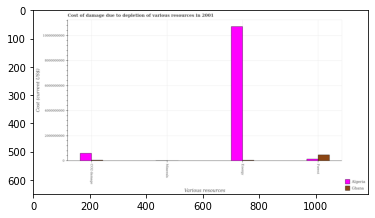

Number of QA =  29





,Various resources,Algeria,Ghana
0,Minerals,NaN,NaN
1,Forest,1.885542e+08,5.170213e+08
2,E nergy,1.081792e+10,NaN
3,CO2 damage,6.415864e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in algeria and that in ghana ?
PREDICTED =  124565122.47760612
EXPECTED =  545314620.4090123




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of forests in ghana and the cost of damage due to depletion of minerals in algeria?
PREDICTED =  328467150.11616564
EXPECTED =  458286805.9417053




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals and cost of damage due to depletion of coal in ghana ?
PREDICTED =  -517021310.02955
EXPE

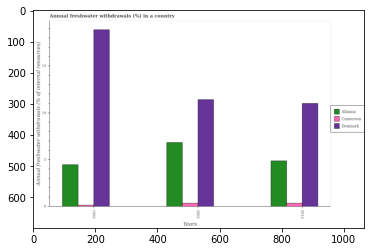

Number of QA =  29





,Years,Unnamed: 1,Cameroon,Denmark
0,1992,4.503403,0.202415,18.970104
1,2002,6.909513,0.401568,11.432628
2,2013,4.904053,0.398504,11.018279


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of annual freshwater withdrawals in albania in 2002 and that in 2013 ?
PREDICTED =  -4.502485171855897
EXPECTED =  1.9591078066914536




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of annual freshwater withdrawals in albania in 2002 and the percentage of annual freshwater withdrawals in denmark in 2013?
PREDICTED =  -10.616711328377413
EXPECTED =  -4.16728624535316




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the percentage of annual freshwater withdrawals in cameroon and percentage of annual fr

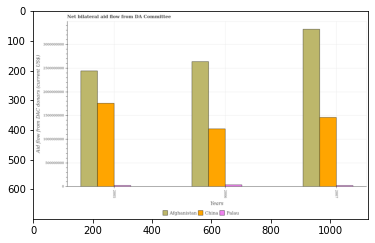

Number of QA =  29





,Years,Palau,China,Afghanistan
0,2005,NaN,1.762983e+09,2.442516e+09
1,2006,4.603587e+07,1.221872e+09,2.633154e+09
2,2007,NaN,1.468389e+09,3.329094e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in in palau in 2005 and that in 2006 ?
PREDICTED =  0.0
EXPECTED =  -13850000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in in palau in 2005 and the aid flow in in afghanistan in 2006?
PREDICTED =  0.0
EXPECTED =  -2614950000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the aid flow in in china and aid flow in in afghanistan ?
PREDICTED =  1651656844.3654475
EXPECTED =  -1419900000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
E

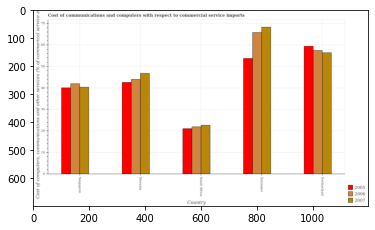

Number of QA =  29





,Country,2007,2005,2006
0,Slovenia,46.936345,42.807075,43.963802
1,Switzerland,56.515039,59.238712,57.392513
2,South Africa,22.803811,21.260899,21.919615
3,Singapore,40.573073,40.155716,41.918522
4,Suriname,68.246369,53.875576,65.923200


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2006 in slovenia and that in south africa ?
PREDICTED =  -44.62251815385979
EXPECTED =  22.061860776626702




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2007 in slovenia and the cost of communications and computers in 2005 in singapore?
PREDICTED =  -66.24851853729722
EXPECTED =  6.737368928265795




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers of/in 2005 and cost of communications and computers of/in 2006 in switzerl

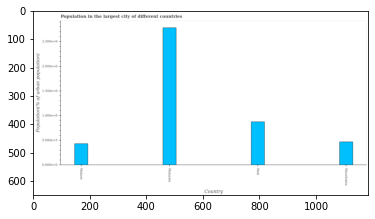

Number of QA =  22





,Country,Population(% of urban population)
0,Malawi,0.436878
1,Malaysia,2.767516
2,NaN,0.875772
3,Mauritania,0.470573


> what is the title of the graph ?
PREDICTED =  Population in the largest city of different countries
EXPECTED =  Population in the largest city of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population(% of urban population)
EXPECTED =  Population(% of urban population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in largest city in malaysia and mauritania ?
PREDICTED =  2.2969428789845763
EXPECTED =  2311960.0




				 3 / 4 = 0.75


> what is the median population in largest city ?
PREDICTED =  None
EXPECTED =  671245.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

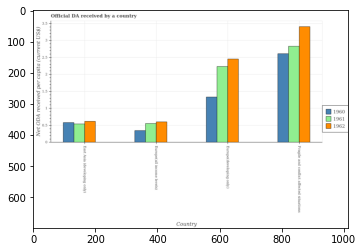

Number of QA =  29





,Country,1962,1961,1960
0,Europe(developing only),2.475949,2.253214,1.352379
1,East Asia (developing only),0.625650,0.550883,0.591574
2,Europe(all income levels),0.612759,0.562138,0.354799
3,Fragile and conflict affected situations,3.444447,2.861600,2.644535


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in in 1962 in europe(all income levels) and that in europe(developing only) ?
PREDICTED =  -1.8631902579484834
EXPECTED =  -1.849973698209154




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in in 1962 in europe(all income levels) and the oda received in in 1961 in east asia (developing only)?
PREDICTED =  -1.8631902579484834
EXPECTED =  0.061647255456902084




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

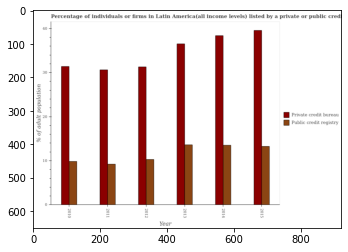

Number of QA =  28





,Year,Private credit bureau,Public credit registry
0,2012,31.456267,10.470266
1,2011,30.853469,9.373474
2,2010,31.625645,10.070733
3,2013,36.800320,13.811067
4,2015,39.850274,13.461648
5,2014,38.622165,13.646809


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by public credit bureau in 2010 and that in 2015 ?
PREDICTED =  18.16399713646547
EXPECTED =  -3.4039393939394316




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in 2012 and the percentage of firms listed by public credit bureau in 2014?
PREDICTED =  -7.165898080523814
EXPECTED =  -7.091300097751699




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

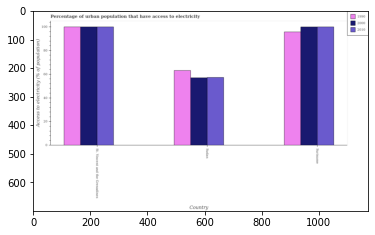

Number of QA =  29





,Country,2000,1990,2010
0,Suriname,100.222050,95.659786,100.560881
1,St. Vincent and the Grenadines,100.263222,100.382542,100.465333
2,Sudan,57.539904,63.599931,57.743312


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that have access to electricity in 1990 in st. vincent and the grenadines and that in suriname ?
PREDICTED =  0.0
EXPECTED =  4.244799487555412




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that have access to electricity in 2000 in suriname and the percentage of urban population that have access to electricity in 2010 in sudan?
PREDICTED =  42.68214588055852
EXPECTED =  42.6458470842239




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that h

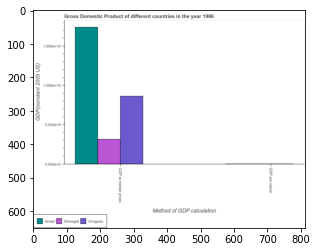

Number of QA =  23





,Method of GDP calculation,Senegal,Uruguay,israel
0,GDP at market prices,0.319285,0.874471,1.737546
1,GDP per capita,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in senegal and that in israel ?
PREDICTED =  -1.4182614544255825
EXPECTED =  -14253302558.562109




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in israel and the gdp per capita in senegal?
PREDICTED =  1.4182614544255825
EXPECTED =  17397353127.62073




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices and gdp per capita in senegal ?
PREDICTED =  1.0
EXPECTED =  3144050569.0586233




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

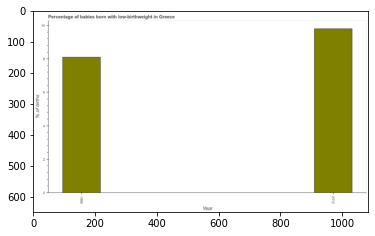

Number of QA =  19





,Year,% of births
0,1999,8.159066
1,2012,9.876249


> what is the title of the graph ?
PREDICTED =  Percentage of babies born with low-birthweight in Greece
EXPECTED =  Percentage of babies born with low-birthweight in Greece




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of births
EXPECTED =  % of births




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of babies who were born with low-birthweight in 1999 and 2012 ?
PREDICTED =  -1.717183776000887
EXPECTED =  -1.7




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of babies who were born with low-birthweight ?
PREDICTED =  9.01765750224334
EXPECTED =  8.95




			

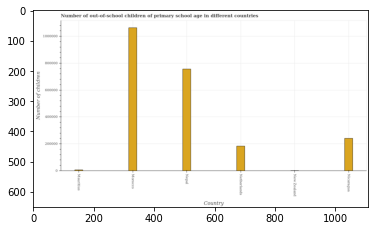

Number of QA =  22





,Country,Number of children
0,Nicaragua,2.456493e+05
1,Mauritius,1.116083e+04
2,Netherlands,1.869499e+05
3,New Zealand,NaN
4,Nepal,7.582297e+05
5,Morocco,1.068842e+06


> what is the title of the graph ?
PREDICTED =  Number of out-of-school children of primary school age in different countries
EXPECTED =  Number of out-of-school children of primary school age in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of children
EXPECTED =  Number of children




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school children in mauritius and nepal ?
PREDICTED =  -747068.8924859106
EXPECTED =  -749600.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of out-of-school children ?
PREDICTED =  245649.2895901

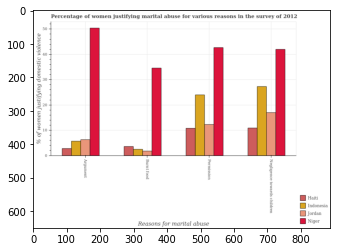

Number of QA =  29





,Reasons for marital abuse,Indonesia,Jordan,Haiti,Niger
0,Argument,5.867189,6.469632,3.045731,50.213343
1,Burnt food,2.669068,1.966969,3.791493,34.546591
2,Permission,23.982602,12.467441,10.940351,42.606512
3,Negligence towards children,27.339495,17.079819,11.056231,42.099468


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?

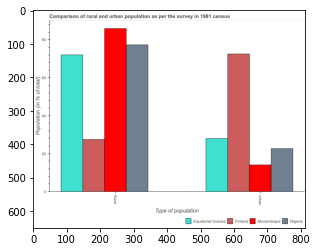

Number of QA =  23





,Type of population,Finland,Mozambique,Nigeria,Equatorial Guinea
0,Urban,72.765482,14.469560,22.968693,27.779266
1,Rural,27.447179,86.231488,77.516264,72.529827


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in equatorial guinea and that in mozambique ?
PREDICTED =  13.309706090294597
EXPECTED =  13.914




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population and rural population in equatorial guinea ?
PREDICTED =  -13.309706090294597
EXPECTED =  -44.06999999999999




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rural population in equatorial guinea to that in mozambiqu

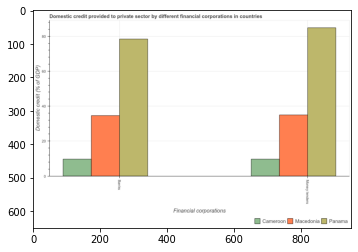

Number of QA =  23





,Financial corporations,Panama,Cameroon,Macedonia
0,Banks,79.340734,10.029711,35.313292
1,Money lenders,85.306573,10.026392,35.399277


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by money lenders in macedonia and the domestic credit provided by banks in cameroon?
PREDICTED =  25.372885137905627
EXPECTED =  25.2710165146481




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the domestic credit provided by banks in macedonia to that in panama ?
PREDICTED =  0.44508400945730353
EXPECTED =  0.4411043208870125




				 2 / 4 = 0.5


> what is t

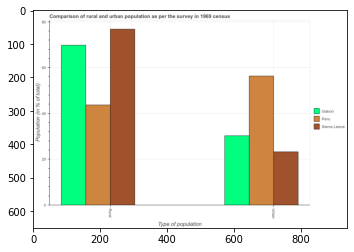

Number of QA =  23





,Type of population,Peru,Sierra Leone,Gabon
0,Rural,43.932581,77.486112,70.053755
1,Urban,56.633514,23.561096,30.492595


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in gabon and that in sierra leone ?
PREDICTED =  6.931498146559502
EXPECTED =  7.018999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in sierra leone and the rural population in peru?
PREDICTED =  -33.072418060812424
EXPECTED =  -20.473000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population and urban population in sierra leone ?
PREDICTED =  -6.591023251412729
EXPECTED =  53.56399999999999




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs:

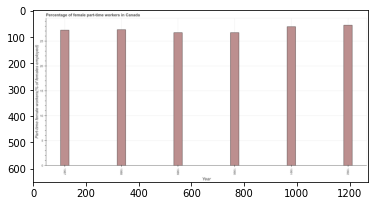

Number of QA =  23





,Year,Part-time female workers(% of females employed)
0,1987,27.264281
1,1990,26.825070
2,1989,26.768022
3,1988,27.473565
4,1992,28.239999
5,1991,27.973046


> what is the title of the graph ?
PREDICTED =  Percentage of female part-time workers in Canada
EXPECTED =  Percentage of female part-time workers in Canada




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time female workers(% of females employed)
EXPECTED =  Part-time female workers(% of females employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time female workers in 1987 and 1992 ?
PREDICTED =  -0.9757173953385205
EXPECTED =  -1.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time female workers ?
PREDICTED =  1989.5
EXPECTED = 

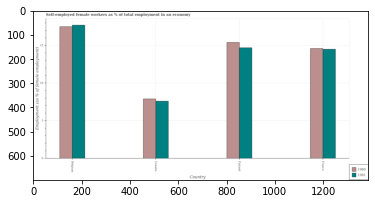

Number of QA =  28





,Country,1980,1981
0,Canada,7.996854,7.667683
1,Finland,15.424094,14.972908
2,France,14.671336,14.673117
3,Belgium,17.535090,17.809116


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in 1980 in canada and that in finland ?
PREDICTED =  -7.427240716723941
EXPECTED =  -7.499999523162871




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in 1980 in france and the percentage of self-employed female workers in 1981 in canada?
PREDICTED =  7.003653596218831
EXPECTED =  7.000000476837129




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers of/in 1980 and percentage of self-employed female workers of/in

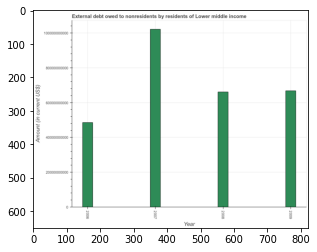

Number of QA =  23





,Year,Amount (in current US$)
0,2009,6.715844e+10
1,2006,4.890735e+10
2,2008,6.654605e+10
3,2007,1.026833e+11


> what is the title of the graph ?
PREDICTED =  External debt owed to nonresidents by residents of Lower middle income
EXPECTED =  External debt owed to nonresidents by residents of Lower middle income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount (in current US$)
EXPECTED =  Amount (in current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt in 2008 and 2009 ?
PREDICTED =  -612385327.3688736
EXPECTED =  -649292997.7




				 3 / 4 = 0.75


> what is the median debt ?
PREDICTED =  None
EXPECTED =  66462187776.65




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the 

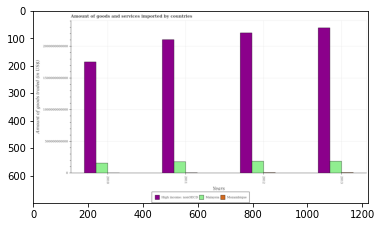

Number of QA =  29





,Years,Malaysia,Mozambique,High income: nonOECD
0,2012,1.943546e+11,NaN,2.206398e+12
1,2011,1.880596e+11,NaN,2.100042e+12
2,2010,1.634444e+11,NaN,1.755280e+12
3,2013,1.939345e+11,NaN,2.290615e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in malaysia in 2010 and that in 2013 ?
PREDICTED =  -193934516721.53964
EXPECTED =  -29711000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in high income: nonoecd in 2010 and the total amount of goods and services imported in malaysia in 2012?
PREDICTED =  -2206397797075.37
EXPECTED =  1566973578021.51




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the total amount of goods and services imported in malaysia and total amount o

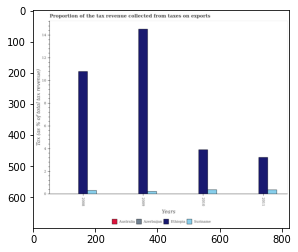

Number of QA =  30





,Years,Azerbaijan,Australia,Ethiopia,Suriname
0,2008,NaN,NaN,10.819734,0.352456
1,2009,NaN,NaN,14.616231,0.269328
2,2010,NaN,NaN,3.948638,0.422844
3,2011,NaN,NaN,3.300940,0.409788


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in azerbaijan in 2010 and that in 2011 ?
PREDICTED =  0.013055461327722562
EXPECTED =  0.0007326207615928203




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in ethiopia in 2008 and the proportion of the tax revenue collected in azerbaijan in 2009?
PREDICTED =  -3.796497014971898
EXPECTED =  10.793654691442265




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the proportion of the tax revenue collected in azerbaijan and proportion of the tax rev

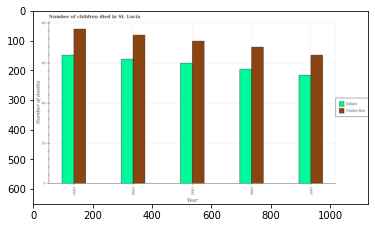

Number of QA =  28





,Year,Infant,Under-five
0,1993,64.296135,77.619814
1,1997,54.138650,64.019656
2,1995,60.119059,71.048967
3,1996,57.213637,68.140247
4,1994,62.138091,73.775280


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in 1994 and that in 1997 ?
PREDICTED =  7.999440471722764
EXPECTED =  8




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in 1993 and the number of infant deaths in 1995?
PREDICTED =  0.0
EXPECTED =  6




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the number of under-five deaths and number of infant deaths ?
PREDICTED =  3.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished af

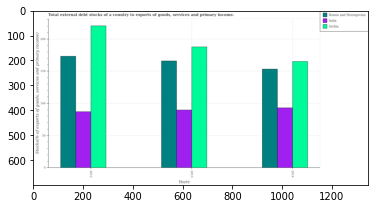

Number of QA =  29





,Years,Bosnia and Herzegovina,India,Serbia
0,2013,167.589622,91.055963,189.641492
1,2014,153.951803,94.200195,166.350943
2,2012,173.423285,88.447086,222.917211


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt stocks in india in 2012 and that in 2014 ?
PREDICTED =  -5.753109897149997
EXPECTED =  -6.060633514709934




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt stocks in serbia in 2014 and the total debt stocks in bosnia and herzegovina in 2013?
PREDICTED =  -23.29054975417884
EXPECTED =  -0.8152118454129891




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the total debt stocks in india and total debt stocks in serbia ?
PREDICTED =  270.7032441712171
EXPECTED =  -71.96470113256508




				 0 / 3 = 0.0


is

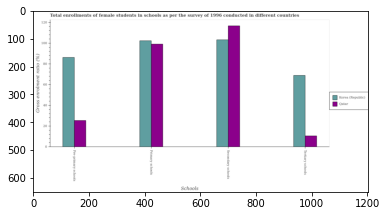

Number of QA =  29





,Schools,Korea (Republic),Qatar
0,Pre-primary schools,86.605276,25.961121
1,Tertiary schools,69.880224,11.258782
2,Secondary schools,103.858121,117.827230
3,Primary schools,102.976973,99.785810


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(female) in secondary schools in korea (republic) ?
PREDICTED =  25.96453018102155
EXPECTED =  103.21341




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(female) in secondary schools ?
PREDICTED =  25.96453018102155
EXPECTED =  116.66568




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio(female) in tertiary schools ?
PREDICTED =  17.47005602885348
EXPECTED =  10.56202




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluatio

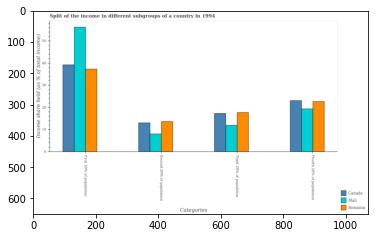

Number of QA =  29





,Categories,Mali,Romania,Canada
0,First 20% of population,56.249754,37.112552,39.236196
1,Fourth 20% of population,19.349381,22.806108,23.179972
2,Second 20% of population,8.167535,13.741418,13.146299
3,Third 20% of population,12.025763,17.793612,17.339267


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of the income held by fourth 20% of the population in romania and that in canada ?
PREDICTED =  -0.3738644892177625
EXPECTED =  -0.4299999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of the income held by second 20% of the population in romania and the share of the income held by third 20% of the population in canada?
PREDICTED =  -16.744148268137057
EXPECTED =  -3.6500000000000004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

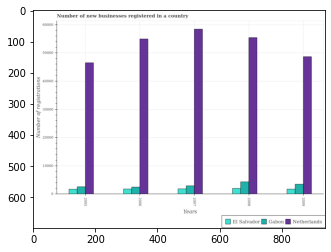

Number of QA =  29





,Years,FE] Salvador,Gabon,Netherlands
0,2009,1935.152933,3691.372534,49236.448839
1,2008,2194.837368,4530.309747,56094.070292
2,2005,1895.119633,2810.626378,47030.977943
3,2006,1967.019629,2696.659902,55618.879018
4,2007,2029.146811,3113.834404,59092.142245


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of new businesses registered in el salvador in 2007 and that in 2008 ?
PREDICTED =  -165.69055705977917
EXPECTED =  -160.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of new businesses registered in gabon in 2007 and the number of new businesses registered in netherlands in 2005?
PREDICTED =  303.20802651740223
EXPECTED =  -43596.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of new businesses registered in netherlands and number of new businesses registered in gabon ?
PREDICTED =  0.0
EXP

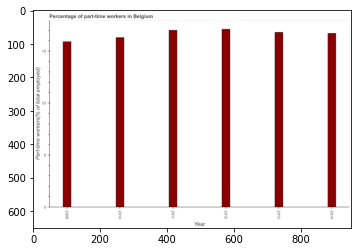

Number of QA =  23





,Year,Part-time workers(% of total employed)
0,2010,16.401794
1,2012,17.217280
2,2013,16.896763
3,2014,16.801828
4,2009,15.927077
5,2011,17.153663


> what is the title of the graph ?
PREDICTED =  Percentage of part-time workers in Belgium
EXPECTED =  Percentage of part-time workers in Belgium




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time workers(% of total employed)
EXPECTED =  Part-time workers(% of total employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in 2013 and 2014 ?
PREDICTED =  0.0949349132137165
EXPECTED =  0.1




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  2011.5
EXPECTED =  16.75




				 3 / 5 = 0.6


is_built_with_c

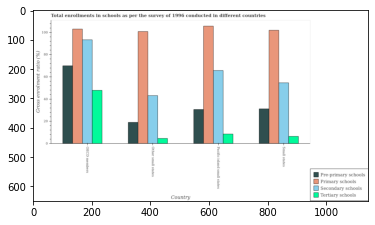

Number of QA =  30





,Country,Tertiary schools,Secondary schools,Pre-primary schools,Primary schools
0,Other small states,5.268723,44.150617,19.776326,102.518926
1,Pacific island small states,9.239858,67.049650,31.542542,107.561181
2,OECD members,48.758355,94.593754,71.409946,104.400863
3,Small states,7.033477,55.905722,32.020135,103.351398


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

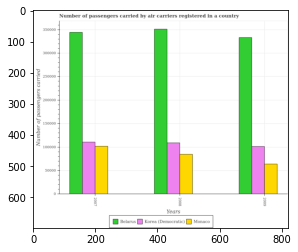

Number of QA =  29





,Years,Belarus,Monaco,Korea (Democratic)
0,2008,354447.970988,86465.204909,110399.373994
1,2009,335469.249327,65395.803502,102913.316587
2,2007,347121.145447,103188.747982,114007.936837


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in korea (democratic) in 2007 and that in 2009 ?
PREDICTED =  11094.620250085703
EXPECTED =  9397.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in monaco in 2008 and the number of passengers carried by air carriers in belarus in 2009?
PREDICTED =  21069.401406874145
EXPECTED =  -248592.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of passengers carried by air carriers in monaco and number of passengers carried by 

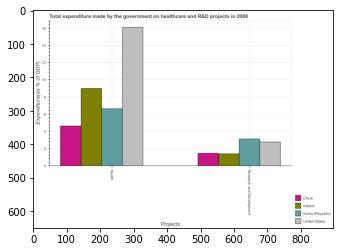

Number of QA =  23





,Projects,United States,China,Korea (Republic),Ireland
0,Health,16.198546,4.694966,6.645670,9.076149
1,Research and Development,2.807365,1.545284,3.207447,1.489248


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in korea (republic) and the expenditure in r&d in ireland?
PREDICTED =  0.0
EXPECTED =  5.24133447




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure in r&d in united states to that in ireland ?
PREDICTED =  1.8850886733243246
EXPECTED =  1.9843295035644106




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-a

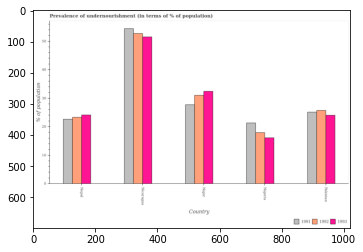

Number of QA =  29





,Country,1992,1993,1991
0,Nepal,23.676866,24.437777,22.860135
1,Pakistan,26.018003,24.324696,25.474157
2,Niger,31.313697,32.758700,28.092193
3,Nicaragua,52.958181,52.011679,55.033626
4,Nigeria,18.377130,16.365865,21.687088


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in 1993 in nepal and that in nigeria ?
PREDICTED =  8.071911904398913
EXPECTED =  8.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in 1992 in nigeria and the percentage of undernourished population in 1991 in pakistan?
PREDICTED =  -7.64087271338272
EXPECTED =  -7.200000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population of/in 1992 and percentage of undernourished population of/in 1993 in pakistan?
PREDICTED

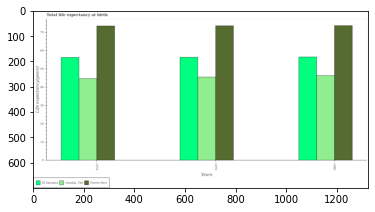

Number of QA =  29





,Years,"Gambia, The",Puerto Rico,E] Salvador
0,1980,46.799635,73.696508,56.731552
1,1978,45.028183,73.086099,56.251683
2,1979,46.186526,73.636863,56.672397


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in puerto rico in 1979 and that in 1980 ?
PREDICTED =  -0.05964497282249681
EXPECTED =  -0.09226829268288839




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in gambia, the in 1978 and the life expectancy at birth in in puerto rico in 1980?
PREDICTED =  1904.303491839331
EXPECTED =  -28.982195121951193




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1979, what is the difference between the life expectancy at birth in in el salvador and life expectancy at birth in in puerto rico ?
PREDICTED =  -17.221473

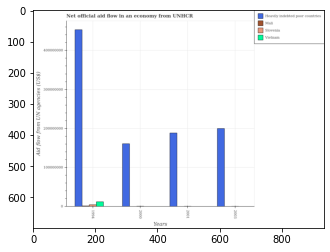

Number of QA =  30





,Years,Slovenia,Heavily indebted poor countries,Mali,Vietnam
0,2003,NaN,1.993870e+08,NaN,NaN
1,2000,NaN,1.607126e+08,NaN,NaN
2,1994,6.142271e+06,4.508086e+08,NaN,1.305176e+07
3,2001,NaN,1.890627e+08,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in mali in 1994 and that in 2003 ?
PREDICTED =  nan
EXPECTED =  1450000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in mali in 2003 and the net official aid flow in slovenia in 1994?
PREDICTED =  nan
EXPECTED =  -4540000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net official aid flow in slovenia and net official aid flow in mali ?
PREDICTED =  nan
EXPECTED =  360000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or 

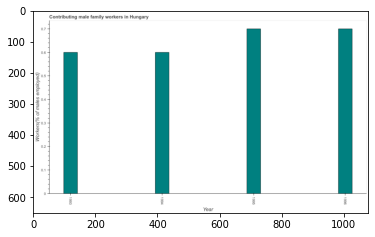

Number of QA =  23





,Year,Workers(% of males employed)
0,1995,0.699990
1,1993,0.598528
2,1996,0.700803
3,1994,0.601312


> what is the title of the graph ?
PREDICTED =  Contributing male family workers in Hungary
EXPECTED =  Contributing male family workers in Hungary




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Workers(% of males employed)
EXPECTED =  Workers(% of males employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing male family workers in 1995 and 1996 ?
PREDICTED =  -0.0008128811493584021
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the median contributing male family workers ?
PREDICTED =  None
EXPECTED =  0.6500000059604645




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ra

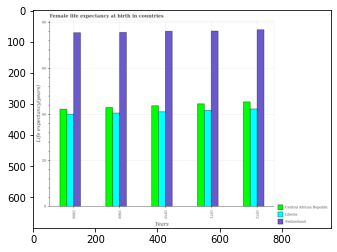

Number of QA =  29





,Years,Switzerland,Liberia,Central African Republic
0,1969,75.086219,40.867996,43.180035
1,1968,75.820240,40.697346,42.655492
2,1972,77.016052,42.710453,45.781028
3,1970,76.331495,41.332295,44.034363
4,1971,76.443035,41.887168,44.860455


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in liberia in 1969 and the female life expectancy at birth in switzerland in 1972?
PREDICTED =  1926.2895473972799
EXPECTED =  -36.20099999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the female life expectancy at birth in central african republic in 1971 to that in 1972?
PREDICTED =  0.979891824445191
EXPECTED =  0.9815442146942367




				 1 / 4

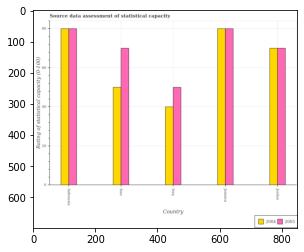

Number of QA =  28





,Country,2005,2004
0,Iran,69.641224,49.997581
1,Indonesia,79.977155,80.264338
2,Jordan,70.200641,70.038630
3,Jamaica,80.179892,80.126050
4,NaN,49.651006,40.098118


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in indonesia and that in jordan ?
PREDICTED =  10.22570766365213
EXPECTED =  10.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in jamaica and the rating of statistical capacity in 2005 in jordan?
PREDICTED =  10.087419840609371
EXPECTED =  10.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity of/in 2004 and rating of statistical capacity of/in 2005 in iran?
PREDICTED =  90.74916284297508
EXPECTED =  -20.0




				 2 / 3 = 0.6

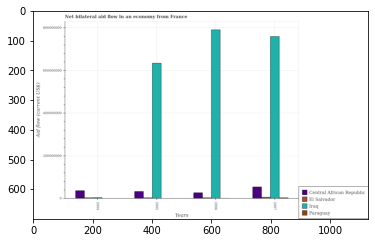

Number of QA =  27





,Years,Central African Republic,El] Salvador,Paraguay,Iraq
0,2007,5.632654e+07,NaN,NaN,7.607012e+08
1,2004,3.902785e+07,NaN,NaN,NaN
2,2006,2.925134e+07,NaN,NaN,7.917018e+08
3,2005,3.506129e+07,NaN,NaN,6.346776e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in central african republic in 2006 and that in 2007 ?
PREDICTED =  -27075197.92685925
EXPECTED =  -27360000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in paraguay in 2005 and the net bilateral aid flow in central african republic in 2004?
PREDICTED =  0.0
EXPECTED =  -36180000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilater

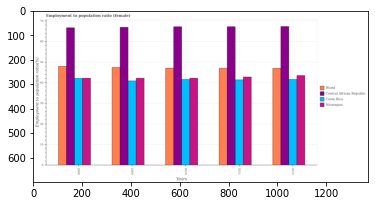

Number of QA =  30





,Years,Central African Republic,Costa Rica,Nicaragua,World
0,2009,67.476486,41.268051,42.565784,47.951324
1,2008,67.036297,42.360670,42.554364,48.102374
2,2011,67.583620,42.148681,43.058358,47.531046
3,2012,67.988652,41.976239,43.763567,47.550311
4,2010,67.636143,42.000203,42.463084,47.667901


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in nicaragua in 2011 ?
PREDICTED =  46.68083207140722
EXPECTED =  42.7999992370605




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in costa rica ?
PREDICTED =  47.49688817307319
EXPECTED =  42.0999984741211




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in nicaragua ?
PREDICTED =  47.28813414103308
EXPECTED =  42.2000007629395




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after 

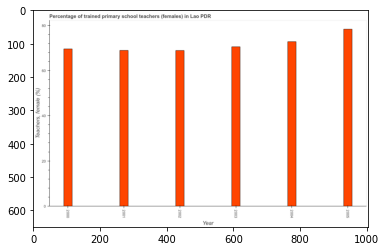

Number of QA =  23





,Year,"Teachers, female (%)"
0,2000,70.121266
1,2005,79.385251
2,2003,71.079045
3,2004,73.425815
4,2002,69.385547
5,2001,69.344633


> what is the title of the graph ?
PREDICTED =  Percentage of trained primary school teachers (females) in Lao PDR
EXPECTED =  Percentage of trained primary school teachers (females) in Lao PDR




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Teachers, female (%)
EXPECTED =  Teachers, female (%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained female teachers in 2001 and 2004 ?
PREDICTED =  -4.0811816948074835
EXPECTED =  -3.863




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of trained female teachers ?
PREDICTED =  2002.5
EXPECTED =  70.0607261657714

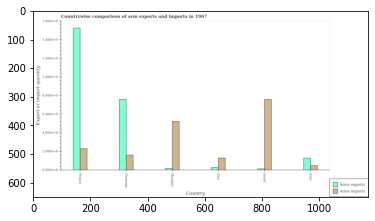

Number of QA =  28





,Country,Arms imports,Arms exports
0,lran,0.133086,0.032640
1,Italy,0.051568,0.132250
2,Israel,0.762089,0.017234
3,France,0.234247,1.542757
4,Hungary,0.527921,0.022366
5,Germany,0.166316,0.763129


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in iran and that in italy ?
PREDICTED =  -0.11501526144599639
EXPECTED =  -100000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in hungary and the arms exports in germany?
PREDICTED =  0.3616050263978
EXPECTED =  -238000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports and arms exports in italy ?
PREDICTED =  0.1802879498653399
EXPECTED =  -80000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

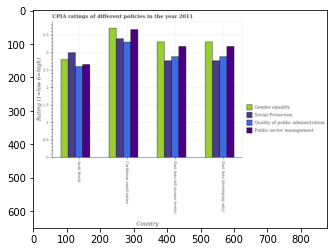

Number of QA =  30





,Country,Public sector management,Gender equality,Quality of public administration,Social Protection
0,Caribbean small states,3.623767,3.679537,3.236324,3.359675
1,Arab World,2.641383,2.751540,2.559572,3.006998
2,East Asia (developing only),3.131743,3.281344,2.857012,2.736336
3,East Asia (all income levels),3.137251,3.280454,2.857260,2.759112


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of quality of public administration in arab world and that in east asia (all income levels) ?
PREDICTED =  0.25
EXPECTED =  -0.28461538461538005




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of gender equality in arab world and the cpia rating of quality of public administration in caribbean small states?
PREDICTED =  0.25
EXPECTED =  -0.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

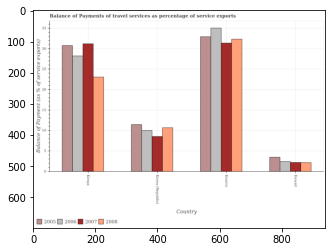

Number of QA =  30





,Country,2007,2005,2006,2008
0,Kuwait,2.333227,3.563581,2.533915,2.297747
1,Kenya,31.174001,30.727277,27.956262,23.010379
2,Kosovo,31.265715,32.949957,35.045709,32.239138
3,Korea (Republic),8.641223,11.504914,10.140362,10.726730


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2005 in kenya and that in kosovo ?
PREDICTED =  -2.2226800357183087
EXPECTED =  -2.1500862062077033




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2006 in kenya and the balance of payments of travel services in 2005 in kuwait?
PREDICTED =  24.392680425766947
EXPECTED =  24.74882271423199




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services of/in 2008 and balance of payments of travel services of/in 2006 in kosovo?
PRE

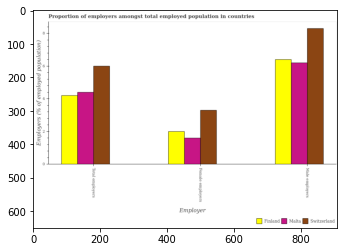

Number of QA =  28





,Employer,Switzerland,Finland,Malta
0,Total employers,6.035913,4.200173,4.420975
1,Male employers,8.308912,6.411605,6.228484
2,Female employers,3.286177,2.013465,1.619195


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female employers in malta to that in finland ?
PREDICTED =  0.8041836501172092
EXPECTED =  0.80000001192093




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

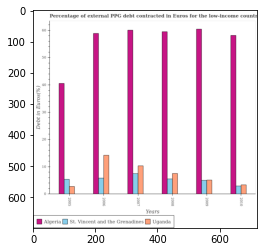

Number of QA =  29





,Years,Algeria,St. Vincent and the Grenadines,Uganda
0,2005,40.756373,5.560591,2.973174
1,2008,60.179408,5.773797,7.719961
2,2007,60.655946,7.842879,10.631016
3,2010,58.718471,3.120993,3.583495
4,2006,59.801927,6.056880,14.557727
5,2009,62.023018,5.220040,5.341493


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of external ppg debt contracted in euros in st. vincent and the grenadines in 2007 and that in 2008 ?
PREDICTED =  -10.495682639939538
EXPECTED =  1.9510999999999994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of external ppg debt contracted in euros in st. vincent and the grenadines in 2010 and the percentage of external ppg debt contracted in euros in algeria in 2005?
PREDICTED =  -55.59747771462045
EXPECTED =  -37.5976




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of external

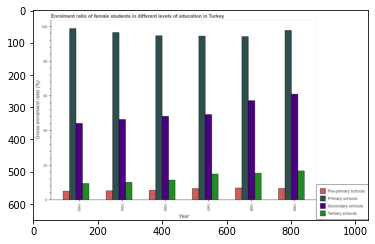

Number of QA =  30





,Year,Pre-primary schools,Secondary schools,Tertiary schools,Primary schools
0,1995,5.843183,48.386220,11.728053,96.397620
1,1994,5.573935,46.606669,10.380556,97.510193
2,1998,7.163543,57.137632,16.010459,94.466432
3,1997,6.842349,49.424186,15.205710,96.522079
4,1999,6.844403,61.396051,17.007120,98.429562
5,1993,5.341238,44.237052,9.807025,99.855990


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(male) in pre-primary schools in 1994 ?
PREDICTED =  1.0213186378905308
EXPECTED =  5.2084




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum gross enrolment ratio(male) in pre-primary schools ?
PREDICTED =  2.5666924903318087
EXPECTED =  6.80029




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross enrolment ratio(male) in tertiary schools ?
PREDICTED =  1.7969528075133274
EXPECTED =  9.40958




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

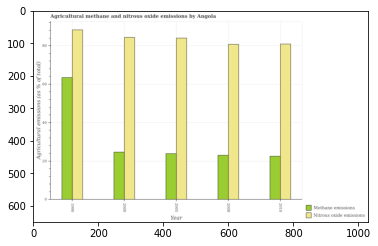

Number of QA =  28





,Year,Nitrous oxide emissions,Methane emissions
0,2010,81.111164,22.788284
1,2000,84.640055,24.947216
2,1990,88.684702,63.707002
3,2008,80.735509,23.017376
4,2005,84.457009,24.263785


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emissions in 1990 and that in 2008 ?
PREDICTED =  40.68962540986604
EXPECTED =  40.4243780575944




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emissions in 2005 and the amount of nitrous oxide emissions in 2008?
PREDICTED =  1.2464088066558965
EXPECTED =  0.8276605216670987




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of methane emissions and amount of nitrous oxide emissions ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_av

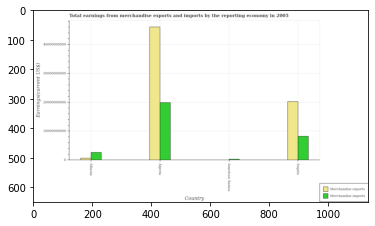

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,NaN,NaN,NaN
1,Amencan Samoa,NaN,NaN
2,NaN,NaN,NaN
3,Angola,8.443493e+09,2.024009e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in algeria and that in american samoa ?
PREDICTED =  0.0
EXPECTED =  46035705801.06




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in algeria and the earnings from merchandise exports in american samoa?
PREDICTED =  11796592475.85166
EXPECTED =  19839466571.06




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports and earnings from merchandise imports in american samoa ?
PREDICTED =  0.0
EXPECTED =  -258253349.45999998




				 0 / 3 = 0.0


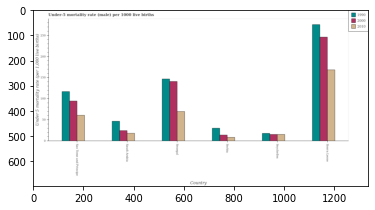

Number of QA =  29





,Country,2000,1990,2010
0,Sao Tome and Principe,95.963551,117.360102,61.688407
1,Senegal,141.276564,147.931153,70.957719
2,Sierra Leone,247.826827,276.161595,168.896513
3,Saudi Arabia,25.389254,47.609451,19.177679
4,Serbia,15.027328,31.231793,9.671414
5,Seychelles,16.562049,19.006406,16.418026


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 1990 in sao tome and principe and that in seychelles ?
PREDICTED =  98.353696778608
EXPECTED =  99.10000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 2010 in senegal and the under-five mortality rate in 1990 in seychelles?
PREDICTED =  54.53969288731456
EXPECTED =  51.8




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the unde

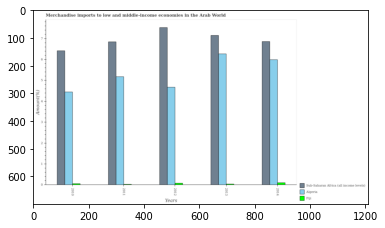

Number of QA =  29





,Years,Fiji,Algeria,Sub-Saharan Africa (all income levels)
0,2012,0.102245,4.728841,7.523313
1,2011,NaN,5.227120,6.890069
2,2013,NaN,6.316741,7.226689
3,2014,0.126894,6.056163,6.876096
4,2010,0.079850,4.463073,6.437269


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in fiji in 2011 and that in 2013 ?
PREDICTED =  -0.12689362735958612
EXPECTED =  -0.012854236324708602




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in algeria in 2011 and the percentage of amount earned from merchandise imports in sub-saharan africa (all income levels) in 2013?
PREDICTED =  -1.999568831679296
EXPECTED =  -1.9756277868918009




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the percentage of amount e

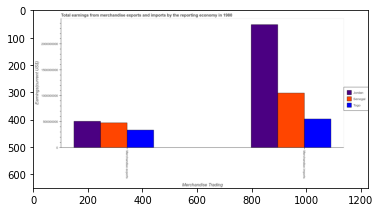

Number of QA =  23





,Merchandise Trading,Unnamed: 1,Senegal,Jordan
0,Merchandise exports,3.473050e+08,4.920767e+08,5.173643e+08
1,Merchandise imports,5.668418e+08,1.068946e+09,2.367678e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in senegal and that in jordan ?
PREDICTED =  -1298731534.8193657
EXPECTED =  -1321527000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from merchandise imports in senegal to that in jordan ?
PREDICTED =  0.4514745321958259
EXPECTED =  0.44315258108147965




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks 

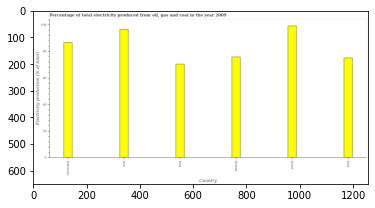

Number of QA =  22





,Country,Electricity production (% of total)
0,Ireland,76.142884
1,Indonesia,87.331383
2,lran,97.118743
3,NaN,71.325416
4,Italy,75.775495
5,Israel,99.583397


> what is the title of the graph ?
PREDICTED =  Percentage of total electricity produced from oil, gas and coal in the year 2009
EXPECTED =  Percentage of total electricity produced from oil, gas and coal in the year 2009




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Electricity production (% of total)
EXPECTED =  Electricity production (% of total)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in iraq and italy ?
PREDICTED =  9.678911710374521
EXPECTED =  -4.628




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median electricity production ?
PREDICTED =  81

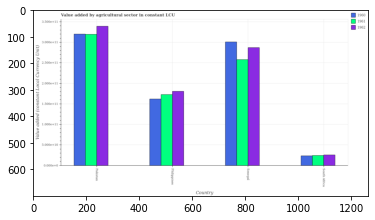

Number of QA =  29





,Country,1962,1961,1960
0,Senegal,2.874115,2.600647,3.023509
1,Philippines,1.834712,1.745301,1.634980
2,Pakistan,3.413996,3.214209,3.215741
3,South Africa,0.272544,0.259067,0.250304


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1960 in pakistan and that in senegal ?
PREDICTED =  0.19223284392423157
EXPECTED =  19118430100.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1962 in pakistan and the value added by agricultural sector in 1960 in philippines?
PREDICTED =  1.579284215135544
EXPECTED =  177187410900.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector of/in 1962 and value added by agricultural sector of/in 1961 in pakistan?
PREDICTED =  5.1811

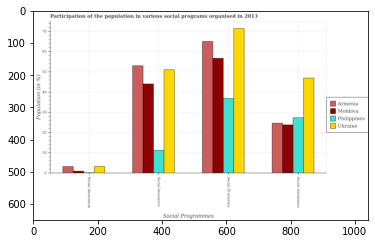

Number of QA =  29





,Social Programmes,Philippines,Armenia,Moldova,Ukraine
0,Social Awareness,NaN,3.425690,1.162012,3.437016
1,Social Insurance,11.493977,53.383682,44.092636,51.733305
2,Social Assistance,27.869805,25.083278,24.254363,47.982469
3,Social Protection,37.512722,65.745656,57.380812,72.328876


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the participation of population in social insurance programs in ukraine and that in moldova ?
PREDICTED =  7.6406687518606375
EXPECTED =  7.052829401257696




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the participation of population in social awareness programs in moldova and the participation of population in social protection programs in armenia?
PREDICTED =  -2.263677803258245
EXPECTED =  -64.1280776455422




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the participation of population in social insurance programs and participation of popula

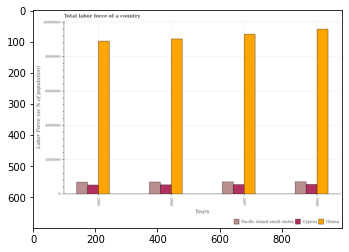

Number of QA =  29





,Years,Cyprus,Pacific island small states,Ghana
0,2005,562211.874333,718848.521217,8.970777e+06
1,2006,567805.762653,730218.429619,9.109783e+06
2,2008,588043.488852,748011.814306,9.640966e+06
3,2007,581245.754008,733954.351856,9.366920e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in ghana in 2006 and that in 2008 ?
PREDICTED =  -531182.9800644927
EXPECTED =  -571664




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force in cyprus in 2005 and the percentage of labor force in pacific island small states in 2006?
PREDICTED =  -5593.88832024287
EXPECTED =  -173709




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of lab

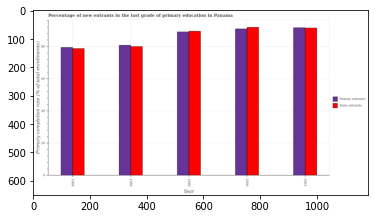

Number of QA =  28





,Year,Male entrants,Female entrants
0,1999,90.600768,89.602602
1,1989,80.597034,81.268698
2,1988,79.067693,79.564351
3,2001,92.048472,92.467915
4,2000,92.357448,91.522135


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in 1989 and that in 2000 ?
PREDICTED =  -11.760413797837884
EXPECTED =  -11.913847509765588




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in 1988 and the primary completion rate of female entrants in 2000?
PREDICTED =  -13.289755514299998
EXPECTED =  -13.180167509765582




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the primary completion rate of female entrants and primary completion rate of male entrants ?
PREDICTED =  0.94577971016529

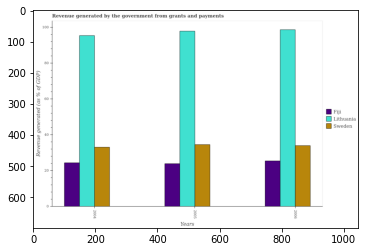

Number of QA =  29





,Years,Sweden,Fiji,Lithuania
0,2004,33.539152,24.819227,95.253841
1,2005,34.747265,23.952818,98.507421
2,2006,34.129713,25.723949,98.974757


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in lithuania in 2005 and that in 2006 ?
PREDICTED =  -0.4673359564490909
EXPECTED =  -0.8050602792907




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in sweden in 2005 and the revenue generated by the government in lithuania in 2004?
PREDICTED =  1.2081134252794428
EXPECTED =  -60.85364286997631




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the revenue generated by the government in fiji and revenue generated by the government in sweden ?
PREDICTED

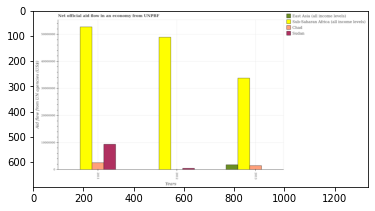

Number of QA =  27





,Years,Chad,East Asia (all income levels),Sub-Saharan Africa (all income levels),Sudan
0,2012,NaN,NaN,4.882430e+07,6.614400e+05
1,2011,2.712192e+06,NaN,5.251456e+07,9.456516e+06
2,2013,1.636784e+06,1.975351e+06,3.416085e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in east asia (all income levels) in 2011 and that in 2013 ?
PREDICTED =  0.0
EXPECTED =  -1780000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in east asia (all income levels) in 2011 and the net official aid flow in chad in 2013?
PREDICTED =  0.0
EXPECTED =  -1470000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the net official aid flow in chad and net official aid flow in sub-saharan africa (all income levels) ?
PREDICTED =  -131150735.57304932
EXPECTED =  -32330000.0

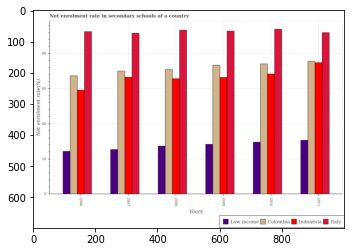

Number of QA =  30





,Years,Low income,Indonesia,Colombia,Italy
0,2010,29.648353,68.910286,74.518773,94.265084
1,2011,30.788595,75.191857,76.073296,91.679162
2,2007,25.675933,67.193743,70.309868,91.608171
3,2006,24.568577,59.562422,67.631482,92.430731
4,2008,27.558248,66.115952,71.393540,93.120778
5,2009,28.652806,66.848176,73.814544,92.779893


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in secondary schools in colombia in 2007 and that in 2010 ?
PREDICTED =  -3.972420082332409
EXPECTED =  -4.071792602539091




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in secondary schools in indonesia in 2007 and the net enrolment rate in secondary schools in low income in 2008?
PREDICTED =  1.0777915563463836
EXPECTED =  39.199182510376




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the net enrolment rate in secondary schools in colombia and net enrolment rate in secondary scho

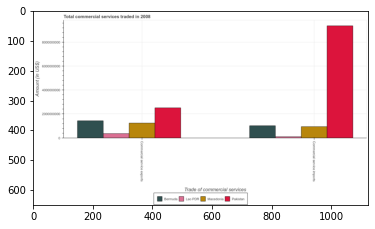

Number of QA =  23





,Trade of commercial services,Bermuda,Pakistan,Macedonia,Lao PDR
0,Commercial service imports,1.068070e+09,9.444525e+09,9.726296e+08,1.510867e+08
1,Commercial service exports,1.480076e+09,2.560102e+09,1.287713e+09,4.116983e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of commercial service exports in bermuda and that in macedonia ?
PREDICTED =  192363198.26951027
EXPECTED =  189996110.18145013




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of commercial service imports in macedonia and the amount of commercial service exports in pakistan?
PREDICTED =  -5029683612.056591
EXPECTED =  -1573404144.253122




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of commercial service exports and amount of commercial service imports in pakistan ?
PREDICTED =  -1.0
EXPECTED =  -6849000000.0




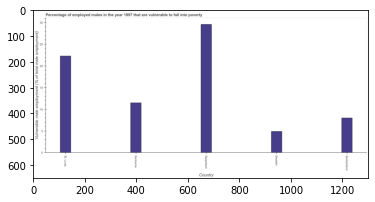

Number of QA =  22





,Country,Vulnerable male employment (% of total male employment)
0,St. Luca,22.428509
1,Swaziland,29.688062
2,NaN,NaN
3,Switzerland,8.146098
4,NaN,NaN


> what is the title of the graph ?
PREDICTED =  Percentage of employed males in the year 1997 that are vulnerable to fall into poverty
EXPECTED =  Percentage of employed males in the year 1997 that are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Vulnerable male employment (% of total male employment)
EXPECTED =  Vulnerable male employment (% of total male employment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are vulnerable to fall into poverty in swaziland and switzerland ?
PREDICTED =  21.541964227305563
EXPECTED =  21.6




				 4 / 4 = 1.0


> what is the median percentage of employed males who are vulnerable to fall into pover

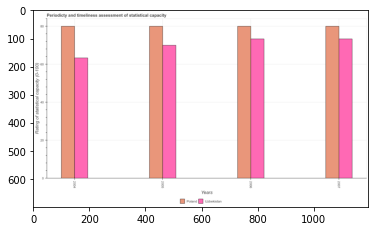

Number of QA =  28





,Years,Uzbekistan,Poland
0,2006,73.558042,79.978760
1,2004,63.655100,80.293882
2,2005,70.363161,79.820841
3,2007,73.569595,79.938907


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in uzbekistan in 2005 and that in 2007 ?
PREDICTED =  -3.2064340348886873
EXPECTED =  -3.3333300000000037




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in poland in 2006 and the rating of statistical capacity in uzbekistan in 2004?
PREDICTED =  -0.3151217229112575
EXPECTED =  16.666670000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the rating of statistical capacity in uzbekistan and rating of statistical capacity in poland ?
PREDICTED =  -9.784042

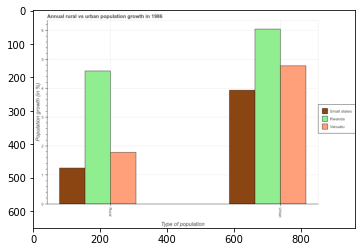

Number of QA =  23





,Type of population,Rwanda,Small states,Vanuatu
0,Rural,4.591453,1.248952,1.770105
1,Urban,6.033239,3.943372,4.764353


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth in small states and that in rwanda ?
PREDICTED =  0.0
EXPECTED =  -3.35862621638877




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth in vanuatu and the urban population growth in small states?
PREDICTED =  -3.422219312308112
EXPECTED =  -2.1489107557482097




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth and urban population growth in small states ?
PREDICTED =  -1.3472096449376245
EXPECTED =  -2.69202428181032




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_

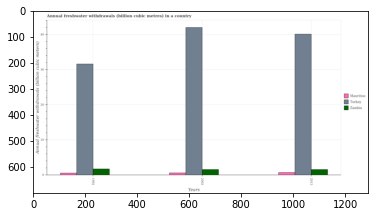

Number of QA =  29





,Years,Turkey,Mauritius,Zambia
0,2002,42.356657,0.762539,1.715222
1,2013,40.275908,0.873187,1.711774
2,1992,31.814424,0.689754,1.885594


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual freshwater withdrawals in zambia in 1992 and that in 2013 ?
PREDICTED =  0.17382033208322256
EXPECTED =  0.17500000000000004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual freshwater withdrawals in mauritius in 1992 and the annual freshwater withdrawals in zambia in 2002?
PREDICTED =  -0.0727848066405008
EXPECTED =  -1.006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the annual freshwater withdrawals in mauritius and annual freshwater withdrawals in turkey ?
PREDICTED =  0.0
EXPECTED =  -41.39




				 

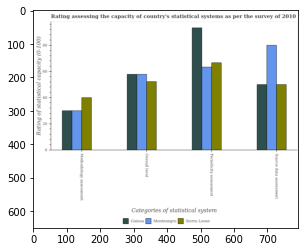

Number of QA =  29





,Categories of statistical system,Sierra Leone,Guinea,Montenegro
0,Source data assessment,50.455284,50.680443,80.113043
1,Periodicity assessment,67.301281,93.998435,63.862062
2,Methodology assessment,40.451455,30.582059,30.368637
3,Overall level,52.726914,58.307801,58.263273


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the methodology assessment rating in montenegro and that in sierra leone ?
PREDICTED =  -10.08281868528185
EXPECTED =  -10.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the overall level rating in sierra leone and the source data assessment rating in guinea?
PREDICTED =  -1.7672080883162025
EXPECTED =  2.222222222222207




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the overall level rating in gui

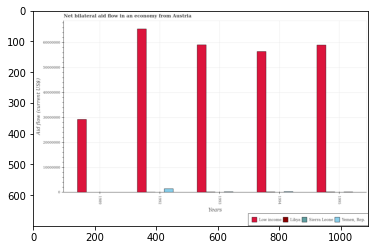

Number of QA =  30





,Years,Unnamed: 1,Low income,Sierra Leone,"Yemen, Rep."
0,1992,NaN,6.608009e+07,NaN,1.641571e+06
1,1989,NaN,2.932087e+07,NaN,NaN
2,1994,NaN,5.653817e+07,NaN,NaN
3,1995,NaN,5.942557e+07,NaN,NaN
4,1993,NaN,5.933262e+07,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in libya in 1989 and that in 1995 ?
PREDICTED =  0.0
EXPECTED =  -130000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in low income in 1993 and the net bilateral aid flow in libya in 1989?
PREDICTED =  30011747.6618832
EXPECTED =  59080000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the net bilateral aid flow in low income and net bilateral aid flow in libya ?
PREDICTED =  66080080.33564991
EXPECTED =  56280000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_g

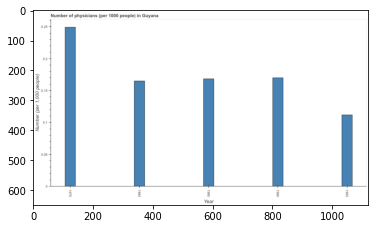

Number of QA =  23





,Year,"Number (per 1,000 people)"
0,1985,0.168627
1,1993,0.112759
2,1990,0.170085
3,1975,0.249534
4,1984,0.165195


> what is the title of the graph ?
PREDICTED =  Number of physicians (per 1000 people) in Guyana
EXPECTED =  Number of physicians (per 1000 people) in Guyana




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number (per 1,000 people)
EXPECTED =  Number (per 1,000 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in 1985 and 1993 ?
PREDICTED =  0.05586813321661428
EXPECTED =  0.057




				 4 / 4 = 1.0


> what is the median number of physicians ?
PREDICTED =  None
EXPECTED =  0.168400004506111




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of

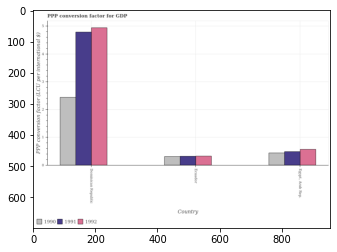

Number of QA =  29





,Country,1992,1990,1991
0,"Egypt, Arab Rep.",0.580450,0.456081,0.505951
1,Dominican Republic,4.914664,2.451826,4.788628
2,Ecuador,0.338390,0.326639,0.335802


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1990 in ecuador and that in egypt, arab rep. ?
PREDICTED =  -0.12944154705278987
EXPECTED =  -0.1298825039712459




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1990 in dominican republic and the ppp conversion factor for gdp in 1992 in ecuador?
PREDICTED =  2.1251872315288933
EXPECTED =  2.114299118098719




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp of/in 1990 and ppp conversion factor for gdp of/in 1991 in ecuador?
PREDICTED =  2.89874

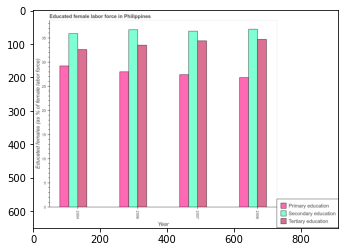

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,2008,37.329959,34.979166,26.756332
1,2006,37.320441,33.735572,28.267400
2,2007,36.907127,34.633022,27.603720
3,2004,36.057605,32.907297,29.429649


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in 2004 and that in 2006 ?
PREDICTED =  -0.8282750022405381
EXPECTED =  -0.9000015258788991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 2007 and the percentage of female labor force who received primary education in 2008?
PREDICTED =  -0.42283241086470724
EXPECTED =  -0.399997711181598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of female labor force who received ter

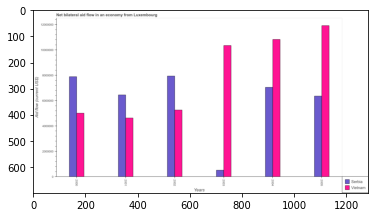

Number of QA =  28





,Years,Serbia,Vietnam
0,2003,5.553171e+05,1.038806e+07
1,2004,7.125997e+06,1.085348e+07
2,2002,8.040774e+06,5.290567e+06
3,2005,6.415491e+06,1.197556e+07
4,2001,6.472372e+06,4.669478e+06
5,2000,7.966066e+06,5.033159e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in serbia in 2000 and that in 2001 ?
PREDICTED =  1493694.7941126842
EXPECTED =  1440000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in serbia in 2005 and the net bilateral aid flow in vietnam in 2002?
PREDICTED =  -1625283.5203068312
EXPECTED =  1100000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the net bilateral aid flow in serbia and net bilateral aid flow in vietnam ?
PREDICTED =  -11634282.925514147
EXPECTED =  -9840000.0




				 1 / 3 = 0.3333


is_built_w

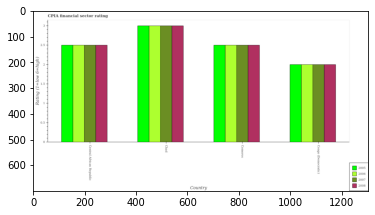

Number of QA =  30





,Country,2007,2005,2006,2008
0,Congo (Democratic),2.019209,2.019820,2.021218,2.018620
1,Central African Republic,2.529528,2.527404,2.523880,2.528436
2,Comoros,2.523499,2.527024,2.530741,2.523241
3,Chad,3.025892,3.029979,3.025628,3.034485


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in chad and that in congo (democratic) ?
PREDICTED =  1.0044101480957304
EXPECTED =  1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in chad and the cpia rating in 2008 in central african republic?
PREDICTED =  0.5025752224660267
EXPECTED =  0.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2007 and cpia rating of/in 2005 in comoros?
PREDICTED =  -0.0024922941158926903
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

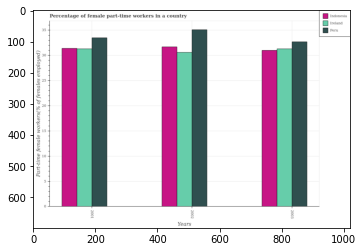

Number of QA =  29





,Years,Unnamed: 1,Indonesia,Ireland
0,2003,32.815159,30.961262,31.302335
1,2002,35.225160,31.684628,30.613839
2,2001,33.444018,31.343001,31.244791


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in peru in 2002 and that in 2003 ?
PREDICTED =  -2.201319543173497
EXPECTED =  2.399997711181598




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in peru in 2003 and the percentage of female part-time workers in ireland in 2002?
PREDICTED =  2.201319543173497
EXPECTED =  2.100000381469812




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of female part-time workers in indonesia and percentage of female part-time workers in peru ?
PR

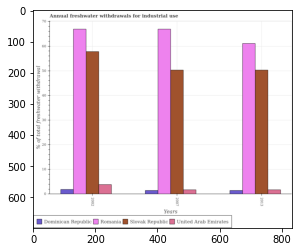

Number of QA =  30





,Years,Dominican Republic,United Arab Emirates,Slovak Republic,Romania
0,2002,2.032538,3.948495,57.335491,66.309250
1,2007,1.592501,1.881822,49.893268,66.608889
2,2013,1.612283,1.868088,50.139299,60.470466


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual withdrawals from freshwater in romania in 2002 and that in 2013 ?
PREDICTED =  5.838784385287042
EXPECTED =  5.829999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual withdrawals from freshwater in slovak republic in 2002 and the total annual withdrawals from freshwater in romania in 2013?
PREDICTED =  -57.47046556075196
EXPECTED =  -3.299999999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the total annual withdrawals from freshwater in romania and total annual withdrawals from 

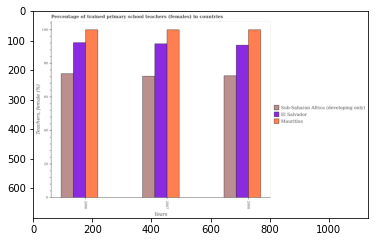

Number of QA =  29





,Years,El] Salvador,Sub-Saharan Africa (developing only),Mauritius
0,2008,91.699782,73.016748,101.324451
1,2007,92.578898,72.874900,101.298799
2,2006,93.201812,74.841848,100.896497


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (females) in mauritius in 2007 and that in 2008 ?
PREDICTED =  -0.025652005340987216
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (females) in mauritius in 2007 and the percentage of trained primary school teachers (females) in sub-saharan africa (developing only) in 2006?
PREDICTED =  26.456951231157873
EXPECTED =  26.182807922363295




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

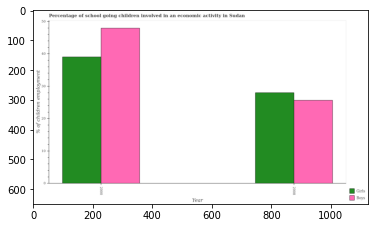

Number of QA =  24





,Year,Girls,Boys
0,2008,28.629023,25.915803
1,2000,39.577690,48.579316


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of school going boys in 2000 and that in 2008 ?
PREDICTED =  22.663512297612602
EXPECTED =  22.257354567975803




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of school going boys in 2008 and the percentage of school going girls in 2000?
PREDICTED =  -22.663512297612602
EXPECTED =  -22.257354567975803




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of school going girls and percentage of school going boys ?
PREDICTED =  2.71321938551678
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_bui

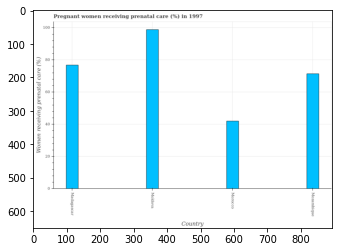

Number of QA =  22





,Country,Women receiving prenatal care (%)
0,Madagascar,77.059140
1,Morocco,42.202355
2,Mozambique,71.608838
3,Moldova,99.064940


> what is the title of the graph ?
PREDICTED =  Pregnant women receiving prenatal care (%) in 1997
EXPECTED =  Pregnant women receiving prenatal care (%) in 1997




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Women receiving prenatal care (%)
EXPECTED =  Women receiving prenatal care (%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant women receiving prenatal care in moldova and morocco ?
PREDICTED =  56.862585286938035
EXPECTED =  56.8




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of pregnant women receiving prenatal care ?
PREDICTED =  74.

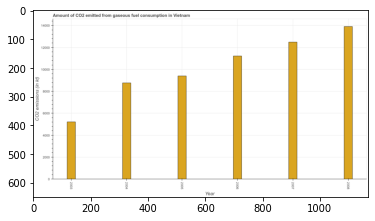

Number of QA =  23





,Year,CO2 emissions (in kt)
0,2008,13832.373491
1,2003,5205.431018
2,2005,9338.121146
3,2006,11135.678052
4,2007,12415.291120
5,2004,8720.546891


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption in Vietnam
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption in Vietnam




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in 2007 and 2008 ?
PREDICTED =  -1417.0823704610448
EXPECTED =  -1422.796




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel consumption ?
PREDICTED =  10236.89959911901
EXPECTED 

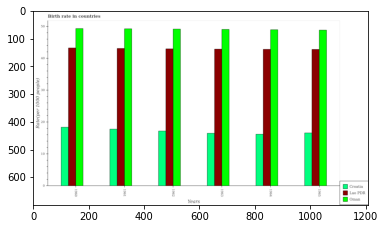

Number of QA =  29





,Years,Oman,Croatia,Lao PDR
0,1963,49.503721,16.845311,43.140408
1,1965,49.136977,16.778478,43.039875
2,1961,49.422342,18.132387,43.427294
3,1960,49.435314,18.528770,43.417542
4,1962,49.466816,17.339118,43.347623
5,1964,49.213995,16.323213,43.014384


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in lao pdr in 1963 and that in 1964 ?
PREDICTED =  0.12602374039333597
EXPECTED =  0.05999999999998806




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in lao pdr in 1963 and the birth rate in oman in 1961?
PREDICTED =  -0.28688632342056763
EXPECTED =  -6.375999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1960, what is the difference between the birth rate in croatia and birth rate in lao pdr ?
PREDICTED =  -1859.3860554158507
EXPECTED =  -24.864000000000004




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: 

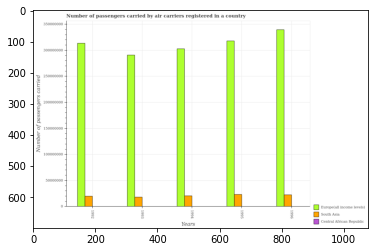

Number of QA =  29





,Years,Central African Republic,Europe(all income levels),South Asia
0,1996,NaN,3.393918e+08,2.299903e+07
1,1992,NaN,3.132339e+08,2.062565e+07
2,1993,NaN,2.904879e+08,1.895801e+07
3,1995,NaN,3.180382e+08,2.378185e+07
4,1994,NaN,3.027563e+08,2.137834e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in central african republic in 1994 and that in 1995 ?
PREDICTED =  -15281946.104646385
EXPECTED =  -4900.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in central african republic in 1993 and the number of passengers carried by air carriers in europe(all income levels) in 1994?
PREDICTED =  -12268361.40878892
EXPECTED =  -302779100.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

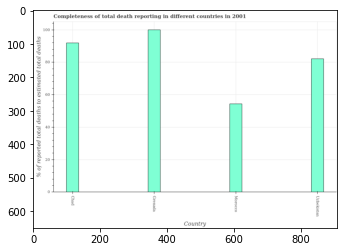

Number of QA =  22





,Country,% of reported total deaths to estimated total deaths
0,Chad,92.593792
1,Morocco,55.431197
2,Grenada,101.517486
3,Uzbekistan,83.317028


> what is the title of the graph ?
PREDICTED =  Completeness of total death reporting in different countries in 2001
EXPECTED =  Completeness of total death reporting in different countries in 2001




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of reported total deaths to estimated total deaths
EXPECTED =  % of reported total deaths to estimated total deaths




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in chad and morocco ?
PREDICTED =  37.162595009413344
EXPECTED =  37.548




				 4 / 4 = 1.0


> what is the median completeness of total death reports ?
PREDICTED =  None
EXPECTED =  87.0326486024




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_availabl

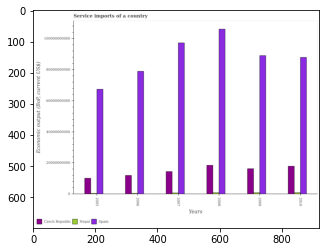

Number of QA =  29





,Years,Spain,Czech Republic,Nepal
0,2007,9.702308e+10,1.460836e+10,1.028249e+09
1,2010,8.794104e+10,1.818286e+10,NaN
2,2005,6.740267e+10,1.034648e+10,NaN
3,2008,1.069207e+11,1.862209e+10,1.034863e+09
4,2009,8.945654e+10,1.652125e+10,NaN
5,2006,7.897235e+10,1.212779e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service imports in nepal in 2006 and that in 2008 ?
PREDICTED =  nan
EXPECTED =  -358905348.00000006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service imports in czech republic in 2008 and the service imports in nepal in 2006?
PREDICTED =  6494301885.108704
EXPECTED =  17963567768.8




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the service imports in czech republic and service imports in spain ?
PREDICTED =  -72884595138.22389
EXPECTED =  -69966026589




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avai

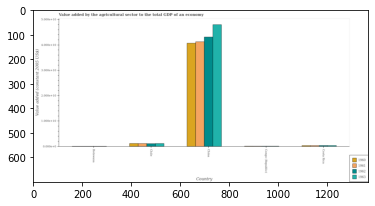

Number of QA =  30





,Country,1963,1962,1961,1960
0,Congo (Republic),NaN,NaN,NaN,NaN
1,Botswana,NaN,NaN,NaN,NaN
2,China,4.804747,4.328464,4.113812,4.060104
3,Costa Rica,NaN,NaN,NaN,NaN
4,Chile,0.141521,0.137463,0.140002,0.143497


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1962 in chile and that in costa rica ?
PREDICTED =  0.0
EXPECTED =  734818787.0254949




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1961 in congo (republic) and the value added by the agricultural sector in 1962 in china?
PREDICTED =  nan
EXPECTED =  -43027560194.5654




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio 

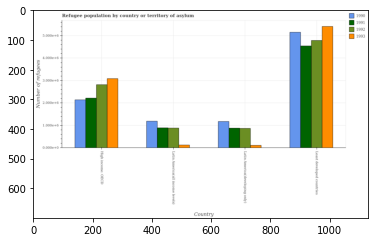

Number of QA =  30





,Country,1992,1993,1991,1990
0,Least developed countries,4.827717,5.460492,4.605095,5.217437
1,Latin America(developing only),0.892913,0.123852,0.894185,1.201780
2,High income: OECD,2.837652,3.120737,2.225569,2.172070
3,Latin America(all income levels),0.903619,0.138425,0.908530,1.214351


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in 1991 in latin america(all income levels) and that in latin america(developing only) ?
PREDICTED =  0.014345189863375962
EXPECTED =  13402.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in 1990 in latin america(all income levels) and the number of refugees in 1992 in least developed countries?
PREDICTED =  -6.41921665617604
EXPECTED =  -3601087.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees of/in 1990 and number of refugees of/in 1991 in latin america(all income levels)?

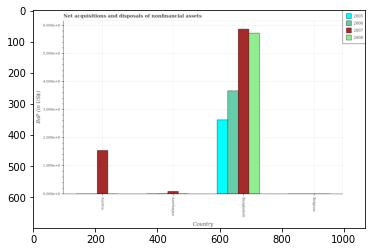

Number of QA =  24





,Country,2007,2005,2008,2006
0,NaN,NaN,NaN,NaN,NaN
1,Austria,1.564160,NaN,NaN,NaN
2,Azerbaijan,0.100757,NaN,NaN,NaN
3,Bangladesh,5.885741,2.663582,5.734767,3.701386


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in 2006 in azerbaijan and that in bangladesh ?
PREDICTED =  -3.70138625457128
EXPECTED =  -366312883.1




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in 2008 in azerbaijan and the balance of payments in 2006 in bangladesh?
PREDICTED =  -5.734767225314834
EXPECTED =  -366597883.1




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of/in 2005 and balance of payments of/in 2007 in bangladesh?
PREDICTED =  -3.2221591351720495
EXPECTED =  -323210365.3000001




				 0 / 3 = 0.0


is_

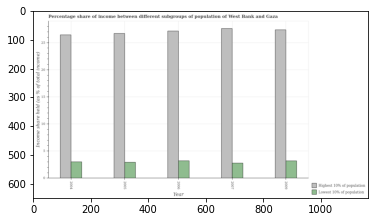

Number of QA =  28





,Year,Lowest 10% of population,Highest 10% of population
0,2005,3.074731,26.868824
1,2007,2.871186,27.753999
2,2004,3.091774,26.590290
3,2009,3.293248,27.426788
4,2006,3.311977,27.332481


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in 2004 and that in 2005 ?
PREDICTED =  23.515558697291276
EXPECTED =  0.07999999999999963




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in 2005 and the income share held by highest 10% of the population in 2007?
PREDICTED =  0.20354549658755827
EXPECTED =  0.15000000000000036




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the income share held by lowest 10% of the population and income share held by highest 10% of the 

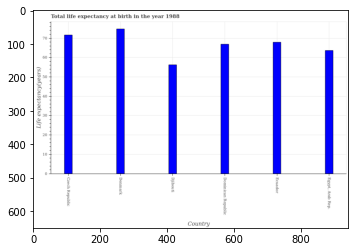

Number of QA =  22





,Country,Life expectancy(years)
0,Ecuador,68.824485
1,Dominican Republic,67.835033
2,"Egypt, Arab Rep.",64.587675
3,Djibou ti,57.015535
4,Denmark,76.644342
5,Czech Republic,72.584347


> what is the title of the graph ?
PREDICTED =  Total life expectancy at birth in the year 1988
EXPECTED =  Total life expectancy at birth in the year 1988




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Life expectancy(years)
EXPECTED =  Life expectancy(years)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in ecuador and egypt, arab rep. ?
PREDICTED =  4.236809413480927
EXPECTED =  4.273




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median life expectancy at birth ?
PREDICTED =  68.32975862694991
EXPECTED =  67.40089024390244




				 5 / 5 = 1.0


is_buil

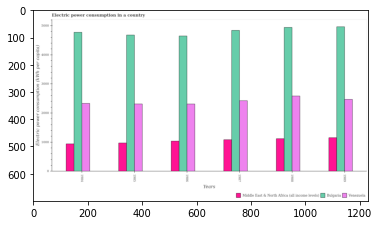

Number of QA =  29





,Years,Middle East & North Africa (all income levels;,Bulgaria,Venezuela
0,1984,955.715206,4782.045081,2350.888675
1,1987,1108.620194,4841.196494,2452.157519
2,1989,1166.710071,4981.081739,2476.974297
3,1985,980.288156,4702.935104,2332.649542
4,1988,1129.280761,4945.470219,2606.711344
5,1986,1049.636947,4676.959287,2318.691960


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in venezuela in 1986 and that in 1988 ?
PREDICTED =  -288.0193840395382
EXPECTED =  -274.1374006926003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in venezuela in 1987 and the electric power consumption in in bulgaria in 1989?
PREDICTED =  -24.816778363463982
EXPECTED =  -2540.4303673406107




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the electric power consumption in in bulgaria and electric power consumption in in middle east & north africa (all income 

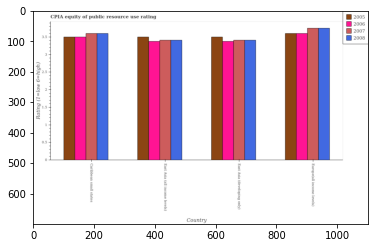

Number of QA =  30





,Country,2007,2005,2006,2008
0,Europe(all income levels),3.755864,3.609053,3.590399,3.736591
1,Caribbean small states,3.611127,3.511411,3.486339,3.605007
2,East Asia (all income levels),3.405110,3.501193,3.370370,3.420186
3,East Asia (developing only),3.414807,3.499813,3.379433,3.410266


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in caribbean small states and that in east asia (all income levels) ?
PREDICTED =  0.11596895994288658
EXPECTED =  0.125




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in europe(all income levels) and the cpia rating in 2005 in caribbean small states?
PREDICTED =  0.10405937999633297
EXPECTED =  0.10000000000000009




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2006 and cpia rating of/in 2007 in east asia (all income levels)?
PREDICTED =  0.05152558565999854
EXPECTED =  -0.03

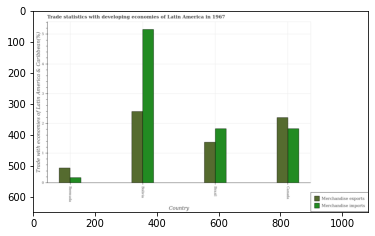

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Brazil,1.822323,1.373420
1,Bolivia,5.134829,2.395574
2,Canada,1.825715,2.188483
3,Bermuda,0.192857,0.515434


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in bolivia and that in canada ?
PREDICTED =  3.309113544964995
EXPECTED =  3.33816024119076




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in bolivia and the merchandise imports in bermuda?
PREDICTED =  1.8801393473415902
EXPECTED =  2.224238605163125




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports and merchandise exports in canada ?
PREDICTED =  0.055448393772421944
EXPECTED =  -0.37358750049862




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs

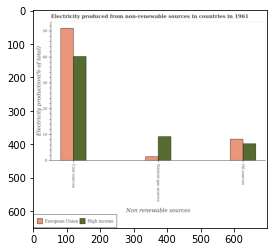

Number of QA =  28





,Non renewable sources,High income,European Union
0,Natural gas sources,9.21333,1.602212
1,Coal sources,39.85198,50.852705
2,Oil sources,6.55369,8.258616


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources in european union and that in high income ?
PREDICTED =  0.0
EXPECTED =  1.76250229817538




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources in high income and the percentage of electricity produced by natural gas in european union?
PREDICTED =  6.5536896866963055
EXPECTED =  4.98147575508984




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources and percentage of electricity produced by coal in e

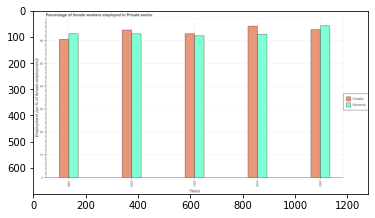

Number of QA =  28





,Years,Slovenia,Croatia
0,1999,63.263259,60.541193
1,2002,62.934668,66.214072
2,2000,63.022811,64.700592
3,2003,66.408316,65.028505
4,2001,62.099658,63.021523


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in slovenia in 2001 and that in 2002 ?
PREDICTED =  -0.8350102751362414
EXPECTED =  -0.600002288818402




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in slovenia in 2003 and the percentage of females employed in private sector in croatia in 1999?
PREDICTED =  3.145056587443129
EXPECTED =  6.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of females employed in private sector in croatia and percentage of fem

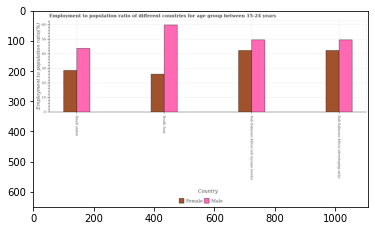

Number of QA =  28





,Country,Female,Male
0,Small states,28.939917,44.246403
1,South Asia,26.235384,60.396238
2,Sub-Saharan Africa (developing only),42.987545,49.859204
3,Sub-Saharan Africa (all income levels),42.621787,50.131893


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio(male) in the graph ?
PREDICTED =  0.0195471189

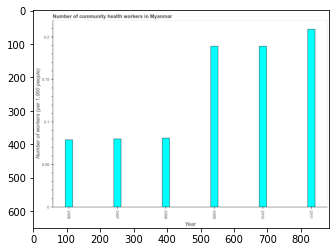

Number of QA =  23





,Year,"Number of workers (per 1,000 people)"
0,2009,0.191358
1,2007,0.081229
2,2008,0.082316
3,2010,0.191722
4,2011,0.211733
5,2006,0.080469


> what is the title of the graph ?
PREDICTED =  Number of community health workers in Myanmar
EXPECTED =  Number of community health workers in Myanmar




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of workers (per 1,000 people)
EXPECTED =  Number of workers (per 1,000 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of community health workers in 2007 and 2011 ?
PREDICTED =  -0.13050416749554983
EXPECTED =  -0.129




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of community health workers ?
PREDICTED =  2008.5
EXPECTED =  0.135




				 4 / 5 = 0.8


is_

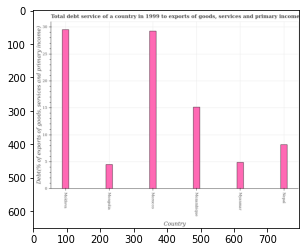

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Myanmar,4.917567
1,Nepal,8.187349
2,Morocco,29.226243
3,Mozambique,15.023392
4,Mongolia,4.510597
5,Moldova,29.266894


> what is the title of the graph ?
PREDICTED =  Total debt service of a country in 1999 to exports of goods, services and primary income
EXPECTED =  Total debt service of a country in 1999 to exports of goods, services and primary income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in mongolia and mozambique ?
PREDICTED =  -10.512795102109525
EXPECTED =  -10.653




				 4 / 4 = 1.0


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  11.653028737985315




				 4 / 6 = 0.6667


is_built_wit

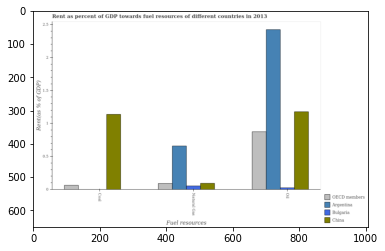

Number of QA =  28





,Fuel resources,OECD members,Bulgaria,China,Argentina
0,Coal,0.071183,NaN,1.142472,NaN
1,Natural Gas,0.099377,0.060257,0.100284,0.661334
2,Oil,0.870927,0.032761,1.183166,2.421365


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards coal in oecd members and that in china ?
PREDICTED =  -1.071288669850371
EXPECTED =  -1.0755016431518083




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in argentina and the rent towards oil in bulgaria?
PREDICTED =  0.6010768212035095
EXPECTED =  0.6339741615480378




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rent towards oil in bulgaria to that in 

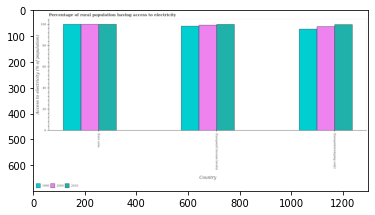

Number of QA =  29





,Country,2000,1990,2010
0,Europe(developing only),98.057693,95.324795,100.010260
1,Europe(all income levels),99.474573,98.174188,100.068071
2,Euro area,99.951065,99.753821,100.550950


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2010 in europe(all income levels) and that in europe(developing only) ?
PREDICTED =  0.057810672304071886
EXPECTED =  0.14894485026820803




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2010 in europe(developing only) and the percentage of rural population having access to electricity in 2000 in europe(all income levels)?
PREDICTED =  -97.52200592846603
EXPECTED =  0.5574834516863945




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the di

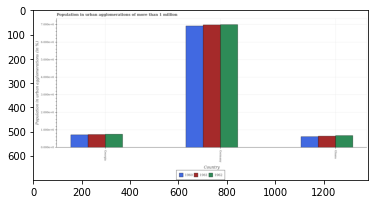

Number of QA =  29





,Country,1962,1961,1960
0,Ghana,0.688233,0.657848,0.641337
1,Georgia,0.768765,0.752905,0.734676
2,Germany,6.963820,6.909875,6.848496


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in 1962 in germany ?
PREDICTED =  2.3212732672318617
EXPECTED =  6996913.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum population in urban agglomerations in 1961 ?
PREDICTED =  2.303291799313591
EXPECTED =  6980524.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum population in urban agglomerations in 1961 ?
PREDICTED =  0.21928260204295558
EXPECTED =  643385.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

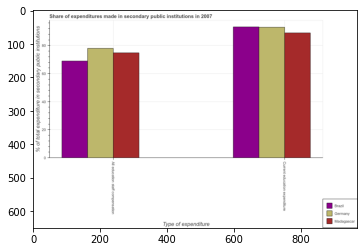

Number of QA =  23





,Type of expenditure,Germany,Brazil,Madagascar
0,Current education expenditure,93.456221,93.663587,89.415741
1,All education staff compensation,78.688412,69.312768,75.237294


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure in staff compensation in germany to that in madagascar ?
PREDICTED =  1.0458697718109473
EXPECTED =  1.0428521984584578




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of total expenditure in secondary public institutions
EXPECTED =  20.0




				 1 / 5 = 0.2


> what is the title of the graph ?
P

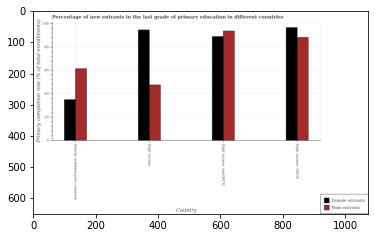

Number of QA =  28





,Country,Male entrants,Female entrants
0,High income,48.143858,94.866808
1,High income: nonOECD,93.814601,89.000361
2,High income: OECD,88.326007,NaN
3,Heavily indebted poor countries,61.187542,34.968150


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in heavily indebted poor countries and that in high income ?
PREDICTED =  61.18754212690683
EXPECTED =  13.94725799560549




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in high income: oecd and the primary completion rate of female entrants in heavily indebted poor countries?
PREDICTED =  27.138464979387685
EXPECTED =  53.32893753051759




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants and primary completion rate

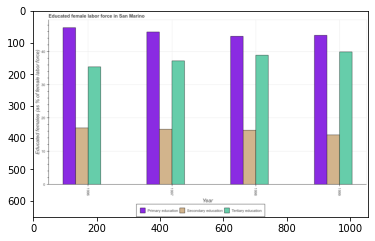

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,1999,15.164142,40.138799,45.108275
1,1997,17.103158,37.283991,46.005636
2,1998,16.771900,39.180470,44.858079
3,1996,17.270442,35.600737,47.330783


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in 1998 and that in 1999 ?
PREDICTED =  -0.25019568820219007
EXPECTED =  -0.3000030517577983




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 1997 and the percentage of female labor force who received tertiary education in 1998?
PREDICTED =  -22.07731275007252
EXPECTED =  0.300001144409201




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


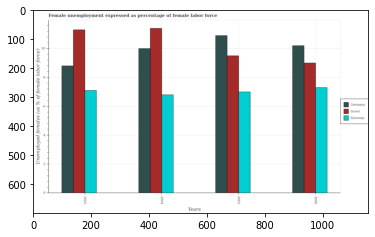

Number of QA =  29





,Years,Slovenia,Israel,Germany
0,2005,6.990416,9.493261,10.848210
1,2006,7.305459,9.031756,10.161869
2,2003,7.097523,11.329094,8.797527
3,2004,6.786722,11.445556,10.005743


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in israel in 2003 and that in 2005 ?
PREDICTED =  1.8358326740479196
EXPECTED =  1.8000001907349006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in israel in 2005 and the unemployment in females in in germany in 2004?
PREDICTED =  -11.445556182623912
EXPECTED =  -0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the unemployment in females in in germany and unemployment in females in in israel ?
PREDICTED =  35.813349199873144
EXPECTED =  1.1999998092650994




	

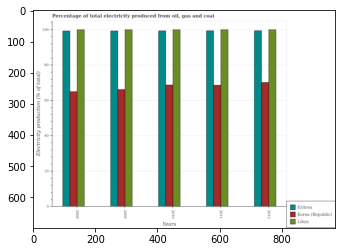

Number of QA =  29





,Years,Unnamed: 1,Eritrea,Korea (Republic)
0,2008,101.106918,99.695549,66.012630
1,2009,101.055565,100.381900,66.630547
2,2011,101.036722,100.428828,68.903941
3,2012,100.969241,100.003202,70.987823
4,2010,100.953808,99.598019,69.543326


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in in eritrea in 2009 and that in 2011 ?
PREDICTED =  99.64862152805682
EXPECTED =  -0.08449429160590682




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in in korea (republic) in 2008 and the electricity production in in eritrea in 2009?
PREDICTED =  -0.6179173143686398
EXPECTED =  -34.347657018807




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the el

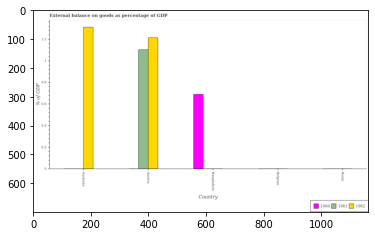

Number of QA =  19





,Country,1962,1961,1960
0,NaN,NaN,NaN,NaN
1,Benin,NaN,NaN,NaN
2,Bangladesh,NaN,NaN,0.691141
3,Austria,1.218019,1.106906,NaN
4,Australia,1.313932,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in 1960 in benin and the external balance on goods as percentage of gdp in 1962 in australia?
PREDICTED =  nan
EXPECTED =  -1.31238030866284




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of GDP
EXPECTED =  0.2




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  External balance on goods as percentage oa
EXPECTED =  External balance on goods as percentage of GDP




				 0 / 4 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 5 = 0.2


> what is the label or title of the y-axis ?


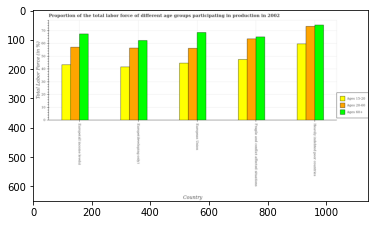

Number of QA =  29





,Country,Ages 15-20,Ages 60+,Ages 20-60
0,Europe(all income levels),43.597285,68.030176,57.504246
1,Europe( developing only),42.262312,62.949315,57.210749
2,European Union,45.224622,69.108603,57.206836
3,Heavily indebted poor countries,60.735928,75.301726,74.161985
4,Fragile and conflict affected situations,48.139223,65.914463,64.195603


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force within the age group 20-60 in europe(all income levels) and that in fragile and conflict affected situations ?
PREDICTED =  -6.69135677438571
EXPECTED =  -6.528488662143616




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force above age 60 in europe(all income levels) and the percentage of labor force within the age group 15-20 in fragile and conflict affected situations?
PREDICTED =  2.115713707317269
EXPECTED =  19.985914410228503




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentag

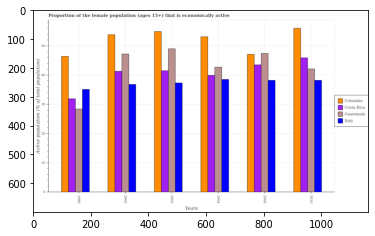

Number of QA =  30





,Years,Colombia,Costa Rica,Guatemala,Italy
0,2002,54.459778,41.501152,47.627144,37.075344
1,1989,46.858907,32.053426,28.541942,35.545921
2,2010,56.924094,46.389035,42.518718,38.358616
3,2004,53.506891,40.362865,43.446505,38.687686
4,2006,47.522531,44.120894,47.661514,38.732318
5,2003,55.041086,41.966101,49.373966,37.791445


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in colombia in 2002 and that in 2006 ?
PREDICTED =  6.937246990932714
EXPECTED =  6.700000762939396




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in costa rica in 1989 and the proportion of the female population that is economically active in guatemala in 2002?
PREDICTED =  -9.447725389331737
EXPECTED =  -15.300001144409194




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the proportion of the 

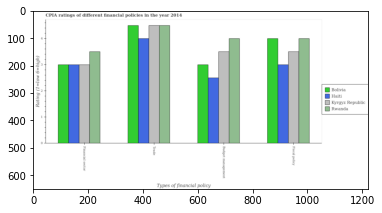

Number of QA =  29





,Types of financial policy,Rwanda,Kyrgyz Republic,Bolivia,Haiti
0,Trade,4.513762,4.518469,4.518347,4.010519
1,Financia! sector,3.515981,3.011328,3.015654,3.004394
2,Budget management,4.018077,3.498566,2.998650,2.515285
3,Fiscal policy,4.010395,3.514436,4.024751,3.027555


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of budget management in bolivia and that in kyrgyz republic ?
PREDICTED =  1.9986498872388934
EXPECTED =  -0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of trade in haiti and the cpia rating of budget management in bolivia?
PREDICTED =  1.0118695288109283
EXPECTED =  1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of budget management and cpia rating of financial sector in rwanda ?
PREDICTED =  -2.0
EXPECTED =  0.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False


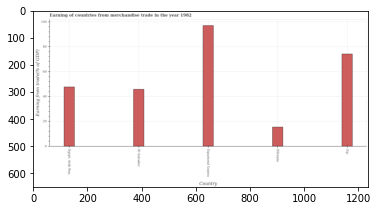

Number of QA =  22





,Country,Earning from trade(% of GDP)
0,Fiji,74.900579
1,"Egypt, Arab Rep.",48.303140
2,Equatorial Guinea,98.085597
3,El Salvador,46.370518
4,Ethiopia,15.789337


> what is the title of the graph ?
PREDICTED =  Earning of countries from merchandise trade in the year 1982
EXPECTED =  Earning of countries from merchandise trade in the year 1982




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Earning from trade(% of GDP)
EXPECTED =  Earning from trade(% of GDP)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earning from merchandise trade in ethiopia and fiji ?
PREDICTED =  -59.11124180327663
EXPECTED =  -58.829




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median earning from merchandise trade ?
PREDICTED =  48.303139582757424
EXPECTED =  47.66

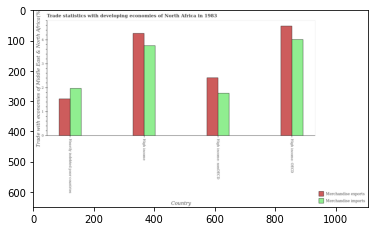

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,High income: nonOECD,1.780745,2.406750
1,High income,3.763276,4.267012
2,High income: OECD,4.017556,4.583788
3,Heavily indebted poor countries,1.983429,1.549616


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in high income and that in high income: nonoecd ?
PREDICTED =  1.9825308893261426
EXPECTED =  1.9868481666416302




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in high income: oecd and the merchandise exports in heavily indebted poor countries?
PREDICTED =  2.034127047226274
EXPECTED =  2.4764676747448595




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports and merchandise exports in high income ?
PREDICTED =  -1.3807605177360833
EXPECTED =  -0.5128264865934802




				 1 / 3 = 0

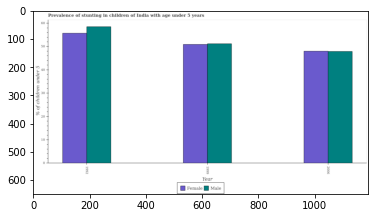

Number of QA =  28





,Year,Female,Male
0,1999,51.619230,51.671490
1,1992,56.389813,59.353522
2,2006,48.226404,49.070066


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted male children in 1992 and that in 2006 ?
PREDICTED =  10.28345665206038
EXPECTED =  10.5999984741211




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted male children in 1992 and the percentage of stunted female children in 1999?
PREDICTED =  7.682031850909354
EXPECTED =  7.299999237060497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the percentage of stunted male children and percentage of stunted female children ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_b

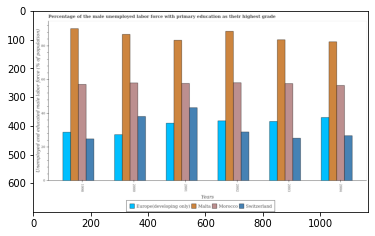

Number of QA =  30





,Years,Switzerland,Europe(developing only),Malta,Morocco
0,2003,25.760950,35.703400,84.282320,58.166669
1,2002,29.142176,35.907385,88.495561,58.649060
2,2000,38.465526,27.778149,87.416568,58.421459
3,2001,43.427924,34.390291,83.823924,58.017263
4,1998,25.309342,29.073801,91.209355,57.894108
5,2004,27.172953,37.865308,83.019180,57.275253


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in switzerland in 2001 and that in 2002 ?
PREDICTED =  0.0
EXPECTED =  14.399999618530188




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in switzerland in 2003 and the percentage of the unemployed male labor force with primary education in malta in 1998?
PREDICTED =  0.4516079886550166
EXPECTED =  -64.9999961853027




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of the 

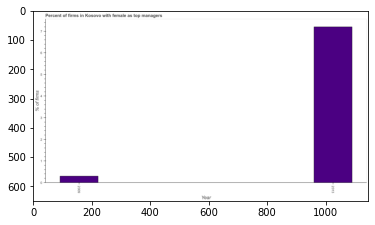

Number of QA =  19





,Year,% of firms
0,2013,7.312146
1,2009,0.325641


> what is the title of the graph ?
PREDICTED =  Percent of firms in Kosovo with female as top managers
EXPECTED =  Percent of firms in Kosovo with female as top managers




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of firms
EXPECTED =  % of firms




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms with female as top manager in 2009 and 2013 ?
PREDICTED =  -6.986505580840187
EXPECTED =  -6.9




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of firms with female as top manager ?
PREDICTED =  3.81889360440914
EXPECTED =  3.75




				 5 / 5 = 1.0


is_built

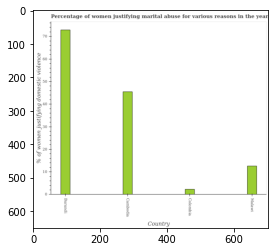

Number of QA =  22





,Country,% of women justifying domestic violence
0,Colombia,2.461604
1,Cambodia,45.599012
2,Malawi,12.725262
3,Burundi,72.488751


> what is the title of the graph ?
PREDICTED =  Percentage of women justifying marital abuse for various reasons in the year
EXPECTED =  Percentage of women justifying marital abuse for various reasons in the year 2010




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  % of women justifying domestic violence
EXPECTED =  % of women justifying domestic violence




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying marital abuse in burundi and malawi ?
PREDICTED =  59.76348917415677
EXPECTED =  60.3




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percenta

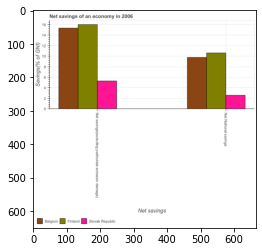

Number of QA =  23





,Net savings,Belgium,Finland,Slovak Republic
0,Net National savings,9.907520,10.890311,2.690993
1,Net savings(excuding particulate emission damage),15.568034,16.362666,5.451711


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Savings(% of GNI)
EXPECTED =  2.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Net savings of an economy in 2006
EXPECTED =  Net savings of an economy in 2006




				 1 / 6 = 0.1667


> what is the label or title of the x-axis ?
PREDICTED =  Net savings
EXPECTED =  N

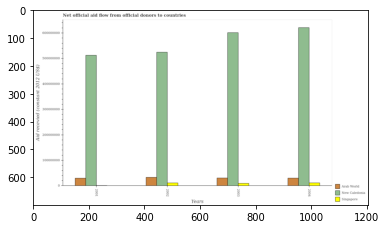

Number of QA =  29





,Years,Singapore,Arab Worid,New Caledonia
0,2004,1.323217e+07,3.197933e+07,6.263151e+08
1,2002,1.323438e+07,3.540740e+07,5.306026e+08
2,2001,NaN,3.171203e+07,5.142134e+08
3,2003,1.143550e+07,3.208236e+07,6.065708e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total aid received in new caledonia in 2001 and that in 2003 ?
PREDICTED =  -92357461.68028581
EXPECTED =  -88790000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total aid received in singapore in 2003 and the total aid received in arab world in 2004?
PREDICTED =  -1796669.832592994
EXPECTED =  -20660000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the total aid received in singapore and total aid received in arab world ?
PREDICTED =  37902036.93379541
EXPECTED =  -18810000.0




				 1 / 3 = 0.3333


is_built_

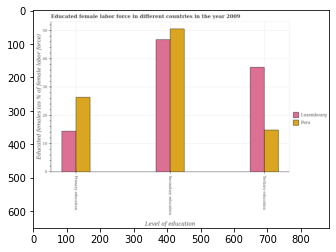

Number of QA =  28





,Level of education,Luxembourg,Peru
0,Tertiary education,37.529462,15.220745
1,Primary education,14.674828,26.666238
2,Secondary education,47.187181,51.125601


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in peru and that in luxembourg ?
PREDICTED =  11.991409852178151
EXPECTED =  12.000000000000009




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in luxembourg and the percentage of female labor force who received tertiary education in peru?
PREDICTED =  -27.21215530701825
EXPECTED =  -0.4000005722046005




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary educ

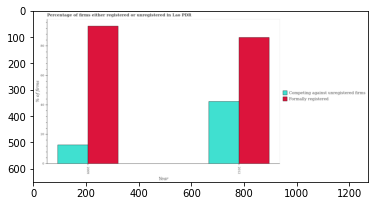

Number of QA =  24





,Year,Formally registered,Competing against unregistered firms
0,2009,93.522535,13.011415
1,2012,85.715121,42.334634


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of registered firms in 2009 and that in 2012 ?
PREDICTED =  7.807413802566714
EXPECTED =  -29.499999999999996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of formally registered firms in 2009 and the percentage of registered firms in 2012?
PREDICTED =  7.807413802566714
EXPECTED =  7.700000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of registered firms and percentage of formally registered firms ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_wit

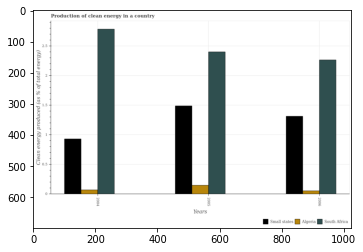

Number of QA =  29





,Years,Algeria,Small states,South Africa
0,2004,0.078338,0.940642,2.805946
1,2006,0.063003,1.321069,2.278064
2,2005,0.155840,NaN,2.405612


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in algeria in 2004 and that in 2006 ?
PREDICTED =  0.015335462848123663
EXPECTED =  0.015596116743731597




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in south africa in 2005 and the percentage of clean energy produced in algeria in 2006?
PREDICTED =  0.1275481965635632
EXPECTED =  2.3448075756896904




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.



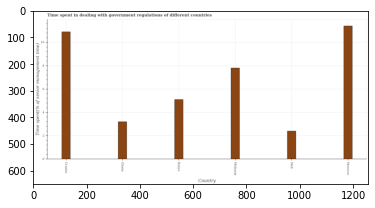

Number of QA =  22





,Country,Time spent(% of senior management time)
0,Ghana,3.199640
1,Kenya,5.072767
2,Croatia,10.833934
3,Malaysia,7.789091
4,Morocco,11.319169
5,NaN,2.397407


> what is the title of the graph ?
PREDICTED =  Time spent in dealing with government regulations of different count
EXPECTED =  Time spent in dealing with government regulations of different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Time spent(% of senior management time)
EXPECTED =  Time spent(% of senior management time)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time spent in dealing with government regulations in croatia and mali ?
PREDICTED =  -0.48523443173752945
EXPECTED =  8.5




				 2 / 4 = 0.5


> what is the median time spent in dealing with government regulations ?
PREDICTED =  None
EXPECTED =  6.449999999999999




				 2 / 6 = 0.3333


is_built_with_cuda: True
is_

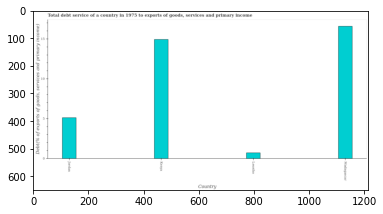

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Jordan,5.113957
1,Kenya,15.050139
2,Lesotho,0.772109
3,Madagascar,16.663431


> what is the title of the graph ?
PREDICTED =  (otal debt service of a country in 1975 to exports of goods, services and primary |
EXPECTED =  Total debt service of a country in 1975 to exports of goods, services and primary income




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in jordan and kenya ?
PREDICTED =  -9.936181940357395
EXPECTED =  -9.816




				 3 / 4 = 0.75


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  10.028123309283215




				 3 / 6 = 0.5


is_built_with_cuda: True


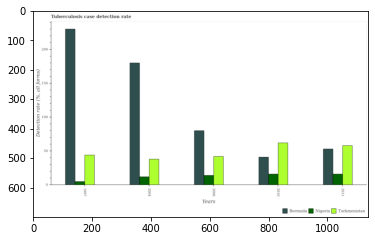

Number of QA =  29





,Years,Bermuda,Turkmenistan,Nigeria
0,2004,180.970353,38.745569,12.509193
1,2006,80.500906,42.386515,14.698653
2,2010,41.924687,62.553923,16.709729
3,1997,231.331488,44.627888,5.508370
4,2011,53.476036,58.767176,16.698187


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis case detection rate in in nigeria in 2006 and that in 2011 ?
PREDICTED =  -1.9995338737068433
EXPECTED =  -2.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis case detection rate in in nigeria in 1997 and the tuberculosis case detection rate in in bermuda in 2006?
PREDICTED =  -9.190283173878939
EXPECTED =  -75.1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the tuberculosis case detection rate in in bermuda and tuberculosis case detection rate in in nigeria ?
PREDICTED =  226.33148773324015
E

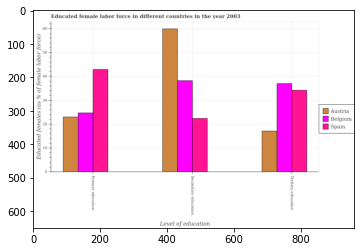

Number of QA =  28





,Level of education,Spain,Belgium,Austria
0,Primary education,43.105733,24.942664,23.284418
1,Secondary education,22.601064,38.426953,60.172277
2,Tertiary education,34.671814,37.286290,17.379153


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in belgium and that in austria ?
PREDICTED =  1.6582459556924007
EXPECTED =  1.7000007629394993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in austria and the percentage of female labor force who received tertiary education in spain?
PREDICTED =  25.50046319831781
EXPECTED =  25.700000762939396




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary educatio

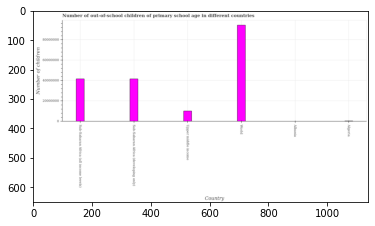

Number of QA =  22





,Country,Number of children
0,World,9.502203e+07
1,NaN,NaN
2,NaN,NaN
3,Upper middle income,1.077087e+07
4,Sub-Saharan Africa (all income levels),4.231062e+07
5,Sub-Saharan Africa (developing only),4.222931e+07


> what is the title of the graph ?
PREDICTED =  Number of out-of-school children of primary school age in different countries
EXPECTED =  Number of out-of-school children of primary school age in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of children
EXPECTED =  Number of children




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school children in sub-saharan africa (developing only) and world ?
PREDICTED =  0.0
EXPECTED =  -52736104.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of out-of-school children ?
PREDICTED = 

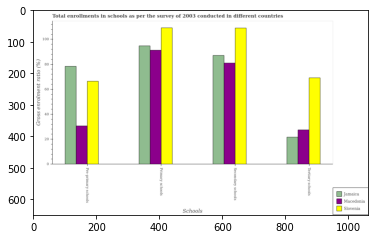

Number of QA =  29





,Schools,Slovenia,Jamaica,Macedonia
0,Tertiary schools,68.591173,21.810084,27.668821
1,Primary schools,109.313595,94.421539,91.672605
2,Pre-primary schools,66.618206,78.132913,31.357566
3,Secondary schools,108.528855,86.685921,80.708689


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

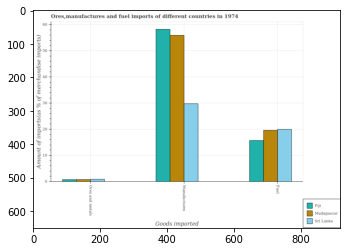

Number of QA =  28





,Goods imported,Madagascar,Fiji,Sri Lanka
0,Manufactures,55.985443,58.464218,30.023390
1,Ores and metals,0.914815,0.902076,1.020550
2,Fuel,19.794852,15.758114,20.026172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in sri lanka and that in madagascar ?
PREDICTED =  0.23131998807609122
EXPECTED =  0.3660609331394973




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of ores and metals imports in sri lanka and the percentage of manufactures imports in fiji?
PREDICTED =  0.0
EXPECTED =  -57.32955949489879




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports and percentage of ores and metals imports in sri lanka ?
PREDICTED =  14.737563709578176
EXPECTED =  19.060736507253278




				 0 / 3 = 

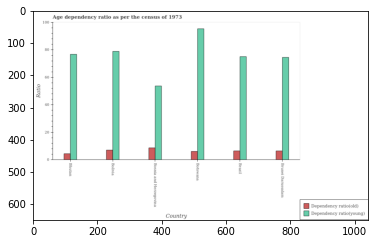

Number of QA =  28





,Country,Dependency ratio(young),Dependency ratio(old)
0,Brazil,75.829163,6.806651
1,Bolivia,79.524261,7.368977
2,Bhutan,77.637999,4.806814
3,Brunei Darussalam,74.974630,6.805452
4,Botswana,96.275704,6.391414
5,Bosnia and Herzegovina,54.315337,9.077463


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in botswana ?
PREDICTED =  16.045950604699033
EXPECTED =  95.40806924619991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum age dependency ratio(young) ?
PREDICTED =  16.045950604699033
EXPECTED =  95.40806924619991




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum age dependency ratio(old) ?
PREDICTED =  0.8011357444143861
EXPECTED =  4.34207367792286




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4

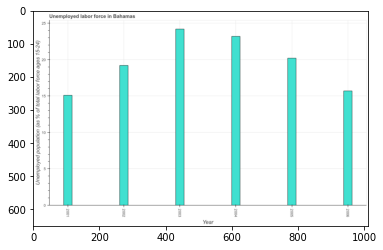

Number of QA =  23





,Year,Unemployed population (as % of total labor force ages 15-24)
0,2005,20.236336
1,2006,15.797129
2,2004,23.309551
3,2003,24.375737
4,2002,19.254966
5,2001,15.117921


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in Bahamas
EXPECTED =  Unemployed labor force in Bahamas




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed population (as % of total labor force ages 15-24)
EXPECTED =  Unemployed population (as % of total labor force ages 15-24)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed youth population in 2003 and 2006 ?
PREDICTED =  8.578608087772622
EXPECTED =  8.5




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed youth population ?
PREDICTED =  2003.5
EXPECTED =  19.7000007629395

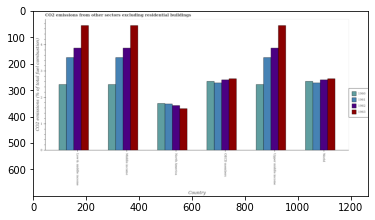

Number of QA =  30





,Country,1963,1962,1961,1960
0,Low & middle income,4.758223,3.890887,3.549773,2.505587
1,Upper middie income,4.743883,3.912605,3.554445,2.511326
2,World,2.740449,2.696537,2.565049,2.639162
3,North America,1.594856,1.718431,1.778822,1.809534
4,Middle income,4.742117,3.908596,3.536342,2.517035
5,OECD members,2.742802,2.699270,2.573035,2.645717


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in oecd members and that in upper middle income ?
PREDICTED =  -3.9126054573183104
EXPECTED =  -1.20472642738173




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in low & middle income and the total co2 emitted in 1962 in north america?
PREDICTED =  1.7709508950627428
EXPECTED =  1.8192796404450102




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted of/in 1961 and total co2 emitted of/in 1963 in world?
PREDICTED =  14.817018192347234
EXPECTED =  -0.1579154091542101




	

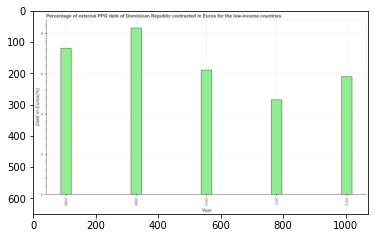

Number of QA =  23





,Year,Debt in Euros(%)
0,2008,7.230294
1,2012,5.859148
2,2009,8.246423
3,2010,6.169745
4,2011,4.727875


> what is the title of the graph ?
PREDICTED =  Percentage of external PPG debt of Dominican Republic contracted in Euros for the low-income countries
EXPECTED =  Percentage of external PPG debt of Dominican Republic contracted in Euros for the low-income countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt in Euros(%)
EXPECTED =  Debt in Euros(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the currency composition of ppg debt in 2010 and 2012 ?
PREDICTED =  0.3105972555264591
EXPECTED =  0.328




				 3 / 4 = 0.75


> what is the median currency composition of ppg debt ?
PREDICTED =  None
EXPECTED =  6.1828




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or

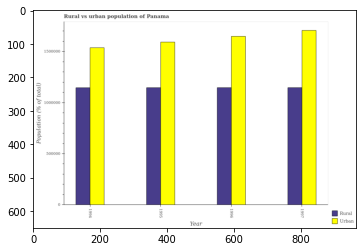

Number of QA =  28





,Year,Urban,Rural
0,1994,1.536591e+06,1.147905e+06
1,1996,1.654456e+06,1.150384e+06
2,1997,1.703451e+06,1.147561e+06
3,1995,1.593838e+06,1.144536e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population density in 1994 and that in 1995 ?
PREDICTED =  3369.3526798412204
EXPECTED =  -657




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density in 1996 and the rural population density in 1994?
PREDICTED =  117865.60917644901
EXPECTED =  111119




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the urban population density and rural population density ?
PREDICTED =  48995.30277910642
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

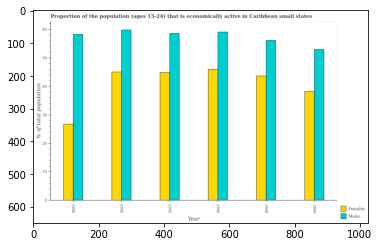

Number of QA =  28





,Year,Males,Females
0,1998,56.448632,43.887283
1,1980,58.328892,27.047924
2,1995,58.956632,45.191264
3,1996,59.617173,46.274169
4,1999,53.033057,38.550782
5,1990,60.135526,45.335907


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in 1990 and that in 1998 ?
PREDICTED =  3.68689339145768
EXPECTED =  3.6681471402212082




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in 1980 and the percentage of economically active female population in 1999?
PREDICTED =  5.295835279983976
EXPECTED =  5.327301491472994




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the percentage of economically active male population and percentage of economically active female popul

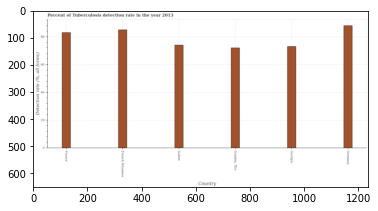

Number of QA =  22





,Country,"Detection rate (%, all forms)"
0,France,83.528584
1,Gabon,74.508745
2,French Polynesia,85.331343
3,"Gambia, The",72.455737
4,Germany,88.260203
5,Georgia,73.414335


> what is the title of the graph ?
PREDICTED =  Percent of Tuberculosis detection rate in the year 2013
EXPECTED =  Percent of Tuberculosis detection rate in the year 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Detection rate (%, all forms)
EXPECTED =  Detection rate (%, all forms)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the detection rate of tuberculosis in france and germany ?
PREDICTED =  -4.731619287169636
EXPECTED =  -5.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median detection rate of tuberculosis ?
PREDICTED =  79.01866452808741
EXPECTED =  78.5




				 4

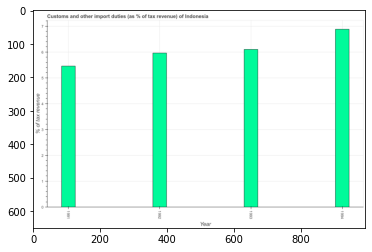

Number of QA =  23





,Year,% of tax revenue
0,1994,6.976926
1,1992,6.007238
2,1991,5.518364
3,1993,6.175861


> what is the title of the graph ?
PREDICTED =  Customs and other import duties (as % of tax revenue) of Indonesia
EXPECTED =  Customs and other import duties (as % of tax revenue) of Indonesia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of tax revenue
EXPECTED =  % of tax revenue




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the median customs and other import duties ?
PREDICTED =  None
EXPECTED =  6.030023594244799




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the customs and other import duties in 1991 to that in 1993 ?
PREDICTED =  0.893537651624747
EXPECTED =  0.894




	

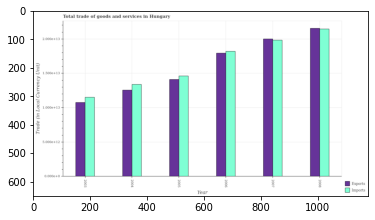

Number of QA =  28





,Year,Imports,Exports
0,2008,2.158374,2.171235
1,2005,1.470777,1.423819
2,2003,1.162952,1.089833
3,2004,1.348053,1.265075
4,2007,1.996467,2.020943
5,2006,1.836971,1.813022


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 2003 and that in 2006 ?
PREDICTED =  1.0814015857816506
EXPECTED =  -7178780000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services in 2003 and the export of goods and services in 2007?
PREDICTED =  0.1619065582807684
EXPECTED =  -8318342000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the imports of goods and services and export of goods and services ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fal

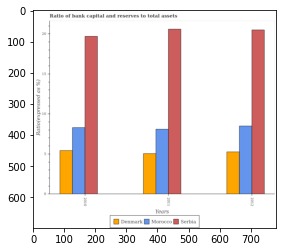

Number of QA =  29





,Years,Morocco,Serbia,Denmark
0,2012,8.558678,20.591638,5.283388
1,2010,8.297177,19.616075,5.520953
2,2011,8.156942,20.550315,5.111977


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of bank capital and reserves to total assets in serbia in 2012 ?
PREDICTED =  0.14569020661868967
EXPECTED =  20.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum ratio of bank capital and reserves to total assets in morocco ?
PREDICTED =  1.0
EXPECTED =  8.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum ratio of bank capital and reserves to total assets in morocco ?
PREDICTED =  0.9997513674788663
EXPECTED =  8.1




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished aft

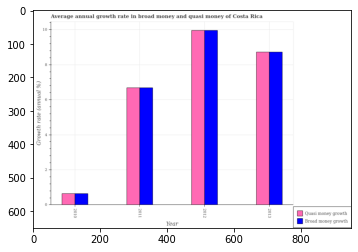

Number of QA =  28





,Year,Broad money growth,Quasi money growth
0,2010,0.667720,0.665285
1,2013,8.711081,8.668734
2,2012,9.924185,9.919947
3,2011,6.681828,6.674128


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in quasi money in 2010 and that in 2011 ?
PREDICTED =  -6.008842929529947
EXPECTED =  -6.042094405205098




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in quasi money in 2012 and the annual growth rate in broad money in 2011?
PREDICTED =  3.2458190217309015
EXPECTED =  3.274684021634231




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the annual growth rate in broad money and annual growth rate in quasi money ?
PREDICTED =  7.924184854746155
EXPECTED =  0.0




				 2 / 3 = 0.6667




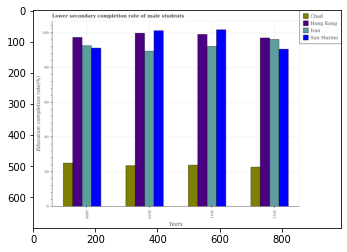

Number of QA =  30





,Years,San Marino,Chad,Iran,Hong Kong
0,2009,91.818686,25.407899,93.403803,98.161258
1,2010,102.437921,23.989763,89.867708,101.198880
2,2012,91.364385,22.749527,97.197660,98.186896
3,2011,102.972819,24.091849,93.138772,100.017958


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of male students in san marino in 2010 and that in 2011 ?
PREDICTED =  -0.5348980459260559
EXPECTED =  -0.5451965332029971




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of male students in chad in 2011 and the lower secondary completion rate of male students in san marino in 2009?
PREDICTED =  -1.3160499312131613
EXPECTED =  -67.38264846801749




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the lower secondary completion rate of male students in hong kong 

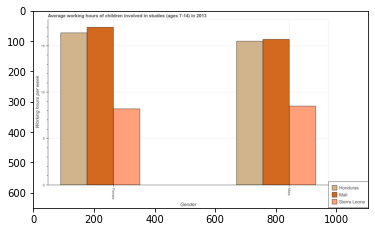

Number of QA =  23





,Gender,Mali,Sierra Leone,Honduras
0,Male,15.785832,8.608860,15.566211
1,Female,17.093382,8.260563,16.504697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of male children in sierra leone and that in honduras ?
PREDICTED =  -6.957351294374439
EXPECTED =  -7.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of female children in honduras and the average working hour of male children in mali?
PREDICTED =  0.06509008557387119
EXPECTED =  0.6999999999999993




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of female children and average working hour of male children in sierra leone ?
PREDICTED =  8.658670492893574
EXPECTED =  -0.3

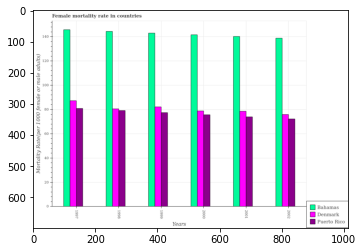

Number of QA =  29





,Years,Puerto Rico,Bahamas,Denmark
0,2002,72.803759,139.208141,76.101621
1,1998,79.875347,145.551307,80.854459
2,1999,78.041719,145.372821,82.715846
3,2000,75.966916,144.400775,79.171828
4,2001,74.425343,140.831173,78.902346
5,1997,81.774003,146.008297,88.123860


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in puerto rico in 1999 and that in 2000 ?
PREDICTED =  2.074803365273695
EXPECTED =  1.7349999999999994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in denmark in 1998 and the female mortality rate in bahamas in 1997?
PREDICTED =  -7.269401605485328
EXPECTED =  -65.275




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the female mortality rate in denmark and female mortality rate in bahamas ?
PREDICTED =  -63.106519531198956
EXPECTED =  -62.999999999999986




				 1 / 3 = 0.3

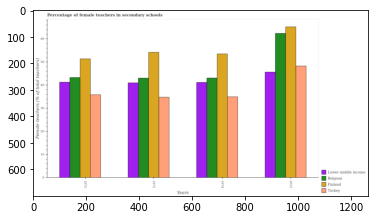

Number of QA =  30





,Years,Turkey,Belgium,Finland,Lower middle income
0,1972,36.144896,43.628063,51.475491,41.525984
1,1974,35.445003,43.422799,53.767157,41.449504
2,1973,34.973190,43.121247,54.570443,41.262101
3,2013,48.562491,62.806739,65.478900,46.030689


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in lower middle income in 1973 and that in 1974 ?
PREDICTED =  -0.1874034629088257
EXPECTED =  -0.1964187622071023




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in finland in 1972 and the percentage of female teachers in lower middle income in 2013?
PREDICTED =  5.444801633849536
EXPECTED =  5.719898641357403




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1974, what is the difference between the percentage of female teachers in finland and percentage of female teachers in lower middle income ?
P

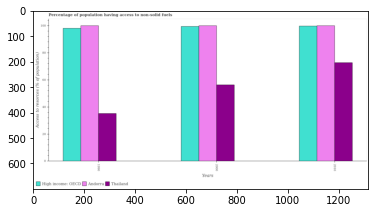

Number of QA =  29





,Years,Andorra,Thailand,High income: OECD
0,2010,100.088394,73.365750,100.789626
1,1990,101.126356,35.254660,98.191071
2,2000,100.277323,56.781841,99.457919


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to non-solid fuels in high income: oecd in 2000 and that in 2010 ?
PREDICTED =  -1.33170707005236
EXPECTED =  -0.259891850535098




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to non-solid fuels in thailand in 2000 and the percentage of population having access to non-solid fuels in high income: oecd in 1990?
PREDICTED =  -41.40923014664262
EXPECTED =  -41.766751094632795




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of popula

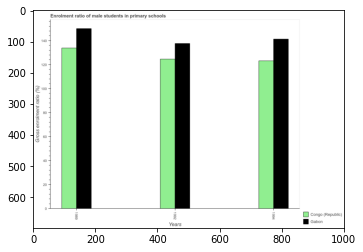

Number of QA =  28





,Years,Congo (Republic),Gabon
0,1994,123.362473,141.242298
1,1989,134.305248,150.728083
2,1992,124.582767,138.216559


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of male students in primary schools in congo (republic) in 1992 ?
PREDICTED =  41.527588897205895
EXPECTED =  124.61436




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of male students in primary schools in gabon ?
PREDICTED =  50.242694468831566
EXPECTED =  150.04321




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of male students in primary schools in congo (republic) ?
PREDICTED =  664.6666666666666
EXPECTED =  123.195




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

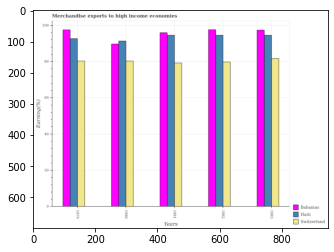

Number of QA =  29





,Years,Switzerland,Bahamas,Haiti
0,1982,80.369038,98.436292,95.646767
1,1980,81.294635,90.215757,92.206968
2,1983,82.639461,98.782709,95.081178
3,1979,81.093519,99.031509,93.737473
4,1981,80.331672,96.856894,94.602509


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in switzerland in 1981 and that in 1983 ?
PREDICTED =  -2.307789014590128
EXPECTED =  -2.4742397696279994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in bahamas in 1981 and the percentage of amount earned from merchandise exports in haiti in 1983?
PREDICTED =  1.7757156847874995
EXPECTED =  1.3801173968154075




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the percentage of amount earned from merchandise exports 

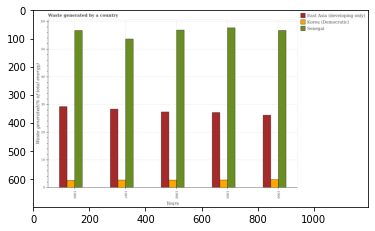

Number of QA =  29





,Years,Senegal,Korea (Democratic),East Asia (developing only)
0,1988,56.650392,2.859046,27.324043
1,1989,57.848167,2.898172,27.001774
2,1986,56.778040,2.768352,29.147867
3,1990,56.894266,3.075824,26.187002
4,1987,53.566334,2.873124,28.401659


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in korea (democratic) in 1987 and that in 1990 ?
PREDICTED =  -0.20270023277775762
EXPECTED =  -0.16079462495000119




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in korea (democratic) in 1988 and the total waste generated in senegal in 1989?
PREDICTED =  -0.0391254860359842
EXPECTED =  -55.00958522699654




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the total waste generated in senegal and total waste generated in east asia (developing only) ?
PREDICTED =  276.737200099363


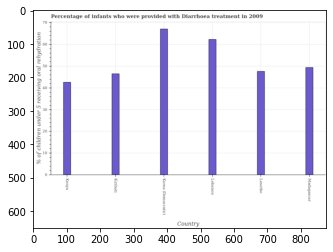

Number of QA =  22





,Country,% of children under 5 receiving oral rehydration
0,Korea (Democratic),67.245524
1,Lesotho,47.513703
2,Lebanon,62.151919
3,Kenya,42.792829
4,Madagascar,49.075145
5,Kiribati,46.461239


> what is the title of the graph ?
PREDICTED =  Percentage of infants who were provided with Diarrhoea treatment in 2009
EXPECTED =  Percentage of infants who were provided with Diarrhoea treatment in 2009




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of children under 5 receiving oral rehydration
EXPECTED =  % of children under 5 receiving oral rehydration




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with treatment diarrhoea in lebanon and lesotho ?
PREDICTED =  14.638215385137954
EXPECTED =  14.7




				 4 / 4 = 1.0


> what is the median percentage of children who were provided with treatment diarrhoea ?
PREDICTED =  None
EXPECTED =  48.5




				 4 / 6

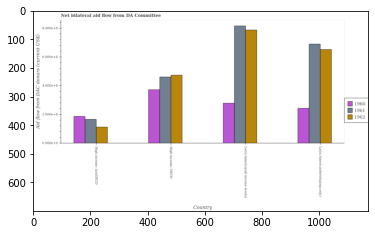

Number of QA =  29





,Country,1962,1961,1960
0,High income: nonOECD,1.159354,1.700132,1.885553
1,Latin America(al!l ncome levels),7.941058,8.233602,2.836653
2,High income: OECD,4.774580,4.636628,3.750303
3,Latin America(developing only),6.562839,6.936553,2.473235


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in in 1960 in high income: nonoecd and that in latin america(developing only) ?
PREDICTED =  -0.5876815794037042
EXPECTED =  -56390000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in in 1961 in high income: oecd and the aid flow in in 1960 in high income: nonoecd?
PREDICTED =  2.9364960630792294
EXPECTED =  274150000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in of/in 1960 and aid flow in of/in 1961 in high income: oecd?
PREDICTED =  -1.799975022568567
EXPECTED =  -88820000.0




				 0 / 3 = 0.0

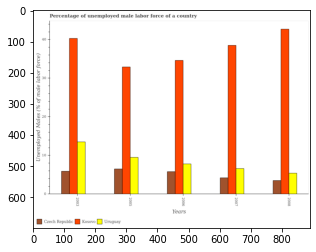

Number of QA =  29





,Years,Uruguay,Czech Republic,Kosovo
0,2003,13.637518,6.031129,40.508085
1,2008,5.507182,3.587638,42.734606
2,2006,7.883017,5.886361,34.676995
3,2007,6.657619,4.352655,38.603452
4,2005,9.638395,6.614992,32.821520


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in czech republic in 2003 and that in 2008 ?
PREDICTED =  2.4434908203478387
EXPECTED =  2.400000095367429




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in czech republic in 2008 and the percentage of unemployed male labor force in uruguay in 2006?
PREDICTED =  -2.2987233737301893
EXPECTED =  -4.300000190734861




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of unemployed male labor force in uruguay and percentage of unem

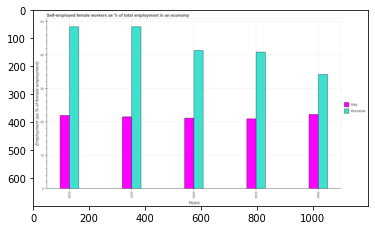

Number of QA =  28





,Years,Romania,Italy
0,2000,48.957476,22.078625
1,2002,41.640111,21.303368
2,2001,49.050229,21.748579
3,2004,34.404021,22.522690
4,2003,41.207016,21.174456


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in italy in 2002 and that in 2004 ?
PREDICTED =  -1.2193221361787145
EXPECTED =  -1.1000003814697976




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in italy in 2000 and the percentage of self-employed female workers in romania in 2002?
PREDICTED =  0.7752570926285536
EXPECTED =  -19.50000190734859




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of self-employed female workers in italy and percentage of self-employed fema

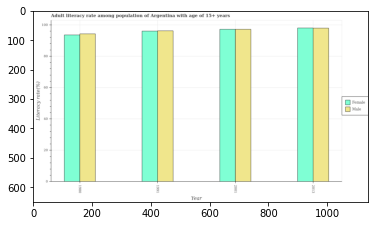

Number of QA =  28





,Year,Female,Male
0,1980,93.970933,94.896754
1,2001,98.740100,97.772553
2,2013,98.330860,98.947578
3,1991,96.390867,96.276271


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate in 2001 and that in 2013 ?
PREDICTED =  0.40924045269454723
EXPECTED =  -0.8184509277342897




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male adult literacy rate in 1980 and the female adult literacy rate in 2013?
PREDICTED =  -4.050824412025548
EXPECTED =  -3.669593398437499




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the male adult literacy rate and female adult literacy rate ?
PREDICTED =  0.5875124236935534
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availa

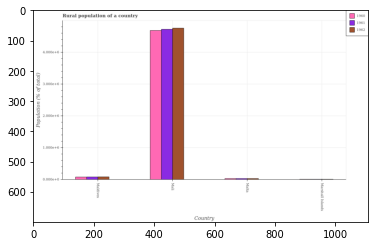

Number of QA =  29





,Country,1962,1961,1960
0,Mali,4.788392,4.743024,4.691833
1,Malta,NaN,NaN,0.047536
2,Marshall Islands,NaN,NaN,NaN
3,Makdives,0.102078,0.097671,0.096563


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 1960 in maldives and that in malta ?
PREDICTED =  1.564441209390399
EXPECTED =  47599.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 1962 in marshall islands and the rural population in 1960 in mali?
PREDICTED =  -4.788392290668737
EXPECTED =  -4671664.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rural population in 1961 in maldives to that in ma

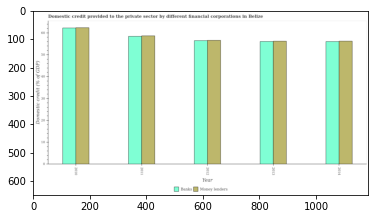

Number of QA =  28





,Year,Banks,Money lenders
0,2011,58.858444,58.912987
1,2014,56.294466,56.732316
2,2013,56.355911,56.543106
3,2010,62.259241,62.874517
4,2012,56.735286,56.869054


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by banks in 2012 and that in 2014 ?
PREDICTED =  0.4408202701747044
EXPECTED =  0.417379154350499




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by banks in 2012 and the domestic credit provided by money lenders in 2010?
PREDICTED =  -5.523954965042812
EXPECTED =  -5.786931218251709




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the domestic credit provided by money lenders and domestic credit provided by banks ?
PREDICTED =  -1955.4568937416054
EXPECTED =  0.0




				

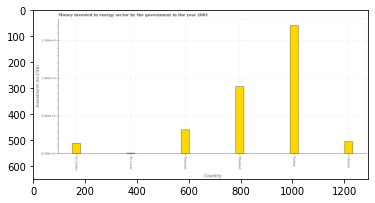

Number of QA =  22





,Country,Investment (in US$)
0,St. Lucia,0.014160
1,Ukraine,0.167404
2,Turkey,1.702483
3,Thailand,0.896285
4,Tanzania,0.323320
5,Sri Lanka,0.144339


> what is the title of the graph ?
PREDICTED =  Money invested in energy sector by the government in the year 2001
EXPECTED =  Money invested in energy sector by the government in the year 2001




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Investment (in US$)
EXPECTED =  Investment (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in energy in sri lanka and turkey ?
PREDICTED =  -1.5581445974592147
EXPECTED =  -1563500000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median investment in energy ?
PREDICTED =  0.24536214973115844
EXPECTED =  238000000.0




			

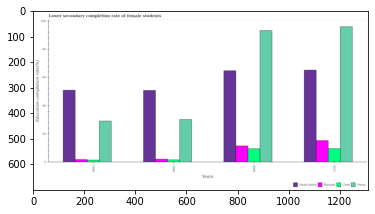

Number of QA =  30





,Years,Oman,Small states,Chad,Burundi
0,1990,30.647702,50.921332,1.992223,2.360490
1,1989,29.477929,51.169505,1.808800,2.150950
2,2011,96.755870,65.977019,9.920359,15.617794
3,2009,94.070834,65.436240,9.867347,11.785702


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in oman in 1989 and that in 1990 ?
PREDICTED =  -1.1697725250476019
EXPECTED =  -1.0903600000000004




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in oman in 1989 and the lower secondary completion rate of female students in small states in 1990?
PREDICTED =  -1.1697725250476019
EXPECTED =  -21.6742678881836




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the lower secondary completion rate of female students in oman an

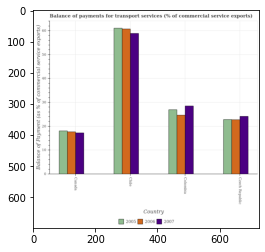

Number of QA =  29





,Country,2007,2005,2006
0,Czech Republic,24.191962,22.910060,22.755761
1,Canada,17.347459,18.360676,17.762915
2,Chile,58.848842,61.215815,60.792465
3,Colombia,28.493058,26.932320,24.714588


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2006 in canada and that in czech republic ?
PREDICTED =  -4.9928457102929436
EXPECTED =  -5.0732927493201




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2007 in canada and the balance of payments for transport services in 2005 in czech republic?
PREDICTED =  -6.844503744788472
EXPECTED =  -5.5899880223221




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services of/in 2006 and balance of payments for transport 

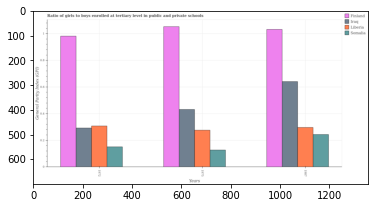

Number of QA =  30





,Years,Liberia,Somalia,Finland,Iraq
0,1975,0.278721,0.129682,1.059079,0.432427
1,1972,0.307371,0.153954,0.985709,0.292776
2,1987,0.299746,0.246224,1.038074,0.645357


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in iraq in 1972 and that in 1975 ?
PREDICTED =  -0.13965089928605856
EXPECTED =  -0.13924999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in finland in 1987 and the general parity index in liberia in 1972?
PREDICTED =  0.05236543171263497
EXPECTED =  0.7247000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the general parity index in iraq and general parity index in somalia ?
PREDICTED =  0.4687368857644937
EXPECTED =  0.3973299999999999




				 1 / 3 = 0.3

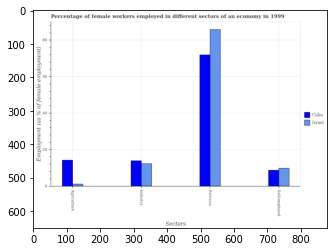

Number of QA =  29





,Sectors,Israel,Cuba
0,Industry,12.594740,14.214434
1,Services,86.254599,72.308497
2,Agriculture,NaN,14.612745
3,Self-em ployed,10.144240,9.141090


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in agriculture in cuba and that in israel ?
PREDICTED =  14.612745152453222
EXPECTED =  13.09999978542324




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in industry and percentage of female workers in services in israel ?
PREDICTED =  -73.65985951864005
EXPECTED =  -73.50000286102289




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the p

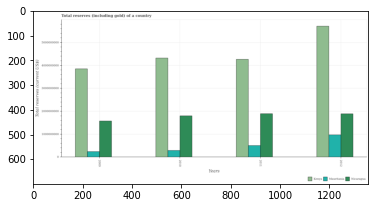

Number of QA =  29





,Years,Mauritania,Kenya,Nicaragua
0,2010,3.039753e+08,4.347118e+09,1.812597e+09
1,2009,2.544448e+08,3.864763e+09,1.587602e+09
2,2011,5.176024e+08,4.260890e+09,1.908105e+09
3,2012,9.809187e+08,5.711648e+09,1.884820e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in mauritania in 2011 and that in 2012 ?
PREDICTED =  -463316222.13889307
EXPECTED =  -466310996.3579761




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in mauritania in 2011 and the total reserves (including gold) in kenya in 2012?
PREDICTED =  -463316222.13889307
EXPECTED =  -5209506612.362659




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the total reserves (including gold) in kenya and total reserves (including gold) in nicaragua ?
PREDICTED =  0.0
EXPE

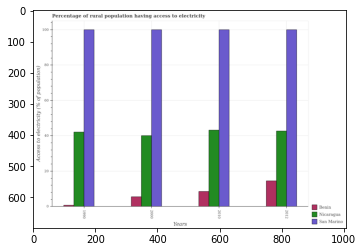

Number of QA =  29





,Years,San Marino,Nicaragua,Benin
0,2000,101.223191,40.397576,5.816707
1,2012,100.725780,43.526980,14.728999
2,2010,101.327152,43.895459,8.770367
3,1990,100.928733,42.675903,1.028944


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in san marino in 2010 and that in 2012 ?
PREDICTED =  0.6013722758807916
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in nicaragua in 2000 and the percentage of rural population having access to electricity in san marino in 1990?
PREDICTED =  -2.278327100448017
EXPECTED =  -59.9




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the percentage of rural population having access to electrici

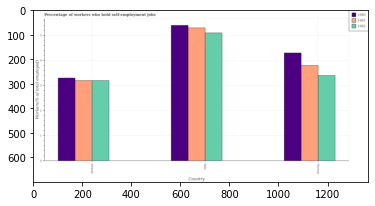

Number of QA =  29





,Country,1982,1980,1981
0,Ireland,3.247165,3.349637,3.244875
1,Norway,3.445617,4.334446,3.831896
2,Italy,5.136187,5.459741,5.334353


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1981 in ireland and that in norway ?
PREDICTED =  -0.587021100857553
EXPECTED =  -0.5999999046325604




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1981 in italy and the percentage of self-employed workers in 1980 in ireland?
PREDICTED =  2.089478678958932
EXPECTED =  2.000000238418582




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers of/in 1981 and percentage of self-employed workers of/in 1982 in ireland?
PREDICTED =  -0.

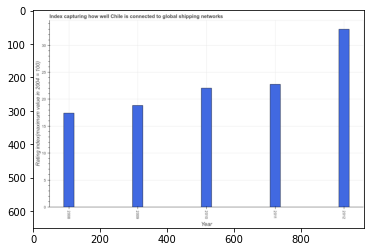

Number of QA =  23





,Year,Rating index(maximum value in 2004 = 100)
0,2009,19.116139
1,2008,17.713923
2,2012,33.435878
3,2010,22.326113
4,2011,23.049780


> what is the title of the graph ?
PREDICTED =  Index capturing how well Chile is connected to global shipping networks
EXPECTED =  Index capturing how well Chile is connected to global shipping networks




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Rating index(maximum value in 2004 = 100)
EXPECTED =  Rating index(maximum value in 2004 = 100)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the liner shipping connectivity index in 2011 and 2012 ?
PREDICTED =  -10.386097805099293
EXPECTED =  -10.22




				 4 / 4 = 1.0


> what is the median liner shipping connectivity index ?
PREDICTED =  None
EXPECTED =  22.05




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

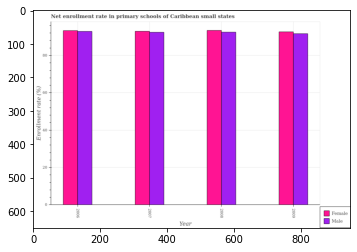

Number of QA =  28





,Year,Female,Male
0,2006,94.819491,93.250832
1,2009,93.155883,92.698459
2,2008,94.097823,92.465513
3,2007,93.394332,92.449336


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of female students in 2006 and that in 2009 ?
PREDICTED =  1.6636083046638532
EXPECTED =  0.6476440429686932




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in 2008 and the enrollment rate of female students in 2007?
PREDICTED =  0.01617689931356381
EXPECTED =  0.054351806640710265




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the enrollment rate of female students and enrollment rate of male students ?
PREDICTED =  -282.3116455192277
EXPECTED =  0.0




				 0 / 3 = 0.0

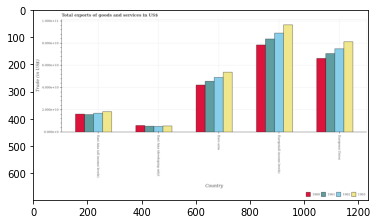

Number of QA =  30





,Country,1963,1962,1961,1960
0,European Union,28.424493,26.232104,24.671120,23.220729
1,Europe(all income levels),33.678948,31.190515,29.453124,27.505061
2,East Asia (all income levels),6.514196,6.030795,5.565955,5.738084
3,East Asia (developing only),2.000283,1.858260,1.921172,2.155488
4,Euro area,18.952680,17.335674,16.006933,14.921063


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in 1962 in east asia (all income levels) and that in european union ?
PREDICTED =  -58.45341411960325
EXPECTED =  -58014242781.75751




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in 1963 in east asia (all income levels) and the total exports of goods and services in 1962 in euro area?
PREDICTED =  -20.46687627209303
EXPECTED =  -30805063998.5875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services of/in 1961 and total exports of go

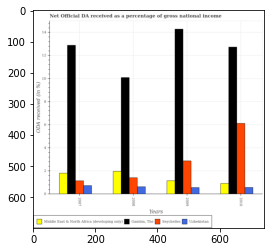

Number of QA =  30





,Years,Uzbekistan,"Gambia, The",Seychelles,Middle East & North Africa (developing only
0,2008,0.684538,10.142812,1.461201,1.988023
1,2007,0.775455,12.934436,1.181802,1.847047
2,2010,0.617388,12.815908,6.144210,0.957877
3,2009,0.589282,14.370433,2.896151,1.206952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official da received in middle east & north africa (developing only) in 2007 and that in 2009 ?
PREDICTED =  0.6400949612162561
EXPECTED =  0.6542699958423002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official da received in uzbekistan in 2008 and the net official da received in gambia, the in 2007?
PREDICTED =  -0.09091687705611573
EXPECTED =  -12.253863754970101




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

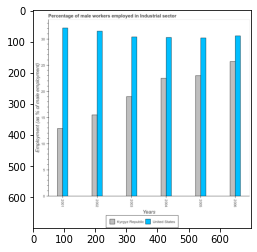

Number of QA =  28





,Years,Kyrgyz Republic,United States
0,2004,22.725084,30.562622
1,2001,13.058417,32.253538
2,2003,19.163976,30.685668
3,2006,25.932778,31.017691
4,2002,15.550174,31.725867
5,2005,23.199429,30.532658


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in kyrgyz republic in 2003 and that in 2004 ?
PREDICTED =  -3.5611081746405375
EXPECTED =  -3.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in kyrgyz republic in 2005 and the percentage of male workers employed in industrial sector in united states in 2004?
PREDICTED =  0.4743448100332692
EXPECTED =  -7.299999237060501




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of male workers employed

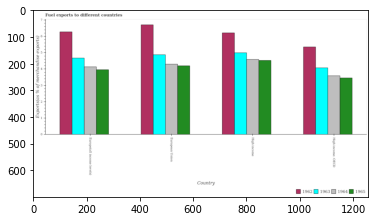

Number of QA =  30





,Country,1965,1964,1962,1963
0,Europe(all income levels),4.016152,4.151941,6.312568,4.693105
1,High income,4.564928,4.631742,6.240994,5.036638
2,European Union,4.243433,4.348819,6.780215,4.902909
3,High income: OECD,3.500693,3.632733,5.391696,4.099363


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1965 in high income and that in high income: oecd ?
PREDICTED =  -2.5649277935959685
EXPECTED =  1.0699841434133703




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is

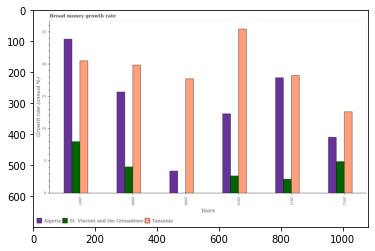

Number of QA =  26





,Years,Algeria,Tanzania,St. Vincent and the Grenadines
0,2012,8.714814,12.725129,4.957606
1,2010,12.477790,25.549895,2.731012
2,2008,15.771369,19.908738,4.155215
3,2011,17.989030,18.315971,2.273399
4,2009,3.483857,17.845744,NaN
5,2007,23.957324,20.590493,8.107163


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the growth rate in tanzania in 2010 and that in 2011 ?
PREDICTED =  7.23392309057504
EXPECTED =  7.1873916272739




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the growth rate in tanzania in 2008 and the growth rate in algeria in 2010?
PREDICTED =  -5.641157024478353
EXPECTED =  7.5466344101493




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the growth rate in tanzania and growth rate in algeria ?
PREDICTED =  108.93597008471102
EXPECTED =  -3.348708515023908




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: 

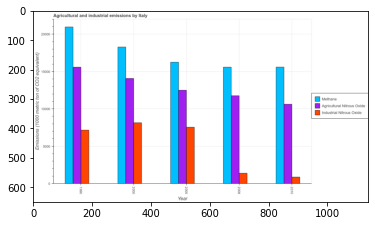

Number of QA =  29





,Year,Methane,Agricultural Nitrous Oxide,industrial Nitrous Oxide
0,2000,18303.899948,14003.309592,8215.956027
1,2005,16326.508308,12521.097877,7604.650752
2,1990,21120.914103,15580.560736,7200.245674
3,2008,15628.600741,11776.463363,1461.015721
4,2010,15587.102569,10637.462681,937.772561


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of industrial nitrous oxide emissions in 2005 and that in 2008 ?
PREDICTED =  6143.635031658506
EXPECTED =  6159.7




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of industrial nitrous oxide emissions in 2000 and the amount of agricultural nitrous oxide emissions in 2008?
PREDICTED =  6754.940306227664
EXPECTED =  6755.2




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of agricultural nitrous oxide emissions and amount of methane emissions ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0




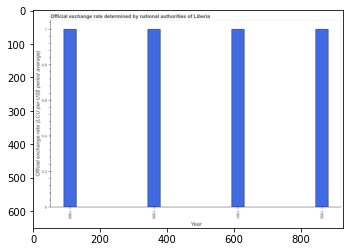

Number of QA =  23





,Year,Official exchange rate (LCU per US$ period average)
0,1992,1.003644
1,1990,1.010870
2,1989,1.004716
3,1991,1.008241


> what is the title of the graph ?
PREDICTED =  Official exchange rate determined by national authorities of Liberia
EXPECTED =  Official exchange rate determined by national authorities of Liberia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Official exchange rate (LCU per US$ period average)
EXPECTED =  Official exchange rate (LCU per US$ period average)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official exchange rate in 1989 and 1990 ?
PREDICTED =  -0.006154125412773048
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median official exchange rate ?
PREDICTED =  

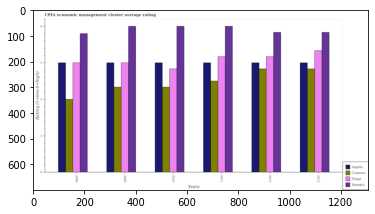

Number of QA =  30





,Years,Angola,Comoros,Vanuatu,Tonga
0,2008,3.014049,2.001762,3.802035,3.009614
1,2010,2.998181,2.325226,3.975457,2.838578
2,2012,3.004285,2.851747,3.850608,3.184590
3,2013,3.008033,2.835348,3.839161,3.324379
4,2009,3.021400,2.359072,3.979749,2.998550
5,2011,2.999449,2.511047,4.026970,3.172928


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in vanuatu in 2008 and that in 2013 ?
PREDICTED =  -0.037125696208392345
EXPECTED =  -0.03333333333332922




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in vanuatu in 2010 and the cpia rating in angola in 2012?
PREDICTED =  0.9711716471021732
EXPECTED =  1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating in tonga and cpia rating in comoros ?
PREDICTED =  -2.6756214853636577
EXPECTED =  1.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trainin

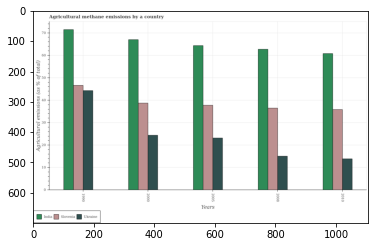

Number of QA =  29





,Years,Slovenia,India,Ukraine
0,2005,37.915427,64.726871,23.430854
1,2008,36.905902,62.801909,15.139303
2,1990,46.957057,72.144062,44.583228
3,2000,38.847395,67.195753,24.680940
4,2010,35.998614,60.947971,14.153860


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in slovenia in 1990 and that in 2008 ?
PREDICTED =  10.05115546984765
EXPECTED =  10.1335450751289




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in india in 2008 and the amount of agricultural methane emitted in ukraine in 2000?
PREDICTED =  -4.39384456930614
EXPECTED =  38.30142999404409




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of agricultural methane emitted in slovenia and amount of agricultural methane emitted in ukraine

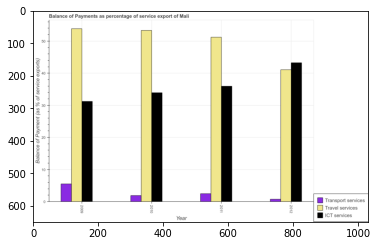

Number of QA =  29





,Year,ICT services,Travel services,Transport services
0,2010,34.530061,54.198140,2.123622
1,2009,31.653629,54.619379,5.766102
2,2012,43.731406,41.515863,0.976903
3,2011,36.412863,52.045437,2.679885


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of ict services in 2011 and that in 2012 ?
PREDICTED =  -7.318543172205892
EXPECTED =  -7.311996212016297




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of ict services in 2010 and the balance of payment of transport services in 2011?
PREDICTED =  -1.8828023821517164
EXPECTED =  -2.0269794624759




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the balance of payment of transport services and balance of payment of travel services ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6

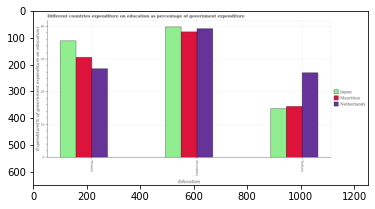

Number of QA =  28





,Education,Japan,Mauritius,Netherlands
0,NaN,35.904930,30.662137,27.426597
1,Tertiary,15.086392,15.797653,26.153335
2,secondary,40.080768,38.621517,39.573152


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on tertiary education in japan and that in mauritius ?
PREDICTED =  -0.711260938648536
EXPECTED =  -0.6668205261231002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on tertiary education in mauritius and the expenditure on secondary education in netherlands?
PREDICTED =  -10.355682239821308
EXPECTED =  -23.726189613342196




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on tertiary education and expenditure on secondary education in netherlands ?
PREDICTED =  -11.066943178469844
EXPECTED =  -13.444

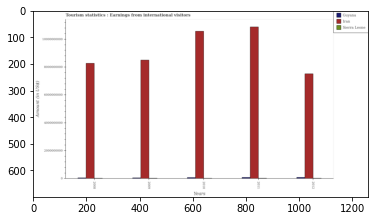

Number of QA =  29





,Years,Sierra Leone,Iran,Guyana
0,2012,NaN,7.591009e+09,1.172538e+08
1,2008,NaN,8.329539e+09,NaN
2,2011,NaN,1.095038e+10,1.128877e+08
3,2009,NaN,8.585496e+09,NaN
4,2010,NaN,1.062071e+10,1.080403e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in guyana in 2009 and that in 2010 ?
PREDICTED =  -108040283.30043489
EXPECTED =  -21000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in guyana in 2008 and the earnings from international visitors in iran in 2010?
PREDICTED =  -108040283.30043489
EXPECTED =  -10518000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio o

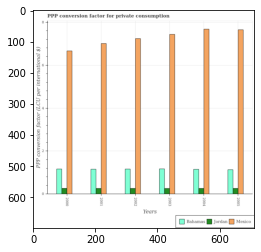

Number of QA =  29





,Years,Mexica,Jordan,Bahamas
0,2002,7.248152,0.291302,1.194461
1,2003,7.551769,0.286446,1.194401
2,2000,6.769028,0.286689,1.182108
3,2005,7.681492,0.285735,1.162812
4,2004,7.770117,0.286318,1.181804
5,2001,7.162894,0.284963,1.170060


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in mexico in 2000 and that in 2001 ?
PREDICTED =  -0.3938661185204362
EXPECTED =  -0.34349700000000016




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in bahamas in 2003 and the ppp conversion factor for private consumption in mexico in 2001?
PREDICTED =  0.024340724599103636
EXPECTED =  -5.8352581271288795




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the ppp conversion factor for private consumption in bahamas and ppp conversi

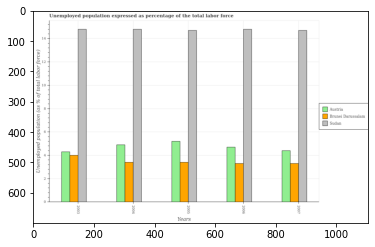

Number of QA =  29





,Years,Brunei Darussalam,Austria,Sudan
0,2006,3.334037,4.689483,14.849266
1,2005,3.435198,5.237332,14.746846
2,2007,3.326370,4.434452,14.711168
3,2004,3.446781,4.942564,14.891009
4,2003,4.050290,4.352444,14.834206


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in austria in 2004 and that in 2006 ?
PREDICTED =  0.2530809666382936
EXPECTED =  0.20000028610229226




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in austria in 2005 and the unemployment in in brunei darussalam in 2006?
PREDICTED =  0.5478486987634037
EXPECTED =  1.8999998569488574




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the unemployment in in brunei darussalam and unemployment in in austria ?
PREDICTED =  -1.2127195563332558
EXPECTED =  -1.1000001430511497




				 0 / 3 = 0.0


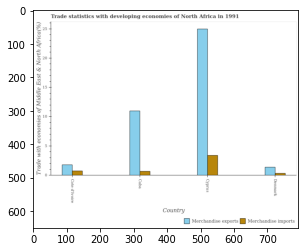

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Cote d'Ivoire,0.818122,1.869038
1,Denmark,0.405720,1.469156
2,Cuba,0.757102,11.095841
3,NaN,3.444198,25.226032


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in cyprus and that in denmark ?
PREDICTED =  0.9505652980052628
EXPECTED =  3.064807566703599




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in denmark and the merchandise imports in cote d'ivoire?
PREDICTED =  -0.3998829381884026
EXPECTED =  0.6445211361364191




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports and merchandise exports in cuba ?
PREDICTED =  -7.651643179410716
EXPECTED =  -10.307845485553678




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False

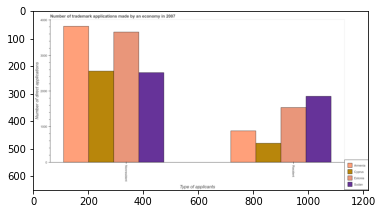

Number of QA =  23





,Type of applicants,Estonia,Unnamed: 2,Armenia,Sudan
0,Resident,1550.599454,552.307315,902.729908,1872.480843
1,Nonresident,3670.760729,2571.822373,3860.264439,2548.878353


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in cyprus and that in armenia ?
PREDICTED =  0.0
EXPECTED =  -1259




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by residents in armenia and the number of trademark applications made by non residents in estonia?
PREDICTED =  -1.0
EXPECTED =  -2775




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents and number of trademark applications made by residents in armenia ?
PREDICTED =  0.0
EXPECTED 

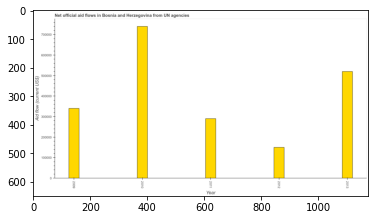

Number of QA =  23





,Year,Aid flow (current US$)
0,2011,288377.123857
1,2009,342099.572602
2,2013,519415.776112
3,2010,735010.891495
4,2012,150915.381252


> what is the title of the graph ?
PREDICTED =  Net official aid flows in Bosnia and Herzegovina from UN agencies
EXPECTED =  Net official aid flows in Bosnia and Herzegovina from UN agencies




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Aid flow (current US$)
EXPECTED =  Aid flow (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official flows from un agencies in 2011 and 2013 ?
PREDICTED =  -231038.65225511033
EXPECTED =  -230000.0




				 4 / 4 = 1.0


> what is the median net official flows from un agencies ?
PREDICTED =  None
EXPECTED =  340000.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

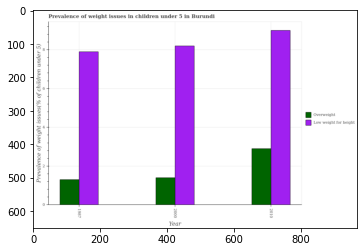

Number of QA =  28





,Year,Overweight,Low weight for height
0,2000,1.418111,8.156130
1,2010,2.914778,9.005295
2,1987,1.330278,7.852663


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of overweight children in 1987 and that in 2000 ?
PREDICTED =  -0.08783367551751287
EXPECTED =  -0.10000002384186013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweight children in 1987 and the percentage of overweight children in 2000?
PREDICTED =  -0.08783367551751287
EXPECTED =  -0.2999997138977095




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of overweight children and percentage of underweight children ?
PREDICTED =  1.5405835774958891
EXPECTED =  0.0




				 0 / 3 

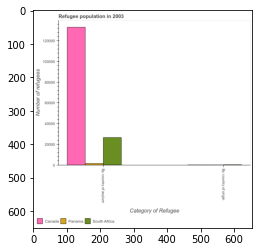

Number of QA =  23





,Category of Refugee,Panama,South Africa,Canada
0,By country of asylum,NaN,27257.522422,133488.403114
1,By country of origin,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin in south africa and that in canada ?
PREDICTED =  0.0
EXPECTED =  228




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin in panama and the number of refugees by country of asylum in south africa?
PREDICTED =  1.0
EXPECTED =  -26528




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin and number of refugees by country of asylum in south africa ?
PREDICTED =  -27256.52242211689
EXPECTED =  -26270




				 1 / 3 = 0.3333


is_b

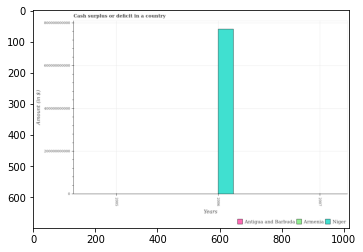

Number of QA =  19





,Years,Armenia,Antigua and Barbuda,Niger
0,2005,NaN,NaN,NaN
1,2006,NaN,NaN,7.757327e+11
2,2007,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of cash surplus or deficit in armenia in 2007 and the amount of cash surplus or deficit in niger in 2006?
PREDICTED =  -775732692938.0663
EXPECTED =  -770674003950.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Amount (in $)
EXPECTED =  200000000000.0




				 1 / 3 = 0.3333


> what is the title of the graph ?
PREDICTED =  Cash surplus or deficit in a count
EXPECTED =  Cash surplus or deficit in a country




				 1 / 4 = 0.25


> what is the label or title of the x-axis ?
PREDICTED =  Years
EXPECTED =  Years




				 2 / 5 = 0.4


> what is the label or title of the y-axis ?
PREDICTED =  Amou

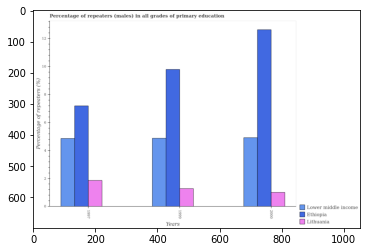

Number of QA =  29





,Years,Ethiopia,Lithuania,Lower middle income
0,1999,9.799220,1.321279,4.920116
1,2000,12.630821,1.046074,4.974225
2,1997,7.304587,1.890220,4.874538


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in ethiopia in 1997 and that in 2000 ?
PREDICTED =  -5.326234341418952
EXPECTED =  -5.440940069274901




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in ethiopia in 2000 and the percentage of repeaters (males) in lower middle income in 1999?
PREDICTED =  2.7364801788525153
EXPECTED =  7.75413990020752




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of repeaters (males) in lower middle income and percentage of repeaters (males) in ethiopia ?
PR

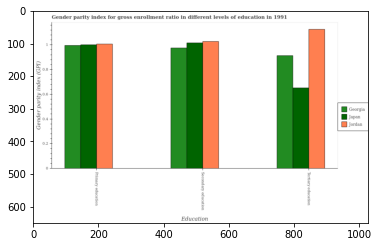

Number of QA =  28





,Education,Japan,Georgia,Jordan
0,Primary education,1.002589,0.999371,1.008560
1,Secondary education,1.014075,0.975226,1.030883
2,Tertiary education,0.655135,0.911585,1.128215


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in primary education in georgia and that in jordan ?
PREDICTED =  -0.009188645526255756
EXPECTED =  -0.01142999999999994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education in georgia and the gender parity index in primary education in japan?
PREDICTED =  -1.0247744796248321
EXPECTED =  -0.02571000000000012




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in tertiary education and gender parity index in secondary education in georgia ?
PREDICTED =  -0.886810

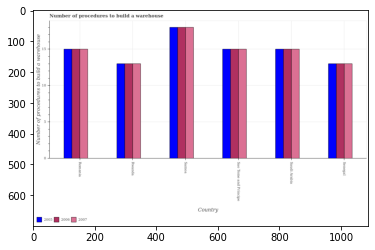

Number of QA =  29





,Country,2007,2005,2006
0,Sao Tome and Principe,15.009534,15.021700,NaN
1,Rwanda,13.000897,13.043036,13.028318
2,Romania,15.071660,15.105306,15.017839
3,Saudi Arabia,15.092122,15.058024,15.012120
4,Samoa,18.027630,18.062860,NaN
5,senegal,13.040204,13.012166,13.015861


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in in 2005 in samoa and that in sao tome and principe ?
PREDICTED =  0.0
EXPECTED =  3.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in in 2007 in romania and the number of procedures to build a warehouse in in 2006 in senegal?
PREDICTED =  0.0
EXPECTED =  2.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in of/in 2005 and number of procedures to build a warehouse in of/in 2006 in rwanda?
PREDICTED =  5.0

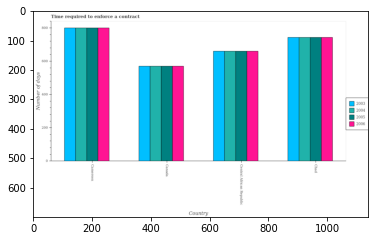

Number of QA =  30





,Country,2005,2004,2006,2003
0,Canada,571.966683,574.751143,571.949947,572.775408
1,Chad,746.037131,747.024161,745.764092,743.577821
2,Cameroon,803.275667,804.223132,803.180765,798.729801
3,Central African Republic,665.045730,664.329808,663.730472,662.108676


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract in 2003 in cameroon and that in canada ?
PREDICTED =  -571.7754079552054
EXPECTED =  230.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract in 2006 in cameroon and the number of days required to enforce a contract in 2004 in canada?
PREDICTED =  -567.9499469088587
EXPECTED =  230.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract of/in 2005 and number of days required to enforce a contract of/in 2004 

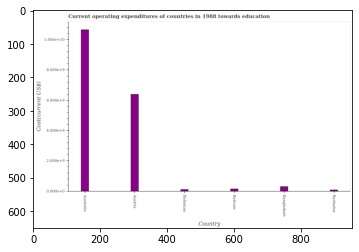

Number of QA =  22





,Country,Cost(current US$)
0,Austria,22.474600
1,Barbados,0.418303
2,Australia,37.669988
3,Bahrain,0.656811
4,Bangladesh,1.204008
5,Bahamas,0.508744


> what is the title of the graph ?
PREDICTED =  Current operating expenditures of countries in 1988 towards education
EXPECTED =  Current operating expenditures of countries in 1988 towards education




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cost(current US$)
EXPECTED =  Cost(current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education expenditure in austria and barbados ?
PREDICTED =  22.0562975446179
EXPECTED =  6313917774.504




				 3 / 4 = 0.75


> what is the median education expenditure ?
PREDICTED =  None
EXPECTED =  222569205.211




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


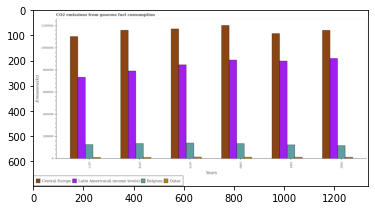

Number of QA =  30





,Years,Belgium,Central Europe,Qatar,Latin America(all income levels)
0,1982,121540.608244,1.164755e+06,17201.302681,905194.908670
1,1981,128082.556157,1.132831e+06,17358.843071,883450.313097
2,1977,131525.701236,1.111427e+06,14434.776937,738779.627530
3,1979,144408.511177,1.182784e+06,18923.568620,852620.865239
4,1978,139258.493631,1.163241e+06,15218.595851,792510.192162
5,1980,138885.583323,1.211571e+06,18121.443957,893795.107134


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in central europe in 1978 and that in 1980 ?
PREDICTED =  -48330.09981595678
EXPECTED =  -43675.535729219904




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in belgium in 1982 and the amount of co2 emitted in central europe in 1979?
PREDICTED =  -22867.90293315616
EXPECTED =  -1053598.77921483




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the amount of co2 emitted in qatar and amount of co2 emitted in latin america(all income levels) ?
PREDICTED =  -803936.3775526179
EXPECTED

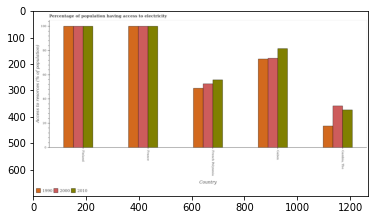

Number of QA =  29





,Country,2000,1990,2010
0,French Polynesia,52.931653,48.972279,56.343994
1,France,100.487475,100.394473,100.388292
2,Finland,100.331819,100.147144,100.583539
3,"Gambia, The",34.685540,18.133468,31.513660
4,Gabon,73.991089,73.181893,81.905208


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to electricity in 2010 in french polynesia and that in gambia, the ?
PREDICTED =  -44.04429843550728
EXPECTED =  24.799999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to electricity in 2010 in french polynesia and the percentage of population having access to electricity in 1990 in france?
PREDICTED =  -44.04429843550728
EXPECTED =  -44.2




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to electricity of/in 

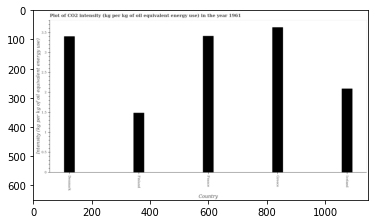

Number of QA =  22





,Country,Intensity (kg per kg of oil equivalent energy use)
0,Denmark,3.422514
1,Greece,3.656855
2,France,3.451540
3,Iceland,2.109603
4,Finland,1.497854


> what is the title of the graph ?
PREDICTED =  Plot of CO2 intensity (kg per kg of oil equivalent energy use) in the year 1961
EXPECTED =  Plot of CO2 intensity (kg per kg of oil equivalent energy use) in the year 1961




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Intensity (kg per kg of oil equivalent energy use)
EXPECTED =  Intensity (kg per kg of oil equivalent energy use)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in denmark and greece ?
PREDICTED =  -0.23434066644407592
EXPECTED =  -0.226




				 4 / 4 = 1.0


> what is the median co2 intensity ?
PREDICTED =  None
EXPECTED =  3.40099422722331




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

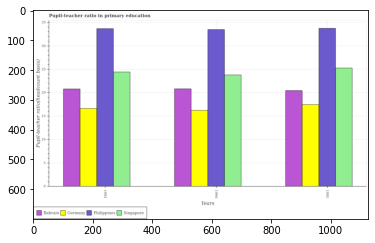

Number of QA =  30





,Years,Philippines,Singapore,Bahrain,Germany
0,1993,33.420623,24.466753,20.765022,16.651708
1,1995,33.469637,25.224714,20.470648,17.506147
2,1994,33.290959,23.736643,20.672666,16.363985


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the pupil-teacher ratio in primary education in philippines in 1995 ?
PREDICTED =  16.73481863905062
EXPECTED =  33.73656




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum pupil-teacher ratio in primary education in germany ?
PREDICTED =  8.753073522176823
EXPECTED =  17.45831




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum pupil-teacher ratio in primary education in bahrain ?
PREDICTED =  997.5
EXPECTED =  20.45503




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training 

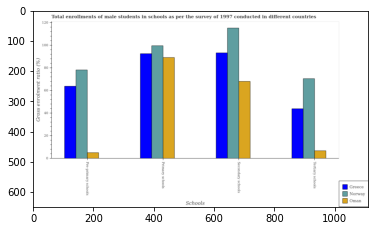

Number of QA =  29





,Schools,Greece,Norway,Oman
0,Primary schools,92.751272,99.956714,89.413525
1,Secondary schools,93.832940,115.833882,68.753045
2,Tertiary schools,44.720214,70.952293,7.141468
3,Pre-primary schools,64.327261,78.838976,5.374181


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(male) in tertiary schools in oman ?
PREDICTED =  3.5707340924423634
EXPECTED =  6.72031




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(male) in secondary schools ?
PREDICTED =  46.91647003077907
EXPECTED =  115.12027




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio(male) in secondary schools ?
PREDICTED =  46.91647003077907
EXPECTED =  68.0028




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

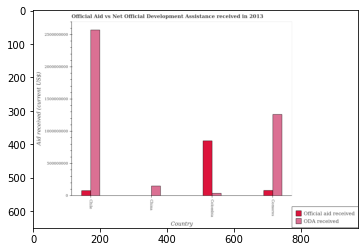

Number of QA =  25





,Country,Official aid received,ODA received
0,Chile,8.837643e+07,2.603701e+09
1,China,NaN,1.598350e+08
2,Comoros,9.059706e+07,1.278467e+09
3,Colombia,8.609946e+08,4.576253e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in chile and that in comoros ?
PREDICTED =  1325234340.78072
EXPECTED =  1310220000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in china and the oda received in colombia?
PREDICTED =  nan
EXPECTED =  -37770000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received and oda received in colombia ?
PREDICTED =  0.0
EXPECTED =  814260000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

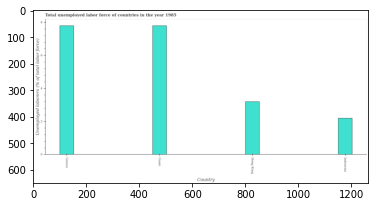

Number of QA =  22





,Country,Unemployed laborers (% of total labor force)
0,Guam,7.856928
1,Greece,7.880291
2,Hong Kong,3.199046
3,Indonesia,2.237778


> what is the title of the graph ?
PREDICTED =  Total unemployed labor force of countries in the year 1985
EXPECTED =  Total unemployed labor force of countries in the year 1985




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed laborers (% of total labor force)
EXPECTED =  Unemployed laborers (% of total labor force)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed labour force in greece and hong kong ?
PREDICTED =  4.681245659082518
EXPECTED =  4.6




				 4 / 4 = 1.0


> what is the median total unemployed labour force ?
PREDICTED =  None
EXPECTED =  5.50000011920929




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


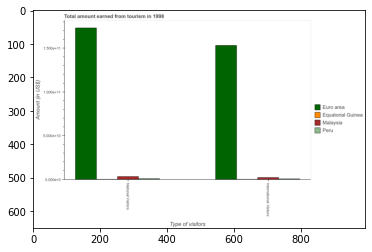

Number of QA =  23





,Type of visitors,Malaysia,Peru,Equatorial Guinea,Euro area
0,National Visitors,0.039002,NaN,NaN,1.737278
1,International Visitors,NaN,NaN,NaN,1.537271


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in equatorial guinea and that in malaysia ?
PREDICTED =  0.9609977078704477
EXPECTED =  -3236600000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors and amount earned from national visitors in equatorial guinea ?
PREDICTED =  0.0
EXPECTED =  6600000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount earned from i

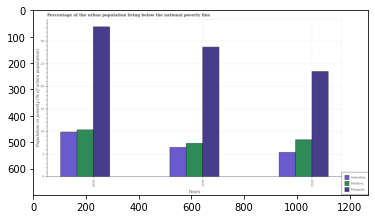

Number of QA =  29





,Years,Moldova,Mongolia,Argentina
0,2011,7.455740,28.633907,6.631661
1,2010,10.550206,33.217975,10.103161
2,2012,8.310949,23.269404,5.448300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the urban population living below the national poverty line in mongolia in 2011 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  5.399999999999999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the urban population living below the national poverty line in mongolia in 2011 and the percentage of the urban population living below the national poverty line in moldova in 2012?
PREDICTED =  0.0
EXPECTED =  20.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of the urban population l

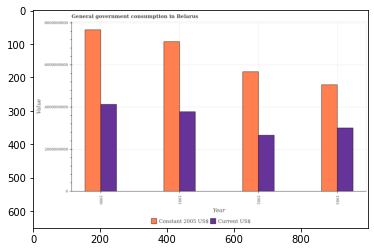

Number of QA =  28





,Year,Current US$,Constant 2005 US$
0,1992,2.713719e+09,5.748137e+09
1,1990,4.169362e+09,7.778762e+09
2,1991,3.843440e+09,7.176456e+09
3,1993,3.061872e+09,5.160540e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in current us$ in 1991 and that in 1992 ?
PREDICTED =  1129720882.9473653
EXPECTED =  1115612147.6374211




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in current us$ in 1990 and the value consumed in constant 2005 us$ in 1993?
PREDICTED =  1107489971.0695863
EXPECTED =  1119833611.17656




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the value consumed in current us$ and value consumed in constant 2005 us$ ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0


is_built_with_cuda: True
i

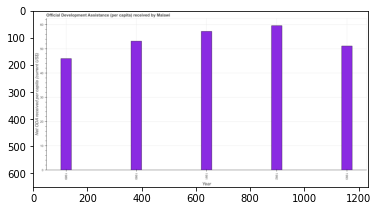

Number of QA =  23





,Year,Net ODA received per capita (current US$)
0,1991,57.379706
1,1993,51.378032
2,1990,53.402621
3,1992,59.767522
4,1989,46.072453


> what is the title of the graph ?
PREDICTED =  Official Development Assistance (per capita) received by Malawi
EXPECTED =  Official Development Assistance (per capita) received by Malawi




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Net ODA received per capita (current US$)
EXPECTED =  Net ODA received per capita (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net oda received per capita in 1989 and 1992 ?
PREDICTED =  -13.695069396454933
EXPECTED =  -13.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median net oda received per capita ?
PREDICTED =  53.40262103307211
EXP

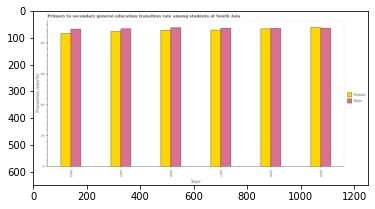

Number of QA =  28





,Year,Female,Male
0,2006,87.973692,89.635122
1,2009,90.026376,89.478631
2,2005,87.080315,89.360454
3,2008,89.003601,89.683477
4,2007,87.593081,89.523293
5,2004,86.328318,88.873511


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students in 2004 and that in 2005 ?
PREDICTED =  -0.7519970639987861
EXPECTED =  -1.2716369628907103




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in 2009 and the transition rate among female students in 2005?
PREDICTED =  0.11817681243822165
EXPECTED =  0.3236923217774006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the transit

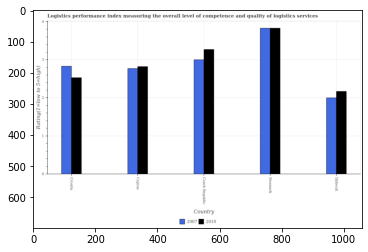

Number of QA =  28





,Country,2007,2010
0,Djibouti,2.013381,2.183523
1,Czech Republic,3.019027,3.285964
2,Denmark,3.835900,3.850388
3,Croatia,2.843891,2.536927
4,Cyprus,2.789901,2.845135


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 in denmark and that in djibouti ?
PREDICTED =  1.8225189081811872
EXPECTED =  1.83




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2010 in czech republic and the logistic performance index in 2007 in denmark?
PREDICTED =  -0.28221232368155924
EXPECTED =  -0.56




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index of/in 2010 and logistic performance index of/in 2007 in djibouti?
PREDICTED =  12.688555108315487
EXPECTED =  0.16999999999999993




				 

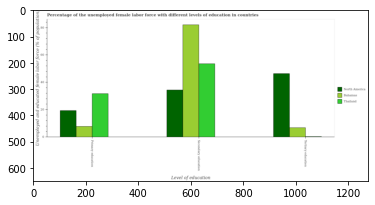

Number of QA =  28





,Level of education,North America,Thailand,Bahamas
0,Secondary education,35.187809,54.598876,83.639523
1,Tertiary education,47.429661,NaN,7.257045
2,Primary education,19.902233,32.450031,8.242162


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in north america and that in bahamas ?
PREDICTED =  0.0
EXPECTED =  -47.71694950811379




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in thailand and the percentage of female labor force who received secondary education in bahamas?
PREDICTED =  24.207869156900852
EXPECTED =  -50.3999977111815




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

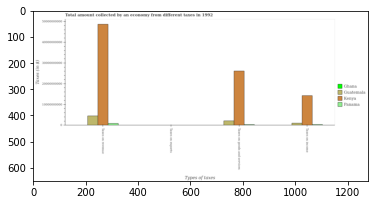

Number of QA =  29





,Types of taxes,Panama,Kenya,Ghana,Guatemala
0,Taxes on goods and services,NaN,2.638875e+10,NaN,2.402381e+09
1,Taxes on income,NaN,1.449418e+10,NaN,1.310562e+09
2,Taxes on revenue,1.150621e+09,4.891935e+10,NaN,4.762297e+09
3,Taxes on exports,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on income and amount collected as tax on goods in ghana ?
PREDICTED =  nan
EXPECTED =  -6669600




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount collected as tax on revenue in ghana to that in kenya ?
PREDICTED =  0.0
EXPECTED =  0.0006200073949303645




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

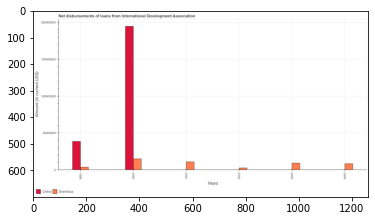

Number of QA =  24





,Years,Dominica,China
0,2003,9.562614e+06,NaN
1,2004,8.968301e+06,NaN
2,1999,4.452497e+06,3.920181e+07
3,2001,1.143102e+07,NaN
4,2000,1.556743e+07,1.954086e+08
5,2002,3.343739e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in dominica in 1999 and that in 2003 ?
PREDICTED =  -5110116.927502577
EXPECTED =  -5508000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in china in 2003 and the amount of loans disbursed in dominica in 2002?
PREDICTED =  6218875.474219652
EXPECTED =  -2435000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the amount of loans disbursed in dominica and amount of loans disbursed in china ?
PREDICTED =  -181284754.4162203
EXPECTED =  -179774000.0




				 1 / 3 = 0

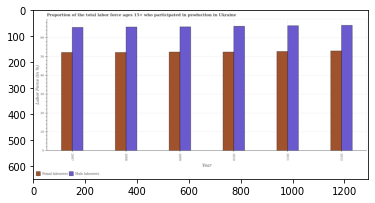

Number of QA =  28





,Year,Femal labourers,Male labourers
0,2008,51.991910,65.262908
1,2007,51.903833,65.128769
2,2010,52.172832,65.875401
3,2011,52.328895,66.037844
4,2009,52.101268,65.490606
5,2012,52.874558,66.059208


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in 2008 and that in 2012 ?
PREDICTED =  -0.7962991725561324
EXPECTED =  -0.9000015258787926




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 2007 and the percentage of male labour force in 2009?
PREDICTED =  -0.19743438048585915
EXPECTED =  -0.20000076293939628




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of female labor force and percentage of male labour force ?
PREDICTED =  -13.184649493657467
EXPECTED =  0.0




				 1 / 3 = 0.3333



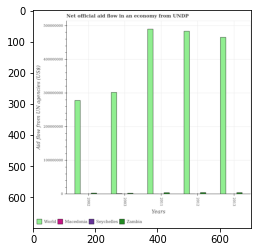

Number of QA =  30





,Years,Zambia,Seychelles,Macedonia,World
0,2002,NaN,NaN,NaN,2.808136e+08
1,2011,5.868919e+06,NaN,NaN,4.917278e+08
2,2003,NaN,NaN,NaN,3.036414e+08
3,2012,6.173676e+06,NaN,NaN,4.861533e+08
4,2013,NaN,NaN,NaN,4.677481e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in zambia in 2002 and that in 2012 ?
PREDICTED =  -6173676.378224532
EXPECTED =  -1670000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in world in 2011 and the net official aid flow in seychelles in 2012?
PREDICTED =  5574457.084495664
EXPECTED =  489610000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the net official aid flow in world and net official aid flow in zambia ?
PREDICTED =  491727775.66775495
EXPECTED =  478920000




				 1 / 3 = 0.3333


is_built_with_cuda

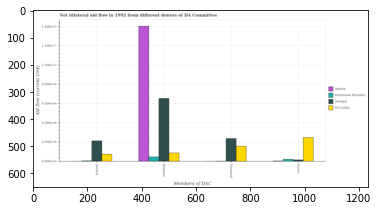

Number of QA =  26





,Members of DAC,Senegal,Algeria,Dominican Republic,Sri Lanka
0,Austria,0.010793,NaN,NaN,0.080494
1,Korea,NaN,NaN,0.025995,0.255198
2,Denmark,0.244658,NaN,NaN,0.163528
3,NaN,0.656883,1.420842,0.052164,0.093495


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by belgium in algeria and that in senegal ?
PREDICTED =  0.7553415631109849
EXPECTED =  7510000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by belgium in algeria and the amount of aid given by korea in senegal?
PREDICTED =  0.7445483701637021
EXPECTED =  13900000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by austria and amount of aid given by belgium in senegal ?
PREDICTED =  0.08766487836053227
EXPECTED =  -4410000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

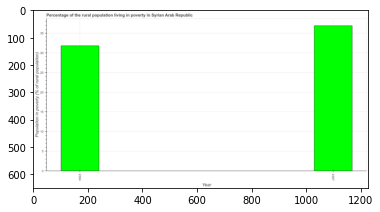

Number of QA =  19





,Year,Population in poverty (% of rural population)
0,2004,32.013819
1,2007,36.821572


> what is the title of the graph ?
PREDICTED =  Percentage of the rural population living in poverty in Syrian Arab Republic
EXPECTED =  Percentage of the rural population living in poverty in Syrian Arab Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population in poverty (% of rural population)
EXPECTED =  Population in poverty (% of rural population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population living below poverty line in 2004 and 2007 ?
PREDICTED =  -4.80775297651774
EXPECTED =  -5.1




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median per

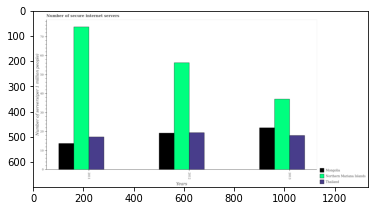

Number of QA =  29





,Years,Thailand,Mongolia,Northern Mariana Islands
0,2011,17.509684,14.184239,75.918322
1,2013,18.271254,22.263288,37.226975
2,2012,19.617605,19.562073,56.869391


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in mongolia in 2011 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  -5.455711052616101




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in thailand in 2012 and the number of secure internet servers in northern mariana islands in 2013?
PREDICTED =  0.0
EXPECTED =  -17.6673126376965




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the number of secure internet servers in mongolia and number of secure internet servers in northern mariana islands ?
PREDICTED =

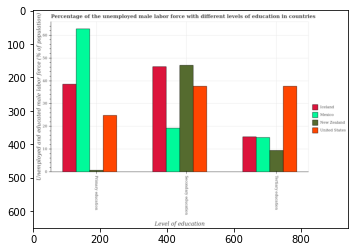

Number of QA =  28





,Level of education,Iceland,New Zealand,Mexica,United States
0,Tertiary education,15.522362,9.593198,15.328438,37.498536
1,Primary education,38.198689,0.943767,62.883699,24.979683
2,Secondary education,46.418052,46.946155,19.326248,37.715384


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in mexico and that in new zealand ?
PREDICTED =  5.929163644081116
EXPECTED =  5.70000076293943




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received secondary education in united states and the percentage of male labor force who received primary education in iceland?
PREDICTED =  -0.48330483961049
EXPECTED =  -0.9000015258788991




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary educat

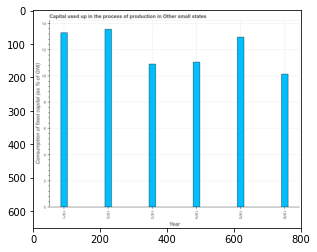

Number of QA =  23





,Year,Consumption of fixed capital (as % of GNI)
0,1975,13.173417
1,1976,10.206135
2,1973,10.999275
3,1972,13.796427
4,1971,13.434535
5,1974,11.132954


> what is the title of the graph ?
PREDICTED =  Capital used up in the process of production in Other small states
EXPECTED =  Capital used up in the process of production in Other small states




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Consumption of fixed capital (as % of GNI)
EXPECTED =  Consumption of fixed capital (as % of GNI)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in 1971 and 1973 ?
PREDICTED =  2.4352598516110433
EXPECTED =  2.392




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median consumption of fixed capital ?
PREDICTED =  12.153185652

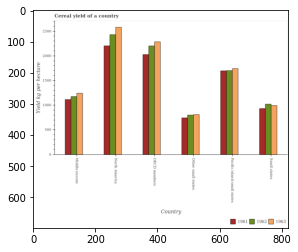

Number of QA =  29





,Country,1963,1962,1961
0,Small states,1008.338302,1025.122853,944.560717
1,Pacific island small states,1764.009692,1715.521042,1701.336600
2,Other small states,817.310794,807.177545,751.541373
3,North America,2601.434310,2449.924559,2204.684674
4,Middle income,1253.089163,1193.191891,1133.252309
5,OECD members,2295.275347,2212.233993,2046.012427


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1961 in middle income and that in other small states ?
PREDICTED =  -562.8497802810211
EXPECTED =  371.1443546230379




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1963 in other small states and the total cereal yield in 1962 in pacific island small states?
PREDICTED =  61.63940421595521
EXPECTED =  -890.900988671123




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield of/in 1962 and total cereal yield of/in 1963 in north america?
PREDICTED =  2060.72424153079
EXPECTED =  -149

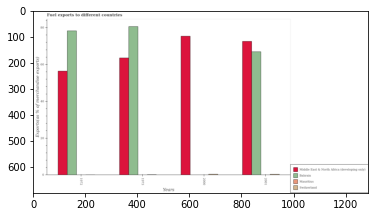

Number of QA =  30





,Years,Switzerland,Mauritius,Middle East & North Africa (developing only),Bahrain
0,2000,NaN,NaN,75.159004,NaN
1,1972,NaN,NaN,56.660884,78.313323
2,2001,NaN,NaN,72.669887,67.179807
3,1973,NaN,NaN,63.704936,80.876010


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in mauritius in 1973 and that in 2001 ?
PREDICTED =  nan
EXPECTED =  -0.004146998868386694




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in bahrain in 2000 and the percentage of exports to different countries in middle east & north africa (developing only) in 1972?
PREDICTED =  -11.133515990502715
EXPECTED =  -56.36845745200267




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the percentage of exports to different countries in bahr

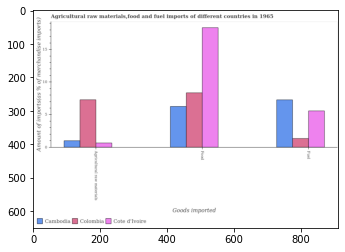

Number of QA =  28





,Goods imported,Cambodia,Cote d'Ivoire,Colombia
0,Fuel,7.414805,5.689559,1.428238
1,Food,6.381548,18.476037,8.477395
2,Agricultural raw materials,1.094271,0.754213,7.413706


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in cote d'ivoire and the percentage of raw materials imports in colombia?
PREDICTED =  0.0
EXPECTED =  11.066311218133949




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of raw materials imports in cambodia to that in cote d'ivoire ?
PREDICTED =  1.3258859125618794
EXPECTED =  1.5268843970942643




				 0 / 4 = 0.0


is_built_with_cuda: True
is_g

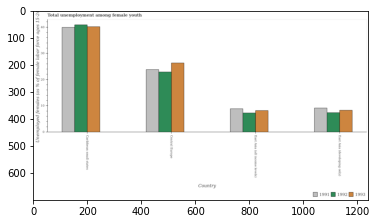

Number of QA =  29





,Country,1992,1993,1991
0,East Asia (developing only),7.449385,8.496672,9.378978
1,East Asia (all income levels),7.352170,8.296564,9.136017
2,Caribbean small states,41.494564,40.927733,40.034465
3,Central Europe,23.228458,26.697155,24.205027


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in in 1992 in central europe and the percentage of unemployed females in in 1993 in caribbean small states?
PREDICTED =  -18.26610663391053
EXPECTED =  -17.257416550840595




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in of/in 1991 and percentage of unemployed females in of/in 1992 in central europe?
PREDICTED =  -14.092441049625004
EXPECTED =  0.9001357439022968




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

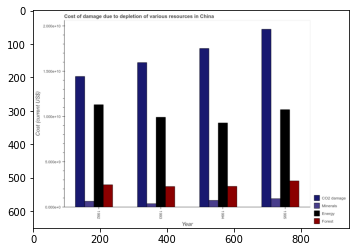

Number of QA =  30





,Year,Forest,CO2 damage,Energy,Minerals
0,1992,0.252403,1.449330,1.135649,0.070893
1,1993,0.234442,1.603064,1.004126,0.044259
2,1994,0.233438,1.756662,0.935689,0.080655
3,1995,0.296077,1.972874,1.088465,0.099450


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of energy in 1993 and that in 1994 ?
PREDICTED =  0.06843712621068532
EXPECTED =  627778168.4371014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of energy in 1992 and the cost of damage due to depletion of coal in 1995?
PREDICTED =  0.3608641837583024
EXPECTED =  547262540.5770016




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the cost of damage due to depletion of minerals and cost of damage due to depletion of energy ?
PREDICTED =  -1.3498800065145315


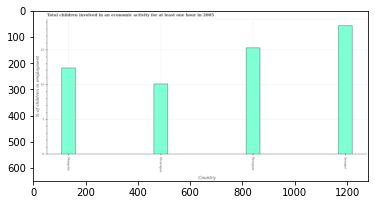

Number of QA =  22





,Country,% of children in employment
0,Senegal,18.564569
1,Mongolia,12.474548
2,Paraguay,15.374779
3,Nicaragua,10.258930


> what is the title of the graph ?
PREDICTED =  Total children involved in an economic activity for at least one hour in 2005
EXPECTED =  Total children involved in an economic activity for at least one hour in 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of children in employment
EXPECTED =  % of children in employment




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children in employment in nicaragua and senegal ?
PREDICTED =  -8.30563917679526
EXPECTED =  -8.4




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children in employment ?
PREDI

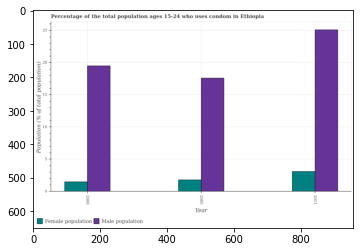

Number of QA =  28





,Year,Female population,Male population
0,2005,1.874635,17.685577
1,2000,1.562273,19.762043
2,2011,3.158324,25.180323


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male population in 2000 and that in 2005 ?
PREDICTED =  2.076465515545973
EXPECTED =  1.8999999999999986




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male population in 2005 and the female population in 2000?
PREDICTED =  -2.076465515545973
EXPECTED =  -1.8999999999999986




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the male population and female population ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

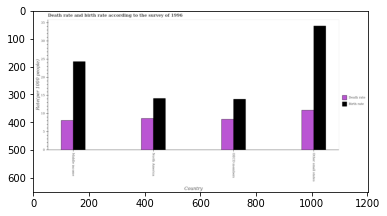

Number of QA =  28





,Country,Death rate,Birth rate
0,North America,8.776188,14.231879
1,Middle income,8.190324,24.432919
2,Other small states,11.119092,34.068889
3,OECD members,8.471275,13.958042


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in middle income and that in oecd members ?
PREDICTED =  10.474876949363857
EXPECTED =  10.36441547804631




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in oecd members and the death rate in middle income?
PREDICTED =  -10.474876949363857
EXPECTED =  5.840296600651451




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate and birth rate in oecd members ?
PREDICTED =  2.647816931640955
EXPECTED =  -5.525911288631621




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

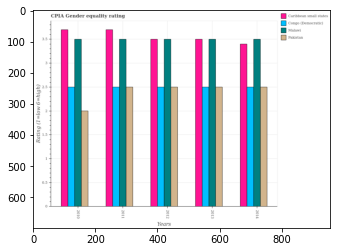

Number of QA =  30





,Years,Pakistan,Malawi,Congo (Democratic),Caribbean small states
0,2014,2.510990,3.472805,2.522658,3.388643
1,2012,2.500529,3.504566,2.506290,3.470971
2,2011,2.493747,3.480157,2.510739,3.681307
3,2013,2.500454,3.486106,2.512002,3.497816
4,2010,1.991698,3.505525,2.518751,3.708970


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in pakistan in 2010 and that in 2014 ?
PREDICTED =  -0.5192923793402977
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in malawi in 2010 and the cpia rating in congo (democratic) in 2012?
PREDICTED =  0.0009588594712752752
EXPECTED =  1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in congo (democratic) in 2012 to that in 2013?
PREDI

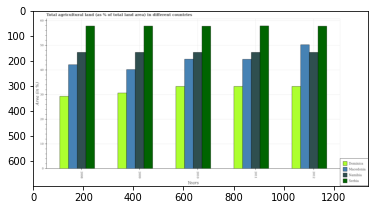

Number of QA =  30





,Years,Dominica,Serbia,Namibia,Macedonia
0,2008,29.265306,58.151440,47.235956,42.476662
1,2009,30.764817,57.901543,47.325111,40.344829
2,2010,33.624951,58.082767,47.527041,44.670830
3,2011,33.636111,57.956382,47.232010,44.680880
4,2012,33.589444,57.721200,47.404098,50.310624


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in dominica in 2009 and that in 2010 ?
PREDICTED =  -2.8601339263651617
EXPECTED =  -2.6666666666666003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in macedonia in 2011 and the percentage of agricultural land in serbia in 2009?
PREDICTED =  4.336050545666545
EXPECTED =  -13.4679535387016




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of agricultural land in serbia and percentage of agricultural land in namibia ?
PREDICTED =  10.1941590153

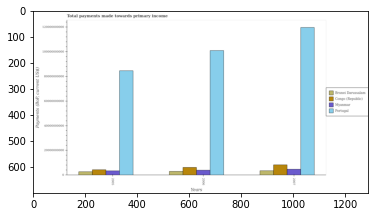

Number of QA =  30





,Years,Portugal,Brunei Darussalam,Myanmar,Congo (Republic:
0,2007,1.195799e+11,3.879025e+09,5.084980e+09,8.696959e+09
1,2005,8.507710e+10,3.122833e+09,3.859713e+09,4.623923e+09
2,2006,1.014220e+11,3.379883e+09,4.344862e+09,6.518534e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in brunei darussalam in 2006 and that in 2007 ?
PREDICTED =  -499142442.2436199
EXPECTED =  -530026379.8999996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in brunei darussalam in 2007 and the total payments made towards primary income in portugal in 2005?
PREDICTED =  756191934.0081158
EXPECTED =  -80995683162.3




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the total payments made towards primary income in congo (republic) and tot

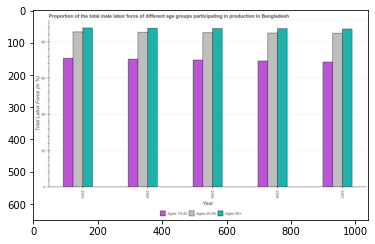

Number of QA =  29





,Year,Ages 20-50,Ages 50+,Ages 15-20
0,2003,86.049683,88.009823,70.869613
1,2006,85.571162,87.833690,70.032719
2,2005,85.028756,88.108209,70.771640
3,2004,85.924172,88.168326,71.212298
4,2007,85.332925,87.573584,69.620020


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 in 2003 and that in 2004 ?
PREDICTED =  -0.34268462294730284
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force above age 50 in 2007 and the percentage of male labor force within the age group 20-50 in 2003?
PREDICTED =  1.523900583116415
EXPECTED =  -0.5999984741209943




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of male labor force within the age group 20-50 and percentage of male labor force above ag

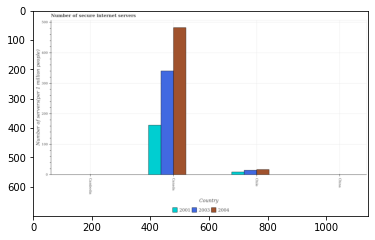

Number of QA =  29





,Country,2003,2004,2001
0,Chile,16.373229,18.446007,10.815110
1,Canada,339.353231,480.884583,163.734233
2,Cambodia,NaN,NaN,NaN
3,China,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in 2001 in cambodia and that in canada ?
PREDICTED =  -160.73423259597953
EXPECTED =  -162.47418835010524




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in 2004 in chile and the number of secure internet servers in 2001 in china?
PREDICTED =  -1.0
EXPECTED =  17.07382636934986




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers of/in 2001 and number of secure internet servers of/in 2004 in canada?
PREDICTED =  0.0
EXPECTED =  -319.971811

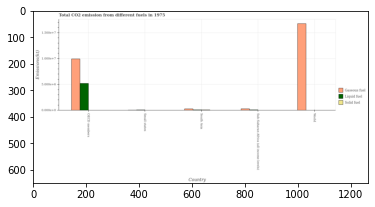

Number of QA =  29





,Country,Gaseous fuel,Liquid fuel,Solid fuel
0,World,1.684959,NaN,NaN
1,OECD members,0.996768,0.530847,NaN
2,Sub-Saharan Africa (all income levels),0.037913,NaN,NaN
3,South Asia,0.037495,NaN,NaN
4,Small states,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel in small states and the amount of co2 emissions from liquid fuel in oecd members?
PREDICTED =  -0.921358764682788
EXPECTED =  -5154207.807905745




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel and amount of co2 emissions from solid fuel in small states ?
PREDICTED =  1.2428648459879357
EXPECTED =  38343.620887444704




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished a

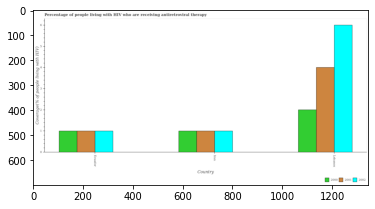

Number of QA =  29





,Country,2002,2000,2001
0,NaN,1.016802,1.018695,1.019616
1,Lebanon,5.989379,2.018098,4.023219
2,Ecuador,1.017949,1.021375,1.016094


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in 2000 in ecuador and that in lebanon ?
PREDICTED =  -0.9967231047253478
EXPECTED =  -1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in 2002 in ecuador and the percentage of the hiv infected people who are receiving antiretroviral therapy in 2000 in lebanon?
PREDICTED =  -4.971430210971371
EXPECTED =  -1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hi

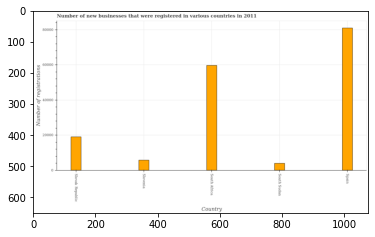

Number of QA =  22





,Country,Number of registrations
0,South Sudan,4351.204910
1,Slovenia,6181.480433
2,NaN,81776.260201
3,Slovak Republic,19298.214314
4,South Africa,60304.293626


> what is the title of the graph ?
PREDICTED =  Number of new businesses that were registered in various countries in 2011
EXPECTED =  Number of new businesses that were registered in various countries in 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of registrations
EXPECTED =  Number of registrations




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the number of new business registrations in south sudan ?
PREDICTED =  2175.6024550771813
EXPECTED =  3934




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum number of new business registrations ?
PREDICTED =  30152.14681306

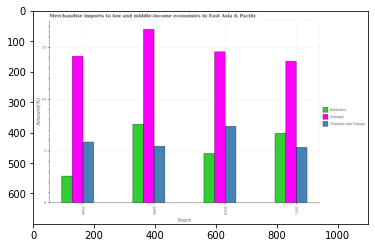

Number of QA =  29





,Years,Senegal,Barbados,Trinidad and Tobaga
0,2010,14.581558,4.780044,7.416592
1,2011,13.676496,6.752625,5.378098
2,2008,14.134413,2.598205,5.905030
3,2009,16.806028,7.601652,5.527219


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in barbados in 2008 and that in 2010 ?
PREDICTED =  -2.1818385886186973
EXPECTED =  -2.1849253458514393




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in trinidad and tobago in 2011 and the percentage of amount earned from merchandise imports in senegal in 2008?
PREDICTED =  -23.81090904490815
EXPECTED =  -8.802367074814981




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of amount earned from merchand

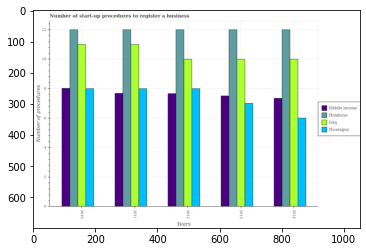

Number of QA =  30





,Years,Honduras,Middle income,Nicaragua,Iraq
0,2013,12.162116,7.620037,7.111739,10.151969
1,2012,12.195432,7.809847,8.106800,10.168202
2,2014,12.165202,7.440921,6.066819,10.082147
3,2010,12.130611,8.130600,8.150779,11.152084
4,2011,12.222645,7.795522,8.156699,11.200300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures required to register a business in iraq in 2011 and that in 2014 ?
PREDICTED =  0.0
EXPECTED =  1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures required to register a business in iraq in 2012 and the number of procedures required to register a business in honduras in 2013?
PREDICTED =  -1.0
EXPECTED =  -2.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of procedures required to register a business in nicaragua and number of procedures required to register a busin

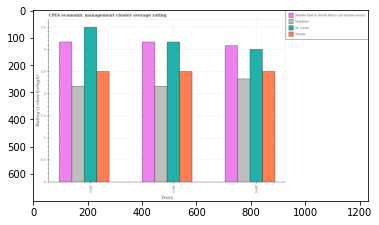

Number of QA =  30





,Years,Tuvalu,Middle East & North Africa (all income levels),Maldives,St. Lucia
0,2014,2.516137,3.095951,2.326767,3.006502
1,2012,2.520708,3.168246,2.197013,3.521679
2,2013,2.519156,3.181053,2.175470,3.176797


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in maldives in 2012 and that in 2014 ?
PREDICTED =  -0.1297542926996087
EXPECTED =  -0.16666333333333005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in maldives in 2014 and the cpia rating in tuvalu in 2012?
PREDICTED =  0.1297542926996087
EXPECTED =  -0.16666999999999987




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in st. lucia and cpia rating in tuvalu ?
PREDICTED =  0.006502048585978137
EXPECTED =  1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fals

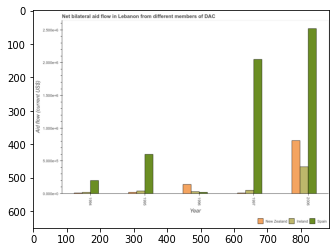

Number of QA =  29





,Year,Spain,lreland,New Zealand
0,1994,0.210260,NaN,NaN
1,1995,0.613441,0.051900,NaN
2,1996,NaN,NaN,0.150665
3,2006,2.532308,0.422659,0.822717
4,1997,2.070049,0.060860,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in 1994 and that in 2006 ?
PREDICTED =  -2.3220483352855337
EXPECTED =  -2320000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by new zealand in 1996 and the amount of aid provided by ireland in 1995?
PREDICTED =  0.15066534935931136
EXPECTED =  120000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of aid provided by spain in 199

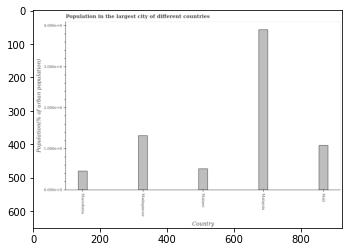

Number of QA =  22





,Country,Population(% of urban population)
0,Malaysia,3.920520
1,Malawi,0.522423
2,Madagascar,1.332730
3,Mali,1.094864
4,Macedonia,0.471983


> what is the title of the graph ?
PREDICTED =  Population in the largest city of different countries
EXPECTED =  Population in the largest city of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population(% of urban population)
EXPECTED =  Population(% of urban population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in largest city in macedonia and mali ?
PREDICTED =  -0.6228809490275664
EXPECTED =  -625274.0




				 3 / 4 = 0.75


> what is the median population in largest city ?
PREDICTED =  None
EXPECTED =  1083247.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

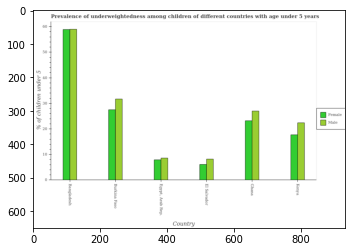

Number of QA =  28





,Country,Female,Male
0,Burkina Faso,28.134917,32.163114
1,Kenya,18.048135,22.728927
2,Ghana,23.678679,27.540377
3,Bangladesh,59.413589,59.553327
4,"Egypt, Arab Rep.",8.166688,8.875951
5,El Salvador,6.379619,8.482739


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweighted female children in egypt, arab rep. and that in el salvador ?
PREDICTED =  0.0
EXPECTED =  1.800000190734858




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweighted female children in el salvador and the percentage of underweighted male children in egypt, arab rep.?
PREDICTED =  -1.7870687458142633
EXPECTED =  -2.500000476837159




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.



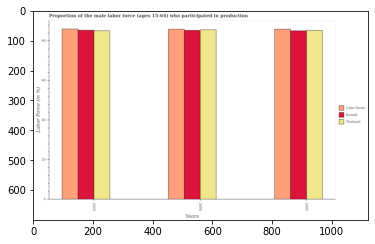

Number of QA =  29





,Years,Cabo Verde,Thailand,Kuwait
0,2003,87.400495,85.692771,85.753449
1,2005,86.338351,85.555838,85.639234
2,2004,87.463104,85.911315,85.664177


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in kuwait in 2004 and that in 2005 ?
PREDICTED =  0.02494316351493353
EXPECTED =  0.20000457763680402




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in cabo verde in 2003 and the proportion of the male labor force who participated in production in thailand in 2004?
PREDICTED =  -0.06260879719384604
EXPECTED =  0.4000015258790057




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the proportion

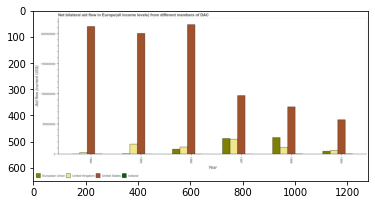

Number of QA =  30





,Year,Iceland,European Union,United Kingdom,United States
0,1964,NaN,NaN,NaN,2.133694e+08
1,1969,NaN,5.727796e+06,7.007402e+06,5.792949e+07
2,1966,NaN,9.013202e+06,1.269470e+07,2.170365e+08
3,1968,NaN,2.833951e+07,1.192665e+07,7.932563e+07
4,1967,NaN,2.690472e+07,2.582830e+07,9.838619e+07
5,1965,NaN,NaN,1.747564e+07,2.018418e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by us in 1964 and that in 1969 ?
PREDICTED =  155439908.4669203
EXPECTED =  155000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by eu in 1969 and the amount of aid given by us in 1966?
PREDICTED =  -211308706.79282382
EXPECTED =  -3430000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1966, what is the difference between the amount of aid given by iceland and amount of aid given by eu ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or

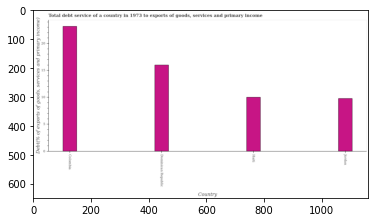

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Jordan,9.876629
1,Haiti,10.154950
2,Dominican Republic,16.124073
3,Colombia,23.294121


> what is the title of the graph ?
PREDICTED =  Total debt service of a country in 1973 to exports of goods, services and primar
EXPECTED =  Total debt service of a country in 1973 to exports of goods, services and primary income




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in colombia and jordan ?
PREDICTED =  13.417491987526766
EXPECTED =  13.393




				 3 / 4 = 0.75


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  13.004716861358851




				 3 / 6 = 0.5


is_built_with_cuda: True


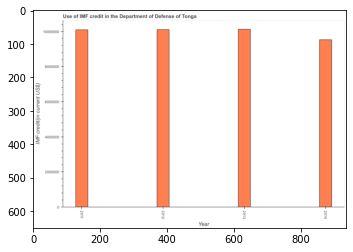

Number of QA =  23





,Year,IMF credit(in current US$)
0,2014,9.663290e+06
1,2011,1.022709e+07
2,2012,1.026204e+07
3,2013,1.025070e+07


> what is the title of the graph ?
PREDICTED =  Use of IMF credit in the Department of Defense of Tonga
EXPECTED =  Use of IMF credit in the Department of Defense of Tonga




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  IMF credit(in current US$)
EXPECTED =  IMF credit(in current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the use of imf credit in dod in 2011 and 2013 ?
PREDICTED =  -23610.39204762131
EXPECTED =  -31000.0




				 3 / 4 = 0.75


> what is the median use of imf credit in dod ?
PREDICTED =  None
EXPECTED =  10108500.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio

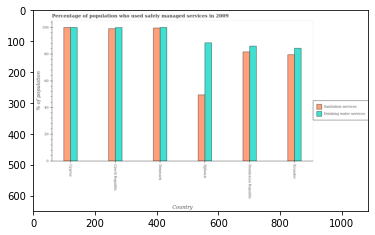

Number of QA =  28





,Country,Drinking water services,Sanitation services
0,Dominican Republic,86.967431,82.591194
1,Djibou ti,89.265399,50.245626
2,Ecuador,85.434299,80.684848
3,Czech Republic,101.312092,99.935925
4,Cy prus,101.002718,100.990291
5,Denmark,100.885899,100.460185


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services in cyprus and that in dominican republic ?
PREDICTED =  -32.34556802511321
EXPECTED =  18.299999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services in denmark and the percentage of population who used drinking water services in czech republic?
PREDICTED =  0.5242596154730705
EXPECTED =  -0.30000000000001137




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services and percentage 

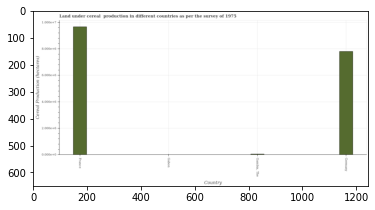

Number of QA =  22





,Country,Cereal Production (hectares)
0,France,34.044755
1,Gabon,NaN
2,"Gambia, The",0.318401
3,Germany,27.617413


> what is the title of the graph ?
PREDICTED =  Land under cereal production in different countries as per the survey of 1975
EXPECTED =  Land under cereal  production in different countries as per the survey of 1975




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Cereal Production (hectares)
EXPECTED =  Cereal Production (hectares)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in france and gambia, the ?
PREDICTED =  33.7263537602469
EXPECTED =  9612200.0




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median land under cereal production ?
PREDICTED 

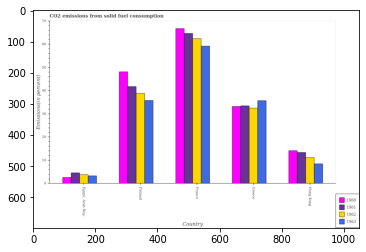

Number of QA =  30





,Country,1963,1962,1961,1960
0,Greece,36.049313,32.759813,33.881287,33.359505
1,Finland,36.241717,39.352679,42.180240,48.593196
2,France,59.486914,62.822453,65.366552,67.610644
3,Hong Kong,8.831114,11.460878,13.699028,14.519191
4,"Egypt, Arab Rep.",3.562665,4.100519,4.827754,2.884092


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in france and that in hong kong ?
PREDICTED =  51.36157423215954
EXPECTED =  51.2780740164726




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in france and the total co2 emitted in 1963 in greece?
PREDICTED =  30.062639304664664
EXPECTED =  26.735843499896106




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted of/in 1963 and total co2 emitted of/in 1962 in finland?
PREDICTED =  104.81904337320475
EXPECTED =  -3.025608233353715




				 1 / 3 = 0.3333


is_built_with_cud

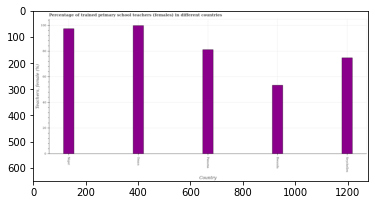

Number of QA =  22





,Country,"Teachers, female (%)"
0,Panama,81.285521
1,Rwanda,53.098861
2,Niger,97.796325
3,Oman,99.705658
4,Seychelles,74.623665


> what is the title of the graph ?
PREDICTED =  Percentage of trained primary school teachers (females) in different count
EXPECTED =  Percentage of trained primary school teachers (females) in different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Teachers, female (%)
EXPECTED =  Teachers, female (%)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained female teachers in niger and panama ?
PREDICTED =  16.51080364921083
EXPECTED =  16.33




				 3 / 4 = 0.75


> what is the median percentage of trained female teachers ?
PREDICTED =  None
EXPECTED =  81.0864181518555




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

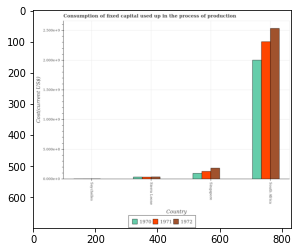

Number of QA =  29





,Country,1972,1971,1970
0,Seychelles,NaN,NaN,NaN
1,Sierra Leone,0.044994,0.041335,NaN
2,South Africa,2.537155,2.313180,2.005268
3,Singapore,0.192455,0.137802,0.106210


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount consumed in the process of production in 1971 in sierra leone and that in singapore ?
PREDICTED =  -0.09646649095368418
EXPECTED =  -96192144.54735109




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount consumed in the process of production in 1970 in south africa and the amount consumed in the process of production in 1971 in seychelles?
PREDICTED =  2.0052676550707327
EXPECTED =  1999527945.4464085




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount consumed in the process of production of/in 1972 and amount consumed in

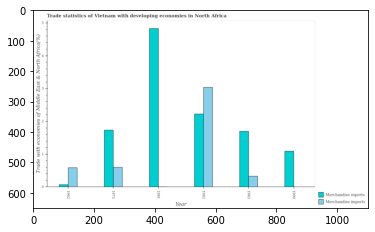

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1990,NaN,1.105285
1,1981,NaN,4.857873
2,1962,0.607450,0.092712
3,1982,3.063132,2.248389
4,1983,0.347627,1.725871
5,1972,0.624539,1.765216


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1981 and that in 1983 ?
PREDICTED =  nan
EXPECTED =  -0.3230746647615065




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1990 and the merchandise exports in 1981?
PREDICTED =  nan
EXPECTED =  -0.0057631412026343445




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in 1981 to that in 1982?
PREDICTED =  2.160601187298471
EXPECTED = 

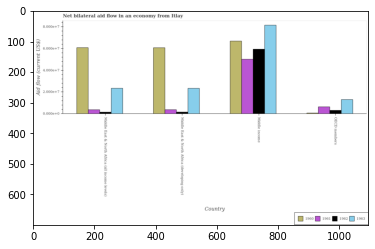

Number of QA =  30





,Country,1963,1962,1961,1960
0,Middle income,8.148487,5.962672,5.021739,6.697675
1,OECD members,1.330286,0.350507,0.680443,NaN
2,Middle East & North Africa (all income levels),2.389823,0.197530,0.422852,6.085287
3,Middle East & North Africa (developing only),2.377936,0.193572,0.429839,6.114446


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1963 in middle east & north africa (all income levels) and that in middle east & north africa (developing only) ?
PREDICTED =  0.011887137900334466
EXPECTED =  40000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1961 in middle east & north africa (all income levels) and the net bilateral aid flow in 1960 in middle income?
PREDICTED =  -2.577148074707127
EXPECTED =  -63240000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

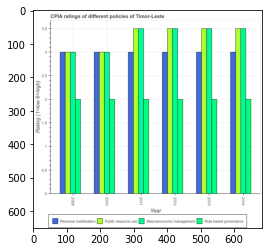

Number of QA =  30





,Year,Public resource use,Revenue mobiization,Macroeconomic management,Rule based govemance
0,2009,3.025863,3.035271,3.036888,2.013123
1,2012,3.596384,3.045563,3.542009,2.032376
2,2014,3.511739,3.055361,3.558950,2.022268
3,2010,3.024708,3.028607,3.037597,2.021960
4,2013,3.548280,3.047178,3.553063,2.032966
5,2011,3.600937,3.027060,3.545976,2.015086


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of rule based governance in 2011 and that in 2012 ?
PREDICTED =  -0.017289295988597964
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of rule based governance in 2010 and the cpia rating of macroeconomic management in 2011?
PREDICTED =  -1.5240157765290072
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating of rule based governance and cpia rating of macroeconomic management ?
PREDICTED =  -2.5589497611679946
EXPECTED =  0.0




				 0 / 3 = 0.0


is_bu

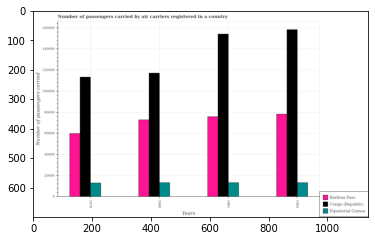

Number of QA =  29





,Years,Congo (Republic),Burkina Faso,Equatorial Guinea
0,1982,160385.606636,79384.339303,13772.200200
1,1979,115283.765468,60859.649596,13524.368487
2,1980,119092.565911,74066.438561,13791.545932
3,1981,155914.372892,77076.909465,13973.481785


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in burkina faso in 1979 and that in 1982 ?
PREDICTED =  -18524.689707235404
EXPECTED =  -18400.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried by air carriers in burkina faso in 1981 and the number of passengers carried by air carriers in equatorial guinea in 1980?
PREDICTED =  3010.470903845722
EXPECTED =  62500.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1981, what is the difference between the number of passengers carried by air carriers in congo (republic) and number of pa

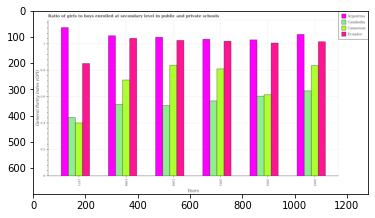

Number of QA =  30





,Years,Cambodia,Argentina,Cameroon,Ecuador
0,1999,0.537510,1.054181,0.841771,1.032435
1,1998,0.544880,1.065579,0.727961,1.046669
2,1971,0.445162,1.126165,0.406726,0.857611
3,2001,0.571475,1.036624,0.820911,1.019897
4,2002,0.608164,1.036048,0.619413,1.004624
5,2003,0.648017,1.076655,0.842554,1.018078


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in cameroon in 1971 and that in 1998 ?
PREDICTED =  -0.3212345612562299
EXPECTED =  -0.32475999999999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in ecuador in 2002 and the general parity index in argentina in 1971?
PREDICTED =  0.14701288350313046
EXPECTED =  -0.11738002593994001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the general parity index in cameroon and general parity index in cambodia ?
PREDICTED =  0.2833529979103421
EXPECTED =  0.19128000736236572




			

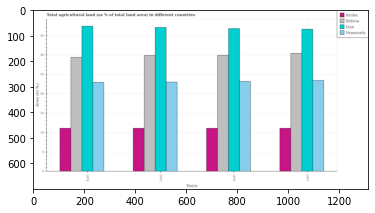

Number of QA =  30





,Years,Bolivia,Aruba,Venezuela,Iran
0,1976,30.393596,11.386172,23.492595,37.320120
1,1974,29.852731,11.338570,23.289691,37.910692
2,1977,30.677131,11.184423,23.778085,37.335700
3,1975,30.386785,11.317081,23.295725,37.767176


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in venezuela in 1974 and that in 1976 ?
PREDICTED =  -0.20290386945311312
EXPECTED =  -0.25622130264730103




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in bolivia in 1975 and the percentage of agricultural land in iran in 1977?
PREDICTED =  -0.29034632635564606
EXPECTED =  -6.7639283155701975




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the percentage of agricultural land in iran and percentage of agricultural land in aruba ?
PREDICTED =  25.9339480944

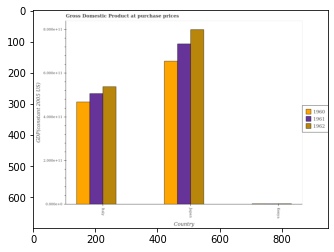

Number of QA =  29





,Country,1962,1961,1960
0,Japan,8.060095,7.373496,6.592602
1,Kenya,NaN,NaN,NaN
2,Italy,5.421685,5.103813,4.728507


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at purchase prices in 1962 in japan and that in kenya ?
PREDICTED =  8.0600951228511
EXPECTED =  796449444682.2072




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at purchase prices in 1961 in kenya and the gdp at purchase prices in 1962 in italy?
PREDICTED =  -5.103813178038178
EXPECTED =  -535642578331.1317




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the gdp at purchase prices in 196

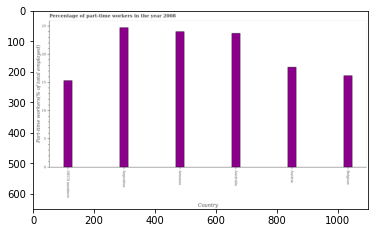

Number of QA =  22





,Country,Part-time workers(% of total employed)
0,Australia,23.885457
1,OECD members,15.485519
2,Austria,17.889491
3,Armenia,24.195986
4,Argentina,24.934379
5,NaN,16.417101


> what is the title of the graph ?
PREDICTED =  Percentage of part-time workers in the year 2008
EXPECTED =  Percentage of part-time workers in the year 2008




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time workers(% of total employed)
EXPECTED =  Part-time workers(% of total employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in armenia and austria ?
PREDICTED =  6.3064947544995285
EXPECTED =  6.3




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  20.887474412116852
EXPECTED =  20.700000

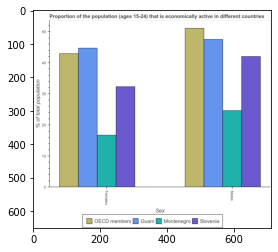

Number of QA =  23





,Sex,OECD members,Guam,Slovenia,Montenegro
0,Males,51.691448,47.605242,41.701932,24.508977
1,Females,42.747073,44.896055,32.457545,16.976416


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in montenegro and that in slovenia ?
PREDICTED =  -17.1929549830784
EXPECTED =  -17.39999961853031




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in slovenia and the percentage of economically active female population in guam?
PREDICTED =  -3.1941232755780646
EXPECTED =  -2.700000762939503




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tr

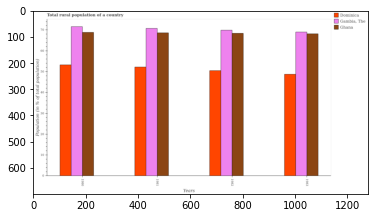

Number of QA =  29





,Years,"Gambia, The",Dominica,Ghana
0,1983,68.411147,48.609004,67.521144
1,1982,69.281317,50.203018,67.833490
2,1980,70.914247,52.914368,68.139352
3,1981,69.982169,51.986345,68.306366


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in gambia, the in 1980 and that in 1983 ?
PREDICTED =  2.5031000102429317
EXPECTED =  2.593999999999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in ghana in 1982 and the rural population in dominica in 1980?
PREDICTED =  -0.30586196563019996
EXPECTED =  15.145000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the rural population in ghana and rural population in gambia, the ?
PREDICTED =  -0.4610588165186158
EXPECTED =  -2.7489999999999952




				 1 / 3 = 0.3333


is_bu

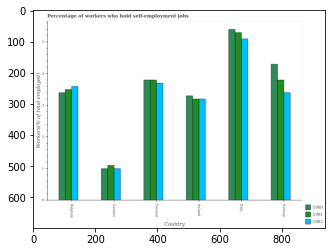

Number of QA =  29





,Country,1982,1980,1981
0,Ireland,3.202681,3.313387,3.206473
1,Norway,3.388187,4.299837,3.807515
2,Finland,3.684721,3.778195,3.792202
3,NaN,3.590137,3.402512,3.498148
4,Canada,1.002911,1.007084,1.112112
5,Italy,5.100803,5.382125,5.316126


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1980 in belgium and that in italy ?
PREDICTED =  -4.37504057600676
EXPECTED =  -1.9999999999999991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1982 in belgium and the percentage of self-employed workers in 1980 in ireland?
PREDICTED =  -2.1997703394282864
EXPECTED =  0.29999995231628995




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers of/in 1981 and percentage of self-employed workers of/in 1980 in ireland?
PREDICTED = 

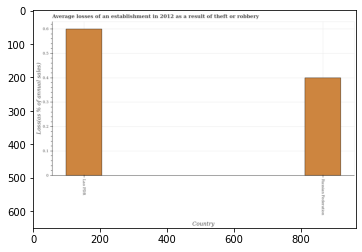

Number of QA =  18





,Country,Loss(as % of annual sales)
0,Lao PDR,0.610297
1,Russian Federation,0.400916


> what is the title of the graph ?
PREDICTED =  Average losses of an establishment in 2012 as a result of theft or robbery
EXPECTED =  Average losses of an establishment in 2012 as a result of theft or robbery




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Loss(as % of annual sales)
EXPECTED =  Loss(as % of annual sales)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the losses due to theft in russian federation ?
PREDICTED =  1.26112754547897
EXPECTED =  0.4




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the losses due to theft in lao pdr and russian federation ?
PREDICTED =  0.5
EXPECTE

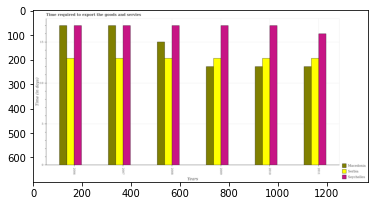

Number of QA =  29





,Years,Seychelles,Serbia,Macedonia
0,2006,17.149903,13.087789,17.103504
1,2008,17.143104,13.080399,15.109412
2,2009,17.100055,13.125853,12.125887
3,2011,16.066801,13.029412,12.089328
4,2007,17.191711,13.093633,17.086971
5,2010,16.960923,13.112841,12.141077


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in macedonia in 2008 and that in 2011 ?
PREDICTED =  4.0
EXPECTED =  3




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in serbia in 2010 and the number of days required to export the goods and services in macedonia in 2006?
PREDICTED =  0.0
EXPECTED =  -4




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of days required to export the goods and services in macedonia and number of days required to exp

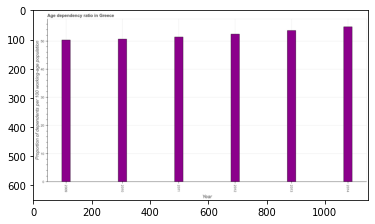

Number of QA =  23





,Year,Proportion of dependents per 100 working-age population
0,2014,55.567260
1,2013,53.975127
2,2009,50.928980
3,2011,51.786857
4,2012,52.509277
5,2010,51.028496


> what is the title of the graph ?
PREDICTED =  Age dependency ratio in Greece
EXPECTED =  Age dependency ratio in Greece




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Proportion of dependents per 100 working-age population
EXPECTED =  Proportion of dependents per 100 working-age population




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in 2010 ?
PREDICTED =  0.9695213910571359
EXPECTED =  50.68187087036621




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio ?
PREDICTED =  38.26520964868385
EXPECTED =  55.0559660889452




				 3 / 5 = 0.6


is_b

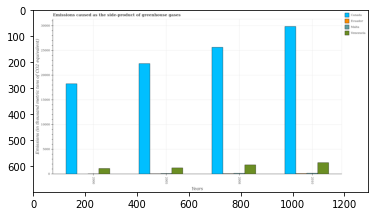

Number of QA =  30





,Years,Malta,Venezuela,Ecuador,Canada
0,2000,NaN,1220.918320,NaN,18467.959859
1,2005,NaN,1333.675536,NaN,22488.034816
2,2008,NaN,1942.814139,NaN,25689.709559
3,2010,NaN,2397.497456,NaN,29996.635274


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in malta in 2005 and that in 2010 ?
PREDICTED =  -7508.600458073179
EXPECTED =  -58.8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in malta in 2000 and the emissions caused as the side-product of greenhouse gases in venezuela in 2005?
PREDICTED =  18467.959859334962
EXPECTED =  -1199.6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished

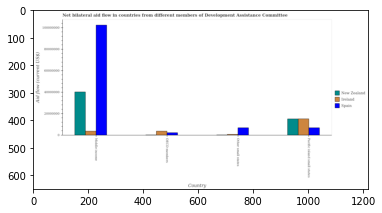

Number of QA =  29





,Country,Spain,New Zealand,Ireland
0,Other small states,7.236183e+06,NaN,NaN
1,Pacific island small states,7.289465e+06,1.540885e+07,1.554121e+07
2,Middle income,1.029236e+08,4.029078e+07,4.112106e+06
3,OECD members,2.593505e+06,NaN,4.104049e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in middle income and that in pacific island small states ?
PREDICTED =  95634124.84430698
EXPECTED =  95600000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in pacific island small states and the amount of aid provided by new zealand in oecd members?
PREDICTED =  0.0
EXPECTED =  6700000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by new zealand and amount of aid provided by spain in oecd members ?
PREDICTED =  -2593503.104129902
EXPECTED =  -2

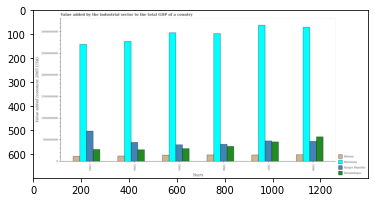

Number of QA =  30





,Years,Kyrgyz Republic,Botswana,Mozambique,Bhutan
0,1994,4.536888e+08,2.803453e+09,2.795719e+08,1.357103e+08
1,1998,4.785669e+08,3.123896e+09,5.781610e+08,1.669999e+08
2,1993,7.208152e+08,2.729080e+09,2.882722e+08,1.286493e+08
3,1996,4.079603e+08,2.978852e+09,3.616204e+08,1.618632e+08
4,1997,4.876249e+08,3.197808e+09,4.624995e+08,1.599280e+08
5,1995,4.003725e+08,2.998984e+09,3.074175e+08,1.582873e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in mozambique in 1996 and that in 1998 ?
PREDICTED =  -216540622.93668938
EXPECTED =  -221155297.97117478




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in bhutan in 1996 and the value added by the industrial sector in kyrgyz republic in 1995?
PREDICTED =  -238509299.89151362
EXPECTED =  -235683914.21058902




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the value added by the industrial sector in bhutan and value added by the industrial sector in

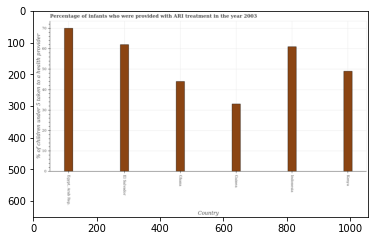

Number of QA =  22





,Country,% of children under 5 taken to a health provider
0,Guinea,33.129037
1,Ghana,44.371588
2,"Egypt, Arab Rep.",70.640189
3,Indonesia,61.324519
4,Kenya,49.428033
5,El Salvador,62.495134


> what is the title of the graph ?
PREDICTED =  Percentage of infants who were provided with ARI treatment in the year 2003
EXPECTED =  Percentage of infants who were provided with ARI treatment in the year 2003




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of children under 5 taken to a health provider
EXPECTED =  % of children under 5 taken to a health provider




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with ari treatment in ghana and kenya ?
PREDICTED =  -5.056444631983624
EXPECTED =  -5.0




				 4 / 4 = 1.0


> what is the median percentage of children who were provided with ari treatment ?
PREDICTED =  None
EXPECTED =  55.0




				 4 / 6 = 0.6667


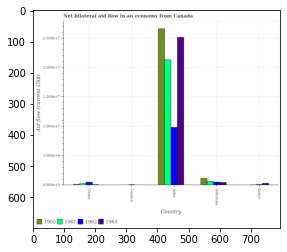

Number of QA =  30





,Country,1963,1962,1961,1960
0,Kenya,0.037633,NaN,NaN,NaN
1,Guyana,NaN,NaN,NaN,NaN
2,Indonesia,0.053798,0.059184,0.069852,0.121514
3,Ghana,NaN,0.056422,0.035953,NaN
4,India,2.516078,0.993927,2.141476,2.688019


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1961 in guyana and that in indonesia ?
PREDICTED =  -0.06985226000240766
EXPECTED =  -580000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 in india and the net bilateral aid flow in 1960 in kenya?
PREDICTED =  0.9939266663703062
EXPECTED =  9790000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in 1962 in gu

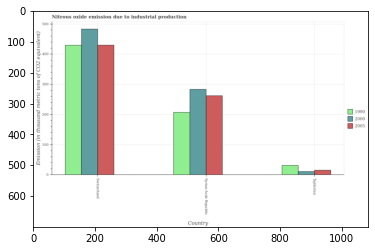

Number of QA =  29





,Country,2005,2000,1990
0,Syrian Arab Republic,266.821121,287.358683,211.839031
1,Tajikistan,17.897626,13.478214,34.003373
2,Switzerland,436.260708,489.668447,434.654669


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in 1990 in switzerland and that in syrian arab republic ?
PREDICTED =  222.81563765483386
EXPECTED =  222.50000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in 2000 in switzerland and the amount of nitrous oxide emitted in 1990 in syrian arab republic?
PREDICTED =  202.30976352476335
EXPECTED =  276.20000000000005




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted of/in 2005 and amount of nitrous oxide emitted of/in 2000 in syrian 

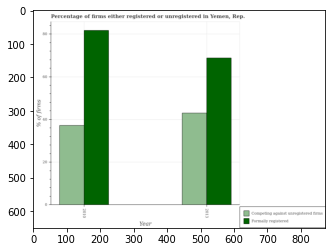

Number of QA =  24





,Year,Formally registered,Competing against unregistered firms
0,2010,82.198925,37.206291
1,2013,68.150571,43.410350


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of formally registered firms in 2010 and that in 2013 ?
PREDICTED =  14.048354579227833
EXPECTED =  12.900000000000006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of formally registered firms in 2010 and the percentage of registered firms in 2013?
PREDICTED =  14.048354579227833
EXPECTED =  12.900000000000006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of formally registered firms and percentage of registered firms ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


i

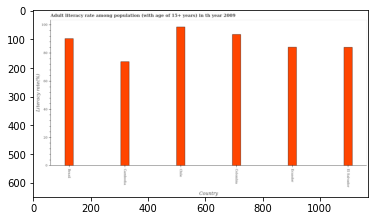

Number of QA =  22





,Country,Literacy rate(%)
0,Brazil,90.374499
1,Chile,98.632974
2,Ecuador,84.122692
3,Cambodia,73.987869
4,Colombia,93.464252
5,El Salvador,84.174066


> what is the title of the graph ?
PREDICTED =  Adult literacy rate among population (with age of 15+ years) in th year 2009
EXPECTED =  Adult literacy rate among population (with age of 15+ years) in th year 2009




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Literacy rate(%)
EXPECTED =  Literacy rate(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adult literacy rate in brazil and ecuador ?
PREDICTED =  6.25180654791545
EXPECTED =  6.091




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median adult literacy rate ?
PREDICTED =  87.27428206221487
EXPECTED =  87.25258636474611




	

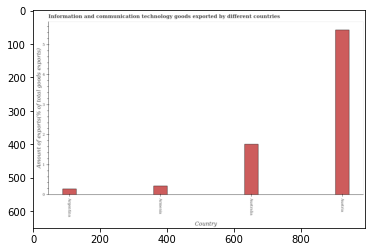

Number of QA =  22





,Country,Amount of exports(% of total goods exports)
0,Armenia,0.316347
1,Argentina,0.217424
2,Austna,5.559654
3,Australia,1.724405


> what is the title of the graph ?
PREDICTED =  Information and communication technology goods exported by different countries
EXPECTED =  Information and communication technology goods exported by different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of exports(% of total goods exports)
EXPECTED =  Amount of exports(% of total goods exports)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods exports in argentina and armenia ?
PREDICTED =  -0.09892313531261551
EXPECTED =  -0.098




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_

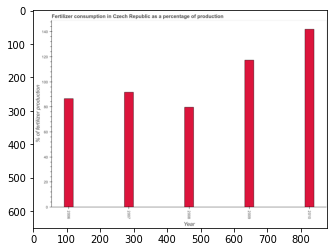

Number of QA =  23





,Year,% of fertilizer production
0,2009,116.920177
1,2008,80.101277
2,2010,141.818772
3,2007,91.732590
4,2006,86.433972


> what is the title of the graph ?
PREDICTED =  Fertilizer consumption in Czech Republic as a percentage of production
EXPECTED =  Fertilizer consumption in Czech Republic as a percentage of production




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of fertilizer production
EXPECTED =  % of fertilizer production




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2006 and 2010 ?
PREDICTED =  -55.38479966540011
EXPECTED =  -55.425




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of fertilizer consumption ?
PREDICTED =  91.73259036397377
EXPECTED

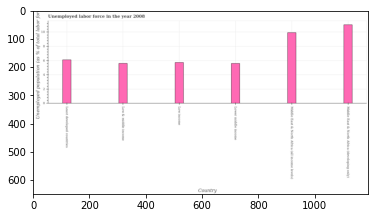

Number of QA =  22





,Country,Unemployed population (as % of total labor for
0,Least developed countries,6.104486
1,Lower middle income,5.599321
2,Low & middle income,5.612980
3,Low income,5.741019
4,Middle East & North Afmica (developing only),10.955750
5,Middle East & North Africa (all income levels),9.896381


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in the year 2008
EXPECTED =  Unemployed labor force in the year 2008




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed population (as % of total labor for
EXPECTED =  Unemployed population (as % of total labor force)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed population in low & middle income and middle east & north africa (all income levels) ?
PREDICTED =  -4.283401371300811
EXPECTED =  -4.32




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed population ?
PRE

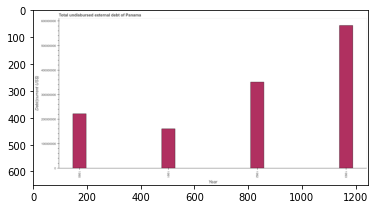

Number of QA =  23





,Year,Debt(current US$)
0,1991,1.618210e+08
1,1990,2.221709e+08
2,1993,5.792740e+08
3,1992,3.514951e+08


> what is the title of the graph ?
PREDICTED =  Total undisbursed external debt of Panama
EXPECTED =  Total undisbursed external debt of Panama




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt(current US$)
EXPECTED =  Debt(current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1991 and 1992 ?
PREDICTED =  -189674129.18370026
EXPECTED =  -190486000.0




				 4 / 4 = 1.0


> what is the median total debt ?
PREDICTED =  None
EXPECTED =  286519500.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt in 1990 to that in 1991 ?
PREDICTED =  1.372942

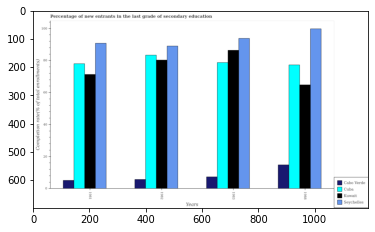

Number of QA =  30





,Years,Seychelles,Cabo Verde,Cuba,Kuwait
0,1988,101.006437,15.291770,78.059558,65.587075
1,1982,89.735878,6.058891,83.666844,81.183449
2,1981,91.889900,5.497459,78.810149,72.193388
3,1983,94.548682,7.671795,79.683938,87.384890


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new entrants in cabo verde in 1981 and that in 1988 ?
PREDICTED =  -9.79431087270059
EXPECTED =  -9.683580000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new entrants in cabo verde in 1981 and the percentage of new entrants in seychelles in 1982?
PREDICTED =  -0.5614324873695846
EXPECTED =  -83.91663




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the percentage of new entrants in cuba and percentage of new entrants in kuwait ?
PREDICTED =  12.472483321103567
EXPECTED =  12.448920000

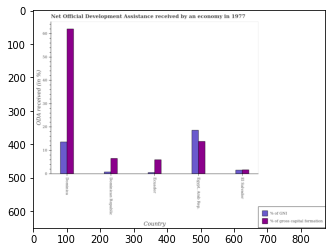

Number of QA =  28





,Country,% of gross capital formation,% of GNI
0,"Egypt, Arab Rep.",14.080516,18.957380
1,Dominican Republic,6.806474,1.009698
2,Dominica,61.896091,13.874250
3,El Salvador,1.892175,1.791338
4,Ecuador,6.239137,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gross capital formation in dominica and that in egypt, arab rep. ?
PREDICTED =  47.81557536713233
EXPECTED =  48.1936495661803




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gross capital formation in dominica and the oda received as percentage of gni in dominican republic?
PREDICTED =  55.089617504003535
EXPECTED =  61.28228750987771




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished af

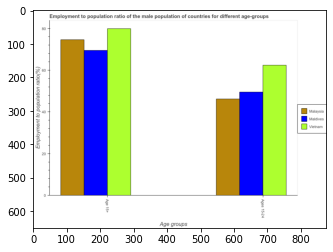

Number of QA =  23





,Age groups,Malaysia,Maldives,Vietnam
0,Ages 15-24,46.733137,50.102759,62.59227
1,Age 15+,75.384287,70.206568,80.61277


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(age 15-24) ?
PREDICTED =  1.0721034950896837
EXPECTED =  46.2000007629395




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

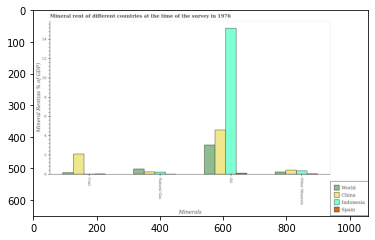

Number of QA =  29





,Minerals,Spain,China,Indonesia,World
0,Coal,NaN,2.174142,NaN,0.225702
1,Natural Gas,NaN,0.312180,0.274610,0.603837
2,Other Minerals,NaN,0.491118,0.402152,0.306026
3,Oil,NaN,4.612168,15.208485,3.091633


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the  rent of other minerals in china and that in indonesia ?
PREDICTED =  0.08896658512813765
EXPECTED =  0.073536575541851




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in spain and the natural gas rent in world?
PREDICTED =  -0.2257021833057335
EXPECTED =  -0.509446119679375




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent and oil rent in china ?
PREDICTED =  0.0
EXPECTED =  -2.4960566786307505




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

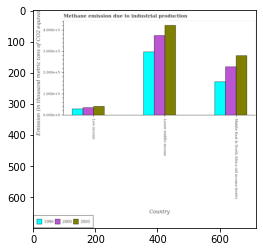

Number of QA =  29





,Country,2005,2000,1990
0,Low income,0.444791,0.378547,0.326241
1,Lower middle income,4.273649,3.816949,3.055994
2,Middle East & North Africa (all income levels),2.839631,2.308681,1.606062


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 2000 in lower middle income and that in middle east & north africa (all income levels) ?
PREDICTED =  1.5082675417487188
EXPECTED =  146708.2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 2000 in lower middle income and the amount of methane emitted in 1990 in middle east & north africa (all income levels)?
PREDICTED =  1.5082675417487188
EXPECTED =  216987.6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted of/in 2000 and amount of methane emitted of/

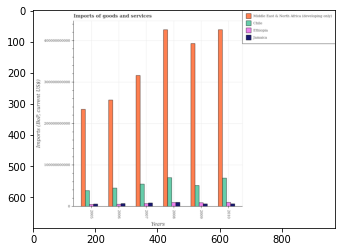

Number of QA =  30





,Years,Middle East & North Africa (developing only),Chile,Jamaica,Ethiopia
0,2005,2.349397e+11,3.980086e+10,7.488291e+09,NaN
1,2009,3.934072e+11,5.230676e+10,7.648420e+09,1.071141e+10
2,2007,3.179429e+11,5.571157e+10,1.003503e+10,8.810418e+09
3,2008,4.282380e+11,7.081553e+10,1.161393e+10,1.121083e+10
4,2006,2.576317e+11,4.637774e+10,8.351408e+09,6.751315e+09
5,2010,4.291670e+11,7.060650e+10,7.594386e+09,1.134060e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in ethiopia in 2008 and that in 2010 ?
PREDICTED =  -129763290.93283272
EXPECTED =  -312857168.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in jamaica in 2007 and the amount spent on imports in middle east & north africa (developing only) in 2005?
PREDICTED =  -224904690032.46835
EXPECTED =  -225769861366.0789




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount spent on imports in middle east & north africa (developing only) and amount spent on imports in ethiop

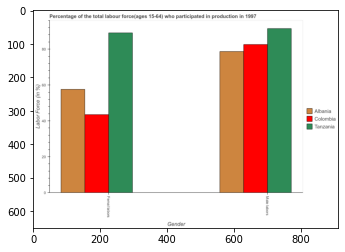

Number of QA =  23





,Gender,Albania,Tanzania,Colombia
0,Male labors,78.916235,91.954498,83.319598
1,Femal labors,57.764188,89.612602,43.820061


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in albania and the percentage of female labor force in tanzania?
PREDICTED =  -13.038263087603667
EXPECTED =  -10.400001525878793




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force and percentage of female labor force in tanzania ?
PREDICTED =  -90.95449830433887
EXPECTED =  2.4000015258790057




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio

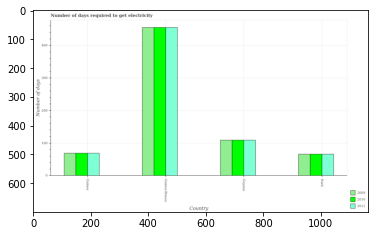

Number of QA =  29





,Country,2011,2010,2009
0,Haitt,67.168089,67.500968,67.040833
1,Guinea,69.807800,70.176934,69.866164
2,Guinea-Bissau,455.174178,456.700136,453.969748
3,Guyana,109.899850,109.794055,110.279188


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in in 2009 in guyana and that in haiti ?
PREDICTED =  -3.0
EXPECTED =  43.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in in 2010 in guyana and the number of days required to get electricity in in 2011 in haiti?
PREDICTED =  -3.0
EXPECTED =  43.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in of/in 2009 and number of days required to get electricity in of/in 2011 in guinea-bissau?
PREDICTED =  -451.

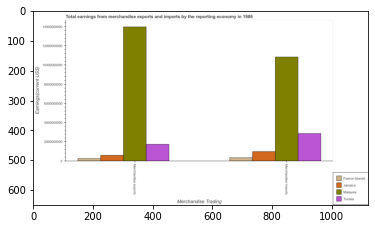

Number of QA =  23





,Merchandise Trading,Faeroe Islands,Malaysia,Tunisia,Jamaica
0,Merchandise imports,3.956887e+08,1.095973e+10,2.946803e+09,1.032283e+09
1,Merchandise exports,3.084953e+08,1.409347e+10,1.798657e+09,6.398097e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in jamaica and that in tunisia ?
PREDICTED =  -1158846934.257626
EXPECTED =  -1146985000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in tunisia and the earnings from merchandise exports in malaysia?
PREDICTED =  -8012930448.441629
EXPECTED =  -11122380000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports and earnings from merchandise exports in malaysia ?
PREDICTED =  -14093467281.922525
EXPECTED =  -3139960000




				 1 / 3 = 0.33

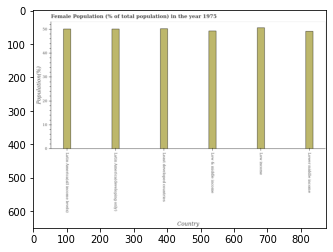

Number of QA =  22





,Country,Population(%)
0,Least developed countries,50.649278
1,Low income,51.280173
2,Low & middle income,49.568293
3,Lower middle income,49.594517
4,Latin America( developing only),50.469109
5,Latin America(all income levels),50.504262


> what is the title of the graph ?
PREDICTED =  Female Population (% of total population) in the year 1975
EXPECTED =  Female Population (% of total population) in the year 1975




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population(%)
EXPECTED =  Population(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in latin america(all income levels) and low & middle income ?
PREDICTED =  0.9359690225130421
EXPECTED =  0.805




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median female population ?
PREDICTED =  50.4866858847862
EXPECTED =  50.104239001633445




				 4

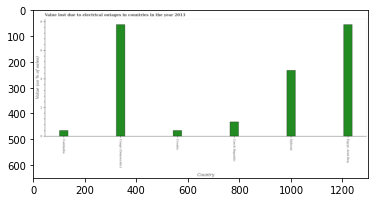

Number of QA =  22





,Country,Value (as % of sales)
0,Cambodia,0.446421
1,Congo (Democratic),7.815641
2,Czech Republic,1.040599
3,Djibouti,4.617972
4,"Egypt, Arab Rep.",7.785245
5,Croatia,0.443363


> what is the title of the graph ?
PREDICTED =  Value lost due to electrical outages in countries in the year 2013
EXPECTED =  Value lost due to electrical outages in countries in the year 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Value (as % of sales)
EXPECTED =  Value (as % of sales)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value lost due to electrical outages in cambodia and czech republic ?
PREDICTED =  -0.5941774286110175
EXPECTED =  -0.6




				 4 / 4 = 1.0


> what is the median value lost due to electrical outages ?
PREDICTED =  None
EXPECTED =  2.8




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished

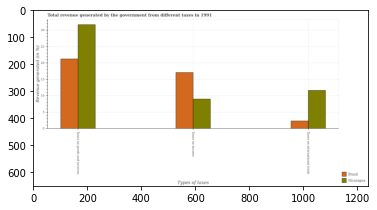

Number of QA =  28





,Types of taxes,Brazil,Nicaragua
0,Taxes on international trade,2.409822,11.728216
1,Taxes on goods and services,21.293800,31.674924
2,Taxes on income,16.967426,9.105425


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on income in nicaragua and that in brazil ?
PREDICTED =  -7.862000762100921
EXPECTED =  -8.099066865812059




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in nicaragua and the percentage of revenue generated by taxes on income in brazil?
PREDICTED =  -8.10542475583348
EXPECTED =  14.6026126886328




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services and percentage of revenue g

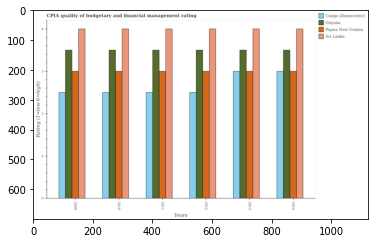

Number of QA =  30





,Years,Papua New Guinea,Congo (Democratic),Sri Lanka,Guyana
0,2011,3.018523,2.510623,3.997990,3.497269
1,2014,3.036745,2.998711,3.994170,3.617507
2,2013,3.046088,3.011131,4.025773,3.509969
3,2010,3.018216,2.513420,4.011920,3.503841
4,2009,3.028700,2.509720,4.004808,3.507223
5,2012,3.016568,2.517708,3.988930,3.565264


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in congo (democratic) in 2010 and that in 2013 ?
PREDICTED =  -0.4977107414853701
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in congo (democratic) in 2010 and the cpia rating in sri lanka in 2014?
PREDICTED =  -0.48529082102153254
EXPECTED =  -1.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in papua new guinea and cpia rating in congo (democratic) ?
PREDICTED =  3.3231146659302007
EXPECTED =  0.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_av

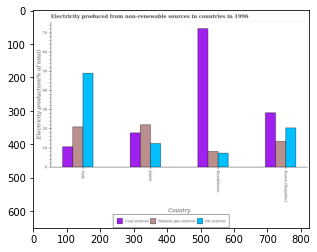

Number of QA =  29





,Country,Coal sources,Oil sources,Natural gas sources
0,Kazakhstan,72.539900,7.713734,8.529843
1,Italy,10.967892,49.480247,21.296103
2,Korea (Republic),28.777771,20.719779,13.588376
3,Japan,18.330888,12.491773,22.382317


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in japan and that in kazakhstan ?
PREDICTED =  13.85247351130036
EXPECTED =  13.943951792135882




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in japan and the percentage of electricity produced by oil sources in kazakhstan?
PREDICTED =  13.85247351130036
EXPECTED =  14.828128085370741




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources and percentage of electricity produced by coal in ital

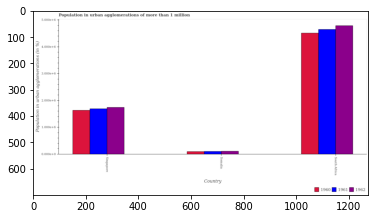

Number of QA =  29





,Country,1962,1961,1960
0,Somalia,0.126967,0.119847,0.119739
1,Singapore,1.754019,1.704770,1.644158
2,South Africa,4.781654,4.641027,4.476597


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in 1961 in south africa ?
PREDICTED =  2.320513602870048
EXPECTED =  4648531.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum population in urban agglomerations in 1962 ?
PREDICTED =  2.3908272137257502
EXPECTED =  4788780.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum population in urban agglomerations in 1960 ?
PREDICTED =  0.05986929148451536
EXPECTED =  93923.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

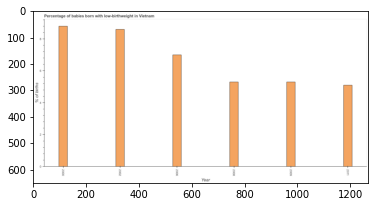

Number of QA =  23





,Year,% of births
0,2002,8.669576
1,2008,5.360073
2,2009,5.341415
3,2006,7.077716
4,2011,5.132188
5,2000,8.884584


> what is the title of the graph ?
PREDICTED =  Percentage of babies born with low-birthweight in Vietnam
EXPECTED =  Percentage of babies born with low-birthweight in Vietnam




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of births
EXPECTED =  % of births




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of babies who were born with low-birthweight in 2008 and 2011 ?
PREDICTED =  0.22788490206955903
EXPECTED =  0.2




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of babies who were born with low-birthweight ?
PREDICTED =  6.2188944279717315
EXPECTED =  6.15




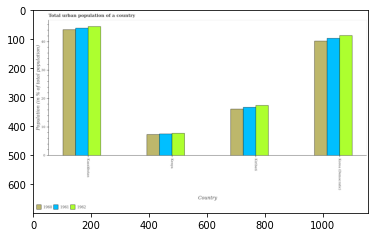

Number of QA =  29





,Country,1962,1961,1960
0,Korea (Democratic),42.300149,41.317977,40.294464
1,Kazakhstan,45.790090,45.007396,44.534754
2,Kiribati,17.752772,17.169255,16.395275
3,Kenya,7.905799,7.745761,7.536193


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1960 in kazakhstan and that in korea (democratic) ?
PREDICTED =  4.240290579654108
EXPECTED =  4.003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1961 in korea (democratic) and the urban population in 1962 in kazakhstan?
PREDICTED =  -3.6894193226966863
EXPECTED =  -4.1340000000000074




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population of/in 1961 and urban population of/in 1962 in kazakhstan?
PREDICTED =  -0.7826942018391989
EXPECTED =  -0.5500000000000043




				 0 / 3 = 0.0




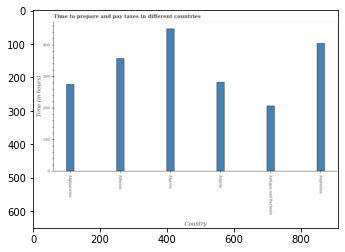

Number of QA =  22





,Country,Time (in hours)
0,Afghanistan,276.474984
1,Albania,357.648807
2,Angola,283.839627
3,Antigua and Barbuda,208.178003
4,NaN,453.603393
5,Argentina,407.215975


> what is the title of the graph ?
PREDICTED =  Time to prepare and pay taxes in different countries
EXPECTED =  Time to prepare and pay taxes in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Time (in hours)
EXPECTED =  Time (in hours)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to prepare and pay taxes in algeria and argentina ?
PREDICTED =  -199.0379721613656
EXPECTED =  46.0




				 3 / 4 = 0.75


> what is the median time to prepare and pay taxes ?
PREDICTED =  None
EXPECTED =  319.5




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time 

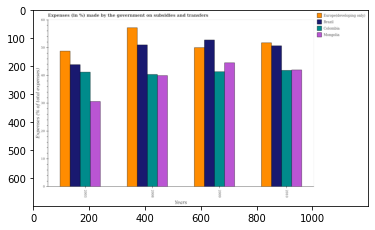

Number of QA =  30





,Years,Mongolia,Europe(developing only),Brazil,Colombia
0,2003,30.739724,49.056827,44.099236,41.461356
1,2010,42.438757,52.000954,51.000555,42.054510
2,2008,40.233504,57.656920,51.425312,40.739283
3,2009,44.692587,50.332733,52.944547,41.588122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on subsidies and transfers in mongolia in 2003 and that in 2009 ?
PREDICTED =  -44.69258704717844
EXPECTED =  -13.9325022154258




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on subsidies and transfers in brazil in 2003 and the percentage of expenses made by the government on subsidies and transfers in mongolia in 2009?
PREDICTED =  -52.94454681761818
EXPECTED =  -0.6701884859863014




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between

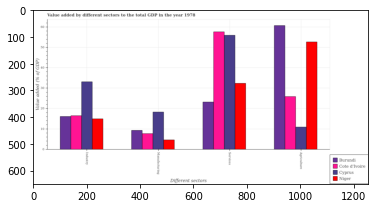

Number of QA =  29





,Different sectors,Burundi,Cyprus,Cote d'Ivoire,Niger
0,Industry,16.419138,33.532865,16.818756,15.111154
1,Services,23.381942,56.352817,58.155945,32.706883
2,Manufacturing,9.565701,18.580231,7.981173,4.798675
3,Agriculture,61.372146,11.128913,26.085951,53.157105


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in niger and that in cote d'ivoire ?
PREDICTED =  -25.44906119757713
EXPECTED =  -25.277182093842598




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in niger and the value added by services sector in cote d'ivoire?
PREDICTED =  -3.1824972906178592
EXPECTED =  -53.02166408526342




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector and value added by services sector in burundi ?
PREDICTED =  -31.947642525188485
EXPECTED =  -13.9041793252359

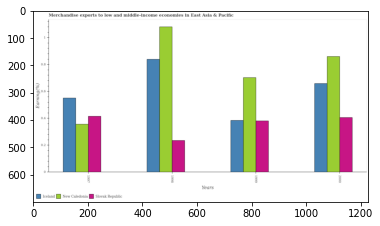

Number of QA =  29





,Years,Iceland,New Caledonia,Slovak Republic
0,2000,0.664747,0.863555,0.410172
1,1998,0.846080,1.085203,0.238759
2,1997,0.556590,0.359367,0.420448
3,1999,0.387443,0.709176,0.386468


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in slovak republic in 1997 and that in 1998 ?
PREDICTED =  0.18168905475836092
EXPECTED =  0.18011702824259299




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in slovak republic in 2000 and the percentage of amount earned from merchandise exports in new caledonia in 1997?
PREDICTED =  -0.010276549151107595
EXPECTED =  0.04970015182932003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of amount earned 

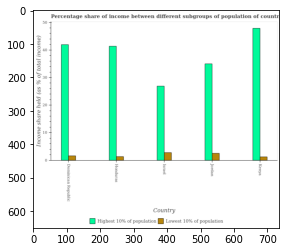

Number of QA =  28





,Country,Lowest 10% of population,Highest 10% of population
0,Dominican Republic,1.844999,42.176973
1,Israel,3.049329,27.319420
2,Jordan,2.802940,35.330737
3,Kenya,1.544223,48.154585
4,Honduras,1.608731,41.787950


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in honduras and that in kenya ?
PREDICTED =  0.06450799506751204
EXPECTED =  0.10000000000000009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population in honduras and the income share held by lowest 10% of the population in dominican republic?
PREDICTED =  -0.38902316042818086
EXPECTED =  39.76




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population and income share held by highest 10% of the populat

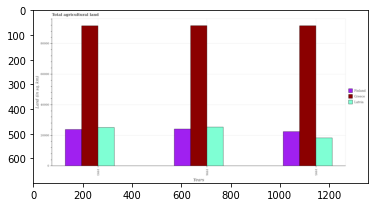

Number of QA =  29





,Years,Latvia,Finland,Greece
0,1994,25528.291307,24157.448533,91216.900601
1,1995,18426.764879,22595.320226,92004.383596
2,1993,25338.367849,24197.430607,91781.909857


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total agricultural land in greece in 1994 and that in 1995 ?
PREDICTED =  -787.4829948029219
EXPECTED =  60




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total agricultural land in greece in 1993 and the total agricultural land in latvia in 1994?
PREDICTED =  565.0092557813477
EXPECTED =  66200.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the total agricultural land in greece and total agricultural land in latvia ?
PREDICTED =  22710.959561790383
EXPECTED =  66300.0




				 0 / 3 = 0.0


is_built_with_cuda: True


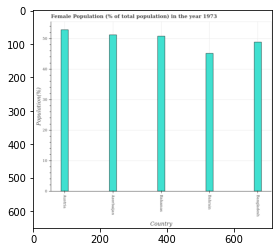

Number of QA =  22





,Country,Population(%)
0,Azerbaijan,51.502364
1,Bangladesh,49.284720
2,Bahamas,51.049174
3,Austra,53.213978
4,Bahrain,45.302514


> what is the title of the graph ?
PREDICTED =  Female Population (% of total population) in the year 1973
EXPECTED =  Female Population (% of total population) in the year 1973




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population(%)
EXPECTED =  Population(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in austria and bangladesh ?
PREDICTED =  3.9292579290013308
EXPECTED =  4.045




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median female population ?
PREDICTED =  51.04917356337281
EXPECTED =  50.8124459333624




				 5 / 5 = 1.0


is_built_with_cuda: Tru

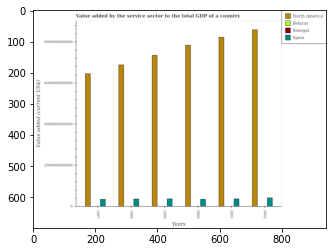

Number of QA =  30





,Years,North America,Spain,Senegal,Belarus
0,1998,6.920220e+12,3.955690e+11,NaN,NaN
1,2000,7.879087e+12,3.727786e+11,NaN,NaN
2,2001,8.338103e+12,3.944576e+11,NaN,NaN
3,1997,6.487923e+12,3.723477e+11,NaN,NaN
4,1999,7.371966e+12,4.016649e+11,NaN,NaN
5,2002,8.567955e+12,4.438922e+11,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in senegal in 1998 and that in 1999 ?
PREDICTED =  6920220234669.959
EXPECTED =  -46565944.87739992




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in senegal in 1998 and the value added by the service sector to the total gdp in belarus in 2001?
PREDICTED =  -1417883139339.1445
EXPECTED =  -2920723747.46206




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

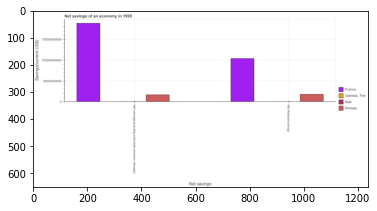

Number of QA =  20





,Net savings,"Gambia, The",Mali,Norway,France
0,Net National savings,NaN,NaN,1.909745e+10,1.051485e+11
1,Net savings(ex du ding particulate emission da...,NaN,NaN,1.796202e+10,1.906236e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in mali and that in norway ?
PREDICTED =  -19097447436.95311
EXPECTED =  -17408498511.833363




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net savings(excluding particulate emission damage) in norway to that in france ?
PREDICTED =  0.09422768172010511
EXPECTED =  0.08793126473266742




				 0 / 4 = 0.0


> what is the difference between two consecutive major t

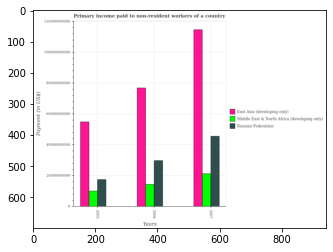

Number of QA =  29





,Years,East Asia (developing only),Middle East & North Africa (developing only),Russian Federation
0,2005,5.527884e+10,1.037357e+10,1.790676e+10
1,2006,7.742964e+10,1.464436e+10,3.001644e+10
2,2007,1.155027e+11,2.151484e+10,4.556594e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the amount paid to workers in russian federation maximum?
PREDICTED =  0.9990034877927254
EXPECTED =  2007




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the amount paid to workers in russian federation minimum?
PREDICTED =  1.0
EXPECTED =  2005




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount paid to workers in east asia (developing only) in 2006 and that in 2007 ?
PREDICTED =  -38073107494.26669
EXPECTED =  -37773377233.11699




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished afte

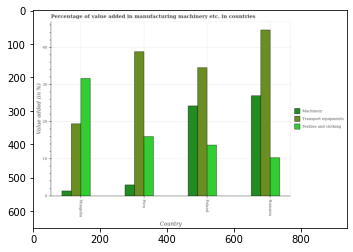

Number of QA =  29





,Country,Transport equipments,Textiles and clothing,Machinery
0,Mongolia,19.522620,31.715067,1.502531
1,Romania,44.733419,10.445371,26.945660
2,Peru,38.860357,16.058568,3.076060
3,Poland,34.441140,13.699422,24.386451


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing transport equipments in mongolia and that in romania ?
PREDICTED =  -25.21079916005861
EXPECTED =  -25.2424323582809




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing textile and clothing in poland and the value added in manufacturing transport equipments in mongolia?
PREDICTED =  37.47728716973678
EXPECTED =  -5.749018924322801




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing textile and clothing and value added in manufacturing machinery in mongolia 

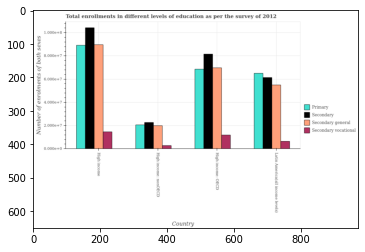

Number of QA =  30





,Country,Secondary general,Secondary,Primary,Secondary vocational
0,High income,31.508544,36.349101,31.570262,5.216134
1,High income: nonOECD,7.085632,NaN,7.355531,1.127554
2,Latin America(all income levels),19.340034,21.599939,22.896506,2.416260
3,High income: OECD,24.514136,28.662854,24.126158,4.306509


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary general education in high income: nonoecd and that in latin america(all income levels) ?
PREDICTED =  6.085631838966937
EXPECTED =  -35074680.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education in latin america(all income levels) and the number of enrolments in primary education in high income?
PREDICTED =  17.599939318209568
EXPECTED =  -27797292.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary vocational education and numbe

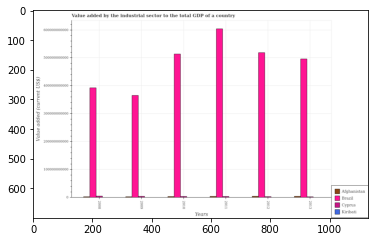

Number of QA =  30





,Years,Cyprus,Brazil,Afghanistan,Kiribati
0,2013,NaN,5.042071e+11,NaN,NaN
1,2011,NaN,6.160408e+11,NaN,NaN
2,2009,NaN,3.696170e+11,NaN,NaN
3,2010,NaN,5.228368e+11,NaN,NaN
4,2012,NaN,5.257122e+11,6.515143e+09,NaN
5,2008,6.848188e+09,3.962357e+11,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the value added by the industrial sector to the total gdp in brazil in 2008 to that in 2010?
PREDICTED =  3.1481334115555972
EXPECTED =  0.7643460968340745




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest va

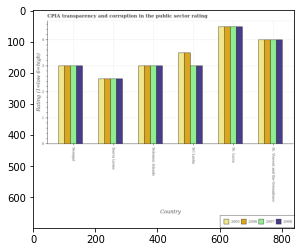

Number of QA =  30





,Country,2007,2005,2008,2006
0,St. Lucia,4.484149,4.497371,4.476917,4.495006
1,Sri Lanka,2.989121,3.490633,3.007434,3.481995
2,Solomon Islands,3.007804,2.998333,2.986971,3.010872
3,St. Vincent and the Grenadines,3.984599,3.982483,4.005038,3.999720
4,Sierra Leone,2.500914,2.481032,2.500696,2.512611
5,Senegal,3.019528,2.991226,3.018205,3.014334


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in st. lucia and that in st. vincent and the grenadines ?
PREDICTED =  0.5148875391146994
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in senegal and the cpia rating in 2008 in st. vincent and the grenadines?
PREDICTED =  -0.9912571252084121
EXPECTED =  -1.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in 2008 in solo

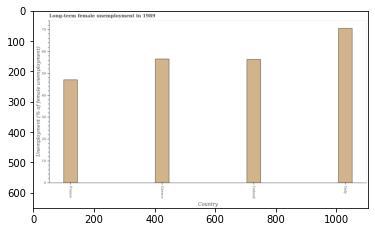

Number of QA =  22





,Country,Unemployment (% of female unemployment)
0,Greece,56.881839
1,France,47.231565
2,Italy,70.860883
3,Ireland,56.484873


> what is the title of the graph ?
PREDICTED =  Long-term female unemployment in 1989
EXPECTED =  Long-term female unemployment in 1989




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployment (% of female unemployment)
EXPECTED =  Unemployment (% of female unemployment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term female unemployment in france and greece ?
PREDICTED =  -9.650274162193519
EXPECTED =  -9.5




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term female unemployment ?
PREDICTED =  56.68335597405128
EXPECTED =  56.5




				 5 / 5 = 1.0


is_buil

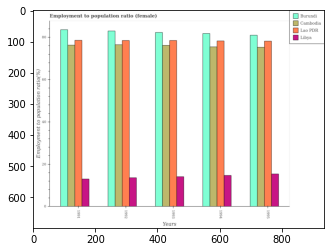

Number of QA =  30





,Years,Unnamed: 1,Cambodia,Burundi,Lao PDR
0,1994,14.965466,75.927574,82.154893,78.471537
1,1992,13.864349,77.109601,83.444169,78.983756
2,1993,14.331346,76.615933,82.685738,78.675632
3,1995,15.684112,75.732305,81.346554,78.344860
4,1991,13.213494,76.768738,84.016139,79.059688


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in burundi in 1995 ?
PREDICTED =  24.524701988669666
EXPECTED =  81.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in libya ?
PREDICTED =  1.0
EXPECTED =  15.3999996185303




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in libya ?
PREDICTED =  1.0
EXPECTED =  13.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to po

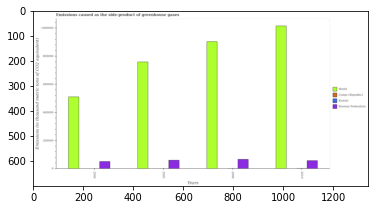

Number of QA =  30





,Years,Congo (Republic),Russian Federation,World,Kuwait
0,2010,NaN,59894.142354,1.017928e+06,NaN
1,2000,NaN,53279.327873,5.132300e+05,NaN
2,2008,NaN,68881.285017,9.036827e+05,NaN
3,2005,NaN,62119.004435,7.635212e+05,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total emissions caused as the side-product of greenhouse gases in russian federation in the graph ?
PREDICTED =  1.0
EXPECTED =  234007.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in world in 2008 and the emissions caused as the side-product of greenhouse gases in kuwait in 2005?
PREDICTED =  140161.5255542692
EXPECTED =  903058.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> 

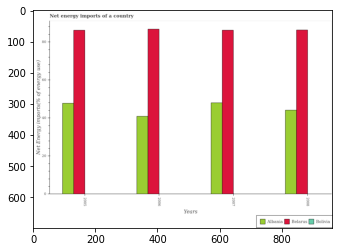

Number of QA =  26





,Years,Belarus,Bolivia,Albania
0,2005,86.430470,NaN,47.904656
1,2008,86.755829,NaN,44.402746
2,2007,86.659553,NaN,48.469022
3,2006,87.291458,NaN,41.134954


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in belarus in 2005 and that in 2006 ?
PREDICTED =  -0.860988651755008
EXPECTED =  -0.5843447441326077




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net energy imports in albania in 2007 and the net energy imports in bolivia in 2005?
PREDICTED =  0.5643657855901338
EXPECTED =  47.9983914429519




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net energy imports in albania and net energy imports in belarus ?
PREDICTED =  95.12704999402061
EXPECTED =  -45.85524668737311




				 0 / 3 = 0.0


is_built

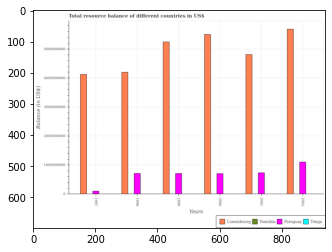

Number of QA =  25





,Years,Luxembourg,Tonga,Namibia,Paraguay
0,1999,5.247960e+09,NaN,NaN,7.244514e+08
1,1997,4.131716e+09,NaN,NaN,1.199430e+08
2,2000,5.513145e+09,NaN,NaN,7.185424e+08
3,1998,4.209376e+09,NaN,NaN,7.257128e+08
4,2001,4.782283e+09,NaN,NaN,7.453423e+08
5,2002,5.698344e+09,NaN,NaN,1.120139e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in luxembourg in 1999 and that in 2001 ?
PREDICTED =  465677305.9297848
EXPECTED =  434823219.50298023




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in paraguay in 2000 and the total resource balance in namibia in 2001?
PREDICTED =  -26799845.293471098
EXPECTED =  704419808.682432




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total resource balance in luxembourg in 1997 to that in 2001?
PREDICTED =  0.8639630362873426
EXPECTED =  0.8573922680527203




				 1 / 3 = 0.3333


is_built_with_cuda: T

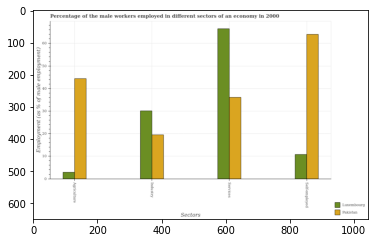

Number of QA =  29





,Sectors,Luxembourg,Pakistan
0,Agriculture,3.212827,44.300880
1,Self-em ployed,10.965787,63.608205
2,Services,66.086996,36.153754
3,Industry,30.075170,19.688031


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in industry in luxembourg and that in pakistan ?
PREDICTED =  10.387138721941813
EXPECTED =  10.600000381469691




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in services in luxembourg and the percentage of male workers in agriculture in pakistan?
PREDICTED =  21.786115502601447
EXPECTED =  22.0999984741211




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in agriculture and percentage of self employed male workers in pakistan ?
PREDICTED =  -19.3073245832

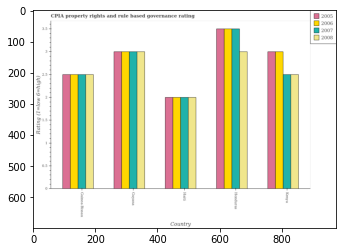

Number of QA =  30





,Country,2007,2005,2008,2006
0,Haiti,2.020503,2.023912,2.027006,2.022884
1,Kenya,2.513909,3.019755,2.509858,3.027783
2,Guyana,3.032457,3.031130,3.032372,NaN
3,Guinea-Bissau,2.535646,2.528409,2.509573,2.518353
4,Honduras,3.545228,3.525386,3.023241,3.536181


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in guinea-bissau and that in guyana ?
PREDICTED =  -0.5227994718868922
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in kenya and the cpia rating in 2005 in guinea-bissau?
PREDICTED =  0.0002852264384629599
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2008 and cpia rating of/in 2007 in haiti?
PREDICTED =  0.006503037376761167
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

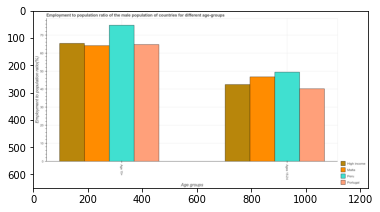

Number of QA =  23





,Age groups,Peru,Portugal,Malta,High income
0,Age 15+,75.497201,64.832775,64.645929,65.849802
1,Ages 15-24,49.838481,40.360090,47.090958,42.875182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio(age 15+) in high income ?
PREDICTED =  0.8255528574096912
EXPECTED =  65.3395877943727




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum employment to population ratio(age 15+) ?
PREDICTED =  0.8722151357845699
EXPECTED =  75.4000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(age 15-24) ?
PREDICTED =  0.8602826870916626
EXPECTED =  40.2000007629395




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished

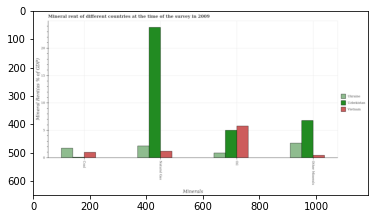

Number of QA =  29





,Minerals,Uzbekistan,Ukraine,Vietnam
0,Coal,NaN,1.838384,1.077365
1,Other Minerals,6.874294,2.738966,0.524124
2,Natural Gas,23.786198,2.256671,1.274123
3,Oil,5.113552,0.960004,5.863937


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in uzbekistan and that in ukraine ?
PREDICTED =  -0.8383838916711148
EXPECTED =  -1.6474288763131462




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in vietnam and the natural gas rent in uzbekistan?
PREDICTED =  0.7503849398302558
EXPECTED =  -18.01696651498015




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the natural gas rent and  rent of other minerals in vietnam ?
PREDICTED =  23.262074272452793
EXPECTED =  0.753551948590558




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

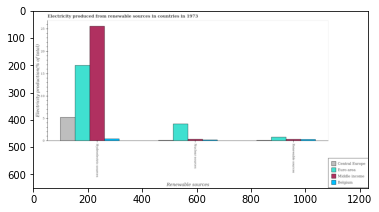

Number of QA =  28





,Renewable sources,Belgium,Central Europe,Middle income,Euro area
0,Hydroelectric sources,NaN,5.340574,25.665466,16.908012
1,Renewable sources,0.455114,NaN,NaN,1.004728
2,Nuclear sources,NaN,NaN,NaN,3.888619


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in central europe and that in belgium ?
PREDICTED =  1.0
EXPECTED =  -0.1011133704439109




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of electricity produced by hydroelectric sources in middle income to that in belgium ?
PREDICTED =  1.0
EXPECTED =  60.829413899613016




				 0 / 4 = 0.0


is_built_with_cuda: True
is

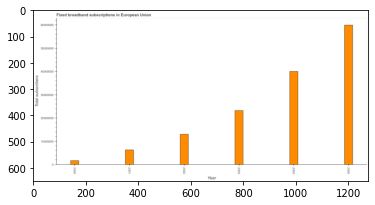

Number of QA =  23





,Year,Total subscribers
0,2000,1.941303e+06
1,2002,1.322102e+07
2,2003,2.330414e+07
3,2005,5.968391e+07
4,2004,4.034223e+07
5,2001,6.506304e+06


> what is the title of the graph ?
PREDICTED =  Fixed broadband subscriptions in European Union
EXPECTED =  Fixed broadband subscriptions in European Union




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total subscribers
EXPECTED =  Total subscribers




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of fixed broadband subscriptions in 2000 and 2004 ?
PREDICTED =  -38400929.9807501
EXPECTED =  -38353767.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total number of fixed broadband subscriptions ?
PREDICTED =  59683906.96357244
EXPECTED =  18116697.665




				 4 / 5 = 0

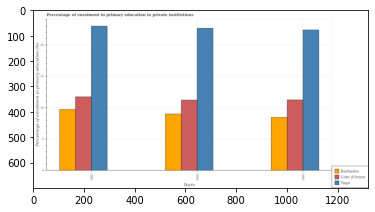

Number of QA =  29





,Years,Togo,Cote d'Ivoire,Barbados
0,1983,23.074924,11.794689,9.830738
1,1984,22.846107,11.320879,9.149581
2,1985,22.317673,11.323362,8.541034


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of enrolment in primary education in cote d'ivoire in 1983 and that in 1985 ?
PREDICTED =  0.4713269320938611
EXPECTED =  0.49447999999999936




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of enrolment in primary education in togo in 1983 and the percentage of enrolment in primary education in cote d'ivoire in 1984?
PREDICTED =  11.754044861965253
EXPECTED =  11.790209999999998




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the percentage of enrolment in primary education in cote d'ivoire and perc

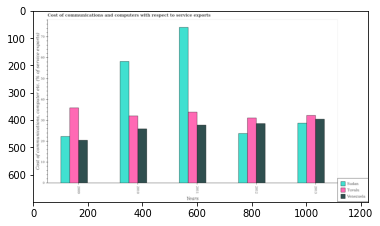

Number of QA =  29





,Years,Tuvalu,Venezuela,Sudan
0,2013,32.563883,30.741624,28.838149
1,2011,33.951197,27.935423,75.114541
2,2012,31.464612,28.614805,23.896201
3,2010,32.337466,26.118151,58.439888
4,2009,36.153448,20.861396,22.548877


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in tuvalu in 2009 and that in 2013 ?
PREDICTED =  3.589564968016802
EXPECTED =  3.6103638002044036




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in tuvalu in 2009 and the cost of communications and computers in sudan in 2013?
PREDICTED =  3.589564968016802
EXPECTED =  7.317917680215704




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the cost of communications and computers in sudan and cost of communications and computers in tuvalu ?
PREDICTED = 

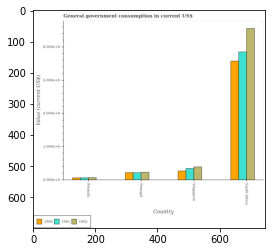

Number of QA =  29





,Country,1962,1961,1960
0,Rwanda,0.168809,0.162093,0.156970
1,Singapore,0.808166,0.713994,0.565040
2,Senegal,0.485549,0.460787,0.472838
3,South Africa,9.121115,7.735111,7.154394


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in 1962 in rwanda and that in senegal ?
PREDICTED =  -0.3167406026261543
EXPECTED =  -32263386.888459213




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the government conusmption in 1961 in rwanda to that in senegal?
PREDICTED =  0.3517751244963221
EXPECTED =  0.2894797408973164




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Traini

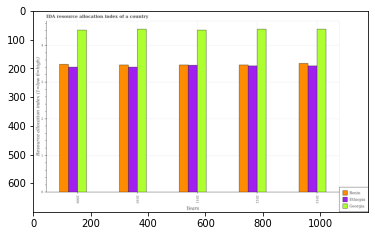

Number of QA =  29





,Years,Georgia,Ethiopia,Benin
0,2009,4.432293,3.422859,3.498235
1,2012,4.488026,3.446409,3.475302
2,2011,4.436559,3.476481,3.488065
3,2013,4.479173,3.423024,3.512559
4,2010,4.486248,3.421293,3.473196


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in ethiopia in 2011 and that in 2013 ?
PREDICTED =  0.05345726456112043
EXPECTED =  0.016666666666659946




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in georgia in 2011 and the ida resource allocation index in benin in 2012?
PREDICTED =  -0.051466283395513734
EXPECTED =  0.9499999999999997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the ida resource allocation index in ethiopia and ida resource allocation index in benin ?
PREDICTED =  13.70059415573093
EX

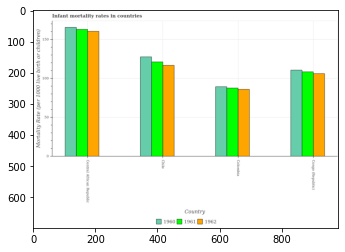

Number of QA =  29





,Country,1962,1961,1960
0,Congo (Republic),106.877939,109.630232,111.392851
1,Colombia,86.699640,88.415292,90.159652
2,Central African Republic,160.831379,164.205637,166.786547
3,Chile,118.282191,121.712580,128.435422


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in 1960 in colombia and that in congo (republic) ?
PREDICTED =  -21.23319827861357
EXPECTED =  -21.299999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in 1961 in central african republic and the infant mortality rate in 1962 in congo (republic)?
PREDICTED =  27.28770257597924
EXPECTED =  56.80000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate of/in 1962 and infant mortality rate of/in 1961 in central african republic?
PREDICTED =  -77.5059969981151

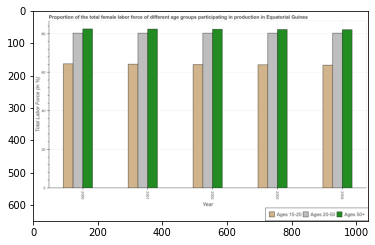

Number of QA =  29





,Year,Ages 20-50,Ages 50+,Ages 15-20
0,2003,80.719898,82.736288,64.498437
1,2004,80.884109,82.945665,64.468937
2,2002,80.925102,83.034512,64.687897
3,2000,80.855725,82.913257,65.066349
4,2001,80.863287,83.091202,64.765325


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force above age 50 in 2001 and that in 2002 ?
PREDICTED =  0.056689936559678245
EXPECTED =  0.09999847412110796




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female labor force above age 50 in 2002 to that in 2004?
PREDICTED =  1.0
EXPECTED =  1.0024361093952985




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

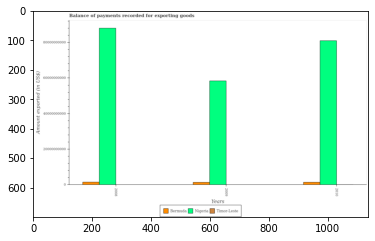

Number of QA =  29





,Years,Timor-Leste,Bermuda,Nigeria
0,2008,NaN,1.832670e+09,8.945716e+10
1,2009,NaN,1.717738e+09,5.867159e+10
2,2010,NaN,1.748111e+09,8.210748e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in bermuda in 2008 and that in 2010 ?
PREDICTED =  84558959.20920873
EXPECTED =  72141509.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in nigeria in 2010 and the amount exported in bermuda in 2009?
PREDICTED =  23435892413.52452
EXPECTED =  79619617852.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount exported in nigeria and amount exported in bermuda ?
PREDICTED =  224937709066.20645
EXPECTED =  79558959458.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available

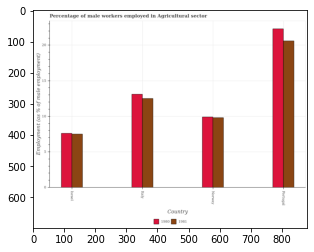

Number of QA =  28





,Country,1980,1981
0,Israel,7.676658,7.544229
1,Norway,9.914852,9.800072
2,Italy,13.044920,12.500095
3,Portugal,22.308250,20.534383


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1981 in israel and that in norway ?
PREDICTED =  -2.2558433857505067
EXPECTED =  -2.3000001907348597




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1980 in norway and the percentage of male workers employed in agricultural sector in 1981 in italy?
PREDICTED =  -2.5852428126792013
EXPECTED =  -2.60000038146973




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sect

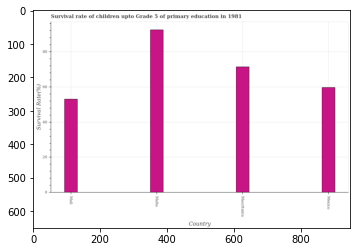

Number of QA =  22





,Country,Survival Rate(%)
0,Mah,53.359298
1,Malta,92.852250
2,NaN,59.964610
3,Mauritania,71.688341


> what is the title of the graph ?
PREDICTED =  Survival rate of children upto Grade 5 of primary education in 1981
EXPECTED =  Survival rate of children upto Grade 5 of primary education in 1981 




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Survival Rate(%)
EXPECTED =  Survival Rate(%)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate in mauritania and mexico ?
PREDICTED =  71.68834128100355
EXPECTED =  11.753




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median survival rate ?
PREDICTED =  65.82647550687113
EXPECTED =  65.545295




				 3 / 5 = 0.6


is_built_wi

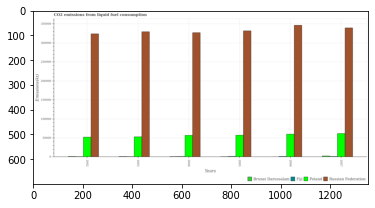

Number of QA =  30





,Years,Fiji,Brunei Darussalam,Russian Federation,Poland
0,2003,NaN,NaN,326812.119059,53612.647709
1,2007,NaN,3762.096749,338274.569691,62025.267885
2,2005,NaN,NaN,330094.899943,56912.314791
3,2006,NaN,NaN,343827.097983,60113.127148
4,2004,NaN,NaN,324942.295186,56656.692849
5,2002,NaN,NaN,322116.400944,52564.249638


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum amount of co2 emitted in russian federation ?
PREDICTED =  68765.41959657462
EXPECTED =  346348.15




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum amount of co2 emitted in russian federation ?
PREDICTED =  400.4
EXPECTED =  323799.767




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in brunei darussalam in 2002 and that in 2006 ?
PREDICTED =  0.0
EXPECTED =  814.0739999999998




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after 

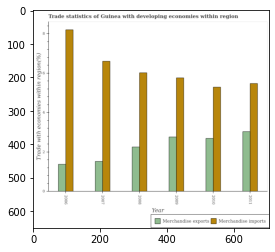

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,2006,8.243937,1.411214
1,2008,5.996044,2.263258
2,2009,5.785850,2.739762
3,2010,5.288112,2.717135
4,2011,5.544768,3.046329
5,2007,6.604388,1.551638


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2009 and that in 2010 ?
PREDICTED =  0.4977386854439221
EXPECTED =  0.47168688109730006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2008 and the merchandise imports in 2010?
PREDICTED =  -0.45387751802305276
EXPECTED =  -0.4344822599453302




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  -34.416769727335016
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Train

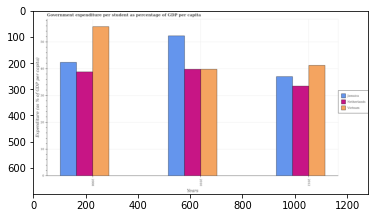

Number of QA =  29





,Years,Jamaica,Netherlands,Vietnam
0,2012,37.159215,33.918289,41.232477
1,2008,42.365760,39.019823,55.770040
2,2010,52.363779,39.944594,39.902371


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure per student in netherlands in 2008 and that in 2010 ?
PREDICTED =  -0.9247717274223675
EXPECTED =  -0.9547996520996023




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure per student in vietnam in 2008 and the percentage of expenditure per student in jamaica in 2010?
PREDICTED =  15.86766900406056
EXPECTED =  3.4361190795899006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of expenditure per student in jamaica and percentage of expenditure per student in vi

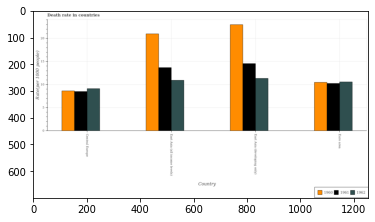

Number of QA =  29





,Country,1962,1961,1960
0,Euro area,10.646236,10.207465,10.557324
1,Central Europe,9.130226,8.582075,8.796902
2,East Asia (developing only),11.397314,14.591572,23.019495
3,East Asia (all income levels),11.000629,13.727984,21.085410


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in 1960 in central europe and that in euro area ?
PREDICTED =  -1.7604224814029603
EXPECTED =  -1.8538433634830476




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in 1961 in east asia (all income levels) and the death rate in 1960 in central europe?
PREDICTED =  2.57295451183953
EXPECTED =  5.0483923411280465




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate of/in 1961 and death rate of/in 1962 in east asia (all income levels)?
PREDICTED =  3.590943044289668
EXPECTED =  2.7522235980523




				 0 / 3 = 0

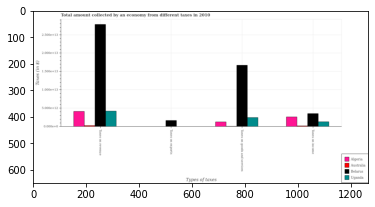

Number of QA =  29





,Types of taxes,Belarus,Algeria,Australia,Uganda
0,Taxes on goods and services,1.699881,0.139129,NaN,0.261594
1,Taxes on revenue,2.826926,0.426153,0.038379,0.441406
2,Taxes on ncome,0.373874,0.275271,NaN,0.144532
3,Taxes on exports,0.178767,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on goods in uganda and that in australia ?
PREDICTED =  0.22321517143095093
EXPECTED =  2381598328468




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on exports in uganda and the amount collected as tax on goods in australia?
PREDICTED =  -0.038378957796395545
EXPECTED =  -73752227643




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount collect

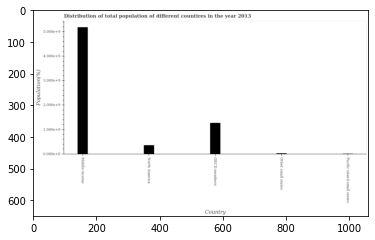

Number of QA =  22





,Country,Population(%)
0,Middle income,5.205443
1,North America,0.379229
2,OECD members,1.293173
3,Other small states,0.047778
4,Pacific island small states,NaN


> what is the title of the graph ?
PREDICTED =  Distribution of total population of different countires in the year 2013
EXPECTED =  Distribution of total population of different countires in the year 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population(%)
EXPECTED =  Population(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in middle income and north america ?
PREDICTED =  4.82621346751414
EXPECTED =  4826729006.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median population ?
PREDICTED =  0.8362010430590449
EXPECTED =  351720836.0




				 3 / 5 = 0.6


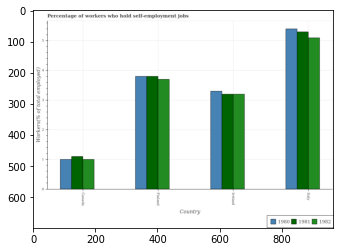

Number of QA =  29





,Country,1982,1980,1981
0,Italy,5.138883,5.429251,5.339920
1,Ireland,3.217308,3.308427,3.201080
2,Finland,3.731477,3.819831,3.834498
3,Canada,1.021944,1.022819,1.121935


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1982 in canada and that in ireland ?
PREDICTED =  -2.195364677696241
EXPECTED =  -2.20000004768372




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1980 in canada and the percentage of self-employed workers in 1981 in finland?
PREDICTED =  -2.797011519807352
EXPECTED =  -2.79999995231628




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers of/in 1982 and percentage of self-employed workers of/in 1981 in finland?
PREDICTED =  -2.

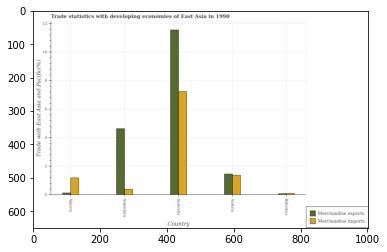

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,NaN,1.237983,0.174672
1,Austria,1.423723,1.506684
2,Bahamas,NaN,NaN
3,Argentina,0.433793,4.672442
4,Australia,7.364728,11.678740


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in argentina and that in australia ?
PREDICTED =  -6.930934494973927
EXPECTED =  -6.850751458891979




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in bahamas and the merchandise imports in algeria?
PREDICTED =  -5.952621828095197
EXPECTED =  -1.1043241820471144




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports and merchandise exports in algeria ?
PREDICTED =  3.2696216443319734
EXPECTED =  1.057232370107386




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: F

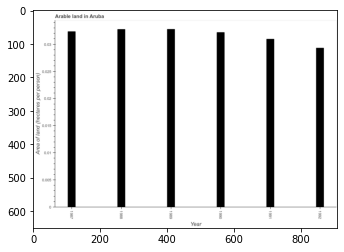

Number of QA =  23





,Year,Area of land (hectares per person)
0,1989,0.032962
1,1988,0.033065
2,1987,0.032494
3,1992,0.029514
4,1990,0.032359
5,1991,0.030923


> what is the title of the graph ?
PREDICTED =  Arable land in Aruba
EXPECTED =  Arable land in Aruba




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Area of land (hectares per person)
EXPECTED =  Area of land (hectares per person)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of arable land in 1990 and 1992 ?
PREDICTED =  0.0028444833586309046
EXPECTED =  0.003




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of arable land ?
PREDICTED =  1989.5
EXPECTED =  0.0322626932189441




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pre

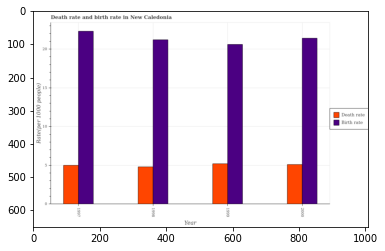

Number of QA =  28





,Year,Death rate,Birth rate
0,1999,5.316589,20.561667
1,2000,5.091995,21.427071
2,1998,4.884276,21.222290
3,1997,5.066064,22.334866


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 1999 and that in 2000 ?
PREDICTED =  -0.8654032861451668
EXPECTED =  -0.7999999999999972




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 2000 and the death rate in 1999?
PREDICTED =  0.8654032861451668
EXPECTED =  0.7999999999999972




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the birth rate and death rate ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

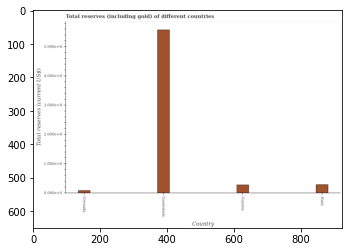

Number of QA =  22





,Country,Total reserves (current US$)
0,Grenada,0.100842
1,Haiti,0.305833
2,Guyana,0.294152
3,Guatemala,5.622856


> what is the title of the graph ?
PREDICTED =  Total reserves (including gold) of different countries
EXPECTED =  Total reserves (including gold) of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total reserves (current US$)
EXPECTED =  Total reserves (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in guatemala and guyana ?
PREDICTED =  5.328704307438111
EXPECTED =  529980041.98




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (including gold) ?
PREDICTED =  0.2999924704650041
EXPECTED =  2771600

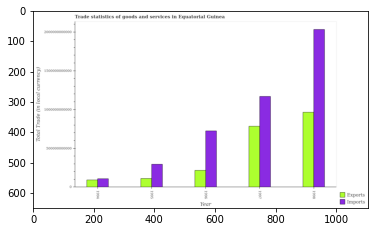

Number of QA =  28





,Year,Imports,Exports
0,1995,3.013176e+11,1.169195e+11
1,1996,7.312955e+11,2.197897e+11
2,1998,2.042547e+12,9.744664e+11
3,1994,1.129236e+11,9.801164e+10
4,1997,1.175565e+12,7.886650e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 1994 and that in 1997 ?
PREDICTED =  185801334568.9431
EXPECTED =  -692682270100




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services in 1997 and the export of goods and services in 1996?
PREDICTED =  141434204702.47253
EXPECTED =  444637402100




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the export of goods and services and imports of goods and services ?
PREDICTED =  876454712098.4437
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availab

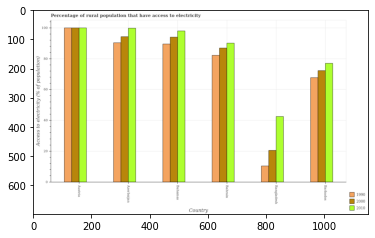

Number of QA =  29





,Country,2000,1990,2010
0,Austra,99.929221,100.454812,100.606175
1,Bahamas,94.442516,89.701603,98.539978
2,NaN,94.827743,90.222740,100.342196
3,Bangladesh,20.730996,10.703633,42.740147
4,Bahrain,87.119696,82.403101,90.122749
5,Barbados,72.543525,68.304790,77.080511


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population that have access to electricity in 2000 in azerbaijan and that in bahrain ?
PREDICTED =  -26.7895869094262
EXPECTED =  7.354849999999999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population that have access to electricity in 1990 in bangladesh and the percentage of rural population that have access to electricity in 2010 in bahamas?
PREDICTED =  -78.99797000589689
EXPECTED =  -87.6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population that have access to

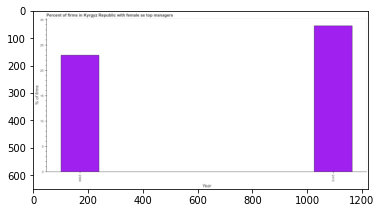

Number of QA =  19





,Year,% of firms
0,2013,28.925839
1,2009,23.265176


> what is the title of the graph ?
PREDICTED =  Percent of firms in Kyrgyz Republic with female as top managers
EXPECTED =  Percent of firms in Kyrgyz Republic with female as top managers




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of firms
EXPECTED =  % of firms




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms with female as top manager in 2009 and 2013 ?
PREDICTED =  -5.660663327204329
EXPECTED =  -5.8




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of firms with female as top manager ?
PREDICTED =  26.095507168073773
EXPECTED =  25.9




				 5 

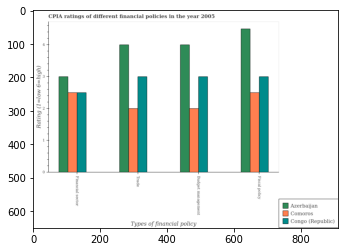

Number of QA =  29





,Types of financial policy,Congo (Republic),Azerbaijan,Comoros
0,Trade,3.022074,3.993328,2.025037
1,Fiscal policy,3.013901,4.519293,2.514342
2,Financial sector,2.512581,3.025452,2.508763
3,Budget management,3.021473,4.015789,2.020536


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of trade in comoros and that in congo (republic) ?
PREDICTED =  0.0
EXPECTED =  -1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of financial sector in congo (republic) and the cpia rating of budget management in azerbaijan?
PREDICTED =  0.5125807745432462
EXPECTED =  -1.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of trade and cpia rating of budget management in azerbaijan ?
PREDICTED =  -3.0157889048830766
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: F

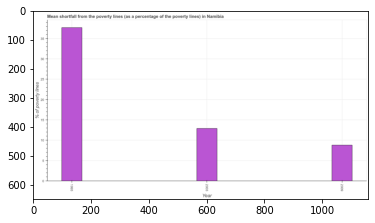

Number of QA =  23





,Year,% of poverty lines
0,2003,13.151373
1,1993,37.968755
2,2009,8.964778


> what is the title of the graph ?
PREDICTED =  Mean shortfall from the poverty lines (as a percentage of the poverty lines) in Namibia
EXPECTED =  Mean shortfall from the poverty lines (as a percentage of the poverty lines) in Namibia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of poverty lines
EXPECTED =  % of poverty lines




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the poverty gap at national poverty lines in 1993 and 2009 ?
PREDICTED =  29.003976767720257
EXPECTED =  28.9




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median poverty gap at national poverty lines ?
PREDICTED =  1

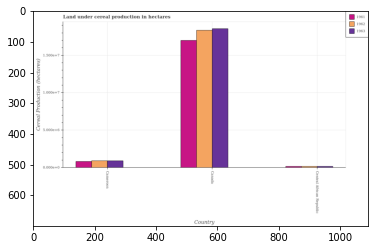

Number of QA =  29





,Country,1963,1962,1961
0,Central African Republic,NaN,NaN,0.023086
1,Canada,1.883524,1.842139,1.719021
2,Cameroon,0.098323,0.098723,0.089795


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in 1962 in cameroon and that in central african republic ?
PREDICTED =  0.0987230882676948
EXPECTED =  755688.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in 1963 in cameroon and the land under cereal production in 1961 in central african republic?
PREDICTED =  0.09832330059656644
EXPECTED =  750195.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 

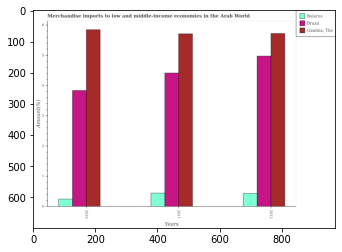

Number of QA =  29





,Years,Belarus,Brazil,"Gambia, The"
0,2012,0.447593,5.007896,5.738549
1,2010,0.263412,3.864514,5.869514
2,2011,0.462410,4.451317,5.770781


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in brazil in 2010 and that in 2011 ?
PREDICTED =  -0.5868031694550506
EXPECTED =  -0.5784421782366502




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in belarus in 2010 and the percentage of amount earned from merchandise imports in brazil in 2012?
PREDICTED =  -0.18418066924342075
EXPECTED =  -4.726001127552143




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of amount earned from merchandise imports i

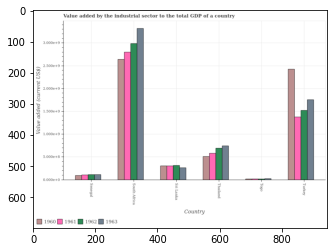

Number of QA =  30





,Country,1963,1962,1961,1960
0,NaN,NaN,NaN,NaN,NaN
1,Turkey,1.749178,1.526756,1.371559,2.410883
2,Thailand,0.749443,0.695102,0.585231,0.518764
3,Sri Lanka,0.273279,0.318854,0.310267,0.309736
4,South Africa,3.278124,2.953191,2.784216,2.629831
5,Senegal,0.122301,0.120839,0.114879,0.103350


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1961 in thailand and that in togo ?
PREDICTED =  -4.580921290967112
EXPECTED =  561891798.8640262




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1963 in sri lanka and the value added by the industrial sector to the total gdp in 1961 in togo?
PREDICTED =  -4.726720648607569
EXPECTED =  244462583.5621902




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp of/in 1960 and valu

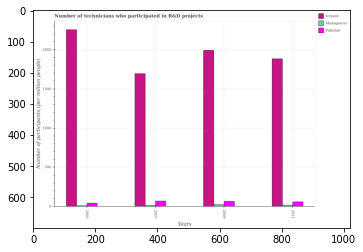

Number of QA =  29





,Years,Iceland,Madagascar,Pakistan
0,2009,1995.952391,28.963338,71.534998
1,2005,2253.960949,NaN,46.747538
2,2007,1702.383432,19.101916,74.684963
3,2011,1886.172905,22.340342,66.200393


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians who participated in r&d projects in madagascar in 2005 and that in 2009 ?
PREDICTED =  2.0
EXPECTED =  -13.58765




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians who participated in r&d projects in madagascar in 2007 and the number of technicians who participated in r&d projects in pakistan in 2009?
PREDICTED =  2.0
EXPECTED =  -51.56112999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the number of technicians who participated in r&d projects in pakistan and number of t

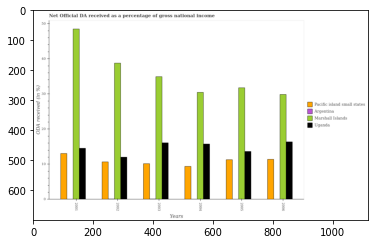

Number of QA =  30





,Years,Unnamed: 1,Pacific island small states,Uganda,Marshall Islands
0,2002,NaN,10.681257,12.134659,39.019308
1,2001,NaN,13.293452,14.618798,48.553581
2,2004,NaN,9.548651,16.046610,30.686605
3,2003,NaN,10.298026,16.232338,34.872447
4,2006,NaN,11.466801,16.424728,30.010990
5,2005,NaN,11.434502,13.640065,31.833336


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official da received in uganda in 2001 and that in 2006 ?
PREDICTED =  -1.8059306688748666
EXPECTED =  -1.8369251378959994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official da received in pacific island small states in 2002 and the net official da received in uganda in 2004?
PREDICTED =  nan
EXPECTED =  -5.085286301391701




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the net official da received in pacific island small states and net official da received in argentina ?
PREDICTED =  -9.54865087207346
EXPE

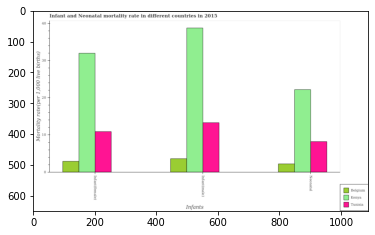

Number of QA =  28





,Infants,Belgium,Tunisia,Kenya
0,Neonatal,2.328697,8.286181,22.366003
1,Infant (female),2.976037,10.967284,32.116879
2,Infant(male),3.720119,13.395506,38.827386


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in kenya and that in tunisia ?
PREDICTED =  14.079821663810153
EXPECTED =  14.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate(female) in tunisia and the infant mortality rate(male) in kenya?
PREDICTED =  -59.97698060652404
EXPECTED =  -27.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the neonatal mortality rate in belgium to that in kenya ?
PR

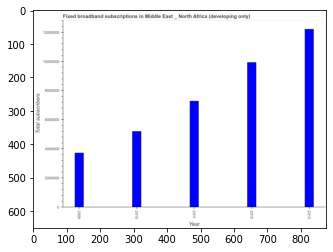

Number of QA =  23





,Year,Total subscribers
0,2009,3.746930e+06
1,2013,1.224682e+07
2,2010,5.233656e+06
3,2012,9.926315e+06
4,2011,7.305228e+06


> what is the title of the graph ?
PREDICTED =  Fixed broadband subscriptions in Middle East North Africa (developing only)
EXPECTED =  Fixed broadband subscriptions in Middle East _ North Africa (developing only)




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Total subscribers
EXPECTED =  Total subscribers




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of fixed broadband subscriptions in 2011 and 2012 ?
PREDICTED =  -2621086.6910896357
EXPECTED =  -2652832.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total number of fixed broadband subscriptions ?
PREDICTED =

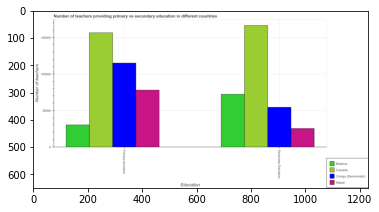

Number of QA =  23





,Education,Belarus,Nepal,Congo (Democratic’,Canada
0,Primary education,31009.710809,78757.107953,115566.225252,158279.843944
1,Secondary Education,73095.730276,26092.817008,54976.128464,167167.431744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers in nepal and that in congo (democratic) ?
PREDICTED =  -36809.11729868656
EXPECTED =  -37019




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers in belarus and the number of secondary teachers in congo (democratic)?
PREDICTED =  -139532.64290666443
EXPECTED =  -24094




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers and number of secondary teachers in canada ?
PREDICTED =  -325446.27568774496
EXPECTED =  -9974




				 1 / 3 = 0.3333


is_built_with_cuda: True


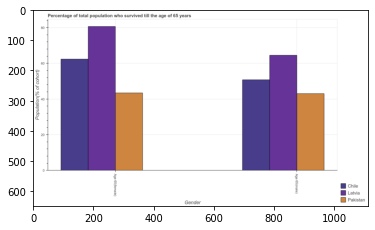

Number of QA =  23





,Gender,Latvia,Chile,Pakistan
0,Age 65 (male),65.127387,51.336904,43.677207
1,Age 65 (female),81.530267,62.925811,43.792178


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female population who survived till age of 65 in chile and that in pakistan ?
PREDICTED =  0.0
EXPECTED =  18.958580000000012




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female population who survived till age of 65 in latvia to that in pakistan ?
PREDICTED =  1.8617541070413282
EXPECTED =  1.8581824883094147




				 1 / 4 = 0.25


> what is the differ

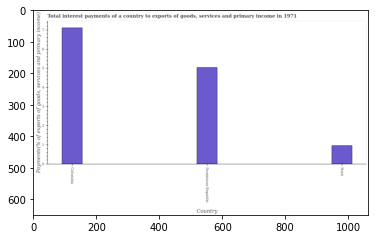

Number of QA =  22





,Country,"Payments(% of exports of goods, services and primary income)"
0,Haiti,0.987888
1,Colombia,7.089242
2,Dominican Republic,5.017919


> what is the title of the graph ?
PREDICTED =  Total interest payments of a country to exports of goods, services and primary income in 1971
EXPECTED =  Total interest payments of a country to exports of goods, services and primary income in 1971




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Payments(% of exports of goods, services and primary income)
EXPECTED =  Payments(% of exports of goods, services and primary income)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments on external debt in dominican republic and haiti ?
PREDICTED =  3.0179186819154236
EXPECTED =  4.083




				 3 / 4 = 0.75


> what is the median total interest payments on external debt ?
PREDICTED =  None
EXPE

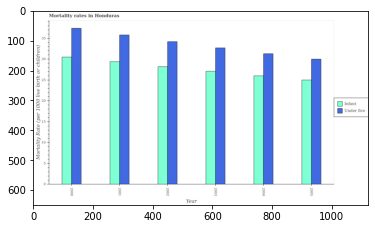

Number of QA =  28





,Year,Infant,Under five
0,2002,28.578768,34.514002
1,2004,26.364540,31.641810
2,2000,30.869644,37.760321
3,2003,27.465229,33.039512
4,2005,25.304941,30.368979
5,2001,29.765308,36.205086


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate in 2003 and that in 2005 ?
PREDICTED =  2.6705334560824774
EXPECTED =  2.700000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate in 2003 and the infant mortality rate in 2004?
PREDICTED =  1.397702353515534
EXPECTED =  1.4000000000000021




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the infant mortality rate and under-5 mortality rate ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

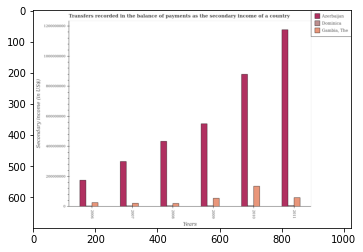

Number of QA =  29





,Years,Azerbaijan,"Gambia, The",Dominica
0,2006,1.784423e+08,3.016998e+07,NaN
1,2011,1.166729e+09,6.291294e+07,NaN
2,2009,5.493703e+08,5.926492e+07,NaN
3,2007,3.034936e+08,2.573562e+07,NaN
4,2008,4.352309e+08,2.474651e+07,NaN
5,2010,8.769920e+08,1.380687e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in azerbaijan in 2007 and that in 2009 ?
PREDICTED =  -245876683.9939583
EXPECTED =  -250996000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in dominica in 2008 and the secondary income of in gambia, the in 2007?
PREDICTED =  0.0
EXPECTED =  -16505218.213




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the secondary income of in gambia, the and secondary income of in azerbaijan ?
PREDICTED =  -38166428.32697328
EXPECTED =  -1116671900.39




				 1 / 3 = 0.3333


is_built_with_c

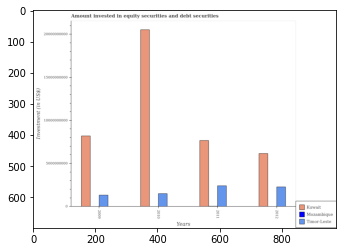

Number of QA =  25





,Years,Timor-Leste,Mozambique,Kuwait
0,2009,1.371523e+09,NaN,8.258449e+09
1,2010,1.552543e+09,NaN,2.055173e+10
2,2011,2.452237e+09,NaN,7.702745e+09
3,2012,2.324542e+09,NaN,6.156087e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in timor-leste in 2010 and that in 2012 ?
PREDICTED =  -3877085258.314114
EXPECTED =  -781380000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in mozambique in 2011 and the amount invested in equity securities and debt securities in kuwait in 2012?
PREDICTED =  -7702745188.012546
EXPECTED =  -6114929560.84




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

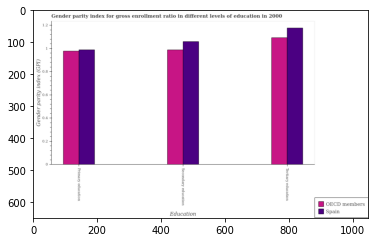

Number of QA =  28





,Education,OECD members,Spain
0,Primary education,0.977224,0.988378
1,Tertiary education,1.090620,1.174037
2,Secondary education,0.985679,1.054938


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in primary education in oecd members and that in spain ?
PREDICTED =  0.0
EXPECTED =  -0.010960042476654053




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in tertiary education in spain and the gender parity index in secondary education in oecd members?
PREDICTED =  -1.0
EXPECTED =  0.18875998258590598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education and gender parity index in primary education in oecd members ?
PREDICTED =  -0.977224439651244
EXPECTED 

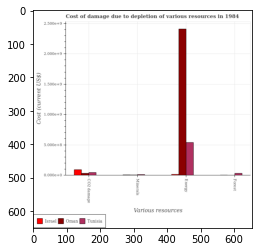

Number of QA =  29





,Various resources,Israel,Tunisia,Oman
0,Minerals,NaN,NaN,NaN
1,Forest,NaN,0.039911,NaN
2,CO2 damage,0.100992,0.053605,0.040682
3,Energy,0.022517,0.553082,2.432503


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in tunisia and that in oman ?
PREDICTED =  0.0
EXPECTED =  6706315.087675369




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in tunisia and the cost of damage due to depletion of forests in oman?
PREDICTED =  0.05360549047896007
EXPECTED =  43872987.997941904




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals and cost of damage due to depletion of forests in israel ?
PREDICTED =  0.0
EXPECTED =  3496075.5769097


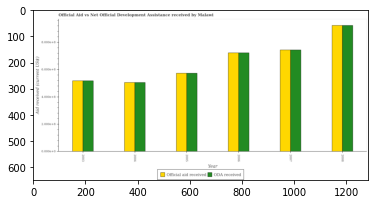

Number of QA =  28





,Year,Official aid received,ODA received
0,2004,5.101647,5.105717
1,2008,9.292681,9.307515
2,2003,5.221762,5.216175
3,2005,5.765214,5.801791
4,2006,7.275343,7.302313
5,2007,7.492913,7.512558


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 2003 and that in 2008 ?
PREDICTED =  -4.091340806943576
EXPECTED =  -405500000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in 2005 and the oda received in 2006?
PREDICTED =  -1.5101286004822096
EXPECTED =  -149450000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the official aid received and oda received ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

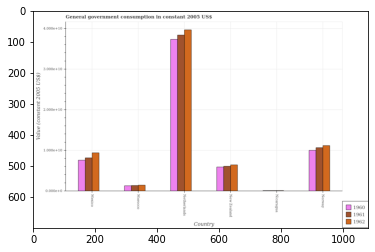

Number of QA =  29





,Country,1962,1961,1960
0,Nicaragua,NaN,NaN,NaN
1,Mexico,0.951363,0.829553,0.765932
2,Netherlands,3.997085,3.863442,3.744747
3,Norway,1.127633,1.081624,1.008896
4,Morocco,0.155122,0.143648,0.143557
5,New Zealand,0.653347,0.629328,0.602760


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in 1962 in netherlands and that in nicaragua ?
PREDICTED =  3.99708453146693
EXPECTED =  39560074001.05632




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in 1961 in morocco and the government conusmption in 1960 in new zealand?
PREDICTED =  -0.48567977096461656
EXPECTED =  -4554342779.00368




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the governmen

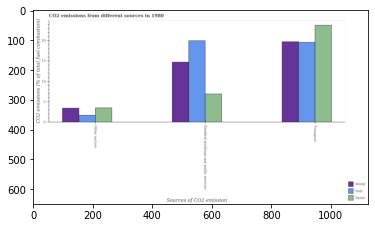

Number of QA =  28





,Sources of CO2 emission,Unnamed: 1,Italy,World
0,Other sectors,3.634474,1.829945,3.592965
1,Transport,24.042846,19.977642,19.913516
2,Resident buildings and public services,7.078774,20.138832,14.952182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in spain and that in italy ?
PREDICTED =  -18.977642168214885
EXPECTED =  4.199557381078801




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport and percentage of co2 emissions from resident buildings and public services in italy ?
PREDICTED =  -19.13883240775964
EXPECTED =  -0.4002223457476006




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





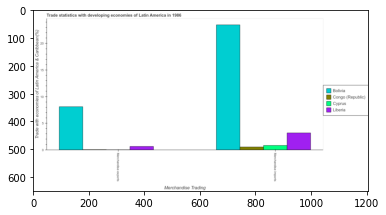

Number of QA =  23





,Merchandise Trading,Congo (Republic),Liberia,Cyprus,Bolivia
0,Merchandise imports,0.644561,3.243211,0.913366,23.423301
1,Merchandise exports,NaN,0.725897,NaN,8.166789


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade with economies of Latin America & Caribbean(%)
EXPECTED =  5.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with developing economies of Latin America in 1986
EXPECTED =  Trade statistics with developing economies of Latin America in 1986




		

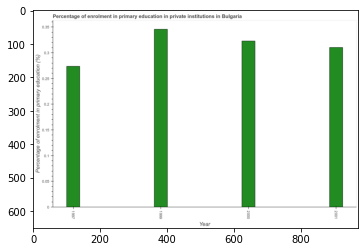

Number of QA =  23





,Year,Percentage of enrolment in primary education (%)
0,1997,0.273412
1,1999,0.346477
2,2001,0.310724
3,2000,0.322409


> what is the title of the graph ?
PREDICTED =  Percentage of enrolment in primary education in private institutions in Bulgaria
EXPECTED =  Percentage of enrolment in primary education in private institutions in Bulgaria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Percentage of enrolment in primary education (%)
EXPECTED =  Percentage of enrolment in primary education (%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrolment percentage in primary education in 1999 and 2001 ?
PREDICTED =  0.03575249144738851
EXPECTED =  0.035




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median en

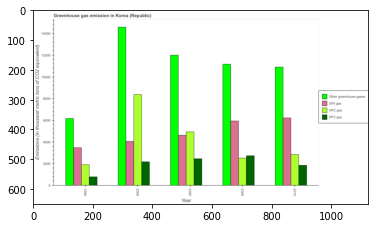

Number of QA =  30





,Year,HFC gas,Unnamed: 2,PFC gas,SF6 gas
0,2005,4960.878119,11992.411874,2495.879238,4601.321110
1,2008,2536.197511,11169.100767,2771.203271,5959.426256
2,2000,8399.129018,14612.862824,2221.032112,4098.021311
3,1990,1913.052057,6174.276638,828.197943,3537.749912
4,2010,2888.857325,10898.453931,1868.024014,6286.476746


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emission of pfc gas in 2000 and that in 2005 ?
PREDICTED =  -274.847125870313
EXPECTED =  -288.7999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emission of greenhouse gases in 2008 and the emission of pfc gas in 2005?
PREDICTED =  40.31827281139613
EXPECTED =  -830.3999999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the emission of sf6 gas and emission of pfc gas ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

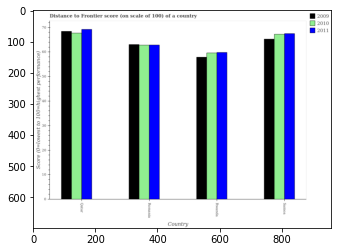

Number of QA =  29





,Country,2011,2010,2009
0,Qatar,70.059056,68.454907,69.041418
1,Samoa,68.191778,68.159773,66.047684
2,Romania,63.688189,63.080597,63.854651
3,Rwanda,60.575619,60.223543,58.641682


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the distance to frontier score of in 2010 in qatar and that in rwanda ?
PREDICTED =  8.231364031915263
EXPECTED =  8.089999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the distance to frontier score of in 2011 in romania and the distance to frontier score of in 2010 in samoa?
PREDICTED =  -4.503588938656399
EXPECTED =  -4.3700000000000045




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the distance to frontier score of of/in 2010 and distance to frontier score of of/in 2011 in rwanda?
PREDICTED =  -0.352075488557837
EXPECTED =  -0.21

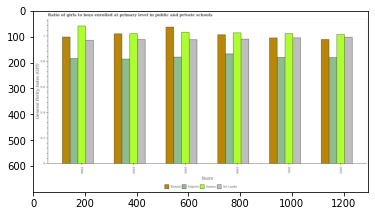

Number of QA =  30





,Years,Nigeria,Samoa,Sri Lanka,Kuwait
0,1986,0.830030,1.087612,0.973101,1.000078
1,1994,0.826051,1.021046,0.978011,1.020896
2,1996,0.864479,1.030512,0.982968,1.012258
3,2001,0.841785,1.026395,0.994539,0.989084
4,1995,0.841841,1.036558,0.977150,1.076542
5,2002,0.837416,1.021036,0.997723,0.977974


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in samoa in 1986 and that in 1994 ?
PREDICTED =  0.06656588474471681
EXPECTED =  0.05983999999999989




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in sri lanka in 1986 and the general parity index in samoa in 2001?
PREDICTED =  -0.0214388624332994
EXPECTED =  -0.052229965934750044




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the general parity index in sri lanka and general parity index in kuwait ?
PREDICTED =  4.876233912705493
EXPECTED =  0.01759999990463279




				 0 / 3

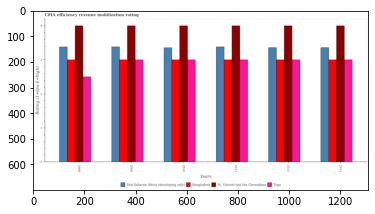

Number of QA =  30





,Years,Unnamed: 1,Sub-Saharan Africa (developing only),St. Vincent and the Grenadines,Bangladesh
0,2012,3.033040,3.387346,4.006658,3.035275
1,2011,3.025480,3.393345,3.998866,3.020743
2,2013,3.020845,3.370470,3.994199,3.026913
3,2010,3.032154,3.385291,4.009000,3.036068
4,2009,3.025103,3.394429,4.000861,3.026073
5,2008,2.520960,3.410222,4.025491,3.003660


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in sub-saharan africa (developing only) in 2008 and that in 2009 ?
PREDICTED =  0.01579260347636291
EXPECTED =  -0.0032005689900400647




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in sub-saharan africa (developing only) in 2008 and the cpia rating in bangladesh in 2009?
PREDICTED =  0.01579260347636291
EXPECTED =  0.37837837837837984




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in togo and cpia rating in sub-saharan africa (developing only) ?
PREDICTED =  0.0
EXPECTED =  -0.3

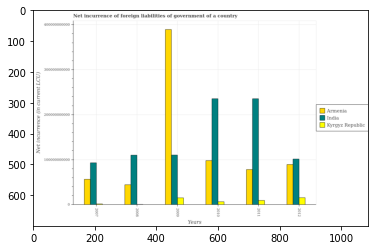

Number of QA =  29





,Years,Kyrgyz Republic,India,Armenia
0,2008,NaN,1.120903e+11,4.531149e+10
1,2009,1.626832e+10,1.116282e+11,3.954975e+11
2,2012,1.665786e+10,1.028978e+11,9.072803e+10
3,2011,1.045145e+10,2.369314e+11,7.888948e+10
4,2010,7.838107e+09,2.363451e+11,9.826415e+10
5,2007,NaN,9.395247e+10,5.768152e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in armenia in 2007 and that in 2008 ?
PREDICTED =  nan
EXPECTED =  12030716705.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in armenia in 2011 and the net incurrence of foreign liabilities in kyrgyz republic in 2010?
PREDICTED =  -87812702629.93582
EXPECTED =  71502580813.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the net incurrence of foreign liabilities in armenia and net incurrence of foreign liabilities in india ?
PREDICTED =  200

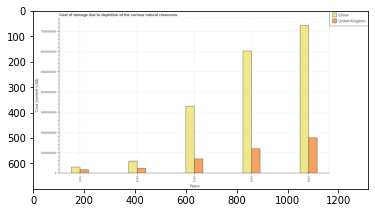

Number of QA =  28





,Years,United Kingdom,China
0,1974,7.232499e+08,3.331070e+09
1,1975,1.227355e+09,6.073191e+09
2,1972,1.796401e+08,3.133796e+08
3,1976,1.777852e+09,7.336074e+09
4,1973,2.493423e+08,6.130841e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various natural resources in china in 1973 and that in 1976 ?
PREDICTED =  -6722989842.399914
EXPECTED =  -6706655698.287323




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various natural resources in united kingdom in 1975 and the cost of damage caused due to the depletion of various natural resources in china in 1974?
PREDICTED =  504105542.79657376
EXPECTED =  -2097181882.94691




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

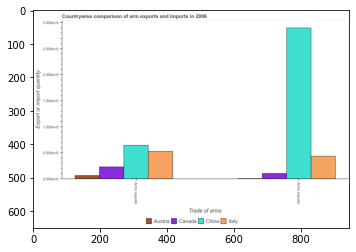

Number of QA =  23





,Trade of arms,Italy,Austna,China,Canada
0,Arms exports,0.533792,0.074732,0.655674,0.246417
1,NaN,0.446121,NaN,2.896485,0.115194


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in canada and the arms imports in italy?
PREDICTED =  -0.2873751617234622
EXPECTED =  -206000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Export or import quantity
EXPECTED =  500000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Countrywise comparison o

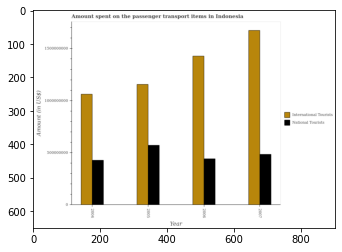

Number of QA =  28





,Year,International Tourists,National Tourists
0,2007,1.678579e+09,4.860151e+08
1,2006,1.428277e+09,4.427579e+08
2,2005,1.153733e+09,5.700206e+08
3,2004,1.058910e+09,4.268938e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of international tourists in 2005 and that in 2007 ?
PREDICTED =  -524845905.49049354
EXPECTED =  -518000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in 2006 and the amount spent on transport items of international tourists in 2004?
PREDICTED =  15864073.908162296
EXPECTED =  14000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount spent on transport items of international tourists and amount spent on transport items of

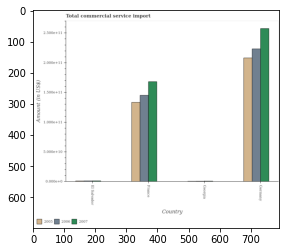

Number of QA =  29





,Country,2007,2005,2006
0,Georgia,NaN,NaN,NaN
1,El Salvador,NaN,NaN,NaN
2,France,1.672957,1.330148,1.432806
3,Germany,2.564751,2.074599,2.205809


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in 2007 in el salvador and that in germany ?
PREDICTED =  1.6729567301114239
EXPECTED =  -256287041419.7231




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in 2006 in el salvador and the total commercial service import in 2005 in france?
PREDICTED =  2.205808692018712
EXPECTED =  -132166588422.813




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import of/in 2005 and total commercial service import of/in 2006 in france?
PREDICTED =  1.9719408784535

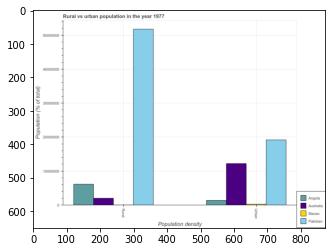

Number of QA =  23





,Population density,Unnamed: 1,Australia,Macao,Pakistan
0,Rural,6.235341e+06,2.134686e+06,NaN,5.232419e+07
1,Urban,1.509583e+06,1.230821e+07,NaN,1.940170e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density and rural population density in pakistan ?
PREDICTED =  -17892117.09147174
EXPECTED =  -32606099




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rural population density in angola to that in macao ?
PREDICTED =  6235341.236692327
EXPECTED =  1374.4071252520725




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
P

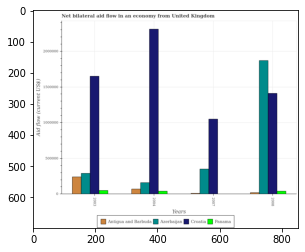

Number of QA =  27





,Years,Azerbaijan,Panama,Croatia,Antigua and Barbuda
0,2008,1.868050e+06,47100.459843,1.411915e+06,25964.520358
1,2003,2.956665e+05,54870.815388,1.637832e+06,245125.540850
2,2004,1.643270e+05,46615.508248,2.316704e+06,76531.191596
3,2007,3.528276e+05,NaN,1.048876e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in panama in 2003 and that in 2008 ?
PREDICTED =  7770.355545043858
EXPECTED =  10000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in antigua and barbuda in 2008 and the net bilateral aid flow in azerbaijan in 2003?
PREDICTED =  -1707221.2737399372
EXPECTED =  -270000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the net bilateral aid flow in antigua and barbuda and net bilateral aid flow in azerbaijan ?
PREDICTED =  160824.36622325395
EXPECTED =  -90000.0




				 0

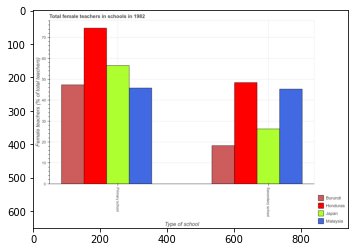

Number of QA =  23





,Type of school,Japan,Malaysia,Burundi,Honduras
0,Primary school,55.737645,46.054646,46.900168,74.729140
1,Secondary school,26.186259,45.276396,18.440023,48.270141


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in malaysia and that in japan ?
PREDICTED =  -9.682998952100306
EXPECTED =  -10.75231999999999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in secondary schools in honduras and the percentage of female teachers in primary schools in burundi?
PREDICTED =  -17.070050064430312
EXPECTED =  1.0873999999999882




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools and percentage of female teachers in secondary schools 

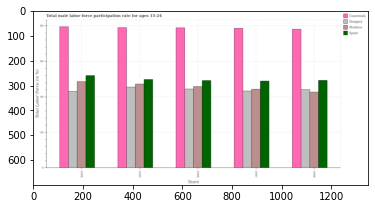

Number of QA =  30





,Years,Spain,Moldova,Hungary,Guatemala
0,1994,52.104794,48.975916,43.442689,79.736868
1,1995,50.156855,47.398676,45.805484,79.241309
2,1996,49.271805,45.928485,44.436445,78.901263
3,1998,49.353904,42.767517,44.310266,78.224554
4,1997,49.078262,44.450643,43.503032,78.816532


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in guatemala in 1994 and that in 1995 ?
PREDICTED =  0.4955586995693295
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in moldova in 1997 and the male labor force participation rate in spain in 1998?
PREDICTED =  1.6831263558326128
EXPECTED =  -5.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the male labor force participation rate in spain and male labor force participation rate in moldova ?
PREDICTED =  3.1740144715711764
EXPECT

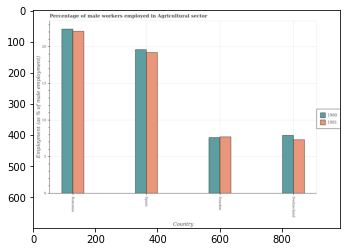

Number of QA =  28





,Country,1980,1981
0,NaN,19.700209,19.340093
1,Romania,22.448487,22.155893
2,Sweden,7.719984,7.823455
3,Switzerland,7.977638,7.427084


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1980 in spain and that in sweden ?
PREDICTED =  0.0
EXPECTED =  12.00000047683713




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1981 in sweden and the percentage of male workers employed in agricultural sector in 1980 in romania?
PREDICTED =  -14.332438204484038
EXPECTED =  -14.699999809265169




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

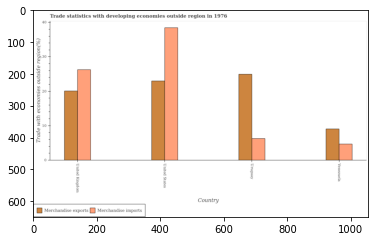

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,United States,38.720804,23.165825
1,Uruguay,6.428298,25.139582
2,Venezuela,4.886551,9.255643
3,United Kingdom,26.429415,20.387470


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in united kingdom and that in uruguay ?
PREDICTED =  -4.752111816166543
EXPECTED =  -4.858733596421402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in united kingdom and the merchandise imports in uruguay?
PREDICTED =  -4.752111816166543
EXPECTED =  13.815332631277869




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports and merchandise imports in united states ?
PREDICTED =  -13.581222091347339
EXPECTED =  -15.460702650568212




				 1 / 3 = 0.3333


is_built_with_cuda: True
i

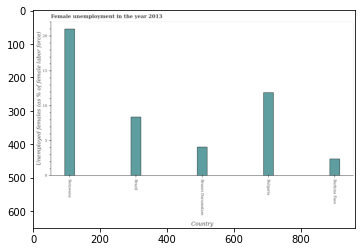

Number of QA =  22





,Country,Unemployed females (as % of female labor force)
0,Brazil,8.495030
1,Brunei Darussalam,4.150741
2,Botswana,21.211244
3,Bulgaria,11.942228
4,Burkina Faso,2.454171


> what is the title of the graph ?
PREDICTED =  Female unemployment in the year 2013
EXPECTED =  Female unemployment in the year 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed females (as % of female labor force)
EXPECTED =  Unemployed females (as % of female labor force)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed females population in brunei darussalam and burkina faso ?
PREDICTED =  1.6965701340040087
EXPECTED =  1.7




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed females population ?
PREDICTED =  8.495029589985393
EXPECTED =  8.399

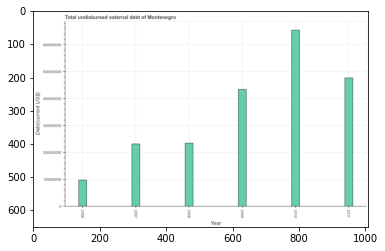

Number of QA =  23





,Year,Debt(current US$)
0,2008,2.362455e+08
1,2010,6.604888e+08
2,2009,4.379674e+08
3,2006,1.002302e+08
4,2007,2.338342e+08
5,2011,4.789888e+08


> what is the title of the graph ?
PREDICTED =  Total undisbursed external debt of Montenegro
EXPECTED =  Total undisbursed external debt of Montenegro




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt(current US$)
EXPECTED =  Debt(current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 2007 and 2010 ?
PREDICTED =  -426654622.99795365
EXPECTED =  -422965000.0




				 4 / 4 = 1.0


> what is the median total debt ?
PREDICTED =  None
EXPECTED =  334275000.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total debt in 2007 to that in 2009 ?
PREDICTED =  

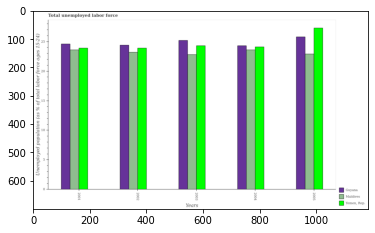

Number of QA =  29





,Years,"Yemen, Rep",Maldives,Guyana
0,2002,23.962665,23.323957,24.505476
1,2003,24.324832,22.878000,25.288821
2,2005,27.365186,22.972157,26.017628
3,2001,24.035227,23.632112,24.616143
4,2004,24.151247,23.652148,24.358535


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed population in in guyana in 2002 and that in 2005 ?
PREDICTED =  -1.5121519377705646
EXPECTED =  -1.3999996185301917




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed population in in maldives in 2003 and the percentage of unemployed population in in yemen, rep. in 2001?
PREDICTED =  -0.7541113372407118
EXPECTED =  -1.1000003814698083




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of unemployed population in in guyana and percentage of unemployed population i

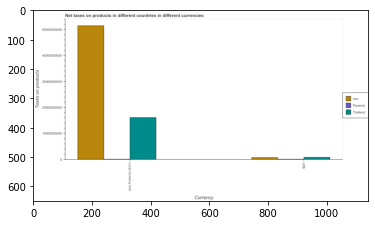

Number of QA =  23





,Currency,Panama,Thailand,Iran
0,NaN,NaN,1.041042e+09,9.326381e+08
1,Local Currency Unit,NaN,1.629098e+10,5.212490e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in constant 2005 us$ in iran and that in panama ?
PREDICTED =  1.0
EXPECTED =  51408167302.4523




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in us$ in thailand and the net taxes in constant 2005 us$ in iran?
PREDICTED =  -9196749608.49184
EXPECTED =  -50701928856.07374




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in constant 2005 us$ and net taxes in us$ in panama ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

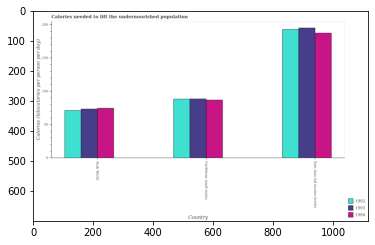

Number of QA =  29





,Country,1992,1993,1994
0,Caribbean small states,89.160373,89.585454,87.342843
1,East Asia (all income levels),193.699434,195.433836,188.126984
2,Arab World,71.440105,74.089442,75.149858


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in 1994 in arab world and that in caribbean small states ?
PREDICTED =  -12.192984842601561
EXPECTED =  -12.269416574544394




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in 1994 in caribbean small states and the total calories needed to lift the undernourished population in 1992 in east asia (all income levels)?
PREDICTED =  -106.35659155981575
EXPECTED =  -106.1146546452693




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference betw

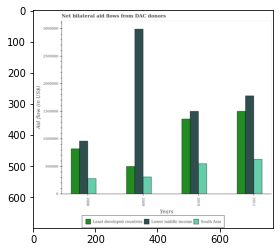

Number of QA =  29





,Years,Least developed countries,South Asia,Lower middle income
0,2008,8.289305e+05,289063.578194,9.597849e+05
1,2011,1.500111e+06,635084.739986,1.776503e+06
2,2010,1.364347e+06,555554.578999,1.498688e+06
3,2009,5.022992e+05,316489.746763,2.986368e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in south asia in 2009 and that in 2010 ?
PREDICTED =  -239064.83223602915
EXPECTED =  -240000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in south asia in 2011 and the net bilateral aid flow in least developed countries in 2009?
PREDICTED =  318594.9932228162
EXPECTED =  130000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net bilateral aid flow in south asia and net bilateral aid flow in least developed countries ?
PREDICTED =  1796188.6439420036
EXPECTED =  -81000

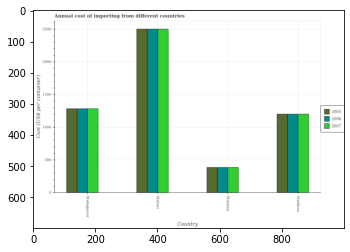

Number of QA =  29





,Country,2007,2005,2006
0,Madagascar,1296.100636,1292.070903,1292.481029
1,Malawi,2519.926627,2516.693576,2518.548430
2,Malaysia,401.008276,392.833522,393.181133
3,Maldives,1208.717746,1206.196219,1215.957686


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2005 in madagascar and that in malawi ?
PREDICTED =  -1224.6226732365833
EXPECTED =  -1218.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2005 in madagascar and the total annual cost of importing in 2006 in malawi?
PREDICTED =  -1224.6226732365833
EXPECTED =  -1218.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing of/in 2005 and total annual cost of importing of/in 2007 in malawi?
PREDICTED =  2887.867593809538
EXPECTED =  0.0




			

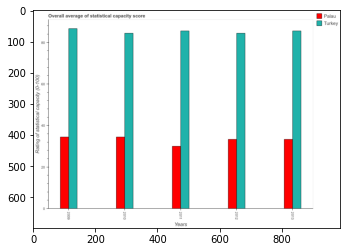

Number of QA =  28





,Years,Palau,Turkey
0,2010,34.839451,85.209473
1,2013,33.732752,86.460383
2,2012,33.871429,84.843098
3,2011,30.474221,86.307139
4,2009,34.981378,87.422603


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in turkey in 2010 and that in 2013 ?
PREDICTED =  -1.2509097160819067
EXPECTED =  -1.1111111111111711




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in turkey in 2011 and the rating of statistical capacity in palau in 2010?
PREDICTED =  1.0976656839557108
EXPECTED =  51.1111111111111




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the rating of statistical capacity in palau and rating of statistical capacity in turkey ?
PREDICTED =  -81.2583055123637
EXPECTED

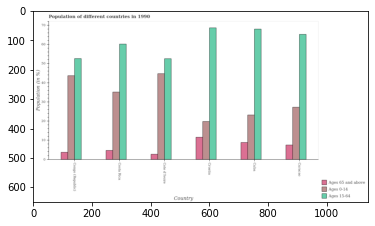

Number of QA =  29





,Country,Ages 65 and above,Ages 0-14,Ages 15-64
0,Curacao,7.849234,27.525764,65.971210
1,Cote d'Ivoire,3.040075,45.208686,53.113484
2,Congo (Republic),4.056825,44.066857,52.573965
3,Croatia,11.877847,20.169126,69.210441
4,Costa Rica,4.987056,35.376217,60.749739
5,Cuba,9.098608,23.717301,68.349350


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 in congo (republic) and that in croatia ?
PREDICTED =  23.897731107589504
EXPECTED =  23.892824588258705




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 15-64 in cuba and the percentage of population within the age-group 0-14 in cote d'ivoire?
PREDICTED =  15.235866003849651
EXPECTED =  23.246605510790104




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 and percentage of population within t

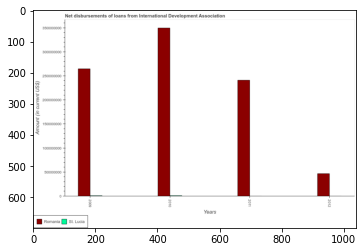

Number of QA =  25





,Years,Romania,St. Lucia
0,2012,4.828986e+08,NaN
1,2011,2.425642e+09,NaN
2,2009,2.669214e+09,NaN
3,2010,3.530524e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in romania in 2009 and that in 2011 ?
PREDICTED =  243571459.5220971
EXPECTED =  236151000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in st. lucia in 2010 and the amount of loans disbursed in romania in 2012?
PREDICTED =  3047625576.1466913
EXPECTED =  -458251000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount of loans disbursed in st. lucia and amount of loans disbursed in romania ?
PREDICTED =  -9108278783.812057
EXPECTED =  -2638629000.0




				 

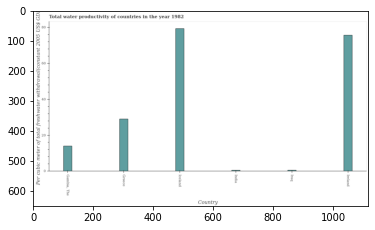

Number of QA =  22





,Country,Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDI
0,NaN,0.722032
1,India,0.662410
2,Ireland,75.654639
3,Iceland,79.666308
4,Greece,29.141044
5,"Gambia, The",14.089919


> what is the title of the graph ?
PREDICTED =  Total water productivity of countries in the year 1982
EXPECTED =  Total water productivity of countries in the year 1982




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDI
EXPECTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total water productivity in iceland and iraq ?
PREDICTED =  79.00389781947045
EXPECTED =  78.763




				 3 / 4 = 0.75


> what is the median total water productivity ?
PREDICTED =  None
EXPECTED =  21.5070472854924




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs:

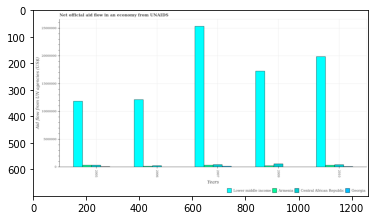

Number of QA =  30





,Years,Central African Republic,Georgia,Lower middle income,Armenia
0,2007,538329.078472,NaN,2.555857e+07,433638.098064
1,2006,323508.206306,NaN,1.233504e+07,NaN
2,2009,661186.902398,NaN,1.737595e+07,318383.021918
3,2005,419743.218880,NaN,1.193678e+07,422115.229274
4,2010,515547.223384,NaN,2.008211e+07,405229.681854


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in lower middle income in 2007 and that in 2009 ?
PREDICTED =  8182627.538073111
EXPECTED =  8070000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in armenia in 2007 and the net official aid flow in central african republic in 2009?
PREDICTED =  115255.07614622492
EXPECTED =  -240000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the net official aid flow in armenia and net official aid flow in central african republic ?
PREDICTED =  -878948.5983295066
EXPECTED =  -340000




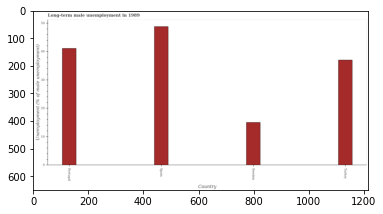

Number of QA =  22





,Country,Unemployment (% of male unemployment)
0,Turkey,37.328817
1,NaN,48.858421
2,Sweden,15.194760
3,Portugal,41.268343


> what is the title of the graph ?
PREDICTED =  Long-term male unemployment in 1989
EXPECTED =  Long-term male unemployment in 1989




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployment (% of male unemployment)
EXPECTED =  Unemployment (% of male unemployment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term male unemployment in portugal and turkey ?
PREDICTED =  3.939525687329663
EXPECTED =  4.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term male unemployment ?
PREDICTED =  39.298579966419766
EXPECTED =  39.04999923706055




				 5 / 5 = 1.0


is_bu

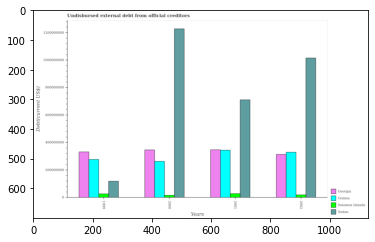

Number of QA =  30





,Years,Georgia,Solomon Islands,Guinea,Sudan
0,1999,3.380612e+08,3.089541e+07,2.811580e+08,1.225572e+08
1,2002,3.185892e+08,2.268240e+07,3.376856e+08,1.018553e+09
2,2001,3.514076e+08,3.205246e+07,3.514057e+08,7.206594e+08
3,2000,3.513634e+08,2.044892e+07,2.702439e+08,1.242477e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in sudan in 2000 and that in 2002 ?
PREDICTED =  223924268.1245849
EXPECTED =  212592000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in georgia in 2000 and the total debt in guinea in 2001?
PREDICTED =  -44221.541136443615
EXPECTED =  2114000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the total debt in guinea and total debt in solomon islands ?
PREDICTED =  1134413935.089391
EXPECTED =  250608000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

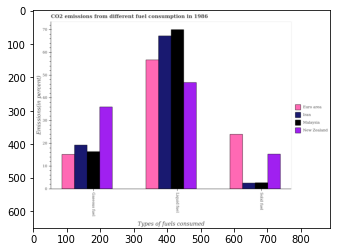

Number of QA =  28





,Types of fuels consumed,Malaysia,New Zealand,Iran,Euro area
0,Liquid fuel,69.944931,46.856743,67.223839,56.468659
1,Gaseous fuel,NaN,36.163180,19.463668,15.412385
2,Solid fuel,NaN,15.398493,2.781713,24.110566


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gaseous fuel emission in new zealand and that in malaysia ?
PREDICTED =  0.0
EXPECTED =  19.6565318233457




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gaseous fuel emission in iran and the percentage of solid fuel emission in malaysia?
PREDICTED =  nan
EXPECTED =  16.56787215662179




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of solid fuel emission and percentage of gaseous fuel emission in malaysia ?
PREDICTED =  nan
EXPECTED =  -13.69222303741749




				 0 / 3 = 0.0


is_built_with_cuda:

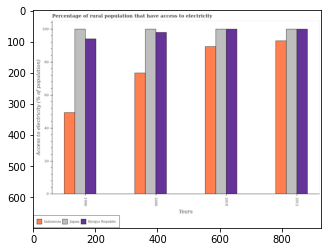

Number of QA =  29





,Years,Japan,Kyrgyz Republic,Indonesia
0,1990,100.226519,94.550436,49.932967
1,2010,100.541030,100.030441,90.023149
2,2012,100.080521,100.732422,93.529098
3,2000,100.403421,98.101713,73.747785


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population that have access to electricity in kyrgyz republic in 2010 and that in 2012 ?
PREDICTED =  -0.7019806893178071
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population that have access to electricity in kyrgyz republic in 2000 and the percentage of rural population that have access to electricity in indonesia in 1990?
PREDICTED =  3.5512766165063
EXPECTED =  48.6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of rural population that hav

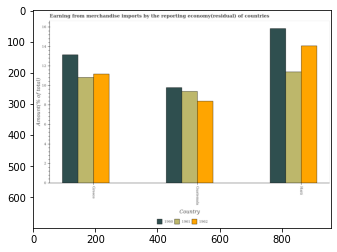

Number of QA =  29





,Country,1962,1961,1960
0,Guatemala,8.406024,9.401066,9.765569
1,Greece,11.146907,10.966367,13.130816
2,Haiti,14.061295,11.510953,15.868186


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 in greece and that in guatemala ?
PREDICTED =  2.740883292396184
EXPECTED =  2.78370245057317




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in guatemala and the percentage of amount earned from merchandise imports in 1960 in greece?
PREDICTED =  -1.5653017829847258
EXPECTED =  -3.754777218430979




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports of/in 1961 and per

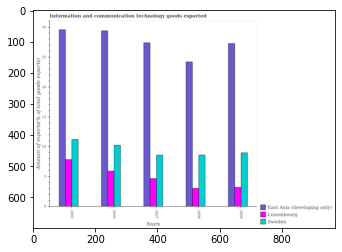

Number of QA =  29





,Years,East Asia (developing only,Sweden,Luxembourg
0,2008,24.186008,8.709226,3.105325
1,2005,29.831641,11.332976,7.936673
2,2009,27.433926,9.171967,3.297088
3,2006,29.469022,10.357204,5.990785
4,2007,27.439091,8.692904,4.703967


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in sweden in 2005 and that in 2007 ?
PREDICTED =  2.640071330570752
EXPECTED =  2.6218593718999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in luxembourg in 2008 and the amount of goods exported in sweden in 2006?
PREDICTED =  -2.8854596331329114
EXPECTED =  -7.2301382572




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount of goods exported in luxembourg and amount of goods exported in sweden ?
PREDICTED =  20.033836569250177
EXPECTED =  -3.922213258400001



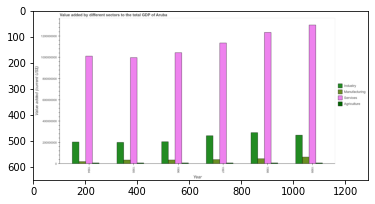

Number of QA =  30





,Year,Industry,Agriculture,Manufacturing,Services
0,1996,2.136264e+08,1.258230e+07,4.037987e+07,1.052720e+09
1,1995,2.058523e+08,1.249309e+07,4.016572e+07,1.002694e+09
2,1994,2.120173e+08,1.269850e+07,2.557663e+07,1.021162e+09
3,1997,2.688974e+08,1.254357e+07,4.410347e+07,1.146189e+09
4,1998,3.022562e+08,1.252127e+07,5.288200e+07,1.247128e+09
5,1999,2.749494e+08,NaN,6.799177e+07,1.314495e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in 1994 and that in 1998 ?
PREDICTED =  -27305364.179370176
EXPECTED =  -27374301.6759777




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in 1997 and the value added by industrial sector in 1998?
PREDICTED =  -100938614.8294003
EXPECTED =  -99184357.54190016




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the value added by manufacturing sector and value added by agricultural sector ?
PREDICTED =  67991760.89212489
EXPECTED =  0.0




				 2 / 3 = 0.6667


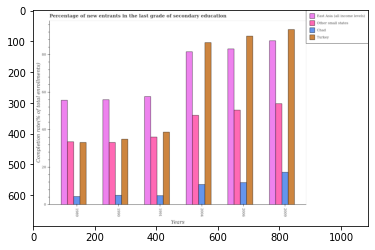

Number of QA =  30





,Years,Turkey,East Asia (all income levels),Chad,Other small states
0,2006,90.169431,83.550784,11.984771,51.023153
1,2004,86.382066,81.445415,10.953340,47.864444
2,2009,93.605798,87.310729,17.636701,53.808413
3,1990,34.965562,56.021475,5.200428,33.343638
4,1989,33.425386,55.445941,4.525596,33.656308
5,1991,38.790441,58.225780,5.033590,35.952514


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new entrants in turkey in 1991 and that in 2006 ?
PREDICTED =  -51.37899029450802
EXPECTED =  -51.18073813720699




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of new entrants in east asia (all income levels) in 1989 and the percentage of new entrants in chad in 1991?
PREDICTED =  -2.7798392476510614
EXPECTED =  50.874012382812495




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of new entrants in other small states and percentage of new entrants in east asia (all income levels) ?


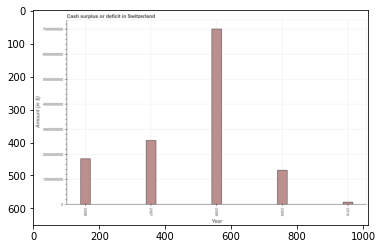

Number of QA =  23





,Year,Amount (in $)
0,2009,1.378590e+09
1,2006,1.842602e+09
2,2008,7.032030e+09
3,2007,2.564717e+09
4,2010,1.157942e+08


> what is the title of the graph ?
PREDICTED =  Cash surplus or deficit in Switzerland
EXPECTED =  Cash surplus or deficit in Switzerland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount (in $)
EXPECTED =  Amount (in $)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cash surplus or deficit in 2006 and 2009 ?
PREDICTED =  464012125.1732006
EXPECTED =  459338563.35




				 4 / 4 = 1.0


> what is the median cash surplus or deficit ?
PREDICTED =  None
EXPECTED =  1821987053.89001




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cash surplus or deficit in 2006 to that in 

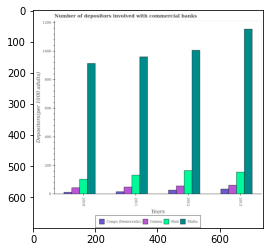

Number of QA =  30





,Years,Mali,Congo (Democratic;,Malta,Guinea
0,2012,166.140919,30.225106,1008.693608,59.513747
1,2013,156.415621,37.660444,1151.962215,64.465997
2,2010,105.959842,16.042186,915.596882,47.716688
3,2011,135.106953,19.485349,957.775202,52.324993


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors involved with commercial banks in mali in 2010 and that in 2011 ?
PREDICTED =  0.0
EXPECTED =  -28.70982721602799




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors involved with commercial banks in guinea in 2011 and the number of depositors involved with commercial banks in congo (democratic) in 2012?
PREDICTED =  -1.0
EXPECTED =  21.7609707958524




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of depositors involved with commercial banks in guinea and number of deposit

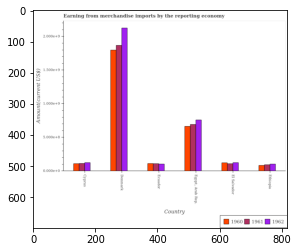

Number of QA =  29





,Country,1962,1961,1960
0,Egypt. Arab Rep.,0.766704,0.710375,0.672655
1,El Salvador,0.135966,0.119370,0.132712
2,Cyprus,0.134126,0.123742,0.120638
3,Denmark,2.090547,1.883344,1.821121
4,Ethiopia,0.113136,0.102117,0.093956
5,Ecuador,0.114217,0.119222,0.122037


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in 1960 in ecuador and that in el salvador ?
PREDICTED =  -0.010674758831676012
EXPECTED =  -11100000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in 1962 in egypt, arab rep. and the amount earned from merchandise imports in 1961 in ecuador?
PREDICTED =  0.652487211527094
EXPECTED =  649540000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports of/in 1962 and amount earned from merchandise imports of/in 1960 in ecuad

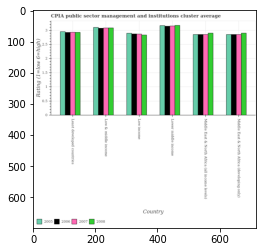

Number of QA =  30





,Country,2007,2005,2008,2006
0,Lower middle income,3.201753,3.199201,3.212179,3.178990
1,Least developed countries,2.948501,3.002968,2.969300,2.947834
2,Low & middle income,3.127579,3.139370,3.122834,3.125419
3,Low income,2.919318,2.940377,2.890309,2.920006
4,Middle East & North Africa (developing only),2.905774,2.884030,2.950904,2.902491
5,Middle East & North Africa (all income levels),2.894353,2.894559,2.946799,2.916878


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in low & middle income and that in middle east & north africa (developing only) ?
PREDICTED =  0.21660214692446678
EXPECTED =  0.18400000000000016




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in least developed countries and the cpia rating in 2007 in low & middle income?
PREDICTED =  -0.17758412798675405
EXPECTED =  -0.15752380952381007




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2007 and cpia rating of/in 2005 in middle east & north africa (all income levels)?
PREDICTE

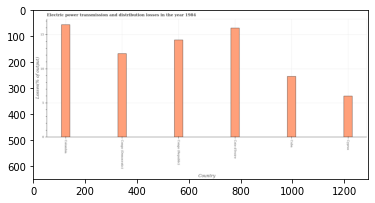

Number of QA =  22





,Country,Losses(% of output)
0,Congo (Democratic),12.187132
1,Congo (Republic),14.229038
2,NaN,6.066420
3,Colombia,16.444032
4,Cuba,8.872140
5,Cote d'Ivoire,15.961802


> what is the title of the graph ?
PREDICTED =  Electric power transmission and distribution losses in the year 1984
EXPECTED =  Electric power transmission and distribution losses in the year 1984




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Losses(% of output)
EXPECTED =  Losses(% of output)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the median electric power transmission and distribution losses ?
PREDICTED =  None
EXPECTED =  13.2263101315752




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the electric power transmission and distribution losses in colombia to that in cu

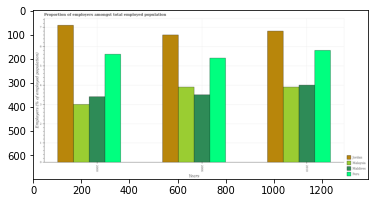

Number of QA =  30





,Years,Malaysia,Peru,Jordan,Maldives
0,2006,3.904390,5.402867,6.573782,3.478511
1,2010,3.914034,5.795742,6.768144,4.034814
2,2000,3.007410,5.600609,7.081963,3.407056


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of employers in malaysia in 2006 and that in 2010 ?
PREDICTED =  -0.009644197562798773
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of employers in peru in 2000 and the proportion of employers in jordan in 2010?
PREDICTED =  -5.795742290633713
EXPECTED =  -1.2000002861022896




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the proportion of employers in malaysia and proportion of employers in jordan ?
PREDICTED =  -13.512089183653979
EXPECTED =  -2.699999809265141




				 0 / 3 = 

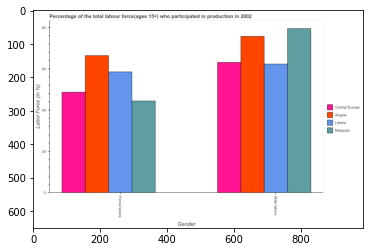

Number of QA =  23





,Gender,Angola,Liberia,Central Europe,Malaysia
0,Male labors,76.599329,62.860407,63.626867,79.818482
1,Femal labors,66.492615,59.137475,49.246563,44.909855


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in angola and that in liberia ?
PREDICTED =  13.738921953912836
EXPECTED =  13.399997711181705




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in central europe and the percentage of female labor force in liberia?
PREDICTED =  0.7664602369906532
EXPECTED =  4.605113905028723




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force and percentage of female labor force in central europe ?
PREDICTED =  -62.62686693869773
EXPECTED =  14.442700998571937


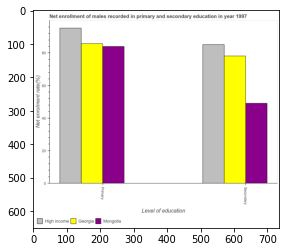

Number of QA =  23





,Level of education,Georgia,Mongolia,High income
0,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Net enrolment rate(%)
EXPECTED =  20.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Net enrollment of males recorded in primary and secondary education in year 1997
EXPECTED =  Net enrollment of males recorded in primary and secondary education in year 1997




				 1

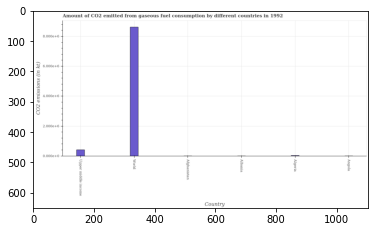

Number of QA =  22





,Country,CO2 emissions (in kt)
0,Afghanistan,NaN
1,Albania,NaN
2,Angola,NaN
3,Upper middle income,0.447600
4,World,8.693971
5,Algeria,0.059168


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption by different countries in 1992
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption by different countries in 1992




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in albania and upper middle income ?
PREDICTED =  -0.4476004197199881
EXPECTED =  -413479.253




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from 

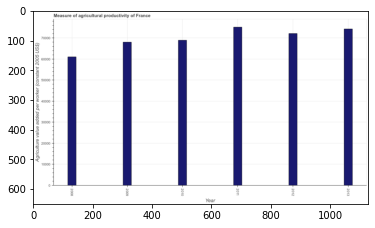

Number of QA =  23





,Year,Agriculture value added per worker (constant 2005 US$)
0,2009,67658.394798
1,2011,75003.792926
2,2008,61016.310817
3,2010,68563.024004
4,2012,72111.127627
5,2013,74312.781758


> what is the title of the graph ?
PREDICTED =  Measure of agricultural productivity of France
EXPECTED =  Measure of agricultural productivity of France




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Agriculture value added per worker (constant 2005 US$)
EXPECTED =  Agriculture value added per worker (constant 2005 US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agriculture value added per worker in 2008 and 2013 ?
PREDICTED =  -13296.470941021536
EXPECTED =  -13261.33




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median agriculture value added per worker ?
PREDICTED =  70337.07581

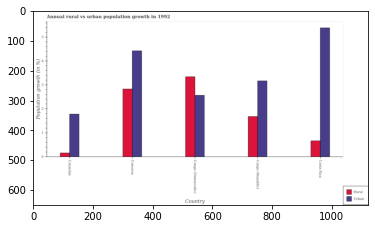

Number of QA =  28





,Country,Urban,Rural
0,Congo (Republic),3.207417,1.721181
1,Colombia,1.822531,0.195058
2,Congo (Democratic),2.605842,3.386326
3,Comoros,4.472808,2.844111
4,Costa Rica,5.445078,0.693655


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth in comoros and that in congo (republic) ?
PREDICTED =  1.1229299050879773
EXPECTED =  1.1503264902217498




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth in congo (republic) and the urban population growth in costa rica?
PREDICTED =  1.0275262349679002
EXPECTED =  -3.7046313626359




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population growth and rural population growth in congo (republic) ?
PREDICTED =  1.7925833662865753
EXPECTED =  1.4894979478980799




				 1 / 3 = 0.3333




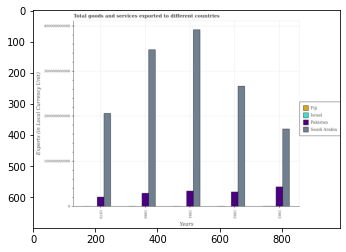

Number of QA =  30





,Years,Fiji,Israel,Saudi Arabia,Pakistan
0,1983,NaN,NaN,1.735307e+11,4.501807e+10
1,1981,NaN,NaN,3.940837e+11,3.602669e+10
2,1979,NaN,NaN,2.073853e+11,2.236859e+10
3,1980,NaN,NaN,3.491301e+11,3.094424e+10
4,1982,NaN,NaN,2.657213e+11,3.366731e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services exports in israel in 1982 and that in 1983 ?
PREDICTED =  4.0
EXPECTED =  -318180000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services exports in saudi arabia in 1982 and the amount of goods and services exports in fiji in 1983?
PREDICTED =  -219625997565.57806
EXPECTED =  266012899800.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the amount of goods and services exports in israel and amount of goods and services exports in fiji ?
PREDICTED =  5.0
EXPECTED =  -4

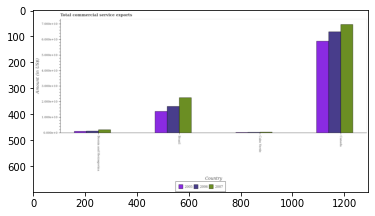

Number of QA =  29





,Country,2007,2005,2006
0,Bosnia and Herzegovina,0.236418,NaN,0.149422
1,Cabo Verde,NaN,NaN,NaN
2,Canada,6.978391,5.918405,6.518994
3,Brazil,2.281086,1.420089,1.738569


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service exports in 2006 in brazil and that in cabo verde ?
PREDICTED =  1.7385689710749268
EXPECTED =  16612744135.385895




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service exports in 2006 in cabo verde and the total commercial service exports in 2007 in brazil?
PREDICTED =  -1.7385689710749268
EXPECTED =  -22249136306.725395




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service exports of/in 2007 and total commercial service exports of/in 2005 in canada?
PREDICTED =  3.5774902

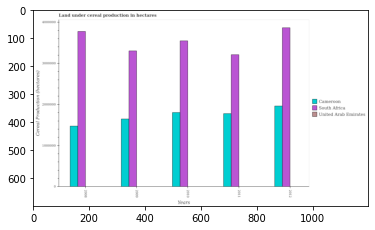

Number of QA =  29





,Years,South Africa,United Arab Emirates,Cameroon
0,2008,3.794172e+06,NaN,1.492025e+06
1,2011,3.231210e+06,NaN,1.782650e+06
2,2012,3.875281e+06,NaN,1.979287e+06
3,2009,3.311804e+06,NaN,1.653314e+06
4,2010,3.546452e+06,NaN,1.824485e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in united arab emirates in 2009 and that in 2010 ?
PREDICTED =  -3546452.1762534813
EXPECTED =  -364.4000000000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in cameroon in 2010 and the land under cereal production in south africa in 2009?
PREDICTED =  -1487319.6375619604
EXPECTED =  -1499130




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the land under cereal production in united arab emirates and land under cereal production in cameroon ?
PREDICTED =  nan


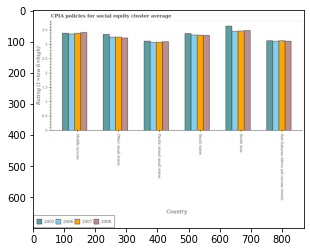

Number of QA =  30





,Country,2007,2005,2006,2008
0,Pacific island small states,3.077608,3.128733,3.068672,3.102014
1,Middle income,3.396894,3.398579,3.373628,3.425325
2,Other small states,3.257061,3.357098,3.260930,3.223209
3,Small states,3.340420,3.390069,3.353832,3.343458
4,Sub-Saharan Africa (all income levels),3.133782,3.131185,3.114371,3.113515
5,South Asia,3.491731,3.644362,3.461966,3.499952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in middle income and that in south asia ?
PREDICTED =  -0.0746272016131675
EXPECTED =  -0.06666666666666998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in pacific island small states and the cpia rating in 2007 in sub-saharan africa (all income levels)?
PREDICTED =  -0.011500968013036239
EXPECTED =  -0.03513513513513011




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2005 and cpia rating of/in 2008 in south asia?
PREDICTED =  -0.37121893181275833
EXPECTED =  0.1553571428571

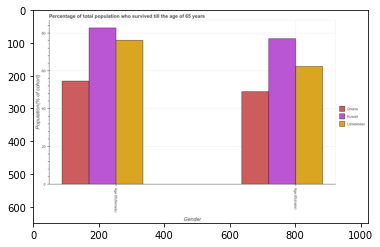

Number of QA =  23





,Gender,Uzbekistan,Ghana,Kuwait
0,Age 65 (female),76.444163,54.785523,83.237548
1,Age 65(male),62.862188,49.444426,77.226780


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in ghana and that in uzbekistan ?
PREDICTED =  -13.417761669553919
EXPECTED =  -13.309339999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female population who survived till age of 65 in ghana and the percentage of male population who survived till age of 65 in uzbekistan?
PREDICTED =  -62.86218766761221
EXPECTED =  -7.745280000000008




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

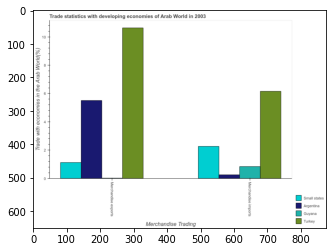

Number of QA =  23





,Merchandise Trading,Unnamed: 1,Turkey,Small states,Argentina
0,Merchandise imports,0.88887,6.303349,2.322001,0.297351
1,Merchandise exports,NaN,10.746300,1.179080,5.594693


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade with economies in the Arab World(%)
EXPECTED =  2.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with developing economies of Arab World in 2003
EXPECTED =  Trade statistics with developing economies of Arab World in 2003




				 1 / 6 = 0.1667

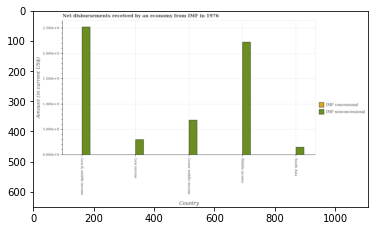

Number of QA =  24





,Country,IMF concessional,IMF nonconcessional
0,South Asia,NaN,0.161030
1,Lower middle income,NaN,0.689691
2,Middle income,NaN,2.218714
3,Low income,NaN,0.309805
4,Low & middle income,NaN,2.517236


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in low & middle income and that in middle income ?
PREDICTED =  -2.2187144452121568
EXPECTED =  299056000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net concessional disbursements from imf and net non concessional disbursements from imf in low income ?
PREDICTED =  nan
EXPECTED =  -297873000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ne

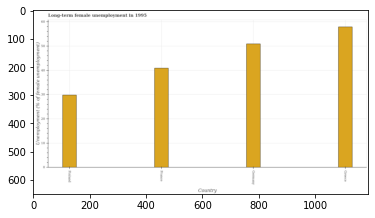

Number of QA =  22





,Country,Unemployment (% of female unemployment)
0,Greece,57.997919
1,Germany,51.059727
2,France,40.809583
3,Finland,30.023796


> what is the title of the graph ?
PREDICTED =  Long-term female unemployment in 1995
EXPECTED =  Long-term female unemployment in 1995




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployment (% of female unemployment)
EXPECTED =  Unemployment (% of female unemployment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term female unemployment in finland and germany ?
PREDICTED =  -21.035930328294263
EXPECTED =  -21.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term female unemployment ?
PREDICTED =  45.934654629611515
EXPECTED =  45.9000015258789




				 5 / 

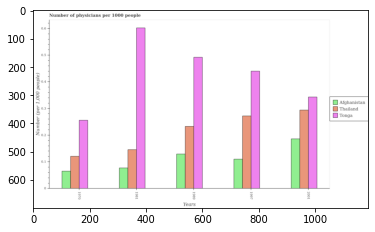

Number of QA =  29





,Years,Thailand,Afghanistan,Tonga
0,2001,0.296482,0.189694,0.345357
1,1970,0.123992,0.067187,0.257672
2,1997,0.275194,0.110109,0.444964
3,1981,0.147905,0.079455,0.608841
4,1989,0.236440,0.130616,0.495772


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in tonga in 1981 and that in 1997 ?
PREDICTED =  0.16387719726279226
EXPECTED =  0.16219997167587202




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in afghanistan in 2001 and the number of physicians in tonga in 1970?
PREDICTED =  0.9328129255892762
EXPECTED =  -0.06980000877380388




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the number of physicians in afghanistan and number of physicians in tonga ?
PREDICTED =  0.0
EXPECTED =  -0.36290000379085585




				 1 / 3 = 0.3333




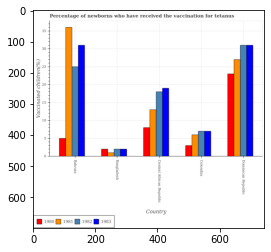

Number of QA =  30





,Country,1982,1980,1983,1981
0,Bahrain,25.194494,5.162116,31.173729,35.877897
1,Central African Republic,18.240298,8.193148,19.214803,13.301928
2,Dominican Republic,31.305529,23.334818,31.150181,27.448566
3,Bangladesh,2.146154,2.152067,2.166899,1.152769
4,Colombia,7.176412,3.156255,7.212505,6.230569


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in 1981 in bahrain and that in bangladesh ?
PREDICTED =  34.72512784992168
EXPECTED =  35.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in 1982 in colombia and the percentage of vaccinated children in 1980 in central african republic?
PREDICTED =  -1.0167366562389901
EXPECTED =  -1.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children of/in 1983 and percentage of vaccinated children of/in 1981 in central african republic?
PREDICTED = 

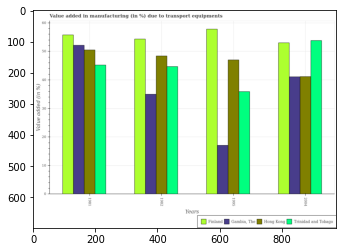

Number of QA =  30





,Years,"Gambia, The",Finland,Hong Kong,Trinidad and Tobago
0,1995,17.389917,58.806629,47.349232,36.269862
1,1981,52.723835,56.273024,51.078523,45.782440
2,1982,35.293349,54.897412,49.035859,45.266748
3,2004,41.626668,53.777590,41.557128,54.081853


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in gambia, the in 1981 and that in 1982 ?
PREDICTED =  17.430485390738035
EXPECTED =  17.17055851393509




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in trinidad and tobago in 1981 and the percentage of value added in manufacturing due to transport equipments in finland in 1982?
PREDICTED =  -110.17043592993224
EXPECTED =  -9.120417081771393




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the differenc

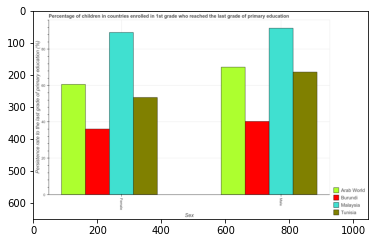

Number of QA =  23





,Sex,Malaysia,Burundi,Tunisia,Arab World
0,Female,89.754065,36.512711,53.35785,60.683714
1,Male,92.268286,40.715055,68.03110,70.431873


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of female students in tunisia and that in arab world ?
PREDICTED =  -7.325863881890179
EXPECTED =  -7.191220198974605




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of female students in malaysia and the persistence rate of male students in burundi?
PREDICTED =  53.241353938829974
EXPECTED =  48.96851




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of male students and persistence rate of female students in burundi ?
PREDICTED =  55.755575035587555
EXPECTED =  4.168980000000005




	

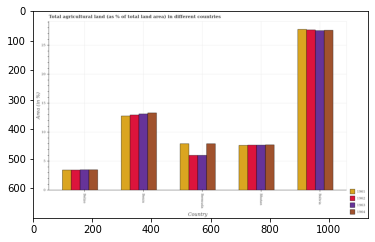

Number of QA =  30





,Country,1963,1964,1962,1961
0,Belize,3.532713,3.591159,3.568274,3.574816
1,Bhutan,7.759909,7.927764,7.848508,7.820458
2,Bolivia,27.727563,27.727548,27.825755,27.951663
3,Benin,13.199061,13.432895,13.035182,12.860651
4,Bermuda,6.051710,8.070864,6.065004,8.124603


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1964 in belize and that in bhutan ?
PREDICTED =  -4.336605441434255
EXPECTED =  -4.304764703948891




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1963 in benin and the percentage of agricultural land in 1962 in bolivia?
PREDICTED =  -14.528502128396594
EXPECTED =  -14.496661184685099




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land of/in 1962 and percentage of agricultural land of/in 1964 in bhutan?
PREDICTED =  -4.359490305250564
EXP

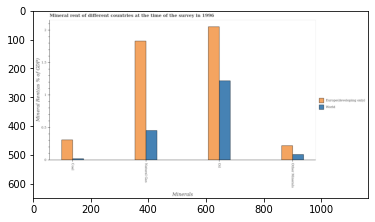

Number of QA =  29





,Minerals,Europe(developing only),World
0,Natural Gas,1.844607,0.464647
1,Other Minerals,0.225872,0.089929
2,Coal,0.319462,NaN
3,Oil,2.062351,1.221833


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the  rent of other minerals in world and that in europe(developing only) ?
PREDICTED =  -0.13594309141927594
EXPECTED =  -0.13672689520061088




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent and natural gas rent in europe(developing only) ?
PREDICTED =  0.0
EXPECTED =  0.22051416530808998




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the  rent of other minerals in europe(developing only) 

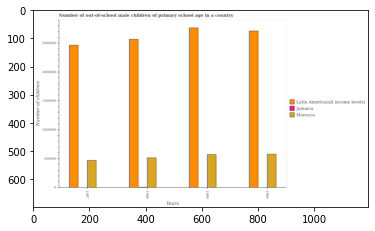

Number of QA =  29





,Years,Morocco,Jamaica,Latin America(all income levels)
0,1990,587861.245377,NaN,2.707457e+06
1,1988,519474.985305,NaN,2.564517e+06
2,1987,478524.342206,NaN,2.467282e+06
3,1989,575929.416056,NaN,2.772315e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in jamaica in 1987 and that in 1988 ?
PREDICTED =  1947807.0689737448
EXPECTED =  -5901.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in latin america(all income levels) in 1989 and the number of out-of-school male children in morocco in 1990?
PREDICTED =  64857.87664455501
EXPECTED =  2186038.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the number of out-of-school male children in morocco and number of out-of-school male children in lat

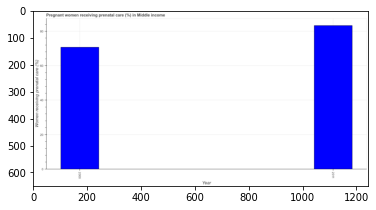

Number of QA =  19





,Year,Women receiving prenatal care (%)
0,2000,71.482551
1,2011,83.524522


> what is the title of the graph ?
PREDICTED =  Pregnant women receiving prenatal care (%) in Middle income
EXPECTED =  Pregnant women receiving prenatal care (%) in Middle income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Women receiving prenatal care (%)
EXPECTED =  Women receiving prenatal care (%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant women receiving prenatal care in 2000 and 2011 ?
PREDICTED =  -12.041971443412692
EXPECTED =  -12.607




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of pregnant women receiving prenatal care ?
PREDIC

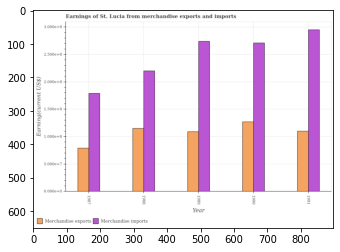

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1989,2.741086,1.095111
1,1990,2.721136,1.278114
2,1991,2.961943,1.112462
3,1988,2.211101,1.163574
4,1987,1.795327,0.801986


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1990 and that in 1991 ?
PREDICTED =  0.16565177648424356
EXPECTED =  17000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1990 and the earnings from merchandise imports in 1991?
PREDICTED =  0.16565177648424356
EXPECTED =  17000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from merchandise imports 

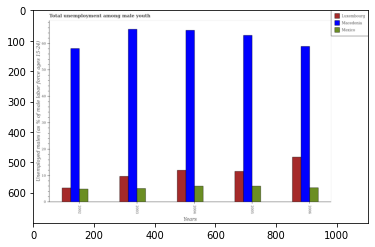

Number of QA =  29





,Years,Luxembourg,Mexico,Macedonia
0,2005,12.009637,6.302506,64.058101
1,2006,17.372932,5.633442,59.835224
2,2003,9.912554,5.382318,66.323026
3,2002,5.541585,5.130739,58.825768
4,2004,12.410605,6.295497,66.089028


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed males in in mexico in 2004 and that in 2006 ?
PREDICTED =  0.6620551535079917
EXPECTED =  0.599999904632571




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed males in in macedonia in 2003 and the percentage of unemployed males in in mexico in 2006?
PREDICTED =  6.487802453003049
EXPECTED =  60.00000143051146




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of unemployed males in in mexico and percentage of unemployed males in in luxembourg ?
PREDICTED =  -3.84

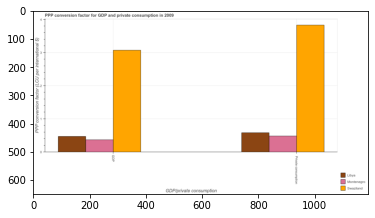

Number of QA =  23





,GDP/private consumption,Swaziland,Libya,Montenegrc
0,Private consumption,3.877438,0.614999,0.514045
1,GDP,3.101185,0.501793,0.401978


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ppp conversion factor for gdp in libya to that in swaziland ?
PREDICTED =  0.16180680555956373
EXPECTED =  0.15275572616461466




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  PPP conversion factor (LCU per international $)
EXPECTED =  1.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  PPP

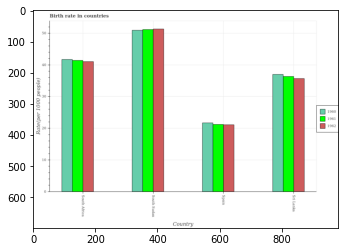

Number of QA =  29





,Country,1962,1961,1960
0,South Africa,41.057814,41.482230,41.788352
1,South Sudan,51.321759,51.033429,51.016921
2,NaN,21.173131,21.293472,21.863932
3,Sri Lanka,35.806242,36.378147,36.993008


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 1960 in spain and that in sri lanka ?
PREDICTED =  6.273085537494708
EXPECTED =  -15.297




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 1962 in sri lanka and the birth rate in 1960 in south africa?
PREDICTED =  -5.251571760740418
EXPECTED =  -6.021000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate of/in 1961 and birth rate of/in 1960 in sri lanka?
PREDICTED =  -3.9417249394605776
EXPECTED =  -0.6409999999999982




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPU

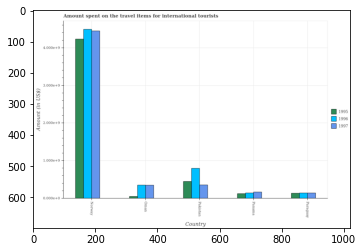

Number of QA =  29





,Country,1997,1996,1995
0,Oman,0.360737,0.360529,0.063347
1,Paraguay,0.152857,0.152985,0.145126
2,Pakistan,0.365538,0.813611,0.456374
3,Norway,4.454845,4.519034,4.240705
4,Panama,0.176314,0.151787,0.136114


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for international tourists in 1997 in oman and that in pakistan ?
PREDICTED =  -0.0048012812152896656
EXPECTED =  -6000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for international tourists in 1996 in panama and the amount spent on the travel items for international tourists in 1997 in norway?
PREDICTED =  -4.367247233095373
EXPECTED =  -4308000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for international tourists of/

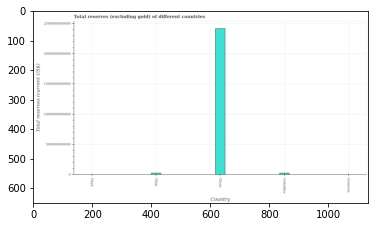

Number of QA =  22





,Country,Total reserves (current US$)
0,Comoros,NaN
1,China,2.446458e+12
2,Chad,NaN
3,Colombia,3.421146e+10
4,Chile,3.366274e+10


> what is the title of the graph ?
PREDICTED =  Total reserves (excluding gold) of different countries
EXPECTED =  Total reserves (excluding gold) of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total reserves (current US$)
EXPECTED =  Total reserves (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (excluding gold) ?
PREDICTED =  34211462620.92121
EXPECTED =  24747664433.0098




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

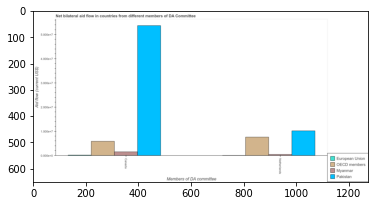

Number of QA =  23





,Members of DA committee,OECD members,Myanmar,Pakistan,European Union
0,Netherlands,0.792645,0.063955,1.033512,NaN
1,NaN,0.608520,0.168175,5.411218,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by netherlands in myanmar and that in pakistan ?
PREDICTED =  0.9664882518611464
EXPECTED =  -9760000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by canada in oecd members and the amount of aid given by netherlands in european union?
PREDICTED =  0.0
EXPECTED =  5860000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by canada and amount of aid given by netherlands in pakistan ?
PREDICTED =  -4.444729287354888
EXPECTED =  43500000




				 0 / 3 = 0.0


is_built_with_cuda

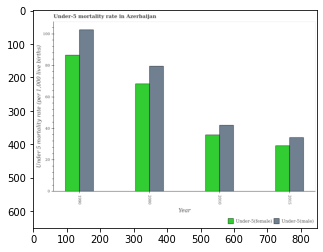

Number of QA =  28





,Year,Under-5(male),Under-5(female)
0,2010,42.539253,36.163255
1,2015,34.508339,29.645115
2,2000,79.742302,68.429545
3,1990,103.052689,86.613965


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 2000 and that in 2015 ?
PREDICTED =  45.233962538297995
EXPECTED =  45.3




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 female mortality rate in 2000 and the under-5 male mortality rate in 2010?
PREDICTED =  32.26628970377486
EXPECTED =  32.4




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the under-5 male mortality rate and under-5 female mortality rate ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

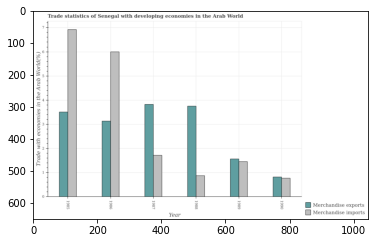

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1988,0.889675,3.712580
1,1990,0.777818,0.826358
2,1989,1.460344,1.561796
3,1985,6.875077,3.512527
4,1987,1.725201,3.818243
5,1986,5.927481,3.156010


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1989 and that in 1990 ?
PREDICTED =  0.7354381979005278
EXPECTED =  0.746876129505269




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1990 and the merchandise exports in 1985?
PREDICTED =  -6.097259677563578
EXPECTED =  -6.150149886243295




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  -14.891010560410427
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

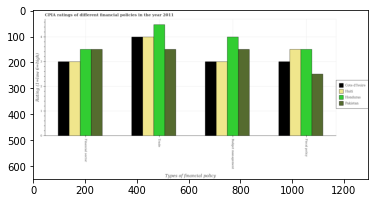

Number of QA =  29





,Types of financial policy,Honduras,Pakistan,Cote d'Ivoire,Haiti
0,Budget management,4.021281,3.519386,3.034966,3.017765
1,Trade,4.517220,3.529493,4.020341,4.022254
2,Financial sector,3.476831,3.526856,3.015332,3.014387
3,Fiscal policy,3.525236,2.515376,NaN,3.518746


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of financial sector in cote d'ivoire and that in honduras ?
PREDICTED =  0.0
EXPECTED =  -0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of financial sector in pakistan and the cpia rating of budget management in haiti?
PREDICTED =  0.5107802465648925
EXPECTED =  0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of trade and cpia rating of fiscal policy in haiti ?
PREDICTED =  -2.518745587676039
EXPECTED =  0.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

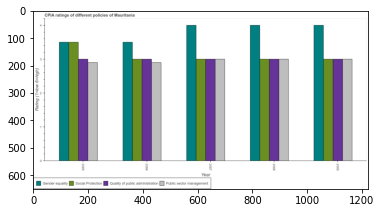

Number of QA =  30





,Year,Public sector management,Gender equality,Quality of public administration,Social Protection
0,2009,3.007222,4.006725,3.027573,3.026493
1,2007,3.015144,4.031327,3.026579,3.015108
2,2006,2.914612,3.502732,3.022972,3.010612
3,2005,2.926267,3.514948,3.005072,3.518854
4,2008,3.022522,4.027466,3.024720,3.014580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of social protection in 2005 and that in 2008 ?
PREDICTED =  0.5042743766151112
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of quality of public administration in 2008 and the cpia rating of public sector management in 2009?
PREDICTED =  0.2
EXPECTED =  0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the cpia rating of social protection and cpia rating of quality of public administration ?
PREDICTED =  0.2
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

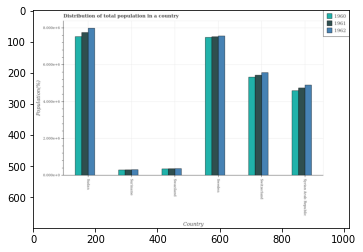

Number of QA =  29





,Country,1962,1961,1960
0,Sudan,8.052590,7.789931,7.590525
1,Syrian Arab Republic,4.943288,4.794832,4.660383
2,Suriname,0.336263,0.323399,0.320095
3,Switzerland,5.615226,5.485917,5.350471
4,Swaziland,0.392755,0.385795,0.378339
5,Sweden,7.601963,7.565386,7.542125


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of in 1961 in suriname and that in sweden ?
PREDICTED =  -7.241986830535911
EXPECTED =  -7221808.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of in 1962 in suriname and the population of in 1961 in swaziland?
PREDICTED =  -0.05649254844597079
EXPECTED =  -51192.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of of/in 1961 and population of of/in 1960 in syrian arab republic?
PREDICTED =  -4.336984222096562
EXPECTED =  149819.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fal

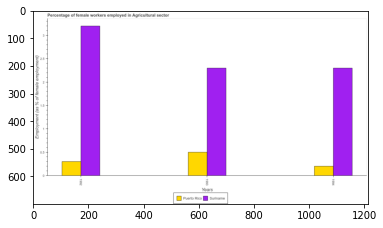

Number of QA =  28





,Years,Puerto Rico,Suriname
0,1994,0.214761,2.332527
1,1993,0.511149,2.343008
2,1992,0.311179,3.241201


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in agricultural sector in puerto rico in 1993 and that in 1994 ?
PREDICTED =  0.2963885105478645
EXPECTED =  0.299999997019768




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in agricultural sector in suriname in 1992 and the percentage of females employed in agricultural sector in puerto rico in 1994?
PREDICTED =  0.9086736771880615
EXPECTED =  3.000000044703488




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the percentage of females employed in agricultural

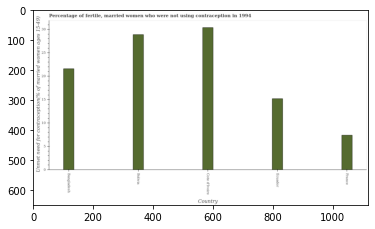

Number of QA =  22





,Country,Unmet need for contraception(% of married women ages 15-49)
0,Bangladesh,21.724202
1,France,7.526319
2,Bolivia,29.078255
3,Cote d'Ivoire,30.552912
4,Ecuador,15.347212


> what is the title of the graph ?
PREDICTED =  Percentage of fertile, married women who were not using contraception in 1994
EXPECTED =  Percentage of fertile, married women who were not using contraception in 1994




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unmet need for contraception(% of married women ages 15-49)
EXPECTED =   Unmet need for contraception(% of married women ages 15-49)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of married women who are not using contraception in bangladesh and ecuador ?
PREDICTED =  2.0
EXPECTED =  6.4




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

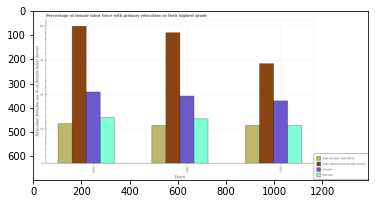

Number of QA =  30





,Years,Sweden,High income: nonOECD,Croatia,Latin America(all income levels)
0,2006,13.443331,11.618305,21.002913,40.131356
1,2007,13.146529,11.152500,19.743179,38.080122
2,2011,11.041076,11.194441,18.307060,29.274774


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with primary education in latin america(all income levels) in 2006 and that in 2011 ?
PREDICTED =  10.856582484712188
EXPECTED =  10.888513738905711




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with primary education in high income: nonoecd in 2007 and the percentage of female labor force with primary education in sweden in 2006?
PREDICTED =  -0.4658046807368468
EXPECTED =  -2.2673496085548006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percenta

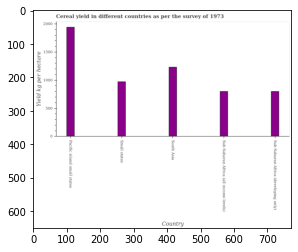

Number of QA =  22





,Country,Yield kg per hectare
0,Small states,973.319587
1,South Asia,1235.254973
2,Pacific island small states,1947.690642
3,Sub-Saharan Africa (all income levels),807.500737
4,Sub-Saharan Africa (developing only),810.652551


> what is the title of the graph ?
PREDICTED =  Cereal yield in different countries as per the survey of 1973
EXPECTED =  Cereal yield in different countries as per the survey of 1973




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Yield kg per hectare
EXPECTED =  Yield kg per hectare




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal yield in south asia and sub-saharan africa (developing only) ?
PREDICTED =  424.60242168488253
EXPECTED =  432.47




				 4 / 4 = 1.0


> what is the median cereal yield ?
PREDICTED =  None
EXPECTED =  972.400147095622




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

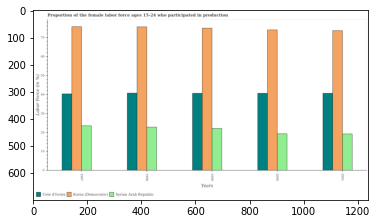

Number of QA =  29





,Years,Syrian Arab Republic,Cote d'Ivoire,Korea (Democratic)
0,2000,19.510081,40.689221,74.162044
1,1997,23.716209,40.569770,75.691839
2,2001,19.404608,40.659709,73.615009
3,1999,22.082278,40.754075,75.031791
4,1998,22.883323,40.746712,75.939789


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in korea (democratic) in 2000 and that in 2001 ?
PREDICTED =  0.5470350352063491
EXPECTED =  0.4000015258790057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in syrian arab republic in 1998 and the proportion of the female labor force who participated in production in korea (democratic) in 1999?
PREDICTED =  0.8010448694635386
EXPECTED =  -52.1000022888184




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the 

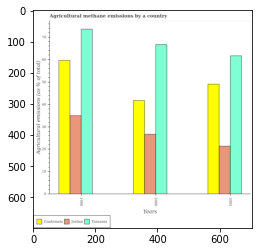

Number of QA =  29





,Years,Tanzania,Jordan,Guatemala
0,2005,61.720574,21.602097,49.198616
1,1990,73.577951,34.977725,59.684878
2,2000,66.594451,26.736344,41.922676


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in tanzania in 1990 and that in 2000 ?
PREDICTED =  6.983499958107259
EXPECTED =  6.8735249641867




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in tanzania in 2000 and the amount of agricultural methane emitted in guatemala in 1990?
PREDICTED =  -6.983499958107259
EXPECTED =  7.107940797435894




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of agricultural methane emitted in tanzania and amount of agricultural methane emitted in jo

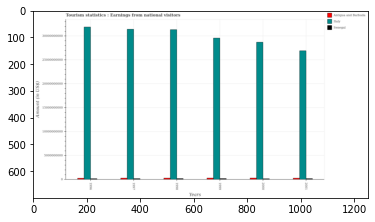

Number of QA =  29





,Years,Senegal,Antigua and Barbuda,Italy
0,1997,2.742952e+08,3.802036e+08,3.156950e+10
1,1999,2.914089e+08,4.153865e+08,2.967570e+10
2,1996,2.728055e+08,3.727410e+08,3.200811e+10
3,1998,NaN,3.911253e+08,3.149213e+10
4,2001,NaN,3.858716e+08,2.696416e+10
5,2000,2.617673e+08,3.976940e+08,2.887405e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from national visitors in antigua and barbuda in 1997 and that in 1999 ?
PREDICTED =  35182918.0819453
EXPECTED =  -12000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from national visitors in senegal in 1997 and the earnings from national visitors in antigua and barbuda in 1999?
PREDICTED =  -17113700.151414514
EXPECTED =  -119000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the earnings from national visitors in italy and earnings from national visitors in antigua and barbuda ?
PREDICTED

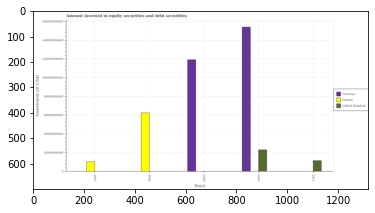

Number of QA =  22





,Years,United Kingdom,Germany,Ireland
0,2011,1.188997e+10,NaN,NaN
1,2008,NaN,NaN,6.299744e+10
2,2009,NaN,1.196280e+11,NaN
3,2010,2.359776e+10,1.545234e+11,NaN
4,2007,NaN,NaN,1.076457e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in united kingdom in 2010 and that in 2011 ?
PREDICTED =  11889970244.661331
EXPECTED =  11542515306




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in ireland in 2007 and the amount invested in equity securities and debt securities in germany in 2009?
PREDICTED =  -84140322762.49504
EXPECTED =  -108893886080.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest amount invested in equity securities and d

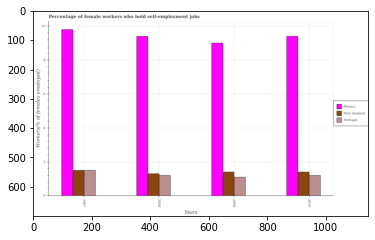

Number of QA =  29





,Years,Mexica,New Zealand,Portugal
0,2008,9.367504,1.328162,1.220830
1,2010,9.400245,1.425276,1.230147
2,2007,9.840253,1.522430,1.533959
3,2009,9.005011,1.429705,1.116896


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in portugal in 2008 and that in 2009 ?
PREDICTED =  0.1039339659589662
EXPECTED =  0.10000002384186013




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in new zealand in 2007 and the percentage of self-employed female workers in portugal in 2010?
PREDICTED =  0.0971540396392343
EXPECTED =  0.29999995231627996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of self-employed female workers in mexico and percentage of self-em

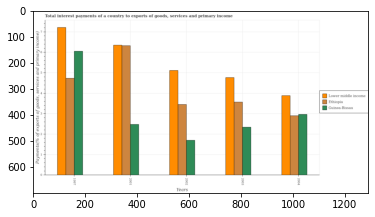

Number of QA =  29





,Years,Ethiopia,Guinea-Bissau,Lower middle income
0,2001,6.409412,2.525879,6.426991
1,2002,3.466969,1.735583,5.197889
2,2004,2.937375,3.012816,3.931523
3,2003,3.611086,2.386652,4.801637
4,1997,4.804474,6.112468,7.303085


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments in guinea-bissau in 1997 and that in 2002 ?
PREDICTED =  4.376884100553671
EXPECTED =  4.35149932279712




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments in lower middle income in 2003 and the total interest payments in guinea-bissau in 1997?
PREDICTED =  -2.50144813018961
EXPECTED =  -1.2858961523501398




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the total interest payments in lower middle income and total interest payments in guinea-bissau ?
PREDICTED =  22.661126292194

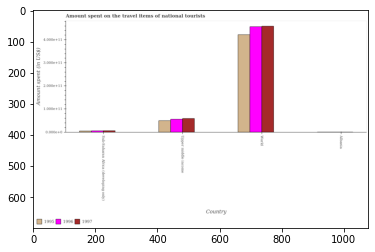

Number of QA =  29





,Country,1996,1997,1995
0,Albania,NaN,NaN,NaN
1,World,4.575538,4.632464,4.244649
2,Upper middle income,0.594064,0.624126,0.521979
3,Sub-Saharan Africa (developing only),0.083748,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in 1997 in upper middle income and that in world ?
PREDICTED =  0.0
EXPECTED =  -399655848134.60803




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in 1997 in world and the amount spent on the travel items of national tourists in 1995 in albania?
PREDICTED =  4.0083380495236245
EXPECTED =  458815325650.437




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists of/in 1995 and amount 

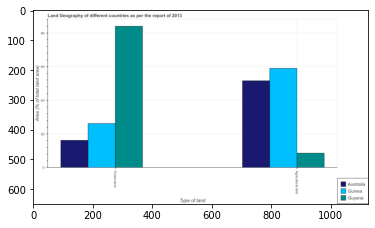

Number of QA =  23





,Type of land,Australia,Guinea,Guyana
0,Agricultural land,52.296593,59.502166,8.994939
1,Forest land,16.775040,26.760669,85.171634


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in australia and that in guyana ?
PREDICTED =  43.30165414098914
EXPECTED =  43.1028988813507




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in guinea and the percentage of land area under agriculture in australia?
PREDICTED =  -7.775147489121185
EXPECTED =  -25.434741799960797




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture and percentage of land area under forests in guinea ?
PREDICTED =  -25.76066904123324
EXPE

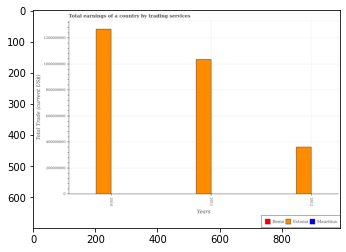

Number of QA =  23





,Years,Estonia,Mauritius,Benin
0,2010,1.262693e+09,NaN,NaN
1,2011,1.034044e+09,NaN,NaN
2,2012,3.620985e+08,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in estonia in 2010 and that in 2012 ?
PREDICTED =  900594774.713146
EXPECTED =  906822409.9




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in estonia in 2010 and the total earnings in benin in 2012?
PREDICTED =  900594774.713146
EXPECTED =  1268320209.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total earnings in estonia in 2010 to that in 2012?
PREDICTED =  3.487154014393074
EXPECTED =  3.5085143316436858




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

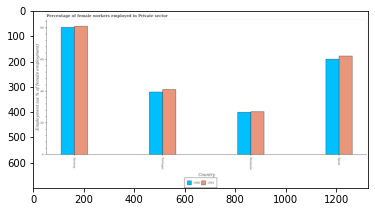

Number of QA =  28





,Country,1980,1981
0,Norway,80.724856,81.889637
1,NaN,60.790893,62.642864
2,Romania,27.235557,27.548212
3,Portugal,40.144175,41.306861


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in 1981 in romania and that in spain ?
PREDICTED =  0.0
EXPECTED =  -35.10000038146981




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in 1980 in romania and the percentage of females employed in private sector in 1981 in spain?
PREDICTED =  27.235557463713608
EXPECTED =  -35.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector of/in 1980 and percentage of females employed in private sector of

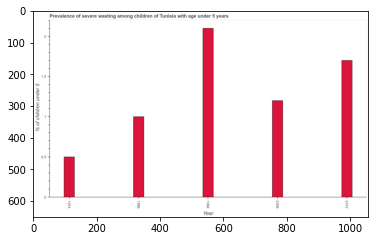

Number of QA =  23





,Year,% of children under 5
0,1988,1.009701
1,1974,0.506656
2,2006,1.210920
3,1994,2.122803
4,2012,1.706481


> what is the title of the graph ?
PREDICTED =  Prevalence of severe wasting among children of Tunisia with age under 5 years
EXPECTED =  Prevalence of severe wasting among children of Tunisia with age under 5 years




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of children under 5
EXPECTED =   % of children under 5




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prevalence of severe wasting in 1974 and 1988 ?
PREDICTED =  -0.5030457115884027
EXPECTED =  -0.5




				 3 / 4 = 0.75


> what is the median prevalence of severe wasting ?
PREDICTED =  None
EXPECTED =  1.20000004768372




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finishe

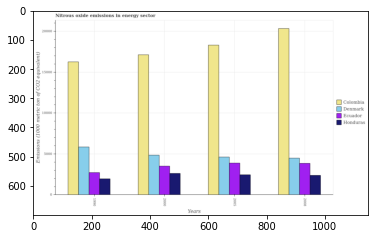

Number of QA =  30





,Years,Honduras,Denmark,Colombia,Ecuador
0,1990,2016.613590,5869.160378,16203.138950,2782.946313
1,2008,2448.941876,4558.946025,20332.933107,3886.106229
2,2005,2507.076290,4654.113875,18292.072886,3940.222136
3,2000,2668.306668,4900.601962,17084.398276,3547.477786


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in denmark in 2000 and that in 2005 ?
PREDICTED =  246.4880868256887
EXPECTED =  232.19999999999982




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in colombia in 2000 and the amount of nitrous oxide emitted in ecuador in 2008?
PREDICTED =  -3248.534830512486
EXPECTED =  13280.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of nitrous oxide emitted in colombia and amount of nitrous oxide emitted in denmark ?
PREDICTED =  51929.7209796959
EXPECTE

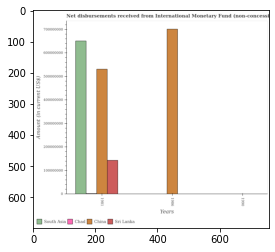

Number of QA =  24





,Years,Chad,South Asia,China,Sri Lanka
0,1990,NaN,NaN,NaN,NaN
1,1986,NaN,NaN,7.098304e+08,NaN
2,1981,NaN,6.543993e+08,5.344094e+08,1.470951e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in china in 1981 and that in 1986 ?
PREDICTED =  -709830424.6532685
EXPECTED =  -170296000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in south asia in 1981 and the amount of disbursements received from international monetary fund in chad in 1990?
PREDICTED =  654399313.8635193
EXPECTED =  650896000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1981, what is the difference between the amount of disbursements received fr

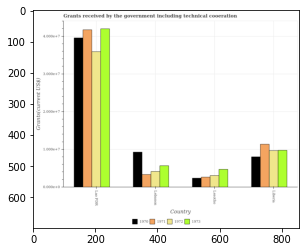

Number of QA =  30





,Country,1972,1971,1970,1973
0,Lebanon,0.428283,0.345135,NaN,0.578389
1,Liberia,0.983280,1.154009,0.815184,0.988686
2,Lao PDR,3.576995,4.201173,3.982960,4.227726
3,Lesotho,0.314685,0.276010,0.248642,0.480288


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in 1972 in lao pdr and that in lesotho ?
PREDICTED =  3.262309572240432
EXPECTED =  32850000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in 1972 in liberia and the total grants received by the government in 1970 in lesotho?
PREDICTED =  0.6685954635119364
EXPECTED =  7300000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government of/in 1972 and total grants received by the government of/in 1973 in lesotho?
PREDICTED 

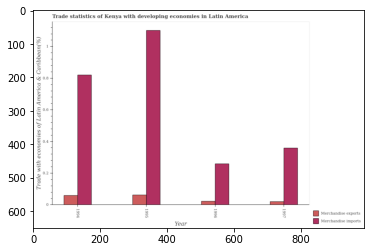

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1995,1.102965,0.065922
1,1994,0.820362,0.062408
2,1997,0.360075,0.023984
3,1996,0.260273,0.026670


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1994 and that in 1997 ?
PREDICTED =  0.46028658751478246
EXPECTED =  0.46126413180450915




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1997 and the merchandise imports in 1994?
PREDICTED =  -0.03842318223330845
EXPECTED =  -0.0386614082071925




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  0.591172594852706
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Traini

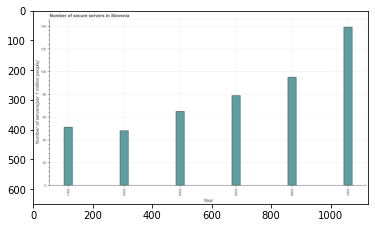

Number of QA =  23





,Year,Number of servers(per 1 million people)
0,2005,79.654451
1,2004,65.678878
2,2001,51.776976
3,2007,140.079359
4,2006,95.944003
5,2003,48.906935


> what is the title of the graph ?
PREDICTED =  Number of secure servers in Slovenia
EXPECTED =  Number of secure servers in Slovenia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of servers(per 1 million people)
EXPECTED =  Number of servers(per 1 million people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in 2005 and 2006 ?
PREDICTED =  -16.289552718329887
EXPECTED =  -16.192




				 4 / 4 = 1.0


> what is the median number of secure internet servers ?
PREDICTED =  None
EXPECTED =  72.03926836785845




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

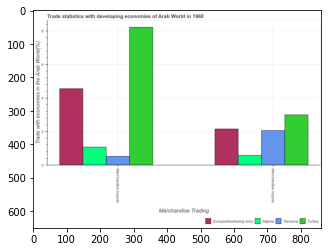

Number of QA =  23





,Merchandise Trading,Turkey,Algeria,Tanzania,Europe(developing only)
0,Merchandise exports,8.285575,1.117121,0.550983,4.573790
1,Merchandise imports,3.053408,0.610147,2.079181,2.201859


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade with economies in the Arab World(%)
EXPECTED =  2.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with developing economies of Arab World in 1960
EXPECTED =  Trade statistics with developing economies of Arab World in 1960




				 1 / 6 = 0.1667

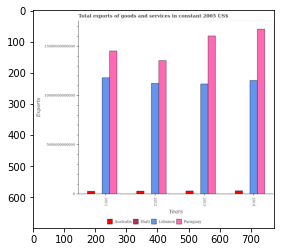

Number of QA =  30





,Years,Lebanon,Australia,Haiti,Paraguay
0,2011,1.188250e+13,3.416345e+11,NaN,1.459729e+13
1,2014,1.166592e+13,3.775629e+11,NaN,1.691783e+13
2,2012,1.132438e+13,3.582847e+11,NaN,1.350395e+13
3,2013,1.126849e+13,3.744486e+11,NaN,1.611559e+13


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in lebanon in 2012 and that in 2013 ?
PREDICTED =  -22592878015703.348
EXPECTED =  60317771200.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in paraguay in 2014 and the total exports of goods and services in lebanon in 2013?
PREDICTED =  -16115593708325.78
EXPECTED =  5573031528600.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the total exports of goods and services in lebanon and total exports of goods and services in paraguay ?
PREDICTED = 

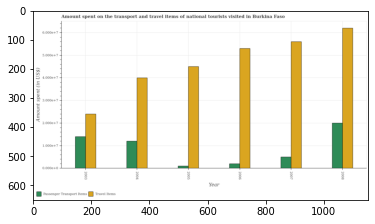

Number of QA =  28





,Year,Travel Items,Passenger Transport Items
0,2006,5.299035,0.216785
1,2003,2.407050,1.407204
2,2005,4.497904,0.119128
3,2008,6.200929,1.998625
4,2007,5.598123,0.514462
5,2004,3.996397,1.217754


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2003 and that in 2008 ?
PREDICTED =  -0.5914205603695184
EXPECTED =  -6000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in 2006 and the amount spent on passenger transport items in 2008?
PREDICTED =  -0.9018936511177218
EXPECTED =  -9000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the amount spent in travel items and amount spent on passenger transport items ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda:

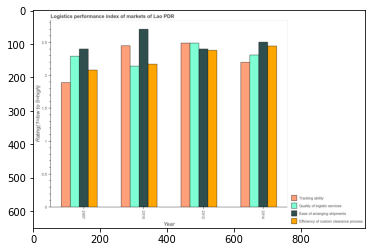

Number of QA =  30





,Year,Tracking ability,Ease of arranging shipments,Quality of logistic services,Efficiency of custom clearance process
0,2012,2.504465,2.419531,2.511687,2.393123
1,2014,2.225376,2.526468,2.326731,2.459279
2,2007,1.905677,2.426705,2.301866,2.098377
3,2010,2.474228,2.734506,2.149816,2.190810


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of quality of logistic services in 2007 and that in 2012 ?
PREDICTED =  -0.20982134995514068
EXPECTED =  -0.20000000000000018




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of quality of logistic services in 2014 and the lpi rating of tracking ability in 2012?
PREDICTED =  -0.18495635123537602
EXPECTED =  -0.18104900000000024




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio o

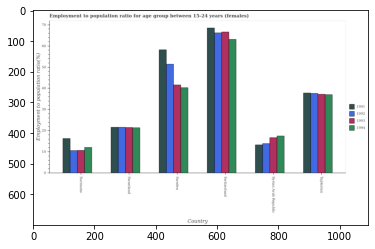

Number of QA =  30





,Country,1994,1992,1993,1991
0,Syrian Arab Republic,17.697578,14.231686,16.947668,13.609574
1,Suriname,12.418432,10.848831,11.047587,16.578860
2,Swaziland,21.690177,21.803779,21.654543,21.781092
3,Switzerland,63.274880,66.357798,66.751236,68.572363
4,Tajikistan,37.131196,37.845680,37.482315,37.925179
5,Sweden,40.520044,51.526971,41.385702,58.445241


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio in 1991 in the graph ?
PREDICTED =  0.02766094

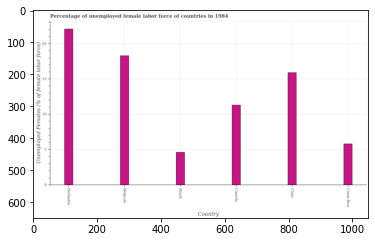

Number of QA =  22





,Country,Unemployed Females (% of female labor force)
0,Brazil,4.735315
1,Chile,16.056262
2,Costa Rica,5.916187
3,Belgium,18.394730
4,Barbados,22.260413
5,Canada,11.411348


> what is the title of the graph ?
PREDICTED =  Percentage of unemployed female labor force of countries in 1984
EXPECTED =  Percentage of unemployed female labor force of countries in 1984




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed Females (% of female labor force)
EXPECTED =  Unemployed Females (% of female labor force)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed female labour force in brazil and costa rica ?
PREDICTED =  -1.1808715220778874
EXPECTED =  -1.2




				 4 / 4 = 1.0


> what is the median total unemployed female labour force ?
PREDICTED =  None
EXPECTED =  13.5999999046326




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: 

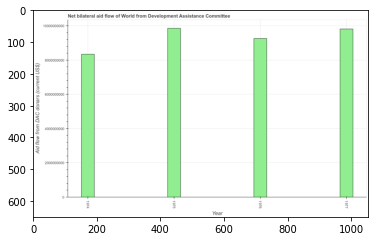

Number of QA =  23





,Year,Aid flow from DAC donars (current US$)
0,1975,9.879476e+09
1,1974,8.364947e+09
2,1977,9.864958e+09
3,1976,9.278122e+09


> what is the title of the graph ?
PREDICTED =  Net bilateral aid flow of World from Development Assistance Committee
EXPECTED =  Net bilateral aid flow of World from Development Assistance Committee




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Aid flow from DAC donars (current US$)
EXPECTED =  Aid flow from DAC donars (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows from dac donors in 1974 and 1976 ?
PREDICTED =  -913175143.6190109
EXPECTED =  -921910000.5




				 4 / 4 = 1.0


> what is the median net bilateral aid flows from dac donors ?
PREDICTED =  None
EXPECTED =  9542845000.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

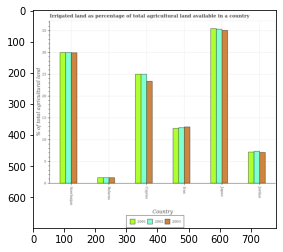

Number of QA =  29





,Country,2002,2003,2001
0,Jordan,7.446989,7.171146,7.293802
1,Belarus,1.428426,1.423729,1.438430
2,Azerbaijan,30.101610,30.107198,30.206015
3,Japan,35.408264,35.136177,35.715323
4,Cyprus,25.051951,23.549650,25.201614
5,Iran,12.786946,13.010089,12.628401


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land in 2003 in azerbaijan and that in cyprus ?
PREDICTED =  6.557548317035916
EXPECTED =  6.552287572773




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land in 2001 in jordan and the percentage of irrigated land in 2003 in belarus?
PREDICTED =  5.855372216847864
EXPECTED =  5.874217036024289




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land of/in 2002 and percentage of irrigated land of/in 2001 in jordan?
PREDICTED =  0.15318766764814828
EXPECTED =  0.1742160

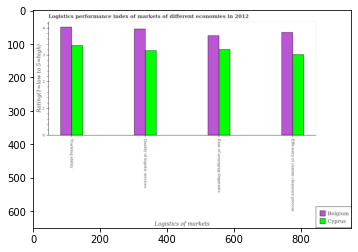

Number of QA =  29





,Logistics of markets,Belgium,Cyprus
0,Quality of logistic services,4.001365,3.188439
1,Tracking ability,4.072210,3.343457
2,Ease of arranging shipments,3.739072,3.226912
3,Efficiency of custom clearance process,3.868232,3.025123


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of ease of arranging shipments in cyprus and that in belgium ?
PREDICTED =  -0.5121594839187242
EXPECTED =  -0.52




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of tracking ability in belgium and the lpi rating of efficiency of custom clearance process in cyprus?
PREDICTED =  1.0470870378380583
EXPECTED =  1.0299999999999998




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of

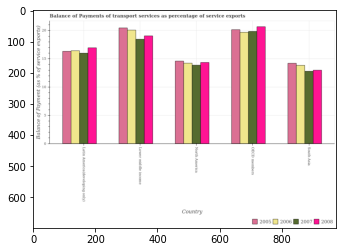

Number of QA =  30





,Country,2007,2005,2008,2006
0,Lower middle income,18.561328,20.600655,19.098387,20.117124
1,North America,13.912986,14.696892,14.402686,14.287806
2,OECD members,19.915224,20.239409,20.801596,19.726264
3,Latin America(developing only),16.053913,16.393243,17.054755,16.543359
4,South Asia,12.847097,14.298463,13.075485,13.906580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2006 in latin america(developing only) and that in north america ?
PREDICTED =  -14.28780622575482
EXPECTED =  2.1993343258107014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2008 in south asia and the balance of payments of transport services in 2006 in lower middle income?
PREDICTED =  -6.022902475766443
EXPECTED =  -7.092486616690801




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services of/in 2007 and bal

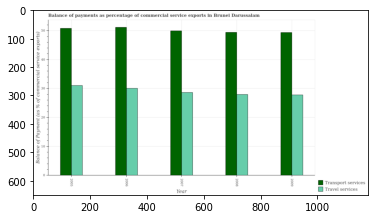

Number of QA =  28





,Year,Travel services,Transport services
0,2006,30.370217,51.121208
1,2005,31.178304,50.840948
2,2008,28.164393,49.364451
3,2009,27.991891,49.374988
4,2007,28.894428,50.032498


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2005 and that in 2006 ?
PREDICTED =  -0.2802604007876681
EXPECTED =  -0.3465427893588




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2005 and the balance of payments of transport services in 2006?
PREDICTED =  0.808087153023223
EXPECTED =  0.9761813133913009




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the balance of payments of travel services and balance of payments of transport services ?
PREDICTED =  22.991891190781878
EXPECTED

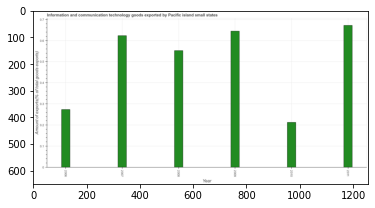

Number of QA =  23





,Year,Amount of exports(% of total goods exports)
0,2006,0.275735
1,2007,0.624872
2,2010,0.214665
3,2011,0.672203
4,2008,0.553959
5,2009,0.645061


> what is the title of the graph ?
PREDICTED =  Information and communication technology goods exported by Pacific island small states
EXPECTED =  Information and communication technology goods exported by Pacific island small states




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of exports(% of total goods exports)
EXPECTED =  Amount of exports(% of total goods exports)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods exports in 2006 and 2009 ?
PREDICTED =  -0.36932562128129287
EXPECTED =  -0.371




				 4 / 4 = 1.0


> what is the median amount of ict goods exports ?
PREDICTED =  None
EXPECTED =  0.5878552348132551




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_availabl

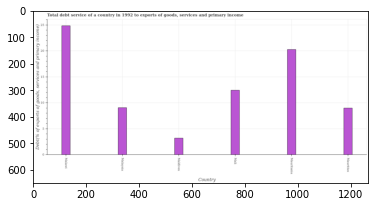

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Malawi,25.104743
1,Malaysia,9.222452
2,Makdives,3.296927
3,Mauritius,9.149036
4,Mali,12.548255
5,Mauritania,20.489194


> what is the title of the graph ?
PREDICTED =  Total debt service of a country in 1992 to exports of goods, services and primary in
EXPECTED =  Total debt service of a country in 1992 to exports of goods, services and primary income




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in malawi and maldives ?
PREDICTED =  -54.7058646610803
EXPECTED =  21.655




				 2 / 4 = 0.5


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  10.752576093272456




				 2 / 6 = 0.3333


is_built_with_cuda: 

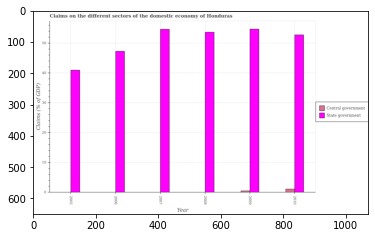

Number of QA =  25





,Year,State government,Central government
0,2009,55.038260,0.626537
1,2006,47.446068,NaN
2,2008,53.728689,NaN
3,2007,54.969289,NaN
4,2010,53.225619,1.264558
5,2005,41.172524,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on state government in 2005 and that in 2007 ?
PREDICTED =  -13.796764782926914
EXPECTED =  -13.720429291027386




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the claims on state government in 2009 and the claims on central government in 2008?
PREDICTED =  1.3095709643067295
EXPECTED =  1.0469093910918872




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the claims on state government in 2005

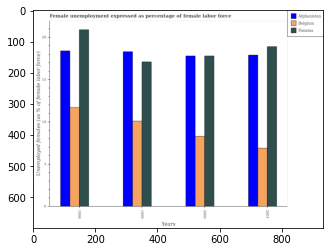

Number of QA =  29





,Years,Panama,Belgium,Afghanistan
0,2000,17.851213,8.340820,17.808883
1,1998,21.010680,11.744558,18.444450
2,2001,18.896182,7.027325,17.868848
3,1999,17.095913,10.152851,18.259715


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in afghanistan in 1998 and that in 2001 ?
PREDICTED =  0.5756027690449024
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in panama in 1998 and the unemployment in females in in afghanistan in 2001?
PREDICTED =  2.1144981664589224
EXPECTED =  3.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the unemployment in females in in belgium and unemployment in females in in afghanistan ?
PREDICTED =  5.31638857028306
EXPECTED =  -9.49999904632564




				 0 

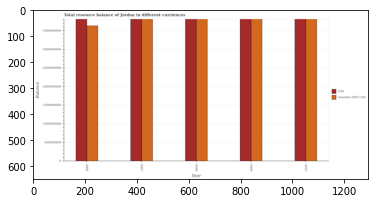

Number of QA =  15





,Year,US$,constant 2005 US$
0,2008,3.813735e+09,3.838916e+09
1,2009,3.823577e+09,3.831539e+09
2,2010,3.826612e+09,3.848459e+09
3,2006,3.813668e+09,3.636632e+09
4,2007,3.856794e+09,3.859416e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the resource balance in constant us$ in 2009 and the resource balance in us$ in 2006?
PREDICTED =  194906834.88558626
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Balance
EXPECTED =  500000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Total resource balance of Jordan in different curriences
EXPECTED =  Total resource balance of Jordan in different curriences




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Balance
EXPECTED =  Balance




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training st

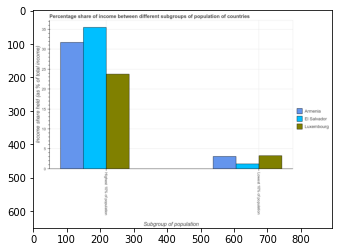

Number of QA =  23





,Subgroup of population,Luxembourg,Armenia,El Salvador
0,Highest 10% of population,23.936799,32.271623,35.839959
1,Lowest 10% of population,3.445359,3.283137,1.373826


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in armenia and that in luxembourg ?
PREDICTED =  -0.1622214673152711
EXPECTED =  -0.19999999999999973




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population in el salvador and the income share held by lowest 10% of the population in armenia?
PREDICTED =  32.556822184758644
EXPECTED =  32.38




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

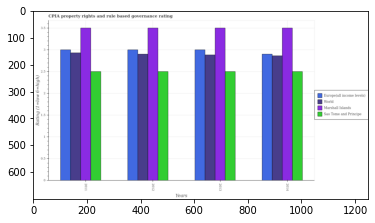

Number of QA =  30





,Years,Marshall Islands,Europe(all income levels),Sao Tome and Principe,World
0,2012,3.571745,3.012497,2.516113,2.917156
1,2013,3.514283,2.998866,2.501290,2.898792
2,2014,3.509784,2.914876,2.513903,2.878231
3,2011,3.538200,2.998872,2.513027,2.960066


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in europe(all income levels) in 2011 and that in 2012 ?
PREDICTED =  -0.013624799835096901
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in sao tome and principe in 2014 and the cpia rating in marshall islands in 2012?
PREDICTED =  -4.570445071425958
EXPECTED =  -1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the cpia rating in world and cpia rating in sao tome and principe ?
PREDICTED =  -1.08643881402257
EXPECTED =  0.3618421052631602




				 0 / 3 = 0.0


is_built_with_c

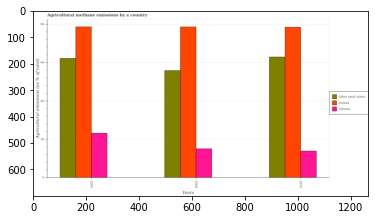

Number of QA =  29





,Years,Ukraine,Other small states,Ireland
0,2008,15.379317,56.314211,79.078994
1,2010,14.129165,63.282479,79.135752
2,2005,23.431498,62.566146,79.200885


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in ukraine in 2008 and that in 2010 ?
PREDICTED =  1.2501517994173845
EXPECTED =  1.1815240995166985




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in other small states in 2008 and the amount of agricultural methane emitted in ireland in 2005?
PREDICTED =  -6.251934987338892
EXPECTED =  -22.79187550011209




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount of agricultural methane emitted in ireland and amount of agricultural methane em

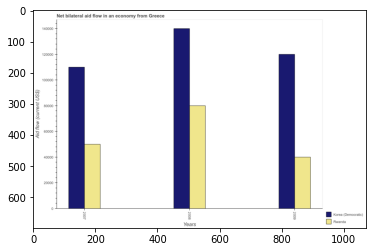

Number of QA =  28





,Years,Rwanda,Korea (Democratic!
0,2008,80153.257254,139624.631250
1,2009,40368.654467,119688.061887
2,2007,50203.663524,109571.308322


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in korea (democratic) in 2008 and that in 2009 ?
PREDICTED =  19936.569362383787
EXPECTED =  20000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in rwanda in 2007 and the net bilateral aid flow in korea (democratic) in 2008?
PREDICTED =  -29949.593730298213
EXPECTED =  -90000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net bilateral aid flow in korea (democratic) and net bilateral aid flow in rwanda ?
PREDICTED =  368881.00145915546
EXPECTED =  60000.0




				 

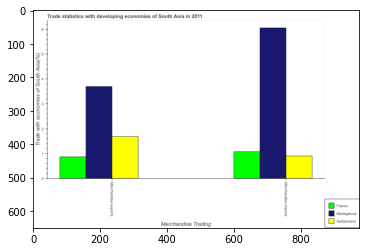

Number of QA =  23





,Merchandise Trading,Switzerland,France,Madagascar
0,Merchandise imports,0.930046,1.106134,6.107630
1,Merchandise exports,1.721223,0.898035,3.736366


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in madagascar and that in switzerland ?
PREDICTED =  2.0151423550508882
EXPECTED =  2.01429057307811




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in switzerland and the merchandise exports in madagascar?
PREDICTED =  -2.806319874299702
EXPECTED =  -2.797658510939775




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in switzerland 

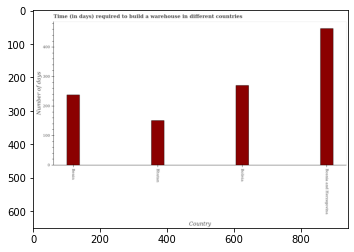

Number of QA =  22





,Country,Number of days
0,Benin,240.775375
1,Bhutan,152.182221
2,Bolivia,272.603342
3,Bosnia and Herzegovina,463.847612


> what is the title of the graph ?
PREDICTED =  Time (in days) required to build a warehouse in different countries
EXPECTED =  Time (in days) required to build a warehouse in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of days
EXPECTED =  Number of days




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time required to build a warehouse in bhutan and bolivia ?
PREDICTED =  -120.42112082591191
EXPECTED =  -119.0




				 4 / 4 = 1.0


> what is the median time required to build a warehouse ?
PREDICTED =  None
EXPECTED =  254.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

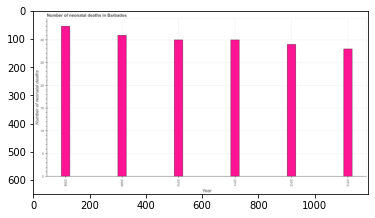

Number of QA =  23





,Year,Number of neonatal deaths
0,2009,31.095314
1,2008,33.188356
2,2011,30.137218
3,2010,30.105547
4,2013,28.225999
5,2012,29.155309


> what is the title of the graph ?
PREDICTED =  Number of neonatal deaths in Barbados
EXPECTED =  Number of neonatal deaths in Barbados




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of neonatal deaths
EXPECTED =  Number of neonatal deaths




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in 2011 and 2013 ?
PREDICTED =  1.9112192666258956
EXPECTED =  2.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of neonatal deaths ?
PREDICTED =  2010.5
EXPECTED =  30.0




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trainin

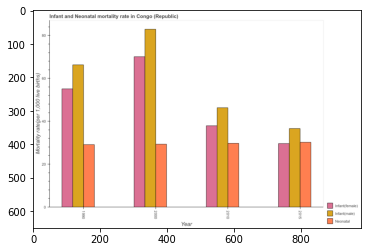

Number of QA =  29





,Year,Infant(male),Neonatal,Infant(female)
0,1990,66.536765,29.331299,55.181041
1,2000,83.424325,29.584054,70.269546
2,2010,46.721252,29.761041,38.132198
3,2015,36.801005,30.441805,29.678483


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate(female) in 1990 and that in 2010 ?
PREDICTED =  17.04884234760428
EXPECTED =  17.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in 2015 and the infant mortality rate(male) in 2010?
PREDICTED =  0.6807639408996238
EXPECTED =  0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the infant mortality rate(male) and neonatal mortality rate ?
PREDICTED =  6.6995822454992116
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

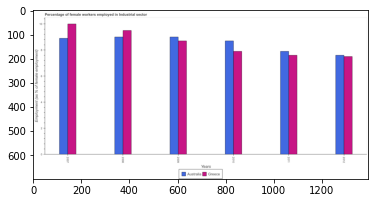

Number of QA =  28





,Years,Australia,Greece
0,2009,9.073298,8.749225
1,2011,7.947311,7.625350
2,2010,8.773441,7.925099
3,2012,7.663032,7.555558
4,2007,8.977590,10.074168
5,2008,9.065114,9.564219


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in greece in 2009 and that in 2011 ?
PREDICTED =  1.1238744739286854
EXPECTED =  1.0999999046325675




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in australia in 2007 and the percentage of females employed in industrial sector in greece in 2009?
PREDICTED =  -0.09570741941274363
EXPECTED =  0.1999998092651314




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of females employed in industrial sector in au

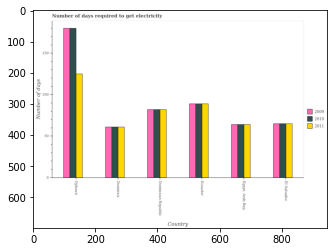

Number of QA =  29





,Country,2010,2009,2011
0,Djibou ti,181.465771,180.905151,126.289638
1,Dominica,62.294688,61.679701,62.222820
2,Dominican Republic,83.612008,82.871678,82.867820
3,"Egypt, Arab Rep.",65.318380,65.230115,65.260095
4,El Salvador,65.681949,66.447425,65.751463
5,Ecuador,90.505705,89.970394,89.730537


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in in 2011 in dominican republic and that in el salvador ?
PREDICTED =  0.0
EXPECTED =  17.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in in 2010 in el salvador and the number of days required to get electricity in in 2011 in egypt, arab rep.?
PREDICTED =  -64.31838029724803
EXPECTED =  1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to get electricity in of/in 2010 and number of days required to get electricity in o

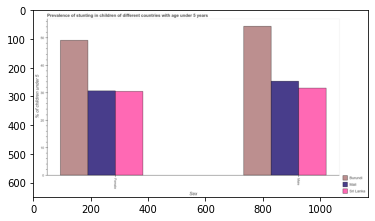

Number of QA =  23





,Sex,Mali,Burundi,Sri Lanka
0,Male,34.521542,54.107972,31.990021
1,Female,30.988359,49.098387,30.555218


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children in mali and that in burundi ?
PREDICTED =  -18.110027995175837
EXPECTED =  -18.3999977111816




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children and percentage of stunted male children in burundi ?
PREDICTED =  -23.11961351159643
EXPECTED =  -5.100002288818402




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage o

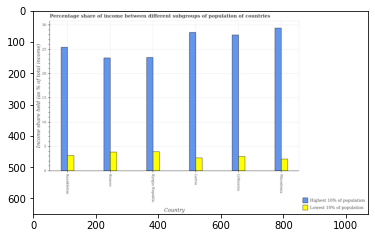

Number of QA =  28





,Country,Lowest 10% of population,Highest 10% of population
0,Macedonia,2.459302,29.146262
1,Latvia,2.705006,28.221790
2,Kyrgyz Republic,3.954299,23.320180
3,Kosovo,3.917545,23.139228
4,Lithuania,2.998641,27.786127
5,Kazakhstan,3.241335,25.382497


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population in kazakhstan and that in latvia ?
PREDICTED =  -2.839293394955977
EXPECTED =  -3.0599999999999987




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in kazakhstan and the income share held by highest 10% of the population in latvia?
PREDICTED =  22.677491185376844
EXPECTED =  -25.34




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 10% of the population and income share held by lowest 10% of the population in l

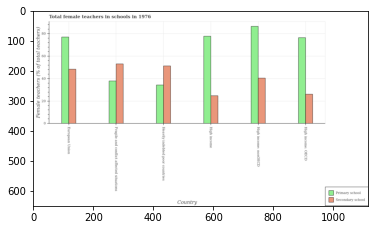

Number of QA =  28





,Country,Primary school,Secondary school
0,European Union,76.859631,48.484558
1,High income,77.614792,24.956582
2,High income: nonOECD,85.830489,40.921772
3,High income: OECD,76.594829,26.373796
4,Heavily indebted poor countries,34.422652,51.299996
5,Fragile and conflict affected situations,38.181053,53.145798


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in secondary schools in high income and that in high income: nonoecd ?
PREDICTED =  -15.965189640383347
EXPECTED =  -15.681369781494102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female teachers in secondary schools in fragile and conflict affected situations to that in heavily indebted poor countries ?
PREDICTED =  1.035980553517979

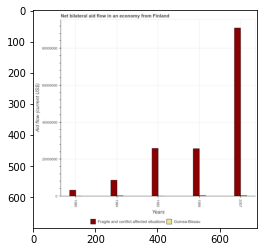

Number of QA =  28





,Years,Fragile and conflict affected situations,Guinea-Bissau
0,1999,2.588400e+07,NaN
1,1992,2.610056e+07,NaN
2,1980,3.525451e+06,NaN
3,1984,8.926773e+06,NaN
4,2007,9.157854e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in guinea-bissau in 1984 and that in 1992 ?
PREDICTED =  0.0
EXPECTED =  160000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in guinea-bissau in 2007 and the net bilateral aid flow in fragile and conflict affected situations in 1999?
PREDICTED =  -25884003.48393948
EXPECTED =  -25390000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the net bilateral aid flow in fragile and conflict affected situations and net bilateral aid flow in guinea-bissau ?
PREDICTED =  9157853

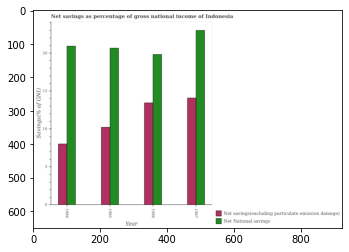

Number of QA =  28





,Year,Net National savings,Net savings(excluding particulate emission damage)
0,1984,21.058372,8.163285
1,1985,20.764042,10.329036
2,1986,19.977932,13.571518
3,1987,23.115499,14.249699


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in 1985 and that in 1986 ?
PREDICTED =  0.7861100860632497
EXPECTED =  0.8377134657825991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings(excluding particulate emission damage) in 1984 and the net national savings in 1987?
PREDICTED =  -6.086413820827103
EXPECTED =  -6.057095872055671




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the net national savings and net savings(excluding particulate emission damage) ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda

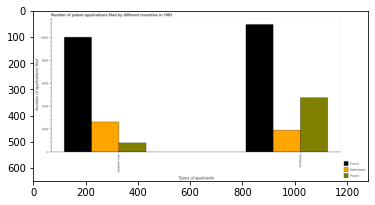

Number of QA =  23





,Types of applicants,France,Poland,Netherlands
0,Non-residents,NaN,830.752570,2679.309027
1,Residents,NaN,4767.592603,1937.674311


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in france and that in poland ?
PREDICTED =  0.0
EXPECTED =  6406




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by non residents in poland and the number of patent applications by residents in netherlands?
PREDICTED =  -1.0
EXPECTED =  -1106




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by non residents and number of patent applications by residents in poland ?
PREDICTED =  -1.0
EXPECTED =  -3958




				 0 / 3 = 0.0


is_built_wi

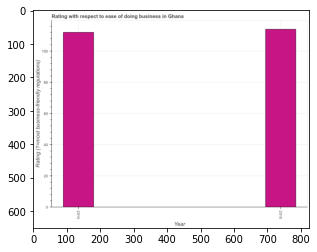

Number of QA =  19





,Year,Rating (1=most business-friendly regulations)
0,2014,112.966385
1,2015,114.794940


> what is the title of the graph ?
PREDICTED =  Rating with respect to ease of doing business in Ghana
EXPECTED =  Rating with respect to ease of doing business in Ghana




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Rating (1=most business-friendly regulations)
EXPECTED =  Rating (1=most business-friendly regulations)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ease of doing business index in 2014 and 2015 ?
PREDICTED =  -1.8285557141504398
EXPECTED =  -2.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ease of doing business index ?
PREDICTED =  2014.5
EXPECTED =  113.0






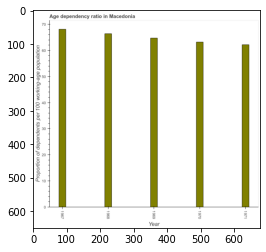

Number of QA =  23





,Year,Proportion of dependents per 100 working-age population
0,1968,66.660348
1,1969,64.973788
2,1967,68.702352
3,1970,63.430676
4,1971,62.464753


> what is the title of the graph ?
PREDICTED =  Age dependency ratio in Macedonia
EXPECTED =  Age dependency ratio in Macedonia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Proportion of dependents per 100 working-age population
EXPECTED =  Proportion of dependents per 100 working-age population




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in 1968 ?
PREDICTED =  13.332069512677029
EXPECTED =  66.3875302947696




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio ?
PREDICTED =  393.4
EXPECTED =  68.104442911525




				 3 / 5 = 0.6


is_built_wit

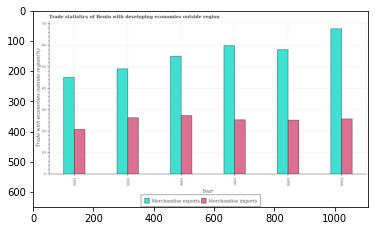

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1999,26.039430,67.868776
1,1995,26.425216,49.309780
2,1996,27.571399,55.172814
3,1998,25.680752,58.090046
4,1994,21.116539,45.153973
5,1997,25.655408,59.675791


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1995 and that in 1997 ?
PREDICTED =  0.7698077431472186
EXPECTED =  0.9664691402193029




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1996 and the merchandise imports in 1998?
PREDICTED =  -2.9172323248968652
EXPECTED =  -3.0672662586504984




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  -40.29737716105618
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

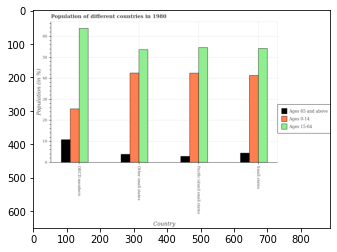

Number of QA =  29





,Country,Ages 65 and above,Ages 0-14,Ages 15-64
0,OECD members,10.797584,25.443244,63.225974
1,Small states,NaN,41.255669,54.064406
2,Pacific island small states,2.943735,42.340901,54.071446
3,Other small states,3.919676,42.396220,53.200110


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 in oecd members and that in other small states ?
PREDICTED =  -58.2086449906421
EXPECTED =  -17.071402837966698




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 15-64 in small states and the percentage of population within the age-group of 65 and above in other small states?
PREDICTED =  -3.9196763581528633
EXPECTED =  50.40169698114791




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 15-64 and p

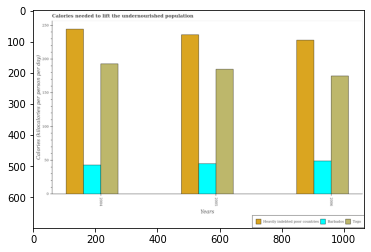

Number of QA =  29





,Years,Unnamed: 1,Heavily indebted poor countries,Barbados
0,2006,176.622310,228.465220,49.581021
1,2005,185.945510,235.837688,45.784554
2,2004,195.970318,244.948195,43.905336


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in togo in 2004 and that in 2005 ?
PREDICTED =  10.024808489397998
EXPECTED =  8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in togo in 2005 and the total calories needed to lift the undernourished population in heavily indebted poor countries in 2006?
PREDICTED =  -42.519709948165286
EXPECTED =  -43.089790955957




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the total calories needed to lift the u

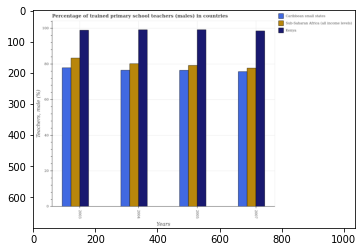

Number of QA =  29





,Years,Kenya,Sub-Saharan Africa (all income levels),Caribbean small states
0,2005,99.605224,78.961330,76.468402
1,2007,98.304812,78.286424,75.700653
2,2004,99.083338,80.584469,76.450443
3,2003,98.535944,83.667782,77.837956


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (males) in sub-saharan africa (all income levels) in 2003 and that in 2005 ?
PREDICTED =  4.706451952922166
EXPECTED =  4.132705688476591




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (males) in kenya in 2007 and the percentage of trained primary school teachers (males) in caribbean small states in 2005?
PREDICTED =  -1.3004120255899636
EXPECTED =  22.11782836914061




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage 

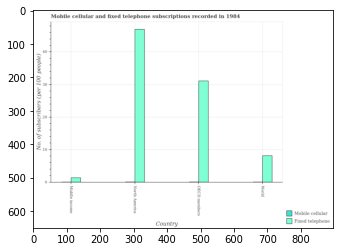

Number of QA =  28





,Country,Mobile cellular,Fixed telephone
0,Middle income,NaN,1.538124
1,North America,NaN,46.823645
2,World,NaN,8.211448
3,OECD members,NaN,31.081500


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers in oecd members and that in world ?
PREDICTED =  22.87005239690628
EXPECTED =  22.977220712665932




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in world and the number of fixed telephone subscribers in north america?
PREDICTED =  1.0
EXPECTED =  -46.92931460407638




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers and number of fixed telephone subscribers in middle income ?
PREDICTED =  1.0
EXPECTED =  -1.3439179975974958



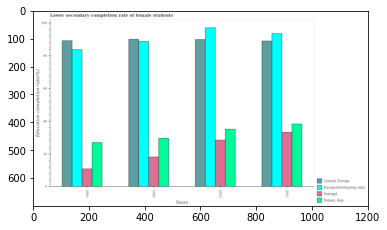

Number of QA =  30





,Years,Senegal,Central Europe,Europe(developing only),"Yemen, Rep."
0,2005,18.602851,89.891967,88.846886,29.794199
1,2012,33.409213,89.526671,93.291674,38.593446
2,2010,28.840464,89.967650,97.106863,35.512777
3,2001,11.048209,88.101968,83.988214,27.246518


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in central europe in 2005 and that in 2010 ?
PREDICTED =  -0.07568355655358516
EXPECTED =  0.2229919433593892




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in yemen, rep. in 2010 and the lower secondary completion rate of female students in central europe in 2012?
PREDICTED =  -54.013893514579905
EXPECTED =  -53.96581268310549




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the lower secondary completion rate of female

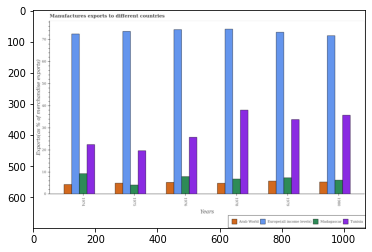

Number of QA =  30





,Years,Madagascar,Tunisia,Arab World,Europe(all income levels:
0,1974,9.404540,22.514487,4.545324,72.604476
1,1979,7.546719,33.871652,6.056004,73.229494
2,1978,7.073478,38.334520,5.076906,74.719256
3,1980,6.502467,35.759367,5.650266,71.839539
4,1975,4.341470,19.835568,5.114253,73.756685
5,1976,8.125934,25.715901,5.484770,74.561516


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in tunisia in 1975 and that in 1976 ?
PREDICTED =  -5.88033308141129
EXPECTED =  -6.092809639818199




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in europe(all income levels) in 1975 and the percentage of exports to different countries in tunisia in 1974?
PREDICTED =  1.1522093288446342
EXPECTED =  51.27931983460451




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1974, what is the difference between the percentage of exports to different countries in tunisia and perc

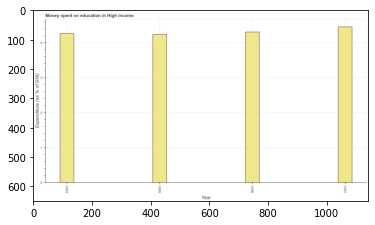

Number of QA =  23





,Year,Expenditure (as % of GNI)
0,2006,4.315983
1,2007,4.460461
2,2004,4.275868
3,2005,4.227992


> what is the title of the graph ?
PREDICTED =  Money spent on education in High income
EXPECTED =  Money spent on education in High income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Expenditure (as % of GNI)
EXPECTED =  Expenditure (as % of GNI)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on education in 2006 and 2007 ?
PREDICTED =  -0.14447861847300292
EXPECTED =  -0.147




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median expenditure on education ?
PREDICTED =  4.2959252590947345
EXPECTED =  4.283668972305991




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_a

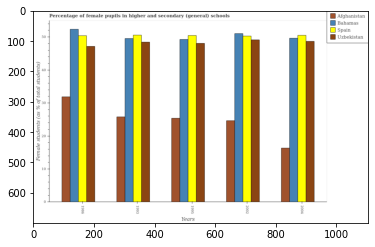

Number of QA =  30





,Years,Uzbekistan,Spain,Afghanistan,Bahamas
0,1993,48.269661,50.555567,25.805506,49.580489
1,2004,48.703945,50.431895,16.580848,49.769278
2,1986,47.284146,50.491865,32.102603,52.572157
3,2002,49.147074,50.279446,24.718817,51.056452
4,1995,47.997881,50.475745,25.362669,49.129411


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in bahamas in 1993 and that in 2004 ?
PREDICTED =  1954.2307215287055
EXPECTED =  -0.08958178222659541




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in afghanistan in 1986 and the percentage of female pupils in higher and secondary schools in spain in 1993?
PREDICTED =  1978.1944942853297
EXPECTED =  -18.697609999999997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of female pupils in

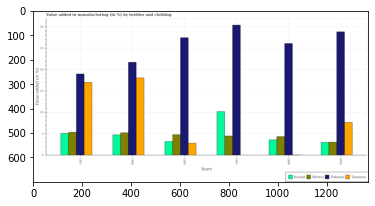

Number of QA =  27





,Years,Mexico,Tanzania,Pakistan,Kuwait
0,1996,4.456000,NaN,26.138044,3.673926
1,1987,5.469940,17.086905,19.076582,5.198778
2,2006,3.159673,7.860349,28.907956,3.102113
3,1990,4.841302,2.895229,27.658711,3.293963
4,1988,5.353456,18.155273,21.702557,4.863288
5,1991,4.567336,NaN,30.564082,10.263282


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by textiles and clothing in kuwait in 1996 and that in 2006 ?
PREDICTED =  2.8978866626676907
EXPECTED =  0.61201722160747




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by textiles and clothing in tanzania in 2006 and the percentage of value added in manufacturing by textiles and clothing in pakistan in 1996?
PREDICTED =  5.0
EXPECTED =  -18.44850243185127




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of value added i

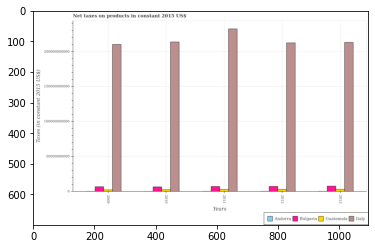

Number of QA =  30





,Years,Bulgaria,Andorra,Guatemala,Italy
0,2012,8.076864e+09,NaN,3.756569e+09,2.160311e+11
1,2009,7.540200e+09,NaN,2.887994e+09,2.127213e+11
2,2011,7.913002e+09,NaN,3.708763e+09,2.358804e+11
3,2013,8.286452e+09,NaN,3.800107e+09,2.161211e+11
4,2010,7.495825e+09,NaN,NaN,2.162339e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in andorra in 2010 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  -48595913.037808




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in guatemala in 2011 and the net taxes on products in bulgaria in 2012?
PREDICTED =  -47805520.6598506
EXPECTED =  -4338547751.093931




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net taxes on products in andorra in 20

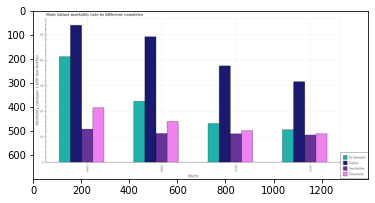

Number of QA =  30





,Years,El Salvador,Seychelles,Gabon,Venezuela
0,2000,23.976343,11.409419,49.327931,16.019700
1,1990,41.398518,13.132406,53.446569,21.531831
2,2010,15.426828,11.378799,37.884018,12.553450
3,2015,12.724312,10.859270,31.861065,11.336577


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male infant mortality rate in el salvador in 2010 and that in 2015 ?
PREDICTED =  2.7025159419739087
EXPECTED =  2.3999999999999986




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male infant mortality rate in gabon in 2000 and the male infant mortality rate in seychelles in 1990?
PREDICTED =  -4.118637600577607
EXPECTED =  36.2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the male infant mortality rate in el salvador and male infant mortality rate in gabon ?
PREDICTED =  12.724311946101
EXPECTED =  -25.30000000000000

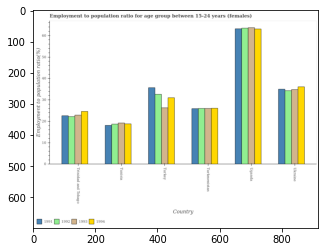

Number of QA =  30





,Country,1991,1992,1993,1994
0,Tunisia,18.181502,18.901293,19.324285,18.913513
1,Ukraine,35.038506,34.531046,35.169230,36.234918
2,Trinidad and Tobago,22.790844,22.409068,23.156814,24.975410
3,Turkmenistan,26.093255,26.235268,26.140438,26.430403
4,Uganda,63.233185,63.522733,63.999344,63.076486
5,Turkey,35.768079,32.924555,26.357084,31.362675


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio in 1992 in the graph ?
PREDICTED =  0.03022305

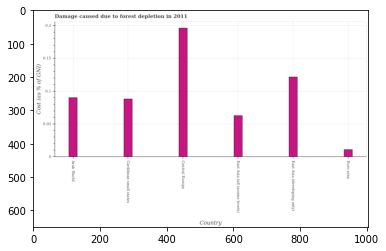

Number of QA =  22





,Country,Cost (as % of GNI)
0,Central Europe,0.197700
1,Euro area,0.011564
2,Caribbean small states,0.088872
3,Arab World,0.091550
4,East Asia (all income levels),0.063719
5,East Asia (developing only),0.122039


> what is the title of the graph ?
PREDICTED =  Damage caused due to forest depletion in 2011
EXPECTED =  Damage caused due to forest depletion in 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cost (as % of GNI)
EXPECTED =  Cost (as % of GNI)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the damage caused due to forest depletion in arab world and east asia (all income levels) ?
PREDICTED =  0.027831261418306358
EXPECTED =  0.027




				 4 / 4 = 1.0


> what is the median damage caused due to forest depletion ?
PREDICTED =  None
EXPECTED =  0.08904408676548681




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

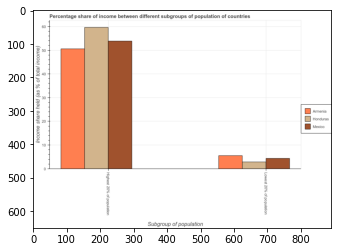

Number of QA =  23





,Subgroup of population,Ammenia,Mexico,Honduras
0,Highest 20% of population,50.209658,53.772443,59.473089
1,Lowest 20% of population,5.721587,4.497913,3.012765


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in honduras and that in armenia ?
PREDICTED =  0.0
EXPECTED =  9.049999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in honduras and the income share held by highest 20% of the population in armenia?
PREDICTED =  -2.7088227228894075
EXPECTED =  -47.730000000000004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population and income share held by lowest 20% of the population in mexico

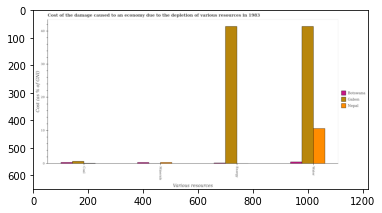

Number of QA =  29





,Various resources,Botswana,Nepal,Gabon
0,Water,0.651672,10.756164,41.615525
1,Coal,NaN,NaN,0.861772
2,Energy,NaN,NaN,41.697956
3,Minerals,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in botswana and that in gabon ?
PREDICTED =  1.0
EXPECTED =  0.30725492352710415




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in gabon and the cost of damage due to depletion of coal in nepal?
PREDICTED =  0.0
EXPECTED =  -0.07201335458023814




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals and cost of damage due to depletion of coal in gabon ?
PREDICTED =  -0.8617717896769219
EXPECTED =  -0.64957294615

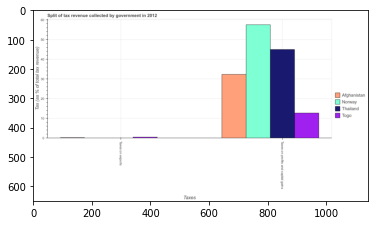

Number of QA =  23





,Taxes,Unnamed: 1,Thailand,Afghanistan,Norway
0,Taxes on exports,NaN,NaN,NaN,NaN
1,Taxes on profits and capital gains,13.173678,45.168841,33.002854,57.570184


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Tax (as % of total tax revenue)
EXPECTED =  10.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Split of tax revenue collected by government in 2012
EXPECTED =  Split of tax revenue collected by government in 2012




				 1 / 6 = 0.1667


> what is the label or title o

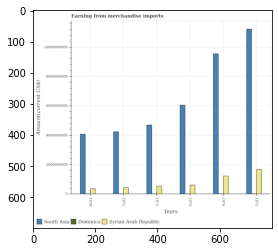

Number of QA =  29





,Years,Dominica,Syrian Arab Republic,South Asia
0,1974,NaN,1.273790e+09,9.674615e+09
1,1973,NaN,6.563739e+08,6.168640e+09
2,1970,NaN,3.984969e+08,4.168230e+09
3,1971,NaN,4.792014e+08,4.281737e+09
4,1975,NaN,1.709578e+09,1.134934e+10
5,1972,NaN,5.768017e+08,4.772532e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in syrian arab republic in 1971 and that in 1972 ?
PREDICTED =  -97600312.88151014
EXPECTED =  -100524000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in south asia in 1974 and the amount earned from merchandise imports in syrian arab republic in 1971?
PREDICTED =  9195413725.108994
EXPECTED =  9104123052.91996




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1971, what is the difference between the amount earned from merchandise imports in south asia and amount earned from merc

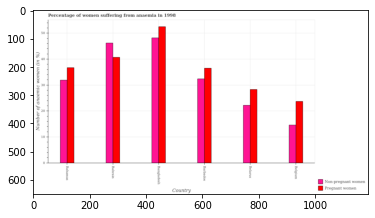

Number of QA =  28





,Country,Pregnant women,Non-pregnant women
0,Bahamas,36.770434,31.918673
1,Bangladesh,52.440429,48.320115
2,Belarus,28.220663,22.389488
3,Bahrain,40.662644,46.228199
4,Belgium,23.796331,14.589416
5,Barbados,36.238539,32.481051


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in bahrain and that in barbados ?
PREDICTED =  4.424105230430719
EXPECTED =  4.200000000000003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in bangladesh and the percentage of non-pregnant anaemic women in belgium?
PREDICTED =  37.85101360160102
EXPECTED =  37.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of non-pregnant anaemic women and percentage of pregnant anaemic women in bangladesh ?
PREDICTED =  0.0
EXPECTED =  -4.299999999999997




		

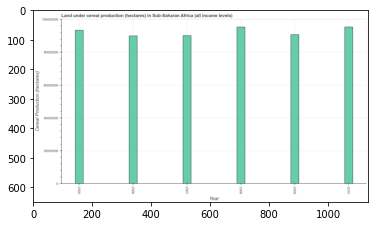

Number of QA =  23





,Year,Cereal Production (hectares)
0,2010,9.610359e+07
1,2009,9.131619e+07
2,2006,9.050933e+07
3,2007,9.073769e+07
4,2005,9.399224e+07
5,2008,9.632848e+07


> what is the title of the graph ?
PREDICTED =  Land under cereal production (hectares) in Sub-Saharan Africa (all income levels)
EXPECTED =  Land under cereal production (hectares) in Sub-Saharan Africa (all income levels)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cereal Production (hectares)
EXPECTED =  Cereal Production (hectares)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in 2005 and 2006 ?
PREDICTED =  3482909.4186243117
EXPECTED =  3449223.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median land under cereal production ?
PREDICTED =  2007.5

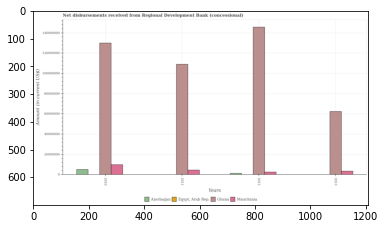

Number of QA =  27





,Years,Azerbaijan,"Egypt, Arab Rep.",Mauritania,Ghana
0,2012,1.789177e+06,NaN,3.056917e+06,1.481380e+08
1,2013,NaN,NaN,3.951488e+06,6.350833e+07
2,2010,5.641577e+06,NaN,1.037196e+07,1.313487e+08
3,2011,NaN,NaN,5.097146e+06,1.105794e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in ghana in 2010 and that in 2013 ?
PREDICTED =  67840343.23755562
EXPECTED =  67579000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in azerbaijan in 2011 and the amount of disbursements received from regional development bank in mauritania in 2010?
PREDICTED =  -10371963.986766107
EXPECTED =  -9850000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the amount of disbursements received from r

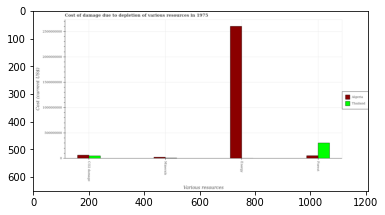

Number of QA =  29





,Various resources,Algeria,Thailand
0,Forest,6.137687e+07,3.070518e+08
1,Minerals,3.062037e+07,NaN
2,Energy,2.605813e+09,NaN
3,CO2 damage,6.896062e+07,5.691875e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of forests in thailand and the cost of damage due to depletion of coal in algeria?
PREDICTED =  245674945.98463088
EXPECTED =  239890032.38541




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of energy and cost of damage due to depletion of forests in thailand ?
PREDICTED =  2298761101.121809
EXPECTED =  -301614993.4277924




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

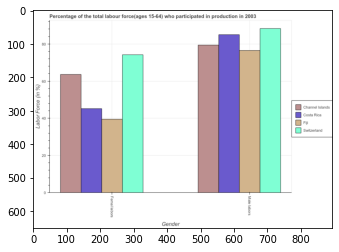

Number of QA =  23





,Gender,Switzerland,Channel Islands,Fiji,Costa Rica
0,M ale labors,88.715432,79.565798,77.137428,85.180293
1,Femal labors,74.450926,63.938589,40.231613,45.770843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in costa rica and that in fiji ?
PREDICTED =  19.704724927300646
EXPECTED =  5.700000762939503




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force and percentage of female labor force in switzerland ?
PREDICTED =  -80.58317886345105
EXPECTED =  14.100006103515597




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female la

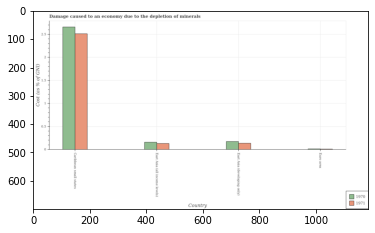

Number of QA =  28





,Country,1971,1970
0,Euro area,NaN,NaN
1,Caribbean small states,2.537122,2.671383
2,East Asia (developing only),0.150063,0.186635
3,East Asia (all income levels),0.146069,0.171587


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in 1970 in east asia (all income levels) and that in euro area ?
PREDICTED =  0.0
EXPECTED =  0.1443334380092924




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in 1971 in east asia (developing only) and the cost of damage caused due to the depletion of minerals in 1970 in east asia (all income levels)?
PREDICTED =  -0.14606883238762047
EXPECTED =  -0.021745910610555003




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of d

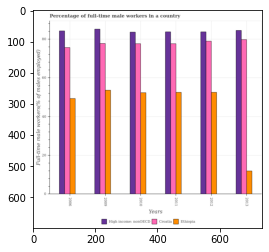

Number of QA =  29





,Years,Croatia,Ethiopia,High income: nonOECD
0,2006,75.884986,49.939793,84.773074
1,2009,78.442992,54.194886,85.587528
2,2011,79.457783,53.050708,84.427962
3,2010,78.051052,52.952674,84.142349
4,2013,80.036003,12.321854,85.895351
5,2012,79.570593,53.115113,84.209231


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in high income: nonoecd in 2009 and that in 2012 ?
PREDICTED =  1.3782975577183265
EXPECTED =  1.4101719273078004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in high income: nonoecd in 2009 and the percentage of full-time male workers in croatia in 2013?
PREDICTED =  -0.3078230180229582
EXPECTED =  5.4238755688846965




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of full-time male workers in croatia and percentage of full-time m

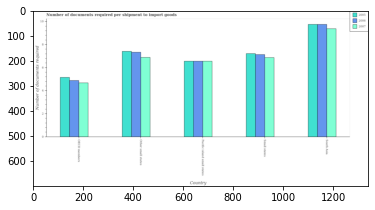

Number of QA =  29





,Country,2007,2005,2006
0,Small states,6.913463,7.259549,7.164576
1,Pacific island small states,6.613695,6.633387,6.604062
2,Other small states,6.918967,7.466045,7.345310
3,OECD members,4.717630,5.187422,4.921185
4,South Asia,9.408224,9.788102,9.803559


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required per shipment to import goods in 2005 in pacific island small states and that in south asia ?
PREDICTED =  -1.0
EXPECTED =  -3.19444444444444




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required per shipment to import goods in 2006 in south asia and the number of documents required per shipment to import goods in 2005 in other small states?
PREDICTED =  -2.0
EXPECTED =  2.338235294117651




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required per shipment to impo

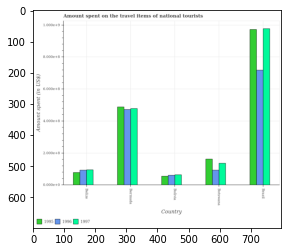

Number of QA =  29





,Country,1996,1997,1995
0,Belize,3.377794,3.470359,2.854897
1,Bolivia,2.239175,2.373209,2.082738
2,Brazil,25.554424,34.666552,34.297636
3,Botswana,3.374999,4.881758,5.817948
4,Bermuda,16.803649,16.960088,17.333773


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in 1996 in bolivia and that in botswana ?
PREDICTED =  -1.1358238267877971
EXPECTED =  -32000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists in 1996 in botswana and the amount spent on the travel items of national tourists in 1997 in bermuda?
PREDICTED =  -13.428649587099748
EXPECTED =  -385000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of national tourists of/in 1997 and amount s

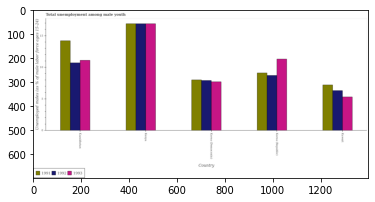

Number of QA =  29





,Country,1992,1993,1991
0,Kuwait,6.380881,5.413264,7.301965
1,Korea (Republic),8.815234,11.413946,9.169285
2,Kazakhstan,10.765838,11.174988,14.203204
3,Kenya,17.024230,17.079115,17.021676
4,Korea (Democratic),8.033069,7.790211,8.153429


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed males in in 1993 in korea (democratic) and that in korea (republic) ?
PREDICTED =  -3.623734501803381
EXPECTED =  -3.600000381469761




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed males in in 1993 in korea (democratic) and the percentage of unemployed males in in 1992 in korea (republic)?
PREDICTED =  -3.623734501803381
EXPECTED =  -0.9999999999999991




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed males in of/in 1993 and percentage of unemployed males in of/i

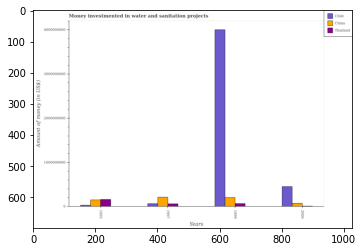

Number of QA =  29





,Years,Chile,China,Thailand
0,1999,4.013311e+09,2.119152e+08,7.536818e+07
1,1997,7.476398e+07,2.206040e+08,7.027757e+07
2,1995,4.109144e+07,1.629588e+08,1.656154e+08
3,2000,4.609932e+08,8.341234e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the money investmented in water and sanitation projects in chile in 1997 and that in 1999 ?
PREDICTED =  -3929898672.331112
EXPECTED =  -3939400000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the money investmented in water and sanitation projects in thailand in 2000 and the money investmented in water and sanitation projects in china in 1995?
PREDICTED =  0.0
EXPECTED =  -141200000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the money investmented in water and sanitation projects in chile and money investmented in w

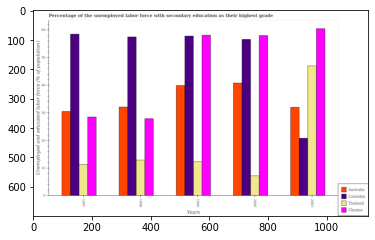

Number of QA =  30





,Years,Australia,Thailand,Ukraine,Colombia
0,1999,40.289288,12.415914,57.903296,57.878207
1,1998,32.228242,13.045821,27.941804,57.879904
2,2003,32.258768,47.295953,60.732032,20.936810
3,2000,40.710935,7.342952,58.033718,56.277997
4,1997,30.584689,11.510645,28.572149,58.878686


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in australia in 2000 and the percentage of the unemployed labor force with secondary education in ukraine in 1999?
PREDICTED =  0.42164701144808703
EXPECTED =  -17.299999237060604




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of the unemployed labor force with secondary education in colombia in 1997 to that

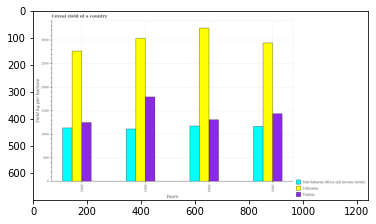

Number of QA =  29





,Years,Tunisia,Sub-Saharan Africa (all income levels),Lithuania
0,2003,1804.875546,1127.348124,3056.808870
1,2005,1458.865010,1199.401134,2965.991193
2,2004,1332.356965,1187.668741,3287.087511
3,2002,1275.626138,1146.695169,2776.195811


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in lithuania in 2003 and that in 2004 ?
PREDICTED =  -230.2786410540807
EXPECTED =  -217.85500000000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in lithuania in 2005 and the total cereal yield in sub-saharan africa (all income levels) in 2002?
PREDICTED =  189.795382776515
EXPECTED =  1805.58246354134




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the total cereal yield in lithuania and total cereal yield in sub-saharan africa (all income levels) ?
PREDICTED =  12082.08338465

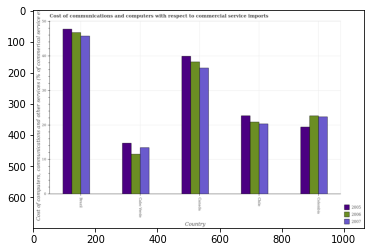

Number of QA =  29





,Country,2007,2005,2006
0,Brazil,45.813791,47.756291,46.969767
1,Colombia,22.368491,19.463334,22.786743
2,Chile,20.469101,22.792344,20.984966
3,Canada,36.654246,39.993953,38.316065
4,Cabo Verde,13.516746,14.817041,11.712021


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2006 in cabo verde and that in colombia ?
PREDICTED =  -19.68172272822501
EXPECTED =  -11.097684301636502




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2006 in cabo verde and the cost of communications and computers in 2007 in chile?
PREDICTED =  -17.879946254932236
EXPECTED =  -8.769821215263299




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers of/in 2007 and cost of communications and computers of/in 2006 in canada?
P

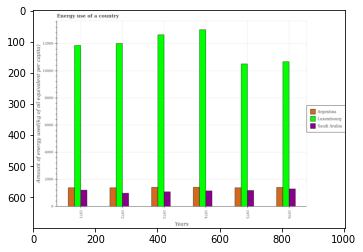

Number of QA =  29





,Years,Luxembourg,Saudi Arabia,Argentina
0,1973,12595.051111,1105.342106,1431.431860
1,1975,10396.603641,1195.281189,1403.472844
2,1974,12892.723180,1165.943053,1441.020618
3,1972,11919.075388,1005.318558,1398.205604
4,1971,11796.065304,1233.636219,1406.017845
5,1976,10571.096872,1334.796571,1426.210315


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in saudi arabia in 1971 and that in 1976 ?
PREDICTED =  -101.16035214971203
EXPECTED =  -89.01411382860988




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in saudi arabia in 1975 and the amount of energy used in in argentina in 1973?
PREDICTED =  89.93908283189216
EXPECTED =  -231.60238360515996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the amount of energy used in in argentina and amount of energy used in in saudi arabia ?
PREDICTED =  106.22404685544598
EXPECTED =

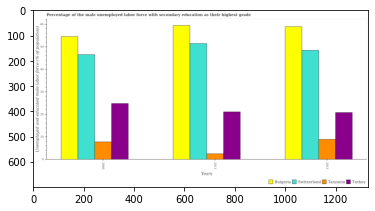

Number of QA =  30





,Years,Switzerland,Turkey,Bulgaria,Tanzania
0,2011,51.445738,21.254924,59.315225,2.697319
1,2000,46.809779,24.951897,54.648582,7.994538
2,2013,48.178292,20.895751,59.208023,9.104646


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in switzerland in 2000 and that in 2013 ?
PREDICTED =  -1.368512759451967
EXPECTED =  -1.9000015258788991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in switzerland in 2000 and the percentage of the unemployed male labor force with secondary education in tanzania in 2011?
PREDICTED =  -4.635958818019731
EXPECTED =  44.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percen

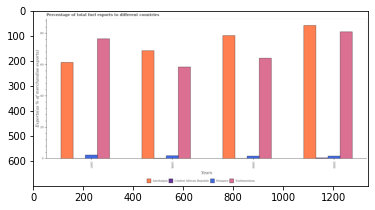

Number of QA =  30





,Years,Azerbaijan,Hungary,Turkmenistan,Central African Republic
0,2000,84.946475,1.843635,80.953201,NaN
1,1999,78.670741,1.877222,64.197175,NaN
2,1997,61.583275,2.520225,76.603147,NaN
3,1998,69.007783,2.088384,58.583624,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in hungary in 1998 and that in 2000 ?
PREDICTED =  0.2111625452450281
EXPECTED =  0.24581742526759998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in central african republic in 2000 and the percentage of exports to different countries in hungary in 1997?
PREDICTED =  nan
EXPECTED =  -1.8136556877519867




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after

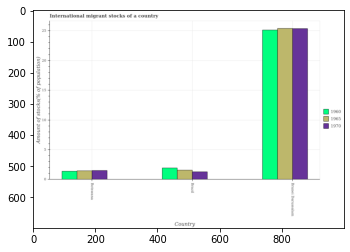

Number of QA =  29





,Country,1965,1970,1960
0,Brunei Darussalam,25.298372,25.298408,25.034628
1,Botswana,1.499179,1.545812,1.440024
2,Brazil,1.615051,1.351166,1.981761


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in 1970 in brazil and that in brunei darussalam ?
PREDICTED =  -23.94724204090867
EXPECTED =  -24.0794768356122




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in 1970 in botswana and the amount of stocks in in 1965 in brunei darussalam?
PREDICTED =  -23.752596261272572
EXPECTED =  -23.895479295489977




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in of/in 1965 and amount of stocks in of/in 1960 in brazil?
PREDICTED =  1.018239285211212
EXPECTED =  -0.36426788988029




				 2 

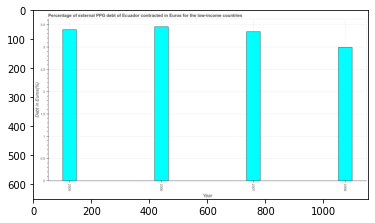

Number of QA =  23





,Year,Debt in Euros(%)
0,2005,3.386636
1,2008,2.997985
2,2007,3.329590
3,2006,3.437641


> what is the title of the graph ?
PREDICTED =  Percentage of external PPG debt of Ecuador contracted in Euros for the low-income countries
EXPECTED =  Percentage of external PPG debt of Ecuador contracted in Euros for the low-income countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt in Euros(%)
EXPECTED =  Debt in Euros(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the currency composition of ppg debt in 2006 and 2008 ?
PREDICTED =  0.43965581425268185
EXPECTED =  0.465




				 3 / 4 = 0.75


> what is the median currency composition of ppg debt ?
PREDICTED =  None
EXPECTED =  3.3686




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalu

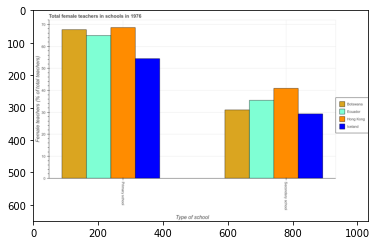

Number of QA =  23





,Type of school,Iceland,Botswana,Hong Kong,Ecuador
0,secondary school,29.532866,30.955594,40.622958,35.676491
1,Primary school,54.713518,67.537675,68.560891,64.960429


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in secondary schools in ecuador and that in hong kong ?
PREDICTED =  -4.9464673319049055
EXPECTED =  -5.449120000000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in botswana and the percentage of female teachers in secondary schools in hong kong?
PREDICTED =  26.914716086287
EXPECTED =  26.696709999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in secondary schools and percentage of female teachers in primary scho

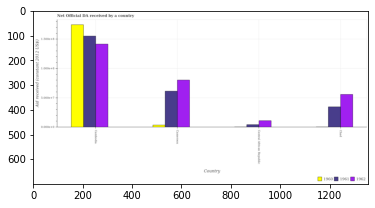

Number of QA =  29





,Country,1962,1961,1960
0,Central African Republic,0.117312,0.051268,NaN
1,Chad,0.564475,0.350772,NaN
2,Cameroon,0.809001,0.619583,0.04261
3,Cambodia,1.423403,1.553826,1.74665


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in 1960 in cambodia and that in chad ?
PREDICTED =  1.7892602131212836
EXPECTED =  174210000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in 1961 in chad and the net official development assistance aid received in 1960 in cambodia?
PREDICTED =  -1.438488388921773
EXPECTED =  -139980000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

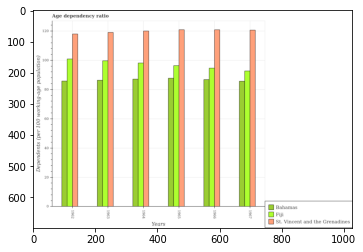

Number of QA =  29





,Years,Fiji,St. Vincent and the Grenadines,Bahamas
0,1962,100.642875,118.973544,85.806070
1,1966,95.393040,123.275364,87.475758
2,1964,99.225494,121.281531,87.336533
3,1965,97.821777,121.825585,89.102984
4,1963,100.319000,120.100255,87.411852
5,1967,93.371064,121.804036,86.763837


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in bahamas in 1966 ?
PREDICTED =  14.579292966819004
EXPECTED =  86.80552896580771




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio in in st. vincent and the grenadines ?
PREDICTED =  327.6666666666667
EXPECTED =  120.894141829394




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in bahamas ?
PREDICTED =  327.0
EXPECTED =  85.6623193342742




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

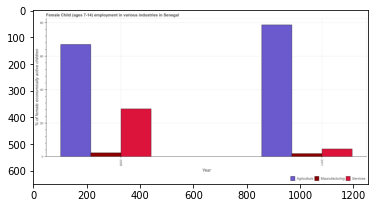

Number of QA =  25





,Year,Agriculture,Maunufacturing,Services
0,2011,79.086482,2.075990,4.820370
1,2005,67.301714,2.503954,28.747636


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing in 2005 and that in 2011 ?
PREDICTED =  -11.784767665525976
EXPECTED =  0.47




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in 2011 and the percentage of economically active children in manufacturing in 2005?
PREDICTED =  -23.92726646226559
EXPECTED =  -23.98




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of economically active children in manufacturing and percentage of economically active 

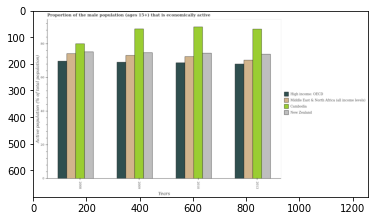

Number of QA =  30





,Years,Cambodia,New Zealand,High income: OECD,Middle East & North Africa (all income levels)
0,2010,91.058654,75.028997,69.031328,72.847848
1,2013,89.421934,74.126941,68.548928,70.623952
2,2009,89.648842,74.934108,69.500153,73.339890
3,2008,80.306837,75.474794,70.104141,74.415576


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in new zealand in 2008 and that in 2009 ?
PREDICTED =  0.5406852815813323
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in cambodia in 2009 and the proportion of the male population that is economically active in high income: oecd in 2013?
PREDICTED =  0.22690814948485638
EXPECTED =  20.823836525961298




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

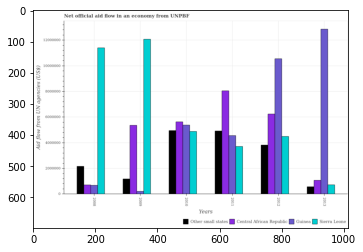

Number of QA =  30





,Years,Central African Republic,Sierra Leone,Guinea,Other small states
0,2012,6.241937e+06,4.480138e+06,1.049908e+07,3.868042e+06
1,2009,5.360447e+06,1.202628e+07,2.502125e+05,1.208696e+06
2,2008,7.491580e+05,1.141328e+07,7.084950e+05,2.171555e+06
3,2010,5.645561e+06,4.889954e+06,5.419744e+06,4.943053e+06
4,2013,1.102708e+06,7.441837e+05,1.285203e+07,6.061618e+05
5,2011,8.078198e+06,3.734268e+06,4.552515e+06,4.894566e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in other small states in 2011 and that in 2012 ?
PREDICTED =  1026523.8093047426
EXPECTED =  1100000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in other small states in 2012 and the net official aid flow in guinea in 2013?
PREDICTED =  3261880.730357496
EXPECTED =  -9040000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the net official aid flow in guinea and net official aid flow in central african republic ?
PREDICTED =  -14325980.779581646
EXPECTED =  4310000.0





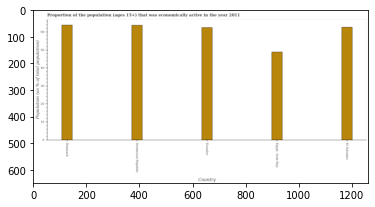

Number of QA =  22





,Country,Population (as % of total population)
0,Denmark,63.981280
1,"Egypt, Arab Rep.",49.047179
2,Dominican Republic,63.863987
3,El Salvador,62.681533
4,Ecuador,62.585848


> what is the title of the graph ?
PREDICTED =  Proportion of the population (ages 15+) that was economically active in the year 2011
EXPECTED =  Proportion of the population (ages 15+) that was economically active in the year 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population (as % of total population)
EXPECTED =  Population (as % of total population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active population in ecuador and egypt, arab rep. ?
PREDICTED =  13.538668624709189
EXPECTED =  13.6




				 4 / 4 = 1.0


> what is the median percentage of economically active population ?
PREDICTED =  None
EXPECTED =  62.7000007629395




				 4 / 6 = 0.6667


is_bu

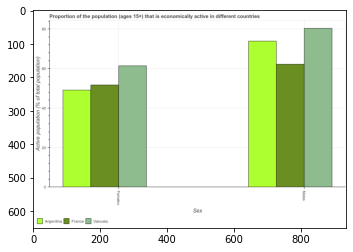

Number of QA =  23





,Sex,Vanuatu,France,Argentina
0,Males,80.428400,62.537013,73.717934
1,Females,61.277423,52.128514,49.041903


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in argentina and that in france ?
PREDICTED =  11.180921070224088
EXPECTED =  11.700000762939403




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in vanuatu and the percentage of economically active male population in argentina?
PREDICTED =  12.235519592386943
EXPECTED =  -12.500000000000007




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after 

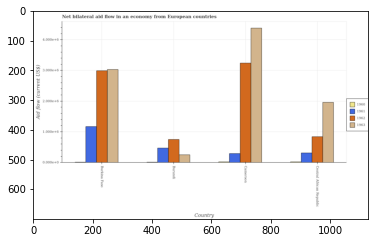

Number of QA =  30





,Country,1963,1962,1961,1960
0,Burundi,0.267029,0.762855,0.487838,NaN
1,Cameroon,4.413254,3.259621,0.311354,NaN
2,Burkina Faso,3.054758,3.004868,1.185030,NaN
3,Central African Republic,1.984542,0.856968,0.326741,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1961 in burkina faso and that in burundi ?
PREDICTED =  -0.4878377157715952
EXPECTED =  700000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 in burkina faso and the net bilateral aid flow in 1963 in cameroon?
PREDICTED =  -3.2596211512063373
EXPECTED =  -1390000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow of/in 1963 and net bilateral aid flow of/in 1960 in cameroon?
PREDICTED =  4.4132540437044385
EXPECTED =  4360000.0




				 0 / 3 = 0.0


is_b

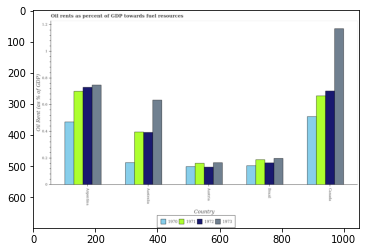

Number of QA =  30





,Country,1972,1971,1970,1973
0,Brazil,0.167130,0.189957,0.144753,0.199062
1,Canada,0.702164,0.666486,0.509284,1.168908
2,Austria,0.134132,0.162827,0.138342,0.164830
3,Australia,0.392278,0.395173,0.165917,0.631633
4,Argentina,0.729111,0.697786,0.469150,0.743627


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1973 in austria and that in canada ?
PREDICTED =  -1.004078540094413
EXPECTED =  -1.004689925994332




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1971 in austria and the oil rent in 1972 in argentina?
PREDICTED =  -0.5349591677783178
EXPECTED =  -0.5696321350448429




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent of/in 1973 and oil rent of/in 1970 in brazil?
PREDICTED =  0.02007644907804207
EXPECTED =  0.05465913312112691




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs:

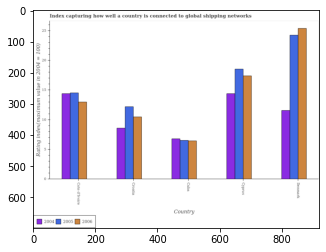

Number of QA =  29





,Country,2005,2004,2006
0,Croatia,12.352739,8.720076,10.594513
1,Cuba,6.630450,6.917376,6.519114
2,Cote d'Ivoire,14.611242,14.500183,13.077055
3,NaN,18.679002,14.511550,17.572343
4,Denmark,24.475880,11.643919,25.599874


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in 2004 in cuba and that in cyprus ?
PREDICTED =  -3.528012040772232
EXPECTED =  -7.61




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in 2005 in cuba and the rating index in 2006 in croatia?
PREDICTED =  -5.722289421262165
EXPECTED =  -3.960000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index of/in 2005 and rating index of/in 2004 in croatia?
PREDICTED =  5.797502083083231
EXPECTED =  3.6099999999999994




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

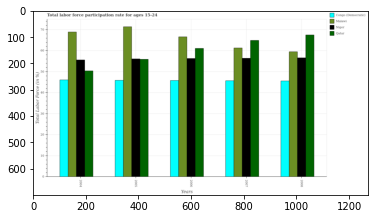

Number of QA =  30





,Years,Congo (Democratic),Malawi,Qatar,Niger
0,2007,46.375166,61.674428,65.272607,56.846262
1,2005,46.551662,72.416179,56.601824,56.786542
2,2006,46.512653,67.177383,61.590002,56.725095
3,2008,46.242996,60.063633,68.201070,57.106236
4,2004,46.825115,69.205076,50.992189,56.309682


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in malawi in 2004 and that in 2006 ?
PREDICTED =  2.0276935725557195
EXPECTED =  2.3000030517578978




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in congo (democratic) in 2007 and the labor force participation rate in qatar in 2004?
PREDICTED =  -4.617022112761468
EXPECTED =  -4.700000762939396




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the labor force participation rate in niger and labor force participation rate in qatar ?
PREDICTED =  -18.88387442873

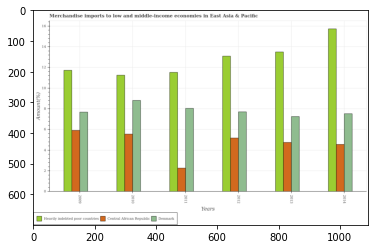

Number of QA =  29





,Years,Central African Republic,Heavily indebted poor countries,Denmark
0,2009,5.992886,11.987581,7.769118
1,2010,5.632435,11.418671,8.942246
2,2013,4.843251,13.682132,7.337875
3,2011,2.323706,11.647044,8.157347
4,2012,5.296501,13.217377,7.788090
5,2014,4.663426,15.843404,7.624000


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in heavily indebted poor countries in 2011 and that in 2014 ?
PREDICTED =  -4.196359461900535
EXPECTED =  -4.209341056337999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in heavily indebted poor countries in 2014 and the percentage of amount earned from merchandise imports in central african republic in 2009?
PREDICTED =  3.8558226558581374
EXPECTED =  9.82117314133472




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference betwe

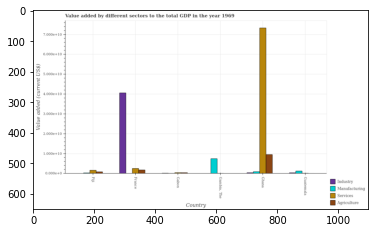

Number of QA =  30





,Country,Industry,Agriculture,Services,Manufacturing
0,Gabon,NaN,NaN,NaN,NaN
1,Fiji,NaN,0.109126,0.187101,NaN
2,Ghana,NaN,0.992232,7.462216,0.117347
3,France,4.134904,0.202632,0.274335,NaN
4,"Gambia, The",NaN,NaN,NaN,0.778991
5,Guatemala,NaN,NaN,NaN,0.150739


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in fiji and that in france ?
PREDICTED =  1.0
EXPECTED =  250192500.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in ghana and the value added by industrial sector in france?
PREDICTED =  -3.1426715698560552
EXPECTED =  -31051320263.3488




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector and value added by services sector in gabon ?
PREDICTED =  3.8605686859669808
EXPECTED =  -261418009.28435




				 0 / 3 = 0.0


is_built_with_cu

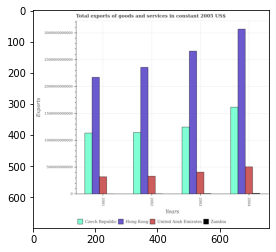

Number of QA =  30





,Years,Zambia,Czech Republic,United Arab Emirates,Hong Kong
0,2003,NaN,1.254297e+12,4.157189e+11,2.677681e+12
1,2001,NaN,1.147628e+12,3.327436e+11,2.180095e+12
2,2002,NaN,1.157030e+12,3.433172e+11,2.374655e+12
3,2004,NaN,1.631754e+12,5.169867e+11,3.098510e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in united arab emirates in 2001 and that in 2004 ?
PREDICTED =  -516986745762.6835
EXPECTED =  -185121000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in united arab emirates in 2003 and the total exports of goods and services in zambia in 2002?
PREDICTED =  -759036133349.9119
EXPECTED =  402062905100.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the total exports of goods and services in hong kong and total exports of goods and services 

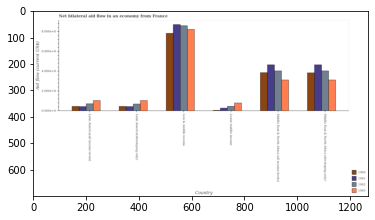

Number of QA =  30





,Country,1963,1962,1961,1960
0,Latin America(all income levels),1.085909,0.744515,0.465453,0.474657
1,Lower middle income,0.820856,0.485238,0.318588,NaN
2,Low & middle income,8.243453,8.634538,8.766245,7.869001
3,Latin America(developing only),1.075983,0.724793,0.465041,0.477907
4,Middle East & North Africa (all income levels),3.131973,4.064638,4.645278,3.915301
5,Middle East & North Africa (developing only),3.142266,4.085759,4.655711,3.879483


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1961 in latin america(developing only) and that in low & middle income ?
PREDICTED =  -8.301203215385542
EXPECTED =  -827200000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1963 in latin america(all income levels) and the net bilateral aid flow in 1961 in low & middle income?
PREDICTED =  -7.157543776448921
EXPECTED =  -766300000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

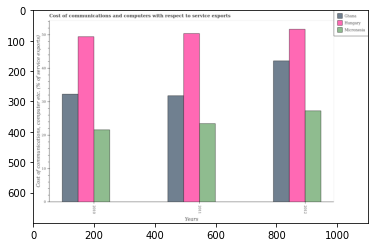

Number of QA =  29





,Years,Micronesia,Hungary,Ghana
0,2012,27.277789,51.585280,42.111573
1,2011,23.582607,50.227518,31.974721
2,2010,21.734118,49.471939,32.483442


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in hungary in 2011 and that in 2012 ?
PREDICTED =  -47.22751803561648
EXPECTED =  -1.281069117247398




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in micronesia in 2011 and the cost of communications and computers in ghana in 2012?
PREDICTED =  -47.86039625070519
EXPECTED =  -18.768914676118712




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cost of communications and computers in ghana and cost of communications and computers in hungary ?
PR

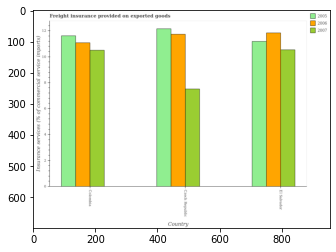

Number of QA =  29





,Country,2007,2005,2006
0,Czech Republic,7.486420,12.079868,11.678651
1,Colombia,10.438768,11.588026,11.046946
2,El Salvador,10.513738,11.141943,11.757153


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods in 2006 in colombia and the freight insurance provided on exported goods in 2007 in czech republic?
PREDICTED =  -0.6317043013866961
EXPECTED =  3.5649608279933203




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods of/in 2007 and freight insurance provided on exported goods of/in 2005 in el salvador?
PREDICTED =  -1.6623014253149293
EXPECTED =  -0.6463555989667




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

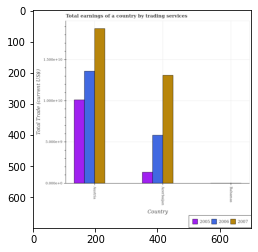

Number of QA =  23





,Country,2007,2005,2006
0,Austna,1.891226,1.030422,1.375206
1,Bahamas,NaN,NaN,NaN
2,Azerbaijan,1.336829,0.142901,0.588287


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2007 in bahamas and the total earnings in 2006 in austria?
PREDICTED =  -2.0
EXPECTED =  -13591497122.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings of/in 2007 and total earnings of/in 2005 in azerbaijan?
PREDICTED =  1.8570991706833113
EXPECTED =  11764172000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Total Trade (current US$)
EXPECTED =  5000000000.0




				 0 / 4 = 0.0


> what is the title of the graph ?
PREDICTED 

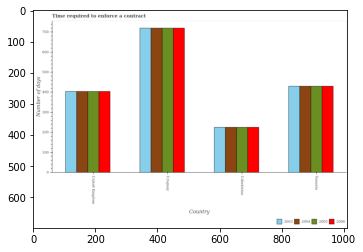

Number of QA =  30





,Country,2005,2004,2006,2003
0,Uzbekistan,224.772437,224.595115,225.837449,225.330948
1,Uruguay,715.383883,716.098483,715.745943,715.279898
2,Vanuatu,427.489996,427.405017,427.401406,427.017872
3,United Kingdom,403.349554,403.299748,404.251032,403.549012


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract in 2004 in united kingdom and that in uzbekistan ?
PREDICTED =  0.0
EXPECTED =  179.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract in 2003 in vanuatu and the number of days required to enforce a contract in 2004 in uruguay?
PREDICTED =  -714.2798981722148
EXPECTED =  -290.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract of/in 2006 and number of days required to enforce a contract of/in 2005 in u

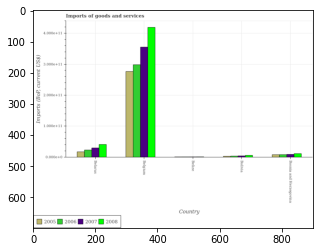

Number of QA =  30





,Country,2007,2005,2006,2008
0,Belarus,0.311665,0.184878,0.243634,0.418342
1,Belize,NaN,NaN,NaN,NaN
2,Bosnia and Herzegovina,0.104124,0.090575,0.093899,0.126454
3,Belgium,3.538773,2.755076,2.991199,4.185920
4,Bolivia,NaN,NaN,NaN,0.070508


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in 2005 in belgium and that in belize ?
PREDICTED =  2.7550759677948284
EXPECTED =  275968993875.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in 2005 in belgium and the amount spent on imports in 2007 in bolivia?
PREDICTED =  2.7550759677948284
EXPECTED =  272531794905.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports of/in 2005 and amount spent on imports of/in 2008 in belgium?
PREDICTED =  -1.1553904303619675
EXPECTED =  -142406000000.0




				 0 / 3 = 0.0

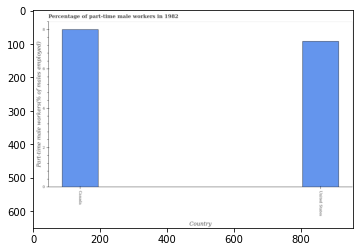

Number of QA =  18





,Country,Part-time male workers(% of males employed)
0,United States,7.466041
1,Canada,8.083475


> what is the title of the graph ?
PREDICTED =  Percentage of part-time male workers in 1982
EXPECTED =  Percentage of part-time male workers in 1982




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time male workers(% of males employed)
EXPECTED =  Part-time male workers(% of males employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time male workers in canada and united states ?
PREDICTED =  0.6174339872706058
EXPECTED =  0.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time male workers ?
PREDICTED =  7.774758232916563
EXPEC

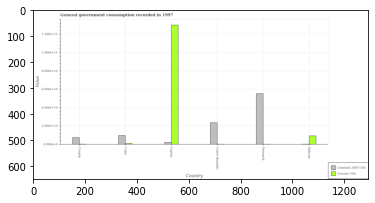

Number of QA =  28





,Country,Current US$,Constant 2005 US¢
0,Djibouti,0.096572,NaN
1,Croatia,NaN,0.079920
2,Czech Republic,NaN,0.239722
3,Denmark,NaN,0.552975
4,Cyprus,1.293695,0.027752
5,Cuba,NaN,0.102380


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in constant 2005 us$ in cuba and that in denmark ?
PREDICTED =  -0.45059531848284784
EXPECTED =  -45589139513.831604




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in constant 2005 us$ in denmark and the value consumed in current us$ in cuba?
PREDICTED =  0.45059531848284784
EXPECTED =  54262032649.889275




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the value cons

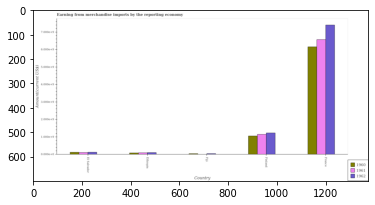

Number of QA =  29





,Country,1962,1961,1960
0,France,7.494143,6.635849,6.212773
1,Ethiopia,0.132736,0.114723,0.108849
2,Finland,1.259532,1.179935,1.096803
3,El Salvador,0.150764,0.133307,0.146984
4,Fiji,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in 1960 in el salvador and that in france ?
PREDICTED =  -6.06578834406047
EXPECTED =  -6032100000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in 1961 in ethiopia and the amount earned from merchandise imports in 1962 in fiji?
PREDICTED =  0.11472278656606233
EXPECTED =  49700000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports of/in 1960 and amount earned from merchandise imports of/in 1961 in france?
PREDICTED 

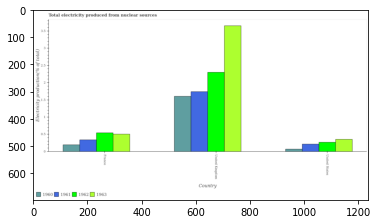

Number of QA =  30





,Country,1963,1962,1961,1960
0,United Kingdom,3.704053,2.346348,1.769071,1.642376
1,France,0.531335,0.568813,0.364529,0.220557
2,United States,0.381147,0.294502,0.239399,0.095105


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1960 in france and that in united kingdom ?
PREDICTED =  -1.4218186848218908
EXPECTED =  -1.4083923385714798




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1963 in united kingdom and the total electricity produced in 1962 in france?
PREDICTED =  3.1727183947007864
EXPECTED =  3.109346659220453




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced of/in 1961 and total electricity produced of/in 1962 in france?
PREDICTED =  1.8041862191778513
EXPECTED =  -

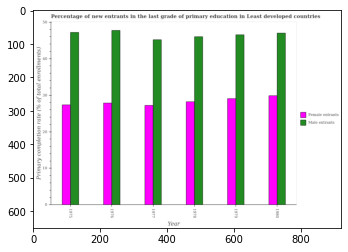

Number of QA =  28





,Year,Male entrants,Female entrants
0,1978,45.803011,28.407158
1,1977,45.340831,27.310773
2,1980,47.005663,30.018600
3,1976,48.026803,27.862898
4,1979,46.983902,29.219943
5,1975,47.530060,27.501449


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants in 1975 and that in 1980 ?
PREDICTED =  -2.517151173031124
EXPECTED =  -2.511043548584002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in 1978 and the primary completion rate of female entrants in 1977?
PREDICTED =  0.4621792729637946
EXPECTED =  0.8262977600098154




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the primary completion rate of female entrants and primary completion rate of male entrants ?
PREDICTED =  2.7078270460573535

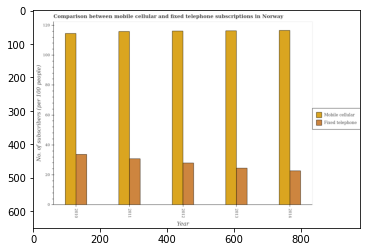

Number of QA =  28





,Year,Mobile cellular,Fixed telephone
0,2014,117.461345,23.130909
1,2012,116.993620,28.331491
2,2011,116.530735,31.425706
3,2010,115.394082,34.295319
4,2013,116.963860,25.112632


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers in 2010 and that in 2014 ?
PREDICTED =  11.164409628099122
EXPECTED =  10.959251558137403




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in 2013 and the number of fixed telephone subscribers in 2010?
PREDICTED =  1.5697775280056874
EXPECTED =  1.7928819305760015




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of fixed telephone subscribers and number of mobile cellular subscribers ?
PREDICTED =  137.29605654375257
EXPECTED =  0.0






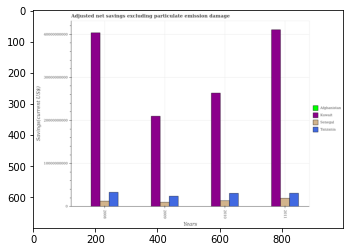

Number of QA =  27





,Years,Senegal,Tanzania,Afghanistan,Kuwait
0,2010,1.454323e+09,3.194157e+09,NaN,2.660624e+10
1,2008,1.342101e+09,3.437301e+09,NaN,4.045278e+10
2,2009,1.108470e+09,2.531179e+09,NaN,2.108174e+10
3,2011,2.019843e+09,3.211594e+09,NaN,4.137915e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in tanzania in 2010 and that in 2011 ?
PREDICTED =  -17437580.025829792
EXPECTED =  -25488284.41705036




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in tanzania in 2011 and the adjusted net savings in afghanistan in 2009?
PREDICTED =  680415169.0464377
EXPECTED =  3087232670.59426




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the adjusted net savings in kuwait and adjusted net savings in tanzania ?
PREDICTED =  41379148421.204506
EXPECTED =  37054952335.610374




				 0 / 3 

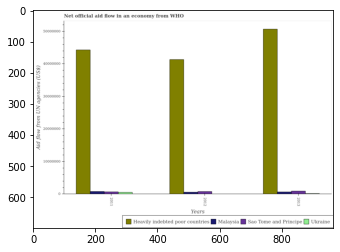

Number of QA =  30





,Years,Heavily indebted poor countries,Malaysia,Ukraine,Sao Tome and Principe
0,2013,5.102116e+07,805210.467251,NaN,1.061132e+06
1,2012,4.173130e+07,737642.167217,NaN,9.612902e+05
2,2011,4.449252e+07,933591.413234,673372.3197,8.230550e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in malaysia in 2011 and that in 2013 ?
PREDICTED =  128380.9459833937
EXPECTED =  130000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in heavily indebted poor countries in 2011 and the net official aid flow in malaysia in 2012?
PREDICTED =  2761219.2676810697
EXPECTED =  43720000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the net official aid flow in heavily indebted poor countries and net official aid flow in malaysia ?
PREDICTED =  50195683.316857606
EXPECTED =  5

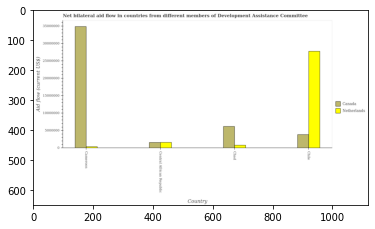

Number of QA =  28





,Country,Netherlands,Canada
0,Chad,9.651729e+05,6.293535e+06
1,Chile,2.798503e+07,3.958768e+06
2,Central African Republic,1.742045e+06,1.738623e+06
3,Cameroon,5.003311e+05,3.507225e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by netherlands in cameroon and that in chad ?
PREDICTED =  -464841.836212293
EXPECTED =  -430000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by canada in chile and the amount of aid given by netherlands in central african republic?
PREDICTED =  2220144.9015021175
EXPECTED =  2240000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by netherlands and amount of aid given by canada in chile ?
PREDICTED =  27233805.244663246
EXPECTED =  23920000




				 1 / 3 = 0.3333


is_bu

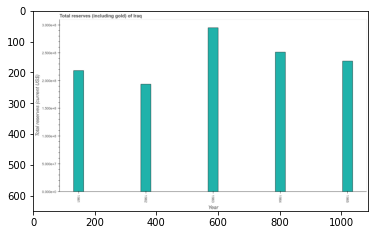

Number of QA =  23





,Year,Total reserves (current US$)
0,1965,2.358928
1,1964,2.527525
2,1962,1.947382
3,1961,2.191696
4,1963,2.963920


> what is the title of the graph ?
PREDICTED =  Total reserves (including gold) of Iraq
EXPECTED =  Total reserves (including gold) of Iraq




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total reserves (current US$)
EXPECTED =  Total reserves (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1961 and 1965 ?
PREDICTED =  -0.16723255632839829
EXPECTED =  -17106619.985




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (including gold) ?
PREDICTED =  2.5275246571816474
EXPECTED =  235056319.980844




				 3 / 5 = 0.6


is_bui

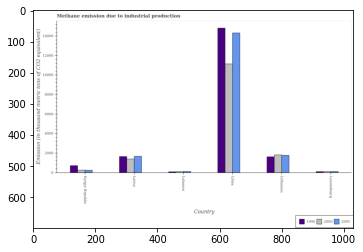

Number of QA =  29





,Country,2005,2000,1990
0,Lebanon,NaN,NaN,NaN
1,Kyrgyz Republic,333.108020,333.464613,788.384912
2,Latvia,1764.857966,1474.871506,1729.920597
3,Lithuania,1874.666247,1914.133700,1705.909695
4,Libya,14335.254481,11134.729379,14834.698728
5,Luxembourg,NaN,NaN,184.732489


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 2000 in latvia and that in lebanon ?
PREDICTED =  1474.8715057861834
EXPECTED =  1284.1




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 1990 in luxembourg and the amount of methane emitted in 2005 in libya?
PREDICTED =  -14649.966239363008
EXPECTED =  -14219.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted of/in 2005 and amount of methane emitted of/in 1990 in lebanon?
PREDICTED =  18307.88671372827
EXPECTED =  37.3




				 1 / 3 = 0.3333


is_built_

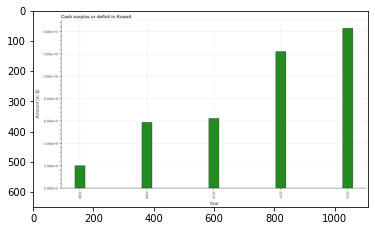

Number of QA =  23





,Year,Amount (in $)
0,2008,0.206339
1,2010,0.628358
2,2012,1.439417
3,2011,1.221846
4,2009,0.591808


> what is the title of the graph ?
PREDICTED =  Cash surplus or deficit in Kuwait
EXPECTED =  Cash surplus or deficit in Kuwait




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount (in $)
EXPECTED =  Amount (in $)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cash surplus or deficit in 2009 and 2011 ?
PREDICTED =  -0.6300387418152666
EXPECTED =  -6326000000.0




				 3 / 4 = 0.75


> what is the median cash surplus or deficit ?
PREDICTED =  None
EXPECTED =  6229000000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cash surplus or deficit in 2010 to that in 2012 ?
PREDIC

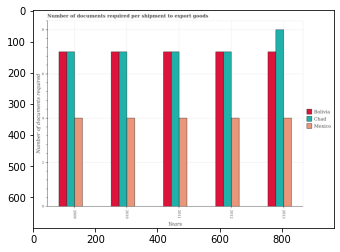

Number of QA =  29





,Years,Bolivia,Mexico,Chad
0,2013,7.029635,4.038753,8.035672
1,2009,6.986238,4.040085,7.049654
2,2010,7.013201,4.042105,7.005281
3,2012,7.012323,4.042299,7.008872
4,2011,7.012338,4.042230,7.007368


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required per shipment to export goods in bolivia in 2009 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required per shipment to export goods in chad in 2011 and the number of documents required per shipment to export goods in bolivia in 2009?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of documents required per shipment to export goods in mexico and number of documents required per shi

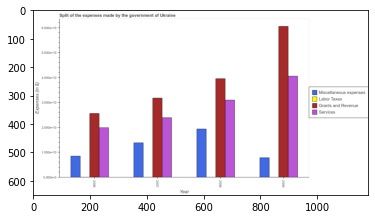

Number of QA =  30





,Year,Labor Taxes,Miscellaneous expenses,Services,Grants and Revenue
0,2006,NaN,0.873147,2.015382,2.594282
1,2008,NaN,1.970772,3.122945,4.001986
2,2009,NaN,0.805368,4.092823,6.149193
3,2007,NaN,1.407029,2.414588,3.220140


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on miscellaneous expenses in 2006 and that in 2008 ?
PREDICTED =  -1.097624700677676
EXPECTED =  -10877000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on labor taxes in 2008 and the amount spent on miscellaneous expenses in 2006?
PREDICTED =  1.097624700677676
EXPECTED =  -7900000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount spent on labor taxes in 

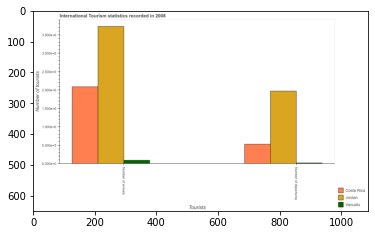

Number of QA =  23





,Tourists,Costa Rica,Vanuatu,Jordan
0,Number of arrivals,2.132548,0.107937,3.760583
1,Number of departures,0.553892,NaN,2.005132


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tourist departures in costa rica to that in jordan ?
PREDICTED =  0.276237021622691
EXPECTED =  0.26774847870182555




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of tourists
EXPECTED =  500000.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  International Tourism stati

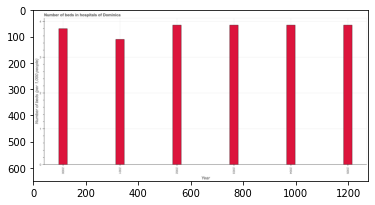

Number of QA =  23





,Year,"Number of beds (per 1,000 people)"
0,2005,3.904958
1,2000,3.813724
2,2004,3.929685
3,2001,3.518881
4,2003,3.926597
5,2002,3.920423


> what is the title of the graph ?
PREDICTED =  Number of beds in hospitals of Dominica
EXPECTED =  Number of beds in hospitals of Dominica




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of beds (per 1,000 people)
EXPECTED =  Number of beds (per 1,000 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hospital beds in 2002 and 2003 ?
PREDICTED =  -0.006173681510611484
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the median number of hospital beds ?
PREDICTED =  None
EXPECTED =  3.9




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of hospital be

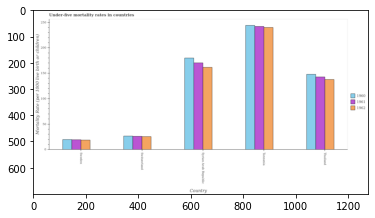

Number of QA =  29





,Country,1962,1961,1960
0,Syrian Arab Republic,163.625176,171.127079,181.585995
1,Switzerland,26.539665,27.320268,27.562301
2,Sweden,19.689980,20.220016,20.729161
3,Thailand,139.499662,144.265655,149.689800
4,Tanzania,242.046415,244.271378,246.913867


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 1961 in sweden and that in switzerland ?
PREDICTED =  -7.100252357597682
EXPECTED =  -6.800000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 1961 in tanzania and the under-five mortality rate in 1960 in thailand?
PREDICTED =  100.00572246644492
EXPECTED =  94.1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate of/in 1960 and under-five mortality rate of/in 1962 in sweden?
PREDICTED =  1.0391808711628308
EXPECTED =  1.0




				 2 / 3 = 0.6667


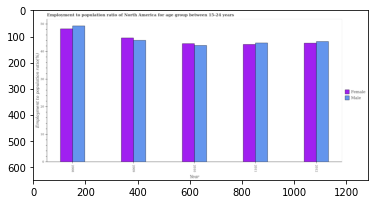

Number of QA =  28





,Year,Female,Male
0,2009,45.136080,44.351036
1,2008,48.503569,49.820044
2,2011,42.727164,43.344192
3,2012,43.326862,43.927136
4,2010,43.167179,42.573307


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(female) ?
PREDICTED =  41.39901558130615
EXPECTED =  48.20112498953399




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(male) ?
PREDICTED =  47.21268149471139
EXPECTED =  42.1898766592765




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to population ratio(male) maximum?
PREDICTED =  1.0
EXPECTED =  2008




				 0 / 4 =

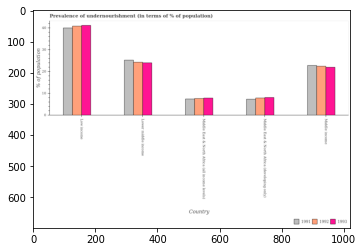

Number of QA =  29





,Country,1992,1993,1991
0,Lower middle income,24.685119,24.257907,25.653754
1,Middle income,22.837290,22.325249,23.136787
2,Low income,41.175163,41.576004,40.324183
3,Middle East & North Africa (all income levels),8.003663,8.114794,7.785914
4,Middle East & North Africa (developing only),8.285144,8.361255,7.660445


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in 1992 in middle east & north africa (all income levels) and that in middle income ?
PREDICTED =  0.0
EXPECTED =  -14.833465737656171




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in 1993 in low income and the percentage of undernourished population in 1991 in middle income?
PREDICTED =  19.250754409049733
EXPECTED =  18.402781562809604




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population of/in 1993 and percentage of u

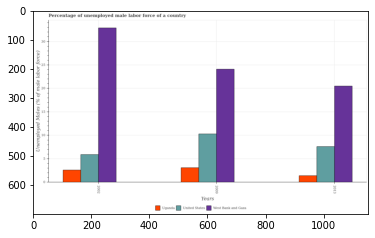

Number of QA =  29





,Years,West Bank and Gaza,Uganda,United States
0,2009,24.307054,3.224852,10.501715
1,2002,33.190878,2.688243,6.043897
2,2013,20.881604,1.489345,7.779179


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in united states in 2009 and that in 2013 ?
PREDICTED =  2.7225358085211377
EXPECTED =  2.7000002861023296




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in united states in 2009 and the percentage of unemployed male labor force in west bank and gaza in 2013?
PREDICTED =  2.7225358085211377
EXPECTED =  -10.1999998092651




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of unemployed male labor force in uganda and percentage 

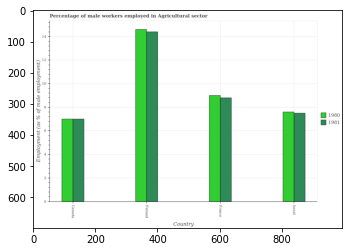

Number of QA =  28





,Country,1980,1981
0,France,9.160784,8.955028
1,Israel,7.742787,7.646198
2,Canada,7.108304,7.150869
3,Finland,14.863031,14.623391


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1981 in finland and that in israel ?
PREDICTED =  6.977192677809721
EXPECTED =  6.8999996185303




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector in 1981 in finland and the percentage of male workers employed in agricultural sector in 1980 in israel?
PREDICTED =  6.977192677809721
EXPECTED =  6.799999713897729




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in agricultural sector of

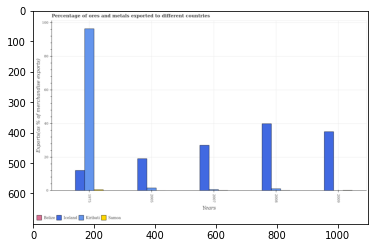

Number of QA =  30





,Years,Iceland,Belize,Samoa,Kiribati
0,2009,35.285719,NaN,NaN,NaN
1,2005,19.432637,NaN,NaN,1.982219
2,1975,12.339242,NaN,NaN,96.969601
3,2008,40.102032,NaN,NaN,1.438173
4,2007,27.287314,NaN,NaN,0.972486


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in belize in 2005 and that in 2007 ?
PREDICTED =  nan
EXPECTED =  0.019339630636489552




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in belize in 2005 and the percentage of exports to different countries in iceland in 1975?
PREDICTED =  nan
EXPECTED =  -12.005415951051036




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of exports to different countries in samoa and percentage of exports to different countries in kir

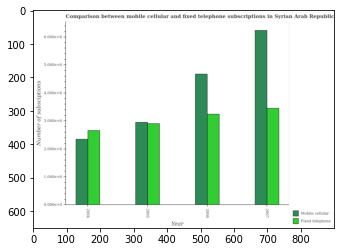

Number of QA =  28





,Year,Mobile cellular,Fixed telephone
0,2005,2.985565,2.943807
1,2006,4.720790,3.274893
2,2007,6.304838,3.483311
3,2004,2.371964,2.687502


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions in 2004 and that in 2006 ?
PREDICTED =  -2.3488261104803505
EXPECTED =  -2329000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions in 2005 and the number of fixed telephone subscriptions in 2007?
PREDICTED =  1.9855652642271253
EXPECTED =  -3284682




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of fixed telephone subscriptions and number of mobile cellular subscriptions ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_b

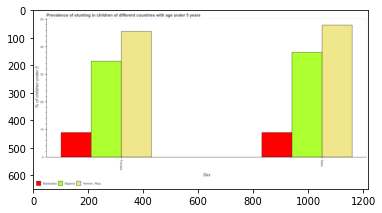

Number of QA =  23





,Sex,"Yemen, Rep.",Nigeria,Barbados
0,Male,48.171402,38.229671,9.168553
1,Female,45.616131,35.075514,9.166286


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children in barbados and that in yemen, rep. ?
PREDICTED =  -36.44984483335591
EXPECTED =  -36.6999984741211




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children in yemen, rep. and the percentage of stunted male children in barbados?
PREDICTED =  45.61613125713936
EXPECTED =  36.6999984741211




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children and percentage of stunted male children in barbados ?
PREDICTED =  35.07551390601342
EXPECTED =  0

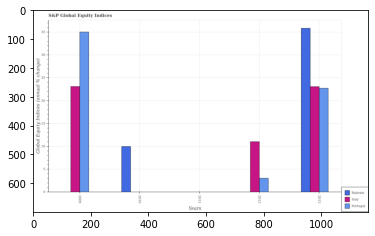

Number of QA =  25





,Years,Portugal,Bahrain,Italy
0,2009,35.256431,NaN,23.283439
1,2012,3.164712,NaN,11.114192
2,2010,NaN,10.084008,NaN
3,2011,NaN,NaN,NaN
4,2013,22.894569,36.019406,23.219109


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global equity indices in italy in 2009 and that in 2013 ?
PREDICTED =  0.06432989794104316
EXPECTED =  0.03347946341570207




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global equity indices in portugal in 2010 and the global equity indices in italy in 2012?
PREDICTED =  -3.164711624088382
EXPECTED =  -11.0280449959877




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the global equity indices in portugal and global equity indices in italy ?
PREDICTED =  0.0
EXPECTED =  -0.34247973943169896




				 0 / 3 = 0.0


is_buil

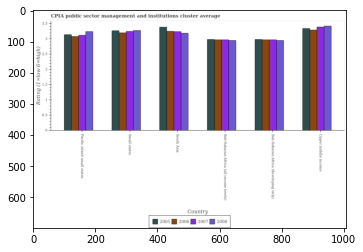

Number of QA =  30





,Country,2007,2005,2008,2006
0,South Asia,3.248347,3.397199,3.200925,3.251781
1,Upper middie income,3.409485,3.364822,3.437380,3.294304
2,Small states,3.266770,3.273487,3.286165,3.196248
3,Pacific island small states,3.135737,3.147918,3.248010,3.082555
4,Sub-Saharan Africa (all income levels),2.969574,2.999122,2.960381,2.976098
5,Sub-Saharan Africa (developing only),2.994881,2.988470,2.960672,2.981635


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in south asia and that in upper middle income ?
PREDICTED =  -0.04252344343759651
EXPECTED =  -0.04166666666667007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in small states and the cpia rating in 2005 in sub-saharan africa (developing only)?
PREDICTED =  0.21461273099546085
EXPECTED =  0.21891891891892




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2005 and cpia rating of/in 2007 in upper middle income?
PREDICTED =  -0.10617186209394092
EXPECTED =  -0.04833333333333023



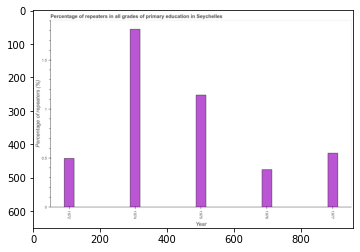

Number of QA =  23





,Year,Percentage of repeaters (%)
0,1975,1.150436
1,1972,0.502755
2,1977,0.555090
3,1974,1.821153
4,1976,0.390631


> what is the title of the graph ?
PREDICTED =  Percentage of repeaters in all grades of primary education in Seychelles
EXPECTED =  Percentage of repeaters in all grades of primary education in Seychelles




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Percentage of repeaters (%)
EXPECTED =  Percentage of repeaters (%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in primary education in 1976 and 1977 ?
PREDICTED =  -0.16445830864380856
EXPECTED =  -0.168




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of repeaters in primary education ?
PREDICTE

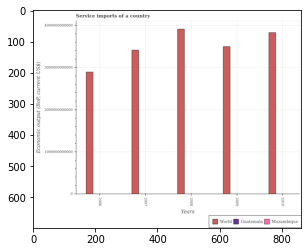

Number of QA =  29





,Years,Mozambique,Guatemala,World
0,2006,NaN,NaN,2.911892e+12
1,2009,NaN,NaN,3.519142e+12
2,2008,NaN,NaN,3.936081e+12
3,2007,NaN,NaN,3.420270e+12
4,2010,NaN,NaN,3.864888e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service imports in guatemala in 2008 and the service imports in mozambique in 2009?
PREDICTED =  nan
EXPECTED =  999020280.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

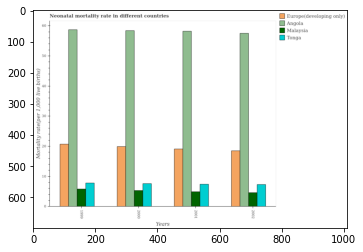

Number of QA =  30





,Years,Angola,Malaysia,Furope(developing only),Tonga
0,1999,58.736666,5.989021,20.919060,7.994167
1,2002,57.494222,4.785068,18.674517,7.417694
2,2000,58.681016,5.495340,20.375246,7.736745
3,2001,58.319209,5.067359,19.085525,7.526450


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in europe(developing only) in 1999 and that in 2002 ?
PREDICTED =  2.2445435875523643
EXPECTED =  2.1999999999999993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in angola in 2000 and the neonatal mortality rate in europe(developing only) in 2002?
PREDICTED =  1.1867932132230266
EXPECTED =  39.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the neonatal mortality rate in malaysia and neonatal mortality rate in angola ?
PREDICTED =  -228.44604545025874
EXPECTED =  -53.3

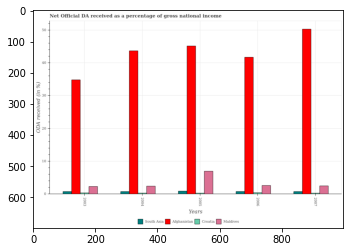

Number of QA =  30





,Years,South Asia,Maldives,Croatia,Afghanistan
0,2007,0.922287,2.603802,0.429400,50.364599
1,2006,0.940263,2.732203,0.559754,42.002897
2,2003,0.930548,2.477103,NaN,35.154035
3,2005,1.056428,7.097070,NaN,45.399591
4,2004,0.911683,2.545835,NaN,43.910043


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official da received in south asia in 2003 and that in 2007 ?
PREDICTED =  0.008261831800477681
EXPECTED =  0.001476220078648116




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official da received in croatia in 2007 and the net official da received in afghanistan in 2005?
PREDICTED =  nan
EXPECTED =  -44.86364075693907




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the net official da received in maldives and net official da received in south asia ?
PREDICTED =  6.040642387925031
EXPECTED =  1.5457259719228507


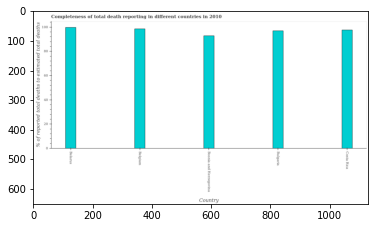

Number of QA =  22





,Country,% of reported total deaths to estimated total deaths
0,Belarus,101.151093
1,Bulgaria,98.417220
2,NaN,99.942419
3,Bosnia and Herzegovina,94.226926
4,Costa Rica,99.399192


> what is the title of the graph ?
PREDICTED =  Completeness of total death reporting in different countries in 2010
EXPECTED =  Completeness of total death reporting in different countries in 2010




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of reported total deaths to estimated total deaths
EXPECTED =  % of reported total deaths to estimated total deaths




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in belgium and costa rica ?
PREDICTED =  -94.39919169417487
EXPECTED =  0.937




				 3 / 4 = 0.75


> what is the median completeness of total death reports ?
PREDICTED =  None
EXPECTED =  97.58056265984648




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_a

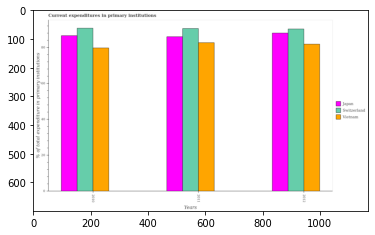

Number of QA =  29





,Years,Switzerland,Japan,Vietnam
0,2010,92.075593,86.616346,80.196855
1,2012,91.225385,88.153356,81.761638
2,2011,91.099102,86.245233,83.083823


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in vietnam in 2011 and that in 2012 ?
PREDICTED =  1.3221851962029376
EXPECTED =  0.8167953491210938




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in japan in 2011 and the current expenditures in primary institutions in switzerland in 2012?
PREDICTED =  -1.908122307508819
EXPECTED =  -4.296241760253906




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after t

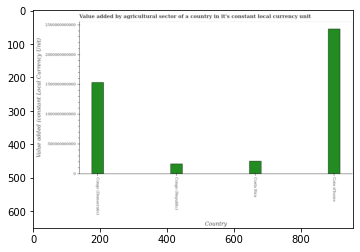

Number of QA =  22





,Country,Value added (constant Local Currency Unit)
0,Congo (Republic),1.770610e+11
1,Costa Rica,2.240612e+11
2,Cote d'Ivoire,2.444790e+12
3,Congo (Democratic),1.536634e+12


> what is the title of the graph ?
PREDICTED =  Value added by agricultural sector of a country in it's constant local currency unit
EXPECTED =  Value added by agricultural sector of a country in it's constant local currency unit




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Value added (constant Local Currency Unit)
EXPECTED =  Value added (constant Local Currency Unit)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in costa rica and cote d'ivoire ?
PREDICTED =  -1110364592212.4272
EXPECTED =  -2220257220583.15




				 3 / 4 = 0.75


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  872856380925.0




				 3 / 6 = 0.5


is_built_

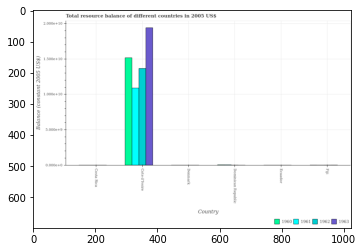

Number of QA =  23





,Country,1963,1962,1961,1960
0,Denmark,NaN,NaN,NaN,NaN
1,Costa Rica,NaN,NaN,NaN,NaN
2,Fiji,NaN,NaN,NaN,NaN
3,Cote d'Ivoire,1.951921,1.369301,1.08772,1.542398
4,Dominican Republic,NaN,NaN,NaN,NaN
5,Ecuador,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in 1963 in denmark and the total resource balance in 1962 in dominican republic?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance of/in 1961 and total resource balance of/in 1960 in dominican republic?
PREDICTED =  -0.9122799798216752
EXPECTED =  -400000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total resource balance in 1960 in cote d'ivoire to that in dominican republic?
PREDICTED =  1.5423975707730888
EXPECTED =  332.9078333333333




				 1 / 3 = 0.3333


is

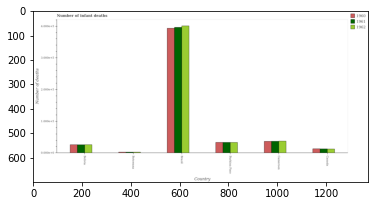

Number of QA =  29





,Country,1962,1961,1960
0,Brazil,4.044333,4.007093,3.980812
1,Botswana,NaN,0.038168,NaN
2,Burkina Faso,0.344527,0.344426,0.346701
3,Cameroon,0.384369,0.378759,0.380607
4,Canada,0.138605,0.141401,0.144408
5,Bolivia,0.274313,0.269200,0.269650


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in 1962 in botswana and that in burkina faso ?
PREDICTED =  -0.34452722956050913
EXPECTED =  -30594.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in 1962 in cameroon and the number of infant deaths in 1961 in burkina faso?
PREDICTED =  -0.6156307254293113
EXPECTED =  4137.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths of/in 1962 and number of infant deaths of/in 1960 in cameroon?
PREDICTED =  4.6193933932173525
EXPECTED =  813.0




				 0 / 3 = 0.0


is_bu

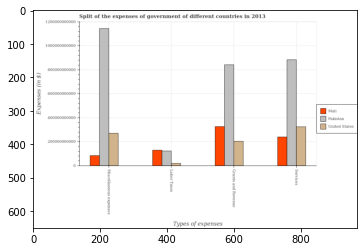

Number of QA =  29





,Types of expenses,Mali,Pakistan,United States
0,Labor Taxes,1.366907e+11,1.291931e+11,2.705526e+10
1,Grants and Revenue,3.340605e+11,8.516761e+11,2.114081e+11
2,Services,2.465446e+11,8.895354e+11,3.334475e+11
3,Miscellaneous expenses,9.188281e+10,1.158233e+12,2.805059e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on labor taxes in mali and that in pakistan ?
PREDICTED =  7497589634.5924225
EXPECTED =  6761000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on grants and revenue in united states and the amount spent on miscellaneous expenses in mali?
PREDICTED =  242177673873.27805
EXPECTED =  119264519555




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on labor taxes and amount spent on miscellaneous expenses in mali ?
PREDICTED =  44807897924.24095
EXPECTED =  45200519555




				 1 / 3 = 0.3333


is_

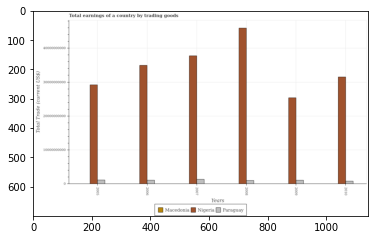

Number of QA =  25





,Years,Nigeria,Macedonia,Paraguay
0,2007,3.766716e+10,NaN,1.435828e+09
1,2006,3.481428e+10,NaN,1.207282e+09
2,2008,4.589891e+10,NaN,1.107964e+09
3,2009,2.534916e+10,NaN,1.173408e+09
4,2010,3.151863e+10,NaN,9.355859e+08
5,2005,2.923581e+10,NaN,1.282046e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in nigeria in 2009 and that in 2010 ?
PREDICTED =  -6169468048.827587
EXPECTED =  -6120959551.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in paraguay in 2010 and the total earnings in macedonia in 2006?
PREDICTED =  -271696351.900471
EXPECTED =  822038121.4




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the total earnings in nigeria and total earnings in paraguay ?
PREDICTED =  38756795391.70128
EXPECTED =  44921262071.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_availa

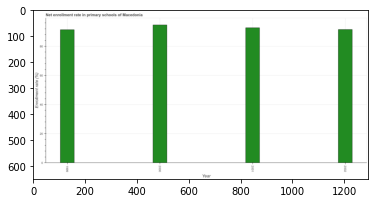

Number of QA =  23





,Year,Enrollment rate (%)
0,2002,91.775883
1,1999,91.797980
2,2001,93.146372
3,2000,95.228117


> what is the title of the graph ?
PREDICTED =  Net enrollment rate in primary schools of Macedonia
EXPECTED =  Net enrollment rate in primary schools of Macedonia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Enrollment rate (%)
EXPECTED =  Enrollment rate (%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate in primary schools in 1999 and 2000 ?
PREDICTED =  -3.430137097125126
EXPECTED =  -3.294




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median net enrollment rate in primary schools ?
PREDICTED =  2000.5
EXPECTED =  92.14596176147461




				 4 / 5 = 0.8


is_buil

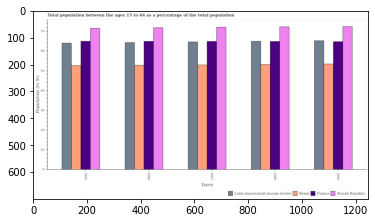

Number of QA =  30





,Years,Latin America(all income levels),France,Slovak Republic,Benin
0,2007,65.092246,65.382660,72.382192,53.113967
1,2006,64.641695,65.503719,72.577878,52.826592
2,2005,64.615362,65.334168,71.934414,52.763436
3,2008,65.466317,65.673998,72.857002,53.455888
4,2009,65.648585,65.173044,72.990185,53.639414


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 15 to 64 in benin in 2005 and that in 2009 ?
PREDICTED =  -0.8759773533860837
EXPECTED =  -0.7454548480858136




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 15 to 64 in benin in 2008 and the percentage of the population ages 15 to 64 in france in 2005?
PREDICTED =  -11.878279491319923
EXPECTED =  -11.748065632294512




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of the population ages 15 to 64 in france and percentage of the population a

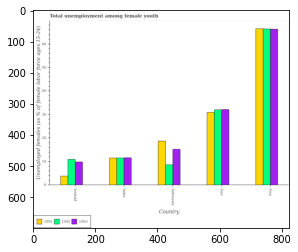

Number of QA =  29





,Country,1992,1993,1991
0,Iceland,11.268813,10.065701,4.064273
1,Indonesia,8.894195,15.353933,19.213378
2,Iran,32.343380,32.633257,31.483736
3,Iraq,67.914667,67.101816,67.408608
4,India,11.921735,11.946939,11.740714


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in in 1992 in india and that in iraq ?
PREDICTED =  -55.99293216489978
EXPECTED =  -54.90000152587889




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in in 1992 in india and the percentage of unemployed females in in 1993 in iran?
PREDICTED =  -20.421645462753858
EXPECTED =  -20.5999984741211




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in of/in 1992 and percentage of unemployed females in of/in 1991 in iran?
PREDICTED =  -10.66780686

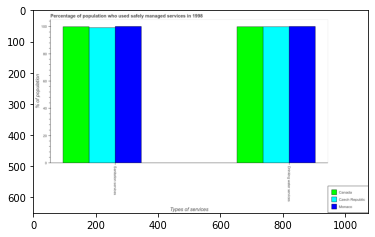

Number of QA =  23





,Types of services,Czech Republic,Monaco,Canada
0,Sanitation services,99.035549,99.371214,99.178250
1,Drinking water services,99.489148,99.477681,99.022881


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services in canada and that in monaco ?
PREDICTED =  -0.19296344060342108
EXPECTED =  -0.20000000000000284




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used drinking water services in czech republic and the percentage of population who used sanitation services in canada?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services and percentage of population who used drinking water ser

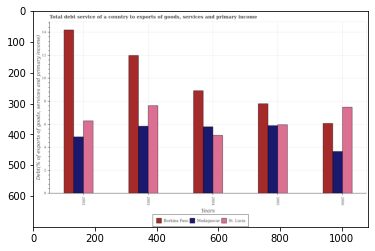

Number of QA =  29





,Years,Madagascar,Burkina Faso,St. Lucia
0,2003,5.845713,11.939620,7.636058
1,2005,5.893672,7.751622,5.962028
2,2002,4.916937,14.186069,6.322086
3,2004,5.848078,8.918267,5.059177
4,2006,3.694905,6.071420,7.460871


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in burkina faso in 2003 and that in 2006 ?
PREDICTED =  5.868200156771305
EXPECTED =  5.900146586112948




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in madagascar in 2003 and the total debt service in burkina faso in 2004?
PREDICTED =  -0.0023652071113344775
EXPECTED =  -3.0846757130820404




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the total debt service in madagascar and total debt service in burkina faso ?
PREDICTED =  21.199306355181236
EXPECTED =  -3.13344068128234




		

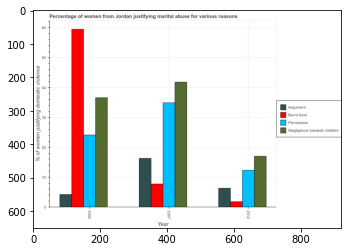

Number of QA =  30





,Year,Permission,Argument,Bumt food,Negligence towards children
0,2007,35.153915,16.484895,8.046690,42.069640
1,2002,24.431019,4.368121,59.991748,36.973015
2,2012,12.617872,6.482755,2.015351,17.161920


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for showing negligence towards children in 2002 and that in 2007 ?
PREDICTED =  -5.0966247329909535
EXPECTED =  -5.199999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for burning food in 2012 and the percentage of women justifying abuse for showing negligence towards children in 2002?
PREDICTED =  -30.49026023609076
EXPECTED =  -57.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of women justifying abuse for burning foo

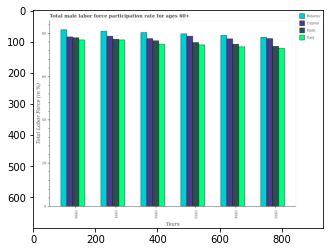

Number of QA =  30





,Years,Unnamed: 1,Belarus,Haiti,Italy
0,1994,77.686244,79.445624,75.012776,74.001591
1,1990,78.929356,81.996373,78.131905,77.451919
2,1991,78.873214,81.802129,77.869857,77.443503
3,1992,77.842796,80.599681,76.594435,75.279637
4,1995,78.505855,78.457470,74.236019,73.237735
5,1993,78.975026,80.039241,75.956374,74.900094


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in belarus in 1992 and that in 1994 ?
PREDICTED =  1.1540562548270117
EXPECTED =  1.300003051757912




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in haiti in 1994 and the male labor force participation rate in belarus in 1990?
PREDICTED =  -3.1191295037688604
EXPECTED =  -6.699996948242202




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the male labor force participation rate in belarus and male labor force participation rate in cyprus ?
PREDICTED 

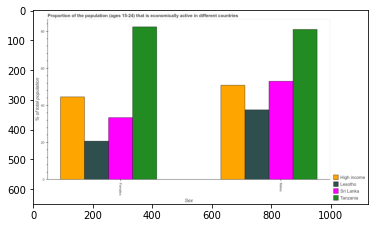

Number of QA =  23





,Sex,Lesotho,Tanzania,Sri Lanka,High income
0,Males,38.054596,81.220442,53.147058,51.056416
1,Females,20.983772,82.636191,33.825075,44.943253


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in sri lanka and that in high income ?
PREDICTED =  33.825074749750826
EXPECTED =  -11.2010218269672




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in sri lanka and the percentage of economically active female population in tanzania?
PREDICTED =  -29.489133094935134
EXPECTED =  -29.400001525878906




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population and percentage of economically active fe

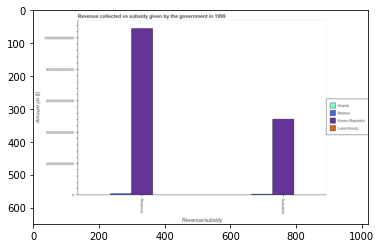

Number of QA =  23





,Revenue/subsidy,Luxembourg,Angola,Korea (Republic),Belarus
0,NaN,NaN,NaN,1.057813e+14,NaN
1,Subs idies,NaN,NaN,4.819802e+13,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of subsidies given in korea (republic) and that in luxembourg ?
PREDICTED =  0.0
EXPECTED =  48229587589445.09




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of revenue collected and amount of subsidies given in angola ?
PREDICTED =  0.0
EXPECTED =  6462048144.2




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?

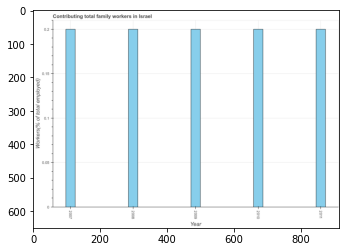

Number of QA =  23





,Year,Workers(% of total employed)
0,2010,0.202074
1,2007,0.202158
2,2008,0.201535
3,2009,0.202038
4,2011,0.200944


> what is the title of the graph ?
PREDICTED =  Contributing total family workers in Israel
EXPECTED =  Contributing total family workers in Israel




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Workers(% of total employed)
EXPECTED =  Workers(% of total employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing family workers in 2007 and 2008 ?
PREDICTED =  0.0006230815662286449
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the median contributing family workers ?
PREDICTED =  None
EXPECTED =  0.200000002980232




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the c

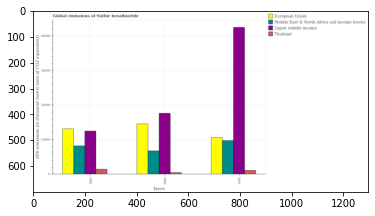

Number of QA =  30





,Years,Furopean Union,Thailand,Middle East & North Africa (all income levels),Upper middle income
0,1990,13367.870609,1572.749873,8332.399586,12660.684305
1,2005,10824.911385,1229.180844,9836.254825,42470.238217
2,2000,14469.863636,595.899527,6846.060086,17616.486157


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of sulfur hexafluoride in upper middle income in 1990 and that in 2005 ?
PREDICTED =  -29809.55391231153
EXPECTED =  -30008.533080722897




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of sulfur hexafluoride in upper middle income in 2005 and the global emissions of sulfur hexafluoride in european union in 1990?
PREDICTED =  29809.55391231153
EXPECTED =  29362.533080722897




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the global emissions of sulfur hexafluoride in european union and gl

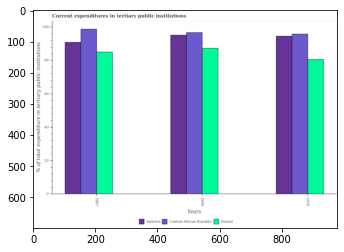

Number of QA =  29





,Years,Central African Republic,Andorra,Poland
0,2007,99.958601,91.210780,85.539971
1,2010,96.240522,95.777132,80.703495
2,2008,97.250750,95.720622,88.039654


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in tertiary public institutions in andorra in 2007 and that in 2010 ?
PREDICTED =  186.9314022691205
EXPECTED =  -3.7064361572264772




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in tertiary public institutions in central african republic in 2008 and the current expenditures in tertiary public institutions in poland in 2010?
PREDICTED =  1.0102285366489099
EXPECTED =  16.125877380371122




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

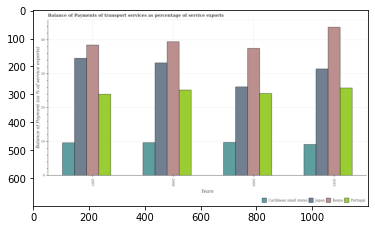

Number of QA =  30





,Years,Portugal,Japan,Kenya,Caribbean small states
0,2008,25.347393,33.585879,39.648225,9.840429
1,2009,24.359568,26.180830,37.514410,9.906460
2,2010,25.959043,31.619256,43.932556,9.320830
3,2007,24.095791,34.728473,38.428628,9.813100


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in caribbean small states in 2009 and that in 2010 ?
PREDICTED =  0.5856295148500319
EXPECTED =  0.586914853365359




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in portugal in 2007 and the balance of payments of transport services in japan in 2010?
PREDICTED =  -1.8632522491116106
EXPECTED =  -7.4783105701467




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the balance of payments of transport services in caribbean small states and balan

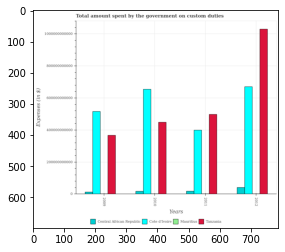

Number of QA =  30





,Years,Central African Republic,Mauritius,Tanzania,Cote d'Ivoire
0,2009,1.548573e+10,NaN,3.667408e+11,5.187287e+11
1,2011,2.157836e+10,NaN,4.969676e+11,4.018797e+11
2,2012,4.362757e+10,NaN,1.027668e+12,6.741059e+11
3,2010,2.099631e+10,NaN,4.517399e+11,6.549382e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in central african republic in 2010 and that in 2012 ?
PREDICTED =  -22631254358.302322
EXPECTED =  -23647934084.75




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties by the government in mauritius in 2009 and the amount spent on custom duties by the government in cote d'ivoire in 2012?
PREDICTED =  -658620214461.814
EXPECTED =  -669098800000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount spent on custom duties by the government in t

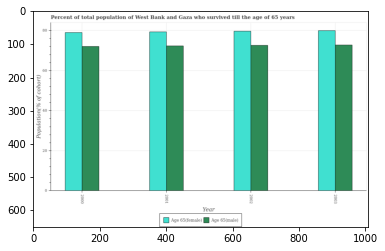

Number of QA =  28





,Year,Age 65(male),Age 65(female)
0,2003,72.880662,79.567423
1,2002,72.699858,79.406486
2,2001,72.322493,79.103078
3,2000,71.612118,79.027920


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in 2000 and that in 2001 ?
PREDICTED =  -0.7103753747227728
EXPECTED =  -0.28442000000002565




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female population who survived till age of 65 in 2001 and the percentage of male population who survived till age of 65 in 2002?
PREDICTED =  -0.30340847261683734
EXPECTED =  -0.3341999999999956




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of male population who survived till age of 65 and perc

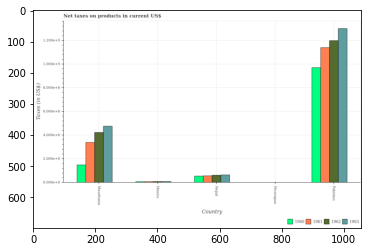

Number of QA =  30





,Country,1963,1962,1961,1960
0,Nicaragua,NaN,NaN,NaN,NaN
1,Mauritania,0.477646,0.426565,0.340854,0.152627
2,Mexico,NaN,NaN,NaN,NaN
3,Pakistan,1.320982,1.205936,1.151015,0.976671
4,Nepal,0.068478,0.064926,0.060242,0.059057


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in 1963 in nicaragua and that in pakistan ?
PREDICTED =  -1.3209820833794819
EXPECTED =  -1299999499.9584692




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in 1960 in pakistan and the net taxes on products in 1963 in mexico?
PREDICTED =  0.976670992627407
EXPECTED =  961507600.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products of/in 1963 and net taxes on products of/in 1960 in mauritania?
PREDICTED =  2.847373443577112
EXPECTED =  327484000.0




				 0 / 3 = 0.0


is_b

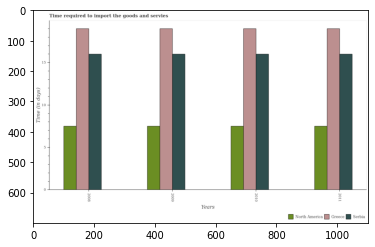

Number of QA =  29





,Years,North America,Greece,Serbia
0,2010,7.513203,18.979276,15.945557
1,2011,7.537729,18.990565,16.051371
2,2008,7.442210,19.000869,15.903913
3,2009,7.468117,19.023858,16.017284


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in greece in 2008 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in serbia in 2011 and the number of days required to import the goods and services in greece in 2010?
PREDICTED =  2.0
EXPECTED =  -3




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the number of days required to import the goods and services in greece and number of days required to import the g

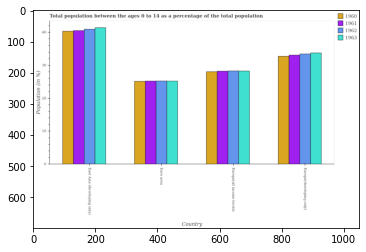

Number of QA =  30





,Country,1963,1962,1961,1960
0,Europe(all income levels),28.445715,28.535262,28.410935,28.217024
1,Euro area,25.444117,25.509973,25.404146,25.453257
2,East Asia (developing only),41.727554,41.294457,40.734839,40.449339
3,Europe(developing only),33.934210,33.670678,33.260113,32.979616


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in 1962 in euro area and that in europe(developing only) ?
PREDICTED =  -8.160704893848326
EXPECTED =  -8.209170319464302




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of the population ages 0 to 14 in 1963 in euro area to that in europe(all income levels)?
PREDICTED =  0.07030935992148192
EXPECTED =  0.8920395509375636




			

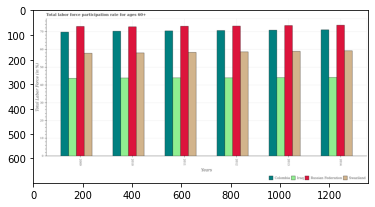

Number of QA =  30





,Years,Colombia,Russian Federation,Swaziland,Iraq
0,2014,71.175722,73.454790,59.144289,44.406918
1,2010,70.298023,72.949516,58.107848,44.069049
2,2011,70.507098,73.451781,58.427224,44.438026
3,2009,69.597025,73.377272,57.854838,43.986973
4,2013,70.859199,73.682177,58.852320,44.257833
5,2012,70.632225,73.594261,58.428443,44.213501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the labor force participation rate in russian federation minimum?
PREDICTED =  335.0
EXPECTED =  2010




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in swaziland in 2012 and that in 2013 ?
PREDICTED =  -0.42387643281522713
EXPECTED =  -0.3000030517577983




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in swaziland in 2010 and the labor force participation rate in iraq in 2013?
PREDICTED =  13.850014858844155
EXPECTED =  13.9000015258789




				 1 / 3 = 0.3333


is_built_with_cuda: True
is

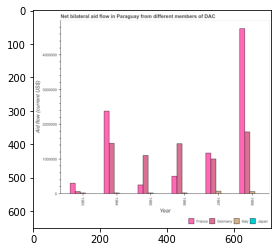

Number of QA =  27





,Year,Unnamed: 1,Germany,France,Italy
0,1985,NaN,1.115253e+06,2.682090e+05,NaN
1,1987,NaN,1.019919e+06,1.186132e+06,91819.25780
2,1988,NaN,1.788866e+06,4.751135e+06,78128.81096
3,1983,NaN,8.147224e+04,3.148011e+05,NaN
4,1984,NaN,1.461151e+06,2.398824e+06,NaN
5,1986,NaN,1.455710e+06,5.154095e+05,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by germany in 1984 and that in 1986 ?
PREDICTED =  5441.571351244114
EXPECTED =  10000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by germany in 1985 and the amount of aid given by italy in 1986?
PREDICTED =  -340457.18775037886
EXPECTED =  -340000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the amount of aid given by france and amount of aid given by italy ?
PREDICTED =  4581187.11028886
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fal

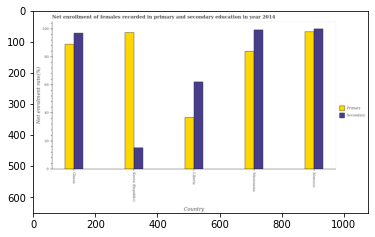

Number of QA =  28





,Country,Secondary,Primary
0,Micronesia,100.252789,84.822813
1,Liberia,62.634135,37.240795
2,Morocco,100.876702,99.030731
3,Korea (Republic),15.629326,98.058414
4,Ghana,97.689058,89.698789


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in ghana and that in korea (republic) ?
PREDICTED =  82.05973200418832
EXPECTED =  81.8324823379517




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in micronesia and the enrollment rate in primary education in ghana?
PREDICTED =  2.56373087553132
EXPECTED =  10.23849487304689




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education and enrollment rate in secondary education in liberia ?
PREDICTED =  371.61074625488243
EXPECTED =  

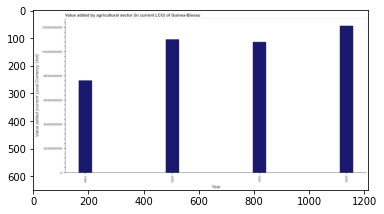

Number of QA =  23





,Year,Value added (current Local Currency Unit)
0,1999,7.628928e+10
1,2002,1.214183e+11
2,2001,1.077275e+11
3,2000,1.094670e+11


> what is the title of the graph ?
PREDICTED =  Value added by agricultural sector (in current LCU) of Guinea-Bissau
EXPECTED =  Value added by agricultural sector (in current LCU) of Guinea-Bissau




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Value added (current Local Currency Unit)
EXPECTED =  Value added (current Local Currency Unit)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in 1999 and 2002 ?
PREDICTED =  -45129048774.0031
EXPECTED =  -45183191100.0




				 4 / 4 = 1.0


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  108917000000.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

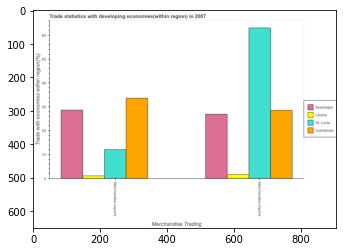

Number of QA =  23





,Merchandise Trading,Uzbekistan,Azerbaijan,Liberia,St. Lucia
0,Merchandise imports,28.973966,27.495927,1.913503,63.429777
1,Merchandise exports,34.017108,29.171649,1.359980,12.377951


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in azerbaijan to that in uzbekistan ?
PREDICTED =  0.8575581648791568
EXPECTED =  0.8515070029743318




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade with economies within region(%)
EXPECTED =  10.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Trade statistics 

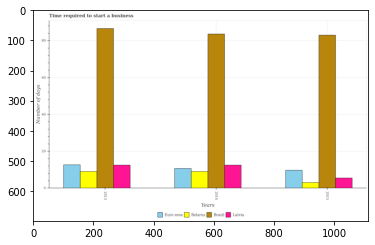

Number of QA =  30





,Years,Latvia,Brazil,Belarus,Euro area
0,2013,12.613467,86.574563,9.214266,12.921660
1,2014,12.726358,83.203425,9.237900,10.856364
2,2015,5.610834,82.540374,3.194920,9.904064


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in latvia in 2013 and that in 2015 ?
PREDICTED =  0.0
EXPECTED =  7.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in latvia in 2015 and the number of days required to start a business in euro area in 2014?
PREDICTED =  0.0
EXPECTED =  -5.157894736842101




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the number of days required to start a business in belarus and number of days required to start a business in euro area ?
PREDICTED 

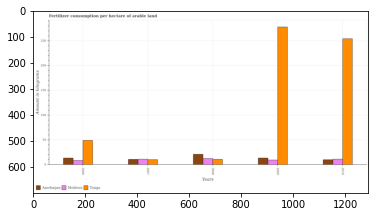

Number of QA =  29





,Years,Azerbaijan,Moldova,Tonga
0,2008,21.602456,13.246081,11.670255
1,2009,14.406709,10.376962,279.044144
2,2010,10.888553,11.799324,255.239681
3,2007,11.654558,11.464437,11.032708
4,2006,14.468467,9.360265,49.776434


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in azerbaijan in 2006 and that in 2008 ?
PREDICTED =  -7.1339889913174765
EXPECTED =  -7.5985882881593




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in moldova in 2008 and the amount of fertilizer consumption in azerbaijan in 2009?
PREDICTED =  2.8691185731444246
EXPECTED =  -0.9583716477452988




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount of fertilizer consumption in moldova and amount of fertilizer consumption in azerbaijan ?
PREDICTED =  

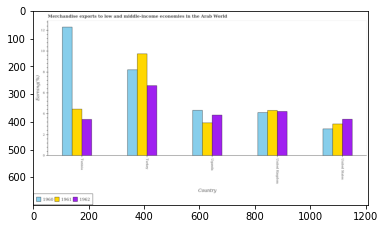

Number of QA =  29





,Country,1962,1961,1960
0,United Kingdom,4.294367,4.369971,4.173380
1,Uganda,3.941418,3.185069,4.399377
2,Tunisia,3.505553,4.533500,12.436165
3,United States,3.539622,3.075601,2.618892
4,Turkey,6.831944,9.825479,8.271164


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1961 in turkey and that in united states ?
PREDICTED =  6.749877732912543
EXPECTED =  6.72059583782476




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1960 in united states and the percentage of amount earned from merchandise exports in 1961 in tunisia?
PREDICTED =  -1.9146081830250137
EXPECTED =  -1.8908130639213603




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports of/in 19

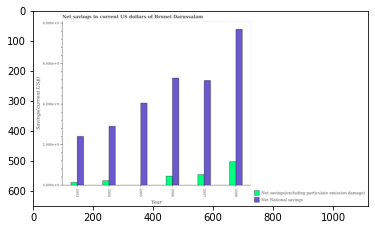

Number of QA =  25





,Year,Net National savings,Net savings(excluding particulate emission damage)
0,2005,4.066691,NaN
1,2006,5.328253,0.471490
2,2007,5.189112,0.543779
3,2008,7.723896,1.184831
4,2004,2.943610,0.255861
5,2003,2.447015,0.162457


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in 2003 and that in 2007 ?
PREDICTED =  -2.7420969892604
EXPECTED =  -2759618306.9310203




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings(excluding particulate emission damage) in 2008 and the net national savings in 2004?
PREDICTED =  0.9289705137722024
EXPECTED =  937624561.703321




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net national savings and net savings(excluding particulate emission damage) ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: T

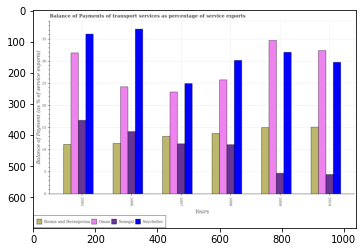

Number of QA =  30





,Years,Senegal,Bosnia and Herzegovina,Seychelles,Oman
0,2008,11.262442,13.737686,30.346781,26.031554
1,2006,14.182787,11.487690,37.554679,24.450510
2,2010,4.491316,15.219479,30.017385,32.543647
3,2009,4.769808,15.138592,32.063406,34.850218
4,2005,16.823988,11.279367,36.342595,31.793132
5,2007,11.421024,13.112919,25.388118,23.507832


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in seychelles in 2006 and that in 2010 ?
PREDICTED =  7.5372946591997305
EXPECTED =  7.498196672746797




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in senegal in 2007 and the balance of payments of transport services in bosnia and herzegovina in 2010?
PREDICTED =  6.929707759735919
EXPECTED =  -3.7621098246708




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the balance of payments of transport services in senegal and balance of payment

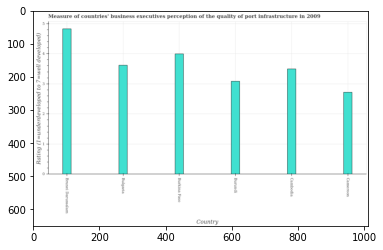

Number of QA =  22





,Country,Rating (1=underdeveloped to 7=well developed)
0,Brunei Darussalam,4.896268
1,Burkina Faso,4.032334
2,Cameroon,2.745001
3,Bulgaria,3.660865
4,Cambodia,3.530272
5,Burundi,3.118390


> what is the title of the graph ?
PREDICTED =  Measure of countries’ business executives perception of the quality of port infrastructure in 2009
EXPECTED =  Measure of countries' business executives perception of the quality of port infrastructure in 2009




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Rating (1=underdeveloped to 7=well developed)
EXPECTED =  Rating (1=underdeveloped to 7=well developed) 




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring quality of port infrastructure in bulgaria and cambodia ?
PREDICTED =  0.13059261766200603
EXPECTED =  0.123




				 1 / 4 = 0.25


> what is the median rating measuring quality of port infrastructure ?
PREDICTED =  None
EXPECTED =  

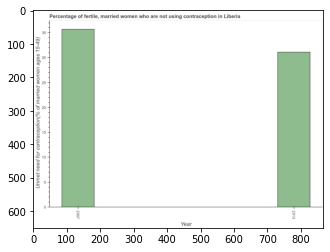

Number of QA =  19





,Year,Unmet need for contraception(% of married women ages 15-49)
0,2007,36.120625
1,2013,31.349354


> what is the title of the graph ?
PREDICTED =  Percentage of fertile, married women who are not using contraception in Liberia
EXPECTED =  Percentage of fertile, married women who are not using contraception in Liberia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unmet need for contraception(% of married women ages 15-49)
EXPECTED =   Unmet need for contraception(% of married women ages 15-49)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of married women who are not using contraception in 2007 and 2013 ?
PREDICTED =  -4.771271054053827
EXPECTED =  4.6




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

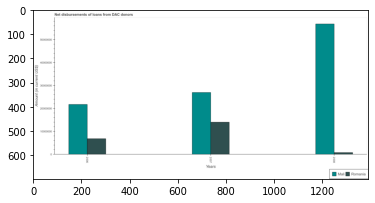

Number of QA =  28





,Years,Mali,Romania
0,2008,5.677484e+07,9.512181e+05
1,2006,2.177908e+07,6.941079e+06
2,2007,2.686276e+07,1.414640e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in romania in 2007 and that in 2008 ?
PREDICTED =  13195177.526812484
EXPECTED =  13245000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in mali in 2008 and the amount of loans disbursed in romania in 2006?
PREDICTED =  34995755.125242665
EXPECTED =  50002000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of loans disbursed in romania and amount of loans disbursed in mali ?
PREDICTED =  -83377984.94101173
EXPECTED =  -56046000.0




				 1 / 3 = 0.3333

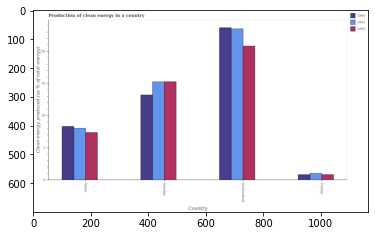

Number of QA =  29





,Country,1962,1961,1960
0,NaN,7.530648,8.133613,8.417926
1,Turkey,0.917292,1.101486,0.916704
2,Sweden,15.425133,15.279048,13.310081
3,Switzerland,20.979887,23.736588,23.894539


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in 1962 in switzerland and that in turkey ?
PREDICTED =  20.06259547111536
EXPECTED =  20.002953680405682




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in 1962 in spain and the percentage of clean energy produced in 1961 in sweden?
PREDICTED =  -14.5078415074417
EXPECTED =  -7.88813382417086




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced of/in 1960 and percentage of clean energy produced of/in 1962 in spain?
PREDICTED =  -0.0

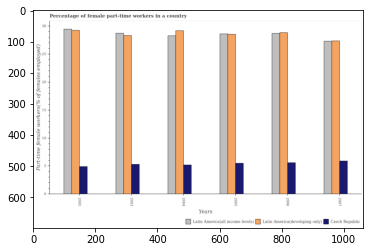

Number of QA =  29





,Years,Latin America(developing only),Czech Republic,Latin America(all income levels)
0,2002,29.541173,4.985361,29.635711
1,2003,28.451865,5.385617,28.976578
2,2006,29.003473,5.694181,28.839681
3,2005,28.681543,5.599596,28.751058
4,2004,29.302705,5.280678,28.412035
5,2007,27.526374,5.967698,27.377497


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in czech republic in 2005 and that in 2006 ?
PREDICTED =  -0.09458494723877475
EXPECTED =  -0.09999990463257102




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in latin america(all income levels) in 2007 and the percentage of female part-time workers in latin america(developing only) in 2004?
PREDICTED =  -1.0345374013079969
EXPECTED =  -1.8746243772454




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of female part-time workers i

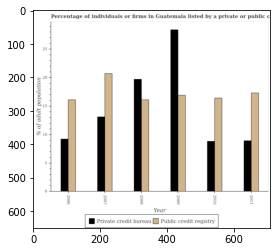

Number of QA =  28





,Year,Private credit bureau,Public credit registry
0,2006,9.424411,16.069859
1,2011,9.048860,17.267788
2,2010,8.759978,16.484812
3,2009,28.502176,16.912886
4,2008,19.782938,16.087926
5,2007,13.142622,20.777878


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in 2008 and that in 2011 ?
PREDICTED =  10.734077654812138
EXPECTED =  10.799999999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in 2009 and the percentage of firms listed by public credit bureau in 2007?
PREDICTED =  15.359554232034428
EXPECTED =  15.299999999999999




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

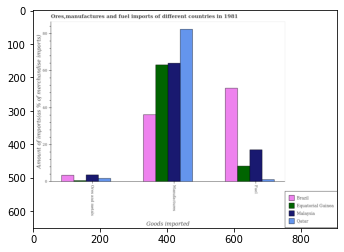

Number of QA =  28





,Goods imported,Malaysia,Brazil,Equatorial Guinea,Qatar
0,Ores and metals,3.939551,3.730690,0.838737,2.016756
1,Manufactures,64.173212,36.331276,63.669608,82.995844
2,Fuel,17.597423,50.901017,8.672813,1.424608


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in brazil and that in equatorial guinea ?
PREDICTED =  42.22820382155715
EXPECTED =  42.136319996549744




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of ores and metals imports in equatorial guinea and the percentage of fuel imports in brazil?
PREDICTED =  0.20886092444220639
EXPECTED =  -50.00259109469438




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports and percentage of manufactures imports in brazil ?
PREDICTED =  -18.733853424723623
EXPECTED =  14.3208624065608






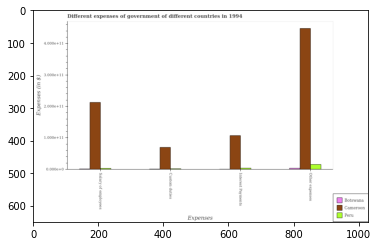

Number of QA =  29





,Expenses,Botswana,Peru,Cameroon
0,Interest Payments,NaN,NaN,1.083968
1,Salary of employees,NaN,NaN,2.115825
2,Other expenses,NaN,0.169843,4.480384
3,Custom duties,NaN,NaN,0.712627


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties in cameroon and that in peru ?
PREDICTED =  0.5427843115720665
EXPECTED =  68048210000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties and amount spent on interest payments in peru ?
PREDICTED =  0.5427843115720665
EXPECTED =  -1897210000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount spent on other expenses in peru to that in

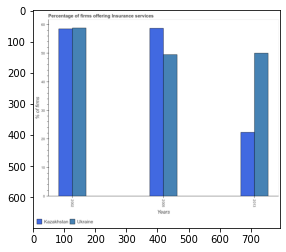

Number of QA =  28





,Years,Ukraine,Kazakhstan
0,2002,58.866078,58.612694
1,2005,49.656132,58.697502
2,2013,49.973202,22.647306


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering insurance services in kazakhstan in 2002 and that in 2005 ?
PREDICTED =  -0.08480771266275156
EXPECTED =  -0.20000000000000284




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering insurance services in kazakhstan in 2005 and the percentage of firms offering insurance services in ukraine in 2013?
PREDICTED =  36.050195745128164
EXPECTED =  8.700000000000003




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of firms offering insurance services in ukraine and

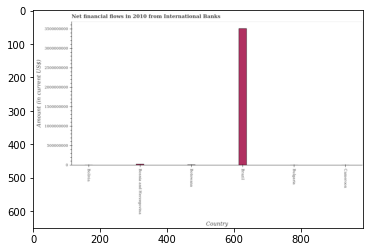

Number of QA =  19





,Country,Amount (in current US$)
0,Bolivia,NaN
1,Brazil,3.521858e+09
2,Botswana,NaN
3,Cameroon,NaN
4,Bosnia and Herzegovina,4.057419e+07
5,Bulgaria,NaN


> what is the title of the graph ?
PREDICTED =  Net financial flows in 2010 from International Banks
EXPECTED =  Net financial flows in 2010 from International Banks




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount (in current US$)
EXPECTED =  Amount (in current US$)




				 3 / 3 = 1.0


> what is the median net financial flows from ibrd ?
PREDICTED =  None
EXPECTED =  3243500.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net financial flows from ibrd in bosnia and herzegovina to that in brazil?
PREDICTED =  0.011520676221710002
EXPECTED =  0.007




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.









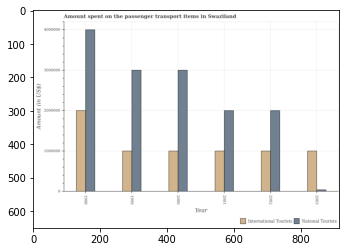

Number of QA =  28





,Year,International Tourists,National Tourists
0,2003,1.009591e+06,5.234495e+04
1,2000,1.012119e+06,2.997407e+06
2,2002,1.008116e+06,2.003776e+06
3,1999,1.010459e+06,3.013747e+06
4,2001,1.008055e+06,1.999573e+06
5,1998,2.012770e+06,4.014838e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of international tourists in 2001 and that in 2002 ?
PREDICTED =  -61.056328089442104
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of international tourists in 2000 and the amount spent on transport items of national tourists in 2002?
PREDICTED =  4002.721674129134
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the amount spent on transport items of international tourists and amount spent on transport items of national tourist

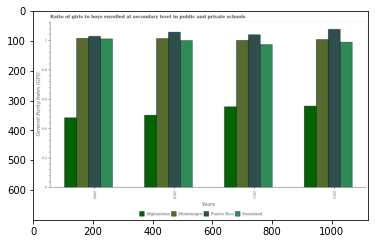

Number of QA =  30





,Years,Montenegro,Puerto Rico,Afghanistan,Swaziland
0,2012,1.007804,1.073196,0.553917,0.989552
1,2009,1.010458,1.025176,0.474781,1.011082
2,2010,1.010553,1.059524,0.494754,0.996250
3,2011,0.999901,1.032577,0.551865,0.970828


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in montenegro in 2009 and that in 2010 ?
PREDICTED =  -9.553378771376408e-05
EXPECTED =  0.0009599924087499989




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in puerto rico in 2011 and the general parity index in swaziland in 2012?
PREDICTED =  -0.0406183218152405
EXPECTED =  0.05083000659942305




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the general parity index in montenegro and general parity index in afghanistan ?
PREDICTED =  3.5098871186180736
EXPECTED =  0.45188999176

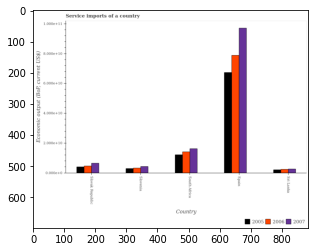

Number of QA =  29





,Country,2007,2005,2006
0,South Africa,5.862540,4.388871,5.151103
1,NaN,34.077661,23.725093,27.710514
2,Slovak Republic,2.450781,1.580051,1.780561
3,Slovenia,1.653136,1.192404,1.284297
4,Sri Lanka,1.087059,0.875225,1.022982


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service imports in 2005 in south africa and that in sri lanka ?
PREDICTED =  0.0
EXPECTED =  10062269201.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service imports in 2005 in slovenia and the service imports in 2007 in south africa?
PREDICTED =  -3.1964672074584657
EXPECTED =  -13320231853.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the service imports in 2006 in spain to that in sri 

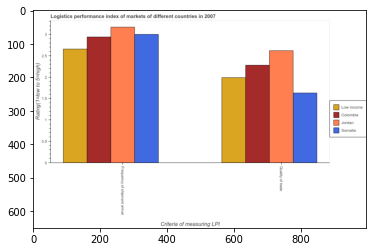

Number of QA =  23





,Criteria of measuring LPI,Low income,Somalia,Jordan,Colombia
0,Frequency of shipment arrival,2.663795,3.025727,3.172774,2.941836
1,Quality of trade,2.004891,1.642830,2.610993,2.290840


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Rating(1=low to 5=high)
EXPECTED =  0.5




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Logistics performance index of markets of different countries in 2007
EXPECTED =  Logistics performance index of markets of different countries in 2007




				 1 / 6 = 0.1667


> wha

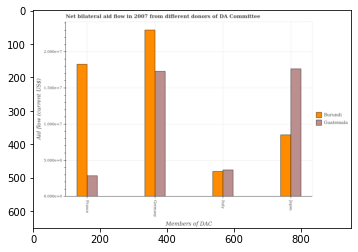

Number of QA =  29





,Members of DAC,Burundi,Guatemala
0,NaN,NaN,NaN
1,Germany,2.304240,1.733144
2,NaN,NaN,NaN
3,Italy,0.350351,0.373698


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by france in guatemala and that in burundi ?
PREDICTED =  0.0
EXPECTED =  -15420000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by japan in burundi and the amount of aid given by italy in guatemala?
PREDICTED =  1.6263024969388227
EXPECTED =  4860000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by japan and amount of aid given by france in guatemala ?
PREDICTED =  2.0
EXPECTED =  14790000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


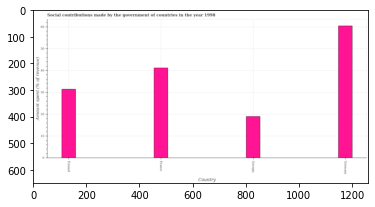

Number of QA =  22





,Country,Amount spent (% of revenue)
0,Finland,31.772975
1,NaN,18.982751
2,Germany,60.607757
3,France,41.508286


> what is the title of the graph ?
PREDICTED =  social contributions made by the government of countries in the year 1998
EXPECTED =  Social contributions made by the government of countries in the year 1998




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Amount spent (% of revenue)
EXPECTED =  Amount spent (% of revenue)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in making social contributions in georgia and germany ?
PREDICTED =  -41.62500633992711
EXPECTED =  -41.463




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_availab

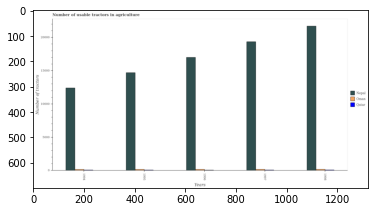

Number of QA =  29





,Years,Unnamed: 1,Nepal,Oman
0,1995,NaN,14796.684777,NaN
1,1998,NaN,21653.837966,258.372838
2,1996,NaN,17060.216116,NaN
3,1997,NaN,19379.674642,NaN
4,1994,NaN,12464.480970,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in oman in 1994 and that in 1995 ?
PREDICTED =  258.37283822956454
EXPECTED =  -5.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in oman in 1996 and the number of usable tractors in agriculture in nepal in 1995?
PREDICTED =  -14538.311938772571
EXPECTED =  -14537.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the number of usable tractors in agriculture in qatar and number of usable tractors in agriculture in nepal ?
PREDICTED =  0.0


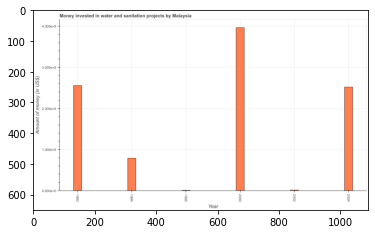

Number of QA =  23





,Year,Amount of money (in US$)
0,1994,0.803187
1,2004,2.528681
2,2000,3.972898
3,1995,0.024310
4,2002,0.029729
5,1993,2.568372


> what is the title of the graph ?
PREDICTED =  Money invested in water and sanitation projects by Malaysia
EXPECTED =  Money invested in water and sanitation projects by Malaysia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of money (in US$)
EXPECTED =  Amount of money (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in 1993 and 2004 ?
PREDICTED =  0.03969115881323226
EXPECTED =  37200000.0




				 3 / 4 = 0.75


> what is the median investment ?
PREDICTED =  None
EXPECTED =  1655500000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the investment 

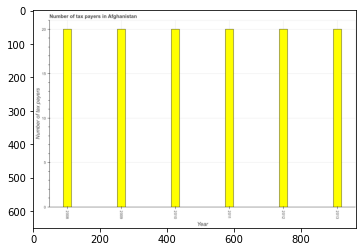

Number of QA =  23





,Year,Number of tax payers
0,2009,20.277826
1,2012,20.142959
2,2010,20.250161
3,2013,20.250072
4,2008,20.182106
5,2011,20.186132


> what is the title of the graph ?
PREDICTED =  Number of tax payers in Afghanistan
EXPECTED =  Number of tax payers in Afghanistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of tax payers
EXPECTED =  Number of tax payers




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in 2009 and 2012 ?
PREDICTED =  0.13486716625066464
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tax payers ?
PREDICTED =  2010.5
EXPECTED =  20.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

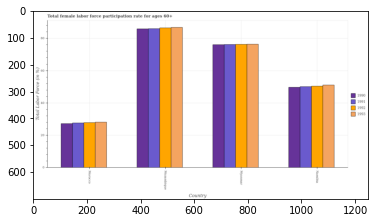

Number of QA =  30





,Country,1992,1993,1991,1990
0,Mozambique,86.301076,86.345192,85.934055,85.560467
1,Morocco,28.027641,28.266799,27.806017,27.173506
2,Namibia,50.372616,51.087722,50.348500,49.515297
3,Myanmar,76.081653,75.885063,76.110476,75.915426


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1991 in mozambique and that in namibia ?
PREDICTED =  35.585554486431974
EXPECTED =  35.9000015258789




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1990 in mozambique and the female labor force participation rate in 1992 in namibia?
PREDICTED =  36.04517001933691
EXPECTED =  35.50000000000001




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate of/in 1990 and female labor force participation rate of/in 1992 in namibia?


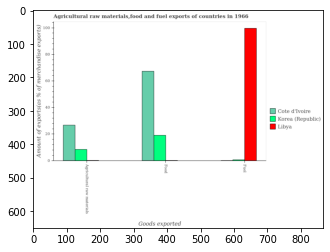

Number of QA =  28





,Goods exported,Korea (Republic),Unnamed: 2,Cote d'Ivoire
0,Fuel,NaN,100.136909,NaN
1,Food,19.510359,NaN,67.856971
2,Agricultural raw materials,8.851771,NaN,27.161936


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food exports in cote d'ivoire and that in korea (republic) ?
PREDICTED =  0.0
EXPECTED =  48.2491020875033




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food exports in korea (republic) and the percentage of raw materials exports in libya?
PREDICTED =  0.0
EXPECTED =  18.891142369636626




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of raw materials ex

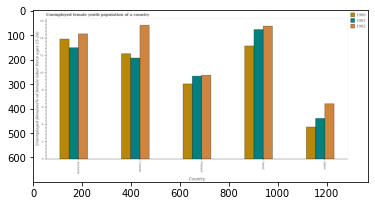

Number of QA =  29





,Country,1982,1980,1981
0,Canada,15.684509,12.332646,11.818084
1,Israel,15.555576,13.319343,15.186662
2,Finland,9.822173,8.820824,9.684969
3,Australia,14.634102,14.050078,13.034014
4,Japan,6.460539,3.781658,4.777094


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female youth population in 1982 in australia and that in finland ?
PREDICTED =  4.811928672353368
EXPECTED =  4.80000019073486




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female youth population in 1982 in canada and the percentage of unemployed female youth population in 1980 in finland?
PREDICTED =  5.862336216264561
EXPECTED =  6.8000001907348615




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female youth population of/in 1981 and percentage of unemploy

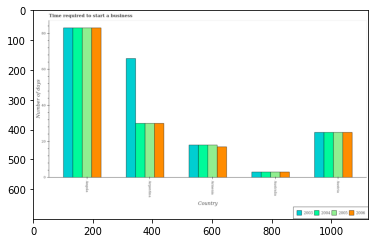

Number of QA =  30





,Country,2005,2003,2004,2006
0,Angola,84.566774,83.822477,84.095258,84.549096
1,Armenia,18.248872,18.494776,18.503239,17.554987
2,Austria,25.505869,25.515686,25.502409,25.621776
3,Australia,3.408151,3.377933,3.394503,3.393068
4,Argentina,30.595115,66.752471,30.743809,30.588672


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in 2004 in angola and that in austria ?
PREDICTED =  58.59284889032722
EXPECTED =  58.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business in 2006 in argentina and the number of days required to start a business in 2003 in angola?
PREDICTED =  -53.96042406985242
EXPECTED =  -53.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to start a business of/in 2006 and number of days required to start a business of/in 2003 in austria?


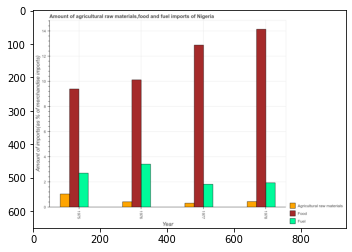

Number of QA =  29





,Year,Agricultural raw materials,Fuel,Food
0,1975,1.081230,2.765460,9.397708
1,1978,0.479416,1.991096,14.188785
2,1976,0.469448,3.432606,10.146585
3,1977,0.356376,1.858576,12.890065


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in 1975 and that in 1977 ?
PREDICTED =  -3.492357381550814
EXPECTED =  -3.4896871511904894




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials imports in 1978 and the percentage of fuel imports in 1976?
PREDICTED =  0.009968722129407415
EXPECTED =  0.020940713352769036




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1978, what is the difference between the percentage of food imports and percentage of raw materials imports ?
PREDICTED =  -2.0786125521821237
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_

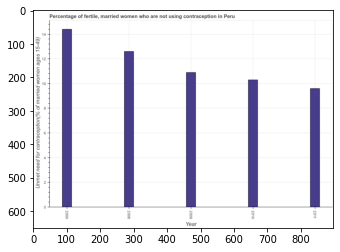

Number of QA =  23





,Year,Unmet need for contraception(% of married women ages 15-49)
0,2008,12.726380
1,2009,11.058552
2,2000,14.610188
3,2011,9.797906
4,2010,10.457030


> what is the title of the graph ?
PREDICTED =  Percentage of fertile, married women who are not using contraception in Peru
EXPECTED =  Percentage of fertile, married women who are not using contraception in Peru




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unmet need for contraception(% of married women ages 15-49)
EXPECTED =   Unmet need for contraception(% of married women ages 15-49)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of married women who are not using contraception in 2000 and 2008 ?
PREDICTED =  1.0
EXPECTED =  1.8




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is

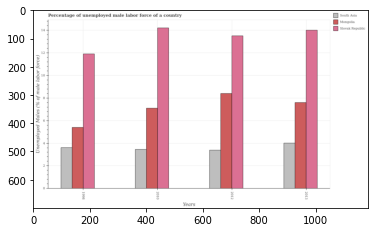

Number of QA =  29





,Years,South Asia,Slovak Republic,Mongolia
0,1998,3.635997,11.892501,5.438555
1,2012,3.423843,13.661353,8.453525
2,2010,3.497571,14.281883,7.128961
3,2013,4.085839,14.026331,7.595188


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in slovak republic in 2012 and that in 2013 ?
PREDICTED =  -0.3649781468351314
EXPECTED =  -0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male labor force in south asia in 1998 and the percentage of unemployed male labor force in slovak republic in 2013?
PREDICTED =  -0.4498420030248753
EXPECTED =  -10.38996640620095




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of unemployed male labor force in mongolia and percentage of unemployed

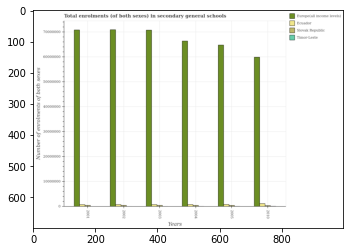

Number of QA =  30





,Years,Timor-Leste,Europe(all income levels),Slovak Republic,Ecuador
0,2002,NaN,7.152811e+07,NaN,9.884341e+05
1,2005,NaN,6.506517e+07,NaN,9.914279e+05
2,2010,NaN,6.026521e+07,NaN,1.378007e+06
3,2004,NaN,6.638334e+07,NaN,9.525241e+05
4,2001,NaN,7.146773e+07,NaN,9.561823e+05
5,2003,NaN,7.129635e+07,NaN,9.935587e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in slovak republic in 2003 and that in 2010 ?
PREDICTED =  71296351.24039239
EXPECTED =  96919.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in slovak republic in 2010 and the number of enrolments in secondary schools in timor-leste in 2003?
PREDICTED =  1.0
EXPECTED =  296207.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the number of enrolments in secondary schools in timor-leste and number of enrolments in secondary schools in 

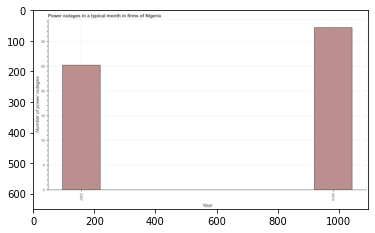

Number of QA =  19





,Year,Number of power outages
0,2014,33.002502
1,2007,25.514920


> what is the title of the graph ?
PREDICTED =  Power outages in a typical month in firms of Nigeria
EXPECTED =  Power outages in a typical month in firms of Nigeria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of power outages
EXPECTED =  Number of power outages




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of power outages in 2007 and 2014 ?
PREDICTED =  -7.487582822651923
EXPECTED =  -7.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of power outages ?
PREDICTED =  29.258711056921026
EXPECTED =  29.0




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gp

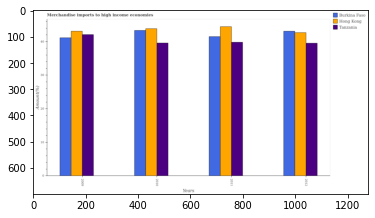

Number of QA =  29





,Years,Burkina Faso,Tanzania,Hong Kong
0,2010,43.503706,40.017248,44.189316
1,2011,41.916668,40.118778,44.823785
2,2012,43.377743,39.818656,42.903272
3,2009,41.400595,42.382138,43.296372


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in burkina faso in 2010 and that in 2011 ?
PREDICTED =  1.5870380322045037
EXPECTED =  1.8337055397317883




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in hong kong in 2010 and the percentage of amount earned from merchandise imports in tanzania in 2009?
PREDICTED =  1.8071783302652307
EXPECTED =  1.765638830506198




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of amount earned from merchandise impo

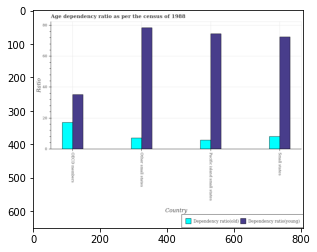

Number of QA =  28





,Country,Dependency ratio(young),Dependency ratio(old)
0,Other small states,79.184266,7.633406
1,Small states,73.296790,8.633442
2,Pacific island small states,75.143112,6.273653
3,OECD members,35.938129,17.752336


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in small states ?
PREDICTED =  73.2967899107485
EXPECTED =  72.5168818130676




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum age dependency ratio(old) ?
PREDICTED =  17.752335656170033
EXPECTED =  17.115331261806




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum age dependency ratio(old) ?
PREDICTED =  6.2736526008819995
EXPECTED =  5.68383963955301




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 4

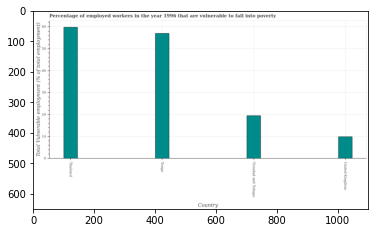

Number of QA =  22





,Country,Total Vulnerable employment (% of total employment)
0,United Kingdom,10.204638
1,Trinidad and Tobago,19.683534
2,Tonga,57.409732
3,Thailand,59.752510


> what is the title of the graph ?
PREDICTED =  Percentage of employed workers in the year 1996 that are vulnerable to fall into poverty
EXPECTED =  Percentage of employed workers in the year 1996 that are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total Vulnerable employment (% of total employment)
EXPECTED =  Total Vulnerable employment (% of total employment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total vulnerable employment in tonga and trinidad and tobago ?
PREDICTED =  37.72619836434449
EXPECTED =  37.5




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.



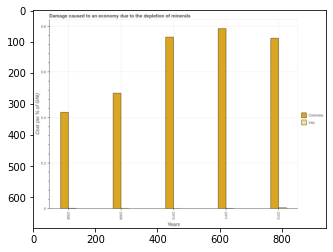

Number of QA =  28





,Years,Colombia,Iraq
0,2011,0.795360,NaN
1,2012,0.752375,NaN
2,2010,0.756783,NaN
3,2008,0.425389,NaN
4,2009,0.508012,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in colombia in 2008 and that in 2010 ?
PREDICTED =  -0.33139452627057764
EXPECTED =  -0.3304604473597729




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in iraq in 2008 and the cost of damage caused due to the depletion of minerals in colombia in 2009?
PREDICTED =  -0.5080118947159314
EXPECTED =  -0.5058838979314796




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predict

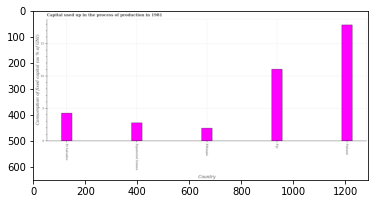

Number of QA =  22





,Country,Consumption of fixed capital (as % of GNI)
0,Finland,17.983447
1,Ethiopia,2.026047
2,Fiji,11.042598
3,Equatorial Guinea,2.849551
4,El Salvador,4.332101


> what is the title of the graph ?
PREDICTED =  Capital used up in the process of production in 1981
EXPECTED =  Capital used up in the process of production in 1981




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Consumption of fixed capital (as % of GNI)
EXPECTED =  Consumption of fixed capital (as % of GNI)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in fiji and finland ?
PREDICTED =  -6.9408493721536
EXPECTED =  -6.843




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median consumption of fixed capital ?
PREDICTED =  4.332100920259263
EXPECTED =  4.

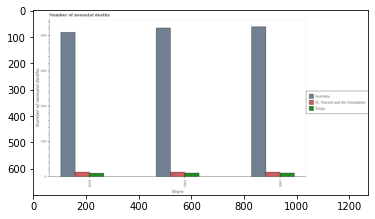

Number of QA =  29





,Years,Australia,St. Vincent and the Grenadines,Tonga
0,2004,818.761344,28.652099,21.865387
1,2005,846.961505,28.354109,23.369729
2,2006,846.349173,28.631510,23.838623


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in in tonga in 2005 and that in 2006 ?
PREDICTED =  22.36972939318121
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in in tonga in 2006 and the number of neonatal deaths in in st. vincent and the grenadines in 2004?
PREDICTED =  -2.0
EXPECTED =  -5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the number of neonatal deaths in in australia and number of neonatal deaths in in st. vincent and the grenadines ?
PREDICTED =  0.0
EXPECTED =  824




				 0 / 

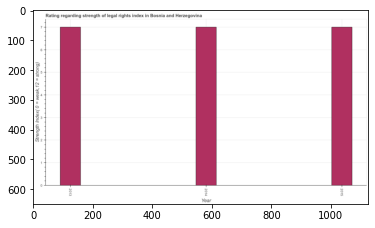

Number of QA =  23





,Year,"Strength Index( 0 = weak,12 = strong)"
0,2015,7.051337
1,2013,6.998594
2,2014,7.004672


> what is the title of the graph ?
PREDICTED =  Rating regarding strength of legal rights index in Bosnia and Herzegovina
EXPECTED =  Rating regarding strength of legal rights index in Bosnia and Herzegovina




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Strength Index( 0 = weak,12 = strong)
EXPECTED =  Strength Index( 0 = weak,12 = strong)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the strength of legal rights index in 2013 and 2014 ?
PREDICTED =  -0.006078544345653469
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the median strength of legal rights index ?
PREDICTED =  None
EXPECTED =  7.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalua

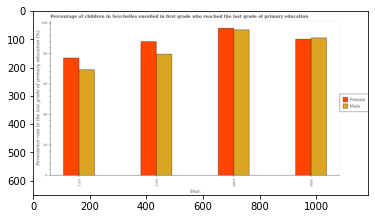

Number of QA =  28





,Year,Female,Male
0,1971,76.562712,69.586261
1,1972,87.590724,79.715846
2,1999,96.478510,95.694985
3,2000,89.272687,90.133277


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of male students in 1972 and that in 2000 ?
PREDICTED =  -10.417430750941705
EXPECTED =  -10.711943081054699




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of male students in 1999 and the persistence rate of female students in 2000?
PREDICTED =  5.561708139170065
EXPECTED =  5.273834228515597




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the persistence rate of female students and persistence rate of male students ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_

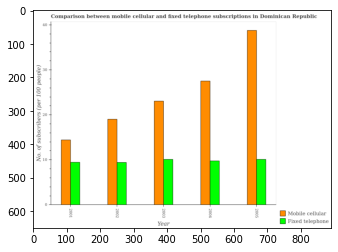

Number of QA =  28





,Year,Mobile cellular,Fixed telephone
0,2003,23.354406,10.205596
1,2002,19.178092,9.543329
2,2001,14.562520,9.569950
3,2004,27.687997,9.965852
4,2005,38.983073,10.228347


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers in 2004 and that in 2005 ?
PREDICTED =  -0.2624947011753438
EXPECTED =  -0.34486313053185036




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers in 2005 and the number of mobile cellular subscribers in 2001?
PREDICTED =  0.6583970156016861
EXPECTED =  0.64910537798165




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the number of fixed telephone subscribers and number of mobile cellular subscribers ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0

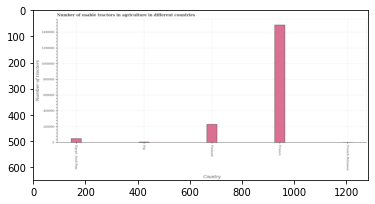

Number of QA =  22





,Country,Number of tractors
0,French Polynesia,NaN
1,Finland,2.333836e+05
2,France,1.479780e+06
3,"Egypt, Arab Rep.",5.375722e+04
4,Fiji,1.014812e+04


> what is the title of the graph ?
PREDICTED =  Number of usable tractors in agriculture in different countries
EXPECTED =  Number of usable tractors in agriculture in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of tractors
EXPECTED =  Number of tractors




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tractors in france and french polynesia ?
PREDICTED =  0.0
EXPECTED =  1491260.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tractors ?
PREDICTED =  143570.38883250783
EXPECTED =  48500.0




				 3 / 5 = 0.6


is_built_with_

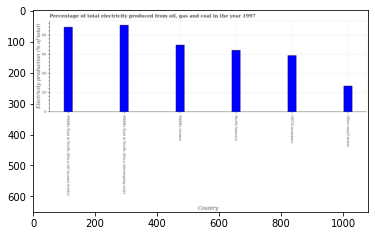

Number of QA =  22





,Country,Electricity production (% of total)
0,North America,64.226101
1,Middle income,69.587359
2,OECD members,58.668606
3,Other small states,27.137922
4,Middle East & North Africa (developing only),90.727345
5,Middle East & North Africa (all income levels),88.438273


> what is the title of the graph ?
PREDICTED =  Percentage of total electricity produced from oil, gas and coal in the year 1997
EXPECTED =  Percentage of total electricity produced from oil, gas and coal in the year 1997




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Electricity production (% of total)
EXPECTED =  Electricity production (% of total)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in middle east & north africa (all income levels) and middle east & north africa (developing only) ?
PREDICTED =  -2.2890714430004806
EXPECTED =  -2.046




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after 

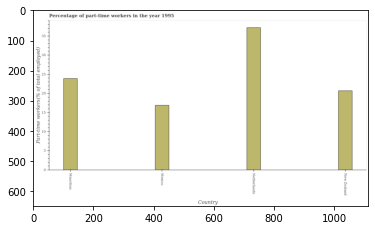

Number of QA =  22





,Country,Part-time workers(% of total employed)
0,Mauritius,24.258265
1,Mexico,17.314194
2,New Zealand,20.973414
3,Netherlands,37.551661


> what is the title of the graph ?
PREDICTED =  Percentage of part-time workers in the year 1995
EXPECTED =  Percentage of part-time workers in the year 1995




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time workers(% of total employed)
EXPECTED =  Part-time workers(% of total employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in mexico and netherlands ?
PREDICTED =  -20.237467118378557
EXPECTED =  -20.3




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  22.615839728105286
EXPECTED =  22.

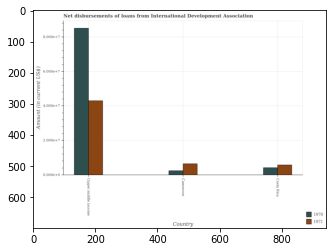

Number of QA =  28





,Country,1971,1970
0,Upper middle income,4.336180,8.501261
1,Costa Rica,0.614055,0.441797
2,Cameroon,0.677345,0.270044


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 in costa rica and that in upper middle income ?
PREDICTED =  -3.722125091934104
EXPECTED =  -37254000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1970 in cameroon and the amount of loans disbursed in 1971 in costa rica?
PREDICTED =  -0.17175303446087975
EXPECTED =  -3348000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed of/in 1971 and amount of loans disbursed of/in 1970 in cameroon?
PREDICTED =  2.729956029633798
EXPECTED =  4023000.0




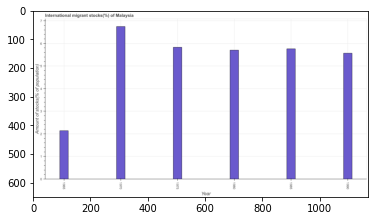

Number of QA =  23





,Year,Amount of stocks(% of population)
0,1970,6.716371
1,1965,2.149515
2,1985,5.751419
3,1975,5.830839
4,1990,5.550416
5,1980,5.692549


> what is the title of the graph ?
PREDICTED =  International migrant stocks(%) of Malaysia
EXPECTED =  International migrant stocks(%) of Malaysia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of stocks(% of population)
EXPECTED =  Amount of stocks(% of population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of international migrant stocks in 1975 and 1985 ?
PREDICTED =  0.07941967170533992
EXPECTED =  0.069




				 3 / 4 = 0.75


> what is the median number of international migrant stocks ?
PREDICTED =  None
EXPECTED =  5.733363880732465




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.



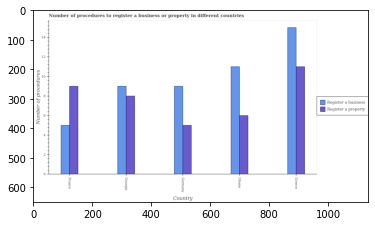

Number of QA =  28





,Country,Register a property,Register a business
0,Germany,5.059133,9.038813
1,Greece,11.009730,15.090352
2,NaN,9.094183,5.046181
3,Georgia,8.026532,9.019889
4,Ghana,6.034704,10.995056


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a property in france and that in germany ?
PREDICTED =  0.0
EXPECTED =  4.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a business in ghana and the number of procedures to register a property in germany?
PREDICTED =  0.0
EXPECTED =  6.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a property and number of procedures to register a business in germany ?
PREDICTED =  4.0
EXPECTED =  -4.0




				 0 / 3 = 0.0


is_built_with_cuda: Tru

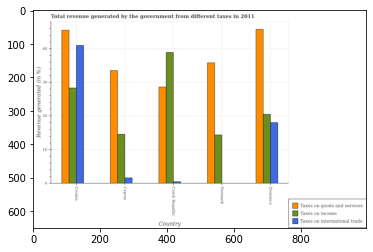

Number of QA =  29





,Country,Taxes on international trade,Taxes on income,Taxes on goods and services
0,Denmark,NaN,14.504497,36.138665
1,Croatia,41.255669,28.877060,45.660608
2,Cyprus,1.711285,14.740036,33.803489
3,Dominica,18.142213,20.741379,46.515269
4,Czech Republic,NaN,38.864817,28.699288


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on income in czech republic and that in denmark ?
PREDICTED =  24.360319672268766
EXPECTED =  24.5067104952033




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in dominica and the percentage of revenue generated by tax on international trade in czech republic?
PREDICTED =  18.12343800320832
EXPECTED =  45.27516240711697




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by tax on international trade and p

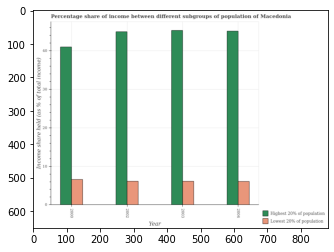

Number of QA =  28





,Year,Lowest 20% of population,Highest 20% of population
0,2002,6.237986,44.870605
1,2000,6.747049,40.999555
2,2004,6.236242,45.052109
3,2003,6.274110,45.389034


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in 2000 and that in 2004 ?
PREDICTED =  34.76331321729418
EXPECTED =  0.5099999999999998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in 2002 and the income share held by highest 20% of the population in 2003?
PREDICTED =  -0.036123770440412706
EXPECTED =  0.009999999999999787




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the income share held by lowest 20% of the population and income share held by highest 20% of the

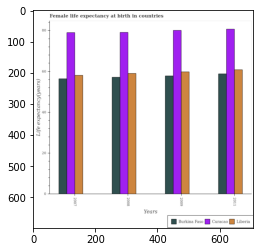

Number of QA =  29





,Years,Curacao,Burkina Faso,Liberia
0,2007,78.883333,56.649113,57.811668
1,2009,79.921385,57.939524,59.827555
2,2008,78.270389,57.426557,59.039431
3,2011,80.439967,58.294386,60.816009


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in burkina faso in 2007 and that in 2009 ?
PREDICTED =  -1.2904112157676906
EXPECTED =  -1.4130000000000038




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in curacao in 2007 and the female life expectancy at birth in burkina faso in 2009?
PREDICTED =  -1.0380523425476298
EXPECTED =  21.192999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the female life expectancy at birth in liberia and female life expectancy at birth in burkina faso ?
PREDICTED

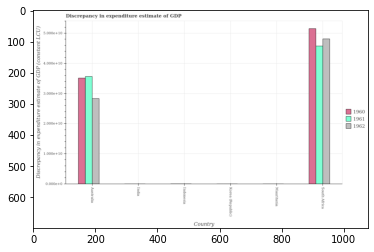

Number of QA =  21





,Country,1962,1961,1960
0,Indonesia,NaN,NaN,NaN
1,M auritania,NaN,NaN,NaN
2,Australia,2.837804,3.590077,3.527149
3,Korea (Republic),NaN,NaN,NaN
4,India,NaN,NaN,NaN
5,South Africa,4.808719,4.615302,5.155856


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in 1962 in mauritania and the discrepancy in expenditure estimate of gdp in 1961 in south africa?
PREDICTED =  0.0
EXPECTED =  -45757735100.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp of/in 1961 and discrepancy in expenditure estimate of gdp of/in 1960 in south africa?
PREDICTED =  0.0
EXPECTED =  -5776721700.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the discrepancy in expenditure estimate of gdp in 1961 in australia to that in south africa?
PREDICTE

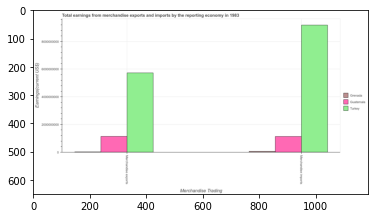

Number of QA =  23





,Merchandise Trading,Unnamed: 1,Guatemala
0,Merchandise imports,9.293143e+09,1.204573e+09
1,Merchandise exports,5.810734e+09,1.205096e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Eamings(current US$)
EXPECTED =  2000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Total earnings from merchandise exports and imports by the reporting economy in 1983
EXPECTED =  Total earnings from merchandise exports and imports by the reporting economy in 

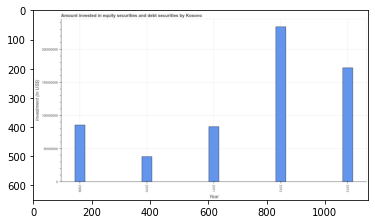

Number of QA =  23





,Year,Investment (in US$)
0,2010,3.902025e+07
1,2011,8.398024e+07
2,2009,8.726896e+07
3,2013,1.741747e+08
4,2012,2.366049e+08


> what is the title of the graph ?
PREDICTED =  Amount invested in equity securities and debt securities by Kosovo
EXPECTED =  Amount invested in equity securities and debt securities by Kosovo




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Investment (in US$)
EXPECTED =  Investment (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the portfolio investment in 2009 and 2012 ?
PREDICTED =  -149335914.9840187
EXPECTED =  -148374881.15




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median portfolio investment ?
PREDICTED =  87268963.56578767
EXPECTED =  85625761.85




				 5 / 5 = 1.0


i

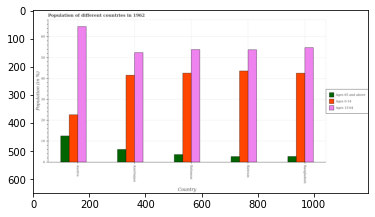

Number of QA =  29





,Country,Ages 65 and above,Ages 0-14,Ages 15-64
0,Austra,12.519931,22.928328,64.502578
1,Bangladesh,2.872362,42.394236,54.207242
2,Bahrain,2.869451,43.452625,53.124453
3,NaN,6.284600,41.487546,51.692924
4,Bahamas,3.799091,42.383072,53.345367


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group of 65 and above in austria and that in bahrain ?
PREDICTED =  0.0
EXPECTED =  9.88830849075873




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 in bangladesh and the percentage of population within the age-group 15-64 in bahamas?
PREDICTED =  0.011164018083142935
EXPECTED =  -11.289835448721497




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 and percentage of population within the age-group

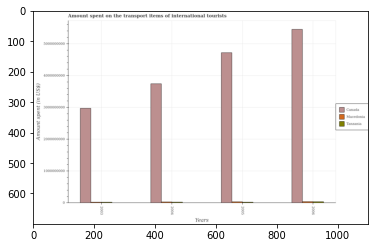

Number of QA =  29





,Years,Tanzania,Macedonia,Canada
0,2004,NaN,NaN,3.763555e+09
1,2006,5.406794e+07,NaN,5.481453e+09
2,2003,NaN,NaN,2.996829e+09
3,2005,NaN,5.188513e+07,4.724672e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in macedonia in 2003 and that in 2005 ?
PREDICTED =  0.0
EXPECTED =  -12000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in macedonia in 2005 and the amount spent on the transport items of international tourists in canada in 2006?
PREDICTED =  0.0
EXPECTED =  -5417000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the amount spent on the transport items of international tourists in tan

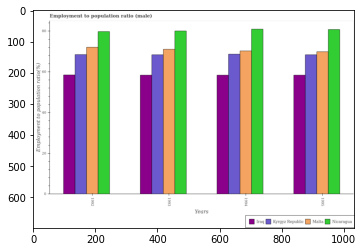

Number of QA =  30





,Years,Kyrgyz Republic,Malta,Nicaragua,Iraq
0,1992,68.510659,72.471429,80.143293,58.659400
1,1993,68.570374,71.536969,80.280385,58.693162
2,1995,68.712167,69.986070,80.941837,58.606509
3,1994,69.139212,70.310853,81.172524,58.493802


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in malta in 1995 ?
PREDICTED =  28.505672816780418
EXPECTED =  69.90000152587889




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in nicaragua ?
PREDICTED =  24.577281959866546
EXPECTED =  81.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in kyrgyz republic ?
PREDICTED =  29.07576754035819
EXPECTED =  68.40000152587889




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

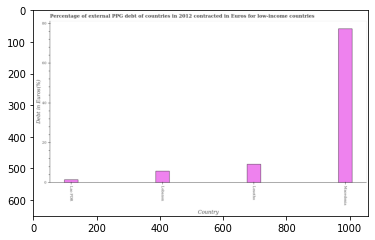

Number of QA =  22





,Country,Debt in Euros(%)
0,Lesotho,9.453310
1,Macedonia,77.820717
2,Lebanon,5.980814
3,Lao PDR,1.680237


> what is the title of the graph ?
PREDICTED =  Percentage of external PPG debt of countries in 2012 contracted in Euros for low-income countries
EXPECTED =  Percentage of external PPG debt of countries in 2012 contracted in Euros for low-income countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt in Euros(%)
EXPECTED =  Debt in Euros(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the currency composition of ppg debt in lebanon and macedonia ?
PREDICTED =  -71.83990250210837
EXPECTED =  -71.569




				 4 / 4 = 1.0


> what is the median currency composition of ppg debt ?
PREDICTED =  None
EXPECTED =  7.4444




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

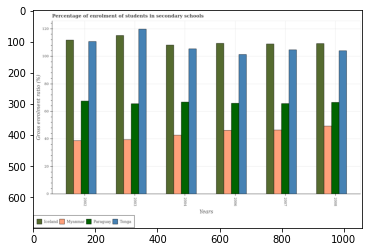

Number of QA =  30





,Years,Iceland,Myanmar,Tonga,Paraguay
0,2003,116.367965,39.812091,120.946735,66.107133
1,2002,112.558026,39.041120,111.315928,68.242849
2,2007,110.089079,46.289846,104.461143,66.254033
3,2008,110.212042,49.787538,104.849296,67.295887
4,2006,110.610743,46.674437,102.321924,66.523126
5,2004,109.108134,43.019106,105.509671,67.707307


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in secondary schools in myanmar in 2004 and that in 2006 ?
PREDICTED =  -3.6553311907156285
EXPECTED =  -3.491119384765689




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in secondary schools in myanmar in 2008 and the percentage of students enrolled in secondary schools in paraguay in 2004?
PREDICTED =  6.768432118382059
EXPECTED =  -17.44469070434569




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of students enrolled in secondary schools in

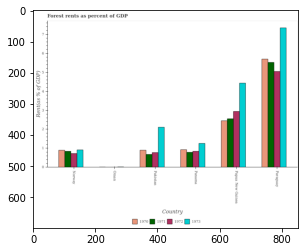

Number of QA =  30





,Country,1972,1971,1970,1973
0,Oman,NaN,NaN,NaN,NaN
1,Papua New Guinea,2.947350,2.560561,2.443184,4.426142
2,Paraguay,5.034422,5.518388,5.688676,7.314505
3,Norway,0.752129,0.854290,0.916764,0.927917
4,Pakistan,0.789755,0.695388,0.911594,2.131835
5,Panama,0.863135,0.809629,0.933249,1.275480


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in 1972 in oman and that in pakistan ?
PREDICTED =  -0.7897545320418593
EXPECTED =  -0.7636174242837046




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in 1970 in oman and the forest rent in 1973 in pakistan?
PREDICTED =  -0.9115942342111452
EXPECTED =  -2.0969211822980234




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent of/in 1970 and forest rent of/in 1972 in norway?
PREDICTED =  4.93654681965482
EXPECTED =  0.1748753540069251




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fal

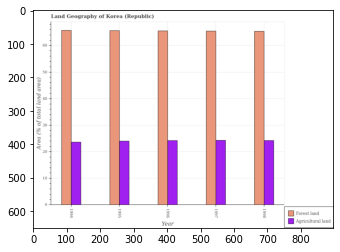

Number of QA =  28





,Year,Agricultural land,Forest land
0,1994,23.612170,65.467184
1,1998,24.250335,65.269405
2,1997,24.325892,65.282100
3,1995,23.905690,65.490181
4,1996,24.256331,65.280737


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in 1996 and that in 1998 ?
PREDICTED =  0.005996056932506377
EXPECTED =  -0.010366991499097367




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in 1995 and the percentage of land area under agriculture in 1996?
PREDICTED =  0.20944395229307133
EXPECTED =  0.08500933029228008




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of land area under agriculture and percentage of land area under forests ?
PREDICTED =  -40.9989645609407
EX

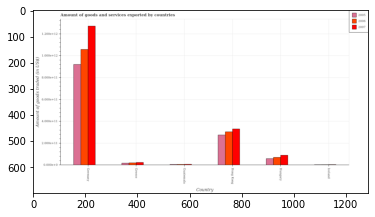

Number of QA =  29





,Country,2007,2005,2006
0,Iceland,NaN,NaN,NaN
1,Greece,0.027355,0.021342,0.023426
2,Guatemala,NaN,NaN,NaN
3,Germany,1.287812,0.928290,1.070846
4,Hong Kong,0.334246,0.280958,0.311263
5,Hungary,0.093893,0.063331,0.074311


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services exported in 2005 in guatemala and that in hungary ?
PREDICTED =  3.0
EXPECTED =  -53186621095.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services exported in 2007 in greece and the total amount of goods and services exported in 2006 in hong kong?
PREDICTED =  2.0
EXPECTED =  -280162058837.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services exported of/in 2006 and total amount of goods and services exported of/in 2007 in guatemala?
PRED

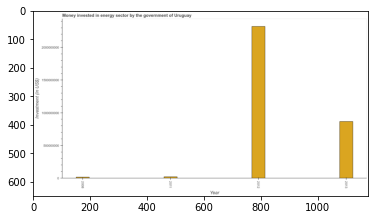

Number of QA =  23





,Year,Investment (in US$)
0,2011,2.930384e+07
1,2012,2.329776e+09
2,2013,8.772457e+08
3,2008,2.253473e+07


> what is the title of the graph ?
PREDICTED =  Money invested in energy sector by the government of Uruguay
EXPECTED =  Money invested in energy sector by the government of Uruguay




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Investment (in US$)
EXPECTED =  Investment (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in energy in 2008 and 2011 ?
PREDICTED =  -6769117.78724692
EXPECTED =  -5000000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median investment in energy ?
PREDICTED =  453274787.9238516
EXPECTED =  443100000.0




				 4 / 5 = 0.8


is_built_with_cu

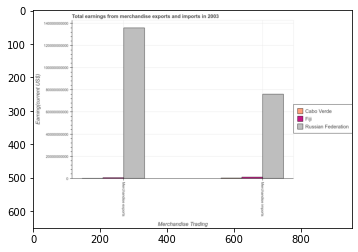

Number of QA =  23





,Merchandise Trading,Fiji,Cabo Verde,Russian Federation
0,Merchandise imports,NaN,NaN,7.712733e+10
1,Merchandise exports,NaN,NaN,1.366883e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in cabo verde and that in russian federation ?
PREDICTED =  0.5
EXPECTED =  -135916258000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports and earnings from merchandise imports in russian federation ?
PREDICTED =  1.0
EXPECTED =  59859000000




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: Fa

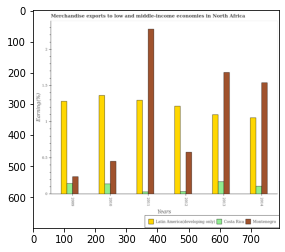

Number of QA =  29





,Years,Costa Rica,Latin America(developing only,Montenegro
0,2009,0.150777,1.290940,0.246859
1,2012,0.042612,1.223234,0.582981
2,2014,0.114988,1.065073,1.538606
3,2013,0.177037,1.102680,1.694334
4,2010,0.147384,1.376340,0.459961
5,2011,0.037075,1.302966,2.289105


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in latin america(developing only) in 2009 and that in 2012 ?
PREDICTED =  0.06770688895266552
EXPECTED =  0.06738341904615996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in montenegro in 2009 and the percentage of amount earned from merchandise exports in latin america(developing only) in 2012?
PREDICTED =  -2.042246216567992
EXPECTED =  -0.9739804260586309




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the perc

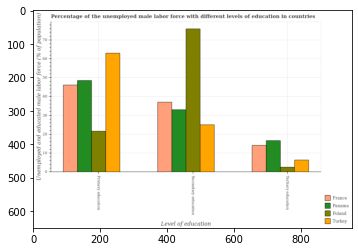

Number of QA =  28





,Level of education,France,Turkey,Panama,Poland
0,Primary education,46.589994,63.206170,48.940816,22.159471
1,Tertiary education,14.522329,6.734531,16.960167,2.908009
2,Secondary education,37.370511,25.303172,33.353437,76.471294


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received primary education in poland and that in france ?
PREDICTED =  -24.43052328293409
EXPECTED =  -24.49999809265141




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in poland and the percentage of male labor force who received secondary education in turkey?
PREDICTED =  -3.82652124516908
EXPECTED =  -22.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received primary education and percentage of mal

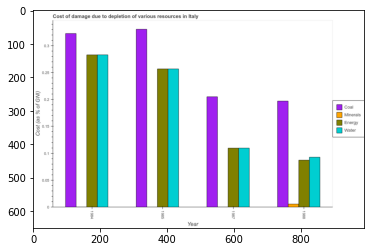

Number of QA =  30





,Year,Water,Coal,Energy,Minerals
0,1988,0.094692,0.198931,0.088675,0.006801
1,1985,0.259324,0.333909,0.259105,NaN
2,1987,0.110817,0.206977,0.110453,NaN
3,1984,0.285323,0.326513,0.285684,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of water in 1985 and that in 1988 ?
PREDICTED =  0.1646317843850103
EXPECTED =  0.1641287246505994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of water in 1984 and the cost of damage due to depletion of energy in 1987?
PREDICTED =  0.17450646307479967
EXPECTED =  0.17340087408082902




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the cost of damage due to depletion of water and cost of damage due to depletion of minerals ?
PREDICTED =  -0.714676618923236

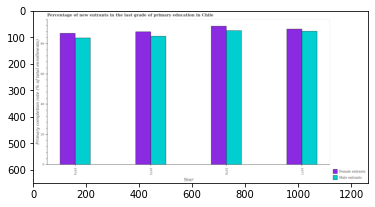

Number of QA =  28





,Year,Male entrants,Female entrants
0,1976,88.395340,92.151976
1,1974,83.949554,86.924129
2,1975,84.775958,87.910021
3,1977,88.315717,90.207710


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in 1974 and that in 1975 ?
PREDICTED =  -0.8264040954510676
EXPECTED =  -1.11712




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in 1974 and the primary completion rate of female entrants in 1977?
PREDICTED =  -4.366163706902242
EXPECTED =  -4.430630000000022




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the primary completion rate of male entrants and primary completion rate of female entrants ?
PREDICTED =  0.0
EXPECTED =  0.0




				 

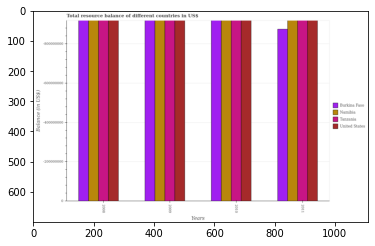

Number of QA =  17





,Years,Burkina Fasa,Tanzania,Namibia,United States
0,2010,9.343348e+08,9.358291e+08,9.401662e+08,9.334261e+08
1,2011,8.847353e+08,9.290556e+08,9.336580e+08,9.340892e+08
2,2009,9.308696e+08,9.293823e+08,9.395234e+08,9.277180e+08
3,2008,9.289122e+08,9.361907e+08,9.364772e+08,9.341825e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in burkina faso in 2008 and the total resource balance in namibia in 2009?
PREDICTED =  -10611173.159725547
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Balance (in US$)
EXPECTED =  200000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Total resource balance of different countries in US$
EXPECTED =  Total resource balance of different countries in US$




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Years
EXPECTED =  Years




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Balance (in US$)
EXPECTED =  Balance (in US$)




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

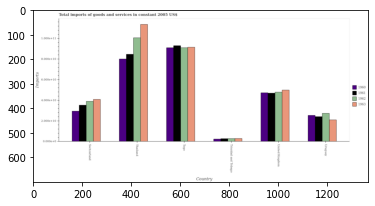

Number of QA =  30





,Country,1963,1962,1961,1960
0,Uruguay,7.414720,9.697155,8.555352,9.033933
1,Thailand,39.753207,35.443432,29.858351,28.140396
2,Trinidad and Tobago,1.116032,1.100378,1.040179,0.940083
3,United Kingdom,17.561029,16.978428,16.499974,16.633790
4,Switzerland,14.412240,13.711825,12.584680,10.368832
5,Togo,31.855407,31.798961,32.605456,32.016562


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1962 in switzerland and that in thailand ?
PREDICTED =  -43.1552567826396
EXPECTED =  -61738444570.1777




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1960 in trinidad and tobago and the total imports of goods and services in 1962 in uruguay?
PREDICTED =  -3.9740164386036696
EXPECTED =  -24984366600.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services of/in 1962 and total imports of goods and services of/in 1963 in thailand?

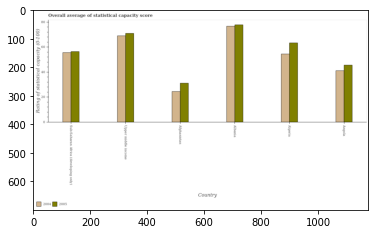

Number of QA =  28





,Country,2005,2004
0,Albania,78.985410,77.567734
1,Algeria,64.422103,55.472297
2,Angola,46.393256,42.100178
3,Upper middle income,71.776953,70.050152
4,Afghanistan,31.631624,25.137509
5,Sub-Saharan Africa (developing only),57.517109,56.502767


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 in algeria and that in angola ?
PREDICTED =  18.02884716034736
EXPECTED =  17.7777777777777




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 in albania and the rating of statistical capacity in 2004 in sub-saharan africa (developing only)?
PREDICTED =  21.4683001409068
EXPECTED =  22.195767301587303




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity of/in 2004 and rating of statistical capacity of/in 2005 in upper middle income?
PR

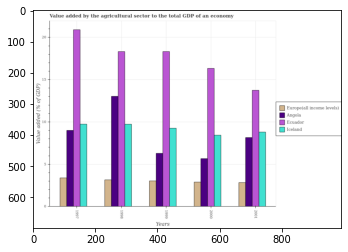

Number of QA =  30





,Years,Iceland,Europe(all income levels),Angola,Ecuador
0,1999,9.346954,3.055351,6.340453,18.162086
1,1997,9.818178,3.436143,9.042176,20.919164
2,2001,8.826086,2.857866,8.194757,13.763120
3,2000,8.528262,2.947035,5.761921,16.373162
4,1998,9.814913,3.196269,13.078122,18.166033


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in angola in 1998 and that in 1999 ?
PREDICTED =  6.737668306636792
EXPECTED =  6.74350145241418




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector to the total gdp in angola in 1997 and the value added by the agricultural sector to the total gdp in iceland in 1999?
PREDICTED =  2.7017225209125755
EXPECTED =  -0.2579899208456098




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the value added by the agricultural sector to the total

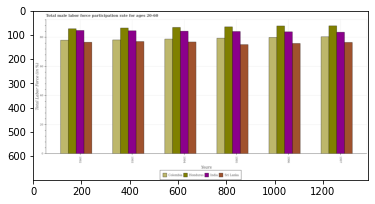

Number of QA =  30





,Years,Colombia,India,Sri Lanka,Honduras
0,1996,79.985351,83.020600,75.915917,87.889822
1,1994,79.049875,84.068499,76.696614,87.027859
2,1993,78.519441,84.761809,77.057355,86.670272
3,1995,79.812107,83.504143,74.854298,87.191260
4,1992,78.214096,84.715279,76.724838,86.284627
5,1997,80.594484,83.273090,76.634095,87.724403


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in colombia in 1994 and that in 1995 ?
PREDICTED =  -0.7622316001104394
EXPECTED =  -0.599998474121108




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in colombia in 1997 and the male labor force participation rate in india in 1996?
PREDICTED =  0.6091327100540269
EXPECTED =  -3.400001525878892




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the male labor force participation rate in honduras and male labor force participation rate in sri lanka ?
PRE

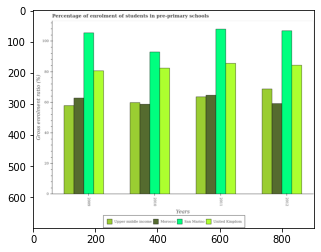

Number of QA =  30





,Years,United Kingdom,San Marinc,Upper middle income,Morocco
0,2012,84.346439,107.766484,68.386548,58.995277
1,2010,82.415692,92.952901,59.902681,58.535953
2,2011,85.633572,107.418883,63.646826,64.726211
3,2009,80.605896,104.899281,57.915219,62.668011


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in pre-primary schools in upper middle income in 2009 and that in 2012 ?
PREDICTED =  -10.471329569537232
EXPECTED =  -10.872421264648402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in pre-primary schools in upper middle income in 2011 and the percentage of students enrolled in pre-primary schools in san marino in 2010?
PREDICTED =  3.744145210358795
EXPECTED =  -29.320095062255817




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPU

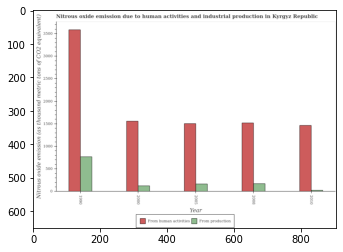

Number of QA =  28





,Year,From human activities,From production
0,2010,1470.757512,NaN
1,1990,3598.344512,783.787252
2,2008,1533.731632,183.404730
3,2000,1570.192882,134.468601
4,2005,1521.751409,178.040159


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions from human activities in 2008 and that in 2010 ?
PREDICTED =  62.974119778460135
EXPECTED =  54.299999999999955




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions generated from industries in 2000 and the amount of emissions from human activities in 2010?
PREDICTED =  -1336.2889112892797
EXPECTED =  98.30000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of emissions generated from industries and amount of emissions from human activities ?
PREDICTED =  -8415.07720

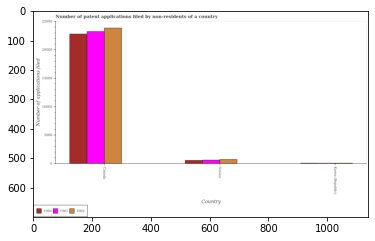

Number of QA =  29





,Country,1962,1961,1960
0,Korea (Republic),NaN,NaN,NaN
1,Greece,850.078707,749.760871,689.162763
2,Canada,24061.639486,23403.666879,23066.117859


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of applications filed in 1960 in canada and that in greece ?
PREDICTED =  -688.1627634813801
EXPECTED =  22235.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of applications filed in 1962 in canada and the number of applications filed in 1960 in korea (republic)?
PREDICTED =  0.0
EXPECTED =  23768.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of applications filed of/in 1962 and number of applications filed of/in 1961 in canada?
PREDICTED =  -23401.666878546494
EXPECTED =  615.0




				 0 / 3 = 0.0


is_bu

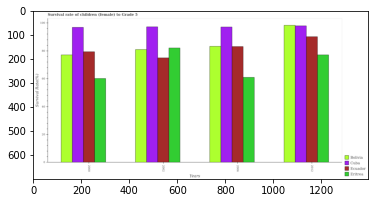

Number of QA =  30





,Years,Bolivia,Cuba,Eritrea,Ecuador
0,2002,80.956175,97.012415,82.024158,74.950320
1,2006,83.235080,97.300734,60.740281,82.993548
2,2000,76.931588,96.726825,59.960853,79.250174
3,2012,98.084801,97.291998,77.103820,90.189054


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female children to grade 5 in eritrea in 2002 and that in 2006 ?
PREDICTED =  21.28387639125149
EXPECTED =  21.102283477783203




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female children to grade 5 in bolivia in 2000 and the survival rate of female children to grade 5 in ecuador in 2006?
PREDICTED =  -6.303491170821317
EXPECTED =  -6.010848999023409




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the survival rate of female children to grade 5 in bolivia and survival rate of female c

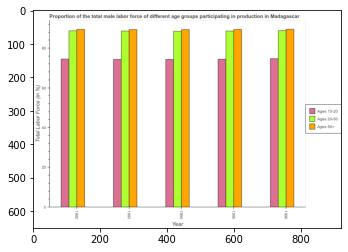

Number of QA =  29





,Year,Ages 20-50,Ages 50+,Ages 15-20
0,1996,88.961382,89.916522,75.227520
1,1995,88.763814,89.755204,74.694993
2,1992,88.933904,89.675818,74.671085
3,1994,88.647723,89.557315,74.593739
4,1993,88.833641,89.550377,74.522680


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 20-50 in 1994 and that in 1996 ?
PREDICTED =  -0.31365894246319215
EXPECTED =  -0.3000030517577983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the percentage of male labor force within the age group 15-20 and percentage of male labor force within the age group 20-50 ?
PREDICTED =  -88.64772262435085
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

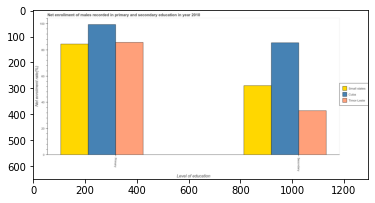

Number of QA =  23





,Level of education,Timor-Leste,Small states,Cuba
0,NaN,86.938942,85.379340,99.101599
1,Secondary,33.924426,53.014098,86.537228


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in small states and that in cuba ?
PREDICTED =  51.85621015559114
EXPECTED =  -14.884872436523409




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in timor-leste and the enrollment rate in primary education in small states?
PREDICTED =  -19.089671616682068
EXPECTED =  -50.852787017822294




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education and enrollment rate in primary education in timor-leste ?
PREDICTED =  19.089671616682068

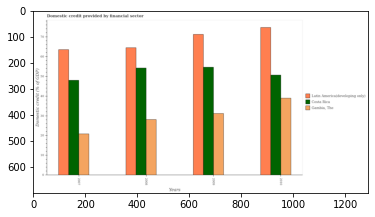

Number of QA =  29





,Years,Latin America(developing only),"Gambia, The",Costa Rica
0,2008,64.493773,28.250401,54.269984
1,2007,63.796620,21.080820,47.992341
2,2009,71.025289,31.237685,54.635144
3,2010,74.865787,39.063390,50.389539


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit in latin america(developing only) in 2008 and that in 2010 ?
PREDICTED =  -10.372013549536774
EXPECTED =  -10.24585714350681




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit in costa rica in 2008 and the domestic credit in latin america(developing only) in 2009?
PREDICTED =  -0.3651599557976226
EXPECTED =  -17.014622866753598




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the domestic credit in gambia, the and domestic credit in costa rica ?
PREDICTED =  -1.3296112255326697
EXPECTED =  -26

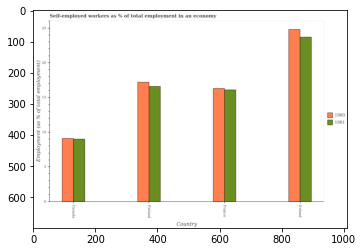

Number of QA =  28





,Country,1980,1981
0,France,16.412200,16.284192
1,Ireland,25.079786,23.909599
2,Canada,9.255743,9.184441
3,Finland,17.452214,16.768442


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1980 in canada and that in ireland ?
PREDICTED =  -15.824043014135638
EXPECTED =  -15.69999885559077




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1980 in ireland and the percentage of self-employed workers in 1981 in finland?
PREDICTED =  7.627572467325194
EXPECTED =  8.199998855590799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers of/in 1980 and percentage of self-employed workers of/in 1981 in canada?
PREDICTED =  0.

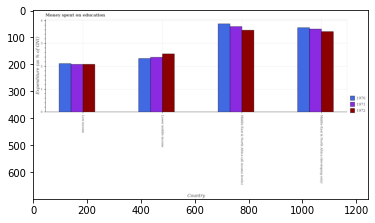

Number of QA =  29





,Country,1972,1971,1970
0,Lower middle income,2.593580,2.441987,2.373920
1,Low income,2.125639,2.128410,2.167154
2,Middle East & North Africa (all income levels),3.633205,3.787880,3.925141
3,Middle East & North Afmica (developing only),3.568738,3.711718,3.752272


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of money spent on education in 1972 in low income and that in middle east & north africa (developing only) ?
PREDICTED =  -1.4430993471580376
EXPECTED =  -1.4321210065910601




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of money spent on education in 1972 in low income and the amount of money spent on education in 1971 in lower middle income?
PREDICTED =  -2.5935797253498682
EXPECTED =  -0.3073542106193501




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of money spent on education of/in 1971 and amount of money 

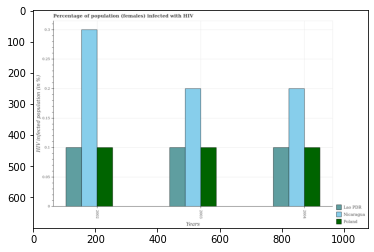

Number of QA =  29





,Years,Poland,Nicaragua,Lao PDR
0,2003,0.101883,0.202821,0.101875
1,2002,0.102093,0.304230,0.102125
2,2004,0.101609,0.202371,0.101946


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in nicaragua in 2002 and that in 2003 ?
PREDICTED =  0.10140897298859064
EXPECTED =  0.09999999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in nicaragua in 2003 and the percentage of hiv infected female population in lao pdr in 2004?
PREDICTED =  0.0004504838468551431
EXPECTED =  0.1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of hiv infected female population in lao pdr and percentage of hiv infected

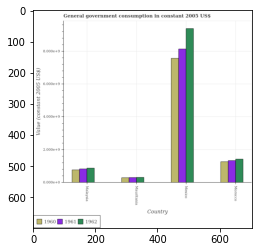

Number of QA =  29





,Country,1962,1961,1960
0,Morocco,1.463785,1.380910,1.306996
1,Mexico,9.482123,8.062344,7.646103
2,Mauritania,0.350654,0.336321,0.329520
3,Malaysia,0.923910,0.871523,0.806227


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in 1961 in mauritania and that in mexico ?
PREDICTED =  -7.726023515698134
EXPECTED =  -7834099903.597235




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in 1962 in morocco and the government conusmption in 1961 in mauritania?
PREDICTED =  1.1131308417034542
EXPECTED =  1122031541.797045




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the government co

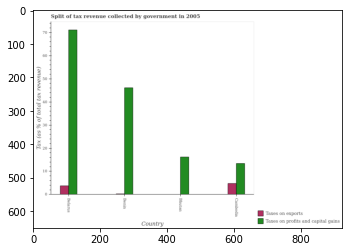

Number of QA =  28





,Country,Taxes on profits and capital gains,Taxes on exports
0,Bhutan,16.198903,NaN
1,Benin,46.277715,NaN
2,Belarus,71.039840,3.781533
3,Cambodia,13.407045,4.810346


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capital gains in belarus and that in cambodia ?
PREDICTED =  -57.63279497499765
EXPECTED =  57.729555833702904




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capital gains in cambodia and the percentage of revenue obtained from taxes on exports in belarus?
PREDICTED =  9.625512062557961
EXPECTED =  9.6566593167448




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capi

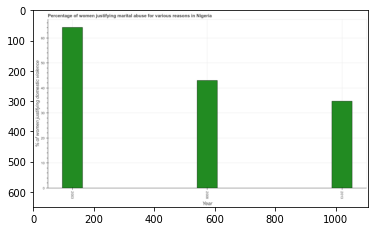

Number of QA =  23





,Year,% of women justifying domestic violence
0,2003,65.019061
1,2008,43.246285
2,2013,35.161054


> what is the title of the graph ?
PREDICTED =  Percentage of women justifying marital abuse for various reasons in Nigeria
EXPECTED =  Percentage of women justifying marital abuse for various reasons in Nigeria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of women justifying domestic violence
EXPECTED =  % of women justifying domestic violence




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying marital abuse in 2003 and 2013 ?
PREDICTED =  29.85800648578777
EXPECTED =  29.5




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of women justifying

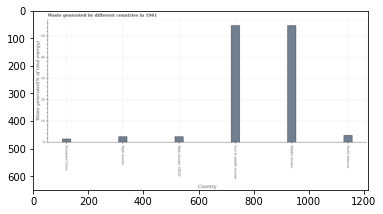

Number of QA =  22





,Country,Waste generated(% of total energy)
0,Low & middle income,54.985190
1,High income: OECD,2.816505
2,North America,3.429412
3,European Union,1.765238
4,Middle income,54.998260
5,High income,2.828075


> what is the title of the graph ?
PREDICTED =  Waste generated by different countries in 1961
EXPECTED =  Waste generated by different countries in 1961




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Waste generated(% of total energy)
EXPECTED =  Waste generated(% of total energy)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of waste generated in european union and low & middle income ?
PREDICTED =  -53.21995201460337
EXPECTED =  -53.279




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

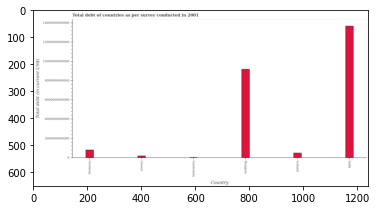

Number of QA =  22





,Country,Total debt (in current US$)
0,Greece,2.384027e+11
1,Iceland,5.324267e+11
2,Guatemala,8.925376e+10
3,Hungary,9.272899e+12
4,Germany,8.581965e+11
5,India,1.377733e+13


> what is the title of the graph ?
PREDICTED =  Total debt of countries as per survey conducted in 2001
EXPECTED =  Total debt of countries as per survey conducted in 2001




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total debt (in current US$)
EXPECTED =  Total debt (in current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in germany and hungary ?
PREDICTED =  -8414702544135.702
EXPECTED =  -8378605000000.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total debt ?
PREDICTED =  695311616750.1821
EXPECTED =  641764256055.5




				 4 / 5 = 0.8


is_built_

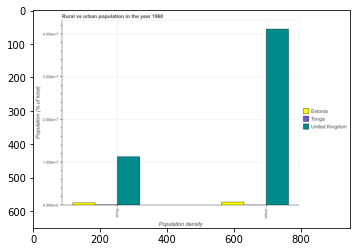

Number of QA =  23





,Population density,Estonia,United Kingdom,Tonga
0,Rural,0.066386,1.142213,NaN
1,Urban,0.085466,4.145376,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population density in estonia and the urban population density in united kingdom?
PREDICTED =  -4.078990043706149
EXPECTED =  -40590153




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Population (% of total)
EXPECTED =  10000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTE

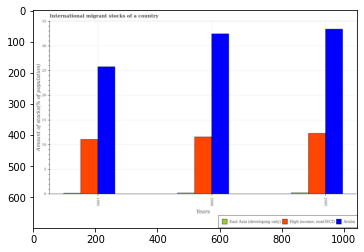

Number of QA =  29





,Years,East Asia (developing only),Aruba,High income: nonOECD
0,2000,NaN,32.896618,11.614849
1,2005,NaN,33.614703,12.420911
2,1995,NaN,26.136353,11.200298


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in aruba in 2000 and that in 2005 ?
PREDICTED =  -0.7180854465324913
EXPECTED =  -0.9488983286959041




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of stocks in in east asia (developing only) and amount of stocks in in aruba ?
PREDICTED =  -2.0
EXPECTED =  -33.161513945309444




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of stocks in in ea

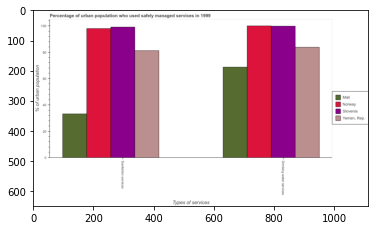

Number of QA =  23





,Types of services,Slovenia,Mali,"Yemen, Rep.",Norway
0,Samtation services,99.177748,33.345179,80.589232,97.721494
1,Drinking water services,99.838138,68.500415,83.594696,99.697117


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used drinking water services in norway and that in yemen, rep. ?
PREDICTED =  16.10242084953694
EXPECTED =  16.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used drinking water services in yemen, rep. and the percentage of urban population who used sanitation services in mali?
PREDICTED =  15.09428051491308
EXPECTED =  50.599999999999994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used drinking water services 

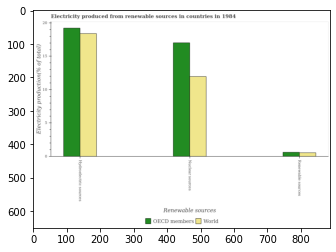

Number of QA =  28





,Renewable sources,OECD members,World
0,Nuclear sources,17.135844,12.100235
1,Renewable sources,0.679930,0.609742
2,Hydroelectric sources,19.369710,18.486174


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources and percentage of electricity produced by hydroelectric sources in oecd members ?
PREDICTED =  -1.0
EXPECTED =  -2.202709019108397




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of electricity produced by renewable sources in oecd members to that in world ?
PREDICTED =  1.1151100430053122
EXPECTED =  1.1405490613060634


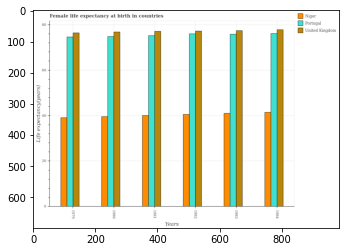

Number of QA =  29





,Years,Portugal,United Kingdom,Niger
0,1980,75.165537,77.197228,39.793153
1,1984,76.108477,78.098530,41.971305
2,1983,76.238203,77.711931,41.272277
3,1979,74.767744,76.537435,39.210197
4,1982,76.178214,77.314580,40.789372
5,1981,75.228638,77.523491,40.302032


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in niger in 1982 and that in 1984 ?
PREDICTED =  -1.181932736922107
EXPECTED =  -0.9080000000000013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in united kingdom in 1982 and the female life expectancy at birth in portugal in 1980?
PREDICTED =  0.11735208803851549
EXPECTED =  2.4000000000000057




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the female life expectancy at birth in united kingdom and female life expectancy at birth in portugal ?
PREDICTED =

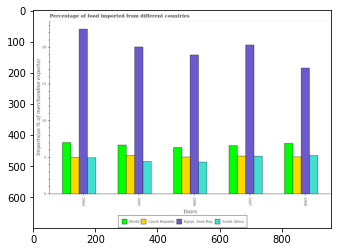

Number of QA =  30





,Years,"Egypt, Arab Rep.",South Africa,Czech Republic,World
0,2004,22.488249,5.022042,5.016530,7.078323
1,2006,18.902849,4.385179,5.133132,6.435612
2,2007,20.309826,5.207923,5.203268,6.695041
3,2008,17.152390,5.270427,5.138683,6.942938
4,2005,20.059406,4.470473,5.334822,6.694482


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in south africa in 2004 and that in 2005 ?
PREDICTED =  0.551569213708861
EXPECTED =  0.5129734576274192




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in south africa in 2007 and the percentage of imports to different countries in egypt, arab rep. in 2005?
PREDICTED =  0.3367147031365665
EXPECTED =  -14.90025719280983




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of imports to different countries in egypt, arab re

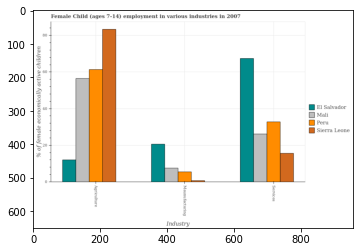

Number of QA =  28





,Industry,El] Salvador,Mali,Sierra Leone,Peru
0,Maunu facturing,20.694179,7.766651,NaN,5.748998
1,Agriculture,12.331159,56.839112,83.514183,61.582948
2,Services,67.778794,26.151672,15.862699,33.052454


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in agriculture in el salvador and the percentage of economically active children in services in mali?
PREDICTED =  -70.65962559353416
EXPECTED =  -14.13




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of economically active children in services in el salvador to that in mali ?
PREDICTED =  2.591757555428008
EXPECTED =  2.5780413159

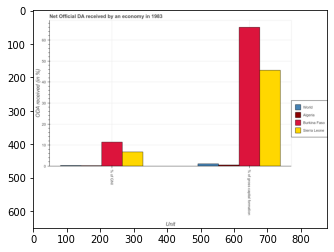

Number of QA =  23





,Unit,Algeria,Burkina Faso,Sierra Leone,World
0,% of gross Capital formation,NaN,66.161802,45.637613,NaN
1,% of GNI,NaN,11.749931,7.101950,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the oda received as percentage of gni in sierra leone to that in algeria ?
PREDICTED =  1.0
EXPECTED =  34.307067358647195




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  ODA received (in %)
EXPECTED =  10.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Net Official DA received by an economy

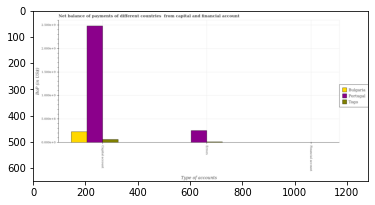

Number of QA =  24





,Type of accounts,Togo,Bulgaria,Portugal
0,Errors,NaN,NaN,0.265804
1,Financial account,NaN,NaN,NaN
2,Capital account,0.076885,0.242385,2.473977


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of errors in togo and that in portugal ?
PREDICTED =  -0.26580371024885985
EXPECTED =  -239993630.98000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of errors in bulgaria and the amount of net capital account in portugal?
PREDICTED =  -2.0
EXPECTED =  -2478561663.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of errors and amount of net capital account in portugal ?
PREDICTED =  -1.4739774965852308
EXPECTED =  -2225173033.2




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

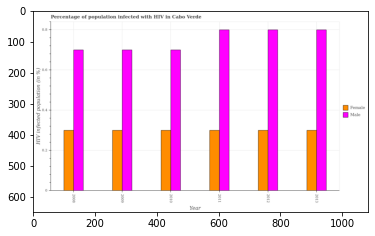

Number of QA =  28





,Year,Female,Male
0,2008,0.304009,0.701825
1,2013,0.303210,0.806485
2,2012,0.302674,0.810053
3,2011,0.305735,0.807545
4,2009,0.302293,0.701312
5,2010,0.302675,0.701757


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females who are infected with hiv in 2008 and that in 2010 ?
PREDICTED =  0.0013339568231904297
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv in 2011 and the percentage of females who are infected with hiv in 2010?
PREDICTED =  0.10578772635525557
EXPECTED =  0.10000000000000009




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of males who are infected with hiv and percentage of females who are infected with hiv ?
PREDICTED =  -0.

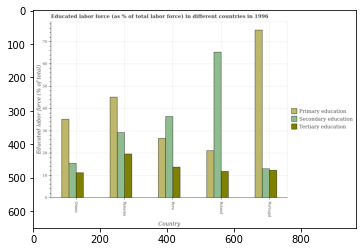

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,Peru,36.751432,13.940548,27.061441
1,Oman,15.752618,11.478007,35.434881
2,Poland,65.558290,12.027597,21.423014
3,Panama,29.309388,19.785404,45.770600
4,Portugal,13.289368,12.649971,75.882486


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in oman and that in peru ?
PREDICTED =  -2.4625408291005346
EXPECTED =  -2.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in portugal and the percentage of labor force who received primary education in peru?
PREDICTED =  -1.2905765716505737
EXPECTED =  -14.30000019073479




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received primary education and percentage of labor force who received t

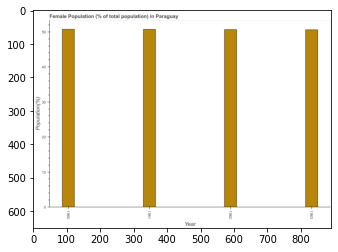

Number of QA =  23





,Year,Population(%)
0,1962,51.202658
1,1963,51.039673
2,1960,51.327823
3,1961,51.130486


> what is the title of the graph ?
PREDICTED =  Female Population (% of total population) in Paraguay
EXPECTED =  Female Population (% of total population) in Paraguay




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population(%)
EXPECTED =  Population(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 1960 and 1963 ?
PREDICTED =  0.2881499287553524
EXPECTED =  0.156




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median female population ?
PREDICTED =  51.1665721187721
EXPECTED =  50.69224353829905




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: Fals

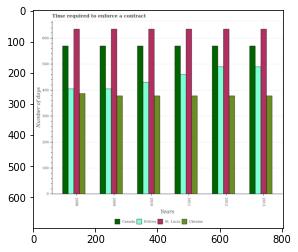

Number of QA =  30





,Years,Eritrea,Ukraine,St. Lucia,Canada
0,2008,410.212753,390.030850,647.266180,574.599368
1,2010,434.741264,382.972630,644.508425,575.506149
2,2009,408.026655,383.028218,640.895583,579.537987
3,2011,464.520535,381.897596,643.908601,576.526680
4,2013,497.186270,382.492999,642.677202,580.483371
5,2012,493.596462,381.749324,647.529291,576.257544


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract in eritrea in 2008 and that in 2010 ?
PREDICTED =  -3.0
EXPECTED =  -25.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to enforce a contract in eritrea in 2008 and the number of days required to enforce a contract in st. lucia in 2013?
PREDICTED =  0.0
EXPECTED =  -230.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of days required to enforce a contract in canada and number of days required to enforce a contract in ukraine ?
PREDICTED 

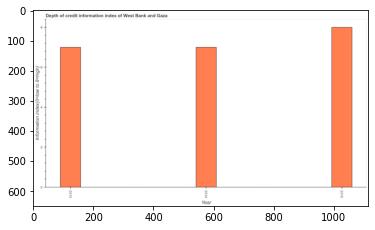

Number of QA =  23





,Year,Information index(O0=low to 8=high)
0,2013,6.965561
1,2014,7.065974
2,2015,8.119331


> what is the title of the graph ?
PREDICTED =  Depth of credit information index of West Bank and Gaza
EXPECTED =  Depth of credit information index of West Bank and Gaza




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Information index(O0=low to 8=high)
EXPECTED =  Information index(0=low to 8=high)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of credit information index in 2013 and 2015 ?
PREDICTED =  -1.153769703191541
EXPECTED =  -1.0




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median depth of credit information index ?
PREDICTED =  7.0659735164341555
EXPECTED =  7.0




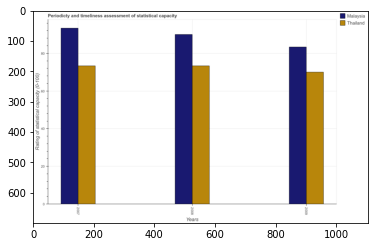

Number of QA =  28





,Years,Malaysia,Thailand
0,2008,90.151062,73.504766
1,2009,83.609663,70.355962
2,2007,94.226548,73.485463


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in malaysia in 2007 and that in 2008 ?
PREDICTED =  4.075485639755229
EXPECTED =  3.3333300000000037




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in malaysia in 2008 and the rating of statistical capacity in thailand in 2007?
PREDICTED =  -4.075485639755229
EXPECTED =  16.666669999999996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the rating of statistical capacity in malaysia and rating of statistical capacity in thailand ?
PREDICTED =  -69.44873022550

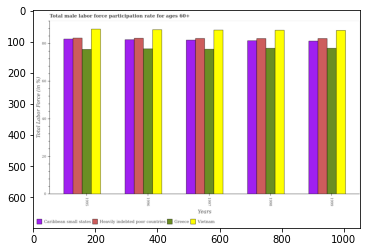

Number of QA =  30





,Years,Heavily indebted poor countries,Caribbean small states,Greece,Vietnam
0,1998,82.760214,81.574129,77.866313,87.635780
1,1995,83.386824,82.623033,77.002651,87.898099
2,1997,82.960093,82.044824,77.155854,87.688442
3,1996,83.020366,82.310075,77.398964,87.813456
4,1999,82.782872,81.551763,77.887464,87.632995


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in greece in 1995 and that in 1997 ?
PREDICTED =  -0.15320255115997838
EXPECTED =  -0.09999847412109375




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in vietnam in 1997 and the male labor force participation rate in greece in 1999?
PREDICTED =  0.05544735774383014
EXPECTED =  9.699996948242202




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the male labor force participation rate in heavily indebted poor countries and male labor force participation

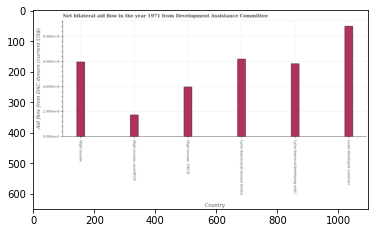

Number of QA =  22





,Country,Aid flow from DAC donars (current US$)
0,High income,5.975207
1,High income: nonOECD,1.776330
2,Least developed countries,8.811987
3,High income: OECD,3.974147
4,Latin America(all income levels),6.219888
5,Latin America(developing only),5.824899


> what is the title of the graph ?
PREDICTED =  Net bilateral aid flow in the year 1971 from Development Assistance Committee
EXPECTED =  Net bilateral aid flow in the year 1971 from Development Assistance Committee




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Aid flow from DAC donars (current US$)
EXPECTED =  Aid flow from DAC donars (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows from dac donors in high income and least developed countries ?
PREDICTED =  1.1373673001487887
EXPECTED =  -285550000.0




				 3 / 4 = 0.75


> what is the median net bilateral aid flows from dac donors ?
PREDICTED =  None
EXPECTED =  589340000.0




				 3 / 6 = 0.5


is_built_with_c

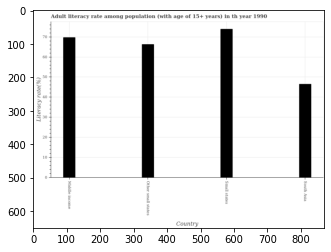

Number of QA =  22





,Country,Literacy rate(%)
0,Small states,73.907783
1,Other small states,66.270785
2,South Asia,46.620677
3,Middle income,69.632358


> what is the title of the graph ?
PREDICTED =  Adult literacy rate among population (with age of 15+ years) in th year 1990
EXPECTED =  Adult literacy rate among population (with age of 15+ years) in th year 1990




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Literacy rate(%)
EXPECTED =  Literacy rate(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adult literacy rate in middle income and south asia ?
PREDICTED =  23.011681517112258
EXPECTED =  23.215




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median adult literacy rate ?
PREDICTED =  67.95157167567862
EXPECTED =  67.9710691

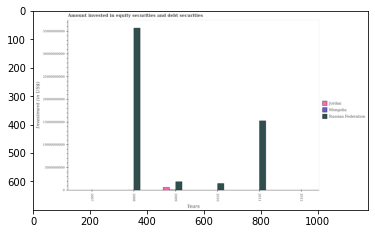

Number of QA =  24





,Years,Russian Federation,Jordan,Mongolia
0,2009,2.017885e+09,7.543721e+08,NaN
1,2008,3.608926e+10,NaN,NaN
2,2010,1.614655e+09,NaN,NaN
3,2012,NaN,NaN,NaN
4,2007,NaN,NaN,NaN
5,2011,1.545234e+10,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum amount invested in equity securities and debt securities in russian federation ?
PREDICTED =  335.0
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in russian federation in 2009 and that in 2010 ?
PREDICTED =  0.3333333333333333
EXPECTED =  387156890




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in jordan in 2011 and the amount invested in equity securities and debt securities in russian federation in 20

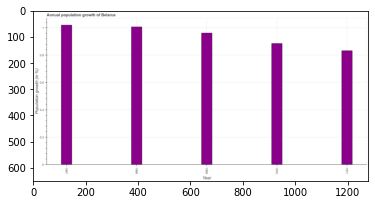

Number of QA =  23





,Year,Population growth (in %)
0,1970,0.889860
1,1968,1.009023
2,1971,0.835291
3,1969,0.966607
4,1967,1.028403


> what is the title of the graph ?
PREDICTED =  Annual population growth of Belarus
EXPECTED =  Annual population growth of Belarus




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population growth (in %)
EXPECTED =  Population growth (in %)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population growth in 1967 and 1971 ?
PREDICTED =  0.1931126548258254
EXPECTED =  0.187




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median population growth ?
PREDICTED =  0.9666072595567758
EXPECTED =  0.9616299768567941




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

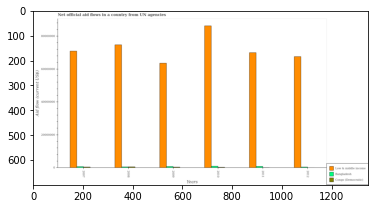

Number of QA =  29





,Years,Bangladesh,Congo (Democratic),Low & middle income
0,2009,1.082002e+06,NaN,6.385554e+07
1,2012,NaN,NaN,6.778595e+07
2,2008,NaN,841756.546984,7.462049e+07
3,2010,1.241889e+06,NaN,8.612813e+07
4,2011,1.158407e+06,NaN,7.015182e+07
5,2007,1.004711e+06,NaN,7.148363e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in low & middle income in 2008 and that in 2010 ?
PREDICTED =  -11507638.338871375
EXPECTED =  -11530000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in congo (democratic) in 2008 and the net official aid flow in bangladesh in 2010?
PREDICTED =  841756.5469836566
EXPECTED =  -360000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net official aid flow in congo (democratic) and net official aid flow in bangladesh ?
PREDICTED =  0.0
EXPECTED =  30000




				 1 / 3 = 0.333

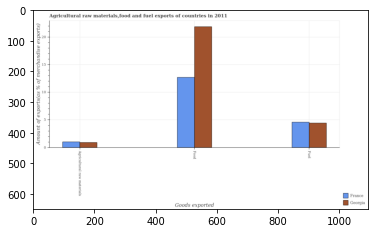

Number of QA =  28





,Goods exported,Georgia,France
0,Fuel,4.493071,4.668405
1,Agricultural raw materials,0.992647,1.113470
2,Food,22.048612,12.779273


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food exports in georgia and that in france ?
PREDICTED =  9.26933960858696
EXPECTED =  9.1807202346559




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials exports in france and the percentage of food exports in georgia?
PREDICTED =  -20.935142003792226
EXPECTED =  -20.87815122772674




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports and percentage of food exports in france ?
PREDICTED =  -0.1753340131939174
EXPECTED =  -8.119429483051999




				 2 / 3 = 0.6667


is_built_w

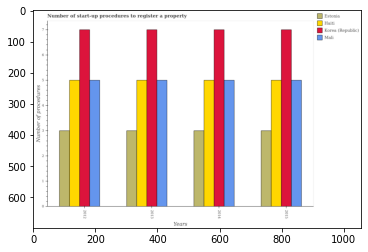

Number of QA =  30





,Years,Korea (Republic),Mali,Estonia,Haiti
0,2012,7.036582,5.022740,3.009306,5.001253
1,2015,7.029756,5.029812,3.015127,5.015273
2,2013,7.016988,5.027348,3.016576,5.028861
3,2014,7.050419,5.005719,3.016414,5.000397


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures required to register a property in mali in 2013 and that in 2015 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures required to register a property in estonia in 2012 and the number of procedures required to register a property in mali in 2013?
PREDICTED =  -2.0
EXPECTED =  -2




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2015, what is the difference between the number of procedures required to register a property in estonia and number of procedures required to register a property in 

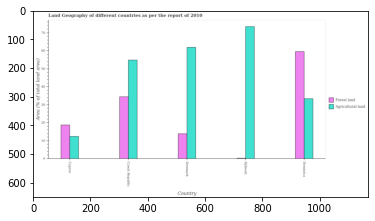

Number of QA =  28





,Country,Agricultural land,Forest land
0,Cyprus,12.881966,19.192109
1,Czech Republic,55.621617,34.772465
2,Dominica,34.030248,59.980131
3,Djibouti,74.394855,NaN
4,Denmark,62.626175,14.241166


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in czech republic and that in djibouti ?
PREDICTED =  0.0
EXPECTED =  34.157687411557184




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in dominica and the percentage of land area under agriculture in czech republic?
PREDICTED =  25.20766583596685
EXPECTED =  4.730509235283989




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests and percentage of land area under agriculture in cyprus ?
PREDICTED =  47.09816533002717
EXPECTED =

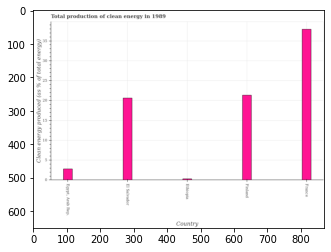

Number of QA =  22





,Country,Clean energy produced (as % of total energy)
0,El Salvador,20.917025
1,Ethiopia,0.519584
2,Finland,21.662850
3,France,38.283459
4,"Egypt, Arab Rep.",2.995954


> what is the title of the graph ?
PREDICTED =  Total production of clean energy in 1989
EXPECTED =  Total production of clean energy in 1989




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Clean energy produced (as % of total energy)
EXPECTED =  Clean energy produced (as % of total energy)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the production of clean energy in finland and france ?
PREDICTED =  -16.620609014615127
EXPECTED =  -16.582




				 4 / 4 = 1.0


> what is the median production of clean energy ?
PREDICTED =  None
EXPECTED =  20.6203758508434




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

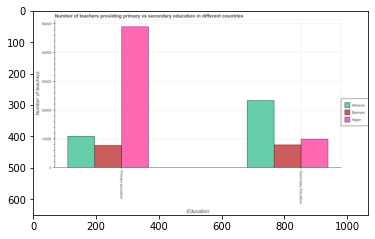

Number of QA =  23





,Education,Albania,Bahrain,Niger
0,Primary education,11058.310660,7893.076437,49191.400007
1,Secondary Education,23472.513626,8206.812354,10182.067631


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secondary teachers in bahrain and that in albania ?
PREDICTED =  -15265.701272222332
EXPECTED =  -15417




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secondary teachers in albania and the number of primary teachers in niger?
PREDICTED =  -35900.954012298535
EXPECTED =  -25678




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers and number of secondary teachers in niger ?
PREDICTED =  11056.310659617231
EXPECTED =  39103




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fal

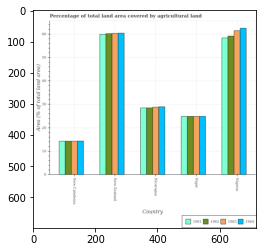

Number of QA =  30





,Country,1963,1964,1962,1961
0,Niger,25.091688,24.989993,25.216105,25.033348
1,Nigeria,62.003875,63.023404,59.927006,58.612079
2,New Caledonia,14.480325,14.541681,14.472734,14.548755
3,Nicaragua,29.199127,29.262649,28.722706,28.689600
4,New Zealand,60.599603,60.896455,60.906506,60.280128


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1963 in new zealand and that in niger ?
PREDICTED =  35.50791550351984
EXPECTED =  35.4907461418933




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1964 in new zealand and the percentage of agricultural land in 1961 in new caledonia?
PREDICTED =  46.3547739005369
EXPECTED =  46.1679629480506




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land of/in 1963 and percentage of agricultural land of/in 1962 in nicaragua?
PREDICTED =  33.281168392

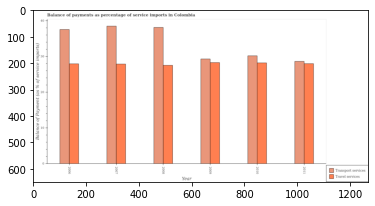

Number of QA =  28





,Year,Travel services,Transport services
0,2009,28.450829,29.416189
1,2006,28.015203,37.559505
2,2008,27.601301,38.104394
3,2007,27.895751,38.675366
4,2010,28.398654,30.309716
5,2011,28.062193,28.754852


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2007 and that in 2011 ?
PREDICTED =  -0.16644171488636061
EXPECTED =  -0.10553179879070029




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2011 and the balance of payments of transport services in 2007?
PREDICTED =  0.16644171488636061
EXPECTED =  0.10553179879070029




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments of transport services and balance of payments of travel services ?
PREDICTED =  -97.28541007166926
EXP

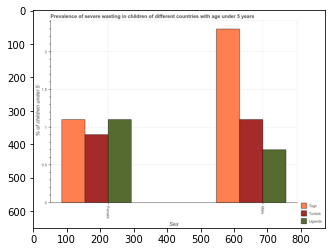

Number of QA =  23





,Sex,Togo,Tunisia,Uganda
0,Male,2.340761,1.121326,0.714681
1,Female,1.115032,0.912142,1.118493


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in tunisia and that in togo ?
PREDICTED =  -0.2028898123438453
EXPECTED =  -0.20000004768371782




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of undernourished male children in tunisia to that in togo ?
PREDICTED =  0.26394579639551746
EXPECTED =  0.4782608898465731




				 1 / 4 = 0.25


> what is the difference between tw

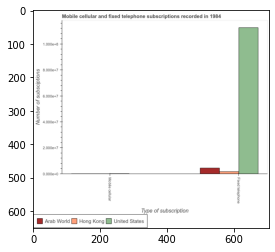

Number of QA =  23





,Type of subscription,Hong Kong,Arab World,United States
0,Mobde cellular,NaN,NaN,NaN
1,Fixed telephone,0.797181,1.762032,39.680394


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in arab world and that in hong kong ?
PREDICTED =  0.0
EXPECTED =  2778244




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in united states and the number of mobile cellular subscriptions in arab world?
PREDICTED =  0.0
EXPECTED =  112545803




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions and number of fixed telephone subscriptions in hong kong ?
PREDICTED =  1.0
EXPECTED =  -1663372




				 0 / 3 = 0.0


is_built_w

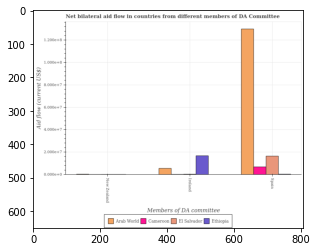

Number of QA =  28





,Members of DA committee,El Salvador,Ethiopia,Arab World,Cameroon
0,Ireland,NaN,0.173448,0.060388,NaN
1,New Zealand,NaN,NaN,NaN,NaN
2,NaN,0.171479,NaN,1.304036,0.074509


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by new zealand in el salvador and that in cameroon ?
PREDICTED =  0.0
EXPECTED =  40000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by ireland in el salvador and the amount of aid provided by spain in arab world?
PREDICTED =  1.0
EXPECTED =  -129650000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain and amount of aid provided by new zealand in cameroon ?
PREDICTED =  2.9254912661360666
EXPECTED =  6760000




				 0 / 3 = 0.0


is_built_with_cuda: True
i

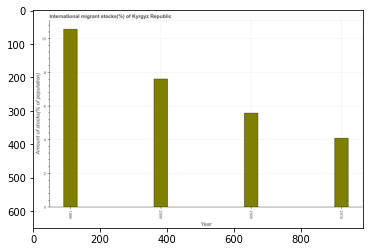

Number of QA =  23





,Year,Amount of stocks(% of population)
0,1995,10.516348
1,2005,5.564027
2,2010,4.090268
3,2000,7.617390


> what is the title of the graph ?
PREDICTED =  International migrant stocks(%) of Kyrgyz Republic
EXPECTED =  International migrant stocks(%) of Kyrgyz Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of stocks(% of population)
EXPECTED =  Amount of stocks(% of population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of international migrant stocks in 2005 and 2010 ?
PREDICTED =  1.473758971130966
EXPECTED =  1.491




				 4 / 4 = 1.0


> what is the median number of international migrant stocks ?
PREDICTED =  None
EXPECTED =  6.592394124707493




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

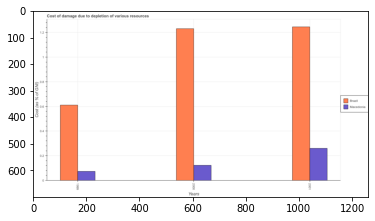

Number of QA =  28





,Years,Brazil,Macedonia
0,1999,0.620239,0.077602
1,2000,1.232989,0.126638
2,2001,1.245261,0.263249


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various resources in macedonia in 2000 and that in 2001 ?
PREDICTED =  0.12663817360767776
EXPECTED =  -0.137709574788066




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various resources in macedonia in 2000 and the cost of damage caused due to the depletion of various resources in brazil in 1999?
PREDICTED =  0.3122856788249664
EXPECTED =  -0.48865167762803197




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GP

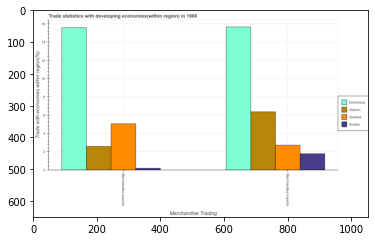

Number of QA =  23





,Merchandise Trading,Dominica,Gabon,Guinea,Sudan
0,Merchandise exports,15.706467,2.664711,5.155802,NaN
1,Merchandise imports,15.835509,6.463261,2.801153,1.845943


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in gabon and the merchandise imports in guinea?
PREDICTED =  -2.4910903285358974
EXPECTED =  -0.14294224376215992




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in guinea to that in dominica ?
PREDICTED =  0.32825979818694717
EXPECTED =  0.3246900338673556




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on t

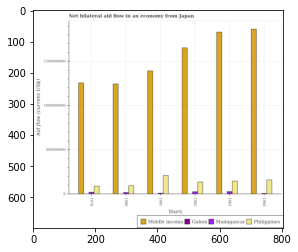

Number of QA =  27





,Years,Philippines,Gabon,Middle income,Madagascar
0,1984,1.656502e+08,NaN,1.877807e+09,NaN
1,1980,1.016697e+08,NaN,1.251412e+09,2.443664e+07
2,1983,1.526083e+08,NaN,1.846779e+09,3.518894e+07
3,1981,2.171191e+08,NaN,1.397477e+09,NaN
4,1982,1.416678e+08,NaN,1.663127e+09,3.264406e+07
5,1979,9.502678e+07,NaN,1.266120e+09,2.765635e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in middle income in 1982 and that in 1983 ?
PREDICTED =  -183652049.22626972
EXPECTED =  -177350000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in philippines in 1980 and the net bilateral aid flow in gabon in 1984?
PREDICTED =  -63980550.208368
EXPECTED =  94400000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1979, what is the difference between the net bilateral aid flow in madagascar and net bilateral aid flow in philippines ?
PREDICTED =  -753815854.4441085
EXPECTED =  -68630000.0




				 1 / 3 = 0.3

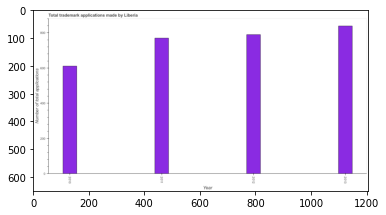

Number of QA =  23





,Year,Number of total applications
0,2013,837.143731
1,2010,608.893813
2,2011,767.731121
3,2012,792.417680


> what is the title of the graph ?
PREDICTED =  Total trademark applications made by Liberia
EXPECTED =  Total trademark applications made by Liberia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of total applications
EXPECTED =  Number of total applications




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications in 2010 and 2011 ?
PREDICTED =  -158.8373072792375
EXPECTED =  -159.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of trademark applications ?
PREDICTED =  2011.5
EXPECTED =  780.0




				 4 / 5 = 0.8


is_built_with_cuda: True
is

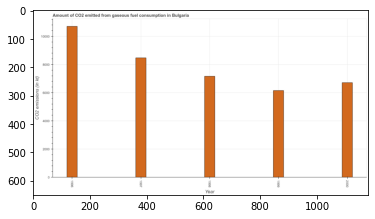

Number of QA =  23





,Year,CO2 emissions (in kt)
0,2000,6750.005232
1,1998,7214.443090
2,1997,8511.710398
3,1999,6143.420475
4,1996,10751.446455


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption in Bulgaria
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption in Bulgaria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in 1998 and 1999 ?
PREDICTED =  1071.022615705282
EXPECTED =  1012.092




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel consumption ?
PREDICTED =  7214.443090295213
EXPECTED 

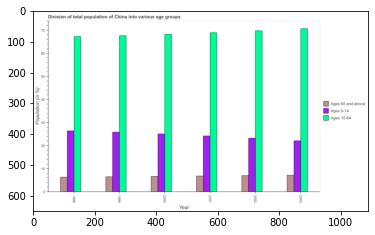

Number of QA =  29





,Year,Ages 65 and above,Ages 0-14,Ages 15-64
0,1998,6.612684,26.659368,67.963790
1,2001,7.106383,24.642042,69.551547
2,1999,6.789738,26.242115,67.984891
3,2003,7.413886,22.412872,70.959348
4,2002,7.388933,23.679255,70.233404
5,2000,6.927945,25.351062,68.651632


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 in 1999 and that in 2003 ?
PREDICTED =  3.8292430283023933
EXPECTED =  3.744506315761999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 in 2001 and the percentage of population within the age-group of 65 and above in 1998?
PREDICTED =  -2.0173253824910837
EXPECTED =  -2.1836005499718




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of population within the age-group of 65 and above and percentage of popula

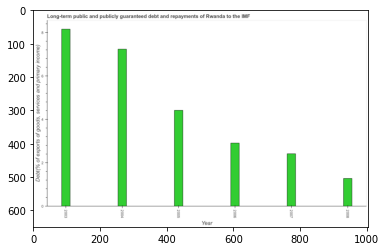

Number of QA =  23





,Year,"Debt(% of exports of goods, services and primary income)"
0,2008,1.317938
1,2005,4.450586
2,2007,2.436793
3,2003,8.222302
4,2004,7.243914
5,2006,2.932546


> what is the title of the graph ?
PREDICTED =  Long-term public and publicly guaranteed debt and repayments of Rwanda to the IMF
EXPECTED =  Long-term public and publicly guaranteed debt and repayments of Rwanda to the IMF




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt service in 2006 and 2007 ?
PREDICTED =  0.49575333186948134
EXPECTED =  0.493




				 4 / 4 = 1.0


> what is the median debt service ?
PREDICTED =  None
EXPECTED =  3.6638947569105946




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

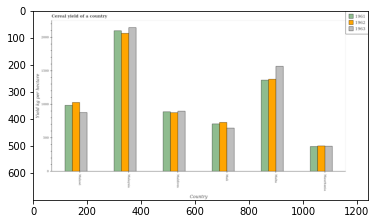

Number of QA =  29





,Country,1963,1962,1961
0,Malawi,884.752859,1037.513870,995.780629
1,Mauritania,382.190681,386.135786,373.288886
2,Malaysia,2155.689971,2072.010160,2115.670442
3,Makdives,904.596253,885.582772,898.495690
4,Mali,654.724833,740.719113,713.766772
5,Malta,1581.815016,1380.077994,1373.701594


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1961 in malawi and that in malta ?
PREDICTED =  -377.92096520182247
EXPECTED =  -375.91200000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1963 in mali and the total cereal yield in 1961 in maldives?
PREDICTED =  -1500.965137158727
EXPECTED =  -243.44000000000005




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield of/in 1961 and total cereal yield of/in 1963 in malaysia?
PREDICTED =  -40.01952845043024
EXPECTED =  -46.76299999999992




				 1 / 3 = 0.3333


is_built_

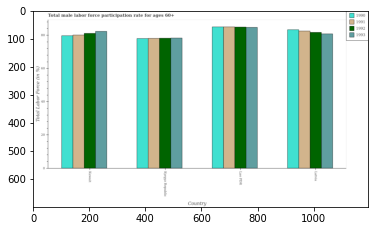

Number of QA =  30





,Country,1992,1993,1991,1990
0,Kyrgyz Republic,78.648896,78.467516,78.737506,78.657222
1,Kuwait,81.686878,82.997026,80.694348,79.726928
2,Latvia,82.485290,82.079762,83.430970,83.945058
3,Lao PDR,85.575863,85.777992,85.530879,85.667688


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1990 in kuwait and that in latvia ?
PREDICTED =  -4.218130427710207
EXPECTED =  -3.6000061035155966




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1991 in latvia and the male labor force participation rate in 1990 in kyrgyz republic?
PREDICTED =  4.693463826144168
EXPECTED =  4.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate of/in 1991 and male labor force participation rate of/in 1993 in latvia?
PREDICTED =  3.45111728

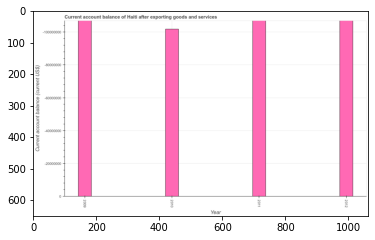

Number of QA =  12





,Year,Current account balance (current US$)
0,2009,1.086858e+08
1,2011,1.085715e+08
2,2010,1.018917e+08
3,2012,1.082550e+08


> what is the title of the graph ?
PREDICTED =  Current account balance of Haiti after exporting goods and services
EXPECTED =  Current account balance of Haiti after exporting goods and services




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  Current account balance (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  108413212.48240042
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  20000000.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

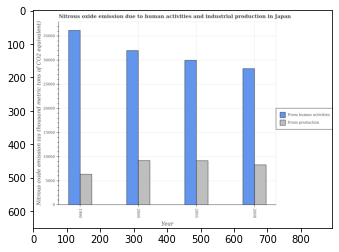

Number of QA =  28





,Year,From human activities,From production
0,2005,29945.889495,9258.697196
1,2000,31791.418473,9244.666235
2,2008,28125.118891,8463.822401
3,1990,36221.770652,6543.307342


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions from human activities in 2005 and that in 2008 ?
PREDICTED =  1820.770604681311
EXPECTED =  1725.6000000000022




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions from human activities in 1990 and the amount of emissions generated from industries in 2000?
PREDICTED =  4430.352179030917
EXPECTED =  4179.100000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the amount of emissions from human activities and amount of emissions generated from industries ?
PREDICTED =  0.0
EXPECTED =

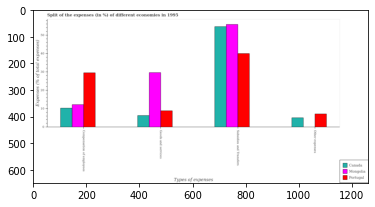

Number of QA =  29





,Types of expenses,Portugal,Mongolia,Canada
0,Subsidies and Transfers,40.614107,56.339509,54.948645
1,Goods and services,9.218624,29.917628,6.576752
2,Compensation of employees,29.986601,12.588425,10.594014
3,Other expenses,7.453818,NaN,5.361895


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on subsidies in mongolia and that in canada ?
PREDICTED =  -53.94864488351326
EXPECTED =  1.186254860746196




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on subsidies and percentage of amount spent on goods and services in portugal ?
PREDICTED =  -8.218623576497572
EXPECTED =  31.130646385404603




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of

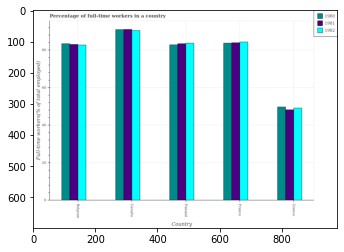

Number of QA =  29





,Country,1982,1980,1981
0,France,84.452615,83.599085,83.935819
1,Finland,83.921786,82.683168,83.558481
2,Canada,90.826262,90.770214,91.545194
3,NaN,82.561661,83.521077,83.127496
4,Greece,49.152111,49.933174,48.319064


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in 1982 in belgium and that in greece ?
PREDICTED =  41.67415116177851
EXPECTED =  33.5999984741211




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in 1982 in france and the percentage of full-time workers in 1981 in canada?
PREDICTED =  -7.0925786040661905
EXPECTED =  -6.699996948242202




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers of/in 1981 and percentage of full-time workers of/in 1982 in finland?
PREDICTED =  55.942471785473856
EXPEC

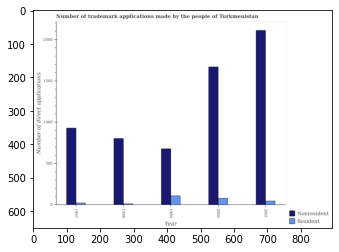

Number of QA =  28





,Year,Resident,Nonresident
0,2000,85.448014,1678.549392
1,1998,NaN,813.998573
2,2001,53.435562,2128.361737
3,1999,116.407990,687.532075
4,1997,29.619603,939.879714


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by residents in 1998 and that in 2000 ?
PREDICTED =  0.0
EXPECTED =  -67




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in 1997 and the number of trademark applications made by residents in 2001?
PREDICTED =  0.0
EXPECTED =  -1182




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the number of trademark applications made by non residents and number of trademark applications made by residents ?
PREDICTED =  0.0
EXPECTED =  0




		

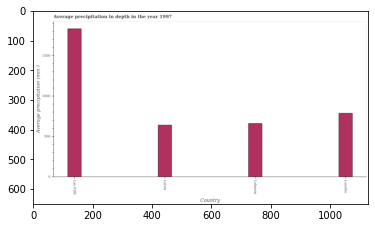

Number of QA =  22





,Country,Average precipitation (mm )
0,Latvia,645.601115
1,Lebanon,667.267739
2,Lesotho,790.840052
3,Lao PDR,1834.745652


> what is the title of the graph ?
PREDICTED =  Average precipitation in depth in the year 1997
EXPECTED =  Average precipitation in depth in the year 1997




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Average precipitation (mm )
EXPECTED =  Average precipitation (mm )




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in depth in latvia and lesotho ?
PREDICTED =  -145.23893662088426
EXPECTED =  -147.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median average precipitation in depth ?
PREDICTED =  729.0538955550796
EXPECTED =  724.5




				 5 / 5 = 1.0


is_b

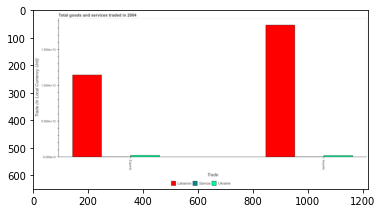

Number of QA =  23





,Trade,Lebanon,Samoa,Ukraine
0,Imports,1.853537,NaN,NaN
1,NaN,1.152056,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade (in Local Currency Unit)
EXPECTED =  5000000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Total goods and services traded in 2004
EXPECTED =  Total goods and services traded in 2004




				 1 / 6 = 0.1667


> what is the label or title of the x-axis ?
P

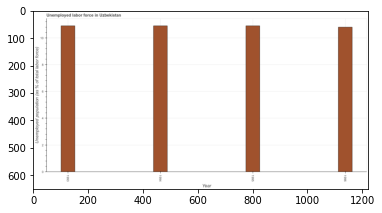

Number of QA =  23





,Year,Unemployed population (as % of total labor force)
0,1995,10.957064
1,1996,10.858273
2,1993,10.957146
3,1994,10.940231


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in Uzbekistan
EXPECTED =  Unemployed labor force in Uzbekistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed population (as % of total labor force)
EXPECTED =  Unemployed population (as % of total labor force)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed population in 1993 and 1995 ?
PREDICTED =  8.187984793650571e-05
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed population ?
PREDICTED =  1994.5
EXPECTED =  10.8999996185303




				 3 / 5 = 0.6



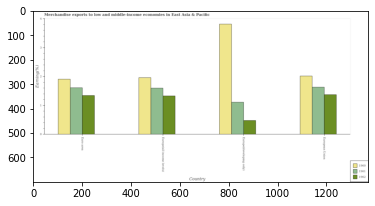

Number of QA =  29





,Country,1962,1961,1960
0,Europe(all income levels),1.349398,1.623063,1.974148
1,Europe(developing only),0.489344,1.132354,3.806273
2,European Union,1.386984,1.638356,2.028950
3,Euro area,1.360628,1.638781,1.917182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1960 in european union and the percentage of amount earned from merchandise exports in 1961 in euro area?
PREDICTED =  0.3901696012705034
EXPECTED =  0.4056083877164498




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports of/in 1960 and percentage of amount earned from merchandise exports of/in 1962 in european union?
PREDICTED =  2.419289533906234
EXPECTED =  0.6458684224211397




				 1 / 3 = 0.3333


is_built_with_cuda:

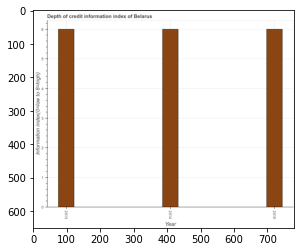

Number of QA =  23





,Year,Information index(O0=low to 8=high)
0,2013,6.119677
1,2015,6.079880
2,2014,6.038475


> what is the title of the graph ?
PREDICTED =  Depth of credit information index of Belarus
EXPECTED =  Depth of credit information index of Belarus




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Information index(O0=low to 8=high)
EXPECTED =  Information index(0=low to 8=high)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the depth of credit information index in 2013 and 2014 ?
PREDICTED =  0.08120258111582146
EXPECTED =  0.0




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median depth of credit information index ?
PREDICTED =  6.0798801500729525
EXPECTED =  6.0




				 3 / 5 = 0.6


i

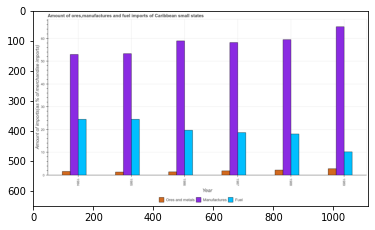

Number of QA =  29





,Year,Fuel,Manufactures,Ores and metals
0,1989,10.590076,65.876982,3.072400
1,1986,20.081519,59.534209,1.739240
2,1985,25.020684,53.896200,1.580784
3,1988,18.486943,60.115977,2.493727
4,1984,24.991372,53.448914,1.877832
5,1987,19.129930,58.831347,2.163744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in 1984 and that in 1986 ?
PREDICTED =  4.909853082143293
EXPECTED =  4.799243790644198




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of manufactures imports in 1988 and the percentage of fuel imports in 1984?
PREDICTED =  6.667062535094978
EXPECTED =  6.509850719751988




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the percentage of ores and metals imports and percentage of manufactures imports ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0


is_built_with_cuda: True
is_

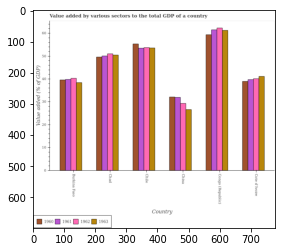

Number of QA =  30





,Country,1963,1962,1961,1960
0,China,26.703989,29.533456,31.953311,32.124592
1,Congo (Republic),61.364321,62.151029,61.504940,58.923716
2,Chad,50.407377,50.910912,50.389782,49.238685
3,Cote d'Ivoire,41.144432,40.164984,40.023828,38.702737
4,Burkina Faso,38.424734,40.589870,39.782341,39.419355
5,Chile,53.250001,53.392765,53.401936,54.947665


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by various sectors to the total gdp in 1961 in chile and that in cote d'ivoire ?
PREDICTED =  13.378107269186835
EXPECTED =  13.771228607720296




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by various sectors to the total gdp in 1961 in china and the value added by various sectors to the total gdp in 1962 in congo (republic)?
PREDICTED =  -29.55162864315324
EXPECTED =  -30.335910280053294




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by various sectors to the total gdp of/in 1961 and value added

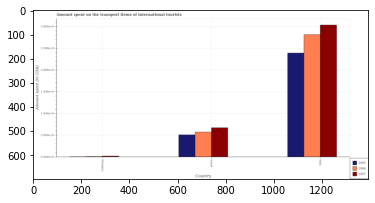

Number of QA =  29





,Country,1996,1997,1995
0,Hungary,NaN,NaN,NaN
1,Israel,0.591898,0.689563,0.523795
2,Italy,2.836527,3.063384,2.421203


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in 1997 in israel and that in italy ?
PREDICTED =  -2.3738209912982176
EXPECTED =  -2366000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in 1997 in italy and the amount spent on the transport items of international tourists in 1995 in hungary?
PREDICTED =  2.3738209912982176
EXPECTED =  3032000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international touris

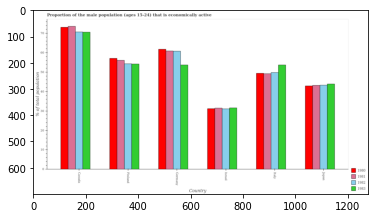

Number of QA =  30





,Country,1982,1980,1983,1981
0,Japan,43.521844,43.048504,44.040977,43.166350
1,Finland,54.294329,57.344698,54.326832,56.196650
2,Israel,31.262587,31.349700,31.714252,31.689647
3,Canada,70.794052,73.035433,70.536649,73.788173
4,Germany,60.808426,61.853146,53.588781,60.961719
5,Italy,50.001763,49.231216,53.815896,49.072453


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in 1982 in germany and that in japan ?
PREDICTED =  17.28658281707493
EXPECTED =  17.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in 1981 in canada and the proportion of the male population that is economically active in 1982 in japan?
PREDICTED =  30.621823376037632
EXPECTED =  30.299999237060497




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active of

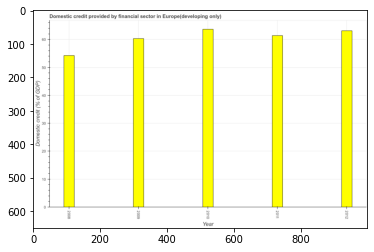

Number of QA =  23





,Year,Domestic credit (% of GDP)
0,2011,61.307243
1,2008,54.188662
2,2009,60.111735
3,2012,63.134944
4,2010,63.543007


> what is the title of the graph ?
PREDICTED =  Domestic credit provided by financial sector in Europe(developing only)
EXPECTED =  Domestic credit provided by financial sector in Europe(developing only)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Domestic credit (% of GDP)
EXPECTED =  Domestic credit (% of GDP)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by financial sector in 2010 and 2012 ?
PREDICTED =  0.40806293779217384
EXPECTED =  0.546




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median domestic credit provided by financial sector ?
PREDICTED =  

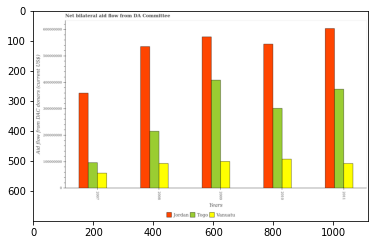

Number of QA =  29





,Years,Togo,Vanuatu,Jordan
0,2009,4.131115e+08,1.022908e+08,5.676275e+08
1,2011,3.760441e+08,9.462880e+07,6.036227e+08
2,2008,2.154507e+08,9.500626e+07,5.359692e+08
3,2010,3.013483e+08,1.116160e+08,5.441086e+08
4,2007,9.773456e+07,5.834156e+07,3.603192e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in in jordan in 2007 and that in 2008 ?
PREDICTED =  -175650071.5147249
EXPECTED =  -176140000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in in jordan in 2008 and the aid flow in in togo in 2010?
PREDICTED =  -8139343.439222336
EXPECTED =  233680000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the aid flow in in jordan and aid flow in in togo ?
PREDICTED =  -1403687128.6212811
EXPECTED =  163740000




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

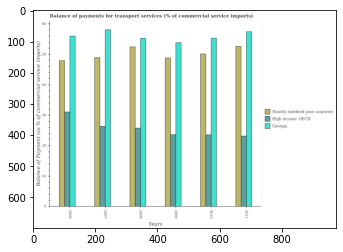

Number of QA =  29





,Years,Heavily indebted poor countries,Georgia,High income: OECD
0,2010,50.140176,55.695002,23.804985
1,2009,48.878434,54.345660,23.789106
2,2008,52.491262,55.732514,25.845803
3,2007,49.190418,59.747201,26.471143
4,2006,48.075916,56.234679,31.222882
5,2011,52.765346,57.770398,23.434300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in high income: oecd in 2006 and that in 2011 ?
PREDICTED =  7.788581855932371
EXPECTED =  7.9182703439491




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in high income: oecd in 2007 and the balance of payments for transport services in georgia in 2009?
PREDICTED =  -23.16376540367519
EXPECTED =  -27.476754214502492




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the balance of payments for transport services in heavily indebted poor c

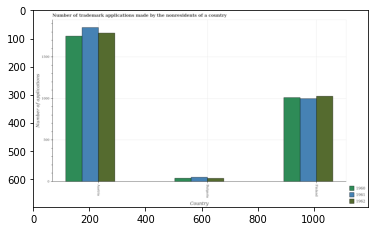

Number of QA =  29





,Country,1962,1961,1960
0,Finland,1033.791467,996.620333,1012.042903
1,Bulgaria,42.693541,56.418417,44.087907
2,Austria,1785.704351,1852.490169,1763.802602


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in 1961 in austria and that in finland ?
PREDICTED =  0.0
EXPECTED =  857.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in 1962 in austria and the number of trademark applications made by the nonresidents in 1961 in bulgaria?
PREDICTED =  0.0
EXPECTED =  1737.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents of/in 1961 and number of trademark applications made

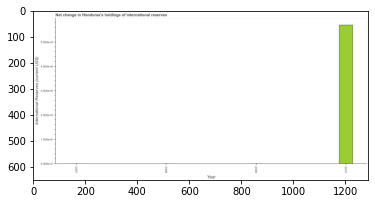

Number of QA =  15





,Year,international Reserves (current US$)
0,2008,NaN
1,2009,NaN
2,2007,NaN
3,2010,5.702614


> what is the title of the graph ?
PREDICTED =  Net change in Honduras's holdings of international reserves
EXPECTED =  Net change in Honduras's holdings of international reserves




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  international Reserves (current US$)
EXPECTED =  International Reserves (current US$)




				 2 / 3 = 0.6667


> what is the median reserves and related items ?
PREDICTED =  None
EXPECTED =  0.0




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest reserves and related items ?
PREDICTED =  nan
EXPECTED =  569536104.6




				 2 / 6 = 0.3333


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  international Reserves (current US$)
E

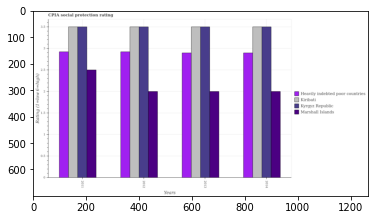

Number of QA =  30





,Years,Marshall Islands,Heavily indebted poor countries,Kyrgyz Republic,Kiribati
0,2012,2.011958,2.940424,3.517278,3.512572
1,2011,2.514243,2.938683,3.525795,3.526267
2,2013,2.012429,2.886431,3.512972,3.518360
3,2014,2.006080,2.907492,3.530635,3.536705


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in kyrgyz republic in 2011 and that in 2013 ?
PREDICTED =  0.012822249415676001
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in kiribati in 2011 and the cpia rating in kyrgyz republic in 2012?
PREDICTED =  0.01369535584432624
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in kiribati and cpia rating in marshall islands ?
PREDICTED =  -0.46329460668151956
EXPECTED =  1.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs:

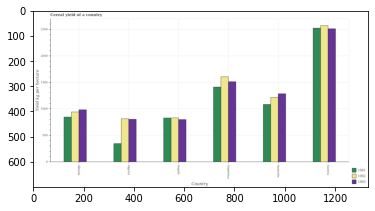

Number of QA =  29





,Country,1963,1962,1961
0,NaN,NaN,NaN,NaN
1,Argentina,1518.558722,1608.039984,1421.803099
2,Angola,807.870958,839.187507,836.615263
3,NaN,NaN,NaN,NaN
4,Australia,1284.631664,1228.982465,1102.455322
5,Austna,2512.471135,2574.236721,2514.123746


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1962 in albania and that in algeria ?
PREDICTED =  1228.9824646292009
EXPECTED =  127.79799999999977




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1961 in australia and the total cereal yield in 1962 in argentina?
PREDICTED =  -319.34777684418486
EXPECTED =  -521.0239999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield of/in 1963 and total cereal yield of/in 1961 in argentina?
PREDICTED =  4701.7293801293845
EXPECTED =  100.58899999999994




				 0 / 3 = 0.0


is_b

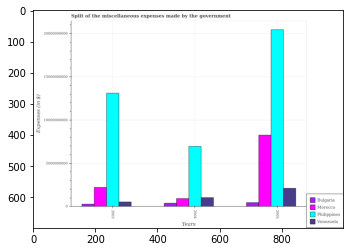

Number of QA =  30





,Years,Philippines,Bulgaria,Venezuela,Morocco
0,2004,7.018598e+09,4.377568e+08,1.074643e+09,9.702692e+08
1,2005,2.059630e+10,5.188413e+08,2.162634e+09,8.319532e+09
2,2003,1.312295e+10,3.267023e+08,5.849814e+08,2.237422e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in bulgaria in 2003 and that in 2004 ?
PREDICTED =  -111054511.25745839
EXPECTED =  -108022000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in venezuela in 2005 and the miscellaneous expenses made by the government in philippines in 2004?
PREDICTED =  1087991281.439287
EXPECTED =  -4844092241.01629




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the miscellaneous expenses made by the government in philippines and miscellaneou

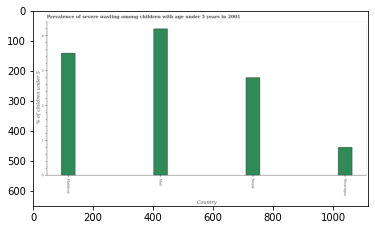

Number of QA =  22





,Country,% of children under 5
0,Nepal,2.811314
1,Mali,4.223349
2,Maldives,3.515089
3,Nicaragua,0.823047


> what is the title of the graph ?
PREDICTED =  Prevalence of severe wasting among children with age under 5 years in 2001
EXPECTED =  Prevalence of severe wasting among children with age under 5 years in 2001




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of children under 5
EXPECTED =   % of children under 5




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prevalence of severe wasting in maldives and nicaragua ?
PREDICTED =  2.69204277892117
EXPECTED =  2.7




				 3 / 4 = 0.75


> what is the median prevalence of severe wasting ?
PREDICTED =  None
EXPECTED =  3.1499999761581403




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation 

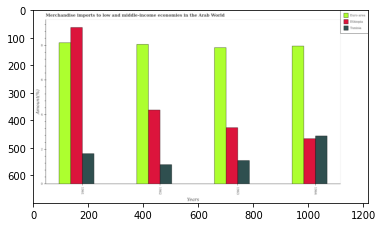

Number of QA =  29





,Years,Tunisia,Ethiopia,Euro area
0,1964,2.810989,2.624849,8.011435
1,1961,1.791894,9.080913,8.225945
2,1963,1.393093,3.293169,7.928458
3,1962,1.147414,4.322532,8.127874


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in tunisia in 1961 and that in 1964 ?
PREDICTED =  -1.019094891421875
EXPECTED =  -1.02084781890096




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in ethiopia in 1962 and the percentage of amount earned from merchandise imports in euro area in 1961?
PREDICTED =  -4.758381070561887
EXPECTED =  -3.8831642806351487




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1964, what is the difference between the percentage of amount earned from merchandise imports 

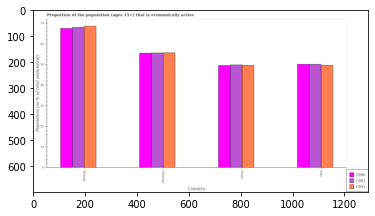

Number of QA =  29





,Country,1982,1980,1981
0,Finland,68.338070,66.866244,67.512859
1,Israel,49.328393,49.144044,49.536830
2,Germany,55.275994,55.080243,55.046992
3,Italy,49.210284,49.823793,49.954861


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in 1980 in germany and that in italy ?
PREDICTED =  5.256449661396289
EXPECTED =  5.400001525878899




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in 1982 in italy and the proportion of the population that is economically active in 1981 in finland?
PREDICTED =  -19.127786147465123
EXPECTED =  -18.4000015258789




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active of/in 19

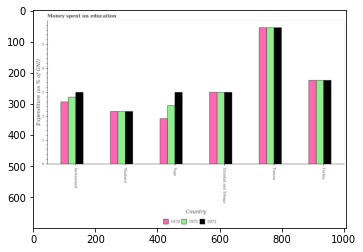

Number of QA =  29





,Country,1972,1971,1970
0,Switzerland,3.018767,2.830899,2.633780
1,Tunisia,NaN,NaN,5.702376
2,Trinidad and Tobago,3.018652,3.010672,3.022993
3,Turkey,3.513416,3.531983,3.524117
4,Togo,3.029686,2.488076,1.931641
5,Thailand,2.222522,2.212553,2.212085


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of money spent on education in 1971 in thailand and that in trinidad and tobago ?
PREDICTED =  -0.7981185497397041
EXPECTED =  -0.7999999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of money spent on education in 1971 in togo and the amount of money spent on education in 1972 in switzerland?
PREDICTED =  -0.3428236807329976
EXPECTED =  -0.55000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of money spent on education of/in 1970 and amount of money spent on education of/in 1971 in trinidad a

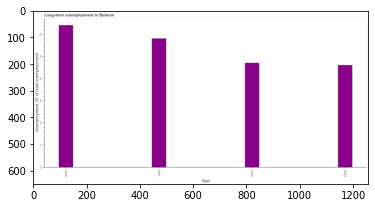

Number of QA =  23





,Year,Unemployment (% of total unemployment)
0,2013,4.636224
1,2010,6.429686
2,2011,5.800730
3,2012,4.714573


> what is the title of the graph ?
PREDICTED =  Long-term unemployment in Belarus
EXPECTED =  Long-term unemployment in Belarus




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployment (% of total unemployment)
EXPECTED =  Unemployment (% of total unemployment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term unemployment in 2012 and 2013 ?
PREDICTED =  0.07834959785063056
EXPECTED =  0.1




				 3 / 4 = 0.75


> what is the median long-term unemployment ?
PREDICTED =  None
EXPECTED =  5.249999999999999




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-term une

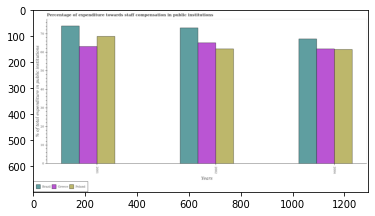

Number of QA =  29





,Years,Greece,Brazil,Poland
0,2004,62.955863,67.713413,61.736219
1,2001,63.502497,74.533361,69.131822
2,2002,65.202692,74.170558,62.081434


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in greece in 2002 and that in 2004 ?
PREDICTED =  2.246828587918273
EXPECTED =  3.2764320373535796




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in greece in 2001 and the percentage of expenditure towards staff compensation in poland in 2002?
PREDICTED =  1.4210624914958814
EXPECTED =  1.2841110229492898




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of expenditure towards staff compensation in braz

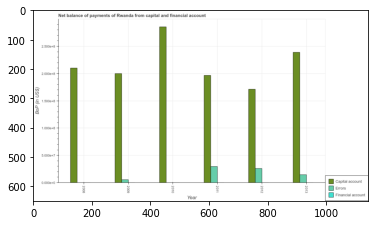

Number of QA =  26





,Year,Financial account,Capital account,Errors
0,2008,NaN,2.112170,NaN
1,2013,NaN,2.395592,0.154691
2,2010,NaN,2.867894,NaN
3,2009,NaN,2.010875,0.065475
4,2012,NaN,1.715195,0.268814
5,2011,NaN,1.970801,0.307670


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of net capital account in 2009 and that in 2010 ?
PREDICTED =  -0.8570190728672591
EXPECTED =  -85635385.10000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of net capital account in 2008 and the amount of errors in 2012?
PREDICTED =  0.3969754219196526
EXPECTED =  38835000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount of net capital account and amount of financial account ?
PREDICTED =  8.07252801225619
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fa

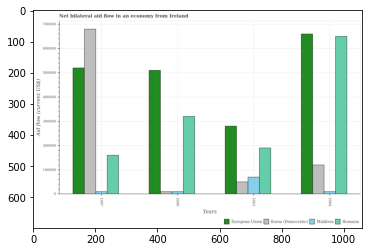

Number of QA =  30





,Years,European Union,Maldives,Romania,Korea (Democratic)
0,1997,521802.975375,11930.557007,161747.107762,683913.559466
1,2003,279878.266796,70946.673866,192320.458657,51761.958276
2,2004,659194.479241,12091.696307,648670.962022,121846.462678
3,2000,510757.356667,12085.291352,320485.214415,11791.444503


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in korea (democratic) in 2000 and that in 2003 ?
PREDICTED =  -39970.51377309469
EXPECTED =  -40000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in european union in 2000 and the net bilateral aid flow in korea (democratic) in 2004?
PREDICTED =  -148437.12257385458
EXPECTED =  390000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the net bilateral aid flow in european union and net bilateral aid flow in romania ?
PREDICTED =  659190.4792410127
EXPECTED =  360000.0





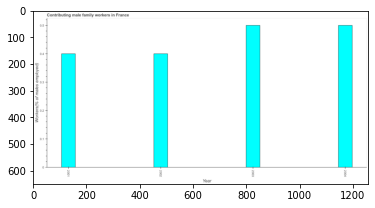

Number of QA =  23





,Year,Workers(% of males employed)
0,2002,0.401692
1,2004,0.501632
2,2003,0.501637
3,2001,0.401606


> what is the title of the graph ?
PREDICTED =  Contributing male family workers in France
EXPECTED =  Contributing male family workers in France




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Workers(% of males employed)
EXPECTED =  Workers(% of males employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing male family workers in 2001 and 2003 ?
PREDICTED =  -0.1000316123928367
EXPECTED =  -0.1




				 4 / 4 = 1.0


> what is the median contributing male family workers ?
PREDICTED =  None
EXPECTED =  0.450000002980232




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio

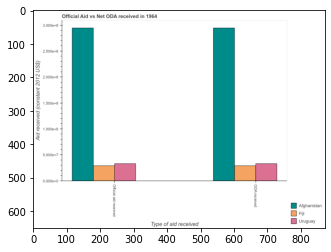

Number of QA =  23





,Type of aid received,Fiji,Uruguay,Afghanistan
0,ODA recewved,0.308300,0.346419,2.980543
1,Offical aid received,0.304667,0.345306,2.984355


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Aid received (constant 2012 US$)
EXPECTED =  50000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Official Aid vs Net ODA received in 1964
EXPECTED =  Official Aid vs Net ODA received in 1964 




				 0 / 6 = 0.0


> what is the label or title of the x-axis ?
PRED

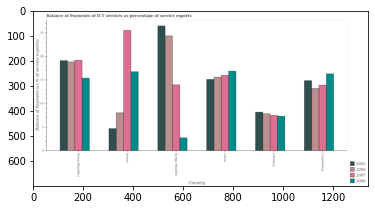

Number of QA =  30





,Country,2007,2005,2006,2008
0,Kosovo,25.660334,4.784911,8.128308,16.963625
1,Luxembourg,14.009401,14.960967,13.358683,16.351896
2,Latvia,16.248003,15.272149,15.775368,17.017051
3,Lithuania,7.691608,8.301088,7.963633,7.395567
4,Kyrgyz Republic,14.171720,26.830682,24.534578,2.827203
5,Korea (Republic),19.353606,19.285859,18.956808,15.542016


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in 2008 in korea (republic) and that in latvia ?
PREDICTED =  -1.4750346235858895
EXPECTED =  -1.4695402933007014




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in 2005 in lithuania and the balance of payments of ict services in 2008 in kyrgyz republic?
PREDICTED =  -18.52959329553497
EXPECTED =  5.45181098776413




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services of/in 2008 and balance of payments of ict services of/in 2006 in lux

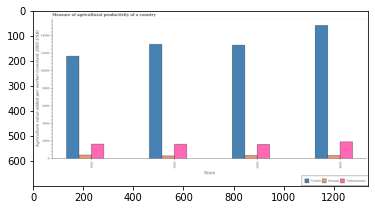

Number of QA =  29





,Years,Senegal,Turkmenistan,Croatia
0,2001,455.621814,1669.604810,11674.222424
1,2002,357.623066,1676.621306,13058.653112
2,2003,400.919682,1644.084248,12905.572950
3,2004,399.168613,1954.039136,15153.671508


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in croatia in 2002 and that in 2004 ?
PREDICTED =  -2095.018395878922
EXPECTED =  -2154.0306881932993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in croatia in 2001 and the measure of agricultural productivity in senegal in 2002?
PREDICTED =  -1384.4306874150698
EXPECTED =  11331.798342439328




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the measure of agricultural productivity in turkmenistan and measure of agricultural productivity in seneg

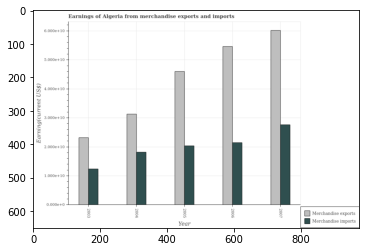

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,2005,2.069027,4.636576
1,2004,1.849268,3.168255
2,2003,1.256870,2.345009
3,2006,2.167991,5.489811
4,2007,2.787783,6.115343


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 2003 and that in 2005 ?
PREDICTED =  -2.2915672777545795
EXPECTED =  -22839400000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 2003 and the earnings from merchandise exports in 2006?
PREDICTED =  -0.9111209481441085
EXPECTED =  -9075600000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the earnings from merchandise exports and earnings from merchandise imports ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
i

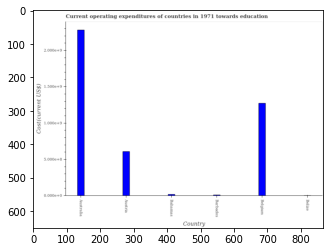

Number of QA =  22





,Country,Cost(current US$)
0,Belize,NaN
1,Austria,0.611773
2,Bahamas,0.022635
3,Belgium,1.290630
4,Australia,2.291333
5,Barbados,0.016017


> what is the title of the graph ?
PREDICTED =  Current operating expenditures of countries in 1971 towards education
EXPECTED =  Current operating expenditures of countries in 1971 towards education




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cost(current US$)
EXPECTED =  Cost(current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education expenditure in belgium and belize ?
PREDICTED =  1.2906303259903456
EXPECTED =  1270499201.71




				 3 / 4 = 0.75


> what is the median education expenditure ?
PREDICTED =  None
EXPECTED =  313054077.64699996




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

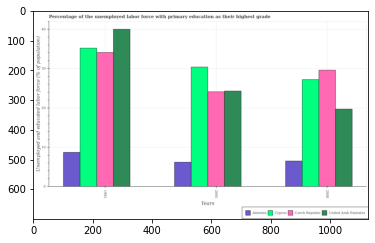

Number of QA =  30





,Years,United Arab Emirates,Czech Republic,Cyprus,Armenia
0,2005,24.372249,24.289127,30.534840,6.372073
1,2008,19.888663,29.477947,27.497344,6.711586
2,1995,40.414099,34.282533,35.173414,8.954375


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with primary education in cyprus in 1995 and that in 2008 ?
PREDICTED =  7.676070457274889
EXPECTED =  8.000000000000004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with primary education in czech republic in 2005 and the percentage of the unemployed labor force with primary education in cyprus in 1995?
PREDICTED =  -9.993405962693675
EXPECTED =  -11.100000381469812




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

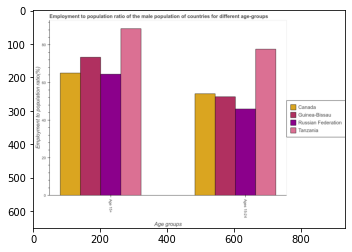

Number of QA =  23





,Age groups,Russian Federation,Tanzania,Guinea-Bissau,Canada
0,Age 15+,64.183219,88.331460,73.010466,65.150300
1,Ages 15-24,46.277586,77.252347,52.243804,53.963151


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum employment to population ratio(age 15-24) ?
PREDICTED =  1.4078154545823724
EXPECTED =  77.6999969482422




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(age 15-24) ?
PREDICTED =  1.669325358056582
EXPECTED =  45.9000015258789




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

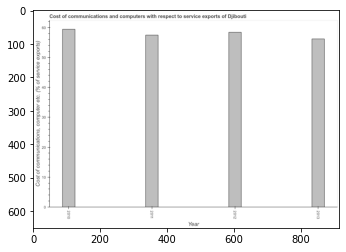

Number of QA =  23





,Year,"Cost of communications, computer etc. (% of service exports)"
0,2012,58.603619
1,2011,57.659762
2,2010,59.735358
3,2013,56.433981


> what is the title of the graph ?
PREDICTED =  Cost of communications and computers with respect to service exports of Djibouti
EXPECTED =  Cost of communications and computers with respect to service exports of Djibouti




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cost of communications, computer etc. (% of service exports)
EXPECTED =  Cost of communications, computer etc. (% of service exports)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computer in 2010 and 2011 ?
PREDICTED =  -60.96113832300386
EXPECTED =  1.961




				 3 / 4 = 0.75


> what is the median cost of communications and computer ?
PREDICTED =  None
EXPECTED =  57.9403154726148




				 3 / 6 = 0.5


is_built_

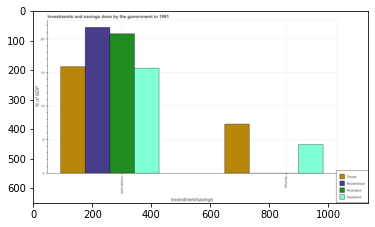

Number of QA =  20





,Inverstment/savings,Nicaragua,Mozambique,Ghana,Swaziland
0,Investments,20.78736,21.696247,15.861890,15.691565
1,Savings,NaN,NaN,7.345769,4.357995


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in ghana and the savings of government in nicaragua?
PREDICTED =  -4.925469156037687
EXPECTED =  15.8789864096371




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government and savings of government in ghana ?
PREDICTED =  -6.345769496624866
EXPECTED =  8.56125714667052




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the investments of government in nicarag

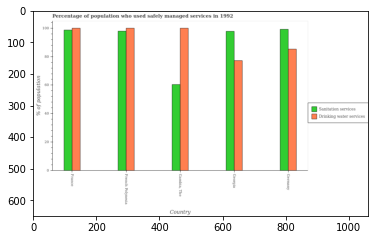

Number of QA =  28





,Country,Drinking water services,Sanitation services
0,French Polynesia,100.723372,99.344258
1,"Gambia, The",100.375864,60.504163
2,France,101.318711,98.895331
3,Georgia,77.281932,98.288399
4,Germany,85.793220,100.050846


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used sanitation services in french polynesia and that in georgia ?
PREDICTED =  1.0558588434773952
EXPECTED =  0.10000000000000853




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used drinking water services in french polynesia and the percentage of population who used sanitation services in germany?
PREDICTED =  14.930152458345447
EXPECTED =  0.7999999999999972




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


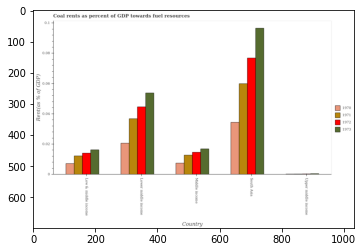

Number of QA =  30





,Country,1972,1971,1970,1973
0,Lower middle income,0.045085,0.037519,0.020900,0.053970
1,Upper middie income,NaN,NaN,NaN,NaN
2,Middle income,0.015152,0.012982,0.007837,0.017057
3,Low & middle income,0.014562,0.012711,0.007563,0.016673
4,South Asia,0.076863,0.060498,0.034893,0.097329


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in 1971 in low & middle income and that in lower middle income ?
PREDICTED =  0.0
EXPECTED =  -0.024575546226375103




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in 1971 in lower middle income and the coal rent in 1970 in middle income?
PREDICTED =  0.0
EXPECTED =  0.0293359732969131




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the coal rent in 1973 in low & middle income 

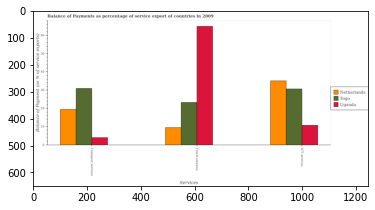

Number of QA =  28





,Services,Togo,Netherlands,Uganda
0,Transport services,31.349846,19.814079,4.347645
1,Travel services,23.727634,9.861873,65.270562
2,ICT services,31.298792,35.639768,11.097011


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of ict services in uganda and that in togo ?
PREDICTED =  -20.201781088419217
EXPECTED =  -19.93474900037921




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of transport services in uganda and the balance of payment of ict services in netherlands?
PREDICTED =  -51.106202035393295
EXPECTED =  -31.08298870430826




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of ict services and balance of payment of travel services in uganda ?
PREDICTED =  -45.068780484655676
EXPECTED =  -54.2145

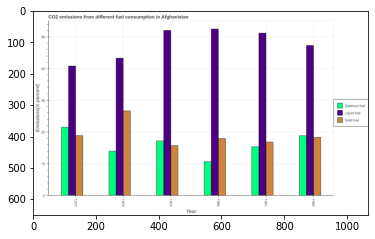

Number of QA =  29





,Year,Gaseous fuel,Liquid fuel,Solid fuel
0,1980,10.891224,52.711744,18.216800
1,1982,19.062575,47.585209,18.514669
2,1977,21.719710,41.100942,19.147768
3,1978,14.058310,43.374800,26.695717
4,1979,17.345069,52.389943,15.843880
5,1981,15.556568,51.379396,17.029418


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of solid fuel emission in 1978 and that in 1979 ?
PREDICTED =  10.85183712884825
EXPECTED =  10.943400420697001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gaseous fuel emission in 1980 and the percentage of solid fuel emission in 1979?
PREDICTED =  -6.453844733162784
EXPECTED =  -6.5599427168575986




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the percentage of liquid fuel emission and percentage of solid fuel emission ?
PREDICTED =  52.71174439306561
EXPECTED =  0.0




				 2 / 3 = 0.666

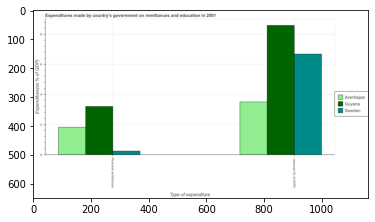

Number of QA =  23





,Type of expenditure,Sweden,Azerbaijan,Guyana
0,Personal remittances,0.275438,1.852377,3.229747
1,received (% of GDP),6.749800,3.533006,8.589019


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure in personal remittances in sweden to that in azerbaijan ?
PREDICTED =  0.14869428893927322
EXPECTED =  0.13210064412979722




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Expenditure(as % of GDP)
EXPECTED =  2.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Expenditures made 

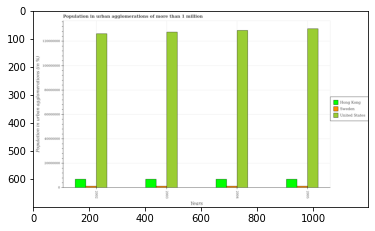

Number of QA =  29





,Years,Sweden,Hong Kong,United States
0,2005,1.626957e+06,7.074893e+06,1.300600e+08
1,2003,1.615333e+06,7.086337e+06,1.262777e+08
2,2002,1.646311e+06,7.078066e+06,1.245878e+08
3,2004,1.648375e+06,7.063089e+06,1.280671e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in hong kong in 2004 ?
PREDICTED =  1765772.3262383132
EXPECTED =  6896523




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum population in urban agglomerations in united states ?
PREDICTED =  32514996.435785364
EXPECTED =  130243458




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum population in urban agglomerations in sweden ?
PREDICTED =  403833.20298099524
EXPECTED =  1223997




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

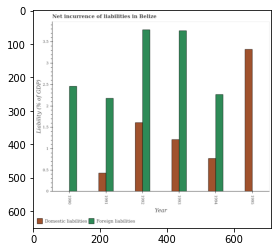

Number of QA =  25





,Year,Foreign liabilities,Domestic liabilities
0,1995,NaN,3.317956
1,1993,3.750233,1.217122
2,1991,2.193441,0.438825
3,1992,3.784000,1.610196
4,1990,2.466217,NaN
5,1994,2.274817,0.782443


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of domestic liabilities in 1991 and that in 1992 ?
PREDICTED =  0.5832443084653396
EXPECTED =  -1.180037675331255




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities in 1991 and the incurrence of domestic liabilities in 1993?
PREDICTED =  -1.5567921020448288
EXPECTED =  -1.5808262875304102




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the incurrence of domestic liabilities and incurrence of foreign liabilities ?
PREDICTED =  1990.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_bu

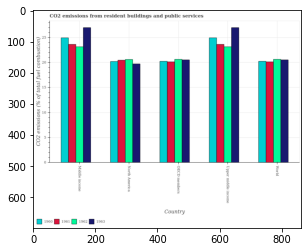

Number of QA =  30





,Country,1963,1962,1961,1960
0,Upper middle income,27.177395,23.327503,23.843777,25.219321
1,World,20.720318,20.851552,20.282941,20.502075
2,North America,19.811083,20.856294,20.643839,20.371223
3,Middle income,27.168000,23.225780,23.860199,25.273920
4,OECD members,20.694374,20.772097,20.290880,20.453437


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in north america and that in upper middle income ?
PREDICTED =  -3.199937130842187
EXPECTED =  -3.170850308435199




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in upper middle income and the total co2 emitted in 1960 in middle income?
PREDICTED =  -23.22578005513164
EXPECTED =  -1.7962318352808992




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted of/in 1963 and total co2 emitted of/in 1960 in world?
PREDICTED =  95.06909479714326
EXPECTED =  0.2914550563210092




	

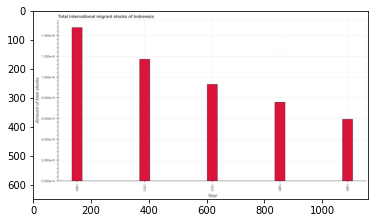

Number of QA =  23





,Year,Amount of total stocks
0,1985,0.598736
1,1970,1.175566
2,1965,1.479658
3,1975,0.935938
4,1980,0.762972


> what is the title of the graph ?
PREDICTED =  Total international migrant stocks of Indonesia
EXPECTED =  Total international migrant stocks of Indonesia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of total stocks
EXPECTED =  Amount of total stocks




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of international migrant stock in 1975 and 1980 ?
PREDICTED =  0.17296552084030492
EXPECTED =  171489.0




				 3 / 4 = 0.75


> what is the median total number of international migrant stock ?
PREDICTED =  None
EXPECTED =  928340.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what

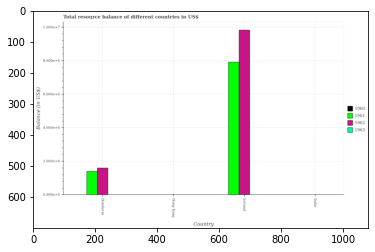

Number of QA =  23





,Country,1963,1962,1961,1960
0,Iceland,NaN,34.698537,27.860991,NaN
1,India,NaN,NaN,NaN,NaN
2,Hong Kong,NaN,NaN,NaN,NaN
3,Honduras,NaN,5.672869,4.970882,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in 1962 in honduras and that in iceland ?
PREDICTED =  -29.02566847020103
EXPECTED =  -8231516.11444903




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in 1961 in hong kong and the total resource balance in 1963 in india?
PREDICTED =  3.0
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total resource balance in 1962 in honduras to that in iceland?
PREDICTED =  0.16349014755466376
EXPECTED =  0.162741939429722




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GP

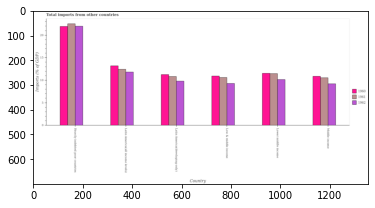

Number of QA =  29





,Country,1962,1961,1960
0,Latin America(al!l ncome levels),11.947571,12.601879,13.354167
1,Low & middle income,9.472161,10.777683,11.069027
2,Latin America( developing only),9.961702,11.013599,11.425939
3,Heavily indebted poor countries,22.337794,23.133295,22.212800
4,Lower middle income,10.315447,11.679569,11.722182
5,Middle income,9.384261,10.709056,11.031572


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1962 in latin america(all income levels) and that in low & middle income ?
PREDICTED =  17.90927250175423
EXPECTED =  2.530592618139048




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1961 in latin america(all income levels) and the total imports in 1962 in heavily indebted poor countries?
PREDICTED =  1.2776837018936327
EXPECTED =  -9.55935760089069




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of/in 1961 and total imports of/in 1962 in heavily indebted poor countries?
PREDICTED =  -1

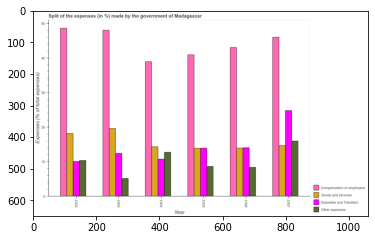

Number of QA =  30





,Year,Compensation of employees,Goods and services,Other expenses,Subsidies and Transfers
0,2005,41.017976,13.917995,8.756994,14.043042
1,2004,39.114702,14.508216,12.930127,10.987440
2,2002,48.790811,18.573147,10.457872,10.287997
3,2007,46.688698,14.994135,16.230309,25.174949
4,2006,43.055929,14.104843,8.551341,14.279043
5,2003,48.305927,19.870763,5.335365,12.593431


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on subsidies in 2006 and that in 2007 ?
PREDICTED =  -10.895906497078808
EXPECTED =  -10.7654447313454




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on subsidies in 2004 and the percentage of amount spent on other expenses in 2006?
PREDICTED =  -3.291602554083658
EXPECTED =  -3.284120031279201




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of amount spent on other expenses and percentage of amount spent on subsidies ?
PREDICTED =  -14.008153717508137

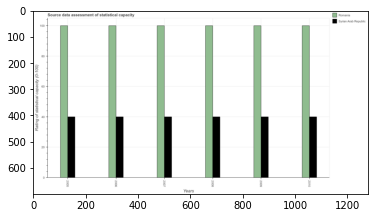

Number of QA =  28





,Years,Syrian Arab Republic,Romania
0,2010,39.962943,100.179160
1,2006,39.933679,100.304514
2,2005,39.944175,99.835571
3,2008,39.895443,100.195789
4,2009,39.942992,100.204719
5,2007,39.842228,100.156022


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in syrian arab republic in 2005 and that in 2007 ?
PREDICTED =  0.10194696821418603
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in romania in 2007 and the rating of statistical capacity in syrian arab republic in 2006?
PREDICTED =  -0.14849223611960838
EXPECTED =  60




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the rating of statistical capacity in romania and rating of statistical capacity in syrian arab republic ?
PREDICTED =  560.955530

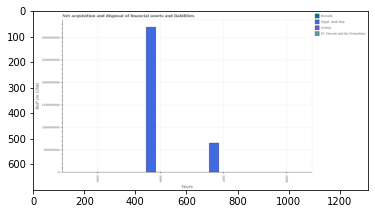

Number of QA =  18





,Years,"Egypt, Arab Rep.",Burundi,Guinea,St. Vincent and the Grenadines
0,2008,NaN,NaN,NaN,NaN
1,2005,NaN,NaN,NaN,NaN
2,2006,3.260540e+09,NaN,NaN,NaN
3,2007,6.677133e+08,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in egypt, arab rep. in 2008 and the balance of payments in guinea in 2006?
PREDICTED =  667713270.9007597
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest balance of payments in egypt, arab rep. ?
PREDICTED =  -2592827115.422497
EXPECTED =  3232900000




				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  BoP (in US$)
EXPECTED =  500000000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Net acquisition and disposal of financial assets and liabilities
EXPECTED =  Net acquisition and disposal of financial assets and liabilities




				 1 / 4

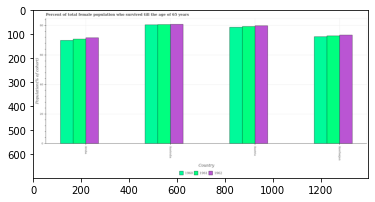

Number of QA =  29





,Country,1962,1961,1960
0,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN
2,Austria,80.321936,79.400807,79.299117
3,Australia,81.129192,81.162607,80.634765


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female population who survived till the age of 65 years in 1960 in aruba and that in austria ?
PREDICTED =  0.0
EXPECTED =  -8.923919999999995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female population who survived till the age of 65 years in 1961 in aruba and the percentage of total female population who survived till the age of 65 years in 1960 in australia?
PREDICTED =  -79.16260663414877
EXPECTED =  -9.68889




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female po

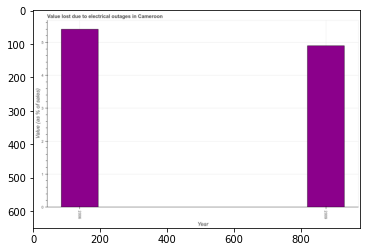

Number of QA =  19





,Year,Value (as % of sales)
0,2009,4.929839
1,2006,5.432160


> what is the title of the graph ?
PREDICTED =  Value lost due to electrical outages in Cameroon
EXPECTED =  Value lost due to electrical outages in Cameroon




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Value (as % of sales)
EXPECTED =  Value (as % of sales)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value lost due to electrical outages in 2006 and 2009 ?
PREDICTED =  0.5023205028936166
EXPECTED =  0.5




				 4 / 4 = 1.0


> what is the median value lost due to electrical outages ?
PREDICTED =  None
EXPECTED =  5.15




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the v

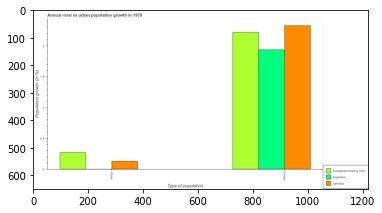

Number of QA =  20





,Type of population,Europe(developing only),Jamaica,Argentina
0,Rural,0.277679,0.137954,NaN
1,Urban,2.235308,2.325637,1.942378


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth in jamaica and that in europe(developing only) ?
PREDICTED =  -0.13972507014109345
EXPECTED =  -0.14055745792510602




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population growth in jamaica and the rural population growth in argentina?
PREDICTED =  0.38325938429915074
EXPECTED =  2.32831051802131




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population growth and urban population growth in europe(developing only) ?
PREDICTED =  -0.9788145612838469
EXPECTED =  -1.9516019291450888




				 1 / 3 

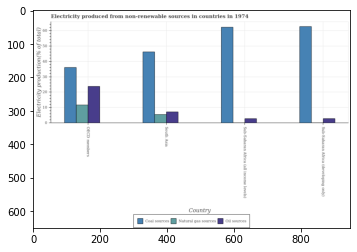

Number of QA =  29





,Country,Coal sources,Oil sources,Natural gas sources
0,South Asia,46.601372,7.629366,5.933514
1,OECD members,36.476809,24.142685,12.209965
2,Sub-Saharan Africa (all income levels),62.680175,3.236204,NaN
3,Sub-Saharan Africa (developing only),63.156023,3.283547,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources in oecd members and that in sub-saharan africa (all income levels) ?
PREDICTED =  20.906480679823336
EXPECTED =  20.914197575406043




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in sub-saharan africa (all income levels) and the percentage of electricity produced by oil sources in south asia?
PREDICTED =  -5.9335141615670715
EXPECTED =  -7.0527803141755285




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produc

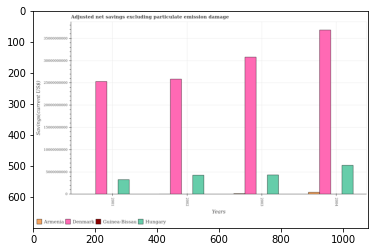

Number of QA =  27





,Years,Armenia,Hungary,Guinea-Bissau,Denmark
0,2002,NaN,4.358951e+09,NaN,2.590574e+10
1,2003,NaN,4.447384e+09,NaN,3.088420e+10
2,2001,NaN,3.343285e+09,NaN,2.545883e+10
3,2004,5.565815e+08,6.620103e+09,NaN,3.703417e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in hungary in 2001 and that in 2002 ?
PREDICTED =  -1015665347.4231486
EXPECTED =  -995837288.71282




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in hungary in 2001 and the adjusted net savings in guinea-bissau in 2004?
PREDICTED =  -3276817880.50802
EXPECTED =  3267248320.86018




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the adjusted net savings in denmark and adjusted net savings in hungary ?
PREDICTED =  37034169267.3018
EXPECTED =  21582546100.6371




				 1 / 3 = 0.33

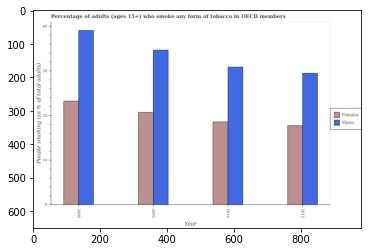

Number of QA =  28





,Year,Males,Females
0,2005,34.875112,20.925958
1,2000,39.140615,23.493250
2,2012,29.571402,18.039824
3,2010,31.055089,18.766434


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who smoke in 2000 and that in 2010 ?
PREDICTED =  8.08552633401536
EXPECTED =  8.201409434672101




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who smoke in 2005 and the percentage of females who smoke in 2010?
PREDICTED =  3.820022836453976
EXPECTED =  3.8049845743299926




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of males who smoke and percentage of females who smoke ?
PREDICTED =  11.531578157668275
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda

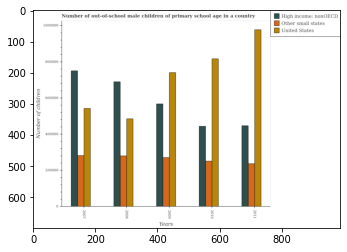

Number of QA =  29





,Years,High income: nonOECD,Other small states,United States
0,2009,567101.839829,268942.990361,739808.904209
1,2008,692230.234399,282007.131662,483773.516905
2,2010,446837.384851,250502.759158,811940.708496
3,2011,455152.372567,236252.791703,972222.174442
4,2007,749375.675644,279460.584749,543282.072009


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in united states in 2007 and that in 2011 ?
PREDICTED =  -428940.1024329994
EXPECTED =  -434881.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in other small states in 2008 and the number of out-of-school male children in high income: nonoecd in 2010?
PREDICTED =  31504.37250383559
EXPECTED =  -163426.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of out-of-school male children in high income: nonoecd and number of out-of-school 

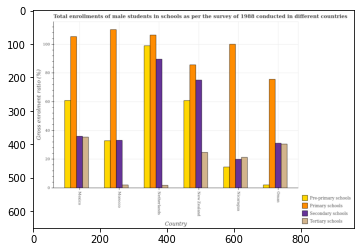

Number of QA =  30





,Country,Pre-primary schools,Secondary schools,Tertiary schools,Primary schools
0,Mexico,62.111584,36.545957,35.890226,107.024025
1,Oman,2.621887,31.734792,31.295777,76.291801
2,Netherlands,100.073433,90.819788,2.349068,108.687458
3,New Zealand,62.054790,76.135819,25.519389,87.034364
4,Nicaragua,15.172558,20.440949,22.152871,101.057945
5,Morocco,33.454951,33.973733,2.620882,111.222600


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(male) in pre-primary schools in netherlands ?
PREDICTED =  16.678905434543733
EXPECTED =  98.98061




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(male) in secondary schools ?
PREDICTED =  15.136631283929155
EXPECTED =  89.61140999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio(male) in pre-primary schools ?
PREDICTED =  0.43698122161178987
EXPECTED =  2.07422




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalu

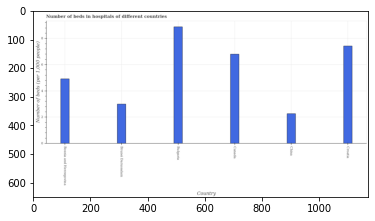

Number of QA =  22





,Country,"Number of beds (per 1,000 people)"
0,Bosnia and Herzegovina,4.964929
1,Brunei Darussalam,3.029099
2,China,2.301931
3,Croatia,7.470162
4,Canada,6.838290
5,Bulgaria,8.917869


> what is the title of the graph ?
PREDICTED =  Number of beds in hospitals of different countrie:
EXPECTED =  Number of beds in hospitals of different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Number of beds (per 1,000 people)
EXPECTED =  Number of beds (per 1,000 people)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hospital beds in brunei darussalam and croatia ?
PREDICTED =  -4.441062915158422
EXPECTED =  -4.43




				 3 / 4 = 0.75


> what is the median number of hospital beds ?
PREDICTED =  None
EXPECTED =  5.85895013809204




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training st

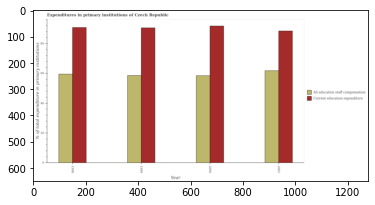

Number of QA =  28





,Year,All education staff compensation,Current education expenditure
0,1999,59.275502,91.180076
1,2001,62.698684,89.152093
2,1998,60.090986,91.464158
3,2000,59.108523,92.212275


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 1998 and that in 2000 ?
PREDICTED =  0.9824637125600049
EXPECTED =  1.0461583276366966




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2000 and the expenditure in staff compensation in 1999?
PREDICTED =  1.0321988042375665
EXPECTED =  1.2300186157225994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  -92.212274678697
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: T

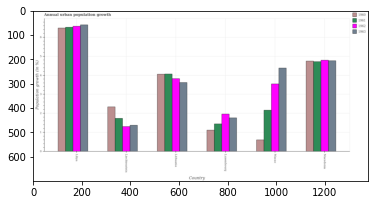

Number of QA =  30





,Country,1963,1962,1961,1960
0,Lithuania,3.632537,3.839340,4.089979,4.069019
1,Macedonia,4.779702,4.800470,4.738503,4.766810
2,Liechtenstein,1.405433,1.312004,1.763941,2.341073
3,Macao,4.404911,3.550250,2.194786,0.627734
4,Luxembourg,1.790089,1.986270,1.478874,1.160058
5,Libya,6.703465,6.610848,6.585928,6.530536


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population growth in 1962 in lithuania and that in luxembourg ?
PREDICTED =  1.8530699466093057
EXPECTED =  1.86272937732239




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population growth in 1963 in macao and the percentage of urban population growth in 1960 in macedonia?
PREDICTED =  -0.3747914361010407
EXPECTED =  -0.3660109689469593




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population growth of/in 1963 and percentage of urban population growth of/in 1960 in macao?

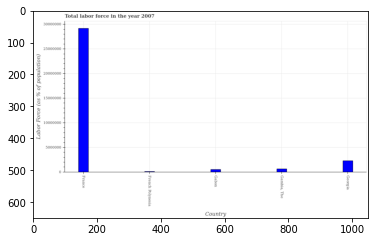

Number of QA =  22





,Country,Labor Force (as % of population)
0,France,2.940274e+07
1,Gabon,6.564901e+05
2,"Gambia, The",7.645962e+05
3,French Polynesia,2.470926e+05
4,Georgia,2.398143e+06


> what is the title of the graph ?
PREDICTED =  Total labor force in the year 2007
EXPECTED =  Total labor force in the year 2007




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Labor Force (as % of population)
EXPECTED =  Labor Force (as % of population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force in france and french polynesia ?
PREDICTED =  29155645.76682544
EXPECTED =  29079732.0




				 4 / 4 = 1.0


> what is the median total labor force ?
PREDICTED =  None
EXPECTED =  638591.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total labor for

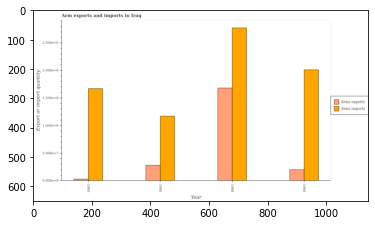

Number of QA =  28





,Year,Arms imports,Arms exports
0,1989,2.011849,0.208263
1,1988,2.763220,1.694213
2,1960,1.672840,0.039110
3,1980,1.169357,0.286120


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in 1980 and that in 1989 ?
PREDICTED =  -0.8424923693930377
EXPECTED =  -84000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in 1960 and the arms exports in 1988?
PREDICTED =  -1.0903799696111756
EXPECTED =  -110000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the arms imports and arms exports ?
PREDICTED =  0.6933216956202606
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

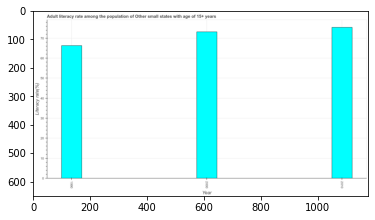

Number of QA =  23





,Year,Literacy rate(%)
0,2010,76.015808
1,1990,66.878389
2,2000,73.629475


> what is the title of the graph ?
PREDICTED =  Adult literacy rate among the population of Other small states with age of 15+ years
EXPECTED =  Adult literacy rate among the population of Other small states with age of 15+ years




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Literacy rate(%)
EXPECTED =  Literacy rate(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adult literacy rate in 2000 and 2010 ?
PREDICTED =  -2.3863329642959457
EXPECTED =  -2.247




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median adult literacy rate ?
PREDICTED =  73.62947478300018
EXPECTED =  73.1472393249

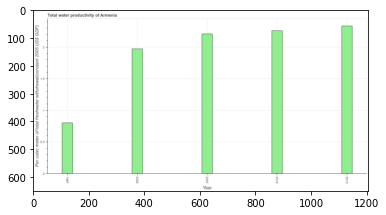

Number of QA =  23





,Year,Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)
0,2012,2.280383
1,2013,2.350515
2,2002,1.992326
3,1997,0.816139
4,2007,2.236425


> what is the title of the graph ?
PREDICTED =  Total water productivity of Armenia
EXPECTED =  Total water productivity of Armenia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)
EXPECTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total water productivity in 2007 and 2012 ?
PREDICTED =  -0.04395760134077964
EXPECTED =  -0.051




				 3 / 4 = 0.75


> what is the median total water productivity ?
PREDICTED =  None
EXPECTED =  2.20781455988256




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

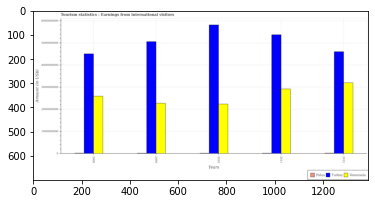

Number of QA =  29





,Years,Palau,Turkey,Venezuela
0,2012,NaN,4.630986e+09,3.232450e+09
1,2011,NaN,5.392877e+09,2.942757e+09
2,2008,NaN,4.527268e+09,2.608573e+09
3,2010,NaN,5.824535e+09,2.261337e+09
4,2009,NaN,5.086745e+09,2.287846e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in venezuela in 2010 and that in 2012 ?
PREDICTED =  -971113500.612937
EXPECTED =  -964000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in turkey in 2011 and the earnings from international visitors in palau in 2012?
PREDICTED =  761891137.3976784
EXPECTED =  5352900000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the earnings from international visitors in venezuela and earnings from international visitors in palau ?
PREDICTED =  3232

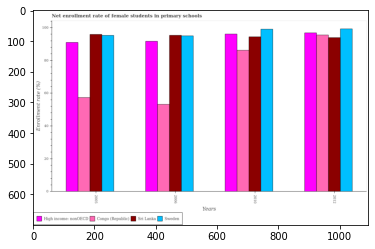

Number of QA =  30





,Years,Congo (Republic),Sweden,Sri Lanka,High income: nonOECD
0,2005,57.360397,95.536573,96.053163,90.780769
1,2012,95.789075,99.135162,94.097859,96.954560
2,2006,53.233855,94.953698,95.388565,91.698137
3,2010,86.765318,99.420412,94.917608,96.169741


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate of female students in primary schools in sweden in 2005 and that in 2012 ?
PREDICTED =  -3.5985889915447444
EXPECTED =  -3.991943359375




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate of female students in primary schools in high income: nonoecd in 2005 and the net enrollment rate of female students in primary schools in sri lanka in 2006?
PREDICTED =  -0.9173681777569271
EXPECTED =  -4.375350952148395




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net enrollment rate of femal

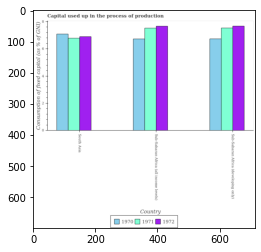

Number of QA =  29





,Country,1972,1971,1970
0,South Asia,6.930714,6.800064,7.167429
1,Sub-Saharan Africa (developing only),7.728748,7.559538,6.779833
2,Sub-Saharan Africa (all income levels),7.741433,7.533814,6.762127


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?

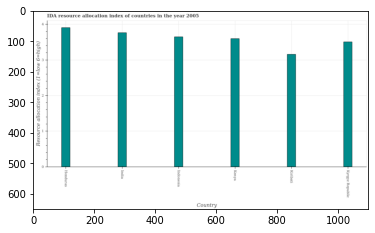

Number of QA =  22





,Country,Resource allocation index (1=low 6=high)
0,Kenya,3.592900
1,Kiribati,3.152668
2,Indonesia,3.641247
3,Honduras,3.923365
4,Kyrgyz Republic,3.506224
5,India,3.759438


> what is the title of the graph ?
PREDICTED =  IDA resource allocation index of countries in the year 2005
EXPECTED =  IDA resource allocation index of countries in the year 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Resource allocation index (1=low 6=high)
EXPECTED =  Resource allocation index (1=low 6=high)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in kiribati and kyrgyz republic ?
PREDICTED =  -0.35355570692443994
EXPECTED =  -0.35




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ida resource allocation index ?
PREDICTED =  3.617

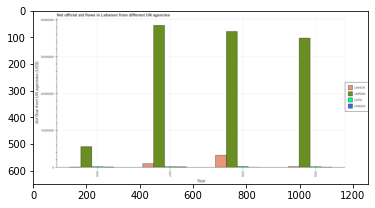

Number of QA =  30





,Year,UNTA,UNRWA,UNAIDS,UNHCR
0,1978,NaN,3.678110e+07,NaN,3.375148e+06
1,1979,NaN,3.495250e+07,NaN,NaN
2,1977,NaN,3.864691e+07,NaN,1.124896e+06
3,1975,NaN,5.671966e+06,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unta in 1977 and that in 1978 ?
PREDICTED =  35271764.44283752
EXPECTED =  -50000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unrwa in 1978 and the amount of aid given by unta in 1975?
PREDICTED =  31109134.174456134
EXPECTED =  31240000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1979, what is the difference between the amount of aid given by unhcr and amount of aid given by unta ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

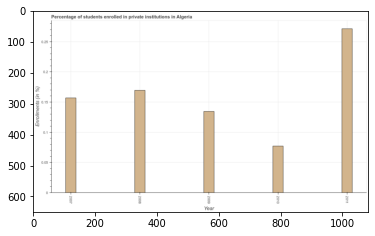

Number of QA =  23





,Year,Enrollments (in %)
0,2008,0.172505
1,2011,0.275735
2,2010,0.078995
3,2007,0.159210
4,2009,0.136744


> what is the title of the graph ?
PREDICTED =  Percentage of students enrolled in private institutions in Algeria
EXPECTED =  Percentage of students enrolled in private institutions in Algeria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Enrollments (in %)
EXPECTED =  Enrollments (in %)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollments in private institutions in 2008 and 2009 ?
PREDICTED =  0.03576097419282831
EXPECTED =  0.035




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median enrollments in private institutions ?
PREDICTED =  0.15920992422364222
EXPECTED =  0.15686999261

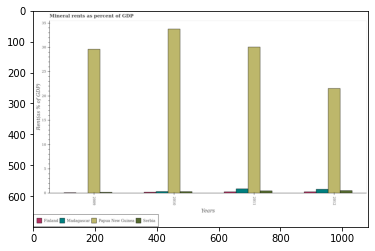

Number of QA =  30





,Years,Papua New Guinea,Finland,Serbia,Madagascar
0,2009,29.786778,NaN,NaN,NaN
1,2012,21.802566,0.396337,0.651614,0.927225
2,2010,33.982149,NaN,0.451026,0.450323
3,2011,30.266906,0.403300,0.589766,0.994356


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in papua new guinea in 2009 and that in 2012 ?
PREDICTED =  7.984211575555019
EXPECTED =  8.06520043730859




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in finland in 2009 and the mineral rent in serbia in 2012?
PREDICTED =  -0.3963371054569837
EXPECTED =  -0.4224695744617091




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the mineral rent in papua new guinea and mineral rent in madagascar ?
PREDICTED =  20.357887853997273
EXPECTED =  29.17142174716803




				 1 / 3 = 0.3333


is_built_with_c

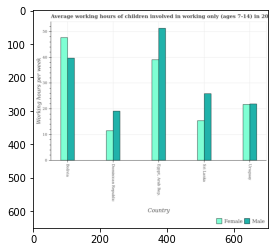

Number of QA =  28





,Country,Female,Male
0,"Egypt, Arab Rep.",39.074180,51.596581
1,Bolivia,48.116145,39.847975
2,Sri Lanka,15.609794,26.108042
3,Dominican Republic,11.784450,19.449880
4,Uruguay,22.003659,22.259722


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of female children in bolivia and that in dominican republic ?
PREDICTED =  36.33169500771251
EXPECTED =  36.2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of female children in bolivia and the average working hour of male children in dominican republic?
PREDICTED =  36.33169500771251
EXPECTED =  28.6




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of female children and average working hour of male children in uruguay ?
PREDICTED =  -10.219209402951657
EXPECTED =  -0.1

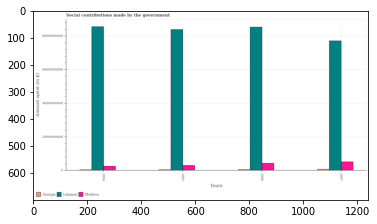

Number of QA =  29





,Years,Lebanon,Georgia,Moldova
0,2004,8.563012e+10,NaN,2.810583e+09
1,2006,8.537794e+10,NaN,4.511792e+09
2,2007,7.722660e+10,NaN,5.380567e+09
3,2005,8.401467e+10,NaN,3.288269e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on social contributions in moldova in 2004 and that in 2007 ?
PREDICTED =  -2569984364.033184
EXPECTED =  -2623900000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on social contributions in lebanon in 2006 and the amount spent on social contributions in moldova in 2004?
PREDICTED =  -252173981.97982788
EXPECTED =  82839500000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is t

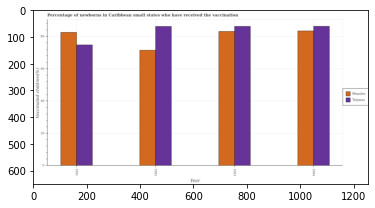

Number of QA =  28





,Year,Measles,Tetanus
0,1994,83.147200,86.261992
1,1992,71.187026,86.018002
2,1991,82.434886,74.910798
3,1993,83.465159,86.191552


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of newborns who received vaccination for measles in 1991 and that in 1994 ?
PREDICTED =  -0.7123140538761277
EXPECTED =  -0.9060696900754976




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of newborns who received vaccination for tetanus in 1994 and the percentage of newborns who received vaccination for measles in 1993?
PREDICTED =  2.7968328950647674
EXPECTED =  0.034714399873209345




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the percentage of newborns who received vaccination for measles and 

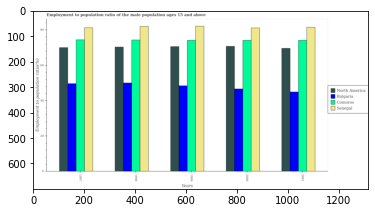

Number of QA =  30





,Years,North America,Senegal,Bulgaria,Comoros
0,2001,69.451749,80.923126,44.997379,73.910163
1,1999,70.348568,81.995266,48.807330,74.057095
2,1998,70.230217,81.722692,50.103186,74.138738
3,2000,70.424553,80.795093,46.663776,74.126669
4,1997,69.991697,81.062414,49.731962,74.376528


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in north america in 1999 ?
PREDICTED =  28.415645785858324
EXPECTED =  70.55424420882991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in north america ?
PREDICTED =  28.413386039882543
EXPECTED =  70.7051723942155




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in senegal ?
PREDICTED =  24.76635551085561
EXPECTED =  81.099998474121




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished

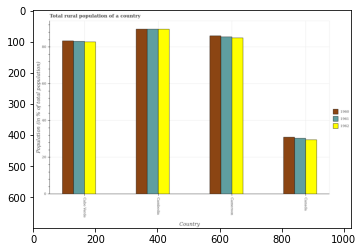

Number of QA =  29





,Country,1962,1961,1960
0,Cambodia,90.160509,90.119433,90.587127
1,Cameroon,85.155512,85.714418,86.391566
2,Canada,29.745987,30.604631,31.276274
3,Cabo Verde,82.771149,83.161402,83.804245


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 1960 in cameroon and that in canada ?
PREDICTED =  55.115292546645115
EXPECTED =  55.123999999999974




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 1961 in canada and the rural population in 1960 in cameroon?
PREDICTED =  -55.10978719481411
EXPECTED =  -55.73099999999997




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population of/in 1962 and rural population of/in 1960 in canada?
PREDICTED =  256.5568846974977
EXPECTED =  -1.4329999999999998




				 2 / 3 = 0.6667


is_built_with_cuda:

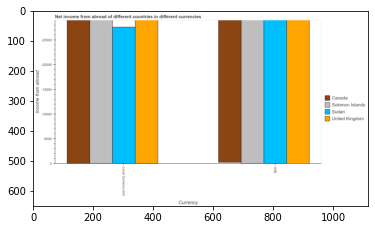

Number of QA =  14





,Currency,United Kingdom,Solomon Islands,Sudan,Canada
0,US$,1.362043e+06,1.361069e+06,1.367705e+06,1.370521e+06
1,Local Currency Unit,1.362389e+06,1.369998e+06,1.300978e+06,1.354312e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Income from abroad
EXPECTED =  5000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Net income from abroad of different countries in different currencies
EXPECTED =  Net income from abroad of different countries in different currencies




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Currency
EXPECTED =  Currency




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Income from abroad
EXPECTED =  Income from abroad




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the label of the 1st group of bars from the left ?
EXPECTED =  Local Currency Unit
P

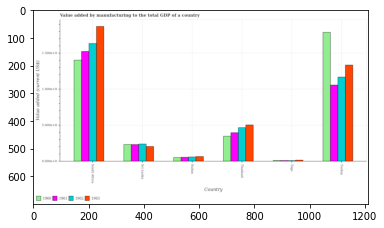

Number of QA =  30





,Country,1963,1962,1961,1960
0,Turkey,1.333359,1.168768,1.068045,1.786637
1,Sudan,0.072321,0.064879,0.061442,0.057177
2,Thailand,0.504431,0.471359,0.405044,0.354226
3,Sri Lanka,0.210761,0.248212,0.237535,0.235448
4,South Africa,1.868496,1.639889,1.541331,1.407358
5,NaN,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in 1963 in south africa and that in sri lanka ?
PREDICTED =  -0.13150438023588396
EXPECTED =  1666215492.4800582




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in 1963 in thailand and the value added by manufacturing to the total gdp in 1960 in south africa?
PREDICTED =  -1.364065068021997
EXPECTED =  -899311495.81319




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp of/in 1961 and value added by man

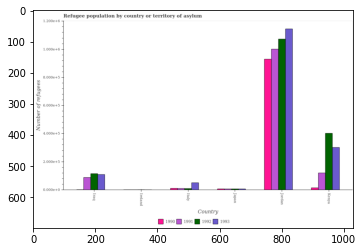

Number of QA =  30





,Country,1992,1993,1990,1991
0,Ireland,NaN,NaN,NaN,NaN
1,Jordan,1.072265,1.139722,0.928581,1.003336
2,Kenya,0.405373,0.302376,0.018859,0.122895
3,Japan,NaN,NaN,NaN,NaN
4,Iraq,0.118005,0.112615,NaN,0.090849
5,Italy,0.013141,0.055202,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in 1992 in japan and that in jordan ?
PREDICTED =  0.0
EXPECTED =  -1066338.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in 1990 in italy and the number of refugees in 1992 in ireland?
PREDICTED =  0.0
EXPECTED =  10340.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees of/in 1990 and number of refugees of/in 1991 in kenya?
PREDICTED =  1.8771046819534454
EXPECTED =  -105914.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

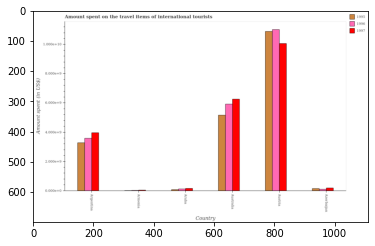

Number of QA =  29





,Country,1996,1997,1995
0,Armenia,NaN,NaN,NaN
1,Aruba,0.593833,0.733174,NaN
2,Austna,38.917118,35.672032,38.393209
3,Argentina,12.779693,14.086881,11.779809
4,Azerbaijan,0.545818,0.812770,0.692828
5,Australia,20.909580,22.070623,18.252044


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of international tourists in 1996 in austria and that in azerbaijan ?
PREDICTED =  0.4541816227799944
EXPECTED =  10915000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of international tourists in 1995 in armenia and the amount spent on the travel items of international tourists in 1997 in austria?
PREDICTED =  0.0
EXPECTED =  -10059000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of international tourists of/in 1995 and 

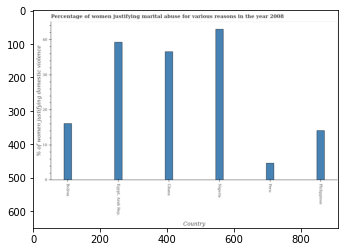

Number of QA =  22





,Country,% of women justifying domestic violence
0,Peru,4.933400
1,Ghana,36.644728
2,Bolivia,16.185842
3,Philippines,14.203698
4,"Egypt, Arab Rep.",39.333858
5,Nigeria,43.013534


> what is the title of the graph ?
PREDICTED =  Percentage of women justifying marital abuse for various reasons in the year 2008
EXPECTED =  Percentage of women justifying marital abuse for various reasons in the year 2008




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of women justifying domestic violence
EXPECTED =  % of women justifying domestic violence




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying marital abuse in nigeria and philippines ?
PREDICTED =  28.809836461129898
EXPECTED =  28.9




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median p

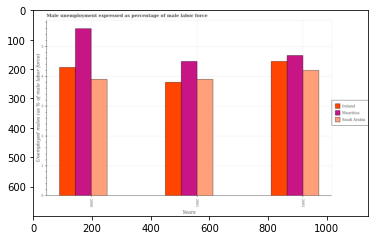

Number of QA =  29





,Years,Mauritius,Saudi Arabia,Ireland
0,2000,5.630014,3.936676,4.329212
1,2002,4.712299,4.243777,4.530271
2,2001,4.543549,3.938663,3.827413


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in mauritius in 2000 and that in 2002 ?
PREDICTED =  0.9177150130900458
EXPECTED =  0.9000000953674334




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in ireland in 2001 and the unemployment in males in in mauritius in 2002?
PREDICTED =  -0.7028579403122936
EXPECTED =  -0.8999998569488574




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the unemployment in males in in saudi arabia and unemployment in males in in mauritius ?
PREDICTED =  0.0
EXPECTED =  -0.5999999046325701


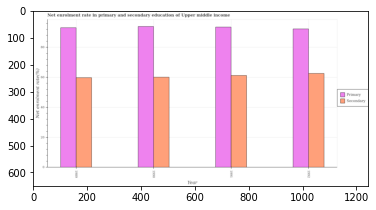

Number of QA =  28





,Year,Secondary,Primary
0,1992,62.958377,92.043114
1,1990,60.070113,93.853039
2,1991,61.555585,93.595833
3,1989,59.872533,93.131331


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in 1990 and that in 1991 ?
PREDICTED =  0.25720615811154346
EXPECTED =  0.3853302001953125




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in 1990 and the enrollment rate in secondary education in 1992?
PREDICTED =  1.8099247942448358
EXPECTED =  1.6253509521483949




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the enrollment rate in primary education and enrollment rate in secondary education ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 3 = 0.

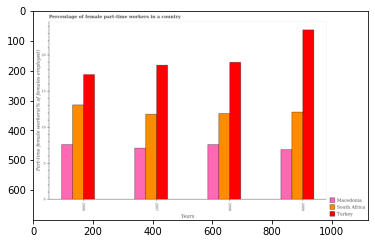

Number of QA =  29





,Years,Turkey,South Africa,Macedonia
0,2006,17.264182,13.299762,7.612668
1,2007,18.627482,11.802966,7.170509
2,2009,23.507722,12.129776,6.971889
3,2008,19.078569,11.870027,7.585376


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in macedonia in 2006 and that in 2008 ?
PREDICTED =  0.027292028230281318
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in south africa in 2009 and the percentage of female part-time workers in turkey in 2006?
PREDICTED =  -1.169986153003455
EXPECTED =  -5.199998855590801




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of female part-time workers in turkey and percentage of female part-time workers in macedonia 

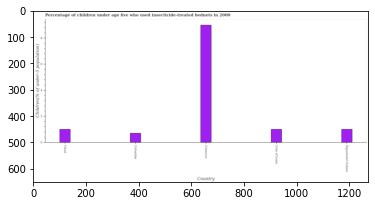

Number of QA =  22





,Country,Children(% of under-5 population)
0,Equatorial Guinea,1.053841
1,Cote d'Ivoire,1.053063
2,Comoros,9.097408
3,Chad,1.051050
4,Colombia,0.758239


> what is the title of the graph ?
PREDICTED =  Percentage of children under age five who used insecticide-treated bednets in 2000
EXPECTED =  Percentage of children under age five who used insecticide-treated bednets in 2000




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Children(% of under-5 population)
EXPECTED =  Children(% of under-5 population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who use of insecticide-treated bed nets in comoros and cote d'ivoire ?
PREDICTED =  8.044345749553267
EXPECTED =  8.0




				 4 / 4 = 1.0


> what is the median percentage of children who use of insecticide-treated bed nets ?
PREDICTED =  None
EXPECTED =  1.0




				 4 / 6 = 0.6667


i

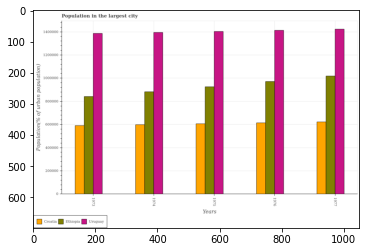

Number of QA =  29





,Years,Uruguay,Croatia,Ethiopia
0,1977,1.444522e+06,632594.841453,1.031024e+06
1,1974,1.406013e+06,601757.260268,8.947670e+05
2,1976,1.432482e+06,622391.921113,9.825600e+05
3,1973,1.393103e+06,600371.301563,8.536595e+05
4,1975,1.423669e+06,614046.297661,9.327206e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city in ethiopia in 1975 and that in 1976 ?
PREDICTED =  -49839.39189576509
EXPECTED =  -45306




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city in ethiopia in 1973 and the population in the largest city in croatia in 1974?
PREDICTED =  -41107.50548242917
EXPECTED =  242841




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the population in the largest city in ethiopia and population in the largest city in croatia ?
PREDICTED =  398429.13058935653
EXPECTED =  356531




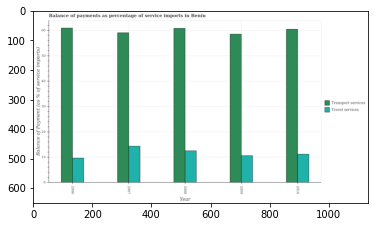

Number of QA =  28





,Year,Travel services,Transport services
0,2007,14.436227,58.587415
1,2010,11.283310,60.229497
2,2009,10.748094,58.201654
3,2006,9.707891,60.680987
4,2008,12.560270,60.531018


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2007 and that in 2008 ?
PREDICTED =  1.8759573930715572
EXPECTED =  1.8097151636800994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2006 and the balance of payments of transport services in 2007?
PREDICTED =  -4.72833625135107
EXPECTED =  -4.70396770862939




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments of transport services and balance of payments of travel services ?
PREDICTED =  -240.02891730758478
EXPECTED =

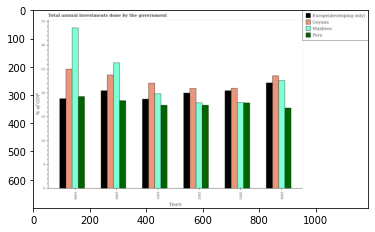

Number of QA =  30





,Years,Furope(developing only),Peru,Maldives,Guyana
0,2002,20.210495,17.624534,18.153485,21.109422
1,2003,20.602991,18.067967,18.134647,21.127540
2,2001,18.858945,17.544143,20.074276,22.247376
3,1999,18.889038,19.305573,33.893318,25.186110
4,2000,20.823304,18.577874,27.051837,23.867675
5,2004,22.310542,16.870129,22.982592,23.787285


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in peru in 2000 and that in 2001 ?
PREDICTED =  1.0337312734804307
EXPECTED =  0.9608215050845921




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in maldives in 2000 and the total annual investments done by the government in guyana in 2004?
PREDICTED =  4.069245649232268
EXPECTED =  2.720536995537401




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the total annual investments done by the government in peru and total annual inv

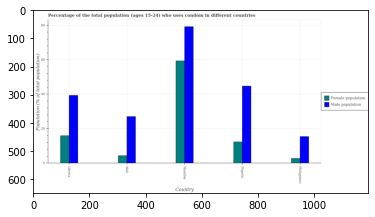

Number of QA =  28





,Country,Female population,Male population
0,Namibia,60.032343,79.569091
1,Nigeria,12.666113,45.195507
2,Liberia,16.348129,39.507665
3,Philippines,3.079692,15.887244
4,Mali,4.673842,27.358481


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male population in liberia and that in mali ?
PREDICTED =  12.149183242392166
EXPECTED =  12.299999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in liberia and the male population in mali?
PREDICTED =  11.674287355743402
EXPECTED =  -11.1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population and male population in liberia ?
PREDICTED =  43.68421437123649
EXPECTED =  -23.4




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

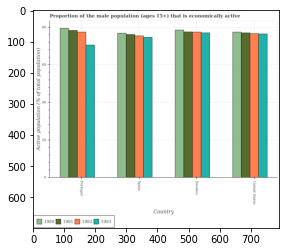

Number of QA =  30





,Country,1982,1980,1983,1981
0,NaN,76.171578,77.634823,75.374700,76.948944
1,Portugal,78.162588,80.535057,70.961498,79.350720
2,United States,NaN,78.293458,77.451984,77.963622
3,Sweden,NaN,79.269281,77.630996,78.529072


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in 1981 in portugal and that in sweden ?
PREDICTED =  0.8216476533481796
EXPECTED =  0.8000030517577983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economically active in 1982 in portugal and the proportion of the male population that is economically active in 1983 in united states?
PREDICTED =  78.16258768063702
EXPECTED =  1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male population that is economicall

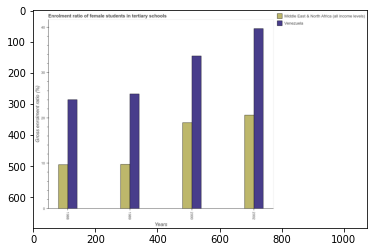

Number of QA =  28





,Years,Middle East & North Africa (all income levels),Venezuela
0,1988,9.827827,24.305691
1,2002,20.730358,40.125082
2,2000,19.152467,34.128902
3,1989,9.960261,25.529653


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of female students in tertiary schools in venezuela in 2002 ?
PREDICTED =  10.031270515740612
EXPECTED =  39.6943893432617




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of female students in tertiary schools in venezuela ?
PREDICTED =  10.031270515740612
EXPECTED =  39.6943893432617




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of female students in tertiary schools in venezuela ?
PREDICTED =  497.0
EXPECTED =  24.01425




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


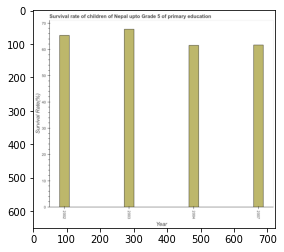

Number of QA =  23





,Year,Survival Rate(%)
0,2003,68.642466
1,2002,66.195517
2,2007,62.154928
3,2004,62.015951


> what is the title of the graph ?
PREDICTED =  Survival rate of children of Nepal upto Grade 5 of primary education
EXPECTED =  Survival rate of children of Nepal upto Grade 5 of primary education




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Survival Rate(%)
EXPECTED =  Survival Rate(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate in 2003 and 2004 ?
PREDICTED =  6.626515107733006
EXPECTED =  6.129




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median survival rate ?
PREDICTED =  64.17522234194675
EXPECTED =  63.514488220214844




				 4 / 5 = 0.8


is_built_with_cuda

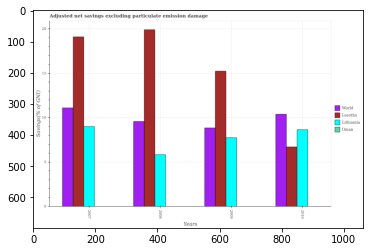

Number of QA =  27





,Years,Lesotho,Oman,Lithuania,World
0,2009,15.241243,NaN,7.777140,8.904319
1,2008,19.991012,NaN,5.883002,9.587193
2,2007,19.059011,NaN,9.046008,11.091454
3,2010,6.726559,NaN,8.679342,10.419025


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in lesotho in 2008 and that in 2009 ?
PREDICTED =  4.749769327563259
EXPECTED =  4.6619636759412




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in world in 2008 and the adjusted net savings in lesotho in 2010?
PREDICTED =  -0.8318323762291264
EXPECTED =  2.8639874483462293




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the adjusted net savings in lithuania and adjusted net savings in world ?
PREDICTED =  -8.616497831355737
EXPECTED =  -2.106435512229341




				 1 / 3 = 0.3333


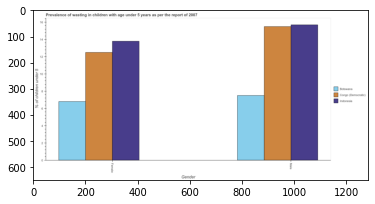

Number of QA =  23





,Gender,Congo (Democratic:,Botswana,Indonesia
0,Female,12.599796,6.958952,13.885221
1,Male,15.667621,7.619935,15.761000


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in botswana and that in indonesia ?
PREDICTED =  -6.926269076451822
EXPECTED =  -7.00000000000004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children in indonesia and the percentage of undernourished female children in congo (democratic)?
PREDICTED =  1.2854250557283056
EXPECTED =  3.1999998092650994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

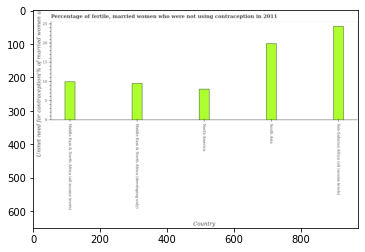

Number of QA =  22





,Country,Unmet need for contraception(% of married women a.
0,North America,8.086555
1,South Asia,20.005316
2,Sub-Saharan Africa (all income levels),24.522449
3,Middle East & North Africa (developing only),9.617511
4,Middle East & North Africa (all income levels),10.054119


> what is the title of the graph ?
PREDICTED =  Percentage of fertile, married women who were not using contraception in 2011
EXPECTED =  Percentage of fertile, married women who were not using contraception in 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unmet need for contraception(% of married women a.
EXPECTED =   Unmet need for contraception(% of married women ages 15-49)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of married women who are not using contraception in north america and sub-saharan africa (all income levels) ?
PREDICTED =  2.0
EXPECTED =  -16.34




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

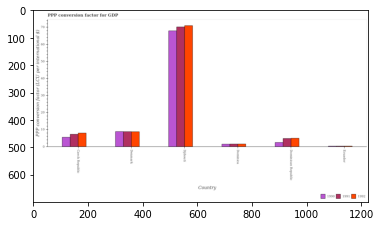

Number of QA =  29





,Country,1992,1990,1991
0,Dominican Republic,5.127936,2.635995,4.965728
1,Czech Republic,8.147907,5.626586,7.433100
2,Djibou ti,70.253854,66.793006,69.319538
3,Denmark,8.812508,8.905930,8.807660
4,Dominica,1.777033,1.725892,1.786675
5,Ecuador,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1991 in denmark and that in ecuador ?
PREDICTED =  8.807660089973686
EXPECTED =  8.46937090427706




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1991 in ecuador and the ppp conversion factor for gdp in 1990 in djibouti?
PREDICTED =  -69.31953778204803
EXPECTED =  -67.60034945494046




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp of/in 1991 and ppp conversion factor for gdp of/in 1992 in dominican republic?
PREDICTED =  64.19160136865442
EX

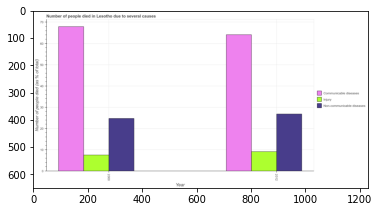

Number of QA =  25





,Year,Injury,Non-communicable diseases,Communicable diseases
0,2012,9.257437,26.961049,63.545551
1,2000,7.721253,24.680762,67.242967


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who dies of non-communicable diseases in 2000 and that in 2012 ?
PREDICTED =  -19.239795492461738
EXPECTED =  -2.1000000000000014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who died of communicable diseases in 2000 and the number of people who died of injury in 2012?
PREDICTED =  -38.86478921229775
EXPECTED =  3.8000000000000114




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of people who died of communicable diseases and number of people who dies of non-communicable dis

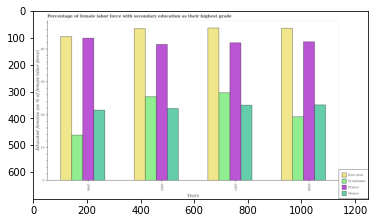

Number of QA =  30





,Years,Mexico,France,E] Salvador,Euro area
0,2008,23.249193,42.227347,19.599443,46.531929
1,2005,22.129823,41.649368,25.722312,46.558671
2,2007,23.224653,42.184004,26.901724,46.758780
3,1996,21.689087,43.719707,14.148712,44.172420


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with secondary education in mexico in 2007 and that in 2008 ?
PREDICTED =  -0.024540792466112293
EXPECTED =  -0.10000038146969104




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with secondary education in euro area in 2007 and the percentage of female labor force with secondary education in el salvador in 2005?
PREDICTED =  0.20010945118352197
EXPECTED =  20.8966376621171




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of female labor force

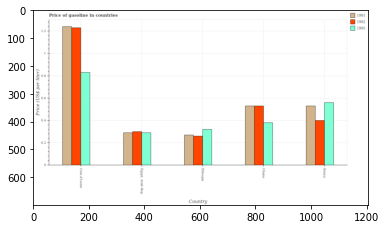

Number of QA =  29





,Country,1992,1995,1991
0,"Egypt, Arab Rep.",0.306694,0.293081,0.297182
1,Cote d'Ivoire,1.236397,0.834809,1.250470
2,Kenya,0.400021,0.565440,0.532212
3,Ethiopia,0.265402,0.324547,0.278550
4,Ghana,0.531558,0.383827,0.532079


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in 1991 in egypt, arab rep. and that in ghana ?
PREDICTED =  -0.532079159021716
EXPECTED =  -0.24000000000000005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in 1995 in cote d'ivoire and the price of gasoline in 1992 in kenya?
PREDICTED =  0.26936863048129545
EXPECTED =  0.42999999999999994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline of/in 1992 and price of gasoline of/in 1995 in ethiopia?
PREDICTED =  -0.05914497683594899
EXPECTED =  -0.06




				 1 / 3 = 0.3333


is_built

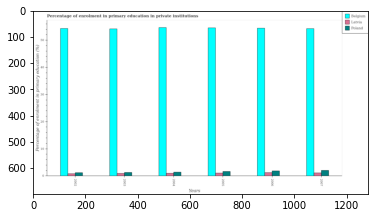

Number of QA =  29





,Years,Latvia,Belgium,Poland
0,2007,1.323491,54.498139,2.248348
1,2003,1.134229,54.386152,1.451361
2,2004,1.180726,54.828417,1.568185
3,2005,1.274020,54.706957,1.842885
4,2006,1.418316,54.564767,2.074368
5,2002,0.987094,54.416973,1.397865


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of enrolment in primary education in poland in 2003 and that in 2005 ?
PREDICTED =  -0.3915241245429797
EXPECTED =  -0.3534899950027499




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of enrolment in primary education in latvia in 2007 and the percentage of enrolment in primary education in belgium in 2003?
PREDICTED =  -53.06266065252212
EXPECTED =  -53.05265903472901




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of enrolment in primary education in belgium and percentage of enrolm

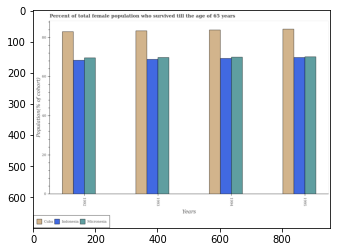

Number of QA =  29





,Years,Micronesia,Cuba,Indonesia
0,1993,70.342307,84.519549,69.742393
1,1995,70.761428,85.182024,70.512500
2,1994,70.525843,84.843864,70.018902
3,1992,70.092041,83.887065,68.814583


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female population who survived till the age of 65 years in cuba in 1992 and that in 1994 ?
PREDICTED =  -0.9567990196311769
EXPECTED =  -0.8783999999999992




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female population who survived till the age of 65 years in cuba in 1992 and the percentage of total female population who survived till the age of 65 years in micronesia in 1994?
PREDICTED =  -0.9567990196311769
EXPECTED =  13.002890000000008




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference

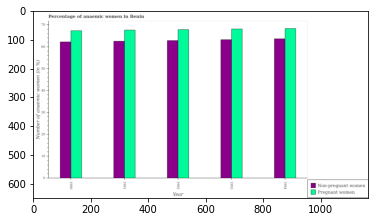

Number of QA =  28





,Year,Pregnant womer,Non-pregnant women
0,1992,67.249779,62.051976
1,1994,67.617250,63.023179
2,1991,67.171804,61.833644
3,1990,66.657521,61.658444
4,1993,67.435640,62.739496


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in 1992 and that in 1993 ?
PREDICTED =  -0.1858612745639192
EXPECTED =  -0.29999999999999716




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of non-pregnant anaemic women in 1992 and the percentage of pregnant anaemic women in 1991?
PREDICTED =  0.21833195899453983
EXPECTED =  0.29999999999999716




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of pregnant anaemic women and percentage of non-pregnant anaemic women ?
PREDICTED =  -61.65844414832996
EXPECTED =  

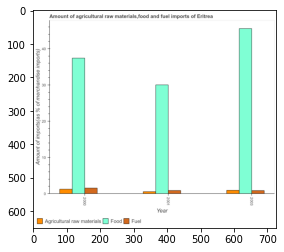

Number of QA =  29





,Year,Agricultural raw materials,Fuel,Food
0,2003,1.110041,0.999043,45.779188
1,2000,1.408805,1.740724,37.678585
2,2001,0.765158,1.050048,30.323724


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in 2001 and that in 2003 ?
PREDICTED =  -15.45546405972637
EXPECTED =  -15.5347221981593




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials imports in 2000 and the percentage of fuel imports in 2003?
PREDICTED =  0.29876455563129123
EXPECTED =  0.3143596983102691




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of raw materials imports and percentage of fuel imports ?
PREDICTED =  0.31413738016725334
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_

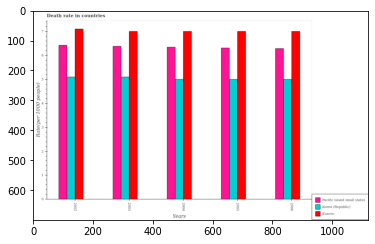

Number of QA =  29





,Years,Korea (Republic),Pacific island small states,Kosovo
0,2002,5.049260,6.480612,7.126058
1,2004,5.011250,6.333430,7.017743
2,2006,5.014912,6.287047,7.114006
3,2003,5.108823,6.431164,6.978168
4,2005,5.024803,6.306319,6.983513


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in pacific island small states in 2002 and that in 2003 ?
PREDICTED =  0.04944794337884684
EXPECTED =  0.044925219229948965




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in kosovo in 2003 and the death rate in korea (republic) in 2005?
PREDICTED =  -0.005345664439695419
EXPECTED =  2.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the death rate in pacific island small states and death rate in kosovo ?
PREDICTED =  -3.3809156419485156
EXPECTED =  -0.67714227582794




				 0 / 3 = 0.0


is_built

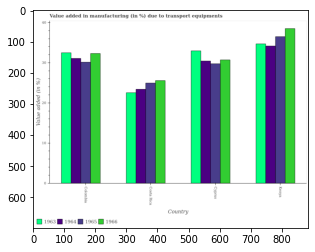

Number of QA =  30





,Country,1963,1966,1964,1965
0,Kenya,34.738953,38.640962,34.232914,36.810691
1,Costa Rica,22.521856,25.672630,23.583464,24.892068
2,NaN,33.001531,30.807950,30.542604,29.920373
3,Colombia,32.526578,32.435402,31.243897,30.245403


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in 1964 in colombia and that in cyprus ?
PREDICTED =  30.24389701874255
EXPECTED =  0.6561156704915092




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in 1963 in costa rica and the percentage of value added in manufacturing due to transport equipments in 1965 in kenya?
PREDICTED =  -14.288835821421358
EXPECTED =  -13.9696036903648




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of val

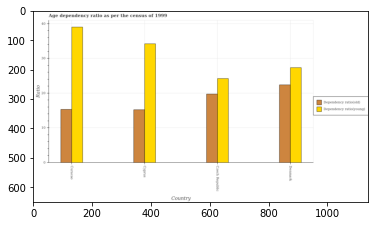

Number of QA =  28





,Country,Dependency ratio{old),Dependency ratio{young)
0,Denmark,22.597867,27.586175
1,Curacao,15.529465,39.507941
2,Czech Republic,20.097518,24.389571
3,NaN,15.421670,34.470723


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in curacao ?
PREDICTED =  13.169313747726678
EXPECTED =  39.02738725175461




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum age dependency ratio(young) ?
PREDICTED =  13.169313747726678
EXPECTED =  39.02738725175461




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum age dependency ratio(young) ?
PREDICTED =  8.129856946927324
EXPECTED =  24.2038114924818




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4

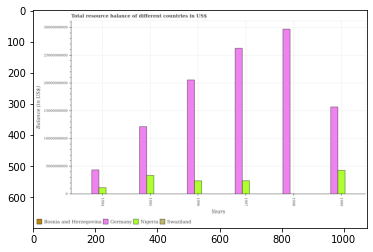

Number of QA =  27





,Years,Bosnia and Herzegovina,Germany,Nigeria,Swaziland
0,1995,NaN,1.216102e+10,3.441493e+09,NaN
1,1999,NaN,1.565431e+10,4.332644e+09,NaN
2,1994,NaN,4.405773e+09,1.234391e+09,NaN
3,1997,NaN,2.600893e+10,2.470107e+09,NaN
4,1998,NaN,2.960057e+10,NaN,NaN
5,1996,NaN,2.043887e+10,2.452534e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in nigeria in 1994 and that in 1997 ?
PREDICTED =  -1235716326.564424
EXPECTED =  -1254690157.5559




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in bosnia and herzegovina in 1998 and the total resource balance in germany in 1999?
PREDICTED =  -45254882508.229095
EXPECTED =  -15686128276.156




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the total resource balance in nigeria and total resource balance in germany ?
PREDICTED =  4332644389.837324
EXPECTED =  -18167648764.2319

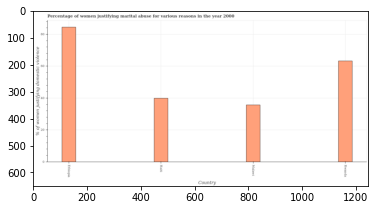

Number of QA =  22





,Country,% of women justifying domestic violence
0,Malawi,36.344322
1,Ethiopia,84.776462
2,Haiti,40.673930
3,Rwanda,64.038196


> what is the title of the graph ?
PREDICTED =  Percentage of women justifying marital abuse for various reasons in the year 2000
EXPECTED =  Percentage of women justifying marital abuse for various reasons in the year 2000




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of women justifying domestic violence
EXPECTED =  % of women justifying domestic violence




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying marital abuse in malawi and rwanda ?
PREDICTED =  -27.69387382824558
EXPECTED =  -27.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percen

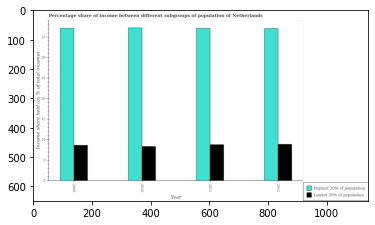

Number of QA =  28





,Year,Lowest 20% of population,Highest 20% of population
0,2011,8.920012,37.764990
1,2010,8.450323,37.647332
2,2012,9.040741,37.720550
3,2009,8.682915,37.579729


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in 2011 and that in 2012 ?
PREDICTED =  0.044439791497104864
EXPECTED =  -0.08000000000000007




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the income share held by highest 20% of the population and income share held by lowest 20% of the population ?
PREDICTED =  0.044439791497104864
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

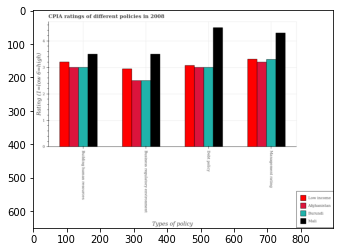

Number of QA =  29





,Types of policy,Mali,Burundi,Low income,Afghanistan
0,Management rating,4.290637,3.310769,3.319467,3.188919
1,Debt policy,4.499936,2.996101,3.074639,2.999243
2,Building human resources,3.479663,3.001991,3.206720,2.996990
3,Business regulatory environment,NaN,2.503620,2.945400,2.477771


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of business regulatory environment in low income and that in mali ?
PREDICTED =  0.0
EXPECTED =  -0.5555555555555598




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of business regulatory environment in low income and the cpia rating of debt policy in mali?
PREDICTED =  nan
EXPECTED =  -1.5555555555555598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of building human resources and cpia rating of management in low income ?
PREDICTED =  -2.2067196036993284
EXPECTED =  -0.10740740740740984




				 

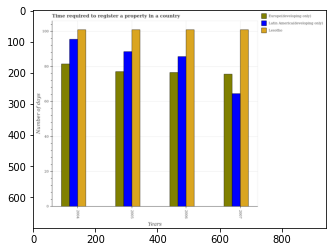

Number of QA =  29





,Years,Lesotho,Latin America(developing only},Europe(developing only)
0,2005,100.845794,89.162601,77.424308
1,2004,101.257061,95.177937,81.453923
2,2006,101.143340,85.629047,76.632162
3,2007,100.825147,64.365800,75.756088


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register a property in latin america(developing only) in 2005 and that in 2007 ?
PREDICTED =  0.0
EXPECTED =  24.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register a property in latin america(developing only) in 2006 and the number of days required to register a property in lesotho in 2004?
PREDICTED =  -2.0
EXPECTED =  -15.3333333333333




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the number of days required to register a property in latin america(developi

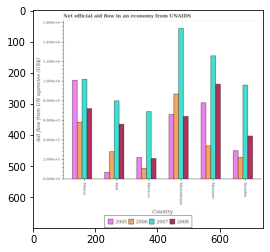

Number of QA =  30





,Country,2007,2005,2008,2006
0,Morocco,0.693885,0.223731,0.214204,0.112205
1,Malawi,1.016572,1.015165,0.740074,0.582284
2,Mozambique,1.544359,0.662705,0.638082,0.868551
3,Myanmar,1.260748,0.780884,0.974487,0.342810
4,Mali,0.811119,0.074915,0.555117,0.285269
5,Namibia,0.961591,0.292064,0.444454,0.226152


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 2006 in morocco and that in mozambique ?
PREDICTED =  -0.7563458948526337
EXPECTED =  -760000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 2005 in myanmar and the net official aid flow in 2008 in namibia?
PREDICTED =  0.48881974359038033
EXPECTED =  340000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow of/in 2005 and net official aid flow of/in 2007 in mozambique?
PREDICTED =  1.505106680235903
EXPECTED =  -880000.0




				 0 / 3 = 0.0


is_built_with_cud

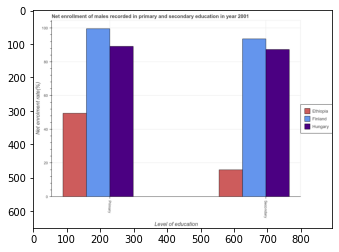

Number of QA =  23





,Level of education,Finland,Hungary,Ethiopia
0,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in ethiopia and that in hungary ?
PREDICTED =  0.0
EXPECTED =  -39.70996093749999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in finland and the enrollment rate in secondary education in hungary?
PREDICTED =  0.0
EXPECTED =  12.31963348388669




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between 

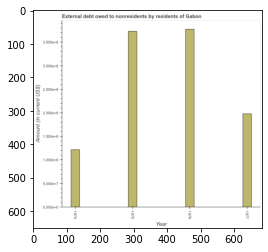

Number of QA =  23





,Year,Amount (in current US$)
0,1975,3.704374
1,1977,1.962196
2,1974,1.219116
3,1976,3.757739


> what is the title of the graph ?
PREDICTED =  External debt owed to nonresidents by residents of Gabon
EXPECTED =  External debt owed to nonresidents by residents of Gabon




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount (in current US$)
EXPECTED =  Amount (in current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt in 1975 and 1977 ?
PREDICTED =  1.7421789139152704
EXPECTED =  175051000.0




				 3 / 4 = 0.75


> what is the median debt ?
PREDICTED =  None
EXPECTED =  285476500.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the debt in 1974 to that in 1976 ?
P

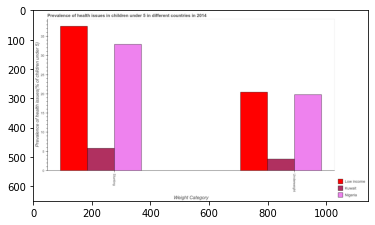

Number of QA =  23





,Weight Category,Low income,Nigeria,Kuwait
0,Stunting,37.813965,33.097592,5.961495
1,Underweight,20.606759,19.950014,3.125624


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweight children in low income and that in nigeria ?
PREDICTED =  0.656744569344152
EXPECTED =  0.6374421629395002




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of underweight children in nigeria and the percentage of stunted children in low income?
PREDICTED =  -0.656744569344152
EXPECTED =  -17.823987732939496




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted children and percentage of underweight children in low income ?
PREDICTED =  12.490832878843246
EXPECTED =  17.18654556999999

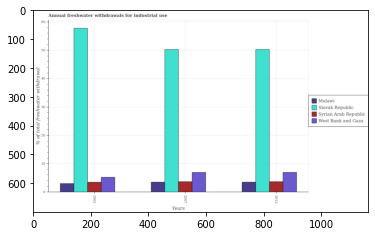

Number of QA =  30





,Years,Malawi,Syrian Arab Republic,West Bank and Gaza,Slovak Republic
0,2007,3.647180,3.864085,7.123172,50.086065
1,2002,3.130263,3.665714,5.398216,58.494652
2,2013,3.669665,3.872660,7.155447,50.638881


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual withdrawals from freshwater in west bank and gaza in 2002 and that in 2007 ?
PREDICTED =  1.0
EXPECTED =  -1.705




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual withdrawals from freshwater in west bank and gaza in 2007 and the total annual withdrawals from freshwater in syrian arab republic in 2013?
PREDICTED =  -4.736745230148506
EXPECTED =  3.2659999999999996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the total annual withdrawals from freshwater in slovak republic and total annual withdra

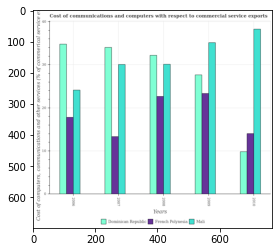

Number of QA =  29





,Years,Mali,Dominican Republic,French Polynesia
0,2009,35.305764,28.012926,23.418141
1,2006,24.343729,35.109849,17.892632
2,2007,29.954913,34.274468,13.491630
3,2010,38.578641,9.935195,14.159788
4,2008,30.435380,32.579246,22.720839


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in mali in 2009 and that in 2010 ?
PREDICTED =  -28.64344567023705
EXPECTED =  -3.141621853246896




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in mali in 2007 and the cost of communications and computers in french polynesia in 2010?
PREDICTED =  -28.64344567023705
EXPECTED =  16.0388444450639




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cost of communications and computers in french polynesia and cost of communications and computers in ma

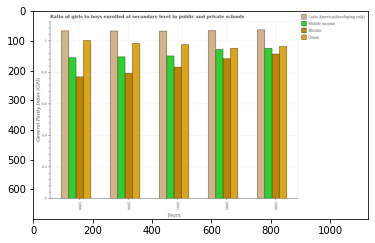

Number of QA =  30





,Years,Latin America(developing only),Oman,Bhutan,Middle income
0,2000,1.069583,0.988685,0.799180,0.903606
1,2005,1.075895,0.955443,0.896257,0.954790
2,2001,1.066261,0.982730,0.840578,0.915531
3,1999,1.071809,1.000008,0.782080,0.901719
4,2006,1.078996,0.970021,0.916666,0.958213


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in middle income in 1999 and that in 2006 ?
PREDICTED =  -0.05649330376452477
EXPECTED =  -0.05900001525878895




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in middle income in 2000 and the general parity index in latin america(developing only) in 2005?
PREDICTED =  -1.0963938077076483
EXPECTED =  -0.1661900281906149




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the general parity index in middle income and general parity index in latin america(developing only) ?
PREDICTED = 

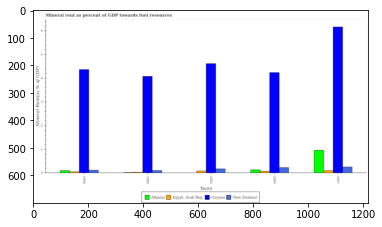

Number of QA =  30





,Years,"Egypt, Arab Rep.",Guyana,New Zealand,Albania
0,1998,0.071855,4.393106,0.135823,0.119752
1,1999,NaN,4.097562,0.123772,NaN
2,2006,0.095983,4.268262,0.246520,0.147991
3,2005,0.105983,4.639299,0.194454,NaN
4,2007,0.121191,6.187387,0.270671,0.980391


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in egypt, arab rep. in 2006 and that in 2007 ?
PREDICTED =  -0.020207856707795957
EXPECTED =  -0.024642399271575396




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in guyana in 2007 and the mineral rent in new zealand in 1999?
PREDICTED =  2.0898245467215624
EXPECTED =  6.061588853870299




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the mineral rent in new zealand and mineral rent in egypt, arab rep. ?
PREDICTED =  0.6974194525051759
EXPECTED =  0.07158924284682139




				 0 / 3 = 0.0


is_bu

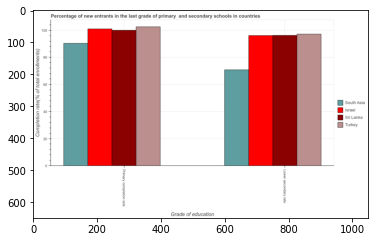

Number of QA =  23





,Grade of education,Israel,Turkey,South Asia,Sri Lanka
0,Primary completion rate,101.667334,103.680762,91.341160,101.167961
1,Lower secondary rate,96.860018,98.341358,72.167965,97.365725


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools in sri lanka and that in south asia ?
PREDICTED =  -89.34115972511023
EXPECTED =  25.43685913085939




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools in south asia and the completion rate in primary schools in sri lanka?
PREDICTED =  0.0
EXPECTED =  -29.20867156982409




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in primary schools and completion rate in secondary schools in turkey ?
PREDICTED =  -102.68076248512446
EXPECTED =  5.353958129882486


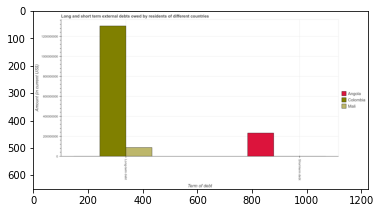

Number of QA =  17





,Term of debt,Angola,Mali,Colombia
0,Longtenm debdt,NaN,9.442133e+07,1.310594e+09
1,Short-term debt,2.387390e+08,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in colombia and the short-term debts owed by residents in mali?
PREDICTED =  nan
EXPECTED =  1302998000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Amount (in current US$)
EXPECTED =  200000000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Long and short term external debts owed by residents of different countries
EXPECTED =  Long and short term external debts owed by residents of different countries




				 1 / 4 = 0.25


> what is the label or title of the x-axis ?
PREDICTED =  Term of debt
EXPECTED =  Term of debt




				 2 / 5 = 0.4



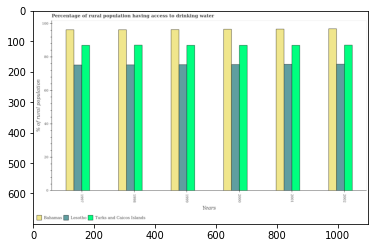

Number of QA =  29





,Years,Lesotho,Bahamas,Turks and Caicos Islands
0,2000,76.049419,97.130692,87.619009
1,1997,75.633791,97.349721,87.528758
2,1998,76.056851,96.934878,87.923784
3,2001,76.427866,97.382324,87.824473
4,1999,76.095026,98.024668,87.862664
5,2002,76.270528,97.638443,88.024953


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to drinking water in bahamas in 1997 and that in 2001 ?
PREDICTED =  -0.032603772844851164
EXPECTED =  -0.4000000000000057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to drinking water in bahamas in 2000 and the percentage of rural population having access to drinking water in turks and caicos islands in 1998?
PREDICTED =  0.19581384716551042
EXPECTED =  9.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of rural

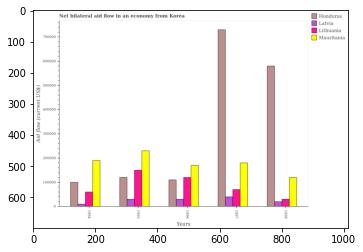

Number of QA =  30





,Years,Honduras,Latvia,Mauritania,Lithuania
0,1995,121385.150802,32045.218311,230809.937976,151401.923584
1,1997,724415.722681,41827.953816,183051.770894,71406.676165
2,1994,102145.090918,12265.568466,192491.507594,61861.960569
3,1996,111033.356204,32213.278345,172638.458506,121976.253117
4,1998,578476.883635,21905.413859,122097.178174,31946.101975


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in lithuania in 1996 and that in 1997 ?
PREDICTED =  50569.576951856114
EXPECTED =  50000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in mauritania in 1997 and the net bilateral aid flow in honduras in 1998?
PREDICTED =  60954.592719209424
EXPECTED =  -400000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the net bilateral aid flow in lithuania and net bilateral aid flow in mauritania ?
PREDICTED =  151396.92358388414
EXPECTED =  -130000.0




				 1 / 3 = 0.3333


i

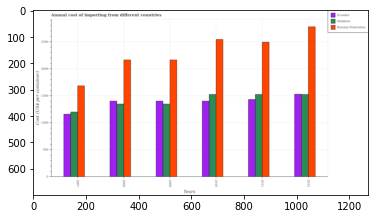

Number of QA =  29





,Years,Russian Federation,Maldives,Ecuador
0,2008,2173.037680,1355.878459,1412.379259
1,2009,2207.989405,1355.125925,1410.842635
2,2011,2498.501904,1538.647118,1440.695012
3,2010,2544.483784,1538.825980,1410.556696
4,2007,1692.582582,1204.517495,1167.327309
5,2012,2787.903417,1534.198611,1538.891483


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the total annual cost of importing in russian federation maximum?
PREDICTED =  1.0024912805181863
EXPECTED =  2012




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total total annual cost of importing in russian federation in the graph ?
PREDICTED =  0.0029895366218236174
EXPECTED =  13835.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in maldives in 2007 and that in 2008 ?
PREDICTED =  -151.360964572071
EXPECTED =  -148




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation 

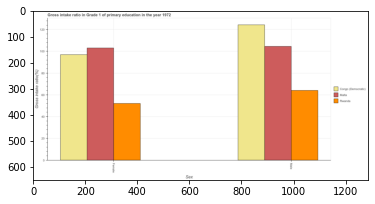

Number of QA =  23





,Sex,Rwanda,Malta,Congo (Democratic)
0,Female,53.084299,103.656495,97.420004
1,Male,64.799628,105.005192,124.607417


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

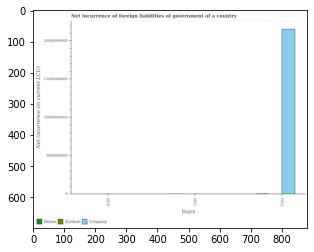

Number of QA =  26





,Years,Uruguay,Belize,Kiribati
0,2011,NaN,NaN,NaN
1,2010,NaN,NaN,NaN
2,2012,2.163854e+10,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in kiribati in 2011 and that in 2012 ?
PREDICTED =  -21638539696.85928
EXPECTED =  10182.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in uruguay in 2010 and the net incurrence of foreign liabilities in belize in 2012?
PREDICTED =  0.0
EXPECTED =  -41315000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_

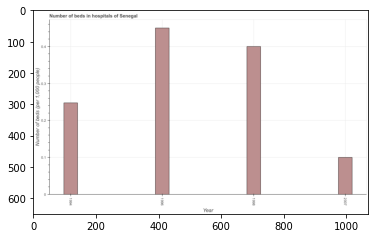

Number of QA =  23





,Year,"Number of beds (per 1,000 people)"
0,1994,0.249419
1,1996,0.449315
2,1998,0.400423
3,2007,0.102597


> what is the title of the graph ?
PREDICTED =  Number of beds in hospitals of Senegal
EXPECTED =  Number of beds in hospitals of Senegal




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of beds (per 1,000 people)
EXPECTED =  Number of beds (per 1,000 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hospital beds in 1996 and 1998 ?
PREDICTED =  0.048892140344043544
EXPECTED =  0.05




				 4 / 4 = 1.0


> what is the median number of hospital beds ?
PREDICTED =  None
EXPECTED =  0.3237500042




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of ho

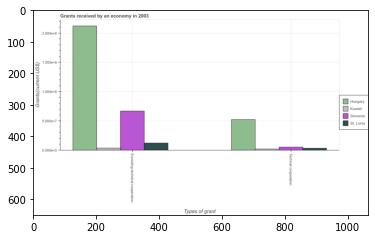

Number of QA =  23





,Types of grant,Slovenia,Hungary,St. Lucia,Kuwait
0,Techinal cooperation,0.062375,0.538651,NaN,NaN
1,Excluding technical cooperation,0.683165,2.155244,0.131153,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount of grants received(excluding technical cooperation) in slovenia ?
PREDICTED =  1.0
EXPECTED =  66860000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum amount of grants received(excluding technical cooperation) ?
PREDICTED =  0.5
EXPECTED =  212150000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum amount of grants received(including technical cooperation) ?
PREDICTED =  1.0
EXPECTED =  1960000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

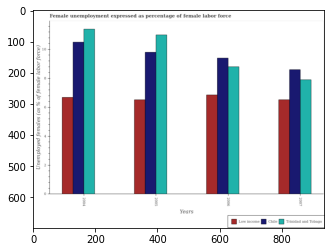

Number of QA =  29





,Years,Low income,Chile,Trinidad and Tobago
0,2005,6.490807,9.794329,10.969690
1,2006,6.831796,9.387705,8.819817
2,2004,6.676100,10.561018,11.421629
3,2007,6.476405,8.618804,7.908044


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in chile in 2004 and that in 2005 ?
PREDICTED =  0.7666884384096164
EXPECTED =  0.6999998092651403




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in chile in 2006 and the unemployment in females in in low income in 2004?
PREDICTED =  -1.1733124294007773
EXPECTED =  2.717475279800021




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the unemployment in females in in trinidad and tobago and unemployment in females in in chile ?
PREDICTED =  -5.590464132286099
EXPECTED = 

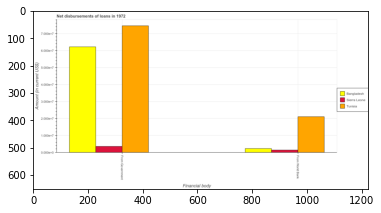

Number of QA =  23





,Financial body,Sierra Leone,Tunisia,Bangladesh
0,From Government,0.379144,7.463348,6.228166
1,From Wortd Bank,0.169878,2.129192,0.250679


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from government in tunisia and that in bangladesh ?
PREDICTED =  1.2351813031135341
EXPECTED =  12398000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from government in tunisia and the net disbursements of loan from world bank in bangladesh?
PREDICTED =  1.2351813031135341
EXPECTED =  72269000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of th

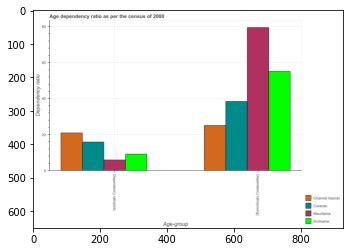

Number of QA =  23





,Age-group,Sunname,Maunitania,Curacao,Channel Islands
0,Dependency ratiofyoung),55.754376,80.089388,39.074640,25.373247
1,Dependency ratio(old),9.536010,6.288835,16.324193,21.259234


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total age dependency ratio(young) in the graph ?
PREDICTED =  2.0
EXPECTED =  198.0

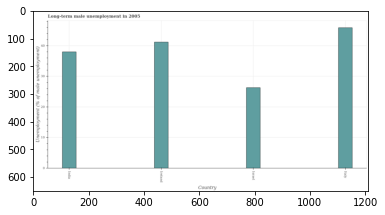

Number of QA =  22





,Country,Unemployment (% of male unemployment)
0,India,38.199644
1,Ireland,41.294849
2,Italy,46.274093
3,Israel,26.531720


> what is the title of the graph ?
PREDICTED =  Long-term male unemployment in 2005
EXPECTED =  Long-term male unemployment in 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployment (% of male unemployment)
EXPECTED =  Unemployment (% of male unemployment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term male unemployment in ireland and italy ?
PREDICTED =  -4.979244160812968
EXPECTED =  -4.7




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term male unemployment ?
PREDICTED =  39.74724637302929
EXPECTED =  39.600000381469755




				 4 / 5 = 0.8


is_b

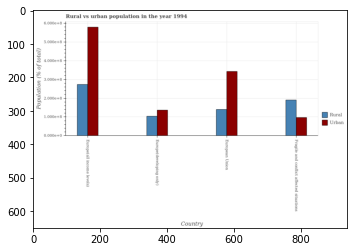

Number of QA =  28





,Country,Urban,Rural
0,European Union,3.423677,1.398429
1,Europe(all income levels),5.801179,2.717909
2,Europe(developing only),1.367559,1.048019
3,Fragile and conflict affected situations,0.986982,1.916824


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population density in europe(developing only) and that in european union ?
PREDICTED =  -0.35041027700724325
EXPECTED =  -36124221




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density in european union and the rural population density in europe(developing only)?
PREDICTED =  2.056118713773519
EXPECTED =  239065746




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population density and urban population density in european union ?
PREDICTED =  -1.5068531483379122
EXPECTED =  -202941525




				 0 / 3 = 0.0

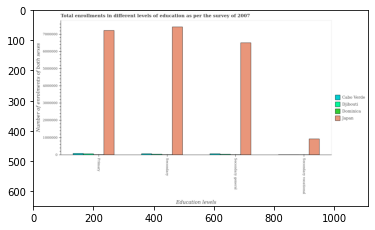

Number of QA =  29





,Education levels,Japan,Dominica,Cabo Verde,Djibouti
0,Primary,7.263985e+06,NaN,121203.089858,NaN
1,Secondary,7.461903e+06,NaN,NaN,NaN
2,Secondary vocational,9.714103e+05,NaN,NaN,NaN
3,Secondary general,6.554028e+06,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary vocational education in japan and that in dominica ?
PREDICTED =  971409.2540371504
EXPECTED =  921916




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education in cabo verde and the number of enrolments in secondary general education in japan?
PREDICTED =  1.0
EXPECTED =  -6444092




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary vocational education and number of enrolments in secondary education in djibouti ?
PREDICTED =  -2.0
EXPECT

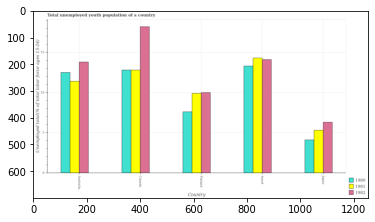

Number of QA =  29





,Country,1982,1980,1981
0,Israel,14.153497,13.310168,14.325312
1,Japan,6.364145,4.172155,5.400232
2,Canada,18.286641,12.822964,12.855931
3,Finland,10.024309,7.669504,10.002947
4,Australia,13.831980,12.524117,11.363018


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth population of a country in 1982 in australia and that in finland ?
PREDICTED =  3.8076719122556035
EXPECTED =  3.8000001907349006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth population of a country in 1980 in japan and the percentage of total unemployed youth population of a country in 1981 in finland?
PREDICTED =  -3.4973492290573844
EXPECTED =  -5.799999713897701




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth populatio

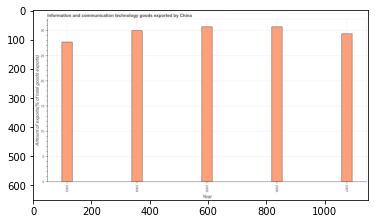

Number of QA =  23





,Year,Amount of exports(% of total goods exports)
0,2006,30.525208
1,2007,29.261374
2,2003,27.622933
3,2004,29.801182
4,2005,30.697501


> what is the title of the graph ?
PREDICTED =  Information and communication technology goods exported by China
EXPECTED =  Information and communication technology goods exported by China




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of exports(% of total goods exports)
EXPECTED =  Amount of exports(% of total goods exports)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods exports in 2006 and 2007 ?
PREDICTED =  1.2638339732764052
EXPECTED =  1.379




				 3 / 4 = 0.75


> what is the median amount of ict goods exports ?
PREDICTED =  None
EXPECTED =  29.956987651




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation

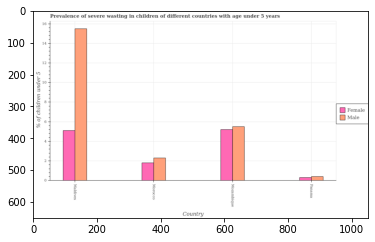

Number of QA =  28





,Country,Female,Male
0,Panama,0.372727,0.469357
1,Morocco,1.890122,2.372546
2,Mozambique,5.291551,5.598439
3,Makdives,5.196583,15.665281


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in morocco and that in mozambique ?
PREDICTED =  -3.4014289084175466
EXPECTED =  -3.399999856948858




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of undernourished female children in maldives to that in panama ?
PREDICTED =  1.0
EXPECTED =  16.999999006589295




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available:

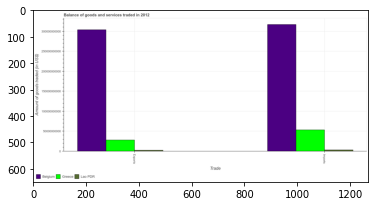

Number of QA =  23





,Trade,Belgium,Greece,Lao PDR
0,Imports,3.198458e+11,5.483499e+10,NaN
1,NaN,3.057513e+11,2.913633e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in lao pdr and that in greece ?
PREDICTED =  -83971324728.93736
EXPECTED =  -25624172514




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported and amount of goods imported in belgium ?
PREDICTED =  -319845838205.1564
EXPECTED =  -13106000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the 

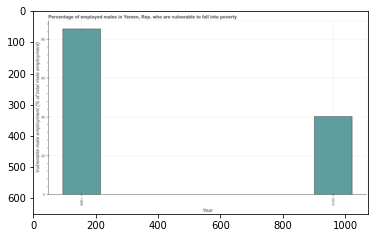

Number of QA =  19





,Year,Vulnerable male employment (% of total male employment)
0,1999,86.383344
1,2010,40.135389


> what is the title of the graph ?
PREDICTED =  Percentage of employed males in Yemen, Rep. who are vulnerable to fall into poverty
EXPECTED =  Percentage of employed males in Yemen, Rep. who are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Vulnerable male employment (% of total male employment)
EXPECTED =  Vulnerable male employment (% of total male employment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are vulnerable to fall into poverty in 1999 and 2010 ?
PREDICTED =  46.24795533008612
EXPECTED =  45.2




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after t

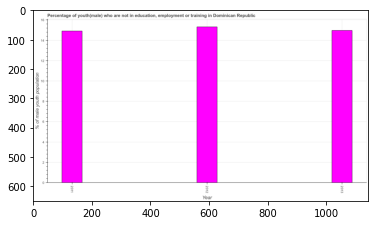

Number of QA =  23





,Year,% of male youth population
0,2012,15.185402
1,2013,14.826727
2,2011,14.726433


> what is the title of the graph ?
PREDICTED =  Percentage of youth(male) who are not in education, employment or training in Dominican Republic
EXPECTED =  Percentage of youth(male) who are not in education, employment or training in Dominican Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of male youth population
EXPECTED =  % of male youth population




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in 2011 and 2013 ?
PREDICTED =  -0.10029364410231878
EXPECTED =  -0.06




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth

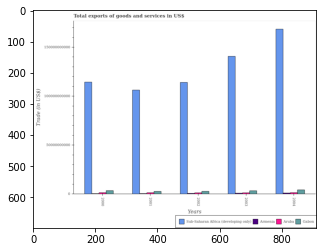

Number of QA =  30





,Years,Sub-Saharan Africa (developing only),Aruba,Gabon,Armenia
0,2000,1.155069e+11,1.914259e+09,4.102039e+09,NaN
1,2002,1.148929e+11,NaN,3.339635e+09,NaN
2,2004,1.689276e+11,1.878291e+09,4.816835e+09,NaN
3,2003,1.413358e+11,NaN,3.913532e+09,NaN
4,2001,1.065799e+11,NaN,3.212979e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in gabon in 2003 and that in 2004 ?
PREDICTED =  -8730366748.800985
EXPECTED =  -894984376.7224102




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in sub-saharan africa (developing only) in 2000 and the total exports of goods and services in gabon in 2003?
PREDICTED =  -256842681971.54047
EXPECTED =  111024236358.1998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the total exports of goods and services in sub-saharan africa (developing only) and to

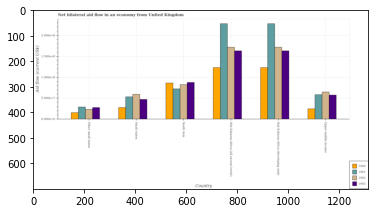

Number of QA =  30





,Country,1963,1962,1961,1960
0,Upper middle income,0.585081,0.656967,0.589853,0.253024
1,Other small states,0.285832,0.239807,0.296980,0.163881
2,Sub-Saharan Africa (developing only),1.637369,1.717458,2.272430,1.236661
3,Sub-Saharan Africa (all income levels),1.638096,1.710273,2.286913,1.233845
4,South Asia,0.887543,0.833408,0.730795,0.869470
5,Small states,0.479894,0.597041,0.541289,0.283062


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1961 in small states and that in south asia ?
PREDICTED =  -0.18950600319503308
EXPECTED =  -19020000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1963 in upper middle income and the net bilateral aid flow in 1961 in south asia?
PREDICTED =  -0.30246264219701
EXPECTED =  -14950000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bil

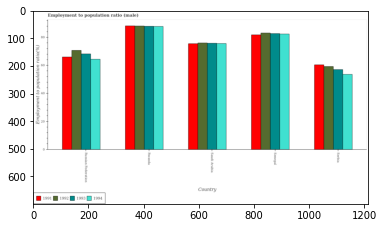

Number of QA =  30





,Country,1992,1993,1994,1991
0,Saudi Arabia,76.562525,75.905048,75.839782,75.676692
1,Senegal,83.691476,83.200338,82.541042,82.169324
2,Russian Federation,70.887976,68.340649,64.632600,66.163128
3,Serbia,59.364841,57.240941,53.844878,60.424439
4,Rwanda,88.636608,88.180298,88.074756,88.531758


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio in 1991 in the graph ?
PREDICTED =  0.01340607

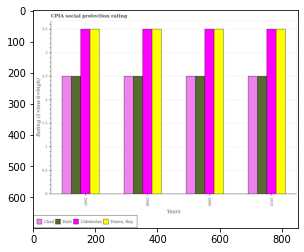

Number of QA =  30





,Years,Uzbekistan,"Yemen, Rep.",Chad,Haiti
0,2009,3.495040,3.517905,2.499310,2.493276
1,2008,3.502947,3.493184,2.498224,2.501268
2,2007,3.481903,3.509761,2.503416,2.487250
3,2010,3.496584,3.496749,2.502488,2.485766


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in uzbekistan in 2007 and that in 2010 ?
PREDICTED =  -0.014680828418676573
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in uzbekistan in 2008 and the cpia rating in yemen, rep. in 2010?
PREDICTED =  0.007134856642617038
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the cpia rating in haiti and cpia rating in uzbekistan ?
PREDICTED =  5.967559479092735
EXPECTED =  -1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or 

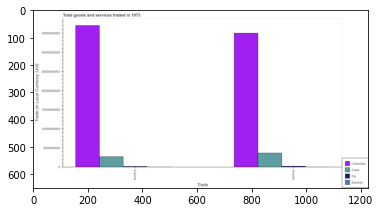

Number of QA =  23





,Trade,Fiji,Zambia,Cuba,Colombia
0,NaN,NaN,NaN,2.894847e+09,3.745250e+10
1,Imports,NaN,NaN,3.848766e+09,3.510946e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade (in Local Currency Unit)
EXPECTED =  5000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Total goods and services traded in 1973
EXPECTED =  Total goods and services traded in 1973




				 1 / 6 = 0.1667


> what is the label or title of the x-axis ?
PRED

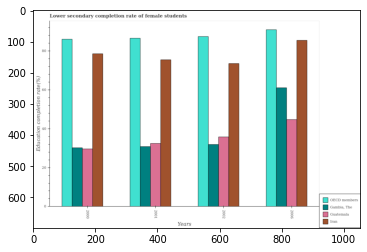

Number of QA =  30





,Years,OECD members,Unnamed: 2,"Gambia, The",Guatemala
0,2000,86.476002,78.853590,30.557117,29.879438
1,2002,87.653139,73.698496,32.178448,36.226257
2,2006,91.191642,85.845068,61.479728,45.032809
3,2001,86.827644,75.797824,31.193871,32.801979


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in guatemala in 2000 and that in 2006 ?
PREDICTED =  -15.153370841110732
EXPECTED =  -15.09086227417




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in oecd members in 2001 and the lower secondary completion rate of female students in guatemala in 2006?
PREDICTED =  -4.363997528410422
EXPECTED =  41.84540557861319




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the lower secondary completion rate of female students in oe

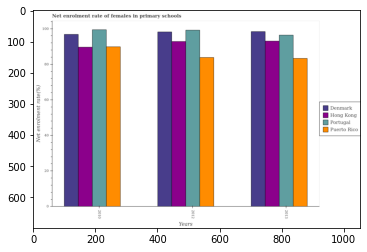

Number of QA =  30





,Years,Portugal,Puerto Rico,Hong Kong,Denmark
0,2013,96.973051,83.822677,94.115478,98.458341
1,2012,100.258906,84.612089,93.542642,98.702318
2,2010,100.823622,90.087366,90.151750,96.583404


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in primary schools in denmark in 2012 and that in 2013 ?
PREDICTED =  0.24397727240030065
EXPECTED =  -0.19842529296880684




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in primary schools in portugal in 2010 and the net enrolment rate of females in primary schools in denmark in 2012?
PREDICTED =  2.1213042037788483
EXPECTED =  1.2412414550780966




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the net enrolment rate of females in primary schools in portugal and

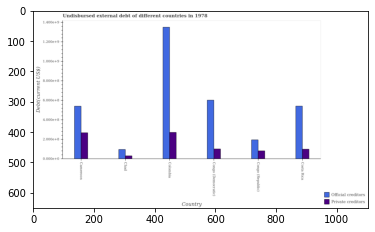

Number of QA =  28





,Country,Private creditors,Official creditors
0,Cameroon,0.275874,0.546856
1,Congo (Democratic),0.106971,0.604669
2,Congo (Republic),0.086280,0.199135
3,Costa Rica,0.104907,0.547309
4,Chad,0.036542,0.101977
5,Colom bia,0.281182,1.349703


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors in cameroon and that in colombia ?
PREDICTED =  0.27587400204288964
EXPECTED =  -811344000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors in chad and the undisbursed external debt of private creditors in cameroon?
PREDICTED =  -0.4448794329523035
EXPECTED =  -171668000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors and undisbursed external debt of private creditors in congo (democratic) 

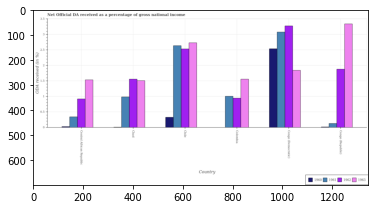

Number of QA =  27





,Country,1963,1962,1961,1960
0,Central African Republic,1.544328,0.927624,0.351519,0.038996
1,Congo (Democratic),1.856483,3.331862,3.079697,2.548649
2,Congo (Republic),3.358640,1.910213,0.139533,NaN
3,Chad,1.512497,1.560725,0.999030,NaN
4,Chile,2.726022,2.546888,2.649310,0.342481
5,Colombia,1.563279,0.959288,1.022624,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net official da received in 1961 in colombia to that in congo (democratic)?
PREDICTED =  0.3320535075605404
EXPECTED =  0.3267937151689394




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

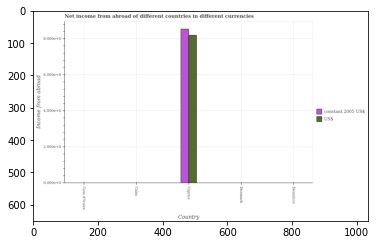

Number of QA =  19





,Country,US$,constant 2005 US$
0,Denmark,NaN,NaN
1,Dominica,NaN,NaN
2,NaN,NaN,NaN
3,Cote d'Ivoire,NaN,NaN
4,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Income from abroad
EXPECTED =  2000000.0




				 0 / 4 = 0.0


> what is the title of the graph ?
PREDICTED =  Net income from abroad of different countries in different currencies
EXPECTED =  Net income from abroad of different countries in different currencies




				 1 / 5 = 0.2


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 6 = 0.3333


> what is the label or title of the y-axis ?
PRED

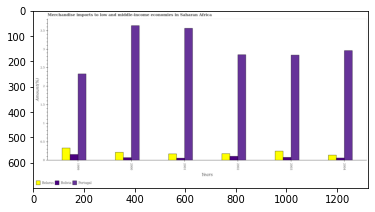

Number of QA =  29





,Years,Portugal,Belarus,Bolivia
0,2001,3.576539,0.181484,0.067159
1,2000,3.643126,0.225859,0.081906
2,2004,2.968565,0.149261,0.071018
3,2003,2.851521,0.256401,0.089720
4,1999,2.332432,0.339406,0.164048
5,2002,2.854114,0.188900,0.119607


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in portugal in 1999 and that in 2001 ?
PREDICTED =  -1.244107201951484
EXPECTED =  -1.23107806318556




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in belarus in 2000 and the percentage of amount earned from merchandise imports in portugal in 2003?
PREDICTED =  -0.030542434889985953
EXPECTED =  -2.626020669008728




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of amount earned from merchandise imports

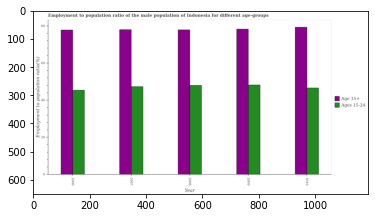

Number of QA =  28





,Year,Age 15+,Ages 15-24
0,2008,78.014744,48.393980
1,2010,79.821393,46.724936
2,2009,78.990757,48.651213
3,2006,77.945006,45.849421
4,2007,78.473109,47.592975


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(age 15+) ?
PREDICTED =  25.181219145561275
EXPECTED =  79.3000030517578




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(age 15-24) ?
PREDICTED =  1.0
EXPECTED =  45.4000015258789




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to population ratio(age 15-24) maximum?
PREDICTED =  0.9985067197610752
EXPECTED =  2009






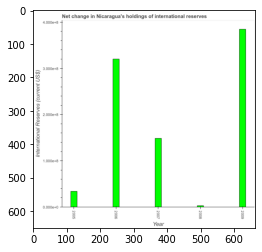

Number of QA =  23





,Year,International Reserves (current US$)
0,2005,0.355588
1,2006,3.201647
2,2007,1.495808
3,2008,0.044865
4,2009,3.885500


> what is the title of the graph ?
PREDICTED =  Net change in Nicaragua's holdings of international reserves
EXPECTED =  Net change in Nicaragua's holdings of international reserves




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  International Reserves (current US$)
EXPECTED =  International Reserves (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the reserves and related items in 2007 and 2008 ?
PREDICTED =  0.25600793807763966
EXPECTED =  145669232.306




				 3 / 4 = 0.75


> what is the median reserves and related items ?
PREDICTED =  None
EXPECTED =  148576992.1




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after 

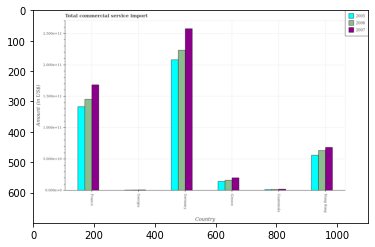

Number of QA =  29





,Country,2007,2005,2006
0,Georgia,NaN,NaN,NaN
1,Guatemala,NaN,0.023250,NaN
2,Hong Kong,0.696727,0.573086,0.640711
3,France,1.681100,1.347490,1.458477
4,Greece,0.210787,0.154015,0.171326
5,Germany,2.573748,2.096931,2.251193


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in 2007 in greece and that in hong kong ?
PREDICTED =  -0.48594028736127065
EXPECTED =  -48461539650.4068




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in 2006 in georgia and the total commercial service import in 2007 in guatemala?
PREDICTED =  0.0
EXPECTED =  -1323803296.51




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import of/in 2006 and total commercial service import of/in 2007 in germany?
PREDICTED =  1.426251508898047
EXPECTED =  -342

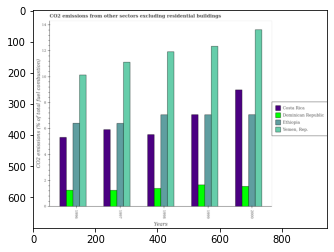

Number of QA =  30





,Years,Dominican Republic,"Yemen, Rep.",Costa Rica,Ethiopia
0,1997,1.284854,11.162443,5.975457,6.435607
1,2000,1.598226,13.669996,9.020106,7.085421
2,1998,1.445263,11.922437,5.587625,7.086625
3,1999,1.711495,12.312950,7.145441,7.123536
4,1996,1.308355,10.236851,5.405956,6.456040


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in dominican republic in 1997 and that in 1999 ?
PREDICTED =  -2.0248668072531464
EXPECTED =  -0.42124542124542996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in dominican republic in 1997 and the total co2 emitted in yemen, rep. in 1998?
PREDICTED =  -0.1604088426655914
EXPECTED =  -10.68282987565496




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the total co2 emitted in yemen, rep. and total co2 emitted in dominican republic ?
PREDICTED =  -54.304677043042986
EXPECTED =  10.5374

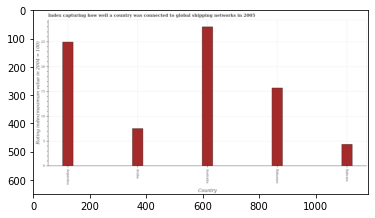

Number of QA =  22





,Country,Rating index(maximum value in 2004 = 100)
0,NaN,7.611824
1,Bahamas,15.771598
2,Bahrain,4.459612
3,Argentina,24.904474
4,Australia,28.088816


> what is the title of the graph ?
PREDICTED =  Index capturing how well a country was connected to global shipping networks in 2005
EXPECTED =  Index capturing how well a country was connected to global shipping networks in 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Rating index(maximum value in 2004 = 100)
EXPECTED =  Rating index(maximum value in 2004 = 100)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the liner shipping connectivity index in aruba and bahamas ?
PREDICTED =  -11.771597962032313
EXPECTED =  -8.18




				 3 / 4 = 0.75


> what is the median liner shipping connectivity index ?
PREDICTED =  None
EXPECTED =  15.7




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: F

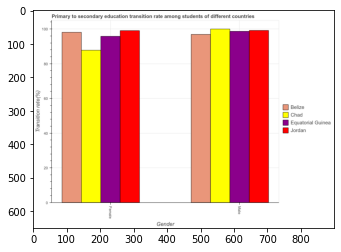

Number of QA =  23





,Gender,Equatorial Guinea,Belize,Chad,Jordan
0,Male,98.553800,97.429281,100.153115,99.188938
1,Female,95.648879,98.849719,87.614319,98.939423


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in belize and that in chad ?
PREDICTED =  -2.723834184632153
EXPECTED =  -3.1096115112305114




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in belize and the transition rate among female students in equatorial guinea?
PREDICTED =  -1.1245185250805463
EXPECTED =  1.0766677856444886




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students and transition rate among female students in belize ?
PREDICTED =  0.0
EXPECTED =  -1.228401184082116

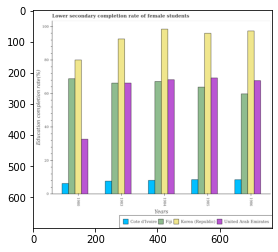

Number of QA =  30





,Years,Korea (Republic),Fiji,United Arab Emirates,Cote d'Ivoire
0,1983,93.251367,67.236866,67.090194,8.084113
1,1986,97.476274,60.578686,68.673446,9.015571
2,1984,99.503984,67.981183,69.453790,8.460814
3,1980,80.036038,69.572940,33.228038,6.621931
4,1985,96.773503,64.425186,70.309420,8.980480


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in cote d'ivoire in 1980 and that in 1983 ?
PREDICTED =  -1.4621825346686919
EXPECTED =  -1.4127800000000006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in united arab emirates in 1986 and the lower secondary completion rate of female students in korea (republic) in 1980?
PREDICTED =  35.44540781871242
EXPECTED =  -12.344679999999968




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the lower secondary completion rate 

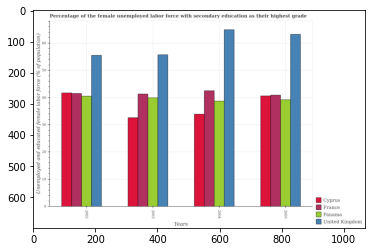

Number of QA =  30





,Years,United Kingdom,Panama,Cyprus,France
0,2005,63.930672,39.584129,40.937082,41.744874
1,2004,65.670627,39.104208,34.296223,42.800431
2,2003,56.333528,40.301170,33.045262,41.530510
3,2002,55.907237,40.897245,42.130742,42.060896


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with secondary education in france in 2002 and that in 2005 ?
PREDICTED =  0.31602236366097003
EXPECTED =  0.5999984741211009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with secondary education in cyprus in 2002 and the percentage of the unemployed female labor force with secondary education in panama in 2004?
PREDICTED =  7.834519645217789
EXPECTED =  3.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False

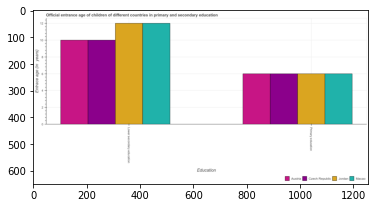

Number of QA =  23





,Education,Austria,Macao,Jordan,Czech Republic
0,Lower secondary education,10.021475,12.032565,11.937468,10.065982
1,Primary education,6.136905,6.103414,6.089263,6.081183


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in austria and that in jordan ?
PREDICTED =  -1.9159928724668234
EXPECTED =  -2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education and entrance age of children in lower secondary education in jordan ?
PREDICTED =  -2.909951041271242
EXPECTED =  -6




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the

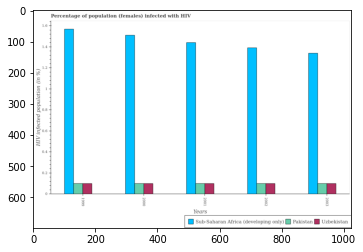

Number of QA =  29





,Years,Uzbekistan,Sub-Saharan Africa (developing only),Pakistan
0,1999,0.104047,1.574809,0.104242
1,2000,0.103942,1.506385,0.104222
2,2002,0.104070,1.390780,0.104131
3,2001,0.104080,1.438895,0.104206
4,2003,0.104042,1.338359,0.104048


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in pakistan in 2001 and that in 2003 ?
PREDICTED =  0.00015724577900952386
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected female population in pakistan in 2002 and the percentage of hiv infected female population in sub-saharan africa (developing only) in 1999?
PREDICTED =  -0.00011100760371723917
EXPECTED =  -1.46840450271321




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of hiv infected female population in sub-saha

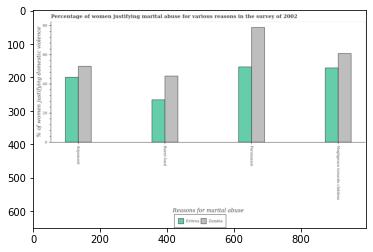

Number of QA =  29





,Reasons for marital abuse,Zambia,Eritrea
0,Argument,52.612333,45.147497
1,Permission,79.069339,52.442177
2,Burnt food,45.824649,29.622967
3,Negligence towards children,61.429570,51.729978


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of women justifying abuse for burning food in zambia to that in eritrea ?
PREDICTED =  1.546929713938403
EXPECTED =  1.5601374570446733




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest percen

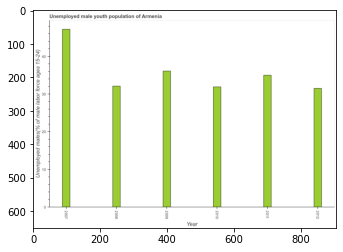

Number of QA =  23





,Year,Unemployed males(% of male labor force ages 15-24)
0,2009,36.458104
1,2010,32.309618
2,2008,32.383367
3,2012,31.744673
4,2007,47.750761
5,2011,35.169764


> what is the title of the graph ?
PREDICTED =  Unemployed male youth population of Armenia
EXPECTED =  Unemployed male youth population of Armenia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed males(% of male labor force ages 15-24)
EXPECTED =  Unemployed males(% of male labor force ages 15-24)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth in 2009 and 2011 ?
PREDICTED =  1.2883406152814771
EXPECTED =  1.1




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth ?
PREDICTED =  2009.5
EXPECTED =  33.54999923706055




				 3 / 5 = 0.6

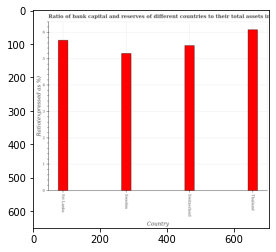

Number of QA =  22





,Country,Ratio(expressed as %)
0,Thailand,6.082008
1,Switzerland,5.501008
2,Sri Lanka,5.703847
3,Sweden,5.193435


> what is the title of the graph ?
PREDICTED =  Ratio of bank capital and reserves of different countries to their total assets ir
EXPECTED =  Ratio of bank capital and reserves of different countries to their total assets in 2002




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Ratio(expressed as %)
EXPECTED =  Ratio(expressed as %)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 6 = 0.3333


is_built_with_cuda: True
is_gpu_

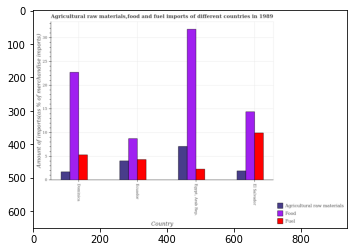

Number of QA =  29





,Country,Agricultural raw materials,Fuel,Food
0,Domimica,1.805799,5.374681,22.595131
1,"Egypt, Arab Rep.",7.221965,2.399820,31.750948
2,Ecuador,4.106643,4.461854,8.838601
3,El Salvador,2.042796,9.985812,14.429710


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in dominica and that in ecuador ?
PREDICTED =  12.222959059642907
EXPECTED =  13.97419661618015




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in el salvador and the percentage of raw materials imports in dominica?
PREDICTED =  0.0
EXPECTED =  8.20674955030756




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports and percentage of fuel imports in ecuador ?
PREDICTED =  22.91234717268288
EXPECTED =  4.421188394036849




				 0 / 3 = 0.0


is_built_with_cuda: T

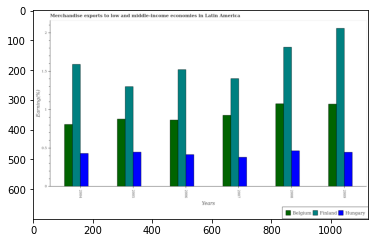

Number of QA =  29





,Years,Belgium,Finland,Hungary
0,2004,0.801896,1.589469,0.434780
1,2006,0.865642,1.528230,0.415849
2,2008,1.082804,1.811443,0.467619
3,2009,1.073358,2.065716,0.446652
4,2005,0.884251,1.299138,0.449290
5,2007,0.925995,1.409990,0.384279


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in belgium in 2005 and that in 2006 ?
PREDICTED =  0.018609626781215582
EXPECTED =  0.012520344970007868




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in belgium in 2005 and the percentage of amount earned from merchandise exports in finland in 2004?
PREDICTED =  0.08235516531827658
EXPECTED =  -0.7121052079011829




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of amount earned from merchandise expor

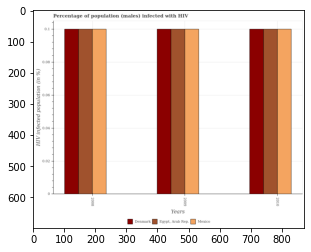

Number of QA =  29





,Years,Mexico,"Egypt, Arab Rep",Denmark
0,2008,0.100307,0.100905,0.100009
1,2010,0.100106,0.100175,0.100343
2,2009,0.100020,0.100283,0.100233


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in egypt, arab rep. in 2009 and that in 2010 ?
PREDICTED =  0.00010771865584509321
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in denmark in 2010 and the percentage of hiv infected male population in egypt, arab rep. in 2009?
PREDICTED =  0.000110619625817307
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of hiv infected male population in denmark and percentage of hiv infected male po

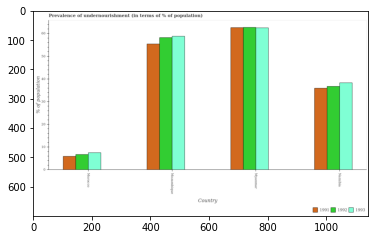

Number of QA =  29





,Country,1992,1993,1991
0,Myanmar,62.479666,62.194340,62.222731
1,Mozambique,57.824306,58.579516,54.933697
2,Morocco,6.752446,7.626602,6.072683
3,Namibia,36.534982,38.087370,35.874605


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in 1991 in mozambique and that in myanmar ?
PREDICTED =  -7.289033897177646
EXPECTED =  -7.200000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in 1991 in morocco and the percentage of undernourished population in 1992 in mozambique?
PREDICTED =  -48.86101365695039
EXPECTED =  -52.300000000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population of/in 1992 and percentage of undernourished population of/in 19

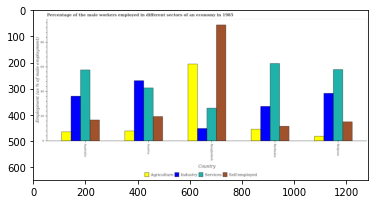

Number of QA =  30





,Country,Industry,Self-employed,Agriculture,Services
0,NaN,39.015976,15.835414,4.223106,58.435145
1,Australia,36.825705,17.347611,7.834562,58.145953
2,Austna,49.300291,20.122200,8.381422,43.303612
3,Bangladesh,10.508778,94.714719,62.772973,26.709303
4,Barbados,28.425871,12.350618,9.882811,63.306026


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in agriculture in austria and that in bangladesh ?
PREDICTED =  0.0
EXPECTED =  -54.2999992370605




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in agriculture in belgium and the percentage of male workers in services in barbados?
PREDICTED =  52.890162776999674
EXPECTED =  -59.00000071525578




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in industry and percentage of self employed male workers in belgium ?
PREDICTED =  -1.8418399099129292
EXPECTED =  2

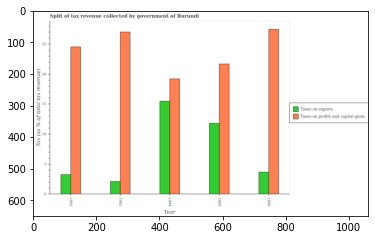

Number of QA =  28





,Year,Taxes on profits and capital gains,Taxes on exports
0,1996,27.625608,3.751372
1,1994,19.238099,15.477600
2,1993,27.045630,2.168883
3,1992,24.553502,3.308758
4,1995,21.705895,11.816566


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capital gains in 1994 and that in 1996 ?
PREDICTED =  0.0
EXPECTED =  -8.26382495805779




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on exports in 1995 and the percentage of revenue obtained from taxes on profits and capital gains in 1992?
PREDICTED =  8.507808451983028
EXPECTED =  8.562020201443




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of revenue obtained from taxes on profits and capital gains and

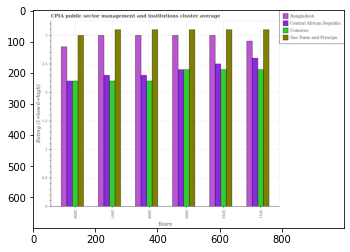

Number of QA =  30





,Years,Central African Republic,Sao Tome and Principe,Comoros,Bangladesh
0,2008,2.312711,3.094219,2.149322,2.986193
1,2011,2.609201,3.080718,2.432978,2.891944
2,2009,2.421262,3.108828,2.395406,3.007783
3,2010,2.502082,3.074450,2.401842,3.034426
4,2006,2.203426,3.000441,2.228466,2.804473
5,2007,2.314835,3.095334,2.231732,3.026258


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in central african republic in 2006 and that in 2010 ?
PREDICTED =  -0.29865545896562384
EXPECTED =  -0.2999999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in sao tome and principe in 2011 and the cpia rating in bangladesh in 2010?
PREDICTED =  15.562046017667122
EXPECTED =  0.10000000000000009




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the cpia rating in sao tome and principe and cpia rating in central african republic ?
PREDICTED =  16.060070142384028
EXPECTED =  0.600000000000

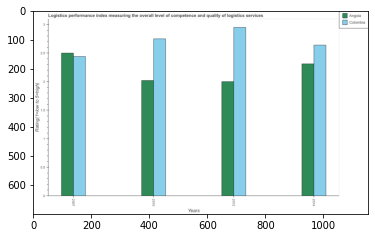

Number of QA =  28





,Years,Angola,Colombia
0,2012,2.006065,2.971366
1,2010,2.038110,2.755701
2,2014,2.321896,2.643216
3,2007,2.502473,2.451653


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in angola in 2007 and that in 2014 ?
PREDICTED =  0.1805771146965931
EXPECTED =  0.18882699999999986




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in angola in 2010 and the logistic performance index in colombia in 2012?
PREDICTED =  0.03204499052193377
EXPECTED =  -0.9300000000000002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the logistic performance index in angola and logistic performance index in colombia ?
PREDICTED =  6.163059878988271
EXPECTED =  0.06000

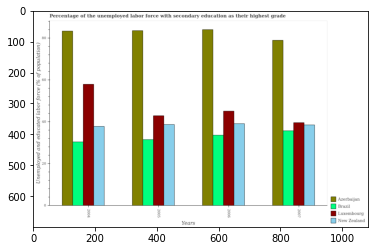

Number of QA =  30





,Years,Luxembourg,Azerbaijan,New Zealand,Brazil
0,2005,42.959019,83.902519,39.058823,31.574804
1,2006,45.104134,84.389863,39.413887,33.860514
2,2007,39.639179,79.033115,38.796529,36.009793
3,2004,58.178777,83.479569,38.086847,30.673130


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in brazil in 2005 and that in 2006 ?
PREDICTED =  -2.2857090603384336
EXPECTED =  -2.099998474121101




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with secondary education in luxembourg in 2007 and the percentage of the unemployed labor force with secondary education in new zealand in 2006?
PREDICTED =  -5.464955454457169
EXPECTED =  0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of the unemplo

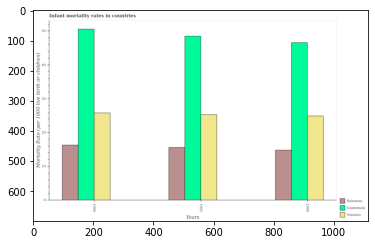

Number of QA =  29





,Years,Vanuatu,Bahamas,Guatemala
0,1994,25.955389,16.186054,50.489587
1,1996,24.804313,14.851038,46.335728
2,1995,25.371491,15.539300,48.557489


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in bahamas in 1994 and that in 1996 ?
PREDICTED =  1.3350166628700624
EXPECTED =  1.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in vanuatu in 1996 and the infant mortality rate in bahamas in 1994?
PREDICTED =  -1.1510761261147309
EXPECTED =  8.599999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the infant mortality rate in guatemala and infant mortality rate in vanuatu ?
PREDICTED =  21.531414783129584
EXPECTED =  24.8




				 0 / 3 = 0.0


is_built_with_cuda

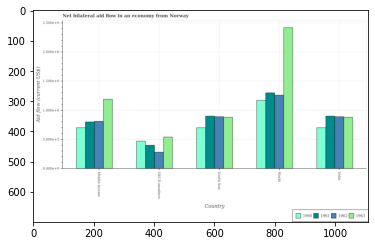

Number of QA =  30





,Country,1963,1962,1961,1960
0,World,2.434109,1.266162,1.315900,1.183274
1,South Asia,0.894460,0.900476,0.911506,0.711428
2,OECD members,0.550032,0.291128,0.415522,0.482536
3,India,0.893500,0.904201,0.916077,0.711569
4,Middle income,1.193261,0.822893,0.811335,0.711364


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 in india and that in middle income ?
PREDICTED =  0.08130771495492428
EXPECTED =  80000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 in world and the net bilateral aid flow in 1960 in india?
PREDICTED =  0.3619606280180465
EXPECTED =  560000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow of/in 1962 and net bilateral aid flow of/in 1960 in world?
PREDICTED =  0.08288778056230717
EXPECTED =  90000.0




				 0 / 3 = 0.0


is_built_with_cuda: Tru

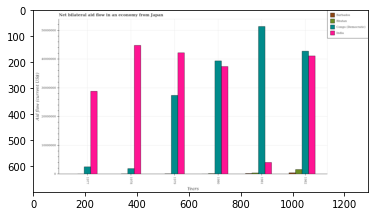

Number of QA =  30





,Years,Bhutan,India,Barbados,Congo (Democratic)
0,1980,NaN,3.746519e+07,NaN,4.013656e+07
1,1981,5.577545e+05,4.194957e+06,NaN,5.191822e+07
2,1982,1.752777e+06,4.105696e+07,596457.167645,4.308394e+07
3,1979,NaN,4.329263e+07,NaN,2.763379e+07
4,1978,NaN,4.507473e+07,NaN,2.054382e+06
5,1977,NaN,2.913012e+07,NaN,2.688698e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in india in 1979 and that in 1982 ?
PREDICTED =  2235672.7464951947
EXPECTED =  1100000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the net bilateral aid flow in bhutan and net bilateral aid flow in india ?
PREDICTED =  -4.0
EXPECTED =  -28730000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in india in 1977 to that in 1979?
P

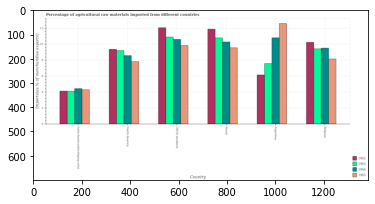

Number of QA =  30





,Country,1965,1964,1962,1963
0,Latin America(developing only),4.389245,4.568453,4.227368,4.195468
1,Argentina,12.744600,10.983758,6.306502,7.791351
2,North America,7.967272,8.729258,9.540837,9.371340
3,OECD members,9.985901,10.790390,12.209627,11.080214
4,NaN,8.297198,9.689381,10.422773,9.547047
5,World,9.715564,10.453071,12.053569,10.975904


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in 1962 in oecd members and that in world ?
PREDICTED =  0.1560572775420468
EXPECTED =  0.17897542267060018




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_availa

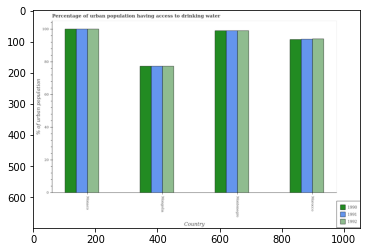

Number of QA =  29





,Country,1992,1990,1991
0,Monaco,100.813983,100.198512,100.819663
1,Montenegro,99.881092,99.392133,99.912754
2,Morocco,94.796525,94.013198,94.649920
3,Mongolia,77.807618,77.601081,77.735352


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in 1990 in mongolia and that in morocco ?
PREDICTED =  -16.41211702617484
EXPECTED =  -16.299999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in 1990 in mongolia and the percentage of urban population having access to drinking water in 1991 in morocco?
PREDICTED =  -16.41211702617484
EXPECTED =  -16.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to dri

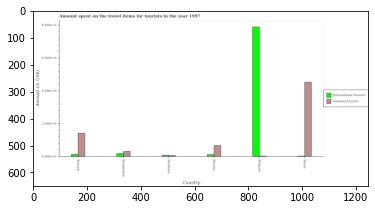

Number of QA =  28





,Country,International Tourists,National Tourists
0,Belize,NaN,4.528220
1,Belarus,0.138341,0.694241
2,Bangladesh,0.209524,0.343897
3,Bahrain,0.161803,1.447275
4,Barbados,0.102058,NaN
5,NaN,7.948103,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in belarus and that in belize ?
PREDICTED =  0.13834083403862074
EXPECTED =  96000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in bangladesh and the amount spent on travel items of national tourists in belgium?
PREDICTED =  -0.3001437981451999
EXPECTED =  153000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists and amount spent on travel items of national touri

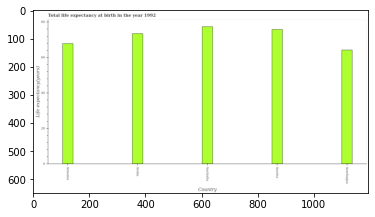

Number of QA =  22





,Country,Life expectancy(years)
0,NaN,73.497962
1,Armenia,68.116402
2,Austria,76.025612
3,Australia,77.407636
4,Azerbaijan,64.294663


> what is the title of the graph ?
PREDICTED =  Total life expectancy at birth in the year 1992
EXPECTED =  Total life expectancy at birth in the year 1992




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Life expectancy(years)
EXPECTED =  Life expectancy(years)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in armenia and austria ?
PREDICTED =  -7.909210270180509
EXPECTED =  -7.964




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median life expectancy at birth ?
PREDICTED =  73.49796151544552
EXPECTED =  73.471756097561




				 5 / 5 = 1.0


is_built_with_cu

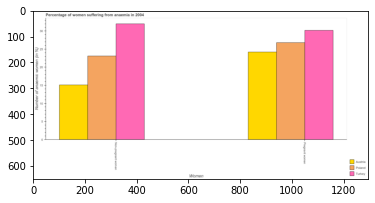

Number of QA =  23





,Women,Turkey,Austria,Poland
0,Non-pregnant women,31.895036,15.082442,23.058052
1,Pregnant women,29.988589,24.456086,26.657044


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in austria and that in poland ?
PREDICTED =  -2.200957571846388
EXPECTED =  -2.6000000000000014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in turkey and the percentage of non-pregnant anaemic women in poland?
PREDICTED =  6.930536531768947
EXPECTED =  7.099999999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of 

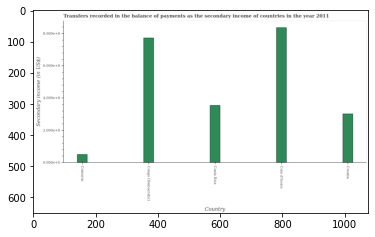

Number of QA =  22





,Country,Secondary income (in US$)
0,Croatia,3.078563
1,Comoros,0.543569
2,Costa Rica,3.591672
3,Cote d'Ivoire,8.422598
4,Congo (Democratic),7.791421


> what is the title of the graph ?
PREDICTED =  Transfers recorded in the balance of payments as the secondary income of countries in the year 2011
EXPECTED =  Transfers recorded in the balance of payments as the secondary income of countries in the year 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Secondary income (in US$)
EXPECTED =  Secondary income (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of secondary income in comoros and congo (democratic) ?
PREDICTED =  -7.247852045418906
EXPECTED =  -723296614.79




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 5 = 

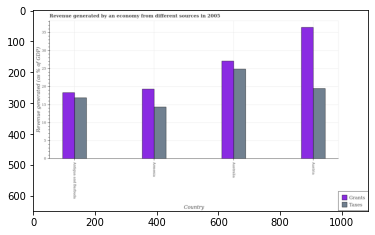

Number of QA =  28





,Country,Taxes,Grants
0,Armenia,14.312776,19.147165
1,Austria,19.416025,36.042098
2,Australia,24.738673,26.909777
3,Antigua and Barbuda,16.891468,18.230623


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants in antigua and barbuda and that in australia ?
PREDICTED =  -8.679154510483492
EXPECTED =  -8.74587377865921




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants in antigua and barbuda and the revenue generated by taxes in austria?
PREDICTED =  -17.81147501432998
EXPECTED =  -1.1395149445303012




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants and revenue generated by taxes in antigua and barbuda ?
PREDICTED =  83.4381959230254
EXPECTED =  1.4371070166805993


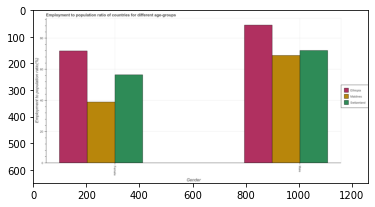

Number of QA =  23





,Gender,Switzerland,Maldives,Ethiopia
0,Female,56.893579,39.439426,72.824259
1,Male,72.528001,69.805575,88.706991


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(male) ?
PREDICTED =  1.0
EXPECTED =  68.90000152587889




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

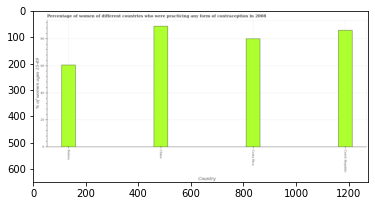

Number of QA =  22





,Country,% of women ages 15-49
0,Czech Republic,86.208361
1,Bolivia,60.708716
2,China,89.468869
3,Costa Rica,80.026448


> what is the title of the graph ?
PREDICTED =  Percentage of women of different countries who were practicing any form of contraception in 2008
EXPECTED =  Percentage of women of different countries who were practicing any form of contraception in 2008




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of women ages 15-49
EXPECTED =  % of women ages 15-49




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contraceptive prevalence in bolivia and china ?
PREDICTED =  -28.760152656525968
EXPECTED =  -28.7




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu

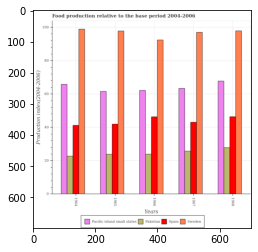

Number of QA =  30





,Years,Sweden,Spain,Pacific island small states,Pakistan
0,1965,98.991394,41.936010,61.601833,24.445935
1,1964,99.207588,41.391090,66.094869,23.087015
2,1968,98.364412,46.469283,68.119716,28.005368
3,1966,92.379707,46.461090,61.902406,24.496049
4,1967,97.008786,43.236498,63.659668,26.035940


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the food production index in spain in 1967 and that in 1968 ?
PREDICTED =  -3.232785599994301
EXPECTED =  -3.3000000000000043




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the food production index in spain in 1966 and the food production index in pakistan in 1964?
PREDICTED =  5.069999394179121
EXPECTED =  23.57




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1965, what is the difference between the food production index in pakistan and food production index in pacific island small states ?
PREDICTED =  0.0
EXPECTED =  -37.7012649376849




				 1 / 3 = 0.3333



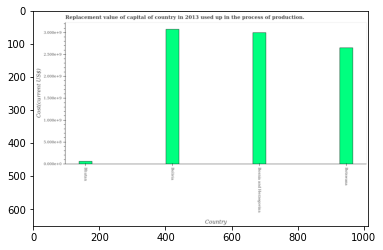

Number of QA =  22





,Country,Cost(current US$)
0,Bolivia,3.098481
1,Botswana,2.674993
2,Bhutan,0.068583
3,Bosnia and Herzegovina,3.017697


> what is the title of the graph ?
PREDICTED =  Replacement value of capital of country in 2013 used up in the process of production.
EXPECTED =  Replacement value of capital of country in 2013 used up in the process of production.




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cost(current US$)
EXPECTED =  Cost(current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in bolivia and bosnia and herzegovina ?
PREDICTED =  0.08078418890902972
EXPECTED =  76637796.324




				 3 / 4 = 0.75


> what is the median consumption of fixed capital ?
PREDICTED =  None
EXPECTED =  2826336289.21234




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Traini

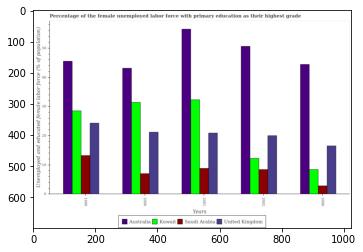

Number of QA =  30





,Years,United Kingdom,Australia,Saudi Arabia,Kuwait
0,2002,20.004597,50.674458,8.475864,12.361246
1,2000,21.329570,43.175926,7.049623,31.425638
2,1999,24.218078,45.416557,13.298557,28.631775
3,2006,16.658317,44.302883,2.942205,8.501860
4,2001,20.930332,56.784637,8.897287,32.276718


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with primary education in saudi arabia in 1999 and that in 2002 ?
PREDICTED =  4.40127022814891
EXPECTED =  4.8000001907348295




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of the unemployed female labor force with primary education in australia and percentage of the unemployed female labor force with primary education in kuwait ?
PREDICTED =  24.507919179729008
EXPECTED =  17.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fals

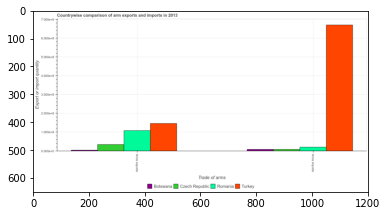

Number of QA =  23





,Trade of arms,Turkey,Botswana,Czech Republic,Romania
0,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in botswana and that in turkey ?
PREDICTED =  0.0
EXPECTED =  -662000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in romania and the arms imports in turkey?
PREDICTED =  0.0
EXPECTED =  -562000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports and arms imports in czech republic ?
PREDICTED =  1.0
EXPECTED =  26000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0

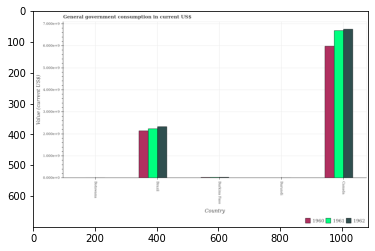

Number of QA =  29





,Country,1962,1961,1960
0,Brazil,2.353752,2.262897,2.167520
1,Botswana,NaN,NaN,NaN
2,Burundi,NaN,NaN,NaN
3,Burkina Faso,NaN,NaN,NaN
4,Canada,6.826345,6.757018,6.032739


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in 1961 in botswana and that in canada ?
PREDICTED =  -4.4941205148839245
EXPECTED =  -6681938274.661023




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government conusmption in 1961 in botswana and the government conusmption in 1962 in brazil?
PREDICTED =  0.0
EXPECTED =  -2319953552.894064




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the government conusmption in 1962 

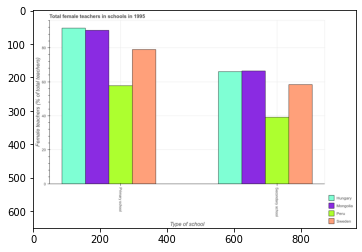

Number of QA =  23





,Type of school,Sweden,Hungary,Mongolia,Peru
0,secondary school,58.407471,66.239032,66.383109,39.196664
1,Primary school,78.585013,91.320518,90.450934,57.686516


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in secondary schools in hungary and that in sweden ?
PREDICTED =  7.831561413385366
EXPECTED =  7.61121




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in mongolia and the percentage of female teachers in secondary schools in hungary?
PREDICTED =  24.211901132297825
EXPECTED =  24.301140000000004




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools and percentage of female teachers in secondary schools in sweden ?

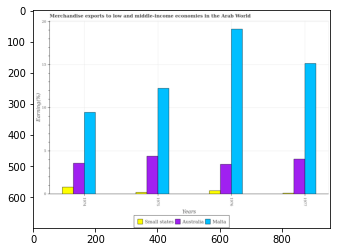

Number of QA =  29





,Years,Australia,Small states,Malta
0,1977,4.138780,NaN,15.242260
1,1975,4.463746,0.250273,12.387730
2,1974,3.652055,0.871754,9.589752
3,1976,3.537442,0.445986,19.270213


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in small states in 1976 and that in 1977 ?
PREDICTED =  0.0
EXPECTED =  0.28767600015559




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in small states in 1977 and the percentage of amount earned from merchandise exports in australia in 1975?
PREDICTED =  -0.2502726372080624
EXPECTED =  -4.287472968207996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the percentage of amount earned from merchandise exports in aust

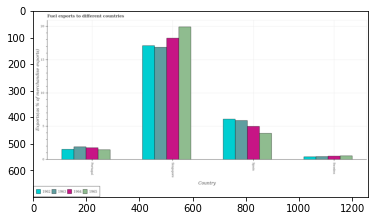

Number of QA =  30





,Country,1963,1964,1962,1965
0,NaN,5.944698,5.133120,6.150098,4.039513
1,Portugal,1.974837,1.857703,1.615852,1.555464
2,Singapore,16.864520,18.220228,17.043919,19.917020
3,Sweden,0.549130,0.620065,0.514127,0.654060


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1964 in portugal and that in spain ?
PREDICTED =  -1.142296505171811
EXPECTED =  -3.21152303181292




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1962 in singapore and the percentage of exports to different countries in 1965 in sweden?
PREDICTED =  16.52979186807359
EXPECTED =  16.548834951700222




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries of/in 1963 and percentage of exports to different co

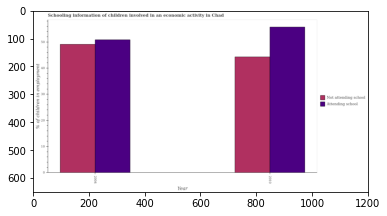

Number of QA =  24





,Year,Attending school,Not attending school
0,2010,55.970398,44.915220
1,2004,51.594876,50.022532


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are attending school in 2004 and that in 2010 ?
PREDICTED =  -4.375521855530096
EXPECTED =  -4.850000000000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are not attending school in 2010 and the percentage of employed children who are attending school in 2004?
PREDICTED =  -5.107311853583674
EXPECTED =  -4.800000000000004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of employed children who are not attending school and percenta

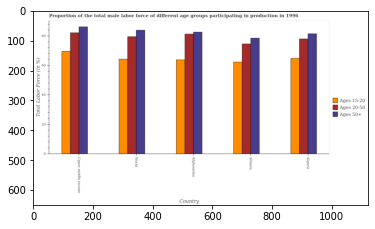

Number of QA =  29





,Country,Ages 50+,Ages 20-50,Ages 15-20
0,Algeria,82.186943,78.526018,64.803552
1,World,84.399363,80.318608,64.622228
2,Afghanistan,83.324890,81.578353,64.392357
3,Upper middle income,86.823176,82.538873,70.024015
4,Albania,78.714120,75.118128,63.050580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?

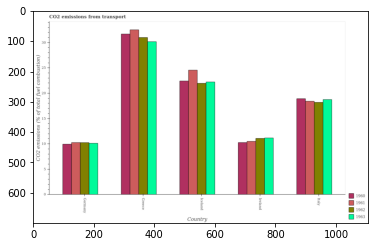

Number of QA =  30





,Country,1963,1962,1961,1960
0,Italy,18.881321,18.372262,18.588666,19.056641
1,Ireland,11.281082,11.222664,10.610747,10.346374
2,Iceland,22.444767,22.141891,24.728389,22.623345
3,Greece,30.459405,31.374394,32.975798,32.140229
4,Germany,10.267913,10.383148,10.323717,10.073726


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1960 in germany and that in italy ?
PREDICTED =  -18.056640864046077
EXPECTED =  -8.98270783583974




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1960 in iceland and the total co2 emitted in 1963 in italy?
PREDICTED =  3.566704014618683
EXPECTED =  3.6693677175134987




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted of/in 1961 and total co2 emitted of/in 1962 in italy?
PREDICTED =  78.85505534661655
EXPECTED =  0.22810780408289943




				 1 / 3 = 0.3333


is_built_with_cuda: 

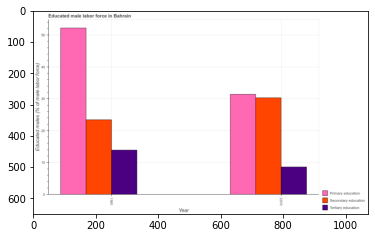

Number of QA =  25





,Year,Secondary education,Tertiary education,Primary education
0,1991,23.702840,14.113707,52.581484
1,2010,30.442557,8.792871,31.587503


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received primary education in 1991 and that in 2010 ?
PREDICTED =  20.993981058562294
EXPECTED =  20.800001144409194




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received primary education in 2010 and the percentage of male labor force who received secondary education in 1991?
PREDICTED =  -20.993981058562294
EXPECTED =  -20.800001144409194




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the percentage of male labor force who received tertiary educa

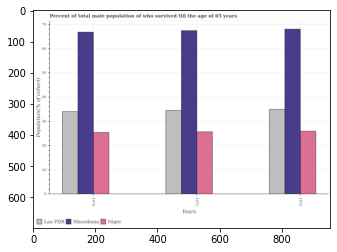

Number of QA =  29





,Years,Niger,Macedonia,Lao PDR
0,1971,25.887878,67.140981,34.862452
1,1970,25.552240,66.732104,34.177746
2,1972,26.008943,67.809272,35.036571


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in niger in 1970 and that in 1971 ?
PREDICTED =  -0.3356374210531037
EXPECTED =  -0.2669800000000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in macedonia in 1970 and the percentage of total male population who survived till the age of 65 years in niger in 1972?
PREDICTED =  66.0638124670912
EXPECTED =  40.87158




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the perce

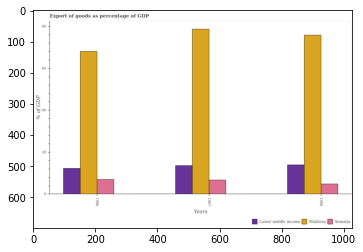

Number of QA =  29





,Years,Somalia,Maldives,Lower middle income
0,1987,6.931605,78.384006,13.852631
1,1986,7.178262,68.740442,12.484416
2,1988,5.048068,75.684396,14.177313


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in maldives in 1986 and that in 1988 ?
PREDICTED =  -63.19998054702128
EXPECTED =  -7.7802058867846995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in somalia in 1986 and the export of goods as percentage of gdp in lower middle income in 1987?
PREDICTED =  5.5528109822570935
EXPECTED =  -6.60755749555095




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the export of goods as percentage of gdp in somalia and export of goods as percentage of gdp in

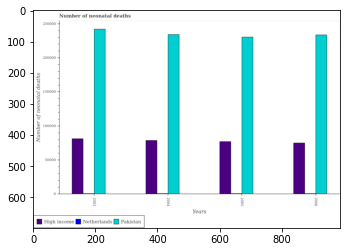

Number of QA =  29





,Years,Netherlands,Pakistan,High income
0,2006,NaN,236089.641465,75804.419894
1,2005,NaN,231680.735147,78675.142400
2,2003,NaN,244773.307764,81466.018476
3,2004,NaN,235977.191311,79255.204041


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in in netherlands in 2005 and that in 2006 ?
PREDICTED =  0.0
EXPECTED =  35




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in in high income in 2003 and the number of neonatal deaths in in netherlands in 2006?
PREDICTED =  5661.598582012462
EXPECTED =  80608




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the number of neonatal deaths in in high income and number of neonatal deaths in in netherlands ?
PREDICTED =  -2000.5
EXPECTED =  76349




				 0 / 3 = 0.0


is_bu

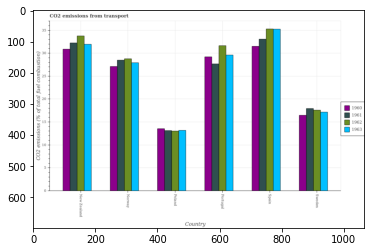

Number of QA =  30





,Country,1963,1962,1961,1960
0,Poland,13.440089,13.258988,13.394372,13.783661
1,NaN,35.725020,35.624379,33.653808,32.193302
2,Norway,28.276198,29.393089,28.812923,27.495865
3,New Zealand,32.402270,34.061972,32.616694,31.370551
4,Portugal,30.119008,32.022753,28.033178,29.585680
5,Sweden,17.498832,17.866079,18.196616,16.749487


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in norway and that in sweden ?
PREDICTED =  11.527009572959553
EXPECTED =  11.191246520653




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in sweden and the total co2 emitted in 1960 in spain?
PREDICTED =  12.196615652709568
EXPECTED =  -13.562621068020903




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted of/in 1962 and total co2 emitted of/in 1963 in new zealand?
PREDICTED =  129.82499102190008
EXPECTED =  1.821789321789403




				 1 / 3 = 0.3333


is_built_with_cud

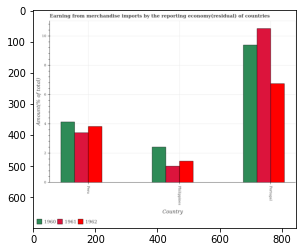

Number of QA =  29





,Country,1962,1961,1960
0,Peru,3.846270,3.427870,4.174300
1,Philippines,1.485565,1.141569,2.456982
2,Portugal,6.786590,10.527287,9.414806


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in philippines and that in portugal ?
PREDICTED =  -9.385718317704406
EXPECTED =  -9.393306444238071




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 in portugal and the percentage of amount earned from merchandise imports in 1961 in peru?
PREDICTED =  5.9869363288245365
EXPECTED =  5.985447380305139




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports of/in 1962 and p

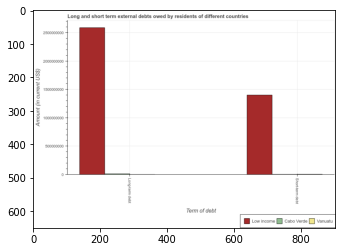

Number of QA =  23





,Term of debt,Low income,Cabo Verde,Vanuatu
0,Short-term debt,1.415323e+09,NaN,NaN
1,Long-tem debdt,2.586818e+09,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in vanuatu and the short-term debts owed by residents in low income?
PREDICTED =  -1415323269.29249
EXPECTED =  -1400721000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the short-term debts owed by residents in low income to that in vanuatu ?
PREDICTED =  1.0
EXPECTED =  350.2075




				 1 / 4 = 0.25


> what is the difference between two consecuti

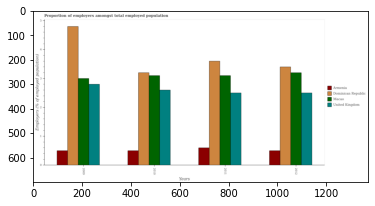

Number of QA =  30





,Years,United Kingdom,Dominican Republic,Armenia,Macao
0,2009,2.825162,4.849835,0.519238,3.025281
1,2010,2.623347,3.227042,0.514552,3.088621
2,2012,2.526840,3.425274,0.517705,3.215013
3,2011,2.521093,3.594657,0.615004,3.121373


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of employers in dominican republic in 2009 and that in 2010 ?
PREDICTED =  1.6227925654456072
EXPECTED =  1.6000001430511426




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of employers in united kingdom in 2011 and the proportion of employers in armenia in 2012?
PREDICTED =  -0.005747576429497414
EXPECTED =  2.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the proportion of employers in dominican republic and proportion of employers in armenia ?
PREDICTED =  14.481803224177876
EXPECTED =  2.9000

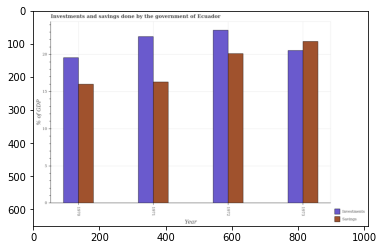

Number of QA =  28





,Year,Savings,Investments
0,1970,16.134482,19.630219
1,1971,16.456888,22.495513
2,1973,21.786694,20.664813
3,1972,20.228553,23.488647


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in 1970 and that in 1973 ?
PREDICTED =  -1.034594751103537
EXPECTED =  -0.965497868975298




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in 1971 and the savings of government in 1970?
PREDICTED =  2.8652942124470044
EXPECTED =  2.8389366735287993




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1971, what is the difference between the investments of government and savings of government ?
PREDICTED =  64.40773207938172
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fals

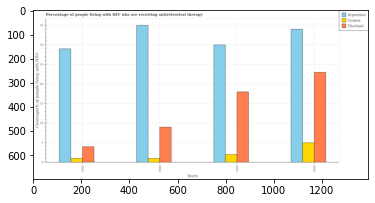

Number of QA =  29





,Years,Thailand,Guinea,Argentina
0,2004,9.061155,1.114674,35.164921
1,2006,23.072616,5.154800,34.079639
2,2003,4.059146,1.115403,29.209055
3,2005,18.176336,2.100779,30.053230


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in thailand in 2004 and that in 2006 ?
PREDICTED =  -14.011460523271069
EXPECTED =  -14




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in guinea in 2005 and the percentage of the hiv infected people who are receiving antiretroviral therapy in argentina in 2004?
PREDICTED =  0.9861055988030794
EXPECTED =  -33




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the perce

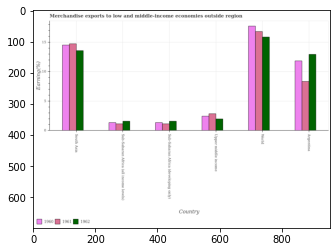

Number of QA =  29





,Country,1962,1961,1960
0,World,16.033914,17.008532,17.893412
1,South Asia,13.748107,14.914678,14.732296
2,Upper middie income,2.061890,2.968441,2.546548
3,Argentina,13.080845,8.428807,12.054940
4,Sub-Saharan Africa (all income levels),1.704847,1.230397,1.430375
5,Sub-Saharan Africa (developing only),1.708920,1.246885,1.425225


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1961 in sub-saharan africa (all income levels) and that in upper middle income ?
PREDICTED =  0.0
EXPECTED =  -1.7193970091560802




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports of/in 1961 and percentage of amount earned from merchandise exports of/in 1960 in south asia?
PREDICTED =  -13.501898589398975
EXPECTED =  0.21200344489179912




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

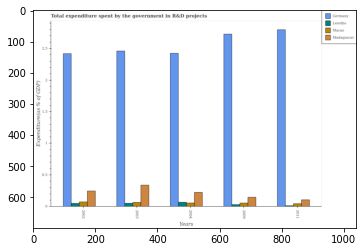

Number of QA =  30





,Years,Germany,Lesotho,Macao,Madagascar
0,2004,2.419300,0.075899,0.066338,0.230397
1,2002,2.411213,0.060488,0.083221,0.253740
2,2011,2.798662,NaN,0.055574,0.114397
3,2009,2.721567,0.039848,0.065374,0.154552
4,2003,2.452988,0.060533,0.075693,0.342977


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure spent by the government in r&d projects in madagascar in 2003 and that in 2011 ?
PREDICTED =  0.22857927735522432
EXPECTED =  0.23253




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure spent by the government in r&d projects in macao in 2011 and the total expenditure spent by the government in r&d projects in germany in 2009?
PREDICTED =  -2.665993048707569
EXPECTED =  -2.68336




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total expenditure spent by the government in r&d projects in

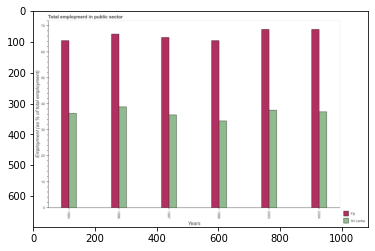

Number of QA =  28





,Years,Fiji,Sri Lanka
0,1998,64.082475,33.412434
1,1996,66.641400,38.749022
2,1993,63.932945,36.293646
3,2004,68.468334,36.817841
4,2003,68.203913,37.362510
5,1997,65.249855,35.447112


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in sri lanka in 1993 and that in 1998 ?
PREDICTED =  2.8812120255265015
EXPECTED =  2.899997711181598




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in sri lanka in 1993 and the employment in public sector in fiji in 1998?
PREDICTED =  2.8812120255265015
EXPECTED =  -28.0000038146973




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the employment in public sector in fiji and employment in public sector in sri lanka ?
PREDICTED =  29.749392802603637
EXPECTED =  31.69

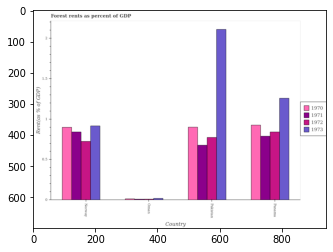

Number of QA =  30





,Country,1972,1971,1970,1973
0,Panama,0.853319,0.791519,0.931100,1.272645
1,Norway,0.727741,0.845175,0.900509,0.920148
2,Oman,NaN,0.014347,0.018698,0.024261
3,Pakistan,0.777668,0.681598,0.905170,2.127320


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in 1973 in pakistan and that in panama ?
PREDICTED =  0.8546757615412153
EXPECTED =  0.8518937179923698




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in 1973 in pakistan and the forest rent in 1970 in norway?
PREDICTED =  1.207172502365467
EXPECTED =  1.211472138099254




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent of/in 1971 and forest rent of/in 1973 in panama?
PREDICTED =  -1.2582981822519221
EXPECTED =  -0.46987642967837706




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: 

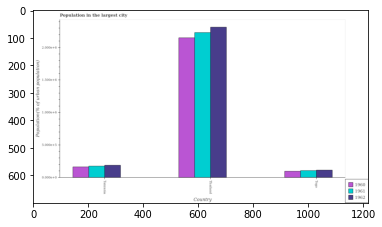

Number of QA =  29





,Country,1962,1961,1960
0,Thailand,2.339311,2.276816,2.186048
1,Tanzania,0.198742,0.184818,0.173214
2,NaN,0.122608,0.115253,0.107325


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city in 1961 in tanzania and that in togo ?
PREDICTED =  -2.09199846901354
EXPECTED =  68946.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city in 1962 in tanzania and the population in the largest city in 1960 in thailand?
PREDICTED =  -2.140569484167553
EXPECTED =  -1963347.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in the largest city of/in 1962 and population in the largest city of/in 1961 in togo?
PREDICTED =  2.2240582179325434
EXPECTED =  7266.0




				 

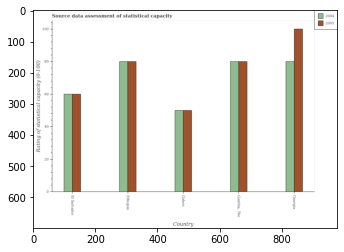

Number of QA =  28





,Country,2005,2004
0,El Salvador,60.709918,60.870909
1,Gabon,50.649612,50.465317
2,"Gambia, The",80.816212,80.970124
3,Ethiopia,80.871976,80.700269
4,Georgia,101.319045,80.295910


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in gambia, the and that in georgia ?
PREDICTED =  0.6742137611863939
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in el salvador and the rating of statistical capacity in 2005 in georgia?
PREDICTED =  -19.42500039060978
EXPECTED =  -40.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity of/in 2005 and rating of statistical capacity of/in 2004 in gabon?
PREDICTED =  -45.465317115361785
EXPECTED =  0.0




				 0

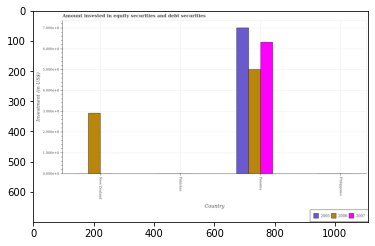

Number of QA =  21





,Country,2007,2005,2006
0,Pakistan,NaN,NaN,NaN
1,New Zealand,NaN,NaN,2.916681
2,Panama,6.310882,6.998639,4.980925
3,Philippines,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in 2006 in pakistan and the amount invested in equity securities and debt securities in 2005 in panama?
PREDICTED =  0.0
EXPECTED =  -700800000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities of/in 2005 and amount invested in equity securities and debt securities of/in 2007 in panama?
PREDICTED =  0.0
EXPECTED =  69200000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


> what is the difference between two consecutive major ticks on th

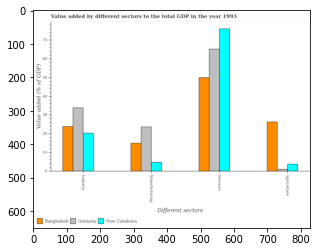

Number of QA =  29





,Different sectors,Germany,New Caledonia,Bangladesh
0,Manufacturing,23.886548,4.964484,15.077567
1,Services,64.992068,75.986742,49.653710
2,Agriculture,NaN,4.000864,26.482268
3,Industry,33.921286,20.492911,23.937759


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in new caledonia and that in bangladesh ?
PREDICTED =  26.33303239515385
EXPECTED =  26.071444201986708




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in bangladesh and the value added by manufacturing sector in germany?
PREDICTED =  2.5957205191587747
EXPECTED =  2.6259733226770017




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector and value added by agricultural sector in germany ?
PREDICTED =  -22.886547642231672
EXPECTED =  22.61547

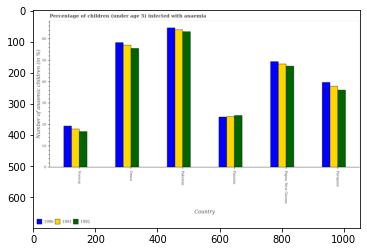

Number of QA =  29





,Country,1992,1990,1991
0,Papua New Guinea,47.656533,49.414376,48.230133
1,Panama,24.436681,23.720339,23.809727
2,Oman,55.406310,58.628965,56.944912
3,Pakistan,63.464237,65.377678,64.336685
4,Paraguay,36.439260,39.837721,37.840126
5,Norway,16.781262,19.405756,18.225456


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children infected with anaemia in in 1990 in oman and that in panama ?
PREDICTED =  34.90862602235224
EXPECTED =  34.8




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children infected with anaemia in in 1990 in papua new guinea and the percentage of children infected with anaemia in in 1991 in paraguay?
PREDICTED =  9.576654939619893
EXPECTED =  11.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children infected with anaemia in of/in 1992 and percentage of children infected with anaemia in

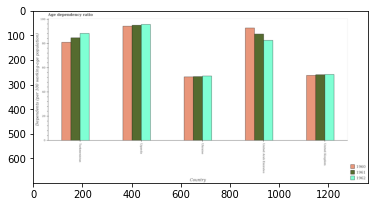

Number of QA =  29





,Country,1962,1961,1960
0,Turkmenistan,88.968735,84.689444,81.825826
1,United Kingdom,54.861712,54.785357,54.222909
2,Uganda,96.099252,95.758654,94.664008
3,Ukraine,53.676965,53.379779,52.670706
4,United Arab Emirates,83.125583,88.234617,93.530727


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in 1962 in ukraine ?
PREDICTED =  10.735393063119473
EXPECTED =  53.11542754476029




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished af

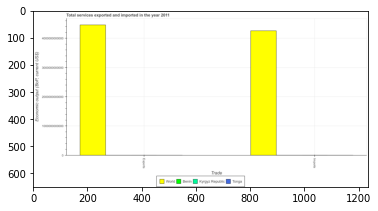

Number of QA =  23





,Trade,Benin,Kyrgyz Republic,Tonga,World
0,Imports,NaN,NaN,NaN,4.243316e+12
1,NaN,NaN,NaN,NaN,4.451789e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Economic output (BoP, current US$)
EXPECTED =  1000000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Total services exported and imported in the year 2011
EXPECTED =  Total services exported and imported in the year 2011




				 1 / 6 = 0.1667


> what is the 

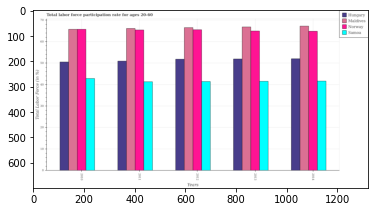

Number of QA =  30





,Years,Norway,Samoa,Maldives,Hungary
0,2014,64.240001,41.585518,67.207917,51.501478
1,2013,64.540153,41.514032,66.610089,51.759370
2,2010,65.415235,42.617760,65.328734,50.385071
3,2012,64.665869,41.297285,66.446452,51.553962
4,2011,64.840603,41.273646,65.856387,50.187608


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in samoa in 2011 and that in 2014 ?
PREDICTED =  -0.3118720432792088
EXPECTED =  -0.2999992370606037




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in hungary in 2010 and the labor force participation rate in norway in 2014?
PREDICTED =  -1.1164070012542595
EXPECTED =  -14.300003051757798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the labor force participation rate in samoa and labor force participation rate in hungary ?
PREDICTED =  203.28823996830062
E

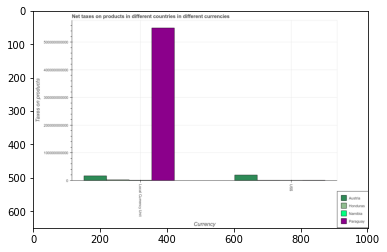

Number of QA =  23





,Currency,Honduras,Austria,Namibia,Paraquay
0,Local Currency Unit,NaN,1.923600e+10,NaN,5.531534e+11
1,NaN,NaN,2.225993e+10,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in constant 2005 us$ in paraguay and that in austria ?
PREDICTED =  -20747962348.244736
EXPECTED =  534341188800.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in constant 2005 us$ in paraguay and the net taxes in us$ in honduras?
PREDICTED =  1.0
EXPECTED =  550511580454.1351




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in us$ and net taxes in constant 2005 us$ in namibia ?
PREDICTED =  0.0
EXPECTED =  -406252682.435809




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

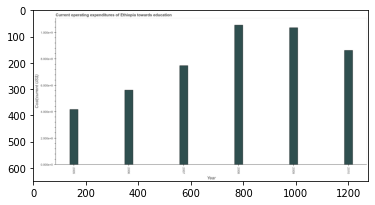

Number of QA =  23





,Year,Cost(current US$)
0,2007,26.561341
1,2010,30.544373
2,2009,36.681035
3,2006,19.958796
4,2005,14.932943
5,2008,37.306958


> what is the title of the graph ?
PREDICTED =  Current operating expenditures of Ethiopia towards education
EXPECTED =  Current operating expenditures of Ethiopia towards education




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cost(current US$)
EXPECTED =  Cost(current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education expenditure in 2005 and 2007 ?
PREDICTED =  -11.6283975198482
EXPECTED =  -332097931.977




				 3 / 4 = 0.75


> what is the median education expenditure ?
PREDICTED =  None
EXPECTED =  807185158.1129999




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio o

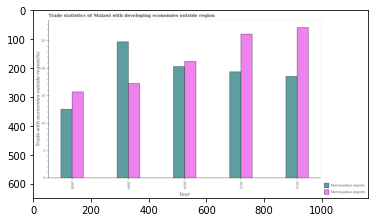

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,2010,21.326277,20.362940
1,2009,17.277613,24.961135
2,2008,15.778000,12.607240
3,2012,27.558946,18.562041
4,2011,26.278589,19.351893


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2010 and that in 2012 ?
PREDICTED =  -6.232669247662962
EXPECTED =  -6.173233699681202




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2012 and the merchandise exports in 2009?
PREDICTED =  10.281332836481646
EXPECTED =  10.186835149746699




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  8.389896401126567
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or

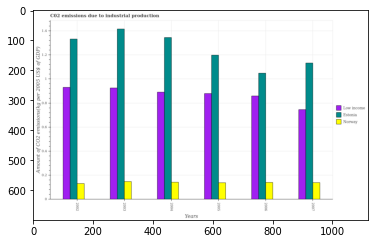

Number of QA =  29





,Years,Estonia,Low income,Norway
0,2005,1.205961,0.887383,0.141910
1,2006,1.051240,0.862203,0.145443
2,2003,1.432158,0.932966,0.152797
3,2002,1.342891,0.944821,0.136129
4,2007,1.135435,0.751151,0.144206
5,2004,1.351781,0.901209,0.147145


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in norway in 2003 and that in 2004 ?
PREDICTED =  0.005651975893099737
EXPECTED =  0.005561917060426996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in estonia in 2005 and the amount of co2 emitted due to industrial production in low income in 2006?
PREDICTED =  0.07052586701123698
EXPECTED =  0.33923303255830006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the amount of co2 emitted due to industrial production in 

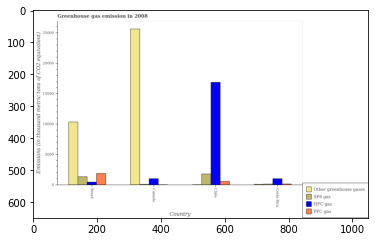

Number of QA =  30





,Country,HFC gas,PFC gas,Other greenhouse gases,SF6 gas
0,Brazil,571.944828,1975.776853,10429.399386,1444.58315
1,Costa Rica,1119.418749,NaN,NaN,NaN
2,Canada,1114.829651,NaN,25877.938747,NaN
3,Chile,16956.516852,657.615482,NaN,1900.84032


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emission of pfc gas in chile and that in costa rica ?
PREDICTED =  nan
EXPECTED =  434.70000000000005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emission of hfc gas in canada and the emission of sf6 gas in costa rica?
PREDICTED =  -4.589097905866538
EXPECTED =  887.8000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emission of sf6 gas and emission of pfc gas in costa rica ?
PREDICTED =  1900.8403203472947
EXPECTED =  -19.099999999999994




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

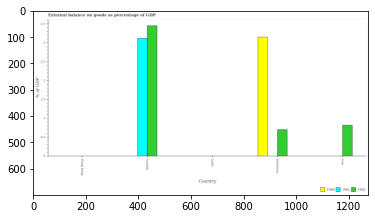

Number of QA =  23





,Country,1962,1961,1960
0,Iceland,3.486414,3.157055,NaN
1,Indonesia,0.716659,NaN,3.186121
2,Iran,0.838172,NaN,NaN
3,Hong Kong,NaN,NaN,NaN
4,India,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in 1962 in indonesia and the external balance on goods as percentage of gdp in 1960 in iran?
PREDICTED =  -0.12151297713637599
EXPECTED =  0.7028956208022981




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp of/in 1962 and external balance on goods as percentage of gdp of/in 1960 in indonesia?
PREDICTED =  -2.408706017289946
EXPECTED =  -2.4479053500714922




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the external balance on goods as percentage of gdp in 1

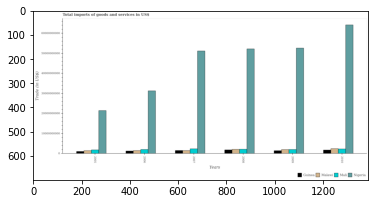

Number of QA =  30





,Years,Mali,Malawi,Nigeria,Guinea
0,2008,2.322747e+09,2.277589e+09,5.218256e+10,NaN
1,2009,2.197464e+09,2.128272e+09,5.232959e+10,1.606700e+09
2,2007,2.523349e+09,1.700734e+09,5.110106e+10,1.634481e+09
3,2010,2.458507e+09,2.637596e+09,6.390752e+10,1.951108e+09
4,2005,2.034694e+09,1.621946e+09,2.151506e+10,1.209889e+09
5,2006,2.216964e+09,1.694305e+09,3.126232e+10,1.428669e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in malawi in 2006 and that in 2010 ?
PREDICTED =  -4331900619.330295
EXPECTED =  -957849173.1247902




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in malawi in 2008 and the total imports of goods and services in guinea in 2006?
PREDICTED =  -1694304717.9320035
EXPECTED =  842263692.1635101




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the total imports of goods and services in mali and total imports of goods and services in nigeria ?
PREDICTED =  

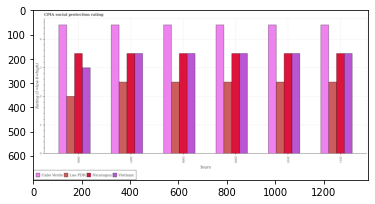

Number of QA =  30





,Years,Lao PDR,Cabo Verde,Nicaragua,Vietnam
0,2006,2.018490,4.533307,3.548145,3.021867
1,2010,2.528533,4.541422,3.544439,3.528120
2,2009,2.529908,4.551832,3.552308,3.527655
3,2008,2.531942,4.541989,3.545694,3.527362
4,2007,2.531962,4.549274,3.558878,3.527163
5,2011,2.531340,4.548466,3.547765,3.542767


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in nicaragua in 2007 and that in 2010 ?
PREDICTED =  0.014438859288278039
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in lao pdr in 2011 and the cpia rating in vietnam in 2008?
PREDICTED =  -0.0006016354291316084
EXPECTED =  -1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the cpia rating in nicaragua and cpia rating in cabo verde ?
PREDICTED =  15.297228821074132
EXPECTED =  -1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

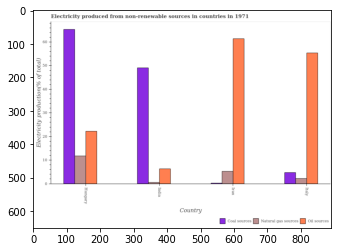

Number of QA =  29





,Country,Natural gas sources,Oil sources,Coal sources
0,Italy,2.452065,56.048887,4.995281
1,India,NaN,6.561197,49.641289
2,Iran,5.499911,62.132807,NaN
3,Hungary,12.025497,22.583967,66.314137


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by coal in india and that in italy ?
PREDICTED =  44.646008483802966
EXPECTED =  44.35703489963357




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources in italy and the percentage of electricity produced by natural gas in india?
PREDICTED =  49.487690037322736
EXPECTED =  54.82750846805429




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources and percentage of electricity produced by coal in india ?
PREDICTED =  

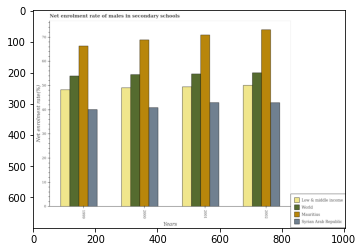

Number of QA =  30





,Years,Low & middle income,Mauritius,Syrian Arab Republic,World
0,2000,49.754030,69.606888,41.380919,55.160317
1,2002,50.558274,74.363351,43.482287,55.719734
2,1999,49.007584,66.890071,40.648324,54.807181
3,2001,50.204605,71.650789,43.518441,55.723414


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in mauritius in 2001 and that in 2002 ?
PREDICTED =  -2.7125615533939964
EXPECTED =  -2.1722564697264914




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in world in 2002 and the net enrolment rate of males in secondary schools in mauritius in 1999?
PREDICTED =  -11.170337207763176
EXPECTED =  -11.079269409179595




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net enrolment rate of males in secondary schools in world and 

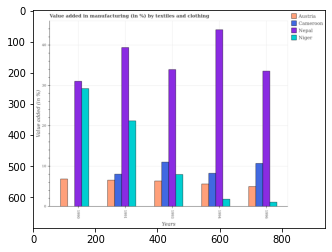

Number of QA =  27





,Years,Austria,Nepal,Cameroon,Niger
0,1991,6.658583,39.314564,8.185488,21.409747
1,1996,5.115940,33.688406,10.755559,1.170888
2,1994,5.746720,43.577259,8.429962,1.952706
3,1990,6.961544,31.060961,NaN,29.333667
4,1993,6.383016,33.982920,11.093815,8.039182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by textiles and clothing in nepal in 1993 and that in 1994 ?
PREDICTED =  -28.982919529124274
EXPECTED =  -9.864801228578685




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by textiles and clothing in niger in 1991 and the percentage of value added in manufacturing by textiles and clothing in nepal in 1996?
PREDICTED =  -17.580635148821685
EXPECTED =  -12.325668289135496




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the percentage of 

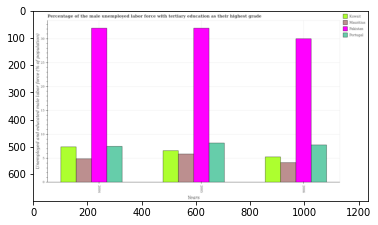

Number of QA =  30





,Years,Portugal,Mauritius,Pakistan,Kuwait
0,2006,7.906656,4.205474,30.014621,5.368398
1,2005,8.260076,5.972868,32.133904,6.722033
2,2004,7.640505,5.002292,32.197999,7.513271


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with tertiary education in mauritius in 2005 and that in 2006 ?
PREDICTED =  1.767394276293028
EXPECTED =  1.8000001907348597




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with tertiary education in mauritius in 2005 and the percentage of the unemployed male labor force with tertiary education in pakistan in 2006?
PREDICTED =  1.767394276293028
EXPECTED =  -24.099999904632572




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the p

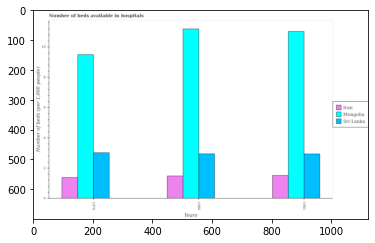

Number of QA =  29





,Years,Mongolia,Iran,Sri Lanka
0,1980,11.142356,1.518589,2.936783
1,1970,9.465686,1.405395,3.026053
2,1981,10.962864,1.543746,2.941266


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in sri lanka in 1970 and that in 1980 ?
PREDICTED =  0.08926948176604999
EXPECTED =  0.07290005683899015




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in sri lanka in 1981 and the number of beds in the hospiatls of in mongolia in 1980?
PREDICTED =  -8.201090399340401
EXPECTED =  -8.25959992408755




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the number of beds in the hospiatls of in sri lanka and number of beds in the hospiatls of in mongolia ?
PRE

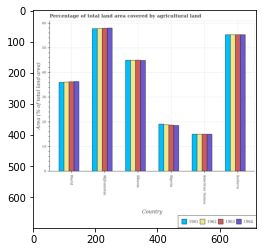

Number of QA =  30





,Country,1964,1962,1961,1963
0,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN
2,American Samoa,15.133867,14.980540,15.256934,15.110942
3,Andorra,55.677318,55.551956,55.807027,55.792774
4,Afghanistan,58.820041,58.247795,58.234959,58.869128
5,World,36.790110,36.673769,36.466750,36.824599


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1963 in afghanistan and that in world ?
PREDICTED =  22.04452930343868
EXPECTED =  21.674533847991917




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1962 in algeria and the percentage of agricultural land in 1964 in american samoa?
PREDICTED =  43.26725472145291
EXPECTED =  3.851763836522899




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land of/in 1964 and percentage of agricultural land of/in 1962 in afghanistan?
PREDICTED =  -2.570477

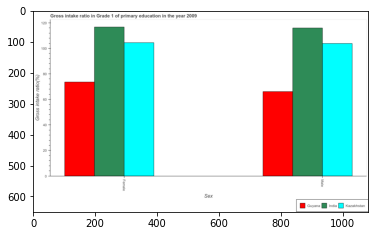

Number of QA =  23





,Sex,India,Guyana,Kazakhstan
0,Female,116.533098,74.306884,104.832413
1,Male,115.876872,66.830881,104.752735


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross intake ratio(female) in guyana ?
PREDICTED =  0.6412572414310935
EXPECTED =  73.6142807006835




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross intake ratio(female) ?
PREDICTED =  1.0056631248070715
EXPECTED =  116.721458435059




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross intake ratio(male) ?
PREDICTED =  0.5767404623606023
EXPECTED =  66.1379470825195




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


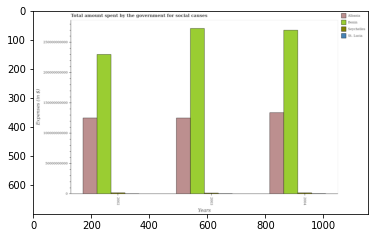

Number of QA =  30





,Years,St. Lucia,Seychelles,Albania,Benin
0,2004,NaN,NaN,1.347802e+11,2.709707e+11
1,2003,NaN,NaN,1.256453e+11,2.741369e+11
2,2002,NaN,NaN,1.257843e+11,2.300020e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in albania in 2002 and that in 2004 ?
PREDICTED =  -8995851205.11261
EXPECTED =  -8804245000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount spent for social causes by the government in seychelles in 2002 to that in 2003?
PREDICTED =  0.8390040580355151
EXPECTED =  1.3191256830601092




				 1 / 4 = 0.25


is_built_with_cud

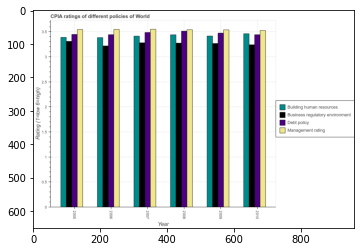

Number of QA =  30





,Year,Management rating,Building human resources,Debt policy,Business regulatory environment
0,2009,3.539178,3.416822,3.478215,3.273385
1,2010,3.518900,3.484918,3.467330,3.238659
2,2005,3.531495,3.383676,3.445663,3.316008
3,2008,3.559132,3.463517,3.504179,3.274721
4,2007,3.567713,3.416349,3.485878,3.288901
5,2006,3.575163,3.403582,3.441786,3.215393


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of management in 2007 and that in 2010 ?
PREDICTED =  0.04881357775023876
EXPECTED =  0.025137085137080017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of business regulatory environment in 2008 and the cpia rating of building human resources in 2009?
PREDICTED =  0.0013360215972593181
EXPECTED =  0.007099567099559945




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating of management and cpia rating of building human resources ?
PREDICTED =  17.80666316275104
EXPECTED =  0.0




				

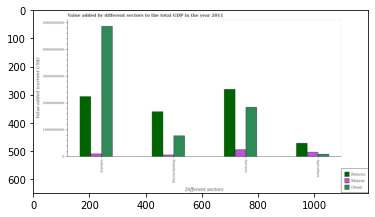

Number of QA =  29





,Different sectors,Belarus,Malawi,Oman
0,Manufacturing,1.693305e+10,9.185138e+08,8.012316e+09
1,Services,2.524622e+10,2.880593e+09,1.866559e+10
2,Industry,2.265761e+10,1.304242e+09,4.893066e+10
3,Agriculture,5.223380e+09,1.898871e+09,1.143493e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in malawi and that in belarus ?
PREDICTED =  -21353372162.41905
EXPECTED =  -21421636299.18626




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in malawi and the value added by manufacturing sector in oman?
PREDICTED =  -55638738178.97727
EXPECTED =  -6763375019.102523




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector and value added by industrial sector in oman ?
PREDICTED =  -67596257726.469246
EXPECTED =  -30268920676.202896




				 1 / 3

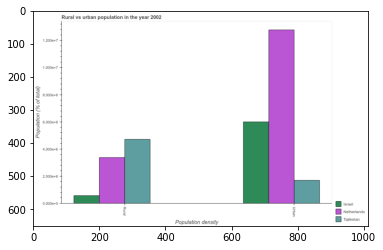

Number of QA =  23





,Population density,Tajikistan,Israel,Netherlands
0,Rural,0.475521,0.060882,0.342071
1,Urban,0.174239,0.603314,1.283984


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density in israel and that in tajikistan ?
PREDICTED =  0.42907572008155936
EXPECTED =  4307202




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population density in netherlands and the urban population density in tajikistan?
PREDICTED =  0.16783275081462595
EXPECTED =  1679848




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rural population density in netherlands to tha

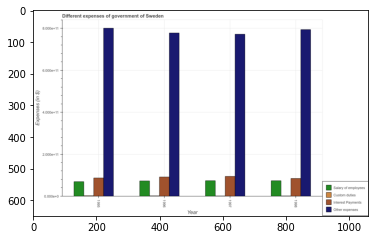

Number of QA =  30





,Year,Custom duties,Interest Payments,Other expenses,Salary of employees
0,1998,NaN,3.457207,31.733842,3.021110
1,1995,NaN,3.542104,32.057092,2.837312
2,1996,NaN,3.726302,31.085985,2.976266
3,1997,NaN,3.839134,30.863870,3.029555


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on salary of employees in 1996 and that in 1998 ?
PREDICTED =  -0.04484419565456621
EXPECTED =  -825000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on salary of employees in 1997 and the amount spent on interest payments in 1998?
PREDICTED =  27.84275977084599
EXPECTED =  175000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the amount spent on other expenses and amount spent on interest payments ?
PREDICTED =  122.28358085351103
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda

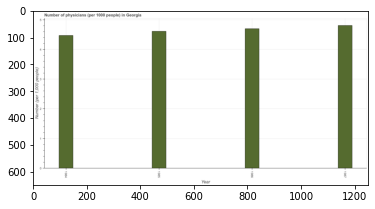

Number of QA =  23





,Year,"Number (per 1,000 people)"
0,1985,4.642941
1,1984,4.503837
2,1987,4.802990
3,1986,4.733294


> what is the title of the graph ?
PREDICTED =  Number of physicians (per 1000 people) in Georgia
EXPECTED =  Number of physicians (per 1000 people) in Georgia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number (per 1,000 people)
EXPECTED =  Number (per 1,000 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in 1984 and 1986 ?
PREDICTED =  -0.22945618990608718
EXPECTED =  -0.227




				 4 / 4 = 1.0


> what is the median number of physicians ?
PREDICTED =  None
EXPECTED =  4.65485000610351




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number

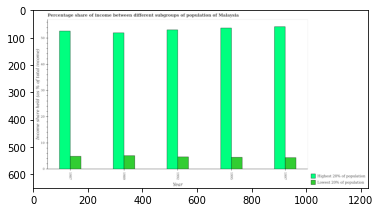

Number of QA =  28





,Year,Lowest 20% of population,Highest 20% of population
0,1987,5.005551,52.479909
1,1997,4.545883,54.381200
2,1989,5.245394,51.858681
3,1992,4.836667,53.101163
4,1995,4.633406,53.934354


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in 1989 and that in 1995 ?
PREDICTED =  0.6119873869644801
EXPECTED =  -1.8200000000000003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in 1997 and the income share held by lowest 20% of the population in 1992?
PREDICTED =  -48.555279632884435
EXPECTED =  1.2100000000000009




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


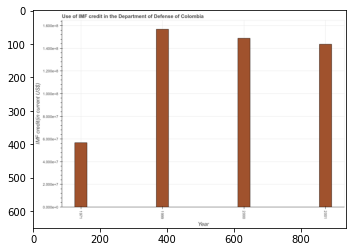

Number of QA =  23





,Year,IMF credit(in current US$)
0,1971,0.570233
1,1999,1.570917
2,2001,1.436417
3,2000,1.488582


> what is the title of the graph ?
PREDICTED =  Use of IMF credit in the Department of Defense of Colombia
EXPECTED =  Use of IMF credit in the Department of Defense of Colombia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  IMF credit(in current US$)
EXPECTED =  IMF credit(in current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the use of imf credit in dod in 1971 and 2001 ?
PREDICTED =  -0.8661839884844077
EXPECTED =  -86880000.0




				 3 / 4 = 0.75


> what is the median use of imf credit in dod ?
PREDICTED =  None
EXPECTED =  146246500.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

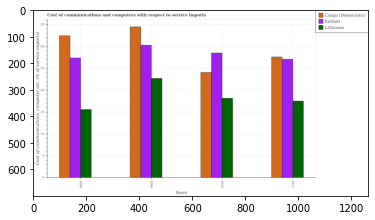

Number of QA =  29





,Years,Congo (Democratic),Lithuania,Kiribati
0,2008,32.186863,15.530128,27.366088
1,2010,23.778254,18.070956,28.369808
2,2011,27.468493,17.433996,26.904295
3,2009,34.160230,22.522897,30.178843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in lithuania in 2008 and that in 2011 ?
PREDICTED =  18.630102342898745
EXPECTED =  -1.9312301758987012




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in lithuania in 2011 and the cost of communications and computers in kiribati in 2010?
PREDICTED =  16.089273961172307
EXPECTED =  -10.986165931673899




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cost of communications and computers in congo (democratic) and cost of communications and compute

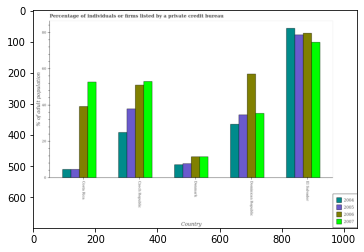

Number of QA =  30





,Country,2007,2005,2004,2006
0,Dominican Republic,36.189475,35.278172,30.141436,57.773688
1,Denmark,11.960284,8.198300,7.654981,12.147480
2,El Salvador,75.362855,79.738316,83.199982,80.427585
3,Czech Republic,53.625768,38.522833,25.381271,51.541480
4,Costa Rica,53.493674,4.990387,4.972026,39.731233


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population listed by a private credit bureau in 2006 in dominican republic and that in el salvador ?
PREDICTED =  -22.653896517890686
EXPECTED =  -22.499999999999993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population listed by a private credit bureau in 2005 in dominican republic and the percentage of population listed by a private credit bureau in 2007 in denmark?
PREDICTED =  27.079872310788225
EXPECTED =  23.1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population listed by a pr

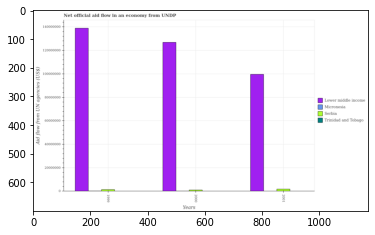

Number of QA =  27





,Years,Micronesia,Serbia,Trinidad and Tobago,Lower middle income
0,2000,NaN,NaN,NaN,1.266270e+08
1,1999,NaN,1.765216e+06,NaN,1.387009e+08
2,2001,NaN,2.179640e+06,NaN,9.945211e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in micronesia in 1999 and that in 2001 ?
PREDICTED =  0.0
EXPECTED =  170000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net official aid flow in micronesia and net official aid flow in serbia ?
PREDICTED =  -1972427.9258991596
EXPECTED =  -1210000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net official aid flow in trinidad and tobago in 200

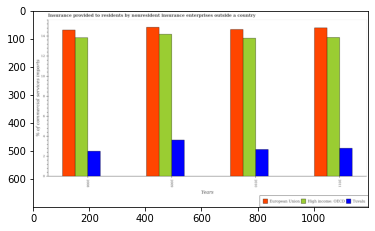

Number of QA =  29





,Years,Tuvalu,High income: OECD,European Union
0,2010,2.731718,13.940376,14.739170
1,2009,3.681221,14.315974,14.981381
2,2008,2.569965,13.954199,14.640397
3,2011,2.842806,13.896205,14.902278


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in european union in 2008 and that in 2009 ?
PREDICTED =  -0.3409834126408047
EXPECTED =  -0.2742362887021006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in european union in 2011 and the insurance provided to residents in high income: oecd in 2010?
PREDICTED =  0.16310810011559873
EXPECTED =  1.0374191161866992




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

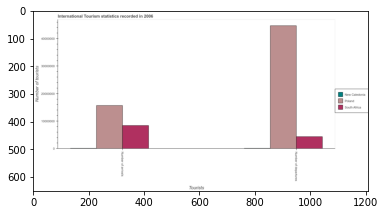

Number of QA =  23





,Tourists,New Caledonia,South Africa,Poland
0,Number of arrivals,NaN,8.526519e+06,1.585873e+07
1,Number of departures,NaN,4.567871e+06,4.510084e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tourist departures in poland to that in new caledonia ?
PREDICTED =  22550419.77670406
EXPECTED =  446.96




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of tourists
EXPECTED =  10000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  International Tourism statistics rec

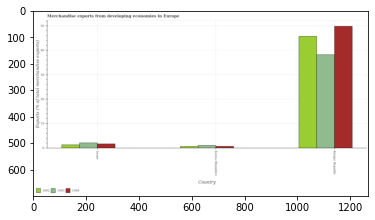

Number of QA =  29





,Country,1992,1993,1994
0,Kyrgyz Republic,45.858884,38.690729,50.530531
1,Korea (Republic),NaN,1.265458,NaN
2,Israel,1.478324,2.292508,1.935100


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total merchandise exports in 1993 in israel and that in kyrgyz republic ?
PREDICTED =  -36.39822025689703
EXPECTED =  -36.12172736402721




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total merchandise exports in 1993 in kyrgyz republic and the percentage of total merchandise exports in 1994 in israel?
PREDICTED =  36.39822025689703
EXPECTED =  36.5399328250925




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total merchandise exports of/in 1994 and percentage of total merchandise exports of/i

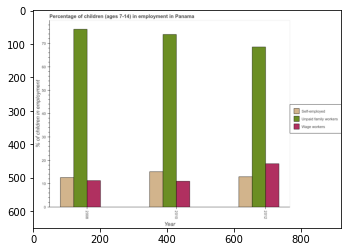

Number of QA =  29





,Year,Self-employed,Unpaid family workers,Wage workers
0,2010,15.276487,73.344602,11.195750
1,2012,13.037659,68.206234,18.644831
2,2008,12.680482,76.129527,11.520070


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed children in 2010 and that in 2012 ?
PREDICTED =  2.2388281969937296
EXPECTED =  2.16




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed children in 2008 and the percentage of children employed as wage workers in 2012?
PREDICTED =  -0.35717712975922034
EXPECTED =  -0.3600000000000012




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percenta

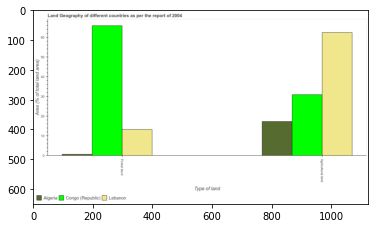

Number of QA =  23





,Type of land,Lebanon,Algeria,Congo (Republic)
0,Agricultural land,62.506070,17.607452,31.178413
1,Forest land,13.595625,0.881928,66.101049


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in algeria and the percentage of land area under agriculture in congo (republic)?
PREDICTED =  -96.39753341328134
EXPECTED =  -30.229959835582115




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture and percentage of land area under forests in lebanon ?
PREDICTED =  1.0
EXPECTED =  49.1593352883675




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







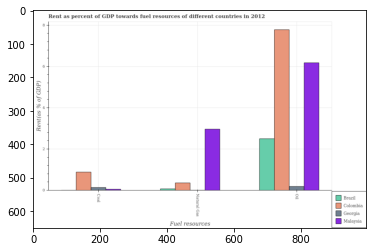

Number of QA =  28





,Fuel resources,Malaysia,Georgia,Brazil,Colombia
0,Natural Gas,2.988118,NaN,NaN,0.383885
1,Coal,NaN,0.164701,NaN,0.903240
2,Oil,6.198465,0.212075,2.530173,7.839450


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards coal in brazil and that in georgia ?
PREDICTED =  -0.16470142084207925
EXPECTED =  -0.1326169674309977




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in malaysia and the rent towards coal in georgia?
PREDICTED =  2.823416233195603
EXPECTED =  2.827882513553941




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards oil and rent towards natural gas in georgia ?
PREDICTED =  6.1984653955923354
EXPECTED =  0.18129840901345534




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: 

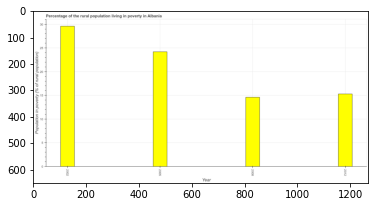

Number of QA =  23





,Year,Population in poverty (% of rural population)
0,2012,15.482828
1,2005,24.438836
2,2002,29.835748
3,2008,14.831724


> what is the title of the graph ?
PREDICTED =  Percentage of the rural population living in poverty in Albania
EXPECTED =  Percentage of the rural population living in poverty in Albania




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population in poverty (% of rural population)
EXPECTED =  Population in poverty (% of rural population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population living below poverty line in 2002 and 2012 ?
PREDICTED =  -0.6511041697018509
EXPECTED =  14.3




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of rural populat

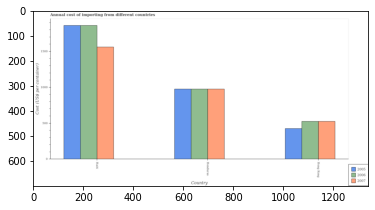

Number of QA =  29





,Country,2007,2005,2006
0,Haiti,1569.326938,1860.830053,1863.420032
1,Hong Kong,528.269848,434.109881,527.850392
2,Honduras,979.692322,981.144481,978.466147


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2006 in haiti and that in honduras ?
PREDICTED =  884.9538846580004
EXPECTED =  885.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2007 in haiti and the total annual cost of importing in 2005 in honduras?
PREDICTED =  589.634615721828
EXPECTED =  585.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing of/in 2006 and total annual cost of importing of/in 2005 in hong kong?
PREDICTED =  2935.6266899813672
EXPECTED =  100.0




				 2 / 3 =

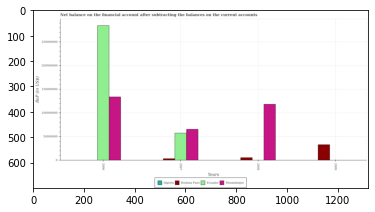

Number of QA =  26





,Years,Mozambique,Algeria,Burkina Faso,Ecuador
0,2009,NaN,NaN,3.407194e+07,NaN
1,2008,1.193589e+08,NaN,6.357091e+06,NaN
2,2006,1.358883e+08,NaN,NaN,2.855612e+08
3,2007,6.645333e+07,NaN,4.312584e+06,5.858868e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in mozambique in 2007 and that in 2008 ?
PREDICTED =  -52905515.15712442
EXPECTED =  -52837171.029999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in burkina faso in 2008 and the balance of payments in algeria in 2009?
PREDICTED =  -27714844.216934368
EXPECTED =  5522489.897999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments in ecuador and balance of payments in burkina faso ?
PREDICTED =  299408302.82862103
EXPECTED =  54070688.108




				 1 / 3 =

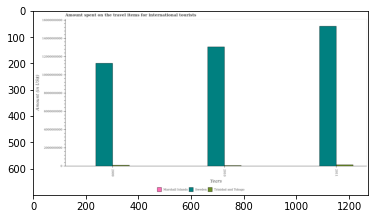

Number of QA =  29





,Years,Sweden,Marshall Islands,Trinidad and Tobago
0,2009,1.133471e+10,NaN,NaN
1,2011,1.534216e+10,NaN,1.996696e+08
2,2010,1.310096e+10,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for international tourists in sweden in 2009 and that in 2011 ?
PREDICTED =  -4007454642.9341583
EXPECTED =  -4058000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items for international tourists in trinidad and tobago in 2011 and the amount spent on the travel items for international tourists in sweden in 2009?
PREDICTED =  -15342159439.253828
EXPECTED =  -11118000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the amount spent on the travel items f

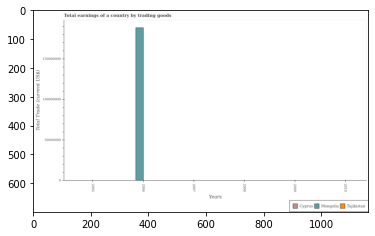

Number of QA =  18





,Years,Tajikistan,Cyprus,Mongolia
0,2010,NaN,NaN,NaN
1,2006,NaN,NaN,1.897102e+08
2,2009,NaN,NaN,NaN
3,2008,NaN,NaN,NaN
4,2007,NaN,NaN,NaN
5,2005,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in tajikistan in 2010 and the total earnings in mongolia in 2009?
PREDICTED =  -189710214.20986447
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest total earnings in mongolia ?
PREDICTED =  -189708209.20986447
EXPECTED =  188510000.0




				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Total Trade (current US$)
EXPECTED =  50000000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Total earnings of a country by trading gc
EXPECTED =  Total earnings of a country by trading goods




				 0 / 4 = 0.0


> what is the label or title of the x-axis ?


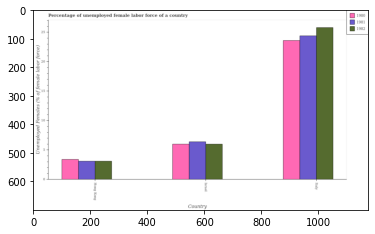

Number of QA =  29





,Country,1982,1980,1981
0,Italy,25.862575,23.903231,24.526838
1,Israel,6.055986,6.043209,6.442246
2,Hong Kong,3.143509,3.461142,3.149403


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female labor force in 1981 in hong kong and that in israel ?
PREDICTED =  -3.2928427657806396
EXPECTED =  -3.300000190734859




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female labor force in 1980 in israel and the percentage of unemployed female labor force in 1981 in hong kong?
PREDICTED =  2.582066946491168
EXPECTED =  2.90000009536743




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female labor force of/in 1981 and percentage of unemployed female labor f

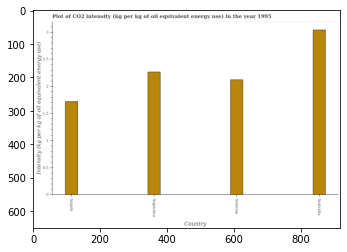

Number of QA =  22





,Country,Intensity (kg per kg of oil equivalent energy use)
0,Armenia,2.153226
1,Australia,3.090475
2,Argentina,2.300573
3,Angola,1.751342


> what is the title of the graph ?
PREDICTED =  Plot of CO2 intensity (kg per kg of oil equivalent energy use) in the year 1995
EXPECTED =  Plot of CO2 intensity (kg per kg of oil equivalent energy use) in the year 1995




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Intensity (kg per kg of oil equivalent energy use)
EXPECTED =  Intensity (kg per kg of oil equivalent energy use)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in angola and argentina ?
PREDICTED =  -0.5492307311269307
EXPECTED =  -0.545




				 4 / 4 = 1.0


> what is the median co2 intensity ?
PREDICTED =  None
EXPECTED =  2.19422450562897




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


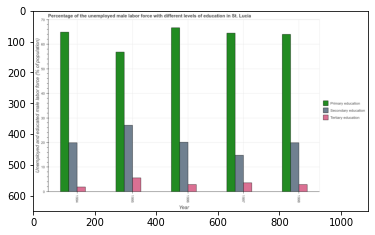

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,1998,20.496363,3.205072,64.655585
1,1995,27.693032,5.942410,57.596338
2,1996,20.607295,3.188480,67.415149
3,1994,20.306772,2.210301,65.569500
4,1997,15.208568,3.919659,65.090302


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in 1995 and that in 1996 ?
PREDICTED =  2.7539304620873666
EXPECTED =  2.699999809265141




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in 1994 and the percentage of male labor force who received primary education in 1995?
PREDICTED =  -3.7321095399224142
EXPECTED =  -3.6999999284744307




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalu

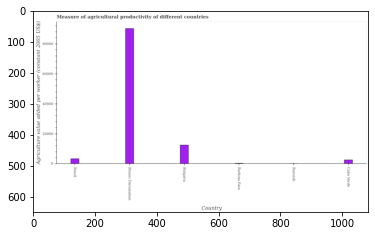

Number of QA =  22





,Country,Agriculture value added per worker (constant 2005 US$)
0,Brunei Darussalam,90706.410031
1,Brazil,3693.895054
2,Burkina Faso,686.919574
3,Burundi,NaN
4,Bulgaria,12727.427486
5,Cabo Verde,2972.522879


> what is the title of the graph ?
PREDICTED =  Measure of agricultural productivity of different countries
EXPECTED =  Measure of agricultural productivity of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Agriculture value added per worker (constant 2005 US$)
EXPECTED =  Agriculture value added per worker (constant 2005 US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agriculture value added per worker in brazil and bulgaria ?
PREDICTED =  -9033.532431510654
EXPECTED =  -9150.741




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median agriculture value added 

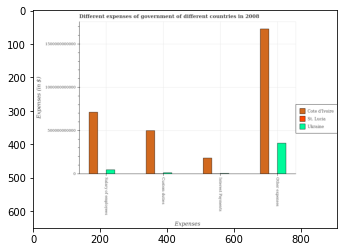

Number of QA =  29





,Expenses,Cote d'Ivoire,Ukraine,St. Lucia
0,Custom duties,5.034633e+11,NaN,NaN
1,Other expenses,1.687208e+12,3.582986e+11,NaN
2,Interest Payments,1.868011e+11,NaN,NaN
3,Salary of employees,7.139981e+11,5.127563e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on other expenses in ukraine and that in cote d'ivoire ?
PREDICTED =  -1328909718972.5889
EXPECTED =  -1321147500000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties in cote d'ivoire and the amount spent on interest payments in ukraine?
PREDICTED =  503463255625.418
EXPECTED =  494281200000




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 4 = 0.5


is_built_with_cud

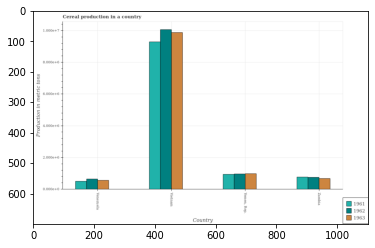

Number of QA =  29





,Country,1963,1962,1961
0,Vietnam,34.795036,35.641574,32.716032
1,Zambia,2.455726,2.734096,2.766879
2,Venezuela,2.053831,2.335808,1.849485
3,"Yemen, Rep.",3.504190,3.444227,3.350035


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in 1962 in venezuela and that in zambia ?
PREDICTED =  -0.39828810200315434
EXPECTED =  -104704.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production in 1963 in venezuela and the total cereal production in 1962 in vietnam?
PREDICTED =  -32.741204971519785
EXPECTED =  -9498740.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal production of/in 1962 and total cereal production of/in 1961 in zambia?
PREDICTED =  41.38882610252828
EXPECTED =  -17674.0




				 0 / 3 = 0.0


is_built_

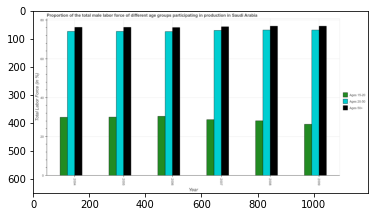

Number of QA =  29





,Year,Ages 50+,Ages 20-50,Ages 15-20
0,2005,76.732828,74.517697,30.250556
1,2006,76.486254,74.416845,30.953273
2,2007,77.219765,75.242054,29.192779
3,2009,77.345472,75.376246,26.549080
4,2004,77.052028,74.154664,30.253640
5,2008,77.306158,75.323056,28.467703


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 in 2005 and that in 2009 ?
PREDICTED =  3.701475458078054
EXPECTED =  3.7000007629394993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 in 2006 and the percentage of male labor force above age 50 in 2008?
PREDICTED =  -44.42297277413775
EXPECTED =  2.299999237060618




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of male labor force within the age group 15-20 and percentage of male labor for

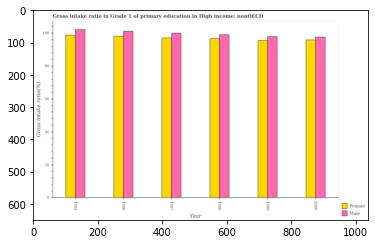

Number of QA =  28





,Year,Female,Male
0,1996,98.544035,101.055862
1,1997,97.325205,100.327830
2,1995,99.176058,102.519604
3,1998,96.958779,99.160090
4,1999,95.890142,98.096076
5,2000,96.044389,97.541609


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross intake ratio(female) in 1995 ?
PREDICTED =  0.25513615719010735
EXPECTED =  98.7577362060547




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum gross intake ratio(female) ?
PREDICTED =  0.25513615719010735
EXPECTED =  98.7577362060547




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross intake ratio(female) ?
PREDICTED =  5.142543362491082
EXPECTED =  95.4540634155273




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the gr

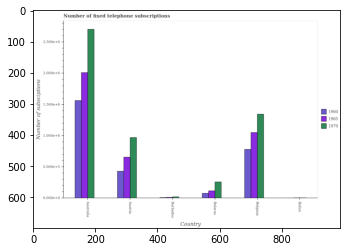

Number of QA =  29





,Country,1965,1970,1960
0,Belize,NaN,NaN,NaN
1,Barbados,NaN,NaN,NaN
2,Belarus,0.126229,0.269470,0.086054
3,Austria,0.661390,0.979155,0.439496
4,NaN,1.055313,1.347774,0.794203
5,Australia,2.044784,2.769178,1.579065


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in 1960 in austria and that in belarus ?
PREDICTED =  -0.5605040526795859
EXPECTED =  353807.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in 1970 in belarus and the number of fixed telephone subscriptions in 1965 in belize?
PREDICTED =  -2.0
EXPECTED =  254800.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions of/in 1960 and number of fixed telephone subscriptions of/in 1970 in barbados?
PREDICTED =  1.0
EXPECTED

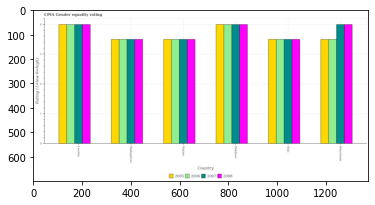

Number of QA =  30





,Country,2007,2005,2008,2006
0,Malawi,NaN,3.559394,3.537711,NaN
1,Mauritania,4.036776,3.536057,4.063287,3.546663
2,Lesotho,4.055298,4.039412,4.057458,NaN
3,Mali,3.544329,3.538214,3.547041,NaN
4,Madagascar,NaN,3.544818,3.542806,NaN
5,Maldives,4.044765,4.048767,4.052393,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in malawi and that in mauritania ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in malawi and the cpia rating in 2008 in maldives?
PREDICTED =  -0.48937253406613257
EXPECTED =  -0.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2007 and cpia rating of/in 2005 in maldives?
PREDICTED =  -0.0487669121033516
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation 

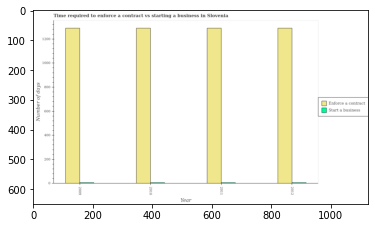

Number of QA =  28





,Year,Enforce a contract,Start a business
0,2010,1305.235684,NaN
1,2012,1305.200863,NaN
2,2009,1306.859051,NaN
3,2011,1301.586669,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2011 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2011 and the number of days to enforece a contract in 2012?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting 

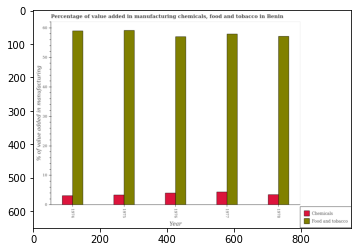

Number of QA =  28





,Year,Food and tobacco,Chemicals
0,1977,58.005928,4.579384
1,1974,59.326523,3.309523
2,1975,59.230733,3.556953
3,1976,57.173542,4.206604
4,1978,57.333961,3.650107


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by  manufacturing chemicals in 1976 and that in 1978 ?
PREDICTED =  0.5564975143161921
EXPECTED =  0.5331032467468297




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by  manufacturing chemicals in 1977 and the value added by manufacturing food and tobacco in 1978?
PREDICTED =  0.92927721186993
EXPECTED =  0.9003556517038303




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the value added by manufacturing food and tobacco and value added by  manufacturing chemicals ?
PREDICTED =  271.7681148154806
E

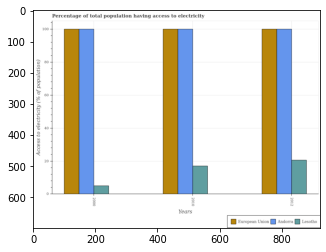

Number of QA =  29





,Years,Lesotho,Andorra,European Union
0,2012,20.992531,100.379857,100.338372
1,2000,5.299952,100.176705,99.992076
2,2010,17.404163,100.068742,100.096769


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in lesotho in 2000 and that in 2012 ?
PREDICTED =  -15.692578594947218
EXPECTED =  -15.562560000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in andorra in 2000 and the percentage of population that have access to electricity in european union in 2012?
PREDICTED =  -95.07990451207992
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of population that have access to elect

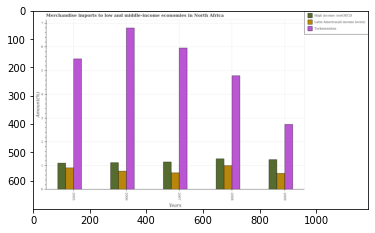

Number of QA =  29





,Years,Turkmenistan,High income: nonOECD,Latin America(all income levels)
0,2009,2.776190,1.277243,0.691848
1,2007,6.006457,1.182141,0.717630
2,2005,5.552535,1.139935,0.927271
3,2008,4.823829,1.314001,1.023604
4,2006,6.853897,1.154220,0.792665


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in high income: nonoecd in 2005 and that in 2006 ?
PREDICTED =  -0.014284892280669093
EXPECTED =  -0.01981105139973005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in turkmenistan in 2005 and the percentage of amount earned from merchandise imports in latin america(all income levels) in 2006?
PREDICTED =  4.759870691551205
EXPECTED =  4.72676600543487




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage 

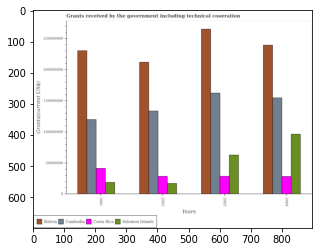

Number of QA =  30





,Years,Cambodia,Bolivia,Costa Rica,Solomon Islands
0,2004,1.546861e+08,2.400580e+08,2.907154e+07,9.645995e+07
1,2001,1.206030e+08,2.313253e+08,4.193120e+07,1.937693e+07
2,2003,1.631282e+08,2.652687e+08,2.909421e+07,6.338520e+07
3,2002,1.345967e+08,2.124199e+08,2.892242e+07,1.765704e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in bolivia in 2001 and that in 2004 ?
PREDICTED =  -8732748.666347265
EXPECTED =  -8990000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in cambodia in 2001 and the total grants received by the government in solomon islands in 2002?
PREDICTED =  -13993692.738514021
EXPECTED =  102680000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the total grants received by the government in costa rica and total grants received by the government in cam

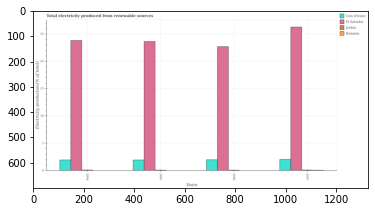

Number of QA =  30





,Years,Cote d'Ivoire,El Salvador,Jordan,Romania
0,2005,2.007594,23.647545,NaN,NaN
1,2006,2.059450,22.809351,NaN,NaN
2,2004,2.020182,23.841962,NaN,NaN
3,2007,2.121753,26.284695,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in jordan in 2004 and that in 2007 ?
PREDICTED =  -26.284695195354576
EXPECTED =  0.00037570777490489315




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in el salvador in 2007 and the total electricity produced in romania in 2004?
PREDICTED =  2.442732918850812
EXPECTED =  26.270669325217614




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the total electricity produced in cote d'ivoire and total electricity produced in romania ?
PREDICTED =  0.0
EXPECTED =  1.97416829

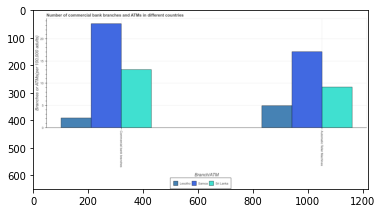

Number of QA =  23





,Branch/ATM,Lesotho,Samoa,Sri Lanka
0,Automatic Teller Machines,4.997386,17.176771,9.218049
1,Commercial bank branches,2.289048,23.399206,13.159651


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercal bank branches in lesotho and that in sri lanka ?
PREDICTED =  0.0
EXPECTED =  -10.887595207352641




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercal bank branches in samoa and the number of atms in sri lanka?
PREDICTED =  -1.0
EXPECTED =  14.26341359192272




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms and number of commercal bank branches in sri lanka ?
PREDICTED =  0.0
EXPECTED =  -3.929766726659322




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

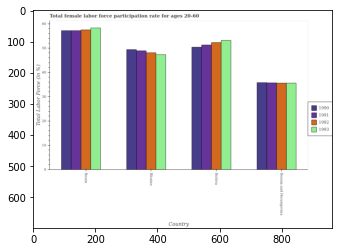

Number of QA =  30





,Country,1992,1993,1990,1991
0,Bosnia and Herzegovina,35.776387,35.773988,36.001038,35.813865
1,Benin,57.848980,58.729444,57.395244,57.295402
2,Bolivia,52.529676,53.311023,50.661535,51.432652
3,Bhutan,48.298665,47.479967,49.688998,49.001195


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1993 in bhutan and that in bolivia ?
PREDICTED =  -5.831055845592665
EXPECTED =  -5.900001525879006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1992 in bosnia and herzegovina and the female labor force participation rate in 1990 in bolivia?
PREDICTED =  -16.753289639930195
EXPECTED =  -14.800003051757798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate of/in 1990 and female labor force participation rate of/in 199

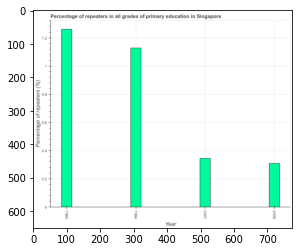

Number of QA =  23





,Year,Percentage of repeaters (%)
0,1983,1.269550
1,1984,1.133952
2,2008,0.316195
3,2007,0.350796


> what is the title of the graph ?
PREDICTED =  Percentage of repeaters in all grades of primary education in Singapore
EXPECTED =  Percentage of repeaters in all grades of primary education in Singapore




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Percentage of repeaters (%)
EXPECTED =  Percentage of repeaters (%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in primary education in 1983 and 2008 ?
PREDICTED =  0.9533557206658477
EXPECTED =  0.952




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of repeaters in primary education ?
PREDICTED =  

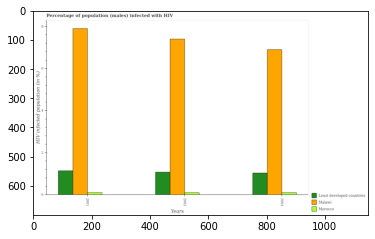

Number of QA =  29





,Years,Least developed countries,Malawi,Morocco
0,2002,1.116600,7.472132,0.120179
1,2003,1.057302,6.924304,0.119270
2,2001,1.164206,8.018752,0.121500


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in least developed countries in 2001 and that in 2003 ?
PREDICTED =  0.10690387450401273
EXPECTED =  0.10646767777338995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in least developed countries in 2001 and the percentage of hiv infected male population in morocco in 2002?
PREDICTED =  1.0440270662537712
EXPECTED =  1.0408127647049898




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of hiv infected male population in le

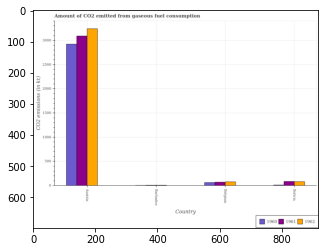

Number of QA =  29





,Country,1962,1961,1960
0,Barbados,NaN,NaN,NaN
1,Bolivia,92.499892,97.683840,NaN
2,Austra,3262.683023,3087.009793,2925.698567
3,Belgium,89.098893,82.753207,74.087181


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1962 in barbados and that in bolivia ?
PREDICTED =  -92.4998920418754
EXPECTED =  -73.33999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1962 in barbados and the amount of co2 emitted in 1961 in bolivia?
PREDICTED =  -92.4998920418754
EXPECTED =  -77.00700000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted of/in 1961 and amount of co2 emitted of/in 1960 in austria?
PREDICTED =  178.43704778153153
EXPECTED =  168.6819999999998




				 0 / 3 = 0.0

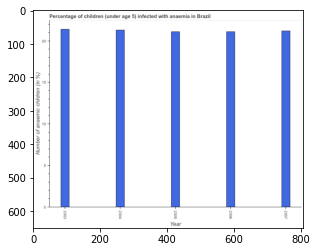

Number of QA =  23





,Year,Number of anaemic children (in %)
0,2004,21.678830
1,2003,21.763050
2,2005,21.385385
3,2006,21.398305
4,2007,21.573192


> what is the title of the graph ?
PREDICTED =  Percentage of children (under age 5) infected with anaemia in Brazil
EXPECTED =  Percentage of children (under age 5) infected with anaemia in Brazil




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of anaemic children (in %)
EXPECTED =  Number of anaemic children (in %)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of anaemic children in 2004 and 2006 ?
PREDICTED =  0.2805251049981692
EXPECTED =  0.2




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of anaemic children ?
PREDICTED =  21.573191701012483
EXPECTED =  

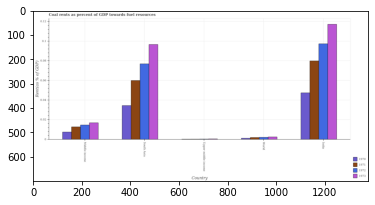

Number of QA =  30





,Country,1972,1971,1970,1973
0,Upper middle income,NaN,NaN,NaN,NaN
1,Middle income,0.015058,0.013212,0.008036,0.017155
2,World,0.002698,0.002462,NaN,0.003066
3,South Asia,0.076742,0.059276,0.034351,0.095801
4,India,0.096568,0.079736,0.047673,0.116494


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in 1970 in middle income and that in south asia ?
PREDICTED =  -0.026314842295929695
EXPECTED =  -0.026968333635437297




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in 1973 in india and the coal rent in 1970 in world?
PREDICTED =  0.11342885750431975
EXPECTED =  0.11605788116001577




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the coal rent in 1972 in india to that in mi

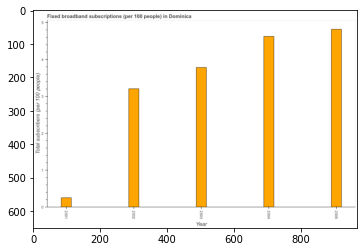

Number of QA =  23





,Year,Total subscribers (per 100 people)
0,2002,3.212107
1,2005,4.844126
2,2004,4.637185
3,2003,3.794162
4,2001,0.267643


> what is the title of the graph ?
PREDICTED =  Fixed broadband subscriptions (per 100 people) in Dominica
EXPECTED =  Fixed broadband subscriptions (per 100 people) in Dominica




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total subscribers (per 100 people)
EXPECTED =  Total subscribers (per 100 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of fixed broadband subscriptions in 2002 and 2003 ?
PREDICTED =  -0.5820542396686874
EXPECTED =  -0.578




				 4 / 4 = 1.0


> what is the median total number of fixed broadband subscriptions ?
PREDICTED =  None
EXPECTED =  3.78400753661252




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting 

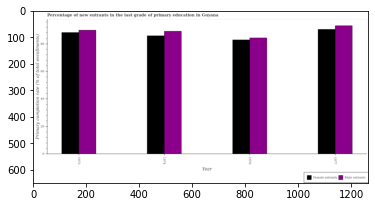

Number of QA =  28





,Year,Male entrants,Female entrants
0,1977,93.675971,91.173361
1,1974,89.465359,86.919966
2,1973,90.642018,88.644173
3,1976,84.817852,82.704303


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants in 1974 and that in 1976 ?
PREDICTED =  4.2156631798246025
EXPECTED =  2.954129999999978




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants in 1974 and the primary completion rate of male entrants in 1977?
PREDICTED =  -4.25339512429845
EXPECTED =  -4.6594100000000225




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the primary completion rate of male entrants and primary completion rate of female entrants ?
PREDICTED =  8.858119057834472
E

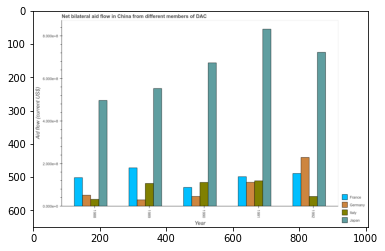

Number of QA =  30





,Year,Unnamed: 1,ttaly,Germany,France
0,1989,5.521219,1.078871,0.316255,1.845438
1,1988,4.974326,0.335112,0.536675,1.356235
2,1992,7.192582,0.477755,2.321779,1.545097
3,1991,8.347023,1.214215,1.137354,1.414234
4,1990,6.738183,1.125700,0.470689,0.899617


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by germany in 1988 and that in 1991 ?
PREDICTED =  -0.6006789933116198
EXPECTED =  -60690000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by italy in 1991 and the amount of aid given by france in 1988?
PREDICTED =  3.3470231309085747
EXPECTED =  86930000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the amount of aid given by japan and amount of aid given by france ?
PREDICTED =  -2.060619859104034
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available:

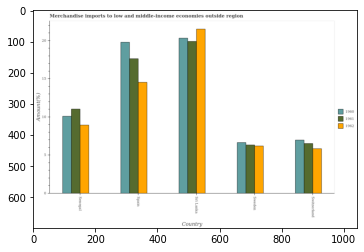

Number of QA =  29





,Country,1962,1961,1960
0,Sn Lanka,21.816016,20.019269,20.539148
1,NaN,14.612799,17.724034,19.982739
2,Sweden,6.314989,6.451137,6.804351
3,Switzerland,5.932261,6.579368,7.103226
4,Senegal,8.950707,11.145350,10.200163


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 in spain and that in sri lanka ?
PREDICTED =  0.0
EXPECTED =  -6.973503491240399




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in spain and the percentage of amount earned from merchandise imports in 1960 in senegal?
PREDICTED =  -4.694213179961249
EXPECTED =  7.542779499625901




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports of/in 1960 and percentage of amount 

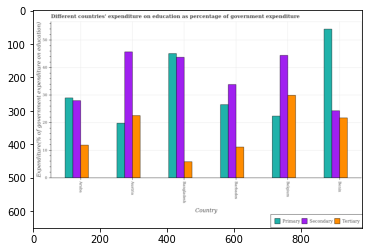

Number of QA =  29





,Country,Secondary,Tertiary,Primary
0,NaN,28.295265,12.307164,29.278798
1,Benin,24.549567,22.095675,54.406451
2,Austria,46.025647,22.837703,20.117298
3,Bangladesh,44.113707,6.055330,45.338050
4,Belgium,44.598774,30.372624,22.630761
5,Barbados,33.897677,11.370392,26.745076


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on tertiary education in austria and that in benin ?
PREDICTED =  0.7420271823506788
EXPECTED =  0.8396987915038991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on secondary education in belgium and the expenditure on tertiary education in barbados?
PREDICTED =  10.701097482967185
EXPECTED =  33.3183908462525




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on tertiary education and expenditure on primary education in austria ?
PREDICTED =  82.20118496423498
EXPECTED =  2.7721099853516016




				

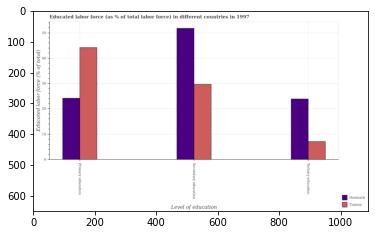

Number of QA =  28





,Level of education,Tunisia,Denmark
0,Primary education,44.893005,24.620063
1,Tertiary education,7.286503,24.261358
2,Secondary education,30.134711,52.093319


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in tunisia and that in denmark ?
PREDICTED =  -16.974855001884812
EXPECTED =  -16.799999713897737




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received primary education in tunisia and the percentage of labor force who received secondary education in denmark?
PREDICTED =  20.272942151431888
EXPECTED =  -7.599998474120994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education and percentage of la

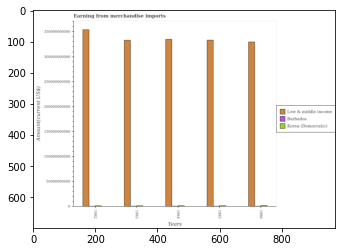

Number of QA =  29





,Years,Korea (Democratic),Barbados,Low & middle income
0,1983,NaN,NaN,3.326992e+11
1,1985,NaN,NaN,3.324693e+11
2,1982,NaN,NaN,3.526402e+11
3,1986,NaN,NaN,3.283812e+11
4,1984,NaN,NaN,3.326003e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in low & middle income in 1982 and that in 1983 ?
PREDICTED =  19940961894.363647
EXPECTED =  21021069492.528015




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in korea (democratic) in 1986 and the amount earned from merchandise imports in low & middle income in 1982?
PREDICTED =  -24259021085.24298
EXPECTED =  -352033566374.364




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

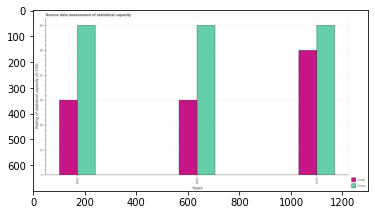

Number of QA =  28





,Years,Chad,China
0,2008,30.257691,60.092741
1,2009,30.602262,60.050840
2,2010,50.377741,60.219091


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in chad in 2008 and that in 2009 ?
PREDICTED =  -0.34457018161004527
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in china in 2008 and the rating of statistical capacity in chad in 2009?
PREDICTED =  0.04190147982971126
EXPECTED =  30




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the rating of statistical capacity in chad and rating of statistical capacity in china ?
PREDICTED =  -9.74314957687919
EXPECTED =  -30




				 0 / 3 = 0.0


is_bu

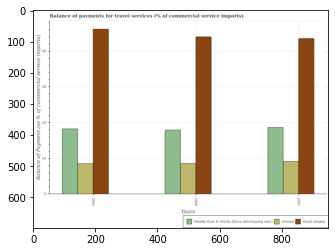

Number of QA =  29





,Years,Middle East & North Africa (developing only:,Saudi Arabia,Ireland
0,2007,18.985523,43.788126,9.420397
1,2005,18.598861,46.625808,8.712752
2,2006,18.085879,44.365742,8.801850


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in middle east & north africa (developing only) in 2005 and that in 2007 ?
PREDICTED =  -0.38666166642771316
EXPECTED =  -0.39850687526081074




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in saudi arabia in 2007 and the balance of payments for travel services in middle east & north africa (developing only) in 2006?
PREDICTED =  -90.99154992606637
EXPECTED =  25.616246984916103




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the balance of p

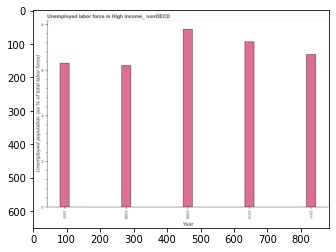

Number of QA =  23





,Year,Unemployed population (as % of total labor force)
0,2008,6.251431
1,2010,7.269220
2,2007,6.346523
3,2009,7.832452
4,2011,6.702461


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in High income_ nonOECD
EXPECTED =  Unemployed labor force in High income_ nonOECD




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed population (as % of total labor force)
EXPECTED =  Unemployed population (as % of total labor force)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed population in 2010 and 2011 ?
PREDICTED =  0.5667585213660846
EXPECTED =  0.551




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed population ?
PREDICTED =  2009.0
EXPECTED =  6.69237474715138






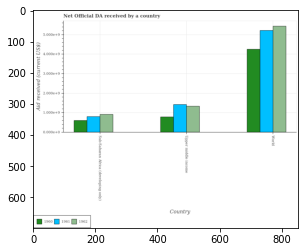

Number of QA =  29





,Country,1962,1961,1960
0,Upper middle income,1.383465,1.479450,0.833901
1,World,5.526874,5.319470,4.376398
2,Sub-Saharan Africa (developing only),0.956545,0.845235,0.638689


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in 1961 in sub-saharan africa (developing only) and the net official development assistance aid received in 1960 in upper middle income?
PREDICTED =  -0.6342149184541885
EXPECTED =  16440000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net official development assistance aid received in 1961 in upper middle income to that in world?

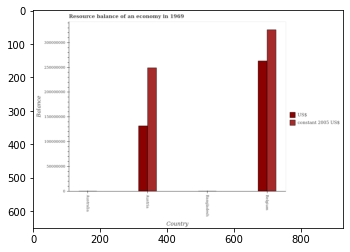

Number of QA =  22





,Country,US$,constant 2005 US$
0,Austna,1.320449e+08,2.505041e+08
1,Bangladesh,NaN,NaN
2,Australia,NaN,NaN
3,NaN,2.637681e+08,3.245251e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the resource balance in constant us$ in austria to that in belgium ?
PREDICTED =  1.0
EXPECTED =  0.7642244628722201




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest resource balance in constant us$ ?
PREDICTED =  -1.0
EXPECTED =  326000640.0




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Balance
EXPEC

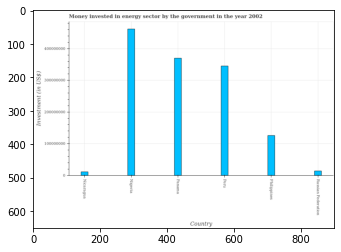

Number of QA =  22





,Country,Investment (in US$)
0,Peru,3.494393e+08
1,Philippines,1.287065e+08
2,Panama,3.735394e+08
3,Nicaragua,1.352579e+07
4,Nigeria,4.669216e+08
5,Russian Federation,1.580454e+07


> what is the title of the graph ?
PREDICTED =  Money invested in energy sector by the government in the year 2002
EXPECTED =  Money invested in energy sector by the government in the year 2002




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Investment (in US$)
EXPECTED =  Investment (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in energy in nicaragua and nigeria ?
PREDICTED =  -453395832.7315662
EXPECTED =  -450700000.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median investment in energy ?
PREDICTED =  239072879.9757757
EXPECTED =  235650000.0




				 5 

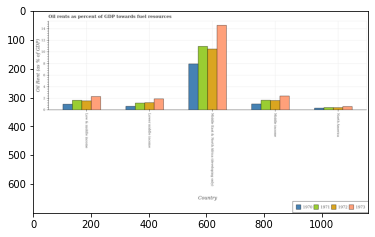

Number of QA =  30





,Country,1972,1971,1970,1973
0,Lower middle income,1.355252,1.273281,0.732739,2.008721
1,Middle income,1.715456,1.752849,1.110957,2.521216
2,Low & middle income,1.659815,1.748182,1.070838,2.407885
3,North America,0.478853,0.512623,0.423346,0.690494
4,Middle East & North Africa (developing only),10.658796,11.103524,8.156235,14.763043


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1970 in low & middle income and that in middle east & north africa (developing only) ?
PREDICTED =  -6.352657638792785
EXPECTED =  -6.9513633273624205




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1973 in middle east & north africa (developing only) and the oil rent in 1971 in north america?
PREDICTED =  -0.690493579391612
EXPECTED =  14.179135047508442




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

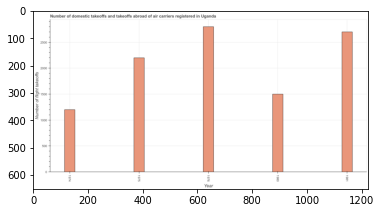

Number of QA =  23





,Year,Number of flight takeoffs
0,1976,2835.474528
1,1975,2228.709566
2,1980,1524.423901
3,1981,2723.785433
4,1974,1217.557234


> what is the title of the graph ?
PREDICTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Uganda
EXPECTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Uganda




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of flight takeoffs
EXPECTED =  Number of flight takeoffs




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of flight takeoffs in 1976 and 1980 ?
PREDICTED =  1311.0506270098927
EXPECTED =  1300.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of flight takeoffs ?
PREDICTED =  2228.7095661750

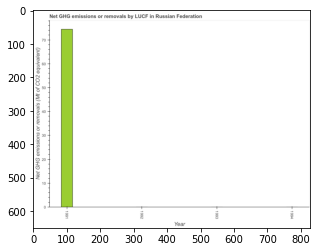

Number of QA =  15





,Year,Net GHG emissions or removals (Mt of CO2 equivalent)
0,1994,NaN
1,1992,NaN
2,1993,NaN
3,1991,74.916553


> what is the title of the graph ?
PREDICTED =  Net GHG emissions or removals by LUCF in Russian Federation
EXPECTED =  Net GHG emissions or removals by LUCF in Russian Federation




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  Net GHG emissions or removals (Mt of CO2 equivalent)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ghg net emissions or removals ?
PREDICTED =  74.91655344898801
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest ghg net emissions or removals ?
PREDICTED =  

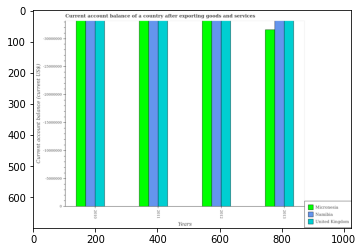

Number of QA =  16





,Years,United Kingdom,Micronesia,Namibia
0,2010,3.397582e+07,3.386349e+07,3.419061e+07
1,2012,3.429325e+07,3.419114e+07,3.426655e+07
2,2013,3.416283e+07,3.211758e+07,3.386399e+07
3,2011,3.390536e+07,3.438970e+07,3.400391e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the account balance in namibia in 2011 and the account balance in united kingdom in 2010?
PREDICTED =  -186696.98036162555
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  5000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Current account balance of a country after exporting goods and service
EXPECTED =  Current account balance of a country after exporting goods and services




				 0 / 3 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Years
EXPECTED =  Years




				 1 / 4 = 0.25


> what is the label or title of the y-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  Current account balance (current US$)




				 2 / 5 = 0.4




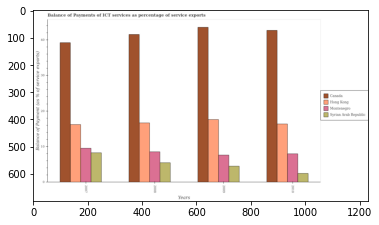

Number of QA =  30





,Years,Syrian Arab Republic,Hong Kong,Montenegro,Canada
0,2010,2.599866,16.499579,8.108671,42.905356
1,2007,8.410820,16.305936,9.720902,39.310494
2,2009,4.592473,17.855425,7.778401,43.731054
3,2008,5.586882,16.935007,8.712477,41.772198


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in montenegro in 2007 and that in 2009 ?
PREDICTED =  1.9425012893287805
EXPECTED =  1.9196709356590294




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in canada in 2010 and the balance of payments of ict services in hong kong in 2009?
PREDICTED =  -0.8256980890773207
EXPECTED =  25.062899472819296




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments of ict services in montenegro and balance of payments of ict services in syrian ar

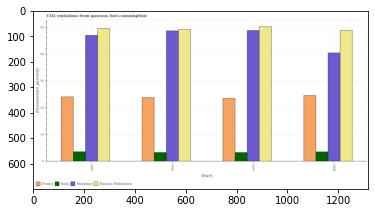

Number of QA =  30





,Years,Myanmar,India,Russian Federation,France
0,2005,47.249278,3.761588,49.956273,24.369732
1,2006,49.007715,3.446716,49.659544,24.126015
2,2008,40.705632,3.686572,49.243946,24.721368
3,2007,49.182611,3.421484,50.611830,23.709851


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the total co2 emitted in russian federation maximum?
PREDICTED =  501.75
EXPECTED =  2007




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in india in 2005 and that in 2006 ?
PREDICTED =  0.3148715907667148
EXPECTED =  0.28801349109568974




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in russian federation in 2008 and the total co2 emitted in myanmar in 2007?
PREDICTED =  0.5
EXPECTED =  0.05754911076590474




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

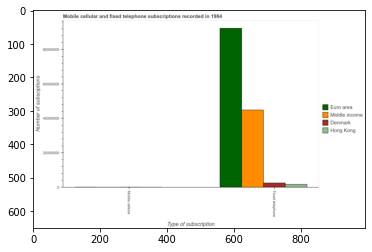

Number of QA =  23





,Type of subscription,Denmark,Middle income,Hong Kong,Euro area
0,Mobde cellular,NaN,NaN,NaN,NaN
1,Fixed telephone,2.875310e+06,4.502678e+07,2.121631e+06,9.296522e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in denmark and that in euro area ?
PREDICTED =  0.0
EXPECTED =  -89825505




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions in denmark and the number of fixed telephone subscriptions in euro area?
PREDICTED =  1.0
EXPECTED =  -92260898




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions and number of fixed telephone subscriptions in euro area ?
PREDICTED =  1.0
EXPECTED =  -92239488




				 0 / 3 = 0.0


is_built_with_cud

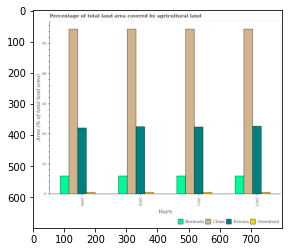

Number of QA =  30





,Years,Estonia,Bermuda,China,Greenland
0,2011,22.500145,6.151162,54.762583,0.743512
1,2010,22.419551,6.157013,54.684808,0.745769
2,2012,22.612963,6.089457,54.683188,0.736279
3,2009,22.079804,6.115055,55.007925,0.742815


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in greenland in 2010 and that in 2012 ?
PREDICTED =  0.009490069796792233
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in bermuda in 2010 and the percentage of agricultural land in greenland in 2012?
PREDICTED =  0.06755547036140452
EXPECTED =  5.425264953100256




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of agricultural land in greenland and percentage of agricultural land in estonia ?
PREDICTED =  -21.66683727319185
EX

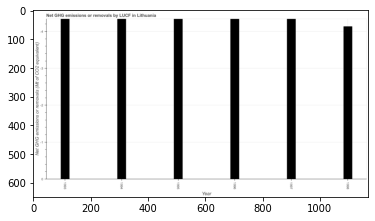

Number of QA =  12





,Year,Net GHG emissions or removals (Mt of CO2 equivalent)
0,1994,30.767161
1,1997,30.758021
2,1996,30.774528
3,1998,29.124597
4,1995,30.909794
5,1993,30.629372


> what is the title of the graph ?
PREDICTED =  Net GHG emissions or removals by LUCF in Lithuania
EXPECTED =  Net GHG emissions or removals by LUCF in Lithuania




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  Net GHG emissions or removals (Mt of CO2 equivalent)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ghg net emissions or removals ?
PREDICTED =  30.762591167539497
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  1.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pre

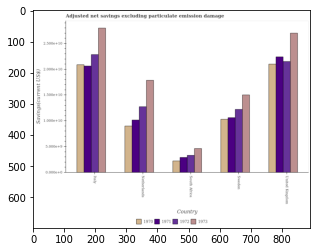

Number of QA =  30





,Country,1972,1971,1970,1973
0,South Africa,0.347136,0.301543,0.234737,0.477687
1,Netherlands,1.275815,1.016452,0.911161,1.776571
2,United Kingdom,2.154559,2.270472,2.105934,2.700505
3,Sweden,1.230483,1.077026,1.037645,1.515317
4,Italy,2.290058,2.069868,2.095784,2.801547


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1972 in italy and that in united kingdom ?
PREDICTED =  0.1354986225450614
EXPECTED =  1344836429.0455017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1971 in sweden and the adjusted net savings in 1973 in netherlands?
PREDICTED =  0.06057408080702076
EXPECTED =  -7242920999.472799




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings of/in 1973 and adjusted net savings of/in 1970 in netherlands?
PREDICTED =  -0.4334743746420618
EXPECTED =  8862431229.846899




				 0 

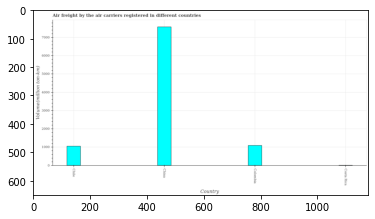

Number of QA =  22





,Country,Volume(million ton-km)
0,Costa Rica,NaN
1,China,7654.078179
2,Chile,1091.992676
3,Colombia,1138.997353


> what is the title of the graph ?
PREDICTED =  Air freight by the air carriers registered in different countries
EXPECTED =  Air freight by the air carriers registered in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Volume(million ton-km)
EXPECTED =  Volume(million ton-km)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the air freight in chile and colombia ?
PREDICTED =  -47.004677500907746
EXPECTED =  -38.673




				 3 / 4 = 0.75


> what is the median air freight ?
PREDICTED =  None
EXPECTED =  1073.1554999999998




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

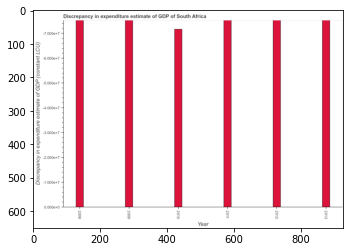

Number of QA =  12





,Year,Discrepancy in expenditure estimate of GDP (constant LCU)
0,2013,7.557552
1,2010,7.166390
2,2012,7.549251
3,2008,7.572166
4,2009,7.569295
5,2011,7.569402


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of South Africa
EXPECTED =  Discrepancy in expenditure estimate of GDP of South Africa




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  Discrepancy in expenditure estimate of GDP (constant LCU)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median discrepancy in expenditure estimate of gdp ?
PREDICTED =  7.166390072055478
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  10000000.0




				 3 / 5 = 0.6


is_built_with_cuda: Tru

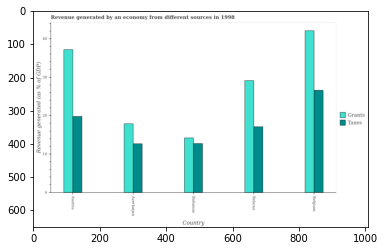

Number of QA =  28





,Country,Taxes,Grants
0,Belarus,17.194891,29.132354
1,Austria,19.831999,37.228215
2,Bahamas,12.809477,14.338808
3,Azerbaijan,12.754903,17.943558
4,Belgium,26.789742,42.376120


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by taxes in belarus and that in belgium ?
PREDICTED =  -9.594851461729728
EXPECTED =  -9.466546797790802




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants in belarus and the revenue generated by taxes in austria?
PREDICTED =  -8.095860410908934
EXPECTED =  9.322807317822




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants and revenue generated by taxes in bahamas ?
PREDICTED =  128.20957809321868
EXPECTED =  1.4699102871305012




				 1 / 3 = 0.3333


is_built_with_c

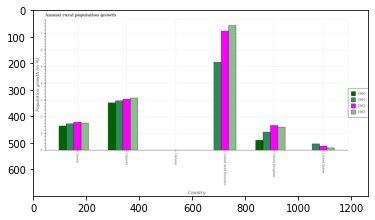

Number of QA =  27





,Country,1963,1962,1961,1960
0,Uganda,3.156483,3.076770,2.976977,2.835740
1,Ukraine,NaN,NaN,NaN,NaN
2,United Arab Emirates,7.549688,7.141212,5.299081,NaN
3,Tuvalu,1.658049,1.697207,1.608962,1.467532
4,United Kingdom,1.408342,1.516046,1.115265,0.621224
5,United States,0.167775,0.260541,0.403631,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population growth in 1963 in uganda and that in united arab emirates ?
PREDICTED =  -4.3932046993747065
EXPECTED =  -4.33632724142455




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population growth in 1960 in united states and the percentage of rural population growth in 1961 in ukraine?
PREDICTED =  nan
EXPECTED =  0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population growth of/in 1962 and percentage of rural population growth of/in 1960 in united kingdom?
PREDICTED

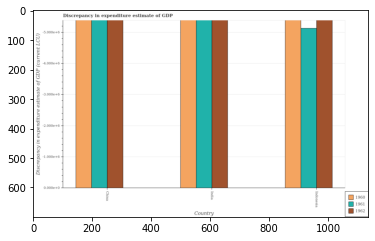

Number of QA =  16





,Country,1962,1961,1960
0,India,5.416811,5.436103,5.457510
1,Indonesia,5.433675,5.147363,5.437222
2,China,5.448227,5.482354,5.468671


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in 1961 in india and the discrepancy in expenditure estimate of gdp in 1960 in indonesia?
PREDICTED =  -4.147363140539236
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (current LCU)
EXPECTED =  1000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of G
EXPECTED =  Discrepancy in expenditure estimate of GDP




				 0 / 3 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 1 / 4 = 0.25


> what is the label or title of the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (current LCU)
EXPECTED =  Discrepancy in expenditure estim

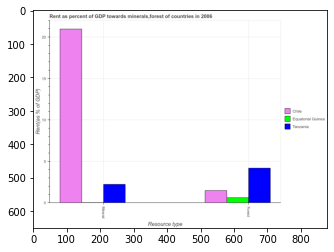

Number of QA =  23





,Resource type,Tanzania,Chile,Equatorial Guinea
0,Mine ral,2.275902,21.08615,NaN
1,Forest,4.259639,1.53321,0.684668


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in equatorial guinea and that in chile ?
PREDICTED =  0.0
EXPECTED =  -0.86119830890971




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the mineral rent in tanzania to that in chile ?
PREDICTED =  0.10793350543237903
EXPECTED =  0.10584192715380385




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Rent(as % of GDP

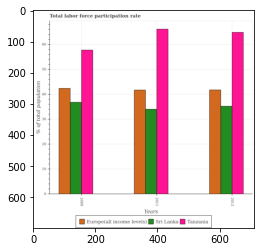

Number of QA =  29





,Years,Europe(all income levels),Tanzania,Sri Lanka
0,2013,42.066612,65.33229,35.446089
1,2009,42.410496,57.99393,37.079476
2,2011,42.081268,66.54870,34.370115


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force participation rate in europe(all income levels) in 2011 and that in 2013 ?
PREDICTED =  0.014656174343159023
EXPECTED =  -0.0454782444220001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force participation rate in sri lanka in 2011 and the total labor force participation rate in tanzania in 2013?
PREDICTED =  -30.962174789871355
EXPECTED =  -30.8000030517578




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the total labor force participation rate in sri lanka and total labor force particip

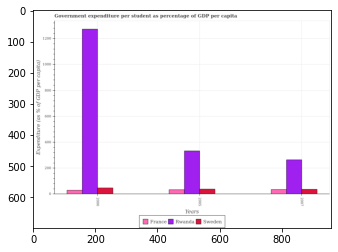

Number of QA =  29





,Years,Rwanda,Sweden,France
0,2000,1291.638782,51.018888,33.074339
1,2005,335.812823,41.771086,37.320932
2,2007,266.500496,40.570279,38.987316


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure per student in france in 2000 and that in 2005 ?
PREDICTED =  -4.2465927015176135
EXPECTED =  -4.156438827514702




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure per student in france in 2000 and the percentage of expenditure per student in rwanda in 2005?
PREDICTED =  -4.2465927015176135
EXPECTED =  -303.7092266082764




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of expenditure per student in rwanda and percentage of expenditure per student in france ?


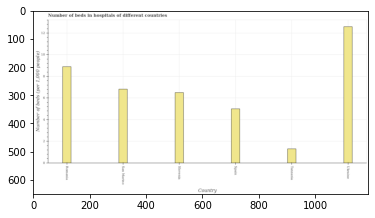

Number of QA =  22





,Country,"Number of beds (per 1,000 people)"
0,NaN,5.082364
1,Ukraine,12.774159
2,Romania,9.037615
3,Tanzania,1.403314
4,San Marino,6.910877
5,Slovenia,6.583020


> what is the title of the graph ?
PREDICTED =  Number of beds in hospitals of different countries
EXPECTED =  Number of beds in hospitals of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of beds (per 1,000 people)
EXPECTED =  Number of beds (per 1,000 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hospital beds in romania and spain ?
PREDICTED =  -12.05073543520088
EXPECTED =  3.896




				 3 / 4 = 0.75


> what is the median number of hospital beds ?
PREDICTED =  None
EXPECTED =  6.6605000495910645




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> 

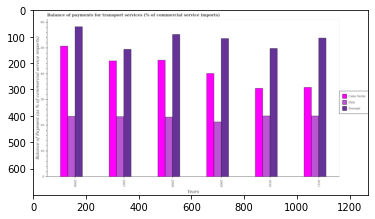

Number of QA =  29





,Years,Senegal,Cabo Verde,Italy
0,2006,58.793063,51.020777,23.730982
1,2010,50.154879,34.706731,23.840994
2,2007,49.823499,46.087178,23.751530
3,2009,53.933412,41.148786,21.726023
4,2008,55.774020,45.667779,23.485857
5,2011,54.185492,35.201733,23.861995


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in cabo verde in 2007 and that in 2009 ?
PREDICTED =  4.938391922353617
EXPECTED =  4.863428426772501




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in cabo verde in 2007 and the balance of payments for transport services in italy in 2008?
PREDICTED =  22.601320649176635
EXPECTED =  21.78971283256959




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments for transport services in cabo verde and balance of payments for 

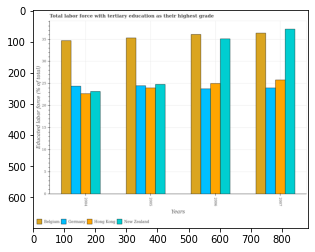

Number of QA =  30





,Years,New Zealand,Belgium,Germany,Hong Kong
0,2005,25.138240,35.849111,25.028392,24.356365
1,2004,23.508916,35.329332,24.898625,22.942920
2,2006,35.692092,36.367456,24.180171,25.371726
3,2007,37.983590,36.838065,24.463531,26.093748


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in germany in 2004 and that in 2006 ?
PREDICTED =  0.7184533289900763
EXPECTED =  0.6000003814698083




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with tertiary education in hong kong in 2007 and the percentage of male labor force with tertiary education in germany in 2005?
PREDICTED =  1.0653559238572896
EXPECTED =  1.2999992370605007




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of male labor force with tertiary edu

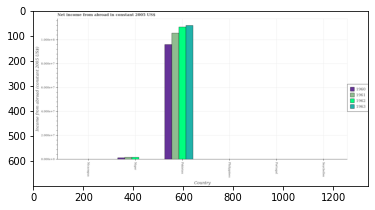

Number of QA =  22





,Country,1963,1962,1961,1960
0,Seychelles,NaN,NaN,NaN,NaN
1,Pakistan,39.270453,38.955208,36.992677,33.758450
2,Nicaragua,NaN,NaN,NaN,NaN
3,Philippines,NaN,NaN,NaN,NaN
4,Niger,NaN,0.743615,0.731401,0.589117
5,Portugal,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in 1961 in niger and that in pakistan ?
PREDICTED =  -36.26127622118492
EXPECTED =  -103917290.22115536




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in 1960 in portugal and the net income from abroad in 1961 in pakistan?
PREDICTED =  0.0
EXPECTED =  -105549410.151605




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad of/in 1963 and net income from abroad of/in 1962 in pakistan?
PREDICTED =  0.3152457160799145
EXPECTED =  1308273.8114670068




				 0 / 3 = 0.0


is_b

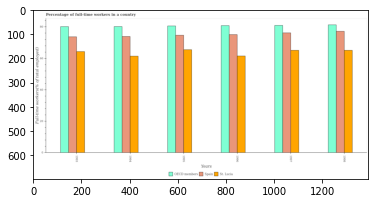

Number of QA =  29





,Years,OECD members,Spain,St. Lucia
0,1994,79.938556,73.607764,61.507091
1,1998,81.222954,76.883903,64.738132
2,1996,80.173282,75.165539,61.180377
3,1995,80.394705,74.439755,65.324030
4,1993,79.818917,73.689450,64.184373
5,1997,80.810058,75.961881,65.056357


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in st. lucia in 1994 and that in 1997 ?
PREDICTED =  -3.549265882786216
EXPECTED =  -3.699996948242095




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in oecd members in 1993 and the percentage of full-time workers in spain in 1998?
PREDICTED =  -1.4040371066155473
EXPECTED =  2.9667194991048973




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of full-time workers in spain and percentage of full-time workers in st. lucia ?
PREDICTED =  11.55987

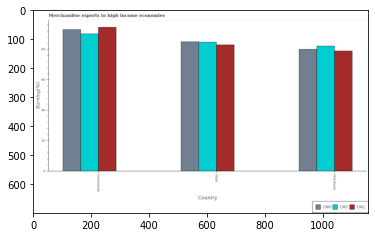

Number of QA =  29





,Country,1962,1961,1960
0,Guatemala,95.505005,90.074574,92.874382
1,Haiti,83.424920,84.837369,85.239672
2,Honduras,78.873759,82.615131,79.488417


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1961 in guatemala and that in haiti ?
PREDICTED =  5.237205207175805
EXPECTED =  5.4758050734592985




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1960 in guatemala and the percentage of amount earned from merchandise exports in 1961 in haiti?
PREDICTED =  8.037012613519039
EXPECTED =  8.274713569938925




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports of/in 1960 and percen

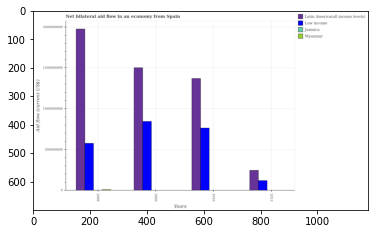

Number of QA =  30





,Years,Low income,Myanmar,Jamaica,Latin America(all income levels)
0,2008,5.893349e+08,NaN,NaN,1.984644e+09
1,2010,7.698266e+08,NaN,NaN,1.373448e+09
2,2013,1.253086e+08,NaN,NaN,2.498296e+08
3,2009,8.582291e+08,NaN,NaN,1.513815e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in jamaica in 2008 and that in 2009 ?
PREDICTED =  0.0
EXPECTED =  830000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in latin america(all income levels) in 2008 and the net bilateral aid flow in myanmar in 2010?
PREDICTED =  611195173.5758228
EXPECTED =  1975720000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in l

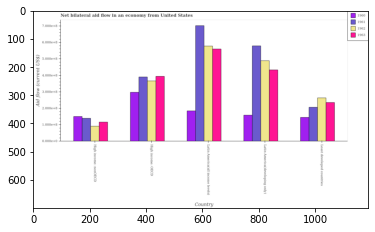

Number of QA =  30





,Country,1963,1962,1961,1960
0,Least developed countries,2.395962,2.680161,2.086360,1.488669
1,High income: nonOECD,1.198498,0.944222,1.437480,1.531468
2,Latin America(developing only),4.358969,4.905288,5.796248,1.622482
3,High income: OECD,3.962422,3.693174,3.922942,2.997262
4,Latin America(all income levels),5.635976,5.767955,7.047711,1.865218


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in latin america(developing only) and that in least developed countries ?
PREDICTED =  0.13381338460194558
EXPECTED =  13480000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in high income: nonoecd and the net bilateral aid flow in 1962 in latin america(all income levels)?
PREDICTED =  -0.3337499628925986
EXPECTED =  -428000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow of/in 1961 and net bilateral aid flow of/in 1960 in latin america(all i

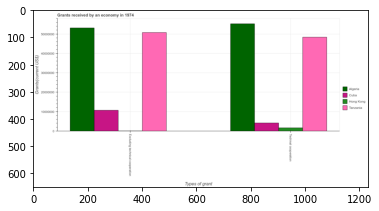

Number of QA =  23





,Types of grant,Algeria,Cuba,Tanzania,Hong Kong
0,Techinal cooperation,5.587062e+07,4.583552e+06,4.900475e+07,2.061434e+06
1,Excluding technical cooperation,5.372307e+07,1.102322e+07,5.091567e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount of grants received(including technical cooperation) in cuba ?
PREDICTED =  15606769.143940024
EXPECTED =  4140000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum amount of grants received(including technical cooperation) ?
PREDICTED =  2.0
EXPECTED =  55260000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum amount of grants received(including technical cooperation) ?
PREDICTED =  2.0
EXPECTED =  1640000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after t

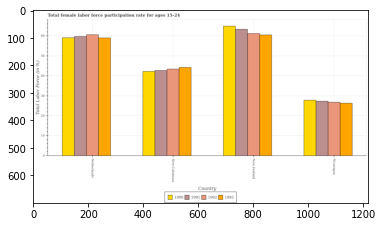

Number of QA =  30





,Country,1992,1993,1991,1990
0,New Caledonia,43.212311,44.066746,42.509664,42.091655
1,Netherlands,60.290982,58.715231,58.925512,58.542244
2,New Zealand,60.876840,60.278453,63.077885,64.449485
3,Nicaragua,26.610777,26.316900,27.359584,27.815289


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1990 in netherlands and that in nicaragua ?
PREDICTED =  30.726955299227285
EXPECTED =  31.2999992370606




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1991 in nicaragua and the female labor force participation rate in 1992 in new zealand?
PREDICTED =  -35.718300297391465
EXPECTED =  -33.900001525879006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate of/in 1991 and female labor force participation rate of/in 1993 in

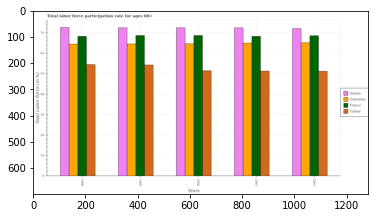

Number of QA =  30





,Years,Angola,Turkey,France,Unnamed: 4
0,2001,73.061315,51.647234,68.833735,65.449569
1,1999,73.085332,54.378225,68.972235,65.045003
2,1998,72.671143,54.576067,68.609064,65.382454
3,2002,72.332061,51.315654,69.027400,65.925099
4,2000,73.129209,51.672594,69.455088,65.045157


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in angola in 2000 and that in 2002 ?
PREDICTED =  0.797147594439167
EXPECTED =  0.4000015258790057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in argentina in 2000 and the labor force participation rate in france in 2001?
PREDICTED =  0.6213530478617884
EXPECTED =  -3.6000061035155966




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the labor force participation rate in france and labor force participation rate in turkey ?
PREDICTED =  64.4550882662292
EXPE

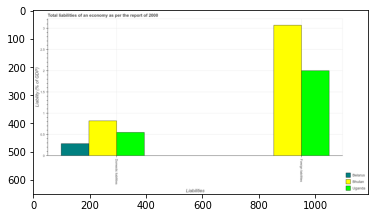

Number of QA =  20





,Liabilities,Belarus,Bhutan,Uganda
0,Domestic tabdities,0.291951,0.835832,0.559232
1,Foreign liabilities,NaN,3.092382,2.019488


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities in bhutan and the incurrence of domestic liabilities in uganda?
PREDICTED =  1.072893955940728
EXPECTED =  2.5233146103443578




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Liability (% of GDP)
EXPECTED =  0.5




				 0 / 5 = 0.0


> what is the title of the graph ?


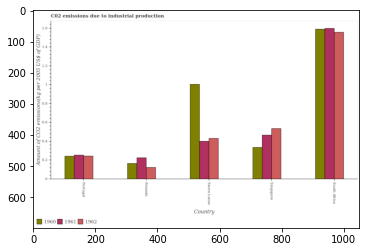

Number of QA =  29





,Country,1962,1961,1960
0,Sierra Leone,0.437637,0.410827,1.017371
1,Rwanda,0.128932,0.232012,0.171991
2,Singapore,0.543049,0.474260,0.343596
3,Portugal,0.251247,0.262614,0.249506
4,South Africa,1.572061,1.624005,1.612566


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in 1962 in rwanda and that in sierra leone ?
PREDICTED =  -0.3087045664137582
EXPECTED =  -0.30819868405696504




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in 1962 in singapore and the amount of co2 emitted due to industrial production in 1960 in south africa?
PREDICTED =  -1.0290118947910063
EXPECTED =  -1.0544413775643011




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production of/in 1962

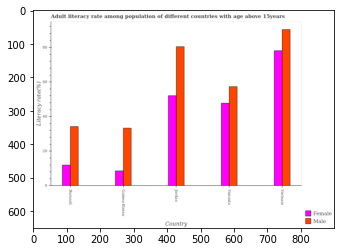

Number of QA =  28





,Country,Female,Male
0,Guinea-Bissau,8.883666,33.573867
1,Jordan,52.371854,80.395296
2,Van uatu,48.144015,57.403442
3,Vietnam,78.385958,90.451479
4,Burundi,12.142957,34.341952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male adult literacy rate in jordan and that in vietnam ?
PREDICTED =  -10.056183070411663
EXPECTED =  -9.898859999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate in vietnam and the male adult literacy rate in burundi?
PREDICTED =  66.24300166315345
EXPECTED =  43.87768




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male adult literacy rate and female adult literacy rate in jordan ?
PREDICTED =  -80.39529601052514
EXPECTED =  28.371999999999993




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu

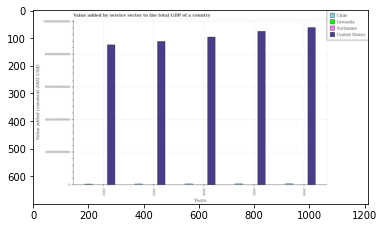

Number of QA =  30





,Years,Grenada,Chile,Suriname,United States
0,2002,NaN,NaN,NaN,8.612447e+12
1,2004,NaN,NaN,NaN,9.090293e+12
2,2003,NaN,NaN,NaN,8.799091e+12
3,2005,NaN,NaN,NaN,9.444200e+12
4,2006,NaN,NaN,NaN,9.661502e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by service sector in united states in 2002 and that in 2005 ?
PREDICTED =  -831753118827.8154
EXPECTED =  -825380222465.2998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the value added by service sector in grenada and value added by service sector in suriname ?
PREDICTED =  0.0
EXPECTED =  -551190964.0927591




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the value

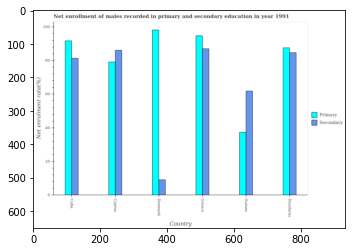

Number of QA =  28





,Country,Secondary,Primary
0,Denmark,9.472972,99.263734
1,Greece,87.744824,95.505125
2,Honduras,85.353612,88.538618
3,Guinea,62.113892,37.443112
4,Cuba,81.701250,92.439033
5,NaN,86.787565,79.571754


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in denmark and that in honduras ?
PREDICTED =  10.725116095881006
EXPECTED =  10.650750000000016




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in cuba and the enrollment rate in primary education in cyprus?
PREDICTED =  33.092351563668764
EXPECTED =  2.2105999999999995




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education and enrollment rate in secondary education in denmark ?
PREDICTED =  0.0
EXPECTED =  89.22493




				 1 / 

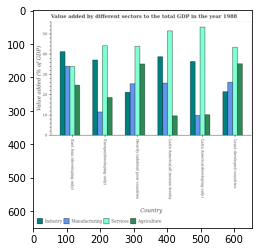

Number of QA =  30





,Country,Industry,Manufacturing,Agriculture,Services
0,East Asia (developing only),42.042176,35.075325,25.168261,34.390499
1,Heavily indebted poor countries,21.817225,26.037102,35.994214,44.581396
2,Europe(developing only),37.632361,11.790618,19.143100,44.925310
3,Latin America(developing only),36.781456,10.181142,10.551934,53.864583
4,Latin America(all income levels),39.201699,26.297080,10.098015,52.206928
5,Least developed countries,22.071916,26.446838,35.642042,44.510444


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in europe(developing only) and that in heavily indebted poor countries ?
PREDICTED =  15.81513570680415
EXPECTED =  15.913142755214011




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in latin america(developing only) and the value added by manufacturing sector in europe(developing only)?
PREDICTED =  -44.92531041215412
EXPECTED =  41.891193367798095




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector and value added by industrial sector in 

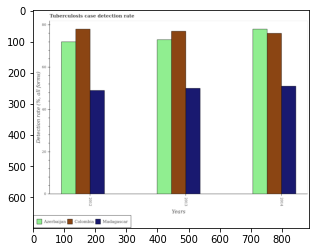

Number of QA =  29





,Years,Azerbaijan,Madagascar,Colombia
0,2012,71.655440,48.763225,78.460179
1,2014,78.195901,51.316030,76.153324
2,2013,73.051159,49.848304,77.024902


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis case detection rate in in azerbaijan in 2012 and that in 2014 ?
PREDICTED =  -6.5404605970726095
EXPECTED =  -6.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis case detection rate in in azerbaijan in 2014 and the tuberculosis case detection rate in in madagascar in 2012?
PREDICTED =  29.43267556331027
EXPECTED =  29.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the tuberculosis case detection rate in in colombia and tuberculosis case detection rate in in azerbaijan ?
PREDICTED =  74.212801

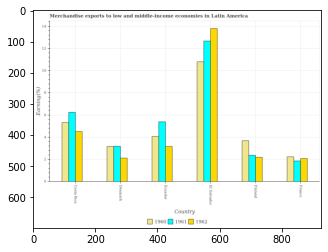

Number of QA =  29





,Country,1962,1961,1960
0,France,2.129979,1.936996,2.282778
1,Denmark,2.166026,3.259590,3.230260
2,Ecuador,3.212466,5.401422,4.148627
3,Finland,2.247632,2.431897,3.747104
4,El Salvador,13.873708,12.790252,10.885114
5,Costa Rica,4.567414,6.335583,5.423118


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1961 in denmark and that in el salvador ?
PREDICTED =  -9.530661196882967
EXPECTED =  -9.48780348069625




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1960 in el salvador and the percentage of amount earned from merchandise exports in 1962 in ecuador?
PREDICTED =  7.672647999359032
EXPECTED =  7.629106947917021




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports of/in 1960 an

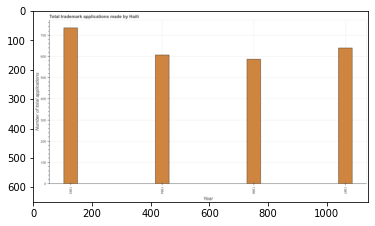

Number of QA =  23





,Year,Number of total applications
0,1987,644.501018
1,1984,611.981534
2,1983,736.917043
3,1986,592.051446


> what is the title of the graph ?
PREDICTED =  Total trademark applications made by Haiti
EXPECTED =  Total trademark applications made by Haiti




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of total applications
EXPECTED =  Number of total applications




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications in 1984 and 1986 ?
PREDICTED =  19.930087996531597
EXPECTED =  20.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of trademark applications ?
PREDICTED =  1985.0
EXPECTED =  623.5




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_a

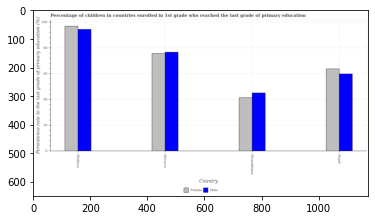

Number of QA =  28





,Country,Female,Male
0,Mozambique,42.045142,45.695278
1,Nepal,64.232679,60.447657
2,Morocco,76.519873,77.391752
3,Moldova,97.217225,95.112210


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of female students in moldova and that in mozambique ?
PREDICTED =  55.172083885021145
EXPECTED =  55.415996551513686




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of female students in nepal and the persistence rate of male students in mozambique?
PREDICTED =  22.187537008081982
EXPECTED =  18.69727325439451




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of male students and persistence rate of female students in nepal ?
PREDICTED =  -14.752378559174623
EXPECTED =  -3.912982940673

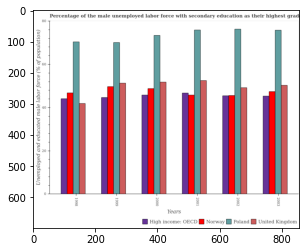

Number of QA =  30





,Years,United Kingdom,High income: OECD,Norway,Poland
0,1999,51.629096,44.895279,49.956394,70.884413
1,2000,52.160697,45.996576,48.893713,74.234361
2,2001,52.988411,46.942487,46.070914,76.305543
3,2003,50.836338,45.705308,47.646025,76.084108
4,1998,42.223757,44.675421,46.968485,70.550867
5,2002,49.602038,45.702918,45.837791,77.215741


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in high income: oecd in 1998 and that in 1999 ?
PREDICTED =  -0.21985864533826316
EXPECTED =  -0.5707928105686051




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in poland in 2000 and the percentage of the unemployed male labor force with secondary education in norway in 2003?
PREDICTED =  -1.8497470854600664
EXPECTED =  26.000000000000007




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True

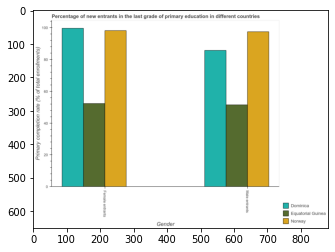

Number of QA =  23





,Gender,Dominica,Norway,Equatorial Guinea
0,Male entrants,85.684952,97.818826,51.941224
1,Female entrants,99.587854,97.798449,52.123589


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants in norway and that in equatorial guinea ?
PREDICTED =  45.67486065998003
EXPECTED =  45.7873001098633




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants in dominica and the primary completion rate of male entrants in equatorial guinea?
PREDICTED =  47.646629428945815
EXPECTED =  48.069705963134815




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants and primary completion rate of male entrants in dominica ?
PREDICTE

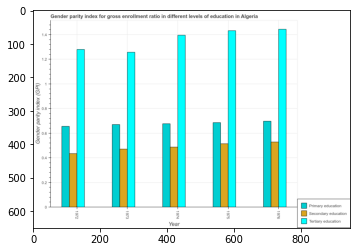

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,1975,0.532617,1.454300,0.696290
1,1974,0.495087,1.414621,0.687623
2,1973,0.478603,1.266535,0.684859
3,1976,0.535358,1.469245,0.705888
4,1972,0.442678,1.291723,0.662885


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in primary education in 1974 and that in 1975 ?
PREDICTED =  0.0
EXPECTED =  -0.008899999999999908




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in primary education in 1974 and the gender parity index in tertiary education in 1976?
PREDICTED =  0.29411218029309627
EXPECTED =  -0.020549999999999957




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the gender parity index in primary education and gender parity index in secondary education ?
PREDICTED =  0.0
EXPECTED =  0.0




				 

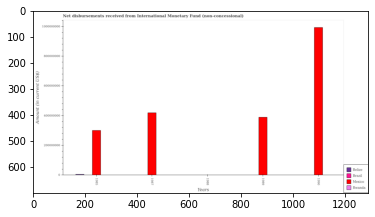

Number of QA =  24





,Years,Rwanda,Mexico,Belize,Brazil
0,1988,NaN,NaN,NaN,NaN
1,1989,NaN,3.948773e+08,NaN,NaN
2,1985,NaN,3.041143e+08,NaN,NaN
3,1990,NaN,1.001112e+09,NaN,NaN
4,1987,NaN,4.243123e+08,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in mexico in 1985 and that in 1990 ?
PREDICTED =  -1001112274.222092
EXPECTED =  -692534000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in belize in 1988 and the amount of disbursements received from international monetary fund in rwanda in 1985?
PREDICTED =  -2.0
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of disbursements received from international monetary fund in mexico in 1989 to 

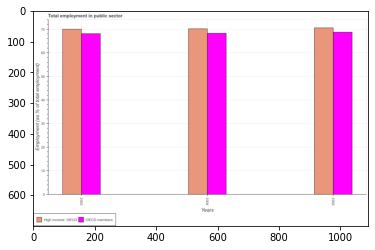

Number of QA =  28





,Years,OECD members,High income: OECD
0,2003,68.702886,70.628460
1,2005,69.275371,71.333954
2,2004,68.449578,71.054027


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in high income: oecd in 2003 and that in 2004 ?
PREDICTED =  -0.42556765848823375
EXPECTED =  -0.17704656027189003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in high income: oecd in 2005 and the employment in public sector in oecd members in 2004?
PREDICTED =  0.279926575138461
EXPECTED =  2.3051002694832903




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the employment in public sector in high income: oecd and employment in public sector in oecd members ?
PRED

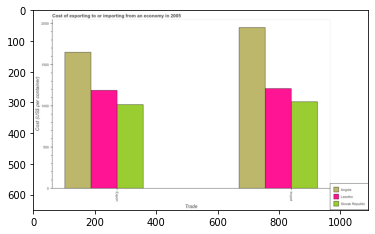

Number of QA =  23





,Trade,Unnamed: 1,Lesothc,Slovak Republic
0,Import,1946.452720,1217.312597,1056.576391
1,NaN,1652.179426,1190.547603,1017.186370


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export cost in angola and the import cost in slovak republic?
PREDICTED =  -1055.5763907823896
EXPECTED =  600




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the import cost in angola to that in slovak republic ?
PREDICTED =  0.0009464530995809068
EXPECTED =  1.8571428571428572




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =

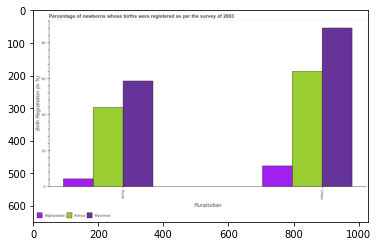

Number of QA =  23





,Rural/urban,Myanmar,Kenya,Afghanistan
0,Rural,59.233961,44.333530,4.551262
1,Urban,88.406019,64.494209,11.824139


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

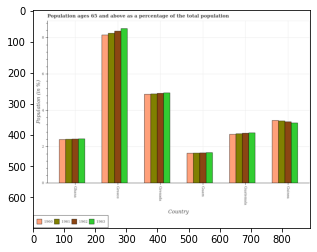

Number of QA =  30





,Country,1963,1962,1961,1960
0,Ghana,2.437554,2.419191,2.439167,2.410824
1,Greece,8.520718,8.340852,8.258108,8.135409
2,Guam,1.683714,1.689230,1.681813,1.659643
3,Guinea,3.319892,3.401266,3.430598,3.442917
4,Guatemala,2.776969,2.768075,2.736114,2.689100
5,Grenada,4.967791,4.947210,4.899026,4.895750


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 65 and above in 1963 in guatemala and the percentage of the population ages 65 and above in 1961 in grenada?
PREDICTED =  -1.9677906771534905
EXPECTED =  -2.1443792743695997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of the population ages 65 and above in 1963 in guatemala to that in guinea?
PREDICTED =  0.8364634946380124
EXPECTED =  

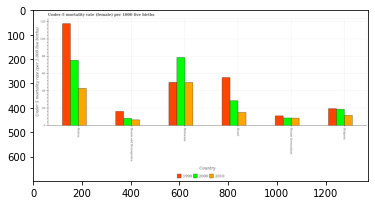

Number of QA =  29





,Country,2000,1990,2010
0,Brunei Darussalam,9.285055,11.695889,8.976831
1,Bosnia and Herzegovina,8.759495,16.783359,7.103365
2,Bulgaria,19.243449,20.070930,12.246721
3,Botswana,79.067243,50.484046,50.299711
4,Bolivia,75.555453,117.577296,43.172963
5,Brazil,29.224685,55.833936,15.851525


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 2000 in botswana and that in brazil ?
PREDICTED =  14.688683722730811
EXPECTED =  49.99999999999999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 2000 in bulgaria and the under-five mortality rate in 1990 in bolivia?
PREDICTED =  -56.31200374449317
EXPECTED =  -99.1




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the under-five mortality 

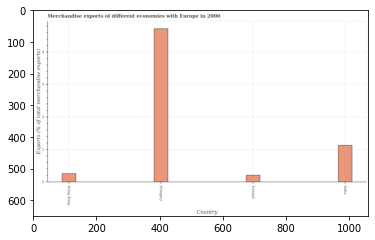

Number of QA =  22





,Country,Exports (% of total merchandise exports)
0,Iceland,0.224907
1,India,1.149279
2,Hong Kong,0.275087
3,Hungary,4.738063


> what is the title of the graph ?
PREDICTED =  Merchandise exports of different economies with Europe in 2000
EXPECTED =  Merchandise exports of different economies with Europe in 2000




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Exports (% of total merchandise exports)
EXPECTED =  Exports (% of total merchandise exports)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in hong kong and iceland ?
PREDICTED =  0.05018003246518338
EXPECTED =  0.048




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median merchandise exports ?
PREDICTED =  0.71218290911091
EXPECTED =

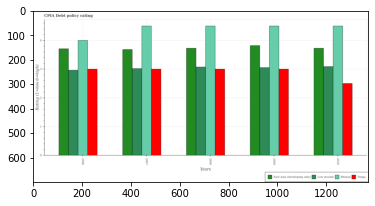

Number of QA =  30





,Years,Low income,Bhutan,East Asia (developing only.,Tonga
0,2008,3.092713,4.522637,3.750134,3.013982
1,2006,2.990274,4.004419,3.741042,3.025923
2,2010,3.115625,4.531238,3.750329,2.526271
3,2007,3.049442,4.530680,3.719945,3.005765
4,2009,3.086229,4.528130,3.852426,3.019519


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in low income in 2006 and that in 2010 ?
PREDICTED =  -0.12535135016657195
EXPECTED =  -0.12632275132274984




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in low income in 2007 and the cpia rating in east asia (developing only) in 2010?
PREDICTED =  -0.06618333889327355
EXPECTED =  -0.7087542087542102




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the cpia rating in low income and cpia rating in tonga ?
PREDICTED =  -1.9453356216642188
EXPECTED =  0.053571428571431046




				 1 / 3 = 0.3333


i

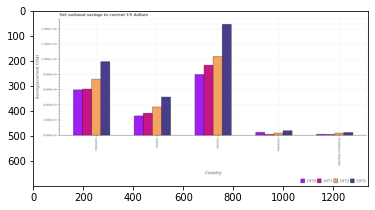

Number of QA =  30





,Country,1972,1971,1970,1973
0,Dominican Republic,0.038368,NaN,NaN,0.046981
1,Canada,1.057669,0.938682,0.819052,1.484950
2,Austra,0.381741,0.302655,0.266374,0.516729
3,Australia,0.752661,0.621367,0.611812,0.986139
4,Colombia,0.039622,NaN,0.048881,0.070231


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in 1970 in colombia and that in dominican republic ?
PREDICTED =  0.04888102623418899
EXPECTED =  249917117.23665503




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs

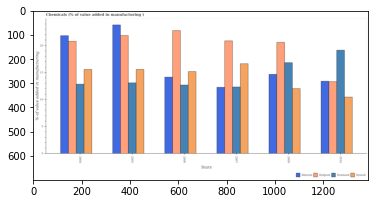

Number of QA =  30





,Years,Belgium,Denmark,Bahrain,Kuwait
0,2010,13.390474,19.217270,13.498696,10.531593
1,2005,21.849310,13.209936,24.033749,15.746999
2,2004,20.637589,12.936062,21.967049,15.683241
3,2007,20.920388,12.421950,12.442618,16.811409
4,2009,20.588416,16.914193,14.764579,12.120518
5,2006,22.901364,12.806141,14.274923,15.296296


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing chemicals in bahrain in 2007 and that in 2010 ?
PREDICTED =  -1.0560771264180513
EXPECTED =  -1.124192752426099




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing chemicals in belgium in 2007 and the value added in manufacturing chemicals in denmark in 2004?
PREDICTED =  0.2827989332554246
EXPECTED =  8.016668675046




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the value added in manufacturing chemicals in kuwait and value added in manufacturing chemicals in belgiu

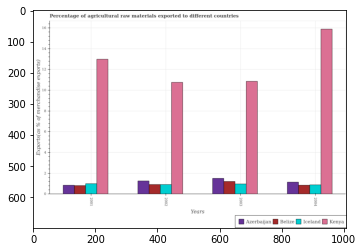

Number of QA =  30





,Years,Iceland,Azerbaijan,Belize,Kenya
0,2004,0.921427,1.185515,0.896193,15.874165
1,2003,1.009812,1.546969,1.250192,10.857624
2,2001,1.029251,0.889127,0.859510,12.962792
3,2002,0.945789,1.304368,0.959678,10.742237


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in azerbaijan in 2001 and that in 2003 ?
PREDICTED =  -0.6578418656328052
EXPECTED =  -0.6635928566150789




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in iceland in 2001 and the percentage of exports to different countries in azerbaijan in 2002?
PREDICTED =  0.08346169881364307
EXPECTED =  -0.26464632797415




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of exports to different countries in belize and percentage of

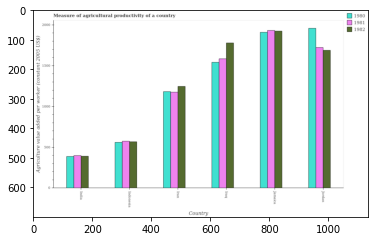

Number of QA =  29





,Country,1982,1980,1981
0,NaN,1776.938484,1552.839488,1597.575138
1,India,391.581563,391.885105,401.769354
2,Indonesia,572.032692,567.735539,582.524247
3,Jordan,1696.815533,1968.835627,1729.020566
4,Iran,1250.606161,1183.925172,1180.950815
5,Jamaica,1937.761602,1914.165090,1953.509374


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in 1981 in iran and that in iraq ?
PREDICTED =  -548.0697509771326
EXPECTED =  -409.57316909571




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity in 1981 in iraq and the measure of agricultural productivity in 1982 in iran?
PREDICTED =  548.0697509771326
EXPECTED =  338.4573486545801




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the measure of agricultural productivity of/in 1981 and measure of agricultural productivity of/in 1980 in iraq?
PREDICTED =  -15.326253002

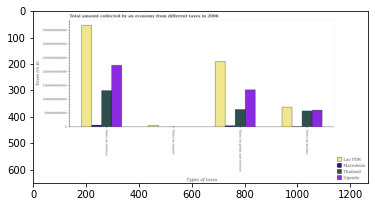

Number of QA =  29





,Types of taxes,Thailand,Uganda,Macedonia,Lao PDR
0,Taxes on income,5.825498e+11,6.180257e+11,NaN,7.248703e+11
1,Taxes on goods and services,6.404801e+11,1.344585e+12,5.137932e+10,2.370928e+12
2,Taxes on revenue,1.336399e+12,2.235708e+12,7.037758e+10,3.696091e+12
3,Taxes on exports,NaN,NaN,NaN,5.936808e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on income in thailand and that in uganda ?
PREDICTED =  -35475900321.53992
EXPECTED =  -27947672601.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on goods in macedonia and the amount collected as tax on income in uganda?
PREDICTED =  -566646337539.7863
EXPECTED =  -562618985625.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on exports and amount collected as tax on income in uganda ?
PREDICTED =  nan
EXPECTED =  -602577994239.0




				 1 / 3 = 0.3333


is_

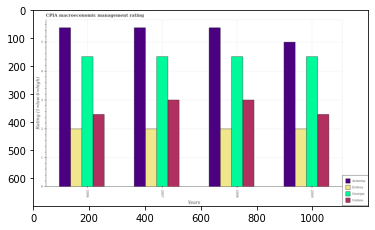

Number of QA =  30





,Years,Georgia,Eritrea,Guinea,Armenia
0,2006,4.486210,2.002877,2.496793,5.491650
1,2008,4.477815,1.997147,2.982846,5.496546
2,2007,4.478404,2.002364,2.977264,5.483389
3,2009,4.470289,2.000103,2.491053,4.974835


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in eritrea in 2006 and that in 2007 ?
PREDICTED =  0.0005123472535415452
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in georgia in 2008 and the cpia rating in armenia in 2009?
PREDICTED =  0.007525521865782814
EXPECTED =  -0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cpia rating in eritrea and cpia rating in georgia ?
PREDICTED =  4.002490471022945
EXPECTED =  -2.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting

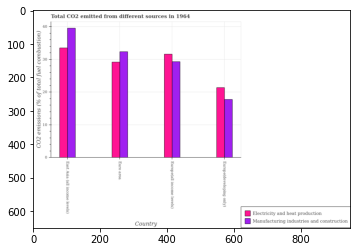

Number of QA =  28





,Country,Manufacturing industries and construction,Electricity and heat production
0,East Asia (all income levels),39.470772,33.649076
1,Europe(developing only),17.845739,21.511628
2,Europe(all income levels),29.432167,31.582597
3,Euro area,32.284972,29.258218


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to electricity and heat production in east asia (all income levels) and that in euro area ?
PREDICTED =  -1.8074035773925239
EXPECTED =  4.330976174689404




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing industries in east asia (all income levels) and the co2 emissions due to electricity and heat production in europe(all income levels)?
PREDICTED =  5.01930223675609
EXPECTED =  7.9502335526911985




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing indus

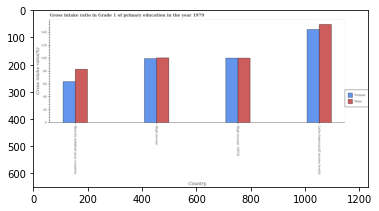

Number of QA =  28





,Country,Female,Male
0,High income: OECD,99.104460,99.063911
1,High income,98.588044,100.232688
2,Latin America(all income levels),142.818375,150.684059
3,Heavily indebted poor countries,63.809501,82.856314


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross intake ratio(female) in high income: oecd ?
PREDICTED =  24.77611500641957
EXPECTED =  99.9852981567383




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross intake ratio(male) ?
PREDICTED =  37.671014845530564
EXPECTED =  152.256134033203




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross intake ratio(female) ?
PREDICTED =  15.952375333984449
EXPECTED =  63.6394195556641




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 

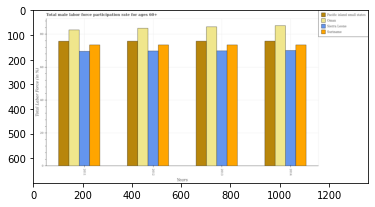

Number of QA =  30





,Years,Sierra Leone,Pacific island small states,Oman,Suriname
0,2013,69.381464,75.400582,83.626090,73.331646
1,2014,69.922516,75.463000,84.487768,73.273786
2,2012,69.844631,75.508844,83.291996,73.032726
3,2011,69.341887,75.641001,81.759317,73.218010


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in oman in 2013 and that in 2014 ?
PREDICTED =  -0.8616781592917988
EXPECTED =  -0.6999969482422017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in oman in 2012 and the male labor force participation rate in suriname in 2013?
PREDICTED =  -0.334094010611949
EXPECTED =  10.099998474120994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the male labor force participation rate in sierra leone and male labor force participation rate in oman ?
PREDICTE

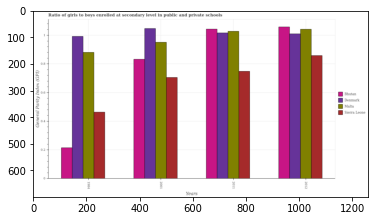

Number of QA =  30





,Years,Bhutan,Malta,Sierra Leone,Denmark
0,1984,0.219284,0.887823,0.463581,0.993661
1,2012,1.061821,1.055850,0.862827,1.019200
2,2001,0.832950,0.959325,0.706700,1.053207
3,2011,1.049869,1.033457,0.742309,1.023485


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in bhutan in 1984 and that in 2001 ?
PREDICTED =  -0.6136657895249679
EXPECTED =  -0.617620011100769




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the general parity index in malta in 2001 and the general parity index in denmark in 1984?
PREDICTED =  0.07150235487268941
EXPECTED =  -0.04107000291824292




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the general parity index in sierra leone and general parity index in malta ?
PREDICTED =  1.7913031829872719
EXPECTED =  -0.27906006574630493




				 1 / 

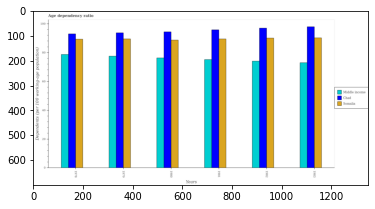

Number of QA =  29





,Years,Somalia,Chad,Middle income
0,1979,89.841752,94.312059,78.344520
1,1982,90.666913,97.490144,74.750070
2,1980,89.200532,94.386149,77.049923
3,1983,90.755903,98.425994,73.434661
4,1978,89.646679,93.354064,79.619648
5,1981,90.098972,96.409635,75.799066


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in somalia in 1983 ?
PREDICTED =  15.125983802607479
EXPECTED =  90.24007423438879




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio in in chad ?
PREDICTED =  330.5
EXPECTED =  97.9562378251128




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in somalia ?
PREDICTED =  330.0
EXPECTED =  88.69910650237591




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the age de

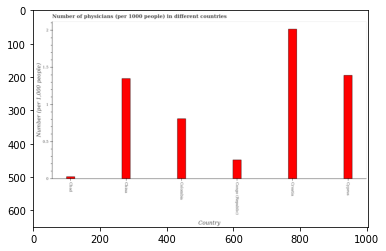

Number of QA =  22





,Country,"Number (per 1,000 people)"
0,Congo (Republic),0.261292
1,Colombia,0.816511
2,Cyprus,1.405209
3,Chad,0.038726
4,Croatia,2.024863
5,China,1.363892


> what is the title of the graph ?
PREDICTED =  Number of physicians (per 1000 people) in different countries
EXPECTED =  Number of physicians (per 1000 people) in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number (per 1,000 people)
EXPECTED =  Number (per 1,000 people)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in congo (republic) and cyprus ?
PREDICTED =  -1.738708268471469
EXPECTED =  -1.141




				 3 / 4 = 0.75


> what is the median number of physicians ?
PREDICTED =  None
EXPECTED =  1.0789000093936878




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

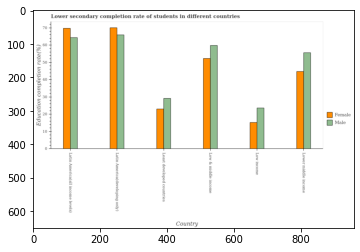

Number of QA =  28





,Country,Female,Male
0,Lower middle income,45.438544,56.199458
1,Least developed countries,23.608382,29.667591
2,Low & middle income,53.076203,60.189188
3,Low income,15.801094,24.173728
4,Latin America(all income levels),71.062732,65.140442
5,Latin America(developing only),71.382658,67.102139


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students in latin america(developing only) and that in low income ?
PREDICTED =  42.928410630158
EXPECTED =  42.3142662048339




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students in low & middle income and the education completion rate of female students in least developed countries?
PREDICTED =  86.721054068125
EXPECTED =  36.77028465271




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students and education completion rate of fem

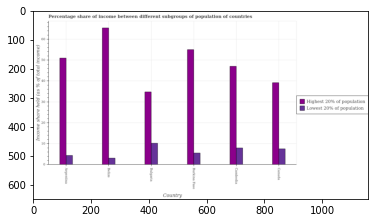

Number of QA =  28





,Country,Lowest 20% of population,Highest 20% of population
0,Bulgaria,10.387255,35.003217
1,Belize,3.252262,65.736877
2,Burkina Faso,5.657252,55.279373
3,Canada,7.758582,39.232656
4,Argentina,4.520436,51.039018
5,Cambodia,8.090992,47.422797


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in argentina and that in bulgaria ?
PREDICTED =  16.035800233072116
EXPECTED =  16.189999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in cambodia and the income share held by highest 20% of the population in belize?
PREDICTED =  44.17053411803806
EXPECTED =  -57.440000000000005




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population and income share held by highest 20% of the popul

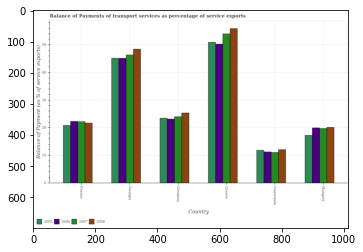

Number of QA =  30





,Country,2007,2005,2006,2008
0,Greece,53.701474,51.134168,50.530705,56.051351
1,France,22.241142,20.908863,22.438069,21.647380
2,Guatemala,11.184157,11.981953,11.418260,12.173006
3,Georgia,46.289920,45.239735,44.908788,48.494108
4,Germany,24.079095,23.423231,23.187946,25.442724
5,Hungary,19.732079,17.350770,19.804902,20.206929


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2007 in georgia and that in greece ?
PREDICTED =  -7.411553923161428
EXPECTED =  -7.626916455402409




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2008 in georgia and the balance of payments of transport services in 2005 in guatemala?
PREDICTED =  36.3211023357926
EXPECTED =  36.60324938545821




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services of/in 2006 and balance of payments of transport services of/in 2

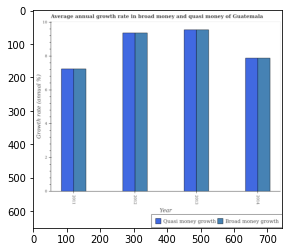

Number of QA =  28





,Year,Broad money growth,Quasi money growth
0,2014,7.904893,7.903329
1,2012,9.380667,9.407181
2,2013,9.629166,9.597352
3,2011,7.274705,7.277938


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in broad money in 2011 and that in 2012 ?
PREDICTED =  -2.105961763195685
EXPECTED =  -2.12569981967214




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in broad money in 2012 and the annual growth rate in quasi money in 2011?
PREDICTED =  2.105961763195685
EXPECTED =  2.12569981967214




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the annual growth rate in quasi money and annual growth rate in broad money ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0


is_built_with_cuda: 

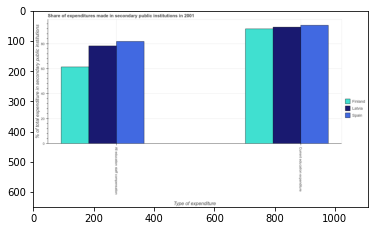

Number of QA =  23





,Type of expenditure,Latvia,Finland,Spain
0,All education staff compensation,79.805753,62.198448,82.502493
1,Current education expenditure,94.533695,92.962107,96.203957


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  % of total expenditure in secondary public institutions
EXPECTED =  20.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Share of expenditures made in secondary public institutions in 2001
EXPECTED =  Share of expenditures made in secondary public institutions in 2001




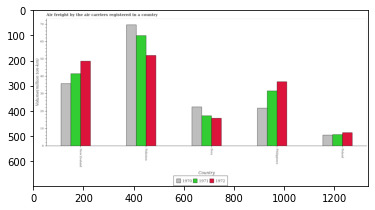

Number of QA =  29





,Country,1972,1971,1970
0,Poland,7.781372,6.735262,6.432450
1,Pakistan,52.396532,63.722503,69.663033
2,Peru,16.116387,17.458935,22.619510
3,Philippines,36.915378,31.849708,21.868474
4,New Zealand,48.686452,41.503203,35.963962


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in 1972 in new zealand and that in peru ?
PREDICTED =  32.570064384886045
EXPECTED =  32.8000011444




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in 1970 in poland and the volume of the air carriers in 1972 in philippines?
PREDICTED =  -30.48292814129465
EXPECTED =  -30.700001716600003




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers of/in 1970 and volume of the air carriers of/in 1972 in new zealand?
PREDICTED =  107.86097728324538
EXPECTED =  -12.90000

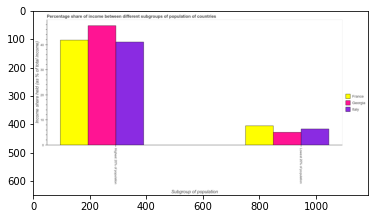

Number of QA =  23





,Subgroup of population,Georgia,France,Italy
0,Highest 20% of population,48.190697,42.028194,41.643307
1,Lowest 20% of population,5.336158,7.990111,6.636110


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in georgia and that in france ?
PREDICTED =  6.1625033073165625
EXPECTED =  5.759999999999998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population in france and the income share held by highest 20% of the population in italy?
PREDICTED =  -40.28930566216496
EXPECTED =  -33.42




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 20% of the population and income share held by highest 20% of the population in italy ?
PRE

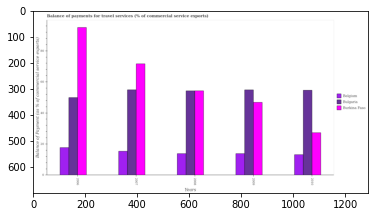

Number of QA =  29





,Years,Belgium,Bulgaria,Burkina Faso
0,2006,18.035232,50.578677,95.733988
1,2008,14.185203,54.568504,54.620348
2,2009,14.174348,55.321402,47.027492
3,2010,13.406173,55.087582,27.303765
4,2007,15.554942,55.322058,71.918418


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in belgium in 2006 and that in 2010 ?
PREDICTED =  4.629059398478375
EXPECTED =  4.5599881103208




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in burkina faso in 2008 and the balance of payments for travel services in belgium in 2010?
PREDICTED =  41.21417459946615
EXPECTED =  41.1058574624102




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the balance of payments for travel services in bulgaria and balance of payments for travel services i

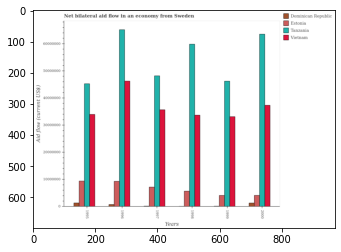

Number of QA =  30





,Years,Estonia,Dominican Republic,Tanzania,Vietnam
0,1999,4.254794e+06,NaN,4.657839e+07,3.295559e+07
1,1996,9.528201e+06,9.419014e+05,6.581316e+07,4.659724e+07
2,1998,5.865561e+06,NaN,6.014251e+07,3.398547e+07
3,1995,9.603988e+06,1.556458e+06,4.594969e+07,3.416340e+07
4,2000,4.289689e+06,1.539378e+06,6.399332e+07,3.760209e+07
5,1997,7.355876e+06,NaN,4.868974e+07,3.578708e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in estonia in 1995 and that in 1999 ?
PREDICTED =  5349194.415596769
EXPECTED =  5300000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in dominican republic in 1996 and the net bilateral aid flow in vietnam in 1999?
PREDICTED =  941901.3922430857
EXPECTED =  -32390000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the net bilateral aid flow in vietnam and net bilateral aid flow in estonia ?
PREDICTED =  180192747.57040232
EXPECTED =  28020000.0




				 1 / 3 = 0.3333


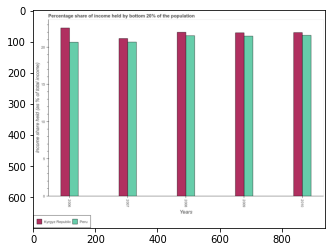

Number of QA =  28





,Years,Kyrgyz Republic,Peru
0,2008,22.281642,21.786533
1,2009,22.134344,21.704984
2,2006,23.114582,20.928399
3,2010,22.253661,21.852371
4,2007,21.564237,20.903597


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by bottom 20% of the population in peru in 2008 and that in 2010 ?
PREDICTED =  20.837758742895026
EXPECTED =  -0.05000000000000071




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by bottom 20% of the population in peru in 2007 and the share of income held by bottom 20% of the population in kyrgyz republic in 2009?
PREDICTED =  20.086237972423767
EXPECTED =  -1.25




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the share of income held by bottom 20% of the population in peru and 

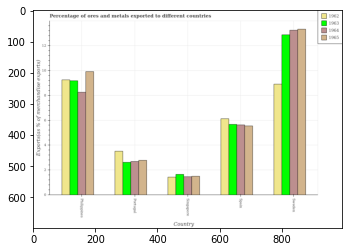

Number of QA =  30





,Country,1965,1964,1962,1963
0,NaN,5.578726,5.655792,6.162794,5.746025
1,Philippines,9.868273,8.306495,9.308044,9.237484
2,Singapore,1.553847,1.512703,1.502288,1.713657
3,Portugal,2.835499,2.718658,3.562307,2.671206
4,Sweden,13.425733,13.309739,9.014308,13.003531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1963 in singapore and that in spain ?
PREDICTED =  -2.286343019425378
EXPECTED =  -4.021706747001877




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries of/in 1965 and percentage of exports to different countries of/in 1963 in philippines?
PREDICTED =  -6.237484209946967
EXPECTED =  0.7356828330981298




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

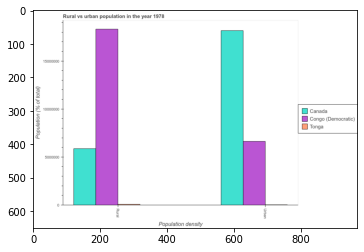

Number of QA =  23





,Population density,Tonga,Congo (Democratic),Canada
0,Rural,NaN,1.839701e+07,5.902670e+06
1,Urban,NaN,6.735470e+06,1.837921e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rural population density in congo (democratic) to that in tonga ?
PREDICTED =  1.0
EXPECTED =  252.9324184396184




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Population (% of total)
EXPECTED =  5000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Rural vs urban population in the ye

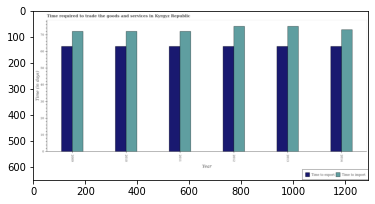

Number of QA =  28





,Year,Time to export,Time to import
0,2012,63.581545,75.705110
1,2011,63.531109,72.386057
2,2014,63.699272,73.240475
3,2009,63.540367,72.121073
4,2010,63.484981,72.507306
5,2013,63.482909,75.419505


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to import in 2010 and that in 2012 ?
PREDICTED =  -3.197804083135239
EXPECTED =  -3




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to export in 2014 and the time to import in 2009?
PREDICTED =  0.15890447753304215
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the time to import and time to export ?
PREDICTED =  9.863982505021738
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





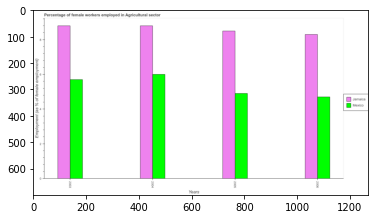

Number of QA =  28





,Years,Mexico,Jamaica
0,2003,5.798797,8.874225
1,2006,4.778994,8.355328
2,2004,6.079364,8.903666
3,2005,4.965826,8.530001


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in agricultural sector in jamaica in 2004 and that in 2006 ?
PREDICTED =  0.5483384902721564
EXPECTED =  0.4999999999999982




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in agricultural sector in mexico in 2006 and the percentage of females employed in agricultural sector in jamaica in 2004?
PREDICTED =  -1.3003700404782776
EXPECTED =  -4.100000381469722




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of females employed in agricultural sector

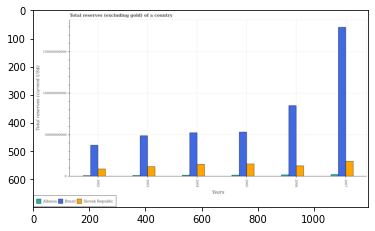

Number of QA =  29





,Years,Albania,Brazil,Slovak Republic
0,2004,NaN,5.315849e+10,1.494197e+10
1,2002,NaN,3.800936e+10,9.402330e+09
2,2005,NaN,5.452988e+10,1.557916e+10
3,2006,2.399701e+09,8.678073e+10,1.325773e+10
4,2003,NaN,4.947354e+10,1.230354e+10
5,2007,2.667287e+09,1.807949e+11,1.870698e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in brazil in 2005 and that in 2007 ?
PREDICTED =  -126265019279.18254
EXPECTED =  -126187656009.3086




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in albania in 2003 and the total reserves (excluding gold) in slovak republic in 2005?
PREDICTED =  0.0
EXPECTED =  -13891265111.07044




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the total reserves (excluding gold) in albania and total reserves (excluding gold) in brazil ?
PREDICTED =  -462746884475.046
EXPE

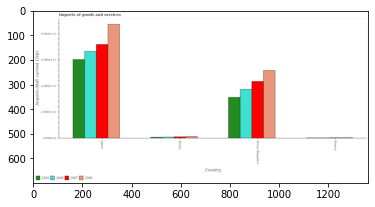

Number of QA =  30





,Country,2007,2005,2008,2006
0,Kosovo,NaN,NaN,NaN,NaN
1,Kenya,0.152518,NaN,0.176363,NaN
2,Korea (Republic),4.418336,3.218497,5.249218,3.809265
3,Japan,7.253354,6.104253,8.829218,6.726050


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in 2007 in japan and that in kosovo ?
PREDICTED =  11.824207350415346
EXPECTED =  716239775014.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in 2005 in japan and the amount spent on imports in 2008 in kosovo?
PREDICTED =  9.322749949884688
EXPECTED =  599910192075.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports of/in 2007 and amount spent on imports of/in 2008 in kenya?
PREDICTED =  11.64784395019975
EXPECTED =  -2500137989.0




				 0 / 3 = 0.0


is_built_

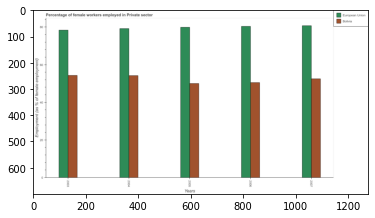

Number of QA =  28





,Years,Bolivia,European Union
0,2006,50.527770,80.387703
1,2004,54.345202,79.206551
2,2007,51.996452,80.925231
3,2003,54.362266,78.481234
4,2005,50.196941,80.310723


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in european union in 2003 and that in 2005 ?
PREDICTED =  -1.8294895459371077
EXPECTED =  -1.5113671206308936




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in european union in 2006 and the percentage of females employed in private sector in bolivia in 2004?
PREDICTED =  1.1811520194900424
EXPECTED =  26.183664866456503




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of females employed in private sector in 

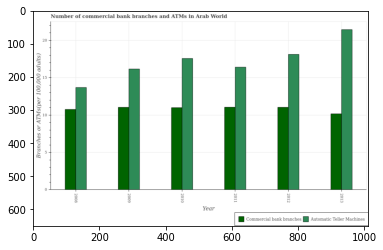

Number of QA =  28





,Year,Automatic Teller Machines,Commercial bank branches
0,2009,16.360829,11.198547
1,2010,17.628760,11.141187
2,2013,21.650655,10.246232
3,2011,16.561381,11.198610
4,2008,13.813643,10.878828
5,2012,18.297811,11.195310


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercal bank branches in 2012 and that in 2013 ?
PREDICTED =  0.9490776135068071
EXPECTED =  0.8679601899194012




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms in 2011 and the number of commercal bank branches in 2012?
PREDICTED =  -1.7364300364919423
EXPECTED =  -1.7116205499497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of atms and number of commercal bank branches ?
PREDICTED =  98.31307875123153
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_availa

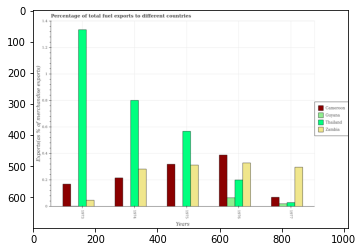

Number of QA =  30





,Years,Zambia,Thailand,Cameroon,Guyana
0,1977,0.299919,0.033580,0.073014,0.025690
1,1974,0.286371,0.803186,0.221099,NaN
2,1975,0.315149,0.567591,0.322508,NaN
3,1973,0.051784,1.344446,0.172917,NaN
4,1976,0.333519,0.203347,0.392704,0.070186


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in guyana in 1974 and that in 1976 ?
PREDICTED =  nan
EXPECTED =  -0.06558490180628958




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in zambia in 1975 and the percentage of exports to different countries in cameroon in 1974?
PREDICTED =  0.028777652892502725
EXPECTED =  0.09681064637217002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

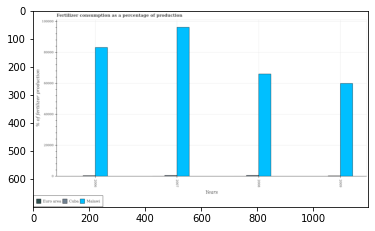

Number of QA =  29





,Years,Malawi,Cuba,Euro area
0,2006,83724.903622,NaN,NaN
1,2008,66398.171024,NaN,NaN
2,2009,60422.121431,NaN,NaN
3,2007,96652.216893,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fertilizers consumed in malawi in 2006 and that in 2008 ?
PREDICTED =  17326.732597720664
EXPECTED =  17133.012193286093




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fertilizers consumed in malawi in 2008 and the percentage of fertilizers consumed in euro area in 2009?
PREDICTED =  5976.049593056443
EXPECTED =  66023.99934176824




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is 

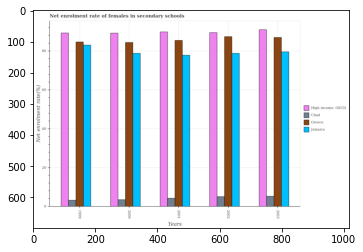

Number of QA =  30





,Years,Chad,Greece,High income: OECD,Jamaica
0,2002,5.270111,87.647395,90.014225,79.131566
1,2000,3.725442,84.573625,89.546283,79.064462
2,2003,5.499432,87.180892,91.039337,79.947998
3,1999,3.501487,85.096479,90.040122,83.075099
4,2001,4.528820,85.687085,90.148718,78.507184


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in greece in 2000 and that in 2003 ?
PREDICTED =  -1.4930538740115935
EXPECTED =  -2.5810852050780966




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in greece in 2003 and the net enrolment rate of females in secondary schools in high income: oecd in 2001?
PREDICTED =  0.8906184168508702
EXPECTED =  -2.8449783325196165




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the net enrolment rate of females in secondary schools 

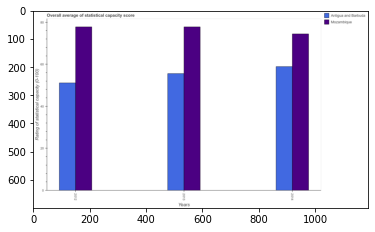

Number of QA =  28





,Years,Mozambique,Antigua and Barbuda
0,2012,78.047896,51.508623
1,2013,78.546578,56.165285
2,2014,75.065439,59.359465


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in antigua and barbuda in 2012 and that in 2014 ?
PREDICTED =  -15.705973933164245
EXPECTED =  -7.7777777777778




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in mozambique in 2012 and the rating of statistical capacity in antigua and barbuda in 2013?
PREDICTED =  -0.49868270379518265
EXPECTED =  22.2222222222222




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the rating of statistical capacity in antigua and barbuda and rating of statistical capacity in moza

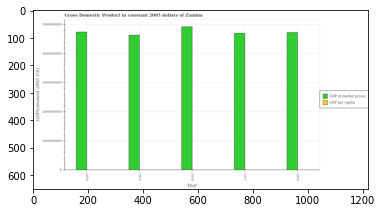

Number of QA =  28





,Year,GDP per capita,GDP at market prices
0,1974,NaN,4.741107e+09
1,1976,NaN,4.924189e+09
2,1977,NaN,4.683586e+09
3,1978,NaN,4.703812e+09
4,1975,NaN,4.619128e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in 1974 and that in 1975 ?
PREDICTED =  121978430.53627968
EXPECTED =  107608743.28432941




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in 1977 and the gdp per capita in 1975?
PREDICTED =  64457485.08938217
EXPECTED =  63619168.7628994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1974, what is the difference between the gdp at market prices and gdp per capita ?
PREDICTED =  183082318.9846859
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

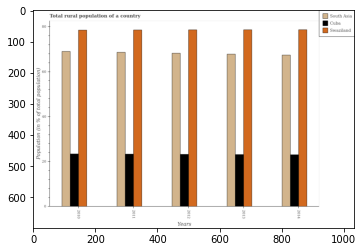

Number of QA =  29





,Years,Cuba,South Asia,Swaziland
0,2010,23.544329,68.628764,78.708981
1,2013,23.225188,67.917318,79.036991
2,2014,23.374869,67.312348,78.965500
3,2011,23.517877,68.720298,78.538788
4,2012,NaN,68.496015,78.944701


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in swaziland in 2011 and that in 2014 ?
PREDICTED =  -0.42671284275051846
EXPECTED =  -0.10999999999999943




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in swaziland in 2011 and the rural population in cuba in 2012?
PREDICTED =  -0.4059133960551691
EXPECTED =  55.356




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the rural population in cuba and rural population in swaziland ?
PREDICTED =  -55.61380434468559
EXPECTED =  -55.655




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu

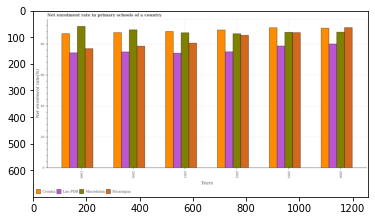

Number of QA =  30





,Years,Nicaragua,Croatia,Macedonia,Lao PDR
0,1999,77.215709,87.110804,90.356429,74.276297
1,2001,80.767700,88.088107,87.653187,73.946995
2,2005,87.699992,90.838909,87.504599,79.150152
3,2000,78.911316,87.602410,89.324145,75.011394
4,2002,85.895467,88.910379,86.986727,75.175311
5,2006,91.228815,90.692664,88.157405,80.113892


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in primary schools in croatia in 2001 and that in 2002 ?
PREDICTED =  -0.8222728199511096
EXPECTED =  -0.9386978149414062




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in primary schools in lao pdr in 2006 and the net enrolment rate in primary schools in macedonia in 1999?
PREDICTED =  5.837594361120182
EXPECTED =  -11.353691101074205




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net enrolment rate in primary schools in lao pdr and net enrolment rate in primary schools in cro

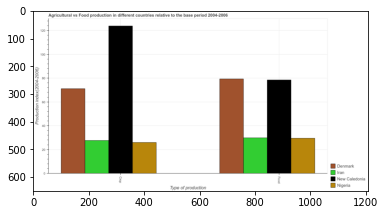

Number of QA =  23





,Type of production,Iran,Nigeria,New Caledonia,Denmark
0,Food,30.153764,29.790939,NaN,79.116396
1,NaN,28.033669,26.395269,123.352287,71.183307


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the food production index in denmark and that in iran ?
PREDICTED =  48.96263163441415
EXPECTED =  49.44999999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the crop production index in denmark and the food production index in iran?
PREDICTED =  48.96263163441415
EXPECTED =  41.22999999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the crop production index and food production index in denmark ?
PREDICTED =  -78.11639585516055
EXPECTED =  -8.219999999999999




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False

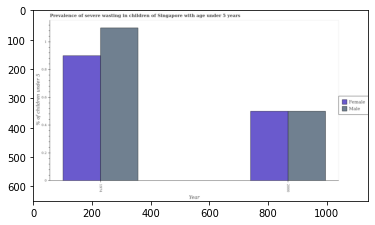

Number of QA =  24





,Year,Female,Male
0,1974,0.911410,1.110951
1,2000,0.504111,0.503576


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in 1974 and that in 2000 ?
PREDICTED =  0.4072990147742247
EXPECTED =  0.3999999761581421




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in 1974 and the percentage of undernourished male children in 2000?
PREDICTED =  0.4072990147742247
EXPECTED =  0.3999999761581421




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of undernourished female children and percentage of undernourished male children ?
PREDICTED =  0.0
EXPE

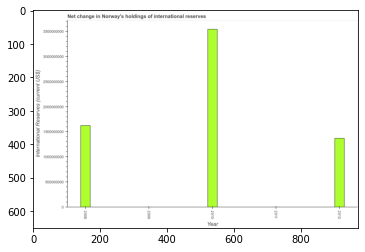

Number of QA =  21





,Year,international Reserves (current US$)
0,2009,NaN
1,2012,1.373191e+09
2,2011,NaN
3,2010,3.533475e+09
4,2008,1.626249e+09


> what is the title of the graph ?
PREDICTED =  Net change in Norway's holdings of international reserves
EXPECTED =  Net change in Norway's holdings of international reserves




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  international Reserves (current US$)
EXPECTED =  International Reserves (current US$)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 4 = 0.5


> what is the median reserves and related items ?
PREDICTED =  None
EXPECTED =  1369540887.0




				 2 / 6 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the reserves and related items in 2008 to that in 2012 ?
PREDICTED =  1.1842849358023608
EXPECTED =

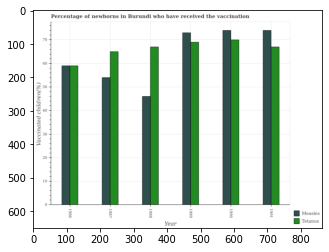

Number of QA =  28





,Year,Measles,Tetanus
0,1990,73.691101,69.558707
1,1987,53.639408,64.059035
2,1988,45.560974,66.585611
3,1986,58.791695,58.510515
4,1989,72.453925,68.539175
5,1991,73.766938,66.740058


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of newborns who received vaccination for measles in 1988 and that in 1990 ?
PREDICTED =  -28.130126884551686
EXPECTED =  -28




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of newborns who received vaccination for tetanus in 1988 and the percentage of newborns who received vaccination for measles in 1991?
PREDICTED =  -7.181326985896703
EXPECTED =  0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the percentage of newborns who received vaccination for tetanus and percentage of newborns who received

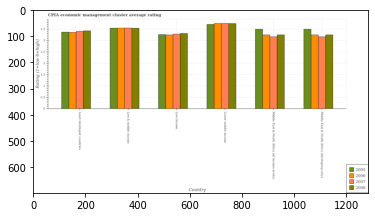

Number of QA =  30





,Country,2007,2005,2008,2006
0,Least developed countries,3.466788,3.423856,3.490415,3.417266
1,Lower middle income,NaN,3.775438,3.820692,3.807596
2,Low & middle income,NaN,3.591300,3.611268,3.602723
3,Middle East & North Africa (all income levels),3.214465,3.553855,3.305991,3.302527
4,Low income,3.327497,3.311920,3.365965,3.294942
5,Middle East & North Africa (developing only),3.206888,3.563154,3.306441,3.302677


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in lower middle income and that in middle east & north africa (developing only) ?
PREDICTED =  0.5049190616410679
EXPECTED =  0.50128205128205




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in low & middle income and the cpia rating in 2005 in low income?
PREDICTED =  0.0
EXPECTED =  0.2882905982906001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2008 and cpia rating of/in 2006 in least developed countries?
PREDICTED =  0.06619604719264238
EXPECTED =  0.06666666666666998




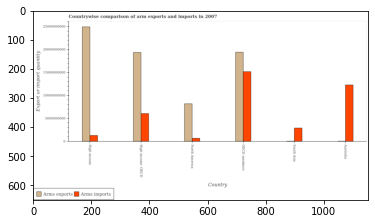

Number of QA =  28





,Country,Arms imports,Arms exports
0,High income,1.404653e+09,2.521951e+10
1,Australia,1.240335e+10,NaN
2,High income: OECD,6.227308e+09,1.946307e+10
3,North America,8.077034e+08,8.329392e+09
4,OECD members,1.531588e+10,1.955083e+10
5,South Asia,3.019747e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in high income and that in oecd members ?
PREDICTED =  5668674871.897263
EXPECTED =  5522000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms imports in high income and the arms exports in north america?
PREDICTED =  596949574.318669
EXPECTED =  -6904000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the arms imports in australia to that in south asia ?
PREDICTED =  4.10

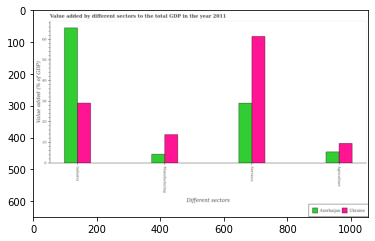

Number of QA =  29





,Different sectors,Azerbaijan,Ukraine
0,Services,29.598490,62.487562
1,Agriculture,5.736513,9.857025
2,Manufacturing,4.548554,14.144688
3,Industry,66.767924,29.577583


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in azerbaijan and that in ukraine ?
PREDICTED =  -32.88907213925627
EXPECTED =  -32.4044321558112




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in ukraine and the value added by manufacturing sector in azerbaijan?
PREDICTED =  7.857025326147658
EXPECTED =  5.2552330091748205




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector and value added by services sector in ukraine ?
PREDICTED =  -71.34458699858934
EXPECTED =  -51.937628167096904



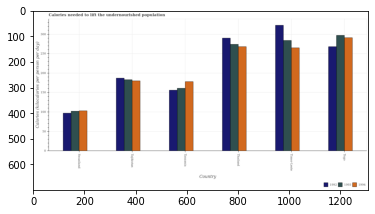

Number of QA =  29





,Country,1992,1993,1994
0,Timor-Leste,326.461630,287.816924,268.050153
1,Togo,270.968078,301.908420,295.398047
2,Thailand,294.388257,277.712744,272.009112
3,Swaziland,98.841450,103.934203,104.807492
4,Tanzania,158.481029,163.784787,180.151760
5,Tajikistan,190.340892,185.857174,182.743778


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in 1992 in swaziland and that in tajikistan ?
PREDICTED =  -91.49944246858963
EXPECTED =  -90.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in 1993 in timor-leste and the total calories needed to lift the undernourished population in 1992 in swaziland?
PREDICTED =  183.88272054957136
EXPECTED =  187.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population of/in

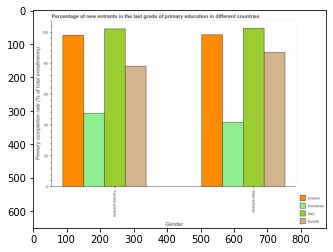

Number of QA =  23





,Gender,Italy,Greece,Honduras,Kuwait
0,Female entrants,103.249373,98.264888,48.833358,78.825691
1,Male entrants,104.898740,99.870089,42.121601,88.231961


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in honduras and that in kuwait ?
PREDICTED =  -46.110360519718085
EXPECTED =  -45.338750000000026




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in greece and the primary completion rate of female entrants in kuwait?
PREDICTED =  11.638127847959694
EXPECTED =  20.364710000000002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of female entrants and primary completion rate of male entrants in kuwait ?
PREDICTED =  15.0174117053387

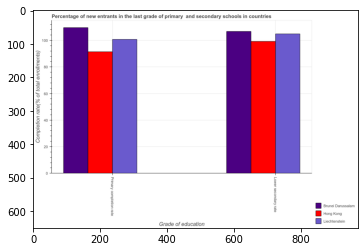

Number of QA =  23





,Grade of education,Brunei Darussalam,Liechtensteir,Hong Kong
0,Lower secondary rate,107.560072,105.819879,99.809817
1,Primary completion rate,110.355825,101.367571,92.360605


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in primary schools in liechtenstein and the completion rate in secondary schools in brunei darussalam?
PREDICTED =  -109.35582529405201
EXPECTED =  -6.00463104248




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools and completion rate in primary schools in liechtenstein ?
PREDICTED =  -90.36060468078593
EXPECTED =  4.157211303710994




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

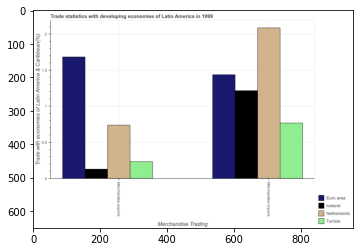

Number of QA =  23





,Merchandise Trading,Iceland,Tunisia,Netherlands,Euro area
0,Merchandise imports,NaN,0.778585,2.086306,1.442911
1,Merchandise exports,0.137763,0.240254,0.736269,1.673451


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade with economies of Latin America & Caribbean(%)
EXPECTED =  0.5




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with developing economies of Latin America in 1999
EXPECTED =  Trade statistics with developing economies of Latin America in 1999




		

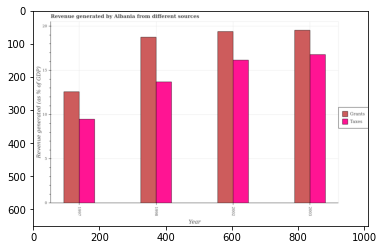

Number of QA =  28





,Year,Taxes,Grants
0,2002,16.224508,19.510744
1,1997,9.551308,12.620358
2,2003,16.822664,19.667281
3,1998,13.810638,18.652729


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by taxes in 1997 and that in 2003 ?
PREDICTED =  -7.271356023823632
EXPECTED =  -7.311549448983719




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants in 1997 and the revenue generated by taxes in 1998?
PREDICTED =  -6.032371455048688
EXPECTED =  -6.1697027809467




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the revenue generated by taxes and revenue generated by grants ?
PREDICTED =  -53.628448128278045
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_

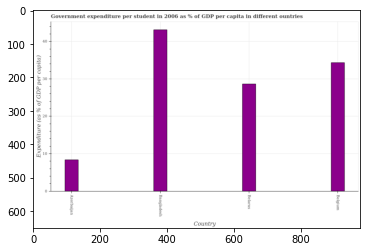

Number of QA =  22





,Country,Expenditure (as % of GDP per capita)
0,Belarus,28.718153
1,Bangladesh,43.185221
2,Azerbaijan,8.562161
3,Belgium,34.400299


> what is the title of the graph ?
PREDICTED =  Government expenditure per student in 2006 as % of GDP per capita in different ountries
EXPECTED =  Government expenditure per student in 2006 as % of GDP per capita in different ountries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Expenditure (as % of GDP per capita)
EXPECTED =  Expenditure (as % of GDP per capita)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the government expenditure per student in bangladesh and belarus ?
PREDICTED =  14.467068126274562
EXPECTED =  14.481




				 4 / 4 = 1.0


> what is the median government expenditure per student ?
PREDICTED =  None
EXPECTED =  31.49223613739015




				 4 / 6 = 0.6667


is_built_with_cuda: True
i

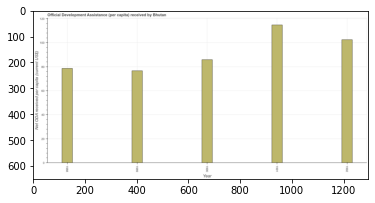

Number of QA =  23





,Year,Net ODA received per capita (current US$)
0,1990,86.652629
1,1989,77.075976
2,1992,103.060930
3,1988,79.394610
4,1991,115.671689


> what is the title of the graph ?
PREDICTED =  Official Development Assistance (per capita) received by Bhutan
EXPECTED =  Official Development Assistance (per capita) received by Bhutan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Net ODA received per capita (current US$)
EXPECTED =  Net ODA received per capita (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net oda received per capita in 1989 and 1990 ?
PREDICTED =  -9.576652256231228
EXPECTED =  -9.25




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median net oda received per capita ?
PREDICTED =  86.65262853448532
EXPE

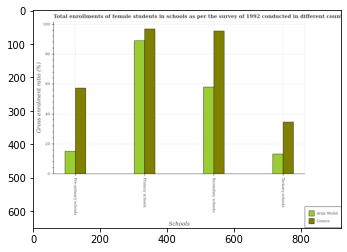

Number of QA =  29





,Schools,Greece,Arab World
0,Primary schools,97.403049,89.414700
1,Tertiary schools,35.039767,13.709386
2,Secondary schools,95.940895,58.737570
3,Pre-primary schools,58.008382,15.398833


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(female) in primary schools in greece ?
PREDICTED =  97.40304923932224
EXPECTED =  96.80428




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(female) in primary schools ?
PREDICTED =  89.41470027032227
EXPECTED =  96.80428




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio(female) in primary schools ?
PREDICTED =  3.0
EXPECTED =  88.9881591796875




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

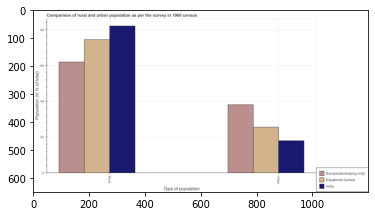

Number of QA =  23





,Type of population,India,Europe(developing only),Equatorial Guinea
0,Rural,82.556141,61.938445,74.436136
1,Urban,18.129024,38.234421,25.479686


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in india and that in equatorial guinea ?
PREDICTED =  8.120005053686924
EXPECTED =  7.6129999999999995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in equatorial guinea and the rural population in europe(developing only)?
PREDICTED =  -12.75473518849013
EXPECTED =  -36.3968713147469




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population and urban population in equatorial guinea ?
PREDICTED =  32.59822984669742
EXPECTED =  48.92600000000002




				 0 / 3 = 0.0


is_built_with_cuda: True
i

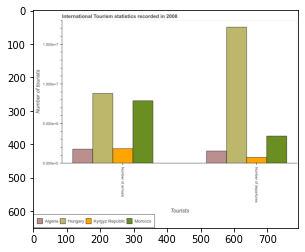

Number of QA =  23





,Tourists,Kyrgyz Republic,Algeria,Hungary,Morocco
0,Number of arrivals,0.191426,0.185326,0.887262,0.794817
1,Number of departures,0.081193,0.161122,1.729962,0.349935


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Number of tourists
EXPECTED =  5000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  International Tourism statistics recorded in 2008
EXPECTED =  International Tourism statistics recorded in 2008




				 1 / 6 = 0.1667


> what is the label or title of the x-axis ?

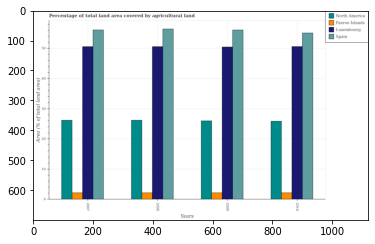

Number of QA =  30





,Years,Luxembourg,Spain,North America,Faeroe Islands
0,2007,50.779161,56.304137,26.268387,2.297241
1,2010,50.825739,54.972684,26.037895,2.300226
2,2008,50.778513,56.515283,26.433488,2.322925
3,2009,50.595342,56.248826,26.187957,2.285330


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in spain in 2009 and that in 2010 ?
PREDICTED =  1.2761426784787844
EXPECTED =  1.0014238410936045




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in luxembourg in 2008 and the percentage of agricultural land in north america in 2010?
PREDICTED =  24.740618096542573
EXPECTED =  24.7200629643404




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of agricultural land in faeroe islands and percentage of agricultural land in north america ?
PREDICTED

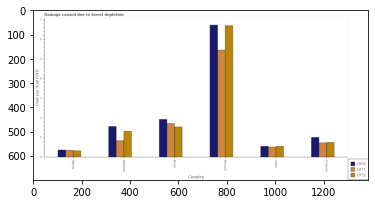

Number of QA =  29





,Country,1972,1971,1970
0,Brazil,1.551842,1.734721,1.939562
1,NaN,0.349427,0.374032,0.391310
2,Burundi,6.699933,5.387367,6.679333
3,Bahamas,1.329389,0.850909,1.569196
4,Comoros,0.769368,0.753111,1.035657
5,China,0.571783,0.533344,0.577352


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in 1971 in brazil and the cost of damage caused due to forest depletion in 1970 in china?
PREDICTED =  1.2013774383294349
EXPECTED =  1.1600496212202063




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion of/in 1971 and cost of damage caused due to forest depletion of/in 1972 in comoros?
PREDICTED =  4.617999007046924
EXPECTED =  -0.020786657349212923




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Train

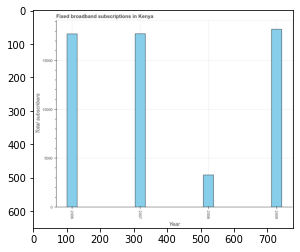

Number of QA =  23





,Year,Total subscribers
0,2008,3344.994762
1,2009,18293.523901
2,2007,17818.880728
3,2006,17748.006933


> what is the title of the graph ?
PREDICTED =  Fixed broadband subscriptions in Kenya
EXPECTED =  Fixed broadband subscriptions in Kenya




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total subscribers
EXPECTED =  Total subscribers




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of fixed broadband subscriptions in 2008 and 2009 ?
PREDICTED =  -14948.529138528986
EXPECTED =  -14918.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total number of fixed broadband subscriptions ?
PREDICTED =  17783.443830063654
EXPECTED =  17730.0




				 5 / 5 = 1.0


is_built_with_cuda

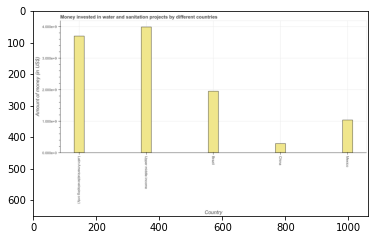

Number of QA =  22





,Country,Amount of money (in US$)
0,Brazil,1.962253
1,Mexico,1.050179
2,China,0.302395
3,Upper middie income,4.012318
4,Latin America(de veloping onty ),3.721134


> what is the title of the graph ?
PREDICTED =  Money invested in water and sanitation projects by different countries
EXPECTED =  Money invested in water and sanitation projects by different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Amount of money (in US$)
EXPECTED =  Amount of money (in US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in latin america(developing only) and upper middle income ?
PREDICTED =  0.0
EXPECTED =  -287390000.0




				 3 / 4 = 0.75


> what is the median investment ?
PREDICTED =  None
EXPECTED =  1949000000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

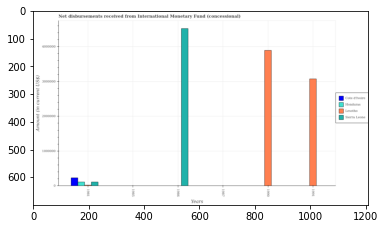

Number of QA =  22





,Years,Sierra Leone,Lesotho,Cote d'Ivoire,Honduras
0,1990,NaN,3.898291e+06,NaN,NaN
1,1981,1.294092e+05,NaN,248200.166343,126241.954838
2,1986,4.524785e+06,NaN,NaN,NaN
3,1991,NaN,3.094902e+06,NaN,NaN
4,1987,NaN,NaN,NaN,NaN
5,1985,NaN,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in lesotho in 1986 and the amount of disbursements received from international monetary fund in sierra leone in 1985?
PREDICTED =  -2.0
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1981, what is the difference between the amount of disbursements received from international monetary fund in sierra leone and amount of disbursements received from international monetary fund in cote d'ivoire ?
PREDICTED =  1.0
EXPECTED =  -120000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the hi

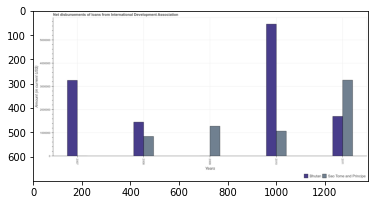

Number of QA =  25





,Years,Bhutan,Sao Tome and Principe
0,2010,5.712520e+06,1.095543e+06
1,2007,3.272920e+06,NaN
2,2011,1.744004e+06,3.298826e+06
3,2008,1.473433e+06,8.519873e+05
4,2009,NaN,1.303821e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in sao tome and principe in 2010 and that in 2011 ?
PREDICTED =  2155808.263028709
EXPECTED =  -2196000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in sao tome and principe in 2011 and the amount of loans disbursed in bhutan in 2008?
PREDICTED =  2399364.2619473026
EXPECTED =  1808000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount of loans disbursed in bhutan and amount of loans disbursed in sao tome and principe ?
PREDICTED =  5652699.499614468
EXPE

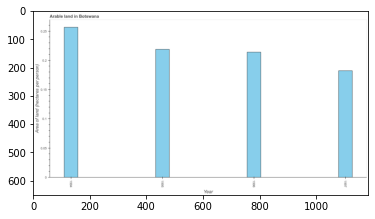

Number of QA =  23





,Year,Area of land (hectares per person)
0,1995,0.220835
1,1997,0.184120
2,1994,0.258813
3,1996,0.215693


> what is the title of the graph ?
PREDICTED =  Arable land in Botswana
EXPECTED =  Arable land in Botswana




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Area of land (hectares per person)
EXPECTED =  Area of land (hectares per person)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of arable land in 1996 and 1997 ?
PREDICTED =  0.031572539587442744
EXPECTED =  0.032




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of arable land ?
PREDICTED =  1995.5
EXPECTED =  0.2164555194027685




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or

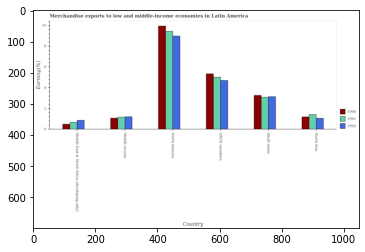

Number of QA =  29





,Country,1962,1961,1960
0,Middle income,1.213120,1.179072,1.091949
1,North America,8.968686,9.403536,9.852390
2,OECD members,4.699460,4.960024,5.341159
3,Small states,3.133310,3.092979,3.247137
4,South Asia,1.077115,1.430992,1.217739
5,Middle East & North Africa (developing only),0.883872,0.680372,0.502895


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1960 in south asia and the percentage of amount earned from merchandise exports in 1962 in small states?
PREDICTED =  -1.9155714374787574
EXPECTED =  -1.9451676744890403




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports of/in 1961 and percentage of amount earned from merchandise exports of/in 1960 in small states?
PREDICTED =  6.156399100832136
EXPECTED =  -0.1735871360470198




				 1 / 3 = 0.3333


is_built_with_cuda:

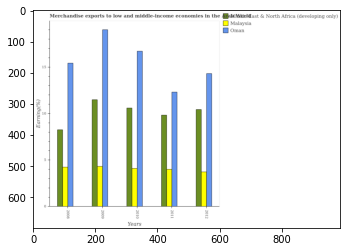

Number of QA =  29





,Years,bi Maiel@ ast & North Africa (developing only),Malaysia,Oman
0,2012,10.483727,3.763803,14.364535
1,2011,9.905828,4.039433,12.399547
2,2010,10.708028,4.160148,16.807664
3,2008,8.381432,4.366171,15.498650
4,2009,11.531134,4.286637,19.188766


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in middle east & north africa (developing only) in 2009 and that in 2010 ?
PREDICTED =  0.823106376850367
EXPECTED =  0.8966488976358988




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in malaysia in 2010 and the percentage of amount earned from merchandise exports in oman in 2009?
PREDICTED =  -0.12648840411917472
EXPECTED =  -14.924548549063811




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of amoun

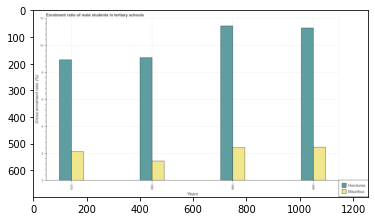

Number of QA =  28





,Years,Mauritius,Honduras
0,1988,2.417273,11.311186
1,1978,2.153583,8.881712
2,1980,1.431740,9.060589
3,1989,2.441086,11.187207


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of male students in tertiary schools in honduras in 1980 ?
PREDICTED =  0.004567404822377028
EXPECTED =  9.08444




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of male students in tertiary schools in honduras ?
PREDICTED =  0.005701920937831709
EXPECTED =  11.43052




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of male students in tertiary schools in mauritius ?
PREDICTED =  0.998109640831758
EXPECTED =  1.42704




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

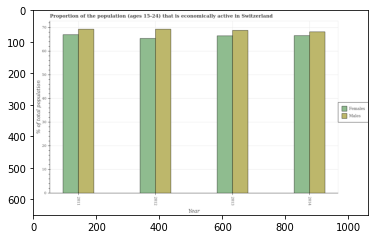

Number of QA =  28





,Year,Males,Females
0,2013,68.825691,66.575997
1,2011,69.385627,67.122812
2,2014,67.662226,66.542218
3,2012,69.376063,65.592826


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in 2011 and that in 2013 ?
PREDICTED =  0.5468146638070408
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in 2011 and the percentage of economically active male population in 2013?
PREDICTED =  0.5468146638070408
EXPECTED =  0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of economically active male population and percentage of economically active female population ?
PREDICTED =  2.8

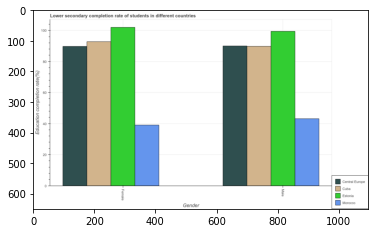

Number of QA =  23





,Gender,Estonia,Cuba,Central Europe,Moroccc
0,Male,99.58726,89.856348,90.054768,43.733040
1,Female,102.90647,93.000697,89.537330,39.634902


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of female students in morocco and that in cuba ?
PREDICTED =  0.0
EXPECTED =  -53.696331024170014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of female students in morocco and the education completion rate of male students in estonia?
PREDICTED =  -109.49303273980917
EXPECTED =  -60.364917755127




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of female students and education completion rate of male students in central europe ?
PREDICTED =  12.85170194450

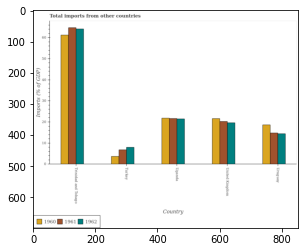

Number of QA =  29





,Country,1962,1961,1960
0,Turkey,8.154031,6.994702,3.853975
1,Trinidad and Tobago,64.523485,64.889826,60.337492
2,United Kingdom,19.682326,20.442241,21.705789
3,Uruguay,14.614513,15.077819,18.840338
4,Uganda,21.443663,21.777057,21.830960


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1962 in uganda and that in united kingdom ?
PREDICTED =  20.443662649574737
EXPECTED =  1.8264407900132014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1961 in united kingdom and the total imports in 1962 in trinidad and tobago?
PREDICTED =  -44.447584904802746
EXPECTED =  -43.864903909561




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of/in 1962 and total imports of/in 1960 in trinidad and tobago?
PREDICTED =  -55.337491838572205
EXPECTED =  2.8829359712357956




				 1 / 3 = 0.333

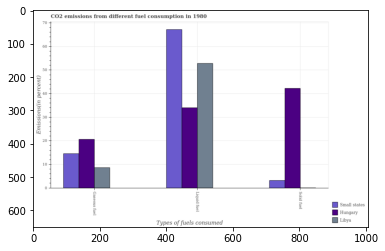

Number of QA =  28





,Types of fuels consumed,Unnamed: 1,Small states,Hungary
0,Gaseous fuel,8.879808,14.841135,20.911140
1,Liquid fuel,52.591236,66.953136,33.988970
2,Solid fuel,NaN,3.445397,42.389032


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of liquid fuel emission in small states and the percentage of gaseous fuel emission in libya?
PREDICTED =  66.95313593854289
EXPECTED =  58.54150240712383




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of liquid fuel emission and percentage of solid fuel emission in hungary ?
PREDICTED =  -33.98896983725277
EXPECTED =  -8.215476843838402




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is th

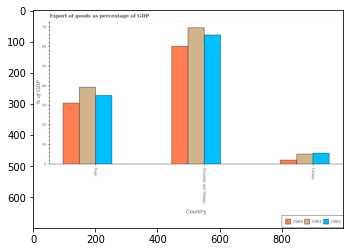

Number of QA =  29





,Country,1962,1961,1960
0,Trinidad and Tobago,65.874274,69.582518,60.130327
1,Turkey,5.820199,5.416582,2.294845
2,Togo,34.973464,39.325066,31.519677


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1961 in togo and that in trinidad and tobago ?
PREDICTED =  -30.257451936457258
EXPECTED =  -30.3307460834666




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1960 in trinidad and tobago and the export of goods as percentage of gdp in 1961 in togo?
PREDICTED =  20.80526107540966
EXPECTED =  20.8339604370289




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

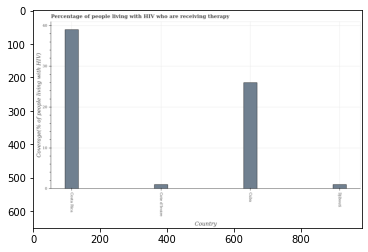

Number of QA =  22





,Country,Coverage(% of people living with HIV)
0,Costa Rica,39.444632
1,Cote d'Ivoire,1.206999
2,Cuba,26.396404
3,Djibouti,1.188085


> what is the title of the graph ?
PREDICTED =  Percentage of people living with HIV who are receiving therapy
EXPECTED =  Percentage of people living with HIV who are receiving therapy




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Coverage(% of people living with HIV)
EXPECTED =  Coverage(% of people living with HIV)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the antiretroviral therapy coverage in cuba and djibouti ?
PREDICTED =  25.208318931091924
EXPECTED =  25.0




				 4 / 4 = 1.0


> what is the median antiretroviral therapy coverage ?
PREDICTED =  None
EXPECTED =  13.5




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

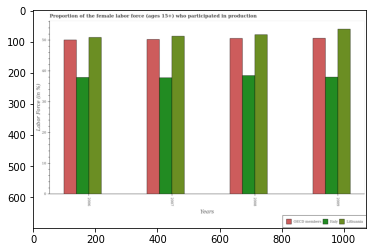

Number of QA =  29





,Years,OECD members,Lithuania,Italy
0,2009,50.600141,53.584942,38.071536
1,2007,50.315260,51.290326,37.803808
2,2008,50.485416,51.424208,38.615024
3,2006,49.865979,51.083898,37.804393


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in lithuania in 2008 and that in 2009 ?
PREDICTED =  -2.1607345592191294
EXPECTED =  -1.7999992370606037




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in italy in 2008 and the proportion of the female labor force who participated in production in oecd members in 2006?
PREDICTED =  0.8106311488674152
EXPECTED =  -11.5804492927031




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the propo

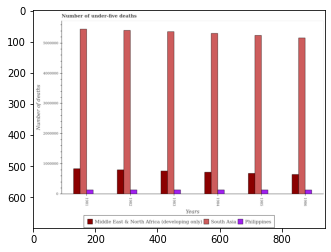

Number of QA =  29





,Years,Philippines,South Asia,Middle East & North Africa (developing only)
0,1982,156138.773104,5.456373e+06,825236.369196
1,1981,150329.455737,5.481360e+06,858411.887144
2,1986,152082.191083,5.180612e+06,663304.635909
3,1984,155755.008366,5.343687e+06,736711.910013
4,1985,154572.887147,5.273948e+06,701788.689698
5,1983,154969.863458,5.397459e+06,776880.124793


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in philippines in 1984 and that in 1985 ?
PREDICTED =  -1.0
EXPECTED =  925




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in middle east & north africa (developing only) in 1981 and the number of under-five deaths in south asia in 1982?
PREDICTED =  -1683647.2563397465
EXPECTED =  -4581405




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the number of under-five deaths in middle east & north africa (developing only) and number of under-five deaths in south asia ?
P

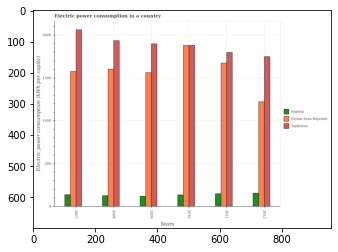

Number of QA =  29





,Years,Syrian Arab Republic,Tajikistan,Nigeria
0,2009,1576.478870,1900.969060,124.187918
1,2007,1566.352533,2071.177611,142.762323
2,2010,1883.859159,1885.829671,140.124727
3,2012,1232.694697,1735.493964,160.702042
4,2008,1604.783929,1937.008082,130.035874
5,2011,1670.571561,1799.260939,156.048047


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in tajikistan in 2010 and that in 2011 ?
PREDICTED =  86.56873208017691
EXPECTED =  81.60147525259003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in syrian arab republic in 2007 and the electric power consumption in in nigeria in 2008?
PREDICTED =  -38.431395769237724
EXPECTED =  1449.687052228849




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the electric power consumption in in nigeria and electric power consumption in in syrian arab republic ?
PREDICTED 

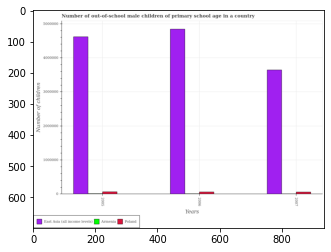

Number of QA =  29





,Years,East Asia (all income levels),Poland,Armenia
0,2005,4.637611e+06,82203.001152,NaN
1,2006,4.878779e+06,75112.139915,NaN
2,2007,3.663708e+06,76612.119017,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in poland in 2006 and that in 2007 ?
PREDICTED =  -1499.9791017807001
EXPECTED =  2284.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school male children in east asia (all income levels) in 2005 and the number of out-of-school male children in poland in 2006?
PREDICTED =  -241167.90210717265
EXPECTED =  4556950.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





>

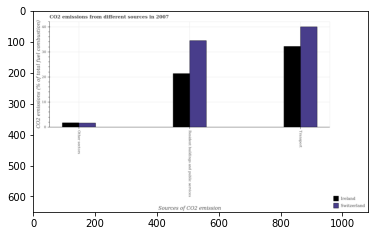

Number of QA =  28





,Sources of CO2 emission,Switzerland,Ireland
0,Transport,39.882366,32.687379
1,Other sectors,1.805540,1.891797
2,Resident buildings and public services,34.630261,21.598467


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in switzerland and the percentage of co2 emissions from other sectors in ireland?
PREDICTED =  39.882365563402466
EXPECTED =  38.29629547218676




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from resident buildings and public services and percentage of co2 emissions from transport in switzerland ?
PREDICTED =  -36.25631332660273
EXPECTED =  -5.513487931850499




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

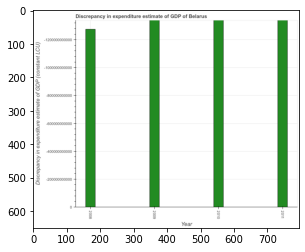

Number of QA =  12





,Year,Discrepancy in expenditure estimate of GDP (constant LCU)
0,2010,1.362207e+12
1,2008,1.279719e+12
2,2011,1.367011e+12
3,2009,1.355692e+12


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of Belarus
EXPECTED =  Discrepancy in expenditure estimate of GDP of Belarus




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  Discrepancy in expenditure estimate of GDP (constant LCU)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median discrepancy in expenditure estimate of gdp ?
PREDICTED =  1358949514256.832
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  200000000000.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_g

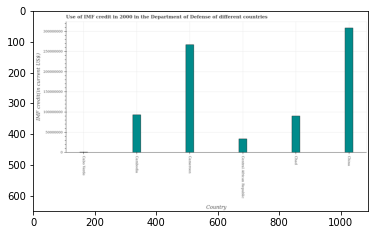

Number of QA =  22





,Country,IMF credit(in current US$)
0,Cameroon,2.712240e+08
1,China,3.120789e+08
2,Chad,9.271045e+07
3,Cambodia,9.532444e+07
4,Cabo Verde,NaN
5,Central African Republic,3.512329e+07


> what is the title of the graph ?
PREDICTED =  Use of IMF credit in 2000 in the Department of Defense of different countries
EXPECTED =  Use of IMF credit in 2000 in the Department of Defense of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  IMF credit(in current US$)
EXPECTED =  IMF credit(in current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the use of imf credit in dod in cambodia and central african republic ?
PREDICTED =  60201152.09578189
EXPECTED =  59740000.0




				 4 / 4 = 1.0


> what is the median use of imf credit in dod ?
PREDICTED =  None
EXPECTED =  91871500.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

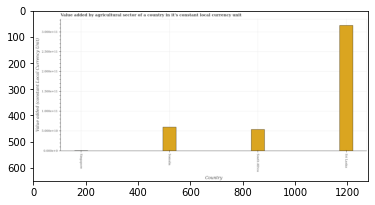

Number of QA =  22





,Country,Value added (constant Local Currency Unit)
0,Singapore,NaN
1,South Africa,0.558787
2,Somalia,0.619143
3,Sn Lanka,3.198033


> what is the title of the graph ?
PREDICTED =  Value added by agricultural sector of a country in it's constant local currency unit
EXPECTED =  Value added by agricultural sector of a country in it's constant local currency unit




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Value added (constant Local Currency Unit)
EXPECTED =  Value added (constant Local Currency Unit)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in somalia and south africa ?
PREDICTED =  0.06035570924954026
EXPECTED =  5921464924.0




				 3 / 4 = 0.75


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  56816266962.0




				 3 / 6 = 0.5


is_built_with_cuda:

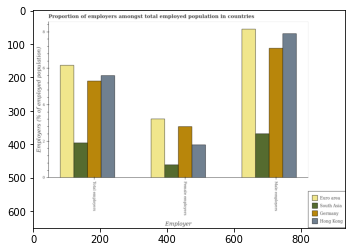

Number of QA =  28





,Employer,South Asia,Hong Kong,Germany,Euro area
0,Female employers,0.723817,1.835765,2.834215,3.263146
1,Male employers,2.428697,7.937615,7.159239,8.215757
2,Total employers,1.954477,5.646322,5.356022,6.232355


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male employers in hong kong and that in euro area ?
PREDICTED =  0.0
EXPECTED =  -0.24923007139422015




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female employers in hong kong to that in germany ?
PREDICTED =  0.6477154718102933
EXPECTED =  0.6428571367750355




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

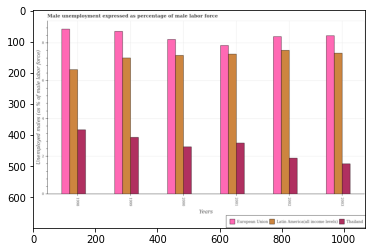

Number of QA =  29





,Years,European Union,Thailand,Latin America(all income levels)
0,1998,8.760905,3.431828,6.680749
1,2001,7.911355,2.714998,7.431975
2,1999,8.629479,3.028982,7.225372
3,2000,8.240068,2.529717,7.370430
4,2002,8.348254,1.924582,7.652533
5,2003,8.420398,1.630237,7.508164


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in latin america(all income levels) in 2000 and that in 2001 ?
PREDICTED =  -0.06154510566980331
EXPECTED =  -0.0675613668987225




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in european union in 2003 and the unemployment in males in in latin america(all income levels) in 2002?
PREDICTED =  0.07214419928083515
EXPECTED =  0.7747460770741492




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the unemployment in males in in latin america(all income levels) and unemployment i

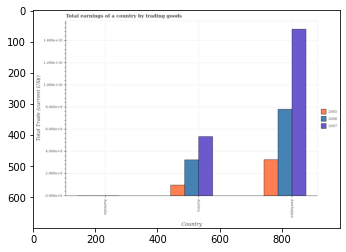

Number of QA =  25





,Country,2007,2005,2006
0,Australia,NaN,NaN,NaN
1,Austria,0.526620,0.100905,0.326882
2,Azerbaijan,1.486774,0.328932,0.776741


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2007 in austria and that in azerbaijan ?
PREDICTED =  -0.9601539343608122
EXPECTED =  -9688877245.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2007 in austria and the total earnings in 2006 in azerbaijan?
PREDICTED =  -0.9601539343608122
EXPECTED =  -2461055245.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings of/in 2006 and total earnings of/in 2005 in austria?
PREDICTED =  1.8990954560471818
EXPECTED =  2278111878.3




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availab

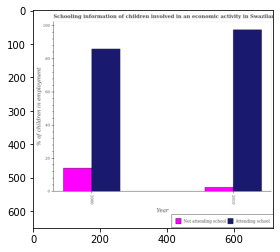

Number of QA =  24





,Year,Attending school,Not attending school
0,2000,86.393270,14.473499
1,2010,97.738875,2.846150


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are not attending school in 2000 and that in 2010 ?
PREDICTED =  11.627349471485132
EXPECTED =  11.58354766288017




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed children who are attending school in 2010 and the percentage of employed children who are not attending school in 2000?
PREDICTED =  11.345605388795661
EXPECTED =  11.583547662880207




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of employed children who are attending school and percentag

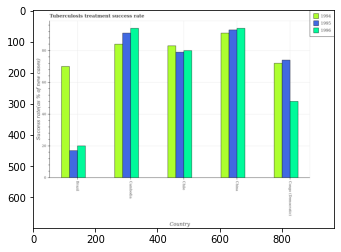

Number of QA =  29





,Country,1996,1995,1994
0,Chile,80.846237,79.182103,83.653259
1,Brazil,20.982289,17.501334,70.284727
2,Congo (Democratic),48.467142,75.001541,72.695346
3,Cambodia,94.617536,92.130607,84.512671
4,China,94.982090,93.676721,91.468734


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in 1994 in brazil and that in china ?
PREDICTED =  -21.184007214266416
EXPECTED =  -21.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in 1994 in china and the tuberculosis treatment success rate in 1996 in chile?
PREDICTED =  7.815475210290529
EXPECTED =  11.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate of/in 1996 and tuberculosis treatment success rate of/in 1995 in china?
PREDICTED =  1.3053687260340183
EXPECTED =  1.0


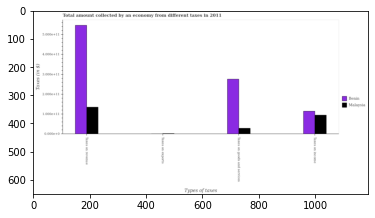

Number of QA =  29





,Types of taxes,Malaysia,Benin
0,Taxes on exports,0.050470,NaN
1,Taxes on income,0.989046,1.182473
2,Taxes on goods and services,0.316595,2.806132
3,Taxes on revenue,1.388912,5.541182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on goods in benin and the amount collected as tax on revenue in malaysia?
PREDICTED =  1.4172198884886955
EXPECTED =  140854790261




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on income and amount collected as tax on revenue in malaysia ?
PREDICTED =  -0.3998653177424172
EXPECTED =  -40046000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the 

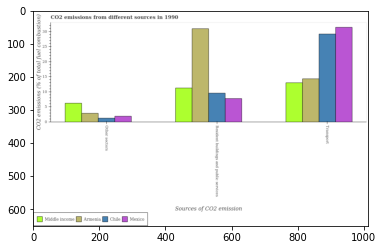

Number of QA =  28





,Sources of CO2 emission,Mexico,Armenia,Chile,Middle income
0,Other sectors,2.051468,3.050376,1.412165,6.397709
1,Transport,31.773968,14.744159,29.835760,13.294101
2,Resident buildings and public services,7.958418,31.588108,9.873041,11.579760


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in mexico and that in middle income ?
PREDICTED =  18.479867223942776
EXPECTED =  18.4063487134785




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from resident buildings and public services in middle income and the percentage of co2 emissions from transport in mexico?
PREDICTED =  -11.436930418722476
EXPECTED =  -20.1504050599143




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finis

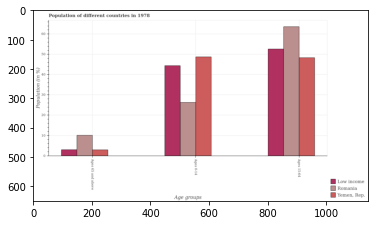

Number of QA =  28





,Age groups,Low income,"Yemen, Rep.",Romania
0,Ages 0-14,44.760593,49.091460,26.876512
1,Ages 65 and above,3.324235,3.283582,10.389833
2,Ages 15-64,53.127261,48.520681,64.264704


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 15-64 in romania and the percentage of population within the age-group of 65 and above in yemen, rep.?
PREDICTED =  15.7440232258555
EXPECTED =  60.692787260986094




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of population within the age-group 0-14 in low income to that in yemen, rep. ?
PREDICTED =  1.0
EXPECTED =  0.91106876

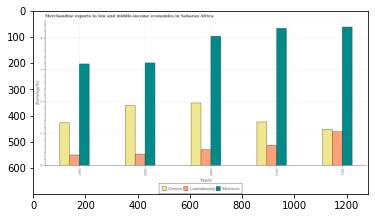

Number of QA =  29





,Years,Luxembourg,Greece,Morocco
0,2010,0.650333,1.389868,4.339953
1,2008,0.373461,1.903445,3.256003
2,2009,0.511525,1.986016,4.089836
3,2011,1.079716,1.153454,4.389693
4,2007,0.347370,1.365286,3.220545


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in greece in 2008 and that in 2011 ?
PREDICTED =  0.7499909707761372
EXPECTED =  0.7467557573602401




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in luxembourg in 2008 and the percentage of amount earned from merchandise exports in greece in 2011?
PREDICTED =  -0.7062558686015659
EXPECTED =  -0.7774743248194198




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of amount earned from merchandise exports 

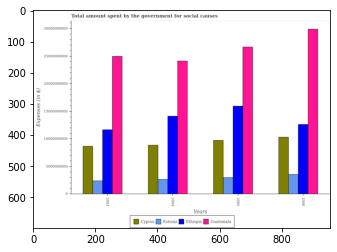

Number of QA =  30





,Years,Estonia,Cyprus,Ethiopia,Guatemala
0,2005,3.069666e+09,9.764522e+09,1.598969e+10,2.663496e+10
1,2003,2.476702e+09,8.716134e+09,1.177202e+10,2.493708e+10
2,2006,3.657670e+09,1.034034e+10,1.269549e+10,2.996689e+10
3,2004,2.747451e+09,8.883523e+09,1.424025e+10,2.399539e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in guatemala in 2003 and that in 2004 ?
PREDICTED =  941684724.4522934
EXPECTED =  839630000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in guatemala in 2003 and the amount spent for social causes by the government in estonia in 2004?
PREDICTED =  941684724.4522934
EXPECTED =  22311260000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount spent for social causes by the government in cyprus and amount spent fo

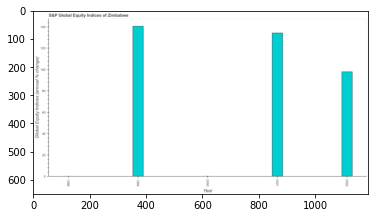

Number of QA =  21





,Year,Global Equity Indices (annual % change)
0,2000,NaN
1,1998,NaN
2,2001,135.715151
3,2002,99.310829
4,1999,142.073282


> what is the title of the graph ?
PREDICTED =  S&P Global Equity Indices of Zimbabwe
EXPECTED =  S&P Global Equity Indices of Zimbabwe




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Global Equity Indices (annual % change)
EXPECTED =  Global Equity Indices (annual % change)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the s&p global equity indices in 1999 and 2002 ?
PREDICTED =  42.7624534017574
EXPECTED =  42.66




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median s&p global equity indices ?
PREDICTED =  135.7151514801005
EXPECTED =  97.9400024414




				 4 / 5 = 0.8


is_built_with_cud

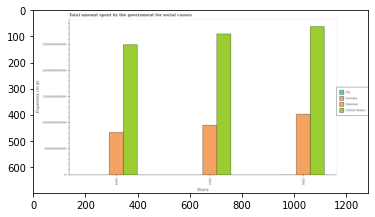

Number of QA =  30





,Years,Fiji,Georgia,Pakistan,United States
0,2004,NaN,NaN,8.146202e+11,2.503314e+12
1,2005,NaN,NaN,9.575370e+11,2.695868e+12
2,2006,NaN,NaN,1.172749e+12,2.850773e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in pakistan in 2004 and that in 2006 ?
PREDICTED =  -358128526350.3628
EXPECTED =  -348140000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount spent for social causes by the government in pakistan in 2004 to that in 2006?
PREDICTED =  0.6946246759538445
EXPECTED =  0.7004796420966597




				 2 / 4 = 0.5


is_built_with_cuda

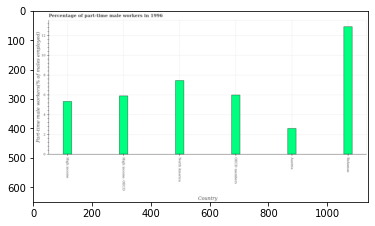

Number of QA =  22





,Country,Part-time male workers(% of males employed)
0,High income,5.392667
1,Austra,2.644045
2,North America,7.458120
3,OECD members,6.028787
4,High income: OECD,5.953748
5,Bahamas,12.934191


> what is the title of the graph ?
PREDICTED =  Percentage of part-time male workers in 1996
EXPECTED =  Percentage of part-time male workers in 1996




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Part-time male workers(% of males employed)
EXPECTED =  Part-time male workers(% of males employed)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time male workers in bahamas and high income ?
PREDICTED =  7.541523994146295
EXPECTED =  7.569




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time male workers ?
PREDICTED =  5.991267659856011
EXPEC

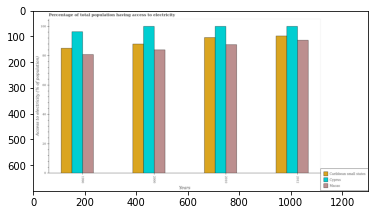

Number of QA =  29





,Years,Cyprus,Macao,Caribbean small states
0,2010,101.537623,89.037644,93.111301
1,1990,96.335510,81.721923,85.946265
2,2012,100.724445,91.523724,94.145669
3,2000,100.438176,84.761663,88.749947


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in cyprus in 2000 and that in 2012 ?
PREDICTED =  -0.2862688922263885
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of population that have access to electricity in cyprus in 1990 to that in 2010?
PREDICTED =  0.0
EXPECTED =  0.9636144




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available:

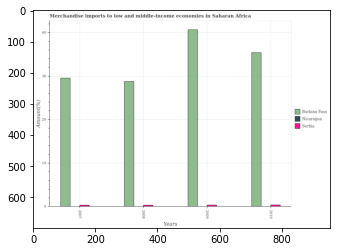

Number of QA =  29





,Years,Burkina Faso,Serbia,Nicaragua
0,2010,35.414668,0.490760,NaN
1,2008,28.875511,0.465025,NaN
2,2009,40.850972,0.456996,NaN
3,2007,29.673278,0.463652,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in serbia in 2008 and that in 2010 ?
PREDICTED =  -0.025734966298456396
EXPECTED =  -0.04886196388115799




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in burkina faso in 2007 and the percentage of amount earned from merchandise imports in nicaragua in 2009?
PREDICTED =  -11.177693997836183
EXPECTED =  29.51127631019781




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

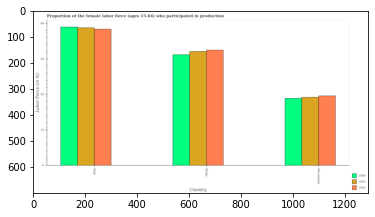

Number of QA =  29





,Country,1992,1990,1991
0,Malta,32.569806,31.036316,32.122047
1,Mauritania,19.719593,19.141616,19.161145
2,Mali,38.415927,38.984754,39.163922


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1992 in mali and that in mauritania ?
PREDICTED =  18.696334048628234
EXPECTED =  18.800001144409197




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1990 in mauritania and the proportion of the female labor force who participated in production in 1992 in malta?
PREDICTED =  -11.89470032193627
EXPECTED =  -13.600000381469702




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female

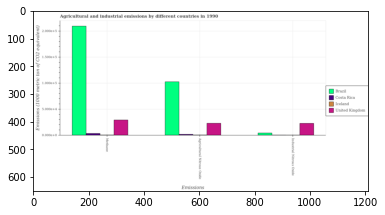

Number of QA =  28





,Emissions,Unnamed: 1,Iceland,United Kingdom,Costa Rica
0,Methane,2.105623,NaN,0.306721,0.044976
1,Industrial Nitrous Oxide,0.056516,NaN,0.240526,NaN
2,Agricultural Nitrous Oxide,1.045599,NaN,0.241629,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of industrial nitrous oxide emissions in costa rica and that in iceland ?
PREDICTED =  2.0
EXPECTED =  106.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of industrial nitrous oxide emissions in costa rica and the amount of agricultural nitrous oxide emissions in united kingdom?
PREDICTED =  1.5178455960813166
EXPECTED =  -22693.9




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emissions and amount of agricultural nitrous oxide emissions in united kingdom ?
PREDICTED =  0.06509280471506021
EXPECTED =

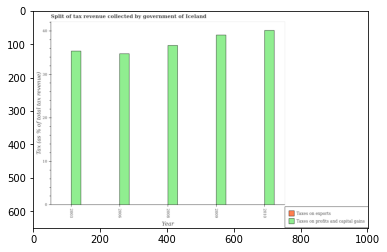

Number of QA =  28





,Year,Taxes on profits and capital gains,Taxes on exports
0,2006,34.690315,NaN
1,2008,36.705754,NaN
2,2009,38.990958,NaN
3,2003,35.327096,NaN
4,2010,40.034534,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capital gains in 2006 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  -5.357969506004302




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of revenue obtained from taxes on profits and capital gains and percentage of revenue obtained from taxes on exports ?
PREDICTED =  40.034533681805954
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

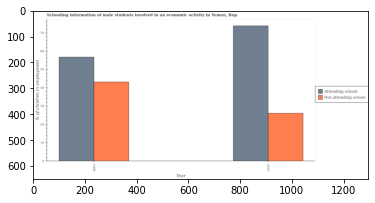

Number of QA =  24





,Year,Attending school,Not attending school
0,2010,74.769702,26.631576
1,1999,57.518182,43.670879


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are attending school in 1999 and that in 2010 ?
PREDICTED =  -17.25151994235204
EXPECTED =  -17.0817202307963




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are not attending school in 2010 and the percentage of employed males who are attending school in 1999?
PREDICTED =  -17.03930284919037
EXPECTED =  -17.0817202307963




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of employed males who are not attending school and percentage of employed

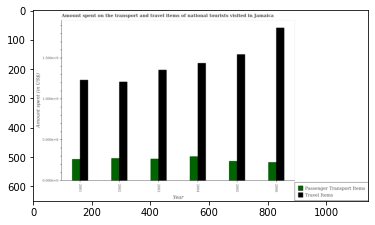

Number of QA =  28





,Year,Travel Items,Passenger Transport Items
0,2006,1.878546,0.232541
1,2001,NaN,0.266818
2,2005,NaN,0.248467
3,2003,1.347953,0.269945
4,2004,1.442018,0.300941
5,2002,1.218213,0.280858


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in 2003 and that in 2004 ?
PREDICTED =  -0.09406548306928819
EXPECTED =  -83000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2003 and the amount spent in travel items in 2001?
PREDICTED =  0.003127400958508164
EXPECTED =  4000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount spent on passenger transport items and amount spent in travel items ?
PREDICTED =  1.3670277759439502
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda

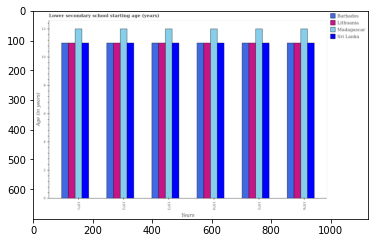

Number of QA =  30





,Years,Lithuania,Sri Lanka,Barbados,Madagascar
0,1976,11.140402,11.127398,11.173751,12.059833
1,1971,11.164000,11.187088,11.161060,12.122035
2,1973,11.128516,11.153172,11.142678,12.182736
3,1972,11.175198,11.182955,11.108923,12.150554
4,1975,11.127817,11.151396,11.108422,12.071228
5,1974,11.215406,11.086841,11.140839,12.161513


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in lithuania in 1973 and that in 1974 ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in barbados in 1975 and the lower secondary school starting age of children in lithuania in 1971?
PREDICTED =  -0.05263800667814955
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the lower secondary school starting age of children in sri lanka and lower secondary school starting age of child

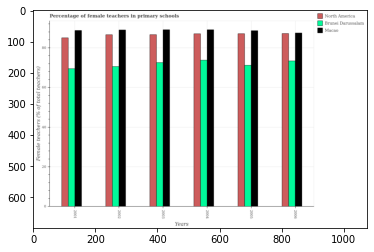

Number of QA =  29





,Years,North America,Brunei Darussalam,Macao
0,2004,88.091993,74.463876,89.842596
1,2006,87.491553,74.435819,88.150213
2,2002,87.621717,71.529327,NaN
3,2003,87.210925,73.592605,90.026634
4,2005,87.310690,72.198212,89.264664
5,2001,85.559600,70.072859,89.571917


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in brunei darussalam in 2003 and that in 2005 ?
PREDICTED =  1.3943928475134584
EXPECTED =  1.3556594848632955




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in macao in 2001 and the percentage of female teachers in north america in 2006?
PREDICTED =  2.080363861668303
EXPECTED =  1.540351867675696




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of female teachers in brunei darussalam and percentage of female teachers in north america ?
PREDICTED

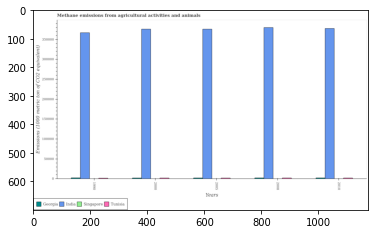

Number of QA =  30





,Years,Singapore,India,Tunisia,Georgia
0,1990,NaN,371447.736265,NaN,3777.853858
1,2000,NaN,381200.312096,NaN,NaN
2,2010,NaN,383036.595114,NaN,NaN
3,2008,NaN,386717.837535,NaN,NaN
4,2005,NaN,380061.957281,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in india in 2000 and the amount of methane emitted in georgia in 2005?
PREDICTED =  1138.3548150946735
EXPECTED =  373734.2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of methane emitted in tunisia in 1990 to that in 2000?
PREDICTED =  0.9744161389134818
EXPECTED =  0.8360956775590922




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available

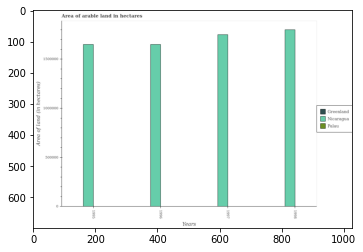

Number of QA =  29





,Years,Palau,Greenland,Nicaragua
0,1998,NaN,NaN,1.799188e+06
1,1996,NaN,NaN,1.652324e+06
2,1995,NaN,NaN,1.650241e+06
3,1997,NaN,NaN,1.756092e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the total arable land in nicaragua and total arable land in greenland ?
PREDICTED =  5205521.21828538
EXPECTED =  1649400.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs

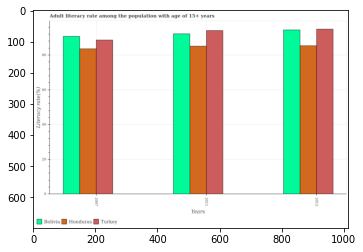

Number of QA =  29





,Years,Turkey,Bolivia,Honduras
0,2007,88.609226,90.531253,83.622103
1,2011,94.693602,91.874279,85.301076
2,2012,94.955436,94.277331,85.645410


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adult literacy rate in bolivia in 2011 and that in 2012 ?
PREDICTED =  -2.403051931613575
EXPECTED =  -2.234420776367216




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adult literacy rate in honduras in 2007 and the adult literacy rate in bolivia in 2012?
PREDICTED =  -2.0233067700026908
EXPECTED =  -10.871566772461009




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the adult literacy rate in honduras and adult literacy rate in bolivia ?
PREDICTED =  -191.03745308293816
EXPECTED =  -7.15447235107429




				 0 / 3 = 0.0

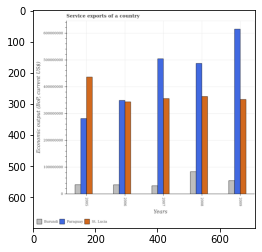

Number of QA =  29





,Years,Burundi,St. Lucia,Paraguay
0,2006,3.568078e+07,3.454574e+08,3.520752e+08
1,2008,8.465949e+07,3.649178e+08,4.899920e+08
2,2009,5.181855e+07,3.551876e+08,6.172944e+08
3,2007,3.213576e+07,3.579594e+08,5.046777e+08
4,2005,3.671538e+07,4.369093e+08,2.832851e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in st. lucia in 2005 and that in 2006 ?
PREDICTED =  91451891.44906348
EXPECTED =  92582977.79999995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in paraguay in 2008 and the service exports in st. lucia in 2007?
PREDICTED =  -14685708.690510213
EXPECTED =  131128518.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the service exports in st. lucia and service exports in paraguay ?
PREDICTED =  410280409.2014158
EXPECTED =  -148288011.09999996




				 1 / 3 = 0.3333


is_built_with_cuda

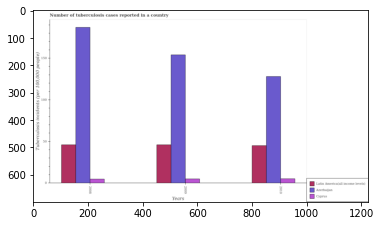

Number of QA =  29





,Years,Azerbaijan,Cyprus,Latin America(all income levels)
0,2009,154.426658,5.652598,46.599006
1,2008,186.029070,5.282974,47.119797
2,2010,128.331162,5.780311,45.273082


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in azerbaijan in 2009 and that in 2010 ?
PREDICTED =  26.09549515602427
EXPECTED =  26




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in latin america(all income levels) in 2008 and the number of tuberculosis cases reported in in cyprus in 2010?
PREDICTED =  1.8467153933261287
EXPECTED =  40.8




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of tuberculosis cases reported in in azerbaijan and number of tuberculosis cases reported

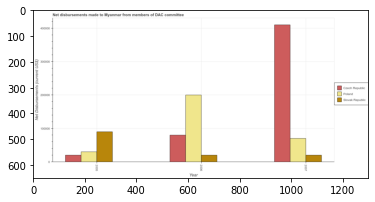

Number of QA =  29





,Year,Czech Republic,Poland,Slovak Republic
0,2006,81961.783455,202562.198295,21424.468996
1,2005,21368.337245,31878.015498,92028.124819
2,2007,411408.775553,71111.912768,21529.030921


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by slovak republic in 2005 and that in 2007 ?
PREDICTED =  70499.09389804334
EXPECTED =  70000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by slovak republic in 2007 and the net disbursements made by poland in 2006?
PREDICTED =  104.5619244284353
EXPECTED =  0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net disbursements made by czech re

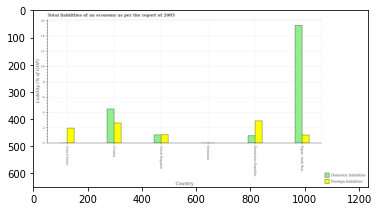

Number of QA =  25





,Country,Foreign liabilities,Domestic liabilities
0,Dominica,NaN,NaN
1,Cote d'Ivoire,2.019801,NaN
2,"Egypt, Arab Rep.",1.092084,15.643937
3,Dominican Republic,2.954839,1.029745
4,Czech Republic,1.152525,1.130624
5,Croatia,2.668041,4.515029


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of domestic liabilities in czech republic and that in egypt, arab rep. ?
PREDICTED =  -14.51331231741118
EXPECTED =  -14.35329230318203




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities in cote d'ivoire and the incurrence of domestic liabilities in czech republic?
PREDICTED =  0.8672758312822821
EXPECTED =  0.8840161916676998




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of domestic liabilities and incurrence of foreign liabilities in croatia ?
PREDICTED =  -3.5150287367834583
EX

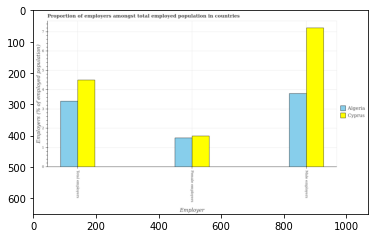

Number of QA =  28





,Employer,Algeria,Cyprus
0,Total employers,3.447880,4.556443
1,Male employers,3.849633,7.243379
2,Female employers,1.536070,1.625282


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female employers in cyprus and that in algeria ?
PREDICTED =  0.08921194602609006
EXPECTED =  0.10000002384185991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of male employers in algeria to that in cyprus ?
PREDICTED =  0.5314691968953948
EXPECTED =  0.5277777851363753




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Traini

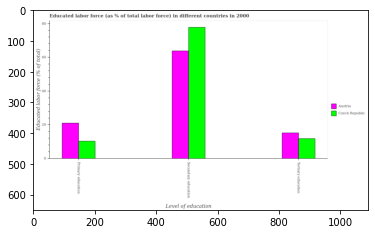

Number of QA =  28





,Level of education,Austria,Czech Republic
0,Tertiary education,15.656930,12.249643
1,Secondary education,64.972346,78.763681
2,Primary education,21.666894,10.749297


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received primary education in czech republic and that in austria ?
PREDICTED =  0.0
EXPECTED =  -10.6999998092651




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in austria and the percentage of labor force who received primary education in czech republic?
PREDICTED =  -7.34201004077368
EXPECTED =  4.899999618530199




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education and percentage of labor forc

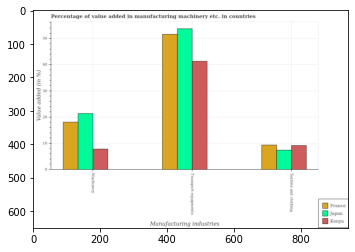

Number of QA =  28





,Manufacturing industries,Japan,Kenya,France
0,Machinery,21.630814,8.007844,18.307830
1,Transport equipments,54.057111,41.478120,51.799560
2,Textiles and clothing,7.627035,9.370733,9.578034


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing machinery in kenya and that in japan ?
PREDICTED =  -13.622969696892701
EXPECTED =  -13.546916790930482




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing transport equipments in kenya and the value added in manufacturing machinery in japan?
PREDICTED =  -12.578990558356992
EXPECTED =  19.945450626591402




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing transport equipments and value added in manufacturing textile and clothing in france ?
PREDICTED =  -8

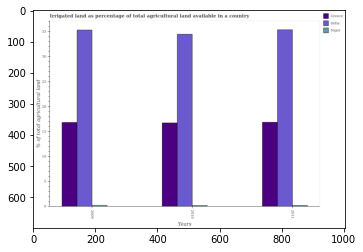

Number of QA =  29





,Years,Greece,India,Niger
0,2011,17.104075,35.534091,NaN
1,2010,17.030743,34.600424,NaN
2,2009,17.070848,35.595331,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land in niger in 2010 and that in 2011 ?
PREDICTED =  nan
EXPECTED =  -0.018793984028246002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land in niger in 2011 and the percentage of irrigated land in greece in 2009?
PREDICTED =  nan
EXPECTED =  -16.618812383892354




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of irrigated land in greece and percentage of irrigated land in niger ?
PREDICTED =  nan
EXPECTED =  16.655609658982453




				 0 / 3 = 0.0


is_bu

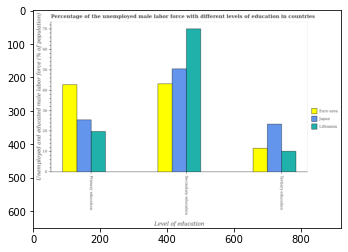

Number of QA =  28





,Level of education,Japan,Lithuania,Euro area
0,Tertiary education,23.607249,10.318254,11.744299
1,Primary education,25.797215,20.148737,42.771460
2,Secondary education,50.668446,70.418444,43.443317


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in euro area and that in lithuania ?
PREDICTED =  0.0
EXPECTED =  1.4537398856266002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in euro area and the percentage of male labor force who received primary education in japan?
PREDICTED =  -31.027161291505205
EXPECTED =  -13.9462597329037




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluati

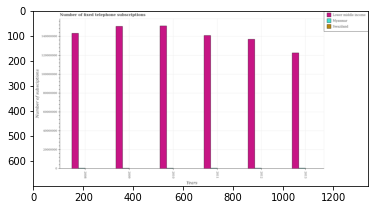

Number of QA =  29





,Years,Myanmar,Swaziland,Lower middle income
0,2008,NaN,NaN,1.421781e+08
1,2011,NaN,NaN,1.396928e+08
2,2013,NaN,NaN,1.215961e+08
3,2012,NaN,NaN,1.357427e+08
4,2009,NaN,NaN,1.490072e+08
5,2010,NaN,NaN,1.498317e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in lower middle income in 2011 and that in 2012 ?
PREDICTED =  3950082.4885923266
EXPECTED =  4016788.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in swaziland in 2012 and the number of fixed telephone subscriptions in myanmar in 2013?
PREDICTED =  0.0
EXPECTED =  -489245.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of fixed telephone subscriptions in lower middle income and number of fixed telephone subscriptions in swaz

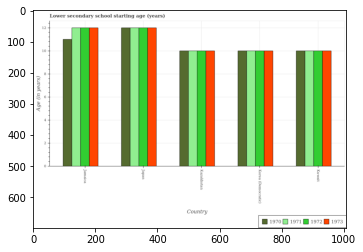

Number of QA =  30





,Country,1972,1971,1970,1973
0,Japan,12.064513,12.061310,12.067744,12.081225
1,Ku wait,10.088402,NaN,10.044855,10.098319
2,Korea (Democratic),10.070902,10.066267,10.070863,10.063177
3,Jamaica,12.047862,12.043274,11.069923,12.063812
4,Kazakhstan,10.039568,NaN,10.078299,10.096756


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in 1972 in kuwait and the lower secondary school starting age of children in 1970 in jamaica?
PREDICTED =  -2.008294431435205
EXPECTED =  -1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children of/in 1972 and lower secondary school starting age of children of/in 1970 in korea (democratic)?
PREDICTED =  -0.0312956193664391
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

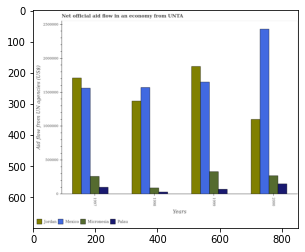

Number of QA =  30





,Years,Palau,Micronesia,Mexico,Jordan
0,1998,35360.543263,96092.565682,1.593162e+06,1.375587e+06
1,1997,105615.013092,267346.485352,1.568136e+06,1.715589e+06
2,2000,155489.879822,274710.026746,2.445840e+06,1.106865e+06
3,1999,76969.388851,336227.944633,1.655389e+06,1.881416e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in palau in 1998 and that in 1999 ?
PREDICTED =  -41608.845587598655
EXPECTED =  -40000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in palau in 1998 and the net official aid flow in micronesia in 1997?
PREDICTED =  -70254.46982853183
EXPECTED =  -230000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the net official aid flow in mexico and net official aid flow in micronesia ?
PREDICTED =  7018933.098324213
EXPECTED =  1300000.0




				 1 / 3 = 0.3333


is_built_with_c

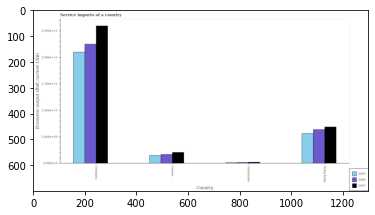

Number of QA =  29





,Country,2007,2005,2006
0,Greece,0.216756,0.158631,0.177341
1,Guatemala,0.030927,NaN,NaN
2,Hong Kong,0.692841,0.574671,0.648587
3,Germany,2.589701,2.097941,2.247362


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service imports in 2007 in greece and that in hong kong ?
PREDICTED =  -0.476084804579868
EXPECTED =  -48116418826.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service imports in 2006 in germany and the service imports in 2007 in guatemala?
PREDICTED =  2.2473622671959115
EXPECTED =  222933800000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the service imports in 2007 in greece to that i

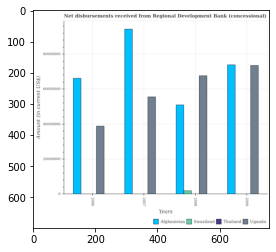

Number of QA =  27





,Years,Thailand,Uganda,Swaziland,Afghanistan
0,2008,NaN,6.803763e+07,2.154515e+06,5.139243e+07
1,2006,NaN,3.924255e+07,NaN,6.678163e+07
2,2009,NaN,7.369694e+07,NaN,7.413265e+07
3,2007,NaN,5.590938e+07,NaN,9.521631e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in afghanistan in 2007 and that in 2009 ?
PREDICTED =  21083661.407472953
EXPECTED =  20413000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in thailand in 2007 and the amount of disbursements received from regional development bank in uganda in 2006?
PREDICTED =  16666825.742543384
EXPECTED =  -38807000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount of disbursements received fro

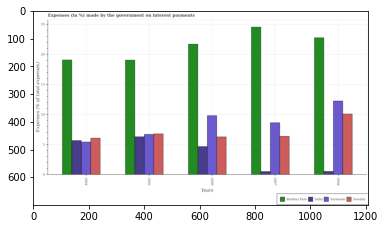

Number of QA =  30





,Years,Sweden,India,Burkina Faso,Suriname
0,2008,10.153845,0.608105,22.857114,12.241327
1,2005,6.902379,6.347790,19.128684,6.734536
2,2006,6.305207,4.752433,21.742976,9.888254
3,2004,6.119563,5.692659,19.150368,5.462755
4,2007,6.472610,0.591948,24.589884,8.680697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on interest payments in suriname in 2004 and that in 2005 ?
PREDICTED =  -1.2717810601718034
EXPECTED =  -1.2780356903657992




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on interest payments in burkina faso in 2008 and the percentage of expenses made by the government on interest payments in india in 2004?
PREDICTED =  3.7067464242632724
EXPECTED =  17.118271804840454




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percenta

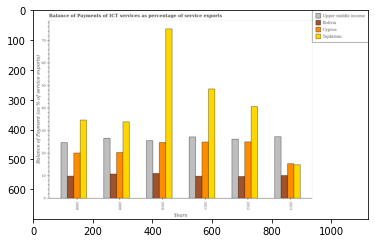

Number of QA =  30





,Years,Bolivia,Tajikistan,Cyprus,Upper middle income
0,2009,11.111595,34.155865,20.582428,26.905850
1,2008,10.110867,35.104616,20.372708,25.073711
2,2012,10.024184,41.224389,25.277433,26.555863
3,2013,10.392182,15.055525,15.675488,27.681535
4,2011,10.111639,48.834342,25.293357,27.659279
5,2010,11.308613,75.278740,24.930732,25.948776


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in bolivia in 2010 and that in 2011 ?
PREDICTED =  1.196974226320643
EXPECTED =  1.2369969440667106




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in upper middle income in 2008 and the balance of payments of ict services in bolivia in 2009?
PREDICTED =  -1.8321393516913744
EXPECTED =  13.93904311603561




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the balance of payments of ict services in bolivia and balance of payments of ict services in cyprus

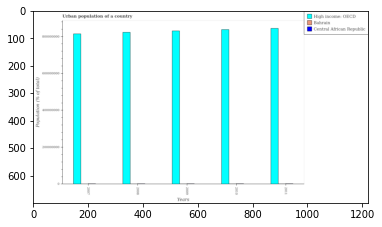

Number of QA =  29





,Years,Central African Republic,High income: OECD,Bahrain
0,2007,NaN,8.197815e+08,NaN
1,2011,NaN,8.519047e+08,NaN
2,2010,NaN,8.465151e+08,NaN
3,2009,NaN,8.381498e+08,NaN
4,2008,NaN,8.302022e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in central african republic in 2007 and that in 2011 ?
PREDICTED =  -851904718.340429
EXPECTED =  -158431




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the urban population in bahrain and urban population in high income: oecd ?
PREDICTED =  0.0
EXPECTED =  -836451336




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the urban population in bahrain in 2008 to that in 

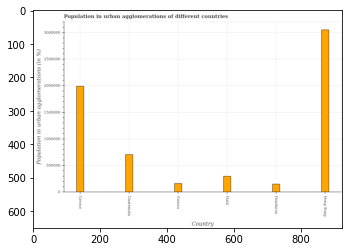

Number of QA =  22





,Country,Population in urban agglomerations (in %)
0,Guatemala,7.155435e+05
1,Hong Kong,3.086802e+06
2,Guinea,1.712523e+05
3,Greece,2.011715e+06
4,Honduras,1.618336e+05
5,Haiti,3.096143e+05


> what is the title of the graph ?
PREDICTED =  Population in urban agglomerations of different countries
EXPECTED =  Population in urban agglomerations of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population in urban agglomerations (in %)
EXPECTED =  Population in urban agglomerations (in %)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in haiti ?
PREDICTED =  51602.37756083976
EXPECTED =  297961




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum population in urban agglomerations ?
PREDICTED =  514467.02804774395
EX

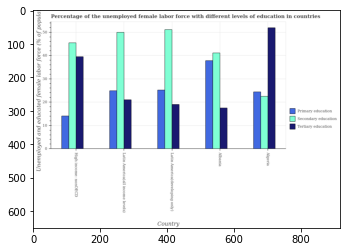

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN
2,High income: nonOECD,45.965693,40.072474,14.431844
3,Latin America(all income levels),50.621153,21.496876,25.459776
4,Latin America(developing only),51.802678,19.617179,25.569243


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in algeria and that in latin america(all income levels) ?
PREDICTED =  -50.62115322610876
EXPECTED =  -27.443634730901778




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female labor force who received secondary education in algeria to that in latin america(developing only) ?
PREDICTED =  0.954838177767592

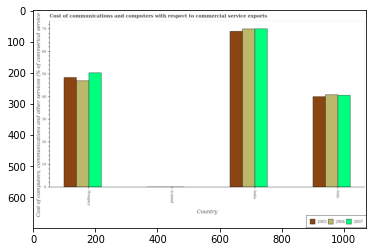

Number of QA =  25





,Country,2007,2005,2006
0,Italy,40.518317,39.884251,40.989322
1,Iceland,NaN,NaN,NaN
2,India,69.723348,68.507178,69.737376
3,Hungary,50.226445,48.446919,46.923337


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2006 in hungary and that in india ?
PREDICTED =  -76.77646245178245
EXPECTED =  -22.952609310919506




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2007 in iceland and the cost of communications and computers in 2005 in hungary?
PREDICTED =  -10.342193516754854
EXPECTED =  -48.455540123456




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers of/in 2006 and cost of communications and computers of/in 2007 in india?
PREDICTED =

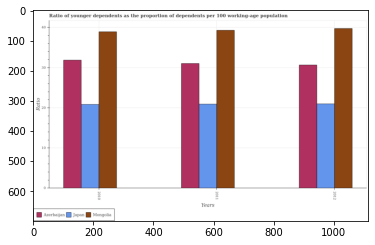

Number of QA =  29





,Years,Japan,Azerbaijan,Mongolia
0,2010,20.807955,31.852037,38.772405
1,2012,21.248723,30.656755,39.639678
2,2011,21.185688,30.894067,39.160359


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in azerbaijan in 2011 ?
PREDICTED =  10.298022473413162
EXPECTED =  31.0265619164727




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio(young) in japan ?
PREDICTED =  670.6666666666666
EXPECTED =  20.982165080514




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio(young) in mongolia ?
PREDICTED =  670.0
EXPECTED =  38.9314798032452




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in

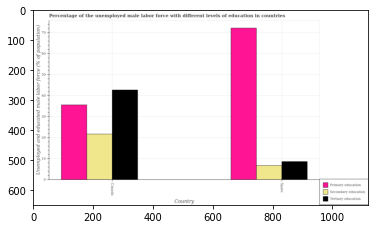

Number of QA =  25





,Country,Secondary education,Tertiary education,Primary education
0,NaN,7.025113,NaN,72.128377
1,Canada,21.714525,42.728194,35.696717


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received primary education in canada and that in spain ?
PREDICTED =  -36.43165991504614
EXPECTED =  -36.5999984741211




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received tertiary education in canada and the percentage of male labor force who received secondary education in spain?
PREDICTED =  0.0
EXPECTED =  36.000000953674366




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

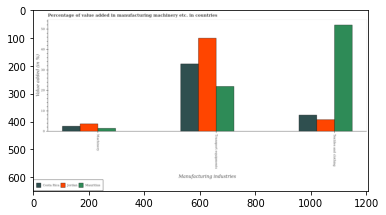

Number of QA =  28





,Manufacturing industries,Mauritius,Costa Rica,Jordan
0,Textiles and clothing,52.214724,8.168612,5.951069
1,Transport equipments,22.346638,33.249438,45.935350
2,Machinery,1.627609,2.705117,3.829549


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing textile and clothing in jordan and that in mauritius ?
PREDICTED =  -3.9510691611964015
EXPECTED =  -46.31102218564987




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing transport equipments in mauritius and the value added in manufacturing machinery in jordan?
PREDICTED =  -23.588711476701548
EXPECTED =  18.300782708192962




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing machinery and value added in manufacturing transport equipments in mauritius ?
PRE

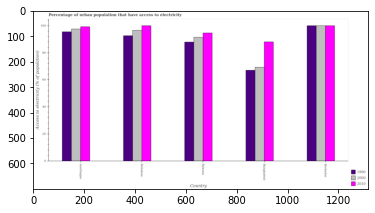

Number of QA =  29





,Country,2000,1990,2010
0,Bahamas,96.760384,92.962492,100.266818
1,Bahrain,91.766201,88.253604,94.843878
2,Bangladesh,69.510728,67.197653,88.466206
3,Barbados,99.911615,99.532433,100.178711
4,Azerbaijan,97.943248,95.728945,99.725175


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that have access to electricity in 2000 in azerbaijan and that in bangladesh ?
PREDICTED =  28.43252034563639
EXPECTED =  28.29121180085241




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population that have access to electricity in 2010 in bangladesh and the percentage of urban population that have access to electricity in 1990 in bahamas?
PREDICTED =  -8.294177993512534
EXPECTED =  -4.544582879600526




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population tha

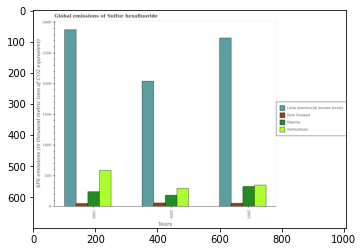

Number of QA =  30





,Years,Switzerland,New Zealand,Nigeria,Latin America(all income levels)
0,2005,352.004989,62.882869,335.379106,2741.719770
1,2000,299.515070,66.720323,191.936841,2043.861931
2,1990,594.515180,58.466898,249.790375,2885.688436


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of sulfur hexafluoride in new zealand in 2000 and that in 2005 ?
PREDICTED =  3.83745395846433
EXPECTED =  5.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global emissions of sulfur hexafluoride in nigeria in 2005 and the global emissions of sulfur hexafluoride in new zealand in 1990?
PREDICTED =  85.58873022355985
EXPECTED =  277.20000000000005




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the global emissions of sulfur hexafluoride in nigeria and global emissions of sulfur hexafluoride in latin a

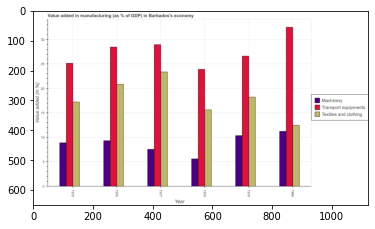

Number of QA =  29





,Year,Transport equipments,Machinery,Textiles and clothing
0,1979,26.891913,10.575207,18.508069
1,1977,29.092273,7.724958,23.643498
2,1978,24.167663,5.783648,15.793658
3,1976,28.687691,9.505332,21.100016
4,1980,32.868257,11.400364,12.656454
5,1975,25.345175,9.080456,17.456960


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing transport equipments in 1976 and that in 1978 ?
PREDICTED =  4.520028076326497
EXPECTED =  4.552688899627




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing transport equipments in 1980 and the value added in manufacturing textile and clothing in 1975?
PREDICTED =  7.523082161127228
EXPECTED =  7.366663555399104




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1979, what is the difference between the value added in manufacturing transport equipments and value added in manufacturing textile and clothing ?

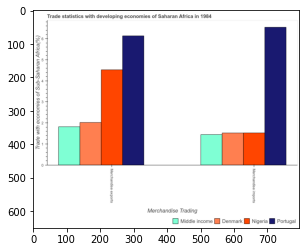

Number of QA =  23





,Merchandise Trading,Portugal,Nigeria,Middle income,Denmark
0,Merchandise exports,6.094069,4.546659,1.847073,2.050980
1,Merchandise imports,6.557220,1.544164,1.473459,1.549476


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in portugal and the merchandise imports in middle income?
PREDICTED =  6.094069298271832
EXPECTED =  4.692316620913386




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise imports in portugal to that in denmark ?
PREDICTED =  4.231894885277367
EXPECTED =  4.301236219377014




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks o

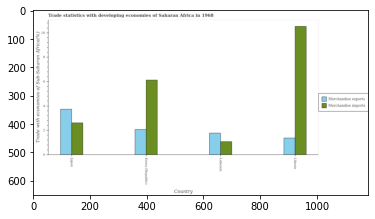

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Japan,2.689813,3.806034
1,Korea (Republic),6.227751,2.122742
2,Liberia,10.627839,1.423863
3,Lebanon,1.123922,1.832863


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in korea (republic) and that in liberia ?
PREDICTED =  -4.400088379016548
EXPECTED =  -4.406460813207717




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in japan and the merchandise exports in liberia?
PREDICTED =  -7.938026256718246
EXPECTED =  1.24716469021689




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports and merchandise exports in liberia ?
PREDICTED =  9.203975691372147
EXPECTED =  9.1661459484009




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: Fals

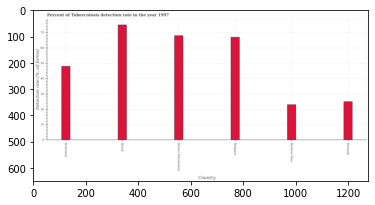

Number of QA =  22





,Country,"Detection rate (%, all forms)"
0,Brazil,74.314955
1,Brunei Darussalam,67.533624
2,Botswana,47.667145
3,Burkina Faso,23.179806
4,Burundi,24.995224
5,Bulgaria,66.697608


> what is the title of the graph ?
PREDICTED =  Percent of Tuberculosis detection rate in the year 1997
EXPECTED =  Percent of Tuberculosis detection rate in the year 1997




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Detection rate (%, all forms)
EXPECTED =  Detection rate (%, all forms)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the detection rate of tuberculosis in brazil and brunei darussalam ?
PREDICTED =  6.781330664823884
EXPECTED =  7.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median detection rate of tuberculosis ?
PREDICTED =  57.18237634717554
EXPECTED =  57.5





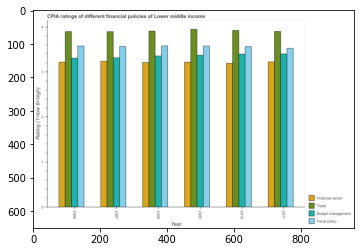

Number of QA =  30





,Year,Trade,Budget management,Financial sector,Fiscal policy
0,2010,4.004861,3.410112,3.227292,3.610075
1,2008,3.946801,3.403140,3.211097,3.618607
2,2007,4.020509,3.359254,3.279163,3.592621
3,2011,3.927316,3.441682,3.269216,3.549946
4,2009,3.961108,3.408794,3.258622,3.607480
5,2006,3.996246,3.354658,3.265375,3.612813


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of financial sector in 2006 and that in 2009 ?
PREDICTED =  0.00675215197557133
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of fiscal policy in 2009 and the cpia rating of budget management in 2011?
PREDICTED =  0.05753310430224223
EXPECTED =  0.05192307692308029




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating of budget management in 2007

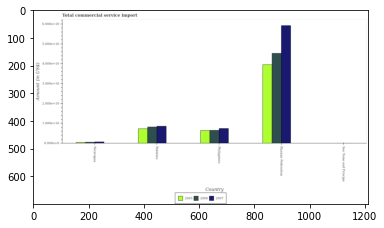

Number of QA =  29





,Country,2007,2005,2006
0,Russian Federation,5.909879,3.961268,4.550240
1,Sao Tome and Principe,NaN,NaN,NaN
2,Philippines,0.762479,0.651634,0.669379
3,Pakistan,0.868110,0.747137,0.837693
4,Nicaragua,0.092667,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total commercial service import in 2006 in russian federation ?
PREDICTED =  0.9100480856700575
EXPECTED =  45236757300.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in 2005 in nicaragua and that in philippines ?
PREDICTED =  -0.6516339878794102
EXPECTED =  -5971720577.26




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in 2006 in sao tome and principe and the total commercial service import in 2007 in nicaragua?
PREDICTED =  0.0
EXPECTED =  -644384891.2175936




				 0 / 3 = 0.0


is_built

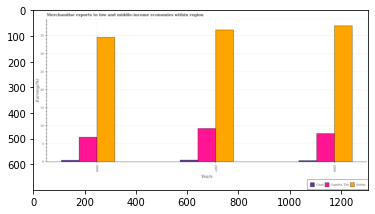

Number of QA =  29





,Years,Chad,"Gambia, The",Serbia
0,2008,0.509998,7.913343,37.416314
1,2006,0.561688,6.897471,34.137094
2,2007,0.624160,9.239672,36.180122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in chad in 2006 and that in 2007 ?
PREDICTED =  -0.06247271071433491
EXPECTED =  -0.042672530683926846




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in chad in 2007 and the percentage of amount earned from merchandise exports in serbia in 2006?
PREDICTED =  -33.51293361222757
EXPECTED =  -34.039402289929896




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of amount earned from merchandise exports in s

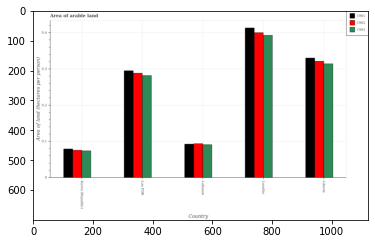

Number of QA =  29





,Country,1963,1962,1961
0,Lesotho,0.393684,0.398740,0.412119
1,Liberia,0.314362,0.321395,0.329868
2,Lao PDR,0.282472,0.288110,0.295604
3,Korea (Republic),0.075069,0.076758,0.080226
4,Lebanon,0.091483,0.095517,0.094249


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in 1961 in lesotho and that in liberia ?
PREDICTED =  0.08225095611871575
EXPECTED =  0.08311318923416999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in 1962 in lebanon and the total arable land in 1963 in lesotho?
PREDICTED =  -0.3032228354172033
EXPECTED =  -0.2994530275066724




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land of/in 1962 and total arable land of/in 1961 in korea (republic)?
PREDICTED =  1.100293519832618
EXPECTED =  -0.003544258480900092




				 2 / 3 = 0.6667


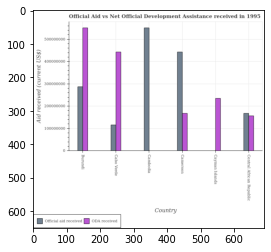

Number of QA =  25





,Country,Official aid received,ODA received
0,Cambodia,5.569803e+08,NaN
1,Cayman Islands,NaN,2.413495e+08
2,Burundi,2.910046e+08,5.575023e+08
3,Cabo Verde,1.188019e+08,4.488887e+08
4,Cameroon,4.486385e+08,1.714778e+08
5,Central African Republic,1.710775e+08,1.599985e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in burundi and that in cameroon ?
PREDICTED =  386024490.6618103
EXPECTED =  383220000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in cayman islands and the official aid received in cabo verde?
PREDICTED =  -207539180.3278878
EXPECTED =  119290000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the official aid received in cabo verde to that in cambodia ?
PREDICTED

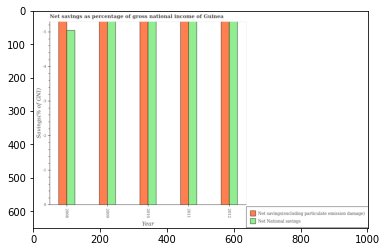

Number of QA =  15





,Year,Net National savings,Net savings(excluding particulate emission damage)
0,2010,48.237101,48.630533
1,2008,45.781825,48.595993
2,2009,47.930933,48.350615
3,2012,47.901806,48.263354
4,2011,48.089253,48.168484


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings(excluding particulate emission damage) in 2008 and the net national savings in 2012?
PREDICTED =  0.3326394527297438
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Savings(% of GNI)
EXPECTED =  1.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Net savings as percentage of gross national income of Guinea
EXPECTED =  Net savings as percentage of gross national income of Guinea




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Savings(% of GNI)
EXPECTED =  Savings(% of GNI)




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predict

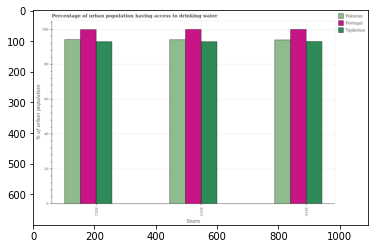

Number of QA =  29





,Years,Portugal,Tajikistan,Pakistan
0,2012,100.763284,93.859976,94.776747
1,2013,101.213781,93.705796,94.656064
2,2014,100.882799,93.970218,94.639299


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in portugal in 2012 and that in 2013 ?
PREDICTED =  -0.45049653449930815
EXPECTED =  -0.09999999999999432




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in tajikistan in 2014 and the percentage of urban population having access to drinking water in portugal in 2012?
PREDICTED =  0.11024277231956603
EXPECTED =  -6.800000000000011




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of ur

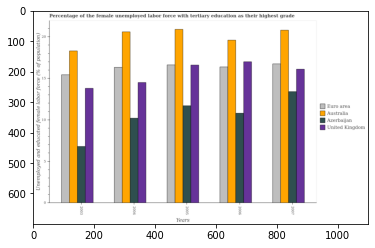

Number of QA =  30





,Years,United Kingdom,Australia,Azerbaijan,Euro area
0,2005,16.691052,20.942870,11.771758,16.724109
1,2006,17.113923,19.605230,10.845368,16.382982
2,2003,13.865026,18.343077,6.884594,15.478141
3,2007,16.086698,20.797194,13.473562,16.816661
4,2004,14.590835,20.551133,10.196532,16.356742


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with tertiary education in azerbaijan in 2003 and that in 2005 ?
PREDICTED =  -4.887164480501106
EXPECTED =  -4.899999618530239




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with tertiary education in euro area in 2005 and the percentage of the unemployed female labor force with tertiary education in united kingdom in 2003?
PREDICTED =  2.85908380767723
EXPECTED =  2.8182081784455004




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference b

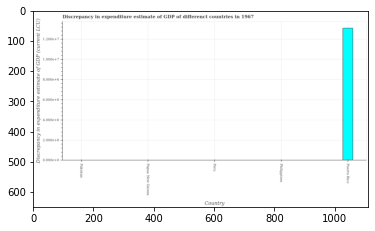

Number of QA =  17





,Country,"Discrepancy in expenditure estimate of GDP (current LCU,"
0,Peru,NaN
1,Pakistan,NaN
2,Philippines,NaN
3,Puerto Rico,1.314132
4,Papua New Guinea,NaN


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of differenct countries in 1967
EXPECTED =  Discrepancy in expenditure estimate of GDP of differenct countries in 1967




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (current LCU,
EXPECTED =  Discrepancy in expenditure estimate of GDP (current LCU)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in peru and puerto rico ?
PREDICTED =  -1.314132072207268
EXPECTED =  -13099871.9




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.




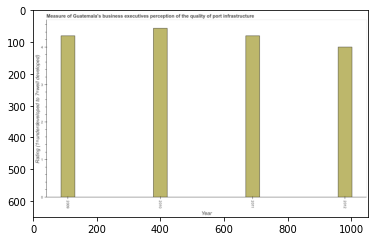

Number of QA =  23





,Year,Rating (1=underdeveloped to 7=well developed)
0,2010,4.516968
1,2012,4.002691
2,2011,4.310159
3,2009,4.298274


> what is the title of the graph ?
PREDICTED =  Measure of Guatemala's business executives perception of the quality of port infrastructure
EXPECTED =  Measure of Guatemala's business executives perception of the quality of port infrastructure




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Rating (1=underdeveloped to 7=well developed)
EXPECTED =  Rating (1=underdeveloped to 7=well developed) 




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring quality of port infrastructure in 2009 and 2011 ?
PREDICTED =  -0.011884944700748079
EXPECTED =  -0.0




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.



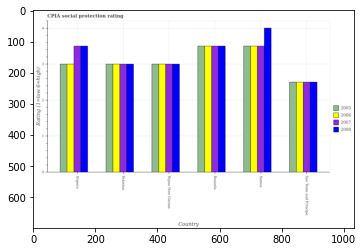

Number of QA =  30





,Country,2007,2005,2008,2006
0,Sao Tome and Principe,2.517264,2.522798,2.526428,2.518817
1,Samoa,3.524372,3.523425,4.043947,3.549115
2,Pakistan,3.035723,3.024493,2.998329,3.033603
3,Papua New Guinea,3.025147,3.018168,3.029264,3.029330
4,Nigeria,3.552626,3.036417,3.532423,3.032264
5,Rwanda,3.541724,3.525811,3.520497,3.534198


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in samoa and that in sao tome and principe ?
PREDICTED =  1.030297898423667
EXPECTED =  1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in samoa and the cpia rating in 2008 in papua new guinea?
PREDICTED =  0.5197848446917988
EXPECTED =  0.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of/in 2006 and cpia rating of/in 2005 in rwanda?
PREDICTED =  -0.4095893735166638
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or 

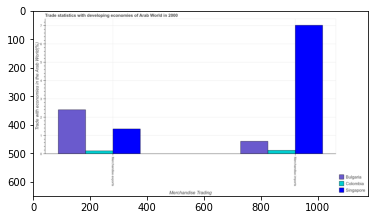

Number of QA =  23





,Merchandise Trading,Bulgaria,Singapore,Colombia
0,Merchandise imports,0.710716,6.995581,0.212807
1,Merchandise exports,2.419194,1.396030,0.186586


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in bulgaria to that in colombia ?
PREDICTED =  12.96560272856852
EXPECTED =  15.44347489317583




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Trade with economies in the Arab World(%)
EXPECTED =  1.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with

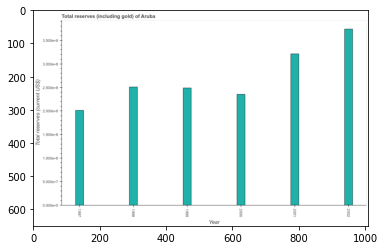

Number of QA =  23





,Year,Total reserves (current US$)
0,1998,2.519405
1,2001,3.212435
2,1999,2.502179
3,1997,2.019676
4,2000,2.364274
5,2002,3.739738


> what is the title of the graph ?
PREDICTED =  Total reserves (including gold) of Aruba
EXPECTED =  Total reserves (including gold) of Aruba




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Total reserves (current US$)
EXPECTED =  Total reserves (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1999 and 2002 ?
PREDICTED =  -1.237559716303453
EXPECTED =  -125067932.961




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (including gold) ?
PREDICTED =  2.510791814459891
EXPECTED =  249952499.5




				 3 / 5 = 0.6


is_built_wi

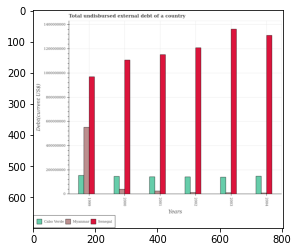

Number of QA =  29





,Years,Senegal,Myanmar,Cabo Verde
0,2003,1.362632e+09,NaN,1.430136e+08
1,1999,9.600782e+08,5.516552e+08,1.569588e+08
2,2000,1.107664e+09,4.245487e+07,1.494010e+08
3,2002,1.210485e+09,1.749995e+07,1.459060e+08
4,2004,1.312900e+09,NaN,1.515908e+08
5,2001,1.151352e+09,2.916570e+07,1.467693e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in cabo verde in 2003 and that in 2004 ?
PREDICTED =  -8577208.726308525
EXPECTED =  -8188000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in myanmar in 2000 and the total undisbursed external debt in senegal in 1999?
PREDICTED =  -917623378.5549808
EXPECTED =  -929579000




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the total undisbursed external debt in senegal and total undisbursed external debt in cabo verde ?
PREDICTED =  0.0
EXPECTED =  11636900

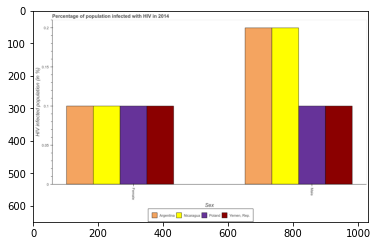

Number of QA =  23





,Sex,"Yemen, Rep",Poland,Nicaragua,Argentina
0,Male,0.101536,0.100631,0.20048,0.201699
1,Female,0.101577,0.101005,0.10063,0.100927


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv in nicaragua and that in poland ?
PREDICTED =  0.09984864947423769
EXPECTED =  0.1




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of females who are infected with hiv in poland to that in yemen, rep. ?
PREDICTED =  0.9945741386020408
EXPECTED =  1.0




				 2 / 4 = 0.5


> what is the difference between two consecutive majo

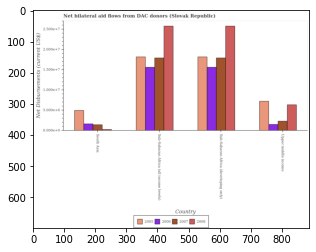

Number of QA =  30





,Country,2007,2005,2006,2008
0,South Asia,0.152607,0.507763,0.172379,NaN
1,Upper middie income,0.241303,0.729712,0.157297,0.645439
2,Sub-Saharan Africa (all income levels),1.801666,1.827848,1.574550,2.596260
3,Sub-Saharan Africa (developing only),1.809585,1.825038,1.569515,2.583130


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2007 in sub-saharan africa (developing only) and that in upper middle income ?
PREDICTED =  0.0
EXPECTED =  15580000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flows in 2006 in south asia to that in sub-saharan africa (all income levels)?
PREDICTED =  0.10947847345945469
EXPECTED =  0.10462130937098844




				 1 / 4 = 0.25


is_buil

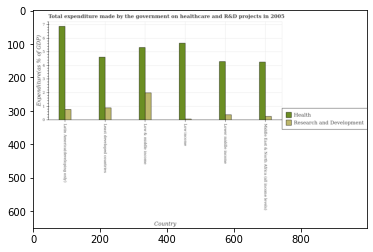

Number of QA =  28





,Country,Health,Research and Development
0,Low income,5.575068,NaN
1,Lower middle income,4.236304,0.402017
2,Low & middle income,5.239681,1.973554
3,Least developed countries,4.528227,0.906689
4,Latin America(developing only),6.770851,0.781553
5,Middle East & North Africa (all income levels),4.213281,0.287629


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in least developed countries and that in middle east & north africa (all income levels) ?
PREDICTED =  0.3149458216141472
EXPECTED =  0.35764652301126




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in latin america(developing only) and the expenditure in r&d in low & middle income?
PREDICTED =  1.5311698681285977
EXPECTED =  4.881595451305211




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in r&d and expenditure in healthcare in middle east & north africa (all income lev

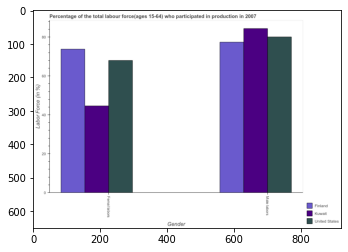

Number of QA =  23





,Gender,United States,Finland,Kuwait
0,M ale labors,80.762305,77.774484,84.682234
1,Femal labors,68.698239,73.864977,45.054383


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in finland and that in kuwait ?
PREDICTED =  -43.05438289624079
EXPECTED =  29.200004577636697




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force and percentage of female labor force in finland ?
PREDICTED =  -71.86497734634459
EXPECTED =  3.599998474121108




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between t

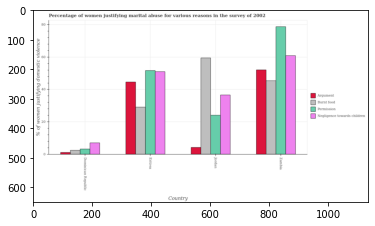

Number of QA =  30





,Country,Unnamed: 1,Permission,Negligence towards children,Burnt food
0,Eritrea,44.344048,51.893349,51.128898,29.414667
1,Zambia,52.178110,79.184748,60.658043,45.529513
2,Dominican Republic,NaN,3.511278,7.275930,2.710851
3,Jordan,4.444696,24.414223,36.810115,59.656733


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of women justifying abuse for showing negligence towards children in eritrea to that in zambia ?
PREDICTED =  0.8429038456568045
EXPECTED =  0.8374384236453202




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_g

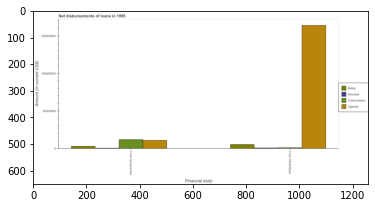

Number of QA =  23





,Financial body,Grenada,Belize,Turkmenistan,Uganda
0,From Wortd Bank,NaN,6.146052e+06,NaN,1.648492e+08
1,From Government,NaN,3.615686e+06,1.277378e+07,1.175491e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from government in grenada and that in uganda ?
PREDICTED =  nan
EXPECTED =  -10399000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from government and net disbursements of loan from world bank in uganda ?
PREDICTED =  nan
EXPECTED =  -153223000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net disbursements of loan from world bank in ug

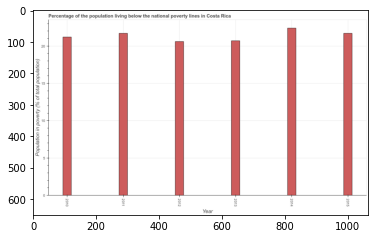

Number of QA =  23





,Year,Population in poverty (% of total population)
0,2015,21.808028
1,2014,22.597395
2,2013,20.760638
3,2010,21.463413
4,2012,20.658015
5,2011,21.886800


> what is the title of the graph ?
PREDICTED =  Percentage of the population living below the national poverty lines in Costa Rica
EXPECTED =  Percentage of the population living below the national poverty lines in Costa Rica




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Population in poverty (% of total population)
EXPECTED =  Population in poverty (% of total population)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population living below poverty line in 2012 and 2013 ?
PREDICTED =  -0.10262370352070604
EXPECTED =  -0.1




				 4 / 4 = 1.0


> what is the median percentage of population living below poverty line ?
PREDICTED =  None
EXPECTED =  21.45




				 4 / 6 = 0.6667


is_built_with

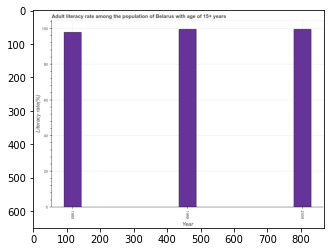

Number of QA =  23





,Year,Literacy rate(%)
0,2009,100.250192
1,1989,98.889667
2,1999,101.244566


> what is the title of the graph ?
PREDICTED =  Adult literacy rate among the population of Belarus with age of 15+ years
EXPECTED =  Adult literacy rate among the population of Belarus with age of 15+ years




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Literacy rate(%)
EXPECTED =  Literacy rate(%)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adult literacy rate in 1999 and 2009 ?
PREDICTED =  0.9943739548168367
EXPECTED =  -0.026




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median adult literacy rate ?
PREDICTED =  100.25019210861868
EXPECTED =  99.59072875976558




				 4 / 5 = 

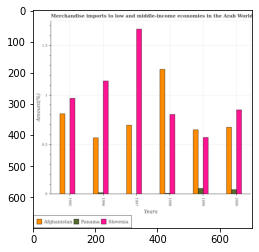

Number of QA =  29





,Years,Slovenia,Panama,Afghanistan
0,1996,1.151282,NaN,0.577081
1,1995,0.972793,NaN,0.812541
2,1997,1.673362,NaN,0.695238
3,1999,0.576234,0.061419,0.658466
4,1998,0.809080,NaN,1.252525
5,2000,0.856695,0.049252,0.678135


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in slovenia in 1996 and that in 1998 ?
PREDICTED =  0.3422023351684649
EXPECTED =  0.33809420182051586




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in panama in 2000 and the percentage of amount earned from merchandise imports in slovenia in 1998?
PREDICTED =  -1.6165227664488555
EXPECTED =  -0.7601995579974954




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of amount earned from merchandise imports

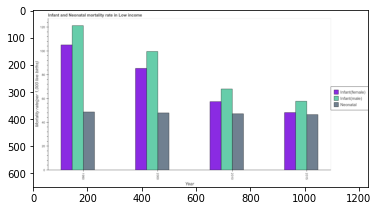

Number of QA =  29





,Year,Infant(male),Neonatal,Infant(female)
0,2000,99.609231,48.244479,85.095388
1,2010,68.463115,47.333971,57.951372
2,2015,57.831877,46.625253,48.315156
3,1990,120.407724,48.845262,105.762687


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate(male) in 1990 and that in 2015 ?
PREDICTED =  62.57584784669858
EXPECTED =  63.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in 2010 and the infant mortality rate(female) in 2000?
PREDICTED =  -0.9105076838116233
EXPECTED =  -0.6999999999999957




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the neonatal mortality rate and infant mortality rate(male) ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

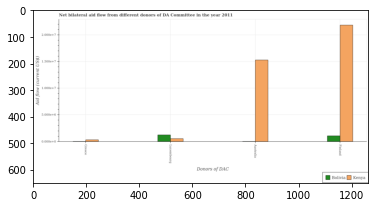

Number of QA =  29





,Donors of DAC,Bolivia,Kenya
0,Greece,NaN,NaN
1,Australia,NaN,1.549001
2,Luxembourg,0.135426,0.065520
3,Finland,0.116914,2.214111


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by australia in kenya and that in bolivia ?
PREDICTED =  0.549000719527319
EXPECTED =  15270000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by luxembourg in bolivia and the amount of aid given by australia in kenya?
PREDICTED =  -1.4790943069716609
EXPECTED =  -14040000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by australia and amount of aid given by luxembourg in kenya ?
PREDICTED =  0.9344803473013257
EXPECTED =  14740000




				 0 / 3 = 0.0


is_built_with_cuda:

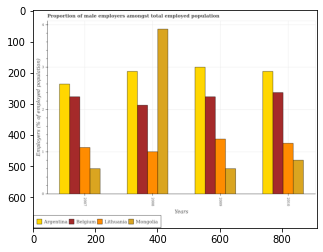

Number of QA =  30





,Years,Belgium,Mongolia,Lithuania,Argentina
0,2007,2.286680,0.599201,1.110778,2.590328
1,2010,2.390909,0.805053,1.207294,2.909967
2,2009,2.314596,0.595586,1.310771,2.998952
3,2008,2.105560,3.907828,1.010910,2.895654


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of male employers in belgium in 2009 and that in 2010 ?
PREDICTED =  -0.0763129086195442
EXPECTED =  -0.10000014305114968




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of male employers in belgium in 2007 and the proportion of male employers in argentina in 2010?
PREDICTED =  -0.10422915662168597
EXPECTED =  -0.6000001430511497




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the proportion of male employers in argentina and proportion of male employers in belgium ?
PREDICTED =  0.724515634095793
E

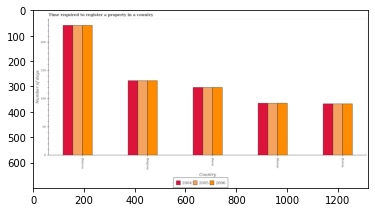

Number of QA =  29





,Country,2005,2004,2006
0,Benin,120.622323,120.344224,120.817078
1,Belarus,230.782288,230.411617,231.043928
2,Bolivia,91.662020,91.555089,91.866275
3,NaN,132.312844,132.460190,133.211583
4,Bhutan,92.387585,92.215620,92.599592


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register a property in 2004 in benin and that in bolivia ?
PREDICTED =  28.78913468892668
EXPECTED =  29.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register a property in 2006 in bolivia and the number of days required to register a property in 2005 in belgium?
PREDICTED =  0.0
EXPECTED =  -41.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register a property of/in 2004 and number of days required to register a property of/in 2006 in bolivia?
PR

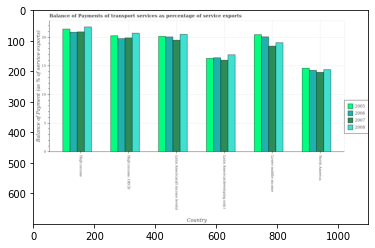

Number of QA =  30





,Country,2007,2005,2006,2008
0,Lower middle income,18.673531,20.684803,20.349869,19.299272
1,High income,21.267418,21.727874,21.139556,22.157198
2,North America,14.089218,14.836583,14.441014,14.603786
3,High income: OECD,20.180944,20.538576,20.018045,21.026270
4,Latin America(all income levels),19.773657,20.480566,20.382012,20.809933
5,Latin America(developing only),16.230745,16.503085,16.715557,17.255447


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2007 in latin america(developing only) and that in lower middle income ?
PREDICTED =  -2.4427861137278875
EXPECTED =  -2.4630682798132995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2006 in high income and the balance of payments of transport services in 2007 in high income: oecd?
PREDICTED =  0.9586121143454136
EXPECTED =  0.9830360494419033




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services of/in 2005 

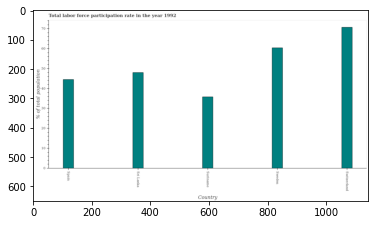

Number of QA =  22





,Country,% of total population
0,NaN,44.571056
1,Switzerland,70.594955
2,Suriname,35.954489
3,Sri Lanka,48.072760
4,Sweden,60.286925


> what is the title of the graph ?
PREDICTED =  Total labor force participation rate in the year 1992
EXPECTED =  Total labor force participation rate in the year 1992




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of total population
EXPECTED =  % of total population




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force participation rate in sri lanka and suriname ?
PREDICTED =  12.11827164922564
EXPECTED =  12.2




				 4 / 4 = 1.0


> what is the median total labor force participation rate ?
PREDICTED =  None
EXPECTED =  48.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> w

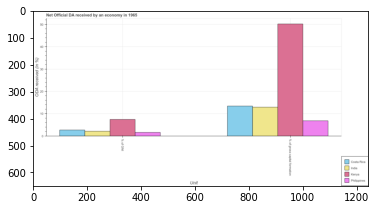

Number of QA =  23





,Unit,India,Kenya,Philippines,Costa Rica
0,% of gross Capital formation,13.463186,50.830056,7.270665,13.943707
1,‘% of GNI,2.586890,7.874108,2.028078,3.059147


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  ODA received (in %)
EXPECTED =  10.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Net Official DA received by an economy in 1965
EXPECTED =  Net Official DA received by an economy in 1965




				 1 / 6 = 0.1667


> what is the label or title of the x-axis ?
PREDICTED

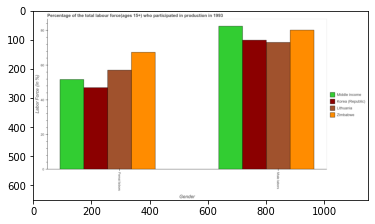

Number of QA =  23





,Gender,Korea (Republic),Zimbabwe,Middle income,Lithuania
0,M ale labors,74.564100,80.294892,82.644562,73.327477
1,Femal labors,47.346612,67.521196,51.860587,57.412529


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in middle income and that in zimbabwe ?
PREDICTED =  15.39198745094356
EXPECTED =  2.2756047103322885




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force and percentage of female labor force in middle income ?
PREDICTED =  -81.64456211857835
EXPECTED =  30.765585455093387




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of m

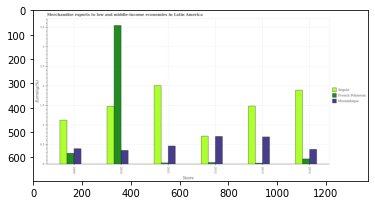

Number of QA =  29





,Years,Angola,Mozambique,French Polynesia
0,2014,1.901324,0.389939,0.144937
1,2011,2.010749,0.472659,0.044678
2,2009,1.133595,0.410906,0.286658
3,2012,0.736928,0.725252,0.054810
4,2013,1.492603,0.715363,0.040002
5,2010,1.483019,0.364496,3.561036


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in mozambique in 2010 and that in 2012 ?
PREDICTED =  -0.36075618085231953
EXPECTED =  -0.35732486389343504




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in mozambique in 2011 and the percentage of amount earned from merchandise exports in angola in 2009?
PREDICTED =  0.06175236699800413
EXPECTED =  -0.6613117233456831




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of amount earned from merchandise 

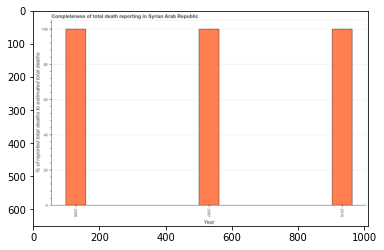

Number of QA =  23





,Year,% of reported total deaths to estimated total deaths
0,2010,100.719374
1,2006,100.217529
2,2007,100.435525


> what is the title of the graph ?
PREDICTED =  Completeness of total death reporting in Syrian Arab Republic
EXPECTED =  Completeness of total death reporting in Syrian Arab Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of reported total deaths to estimated total deaths
EXPECTED =  % of reported total deaths to estimated total deaths




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in 2007 and 2010 ?
PREDICTED =  99.4355253105223
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median completeness of total death reports ?
PRED

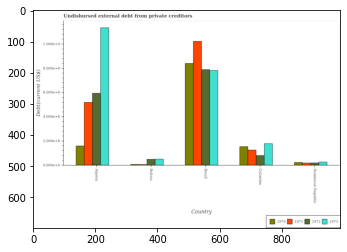

Number of QA =  30





,Country,1972,1971,1970,1973
0,Bolivia,1.815973,NaN,NaN,1.894373
1,Brazil,27.729214,35.895182,29.552625,27.462730
2,Dominican Republic,0.796064,0.729012,0.900636,1.020389
3,Algeria,20.857078,18.293987,5.665499,39.829162
4,Colombia,2.908969,4.497426,5.481203,6.347207


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1970 in bolivia and that in colombia ?
PREDICTED =  -5.481203054675944
EXPECTED =  -146745000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1972 in colombia and the total debt in 1971 in algeria?
PREDICTED =  -17.94810939155345
EXPECTED =  -439000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt of/in 1970 and total debt of/in 1971 in algeria?
PREDICTED =  23.30597675502221
EXPECTED =  -359904000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

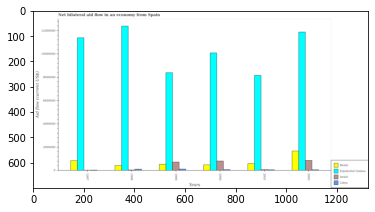

Number of QA =  30





,Years,Unnamed: 1,Israel,Equatorial Guinea,Benin
0,1998,152832.750546,NaN,1.252703e+07,4.656486e+05
1,2003,NaN,908177.913966,1.200476e+07,1.697368e+06
2,1999,162973.591839,775789.110195,8.475539e+06,5.818177e+05
3,1997,NaN,NaN,1.151713e+07,8.872955e+05
4,2000,NaN,856001.260565,1.018890e+07,5.247128e+05
5,2001,NaN,NaN,8.271859e+06,6.444825e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in equatorial guinea in 1998 and that in 2001 ?
PREDICTED =  4255174.014932328
EXPECTED =  4230000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in libya in 1998 and the net bilateral aid flow in equatorial guinea in 2001?
PREDICTED =  -8119026.146661348
EXPECTED =  -8050000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the net bilateral aid flow in libya and net bilateral aid flow in benin ?
PREDICTED =  -3658130.8104157513
EXPECTED =  -410000.0




				 2 / 3 = 0.66

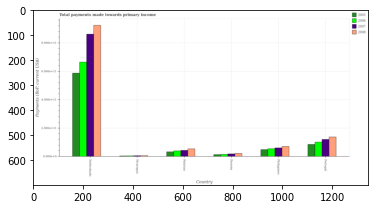

Number of QA =  30





,Country,2007,2005,2006,2008
0,Nicaragua,NaN,NaN,0.075398,NaN
1,Panama,0.208204,0.168815,0.175547,0.252325
2,Pakistan,0.458807,0.356192,0.425896,0.570064
3,Portugal,1.232879,0.879106,1.039763,1.408683
4,Netherlands,8.525732,5.909323,6.648533,9.192703
5,Philippines,0.632650,0.518797,0.585268,0.734874


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in 2007 in pakistan and that in philippines ?
PREDICTED =  -0.17384342972907751
EXPECTED =  -17383316495.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income in 2008 in philippines and the total payments made towards primary income in 2006 in panama?
PREDICTED =  0.48254891708522446
EXPECTED =  55766262217.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total payments made towards primary income of/in 2008 and total payments made towards primary incom

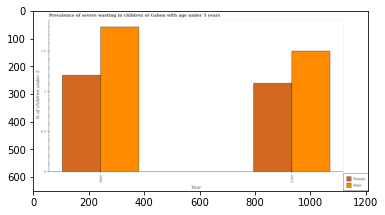

Number of QA =  24





,Year,Female,Male
0,2012,1.098718,1.514708
1,2000,1.196454,1.795268


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in 2000 and that in 2012 ?
PREDICTED =  0.09773596049743105
EXPECTED =  0.10000002384186013




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children in 2012 and the percentage of undernourished female children in 2000?
PREDICTED =  -1998.4852923755302
EXPECTED =  -0.29999995231627996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of undernourished female children and percentage of undernourished male children ?
PREDICTED =  -20

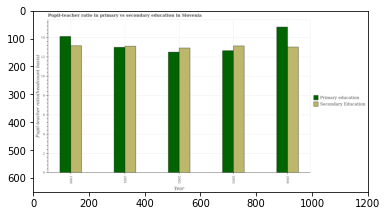

Number of QA =  28





,Year,Secondary Education,Primary education
0,2002,12.951408,12.557882
1,1999,13.177332,14.213902
2,2003,13.215030,12.682669
3,2004,13.078866,15.069723
4,2001,13.155157,13.029351


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

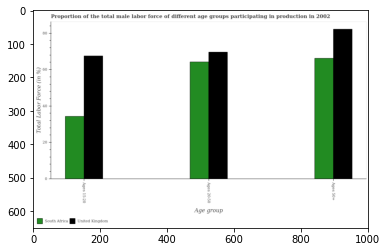

Number of QA =  28





,Age group,United Kingdom,South Africa
0,Ages 15-20,68.030905,34.765418
1,Ages 50+,83.012331,66.751373
2,Ages 20-50,70.415835,65.076252


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force above age 50 in south africa and that in united kingdom ?
PREDICTED =  65.07625244751641
EXPECTED =  -16.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 in united kingdom and the percentage of male labor force within the age group 20-50 in south africa?
PREDICTED =  2.9546529484807564
EXPECTED =  3.3000030517577983




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

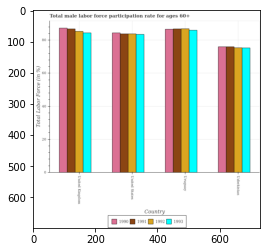

Number of QA =  30





,Country,1992,1993,1990,1991
0,United States,83.952837,83.795373,85.229818,84.494812
1,United Kingdom,85.927745,85.283081,88.292463,87.819804
2,Uruguay,88.243711,86.765065,87.428998,87.720600
3,Uzbekistan,76.278425,76.042010,76.726839,76.978447


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1993 in united kingdom and that in uruguay ?
PREDICTED =  -1.4819835115060727
EXPECTED =  -1.5999984741210938




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1992 in united kingdom and the male labor force participation rate in 1990 in uzbekistan?
PREDICTED =  9.64932003981616
EXPECTED =  9.300003051757798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate of/in 1991 and male labor force participation rate of/in 1990 in uzbek

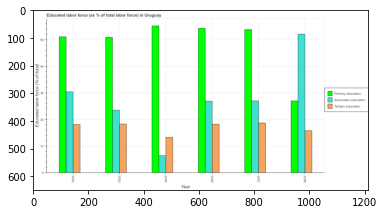

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,2006,27.131349,18.441704,54.707698
1,2002,30.707419,18.283395,51.268722
2,2005,6.594387,13.509079,55.452240
3,2008,52.331194,16.014467,27.096760
4,2007,27.331132,18.938653,54.107960
5,2003,23.838245,18.540248,51.137060


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received secondary education in 2007 and that in 2008 ?
PREDICTED =  -25.00006215200093
EXPECTED =  -25.0999984741211




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in 2003 and the percentage of labor force who received secondary education in 2002?
PREDICTED =  0.25685257581124077
EXPECTED =  0.199998855590799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of labor force who received primary education and percentage o

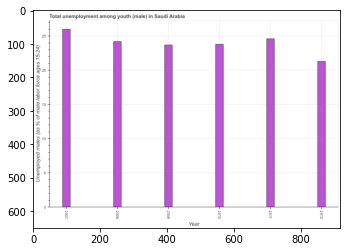

Number of QA =  23





,Year,Unemployed males (as % of male labor force ages 15-24)
0,2009,23.849669
1,2012,21.418962
2,2007,26.219808
3,2010,23.897578
4,2011,24.769949
5,2008,24.297405


> what is the title of the graph ?
PREDICTED =  Total unemployment among youth (male) in Saudi Arabia
EXPECTED =  Total unemployment among youth (male) in Saudi Arabia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed males (as % of male labor force ages 15-24)
EXPECTED =  Unemployed males (as % of male labor force ages 15-24)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in 2008 and 2011 ?
PREDICTED =  -0.4725434085119602
EXPECTED =  -0.4




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth population ?
PREDICTED =  2009.

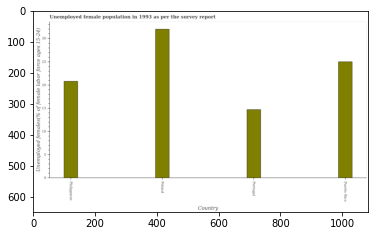

Number of QA =  22





,Country,Unemployed females(% of female labor force ages 15-24)
0,Poland,31.847945
1,Philippines,20.704732
2,Puerto Rico,24.857106
3,Portugal,14.636404


> what is the title of the graph ?
PREDICTED =  Unemployed female population in 1993 as per the survey report
EXPECTED =  Unemployed female population in 1993 as per the survey report




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed females(% of female labor force ages 15-24)
EXPECTED =  Unemployed females(% of female labor force ages 15-24)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth in philippines and puerto rico ?
PREDICTED =  -4.1523739593842315
EXPECTED =  -4.2




				 4 / 4 = 1.0


> what is the median unemployed female youth ?
PREDICTED =  None
EXPECTED =  22.899999618530252




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

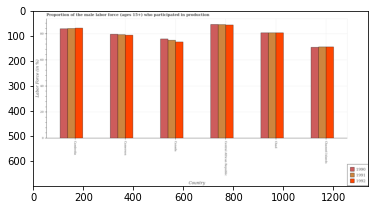

Number of QA =  29





,Country,1992,1990,1991
0,Central African Republic,87.037328,87.363186,87.012252
1,Channel Islands,69.786016,69.754948,69.971766
2,Canada,73.742732,76.459758,75.218213
3,Cambodia,84.585601,83.850334,NaN
4,Cameroon,78.915570,79.644196,79.310433
5,Chad,81.035157,80.792632,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in 1990 in channel islands and the proportion of the male labor force who participated in production in 1992 in central african republic?
PREDICTED =  -17.60823828010433
EXPECTED =  -17.099998474121207




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the proportion of the male labor force who participated in production in

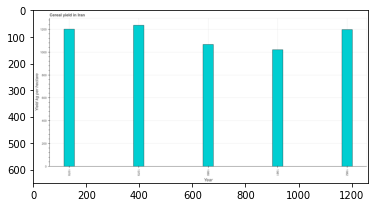

Number of QA =  23





,Year,Yield kg per hectare
0,1981,1022.301019
1,1979,1237.598263
2,1980,1070.615347
3,1982,1203.377547
4,1978,1209.670787


> what is the title of the graph ?
PREDICTED =  Cereal yield in Iran
EXPECTED =  Cereal yield in Iran




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Yield kg per hectare
EXPECTED =  Yield kg per hectare




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal yield in 1979 and 1981 ?
PREDICTED =  215.29724390462923
EXPECTED =  213.985




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal yield ?
PREDICTED =  1980.0
EXPECTED =  1196.791




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.

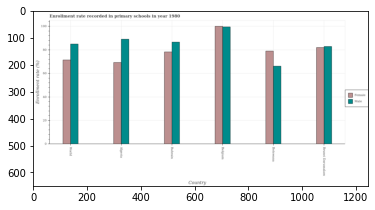

Number of QA =  28





,Country,Female,Male
0,Botswana,78.919189,66.178156
1,NaN,69.227958,88.382320
2,Brunei Darussalam,81.783714,82.883337
3,Bahrain,78.456671,86.589927
4,Belgium,100.227690,99.341640
5,World,71.351000,84.713611


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of female students in bahrain and that in belgium ?
PREDICTED =  -21.771019201530365
EXPECTED =  -21.77221




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of female students in brunei darussalam and the enrollment rate of male students in botswana?
PREDICTED =  2.8645247776495495
EXPECTED =  15.836530000000025




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of female students and enrollment rate of male students in botswana ?
PREDICTED =  21.308500964147683
EXPECTED =  12.812299999999993

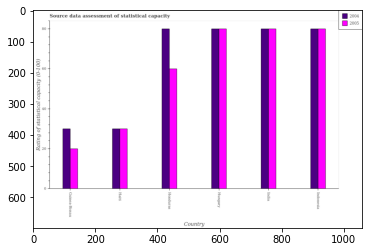

Number of QA =  27





,Country,2005,2004
0,Indonesia,80.563906,80.463115
1,Haiti,30.245854,30.313284
2,India,80.576645,80.737856
3,Honduras,60.536756,81.038239
4,Guinea-Bissau,20.291831,30.062963
5,Hungary,80.616908,80.652736


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in guinea-bissau and that in india ?
PREDICTED =  -50.67489289818615
EXPECTED =  -50.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in hungary and the rating of statistical capacity in 2005 in honduras?
PREDICTED =  -0.3855036466726318
EXPECTED =  20.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity of/in 2004 and rating of statistical capacity of/in 2005 in haiti?
PREDICTED =  50.79238488959696
EXPECTED =  0.0




				 1 / 

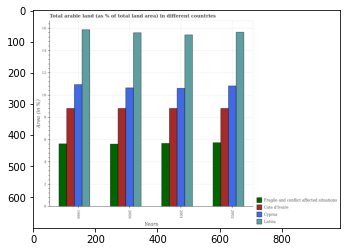

Number of QA =  30





,Years,Fragile and conflict affected situations,Latvia,Cyprus,Cote d'Ivoire
0,2002,5.720297,15.653993,10.846045,8.724416
1,2000,5.643769,15.631572,10.671474,8.815183
2,1999,5.590156,15.877945,10.971152,8.800487
3,2001,5.703938,15.348664,10.627482,8.849260


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of arable land in fragile and conflict affected situations in 1999 and that in 2001 ?
PREDICTED =  -0.03939830252536236
EXPECTED =  -0.04079025282915971




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of arable land in fragile and conflict affected situations and percentage of arable land in cote d'ivoire ?
PREDICTED =  -0.03939830252536236
EXPECTED =  -3.1790494329373225




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalu

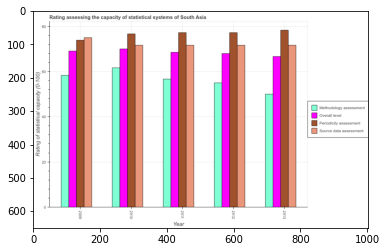

Number of QA =  30





,Year,Periodicity assessment,Methodology assessment,Overall level,Source data assessment
0,2010,77.125071,62.305814,70.540975,72.316100
1,2011,77.750046,57.104387,68.919971,72.339370
2,2012,77.937641,55.368579,68.407801,72.262685
3,2013,78.911960,50.578487,67.493998,72.446612
4,2009,74.458395,58.781398,69.854572,75.626528


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the periodicity assessment rating in 2010 and that in 2011 ?
PREDICTED =  -0.6249751384610391
EXPECTED =  -0.5555549999999982




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the source data assessment rating in 2009 and the methodology assessment rating in 2011?
PREDICTED =  3.287157697823659
EXPECTED =  3.3333333333333




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the overall level rating and source data assessment rating ?
PREDICTED =  275.36274519231665
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_g

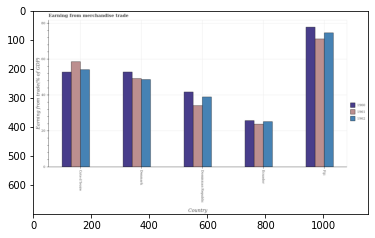

Number of QA =  29





,Country,1962,1961,1960
0,Dominican Republic,39.364198,34.536187,42.280340
1,Cote d'Ivoire,54.982641,59.113463,53.310217
2,Denmark,49.286161,49.745461,53.221856
3,Ecuador,25.697453,24.235361,26.179030
4,Fiji,75.238386,71.937319,78.416968


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in 1960 in cote d'ivoire and that in fiji ?
PREDICTED =  -25.106751433958664
EXPECTED =  -25.0352046936764




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in 1962 in fiji and the earnings from trade in 1961 in ecuador?
PREDICTED =  49.54093292479351
EXPECTED =  50.9208246584071




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade of/in 1960 and earnings from trade of/in 1962 in dominican republic?
PREDICTED =  214.04421240531443
EXPECTED =  2.765518886627099




				 2 / 3 = 0.666

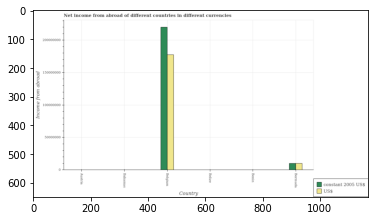

Number of QA =  22





,Country,US$,constant 2005 US$
0,Belize,NaN,NaN
1,Austna,NaN,NaN
2,Benin,NaN,NaN
3,Bahamas,NaN,NaN
4,NaN,1.775143e+08,2.217817e+08
5,Bermuda,1.043107e+07,1.028970e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income from abroad in constant 2005 us$ in bermuda and the income from abroad in us$ in austria?
PREDICTED =  -105746004.4926116
EXPECTED =  10000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the income from abroad in us$ in belgium to that in bermuda ?
PREDICTED =  1.0
EXPECTED =  17.745941588149698




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major tic

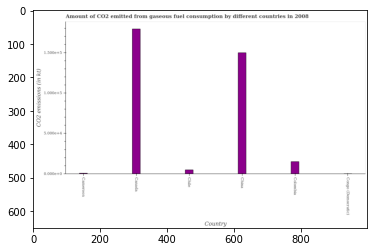

Number of QA =  22





,Country,CO2 emissions (in kt)
0,Chile,0.055788
1,China,1.511624
2,Cameroon,0.013981
3,Canada,1.811984
4,Colombia,0.158648
5,Congo (Democratic),NaN


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption by different countries in 2008
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption by different countries in 2008




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in canada and chile ?
PREDICTED =  1.7561958753841356
EXPECTED =  174461.192




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel cons

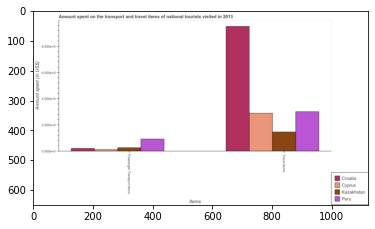

Number of QA =  23





,ltems,Cyprus,Peru,Croatia,Kazakhstan
0,Passenger Transport Items,NaN,0.964439,0.244225,0.301240
1,Travel Items,2.948513,3.029752,9.513839,1.492802


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in croatia and that in kazakhstan ?
PREDICTED =  8.021036777691883
EXPECTED =  8058000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in cyprus and the amount spent on passenger transport items in croatia?
PREDICTED =  -6.809550984183142
EXPECTED =  2688000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items and amount spent on passenger transport items in peru ?
PREDICTED =  1.984074526810768
EXPECTED =  2093000000




				 0 / 3 = 0.0


is_buil

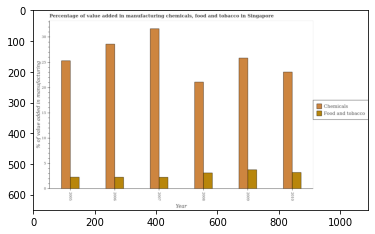

Number of QA =  28





,Year,Food and tobacco,Chemicals
0,2010,3.255576,22.953645
1,2008,3.185941,21.015904
2,2006,2.357201,28.440369
3,2009,3.808766,25.668097
4,2005,2.356172,25.150124
5,2007,2.340246,31.470572


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing food and tobacco in 2007 and that in 2009 ?
PREDICTED =  2.1912336720150667
EXPECTED =  -1.4917705358929303




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by  manufacturing chemicals in 2006 and the value added by manufacturing food and tobacco in 2008?
PREDICTED =  7.424464997207199
EXPECTED =  7.500618781990799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the value added by manufacturing food and tobacco and value added by  manufacturing chemicals ?
PREDICTED =  -25.47057200

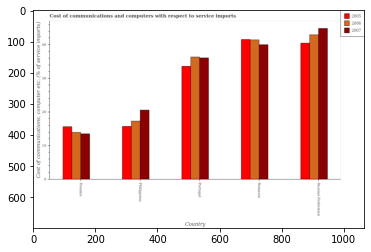

Number of QA =  29





,Country,2007,2005,2006
0,Russian Federation,45.071530,40.551169,43.107421
1,Portugal,36.065706,33.758336,36.404826
2,Romania,40.087597,41.722083,41.639347
3,Panama,13.670074,15.866831,14.093423
4,Philippines,20.625928,15.919039,17.410570


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of communications and computers in 2006 in philippines to that in russian federation?
PREDICTED =  0.40388800353845195
EXPECTED =  0.4019978577505709




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: Fa

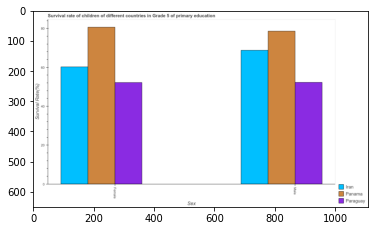

Number of QA =  23





,Sex,lran,Panama,Paraguay
0,Male,68.455071,78.311226,52.251473
1,Female,60.062517,79.870125,52.337249


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female students in primary education in panama and that in paraguay ?
PREDICTED =  27.532876277721627
EXPECTED =  28.460080000000005




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male students in primary education in paraguay and the survival rate of female students in primary education in panama?
PREDICTED =  -26.059753216681607
EXPECTED =  -28.395360000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male students in primary education and survival rate of female students in 

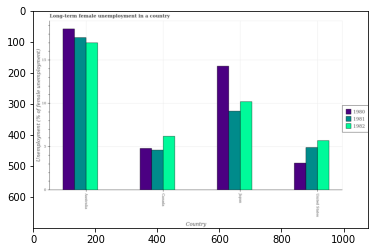

Number of QA =  29





,Country,1982,1980,1981
0,Australia,17.103701,18.703600,17.602948
1,Japan,10.261526,14.351673,9.129000
2,United States,5.731484,3.107254,4.924613
3,Canada,6.244285,4.866012,4.658884


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in 1980 in canada and that in united states ?
PREDICTED =  1.758757495108982
EXPECTED =  1.7000002861022923




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in 1982 in japan and the percentage of long-term unemployed female population in 1980 in united states?
PREDICTED =  4.530041289014432
EXPECTED =  7.099999904632529




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population of/in 1981 a

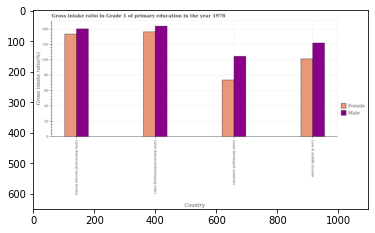

Number of QA =  28





,Country,Female,Male
0,Least developed countries,75.104421,105.763343
1,Low & middle income,102.028748,123.348672
2,Latin America(all income levels),134.589974,141.620721
3,Latin America( developing only),137.463217,144.803799


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

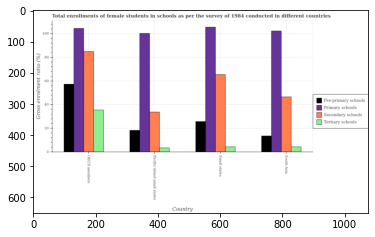

Number of QA =  30





,Country,Pre-primary schools,Secondary schools,Tertiary schools,Primary schools
0,South Asia,13.922341,47.075427,4.782271,101.929956
1,Pacific island small states,18.836778,33.826514,3.913940,100.569091
2,OECD members,57.330638,84.853341,35.819647,103.763778
3,Small states,26.041490,65.595406,4.802363,105.778259


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(female) in secondary schools in small states ?
PREDICTED =  16.39885144976287
EXPECTED =  65.3784866333008




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(female) in pre-primary schools ?
PREDICTED =  14.33265949966206
EXPECTED =  57.25862121582029




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio(female) in tertiary schools ?
PREDICTED =  0.978484983884553
EXPECTED =  3.35536003112793




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pre

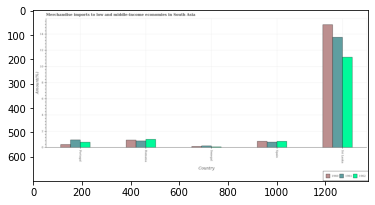

Number of QA =  29





,Country,1962,1961,1960
0,Romania,1.058160,0.872736,0.959758
1,Senegal,NaN,0.234434,NaN
2,Sn Lanka,11.250889,13.826278,15.214574
3,Portugal,0.709945,0.988612,0.405249
4,NaN,0.805520,0.717832,0.811267


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 in portugal and that in romania ?
PREDICTED =  -0.5545089408954262
EXPECTED =  -0.5546447722828998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in romania and the percentage of amount earned from merchandise imports in 1960 in sri lanka?
PREDICTED =  -12.953542178929094
EXPECTED =  -14.368381850451236




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports of/in 1962 

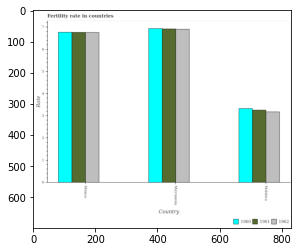

Number of QA =  29





,Country,1962,1961,1960
0,Moldova,3.159219,3.250579,3.307236
1,Micronesia,6.868381,6.858591,6.862631
2,Mexico,6.715058,6.701558,6.688394


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in 1961 in mexico and that in micronesia ?
PREDICTED =  -0.1570338044481865
EXPECTED =  -0.15500000000000203




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in 1962 in mexico and the fertility rate in 1960 in moldova?
PREDICTED =  3.5558396028420076
EXPECTED =  3.4299999999999993




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate of/in 1961 and fertility rate of/in 1962 in mexico?
PREDICTED =  -3.464479145593747
EXPECTED =  0.004000000000000448




				 2 / 3 = 0.6667


is_built_with_cuda: Tru

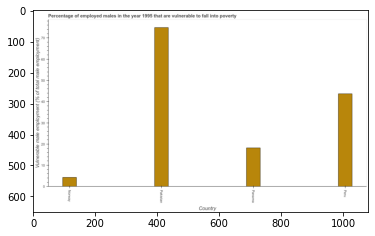

Number of QA =  22





,Country,Vulnerable male employment (% of total male employment)
0,NaN,43.469400
1,Norway,4.401187
2,Pakistan,74.138159
3,Panama,18.057890


> what is the title of the graph ?
PREDICTED =  Percentage of employed males in the year 1995 that are vulnerable to fall into poverty
EXPECTED =  Percentage of employed males in the year 1995 that are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Vulnerable male employment (% of total male employment)
EXPECTED =  Vulnerable male employment (% of total male employment)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed males who are vulnerable to fall into poverty in panama and peru ?
PREDICTED =  0.0
EXPECTED =  -25.5




				 3 / 4 = 0.75


> what is the median percentage of employed males who are vulnerable to fall into poverty ?
PREDICTED =  None


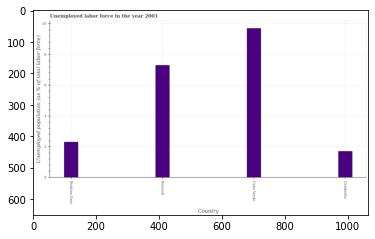

Number of QA =  22





,Country,Unemployed population (as % of total labor force)
0,Cabo Verde,9.654813
1,Burundi,7.314022
2,Burkina Faso,2.324445
3,Cambodia,1.729730


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in the year 2001
EXPECTED =  Unemployed labor force in the year 2001




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed population (as % of total labor force)
EXPECTED =  Unemployed population (as % of total labor force)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed population in burundi and cabo verde ?
PREDICTED =  -2.3407915639118446
EXPECTED =  -2.4




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed population ?
PREDICTED =  4.819233580919388
EXPECTED =  4.8000000

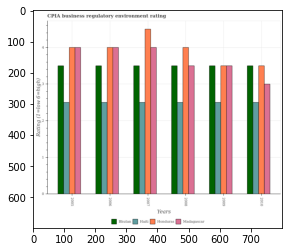

Number of QA =  30





,Years,Madagascar,Bhutan,Honduras,Haiti
0,2007,4.040588,3.487919,4.631178,2.486193
1,2008,3.533280,3.528852,4.053709,2.532622
2,2006,4.027911,3.525265,4.071903,2.530463
3,2010,3.018773,3.471476,3.537623,2.527584
4,2009,3.510727,3.532569,3.517518,2.527793
5,2005,4.026744,3.484021,4.050118,2.536577


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in haiti in 2005 and that in 2007 ?
PREDICTED =  0.05038461170864794
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in honduras in 2008 and the cpia rating in madagascar in 2005?
PREDICTED =  0.0035907552795553244
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating in honduras and cpia rating in madagascar ?
PREDICTED =  1.1014980084323382
EXPECTED =  0.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

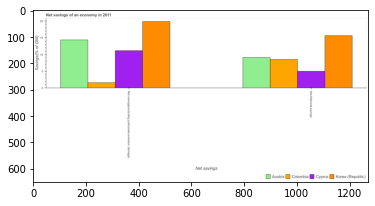

Number of QA =  23





,Net savings,Korea (Republic),Austria,Cyprus,Colombia
0,Net National savings,15.873169,9.341196,5.225581,8.837848
1,Net savings(exduding particulate emission damage),20.257121,14.564959,11.365210,1.781717


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in cyprus and the net savings(excluding particulate emission damage) in colombia?
PREDICTED =  5.22558143862089
EXPECTED =  3.3941040902571196




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Savings(% of GNI)
EXPECTED =  5.0




				 0 / 5 = 0.0


> what is the title of the graph ?

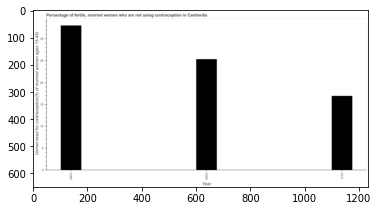

Number of QA =  23





,Year,Unmet need for contraception(% of married women ages 15-49)
0,2005,25.435793
1,2000,33.074571
2,2011,17.144264


> what is the title of the graph ?
PREDICTED =  Percentage of fertile, married women who are not using contraception in Cambodia
EXPECTED =  Percentage of fertile, married women who are not using contraception in Cambodia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unmet need for contraception(% of married women ages 15-49)
EXPECTED =   Unmet need for contraception(% of married women ages 15-49)




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of married women who are not using contraception in 2000 and 2005 ?
PREDICTED =  -15.144263687473032
EXPECTED =  7.7




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

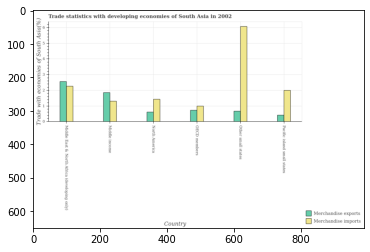

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Middle income,1.326783,1.883975
1,North America,1.452594,0.642278
2,OECD members,1.027513,0.758923
3,Other small states,6.125433,0.700758
4,Pacific island small states,2.014945,0.449822
5,Middle East & North Africa (developing only),2.282515,2.592205


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in north america and that in other small states ?
PREDICTED =  -0.058479731039820626
EXPECTED =  -0.05661954399101399




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in oecd members and the merchandise imports in north america?
PREDICTED =  0.11664499178531984
EXPECTED =  -0.7021542174454399




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports and merchandise imports in other small states ?
PREDICTED =  -4.9541058632657435
EXPECTED =  -5.401123012335157




				 1 / 3 = 0.3333


i

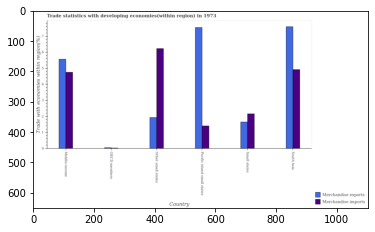

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Other small states,6.359925,1.945667
1,Middle income,4.768680,5.617848
2,Pacific island small states,1.420939,7.585155
3,Small states,2.190947,1.670591
4,OECD members,NaN,NaN
5,South Asia,4.951869,7.637367


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in pacific island small states and that in small states ?
PREDICTED =  0.0
EXPECTED =  5.904963420341051




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in oecd members and the merchandise exports in other small states?
PREDICTED =  -6.359924848658799
EXPECTED =  -1.9072317648452117




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports and merchandise imports in middle income ?
PREDICTED =  0.12264589543267856
EXPECTED =  0.8173127773113098




				 0 / 3 = 0.0


is_built_with_cuda

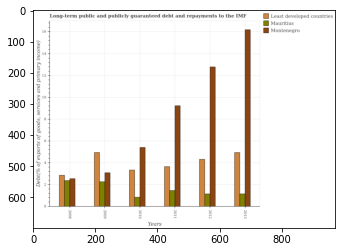

Number of QA =  29





,Years,Least developed countries,Mauritius,Montenegro
0,2008,2.925882,2.468299,2.566232
1,2011,3.670674,1.504088,9.119761
2,2010,3.359133,0.884842,5.420363
3,2012,4.320984,1.204494,12.701047
4,2013,4.950853,1.209103,16.181659
5,2009,4.946264,2.319074,3.105852


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt and repayments in least developed countries in 2010 and that in 2013 ?
PREDICTED =  -2.3099862491946404
EXPECTED =  -1.60344544881979




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt and repayments in montenegro in 2011 and the debt and repayments in least developed countries in 2013?
PREDICTED =  -10.1816587105262
EXPECTED =  4.287994002742263




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the debt and repayments in least developed countries and debt and repayments in montenegro ?
PREDICTED =  -12057.0
EXPECTE

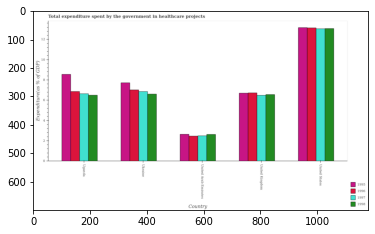

Number of QA =  30





,Country,1996,1997,1995,1998
0,United Arab Emirates,2.466355,2.511318,2.664107,2.663067
1,United States,13.073977,12.987644,13.124034,13.094795
2,United Kingdom,6.707794,6.470355,6.668013,6.564232
3,Ukraine,6.992046,6.812432,7.674481,6.585812
4,Uganda,6.826234,6.619481,8.567526,6.490053


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure spent by the government in healthcare projects in 1996 in uganda and that in united arab emirates ?
PREDICTED =  4.359879102606113
EXPECTED =  4.399454690000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure spent by the government in healthcare projects in 1997 in united arab emirates and the total expenditure spent by the government in healthcare projects in 1998 in uganda?
PREDICTED =  0.0
EXPECTED =  -4.0072025799999995




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure spent by 

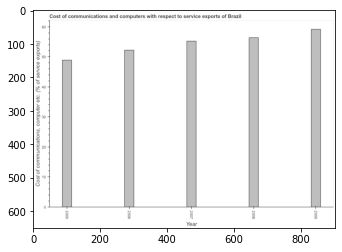

Number of QA =  23





,Year,"Cost of communications, computer etc. (% of service exports)"
0,2006,52.817355
1,2008,56.982633
2,2009,59.672572
3,2005,49.215860
4,2007,55.851290


> what is the title of the graph ?
PREDICTED =  Cost of communications and computers with respect to service exports of Brazil
EXPECTED =  Cost of communications and computers with respect to service exports of Brazil




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Cost of communications, computer etc. (% of service exports)
EXPECTED =  Cost of communications, computer etc. (% of service exports)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computer in 2007 and 2008 ?
PREDICTED =  -63.6180629844777
EXPECTED =  -1.163




				 3 / 4 = 0.75


> what is the median cost of communications and computer ?
PREDICTED =  None
EXPECTED =  55.2385763725478




				 3 / 6 = 0.5


is_built_with

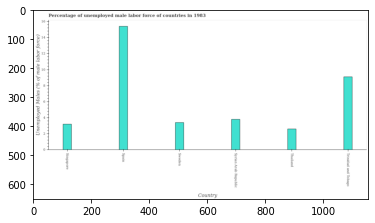

Number of QA =  22





,Country,Unemployed Males (% of male labor force)
0,NaN,15.481241
1,Singapore,3.282331
2,Syrian Arab Republic,3.853415
3,Trinidad and Tobago,9.162932
4,Thailand,2.670022
5,Sweden,3.483592


> what is the title of the graph ?
PREDICTED =  Percentage of unemployed male labor force of countries in 1983
EXPECTED =  Percentage of unemployed male labor force of countries in 1983




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Unemployed Males (% of male labor force)
EXPECTED =  Unemployed Males (% of male labor force)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed male labour force in spain and trinidad and tobago ?
PREDICTED =  13.28936096459159
EXPECTED =  6.3




				 3 / 4 = 0.75


> what is the median total unemployed male labour force ?
PREDICTED =  None
EXPECTED =  3.6000000238418552




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

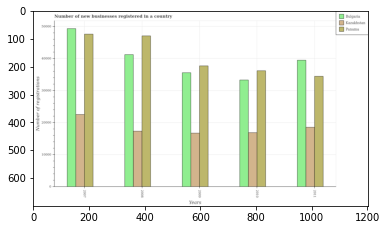

Number of QA =  29





,Years,Bulgaria,Panama,Kazakhstan
0,2008,41390.741247,47320.989348,17634.403758
1,2011,39617.969642,34534.992349,18739.307780
2,2007,49574.323887,48016.370256,22755.751616
3,2010,33429.834876,36250.046216,17057.229033
4,2009,35373.152205,37929.141942,16902.754200


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of new businesses registered in kazakhstan in 2007 and that in 2009 ?
PREDICTED =  5852.9974159482335
EXPECTED =  5802.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of new businesses registered in kazakhstan in 2008 and the number of new businesses registered in panama in 2009?
PREDICTED =  731.6495576167144
EXPECTED =  -20369.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the number of new businesses registered in kazakhstan and number of new businesses registered in bulgaria ?
PREDICTED =  0.0
EXPE

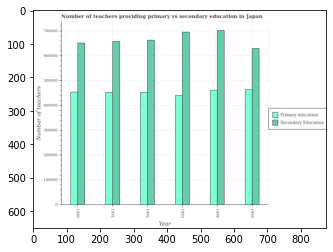

Number of QA =  28





,Year,Secondary Education,Primary education
0,1990,652687.003208,456650.877350
1,1992,666116.983613,455346.168686
2,1991,661586.386696,455318.562895
3,1994,705395.375649,464977.641680
4,1995,628652.110642,468162.059396
5,1993,701142.403516,443245.059744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers in 1991 and that in 1994 ?
PREDICTED =  -9659.078785052523
EXPECTED =  -8880




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers in 1992 and the number of secondary teachers in 1993?
PREDICTED =  12101.10894257552
EXPECTED =  12610




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the number of secondary teachers and number of primary teachers ?
PREDICTED =  628646.1106421151
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

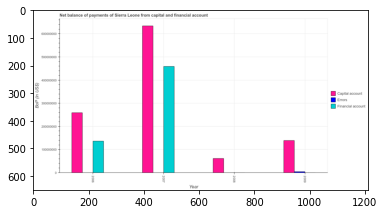

Number of QA =  25





,Year,Financial account,Capital account,Errors
0,2008,NaN,6.318443e+07,NaN
1,2006,1.380282e+08,2.590023e+08,NaN
2,2009,NaN,1.395130e+08,NaN
3,2007,4.596810e+08,6.315520e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of net capital account in 2008 and that in 2009 ?
PREDICTED =  -76328564.54647115
EXPECTED =  -77608900.22




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of net capital account in 2008 and the amount of financial account in 2009?
PREDICTED =  -76328564.54647115
EXPECTED =  -77608900.22




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount of financial account and amount of errors ?
PREDICTED =  597709176.663099
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False


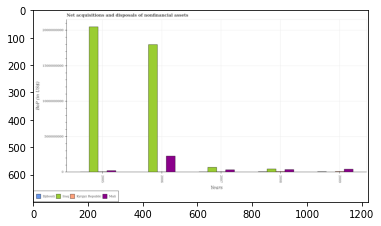

Number of QA =  30





,Years,Unnamed: 1,Mali,Kyrgyz Republic,Djibouti
0,2008,5.195485e+08,4.323079e+08,NaN,NaN
1,2006,1.794697e+10,2.311161e+09,NaN,NaN
2,2005,2.043209e+10,2.785867e+08,NaN,NaN
3,2009,NaN,4.849766e+08,NaN,NaN
4,2007,7.445889e+08,3.940635e+08,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in mali in 2007 and that in 2008 ?
PREDICTED =  -38244334.43612152
EXPECTED =  -29112335.899999976




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in kyrgyz republic in 2007 and the balance of payments in mali in 2008?
PREDICTED =  312281017.7174541
EXPECTED =  -308296855.9




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the balance of payments in mali in 20

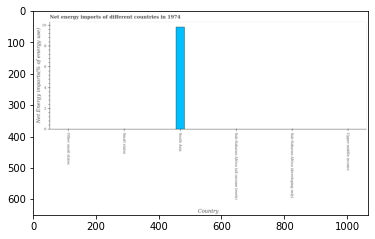

Number of QA =  15





,Country,Net Energy imports(% of energy use)
0,Other small states,NaN
1,South Asia,9.972107
2,Upper middle income,NaN
3,Small states,NaN
4,Sub-Saharan Africa (all income levels),NaN
5,Sub-Saharan Africa (developing only),NaN


> what is the title of the graph ?
PREDICTED =  Net energy imports of different countries in 1974
EXPECTED =  Net energy imports of different countries in 1974




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Net Energy imports(% of energy use)
EXPECTED =  Net Energy imports(% of energy use)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median energy imports ?
PREDICTED =  9.972107362208188
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 5 = 0.6


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Net Energy imports(% of energy use)
EXPECTED =  2.0




	

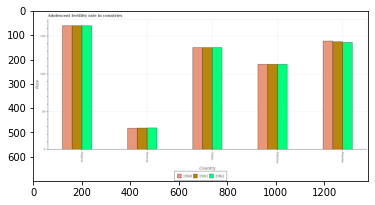

Number of QA =  29





,Country,1962,1961,1960
0,Panama,141.474887,142.113630,143.550316
1,Norway,28.633746,28.256258,28.309916
2,Oman,134.773223,135.106631,134.756163
3,Pakistan,112.605875,112.492329,112.169056
4,Nigeria,163.943766,163.398496,163.444555


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in 1961 in nigeria and that in panama ?
PREDICTED =  21.2848662080427
EXPECTED =  21.31279999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in 1962 in oman and the adolescent fertility rate in 1960 in norway?
PREDICTED =  106.1394765849933
EXPECTED =  106.9442




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate of/in 1962 and adolescent fertility rate of/in 1960 in nigeria?
PREDICTED =  417.98694234536845
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_buil

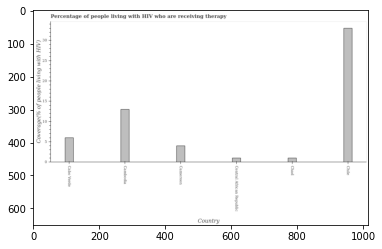

Number of QA =  22





,Country,Coverage(% of people living with HIV)
0,Chad,1.103018
1,Chile,32.826994
2,Cambodia,12.975159
3,Cabo Verde,6.085762
4,Cameroon,4.126387
5,Central African Republic,1.102504


> what is the title of the graph ?
PREDICTED =  Percentage of people living with HIV who are receiving therapy
EXPECTED =  Percentage of people living with HIV who are receiving therapy




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Coverage(% of people living with HIV)
EXPECTED =  Coverage(% of people living with HIV)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the antiretroviral therapy coverage in cameroon and chile ?
PREDICTED =  -28.700607860558044
EXPECTED =  -29.0




				 4 / 4 = 1.0


> what is the median antiretroviral therapy coverage ?
PREDICTED =  None
EXPECTED =  5.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

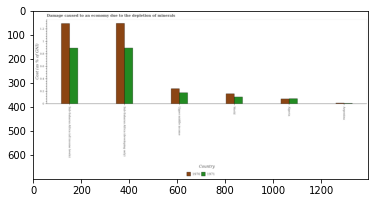

Number of QA =  28





,Country,1971,1970
0,Upper middle income,0.187151,0.253093
1,Sub-Saharan Africa (all income levels),0.906824,1.303360
2,NaN,0.090097,0.086927
3,Sub-Saharan Africa (developing only),0.905305,1.303140
4,Argentina,NaN,NaN
5,World,0.118253,0.169840


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in 1971 in algeria and that in sub-saharan africa (developing only) ?
PREDICTED =  0.0015193732099021418
EXPECTED =  -0.8098464107128227




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in 1970 in sub-saharan africa (all income levels) and the cost of damage caused due to the depletion of minerals in 1971 in sub-saharan africa (developing only)?
PREDICTED =  0.39805540750046775
EXPECTED =  0.39179504780128793




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

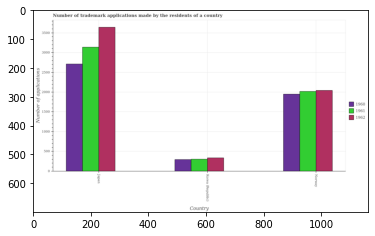

Number of QA =  29





,Country,1962,1961,1960
0,Japan,3688.565672,3183.023069,2730.159119
1,Korea (Republic),349.647359,315.660509,303.137927
2,Norway,2072.443308,2035.479638,1974.627310


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the residents in 1962 in japan and that in korea (republic) ?
PREDICTED =  -348.64735886733564
EXPECTED =  3306.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the residents in 1961 in korea (republic) and the number of trademark applications made by the residents in 1960 in norway?
PREDICTED =  313.6605089931952
EXPECTED =  -1647.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the residents of/in 1961 and num

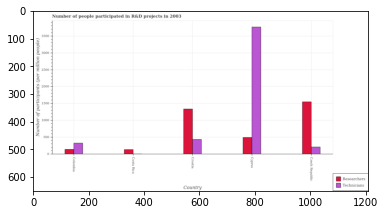

Number of QA =  28





,Country,Technicians,Researchers
0,Colombia,336.600357,155.021973
1,Czech Republic,221.229961,1551.147548
2,Croatia,444.649405,1364.462037
3,NaN,3767.489936,504.149759
4,Costa Rica,NaN,145.788513


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of researchers in colombia and that in cyprus ?
PREDICTED =  -1396.1255751546437
EXPECTED =  -352.5612




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians in croatia and the number of researchers in cyprus?
PREDICTED =  443.6494047703086
EXPECTED =  -57.55908999999991




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians and number of researchers in colombia ?
PREDICTED =  847.4577499429329
EXPECTED =  186.10317999999998




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GP

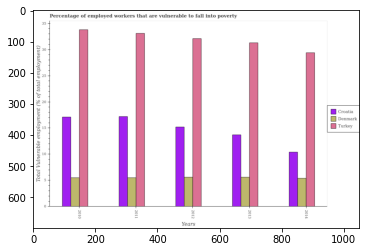

Number of QA =  29





,Years,Turkey,Croatia,Denmark
0,2014,29.421366,10.515444,5.473792
1,2013,31.373629,13.844229,5.723767
2,2012,32.066561,15.343327,5.709204
3,2010,33.966054,17.254967,5.608522
4,2011,33.222273,17.369036,5.623545


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed workers who are vulnerable to fall into poverty in denmark in 2010 and that in 2012 ?
PREDICTED =  -0.10068263547361056
EXPECTED =  -0.09999990463257102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed workers who are vulnerable to fall into poverty in croatia in 2011 and the percentage of employed workers who are vulnerable to fall into poverty in denmark in 2013?
PREDICTED =  17.369035928964895
EXPECTED =  11.600000858306927




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_g

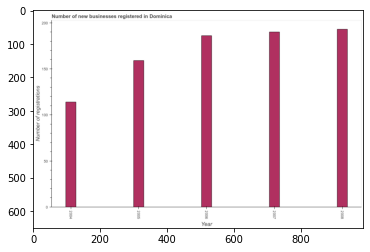

Number of QA =  23





,Year,Number of registrations
0,2008,194.849784
1,2005,160.431553
2,2006,187.433404
3,2004,115.167411
4,2007,191.839558


> what is the title of the graph ?
PREDICTED =  Number of new businesses registered in Dominica
EXPECTED =  Number of new businesses registered in Dominica




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of registrations
EXPECTED =  Number of registrations




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

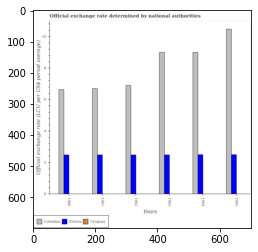

Number of QA =  29





,Years,Uruguay,Eritrea,Colombia
0,1965,NaN,2.517822,10.511270
1,1960,NaN,2.506748,6.665351
2,1963,NaN,2.519554,9.019851
3,1962,NaN,2.490078,6.906581
4,1964,NaN,2.542333,9.027083
5,1961,NaN,2.526362,6.724711


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official exchange rate in uruguay in 1961 and that in 1964 ?
PREDICTED =  0.0
EXPECTED =  -5.402500000000001e-06




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official exchange rate in colombia in 1962 and the official exchange rate in eritrea in 1964?
PREDICTED =  -2.120502286598777
EXPECTED =  4.39883459175231




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the official exchange rate in colomb

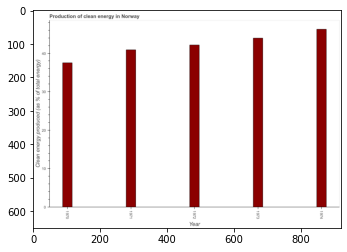

Number of QA =  23





,Year,Clean energy produced (as % of total energy)
0,1973,44.365381
1,1970,37.766742
2,1974,46.803006
3,1971,41.340354
4,1972,42.597271


> what is the title of the graph ?
PREDICTED =  Production of clean energy in Norway
EXPECTED =  Production of clean energy in Norway




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Clean energy produced (as % of total energy)
EXPECTED =  Clean energy produced (as % of total energy)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the production of clean energy in 1970 and 1972 ?
PREDICTED =  -4.830529387361736
EXPECTED =  -4.636




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median production of clean energy ?
PREDICTED =  1972.0
EXPECTED =  42.1674160446255




				 4 / 5 = 0.8


is_built_wit

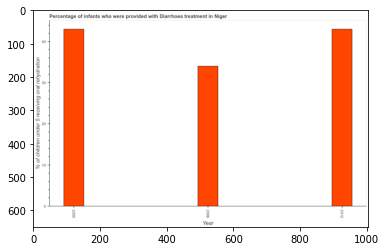

Number of QA =  23





,Year,% of children under 5 receiving oral rehydration
0,2012,43.494011
1,2006,34.131204
2,2000,43.224353


> what is the title of the graph ?
PREDICTED =  Percentage of infants who were provided with Diarrhoea treatment in Niger
EXPECTED =  Percentage of infants who were provided with Diarrhoea treatment in Niger




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  % of children under 5 receiving oral rehydration
EXPECTED =  % of children under 5 receiving oral rehydration




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with treatment diarrhoea in 2006 and 2012 ?
PREDICTED =  -9.362807677274894
EXPECTED =  -9.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the m

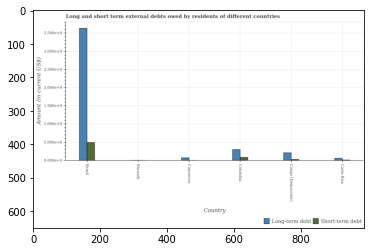

Number of QA =  25





,Country,Long-term debt,Short-term debt
0,Brazil,3.587860,0.504551
1,Burundi,NaN,NaN
2,Congo (Democratic),0.222300,0.042309
3,Cameroon,0.082729,NaN
4,Costa Rica,0.074584,NaN
5,Colom bia,0.311893,0.098979


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in cameroon and that in colombia ?
PREDICTED =  -0.2291639669450992
EXPECTED =  -227958000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the short-term debts owed by residents and long-term debts owed by residents in colombia ?
PREDICTED =  0.0
EXPECTED =  -213763000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the short-term debts owed by residents in colombia t

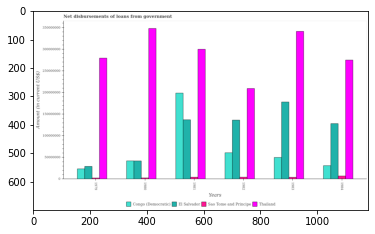

Number of QA =  30





,Years,Thailand,El Salvador,Congo (Democratic),Sao Tome and Principe
0,1983,3.422651e+08,1.798390e+08,5.078376e+07,5.065801e+06
1,1979,2.814933e+08,2.982880e+07,2.440012e+07,NaN
2,1982,2.103058e+08,1.374914e+08,6.108303e+07,5.317304e+06
3,1981,3.008233e+08,1.374871e+08,1.988225e+08,5.297389e+06
4,1980,3.498885e+08,4.288818e+07,4.326532e+07,NaN
5,1984,2.765662e+08,1.296323e+08,3.217420e+07,8.195058e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in el salvador in 1979 and that in 1983 ?
PREDICTED =  -150010194.48722783
EXPECTED =  -148842000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in congo (democratic) in 1979 and the amount of loan disbursed from government in sao tome and principe in 1980?
PREDICTED =  -18865199.117218893
EXPECTED =  20935000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1981, what is the difference between the amount of loan disbursed from government in congo (democratic) and amount of 

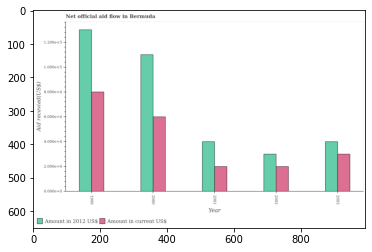

Number of QA =  28





,Year,Amount in current US$,Amount in 2012 US$
0,1999,0.804946,1.301759
1,2003,0.305246,0.408744
2,2002,0.205514,0.307452
3,2000,0.606109,1.104956
4,2001,0.205045,0.401023


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in us$) in 2002 and that in 2003 ?
PREDICTED =  -0.09973258909630148
EXPECTED =  -10000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in 2012 us$) in 2001 and the amount of aid received(expressed in us$) in 2002?
PREDICTED =  0.09357187958091517
EXPECTED =  10000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount of aid received(expressed in us$) and amount of aid received(expressed in 2012 us$) ?
PREDICTED =  1.4760662998857765
EXPECTED =  0





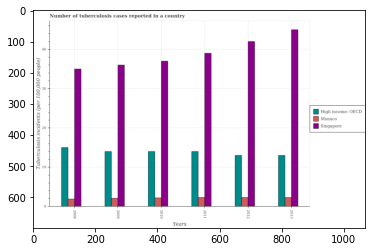

Number of QA =  29





,Years,Singapore,High income: OECD,Monaco
0,2013,45.515566,13.233724,2.421126
1,2008,35.279301,15.250907,2.045988
2,2012,42.248946,13.228093,2.420108
3,2010,37.129563,14.163848,2.297624
4,2009,36.271137,14.106955,2.241560
5,2011,39.223882,14.188711,2.419910


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in high income: oecd in 2010 and that in 2012 ?
PREDICTED =  23.90146978642788
EXPECTED =  1




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in high income: oecd in 2010 and the number of tuberculosis cases reported in in monaco in 2012?
PREDICTED =  23.90146978642788
EXPECTED =  11.7




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of tuberculosis cases reported in in high income: oecd and number of tuberculosis cases reported in

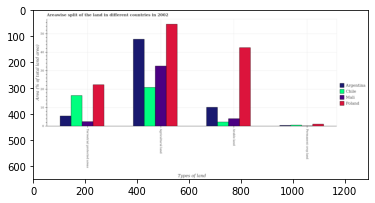

Number of QA =  29





,Types of land,Mali,Chile,Poland,Argentina
0,Permanent crop land,NaN,NaN,1.363994,NaN
1,Terrestrial protected areas,2.716940,16.803519,22.511149,5.716141
2,Arable land,4.333866,2.478240,42.924303,10.453364
3,Agricultural land,32.659864,21.343746,55.198614,47.463860


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under agricultural land in poland and that in argentina ?
PREDICTED =  7.734754420559959
EXPECTED =  8.141934168210206




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under agricultural land in argentina and the percentage of area under arable land in chile?
PREDICTED =  44.98561992509625
EXPECTED =  44.812129854527676




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under permanent crop land and percentage of land under terrestrial protection in chile ?
PREDICTED =  -16.80351877

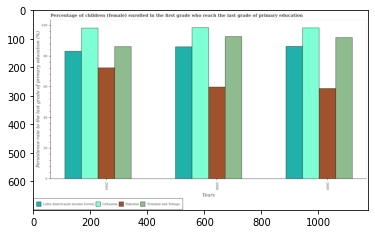

Number of QA =  30





,Years,Pakistan,Trinidad and Tobaga,Lithuania,Latin America(all income levels)
0,2008,60.380976,92.445734,97.912756,86.219360
1,2004,72.636240,85.679569,98.376601,82.800038
2,2009,58.949868,91.853735,98.006221,86.125026


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of children in trinidad and tobago in 2008 and that in 2009 ?
PREDICTED =  -98.61990018459474
EXPECTED =  0.6728286743164062




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of children in latin america(all income levels) in 2008 and the persistence rate of children in pakistan in 2009?
PREDICTED =  0.09433443392408947
EXPECTED =  27.189105987548814




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the persistence rate of children in latin america(all income levels) and persistence rate of 

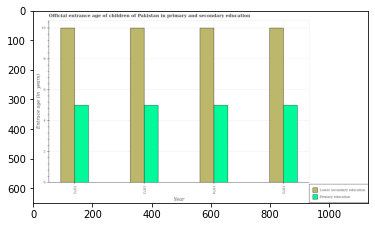

Number of QA =  28





,Year,Lower secondary education,Primary education
0,1974,10.028184,5.005997
1,1975,9.978969,5.044055
2,1972,10.035801,5.040678
3,1973,10.029771,5.008822


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in 1973 and that in 1974 ?
PREDICTED =  0.0015871574113397457
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in 1975 and the entrance age of chiildren in primary education in 1974?
PREDICTED =  -0.04921412248999246
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the entrance age of chiildren in primary education and entrance age of children in lower secondary education ?
PREDICTED =  -4

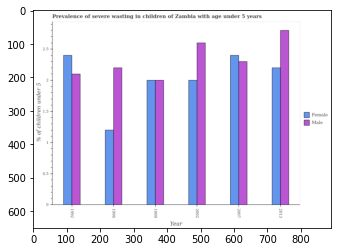

Number of QA =  28





,Year,Female,Male
0,2007,2.402013,2.307247
1,1992,2.411417,2.116217
2,1999,2.006097,2.002828
3,2002,2.005978,2.581437
4,2013,2.220667,2.821278
5,1996,1.205454,2.193664


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in 1996 and the percentage of undernourished male children in 2007?
PREDICTED =  -1.1965592504457314
EXPECTED =  -1.2000000476837098




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of undernourished male children and percentage of undernourished female children ?
PREDICTED =  -1993.9971724741183
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

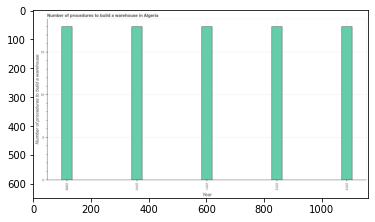

Number of QA =  23





,Year,Number of procedures to build a warehouse
0,2012,18.046571
1,2013,18.113568
2,2011,18.115840
3,2009,18.094707
4,2010,18.187396


> what is the title of the graph ?
PREDICTED =  Number of procedures to build a warehouse in Algeria
EXPECTED =  Number of procedures to build a warehouse in Algeria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Number of procedures to build a warehouse
EXPECTED =  Number of procedures to build a warehouse




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in 2009 and 2011 ?
PREDICTED =  -0.02113357243917946
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of procedures to build a warehouse ?
PREDICTED =  2011.0
EXPECTED

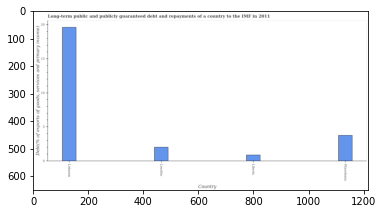

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Lesotho,2.079781
1,Liberia,0.955803
2,Lebanon,19.690713
3,Macedonia,3.842853


> what is the title of the graph ?
PREDICTED =  Long-term public and publicly guaranteed debt and repayments of a country to the IMF in 2011
EXPECTED =  Long-term public and publicly guaranteed debt and repayments of a country to the IMF in 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt service in lebanon and macedonia ?
PREDICTED =  15.847859606253728
EXPECTED =  15.873




				 4 / 4 = 1.0


> what is the median debt service ?
PREDICTED =  None
EXPECTED =  2.885228319255474




				 4 / 6 = 0.6667


is_built_with_cuda: T

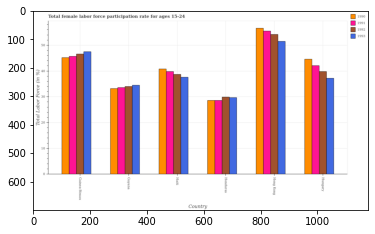

Number of QA =  30





,Country,1992,1993,1991,1990
0,Haitt,38.782697,37.750765,39.690912,41.045763
1,Guyana,34.029057,34.482156,33.645784,33.445013
2,Guinea-Bissau,46.615991,47.657750,45.714933,45.272222
3,Honduras,29.977299,29.792670,28.893861,28.689028
4,Hong Kong,54.232082,51.562450,55.375384,56.752905
5,Hungary,39.864745,37.251340,41.997643,44.563914


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1993 in guyana and that in hungary ?
PREDICTED =  -2.7691839229911324
EXPECTED =  -2.700000762939503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1992 in haiti and the female labor force participation rate in 1993 in guyana?
PREDICTED =  -4.051757715002992
EXPECTED =  4.200000762939503




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate of/in 1990 and female labor force participation rate of/in 1991 in hong kong?
PRED

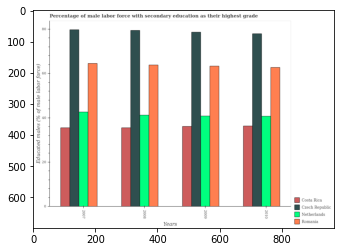

Number of QA =  30





,Years,Romania,Czech Republic,Costa Rica,Netherlands
0,2009,63.733284,79.149770,36.523691,41.331244
1,2008,64.266815,80.096009,35.982867,41.025439
2,2010,63.182260,79.085433,36.747854,41.237345
3,2007,65.239418,80.877639,35.954857,43.086583


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with secondary education in netherlands in 2009 and that in 2010 ?
PREDICTED =  0.09389871022339946
EXPECTED =  0.09999847412099427




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with secondary education in romania in 2008 and the percentage of male labor force with secondary education in costa rica in 2010?
PREDICTED =  1.084555695005868
EXPECTED =  27.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of male labor force with secondary educati

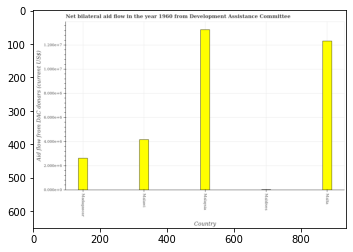

Number of QA =  22





,Country,Aid flow from DAC donars (current US$)
0,Maldives,0.008008
1,Madagascar,0.268413
2,Malaysia,1.337517
3,Malta,1.237638
4,Malawi,0.422720


> what is the title of the graph ?
PREDICTED =  Net bilateral aid flow in the year 1960 from Development Assistance Committee
EXPECTED =  Net bilateral aid flow in the year 1960 from Development Assistance Committee




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Aid flow from DAC donars (current US$)
EXPECTED =  Aid flow from DAC donars (current US$)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows from dac donors in malawi and malaysia ?
PREDICTED =  -0.9147964720588178
EXPECTED =  -9110000.0




				 3 / 4 = 0.75


> what is the median net bilateral aid flows from dac donors ?
PREDICTED =  None
EXPECTED =  4160000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_availabl

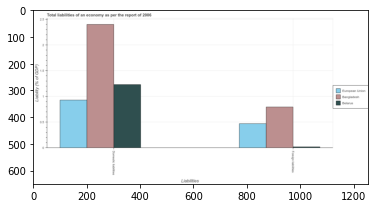

Number of QA =  23





,Liabilities,Belarus,Bangladesh,European Union
0,Domestic tabdities,1.230865,2.393434,0.937136
1,Foreign liabilities,0.025446,0.799819,0.476890


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities in bangladesh and the incurrence of domestic liabilities in european union?
PREDICTED =  0.32292943278220815
EXPECTED =  -0.13461914357459992




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the incurrence of foreign liabilities in belarus to that in european union ?
PREDICTED =  0.05335788960944785
EXPECTED =  0.04207547494487599




				 0 / 4 = 0.0


> 

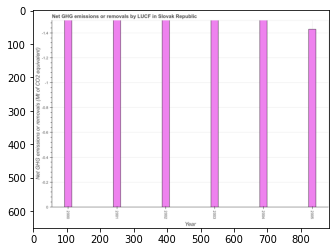

Number of QA =  12





,Year,Net GHG emissions or removals (Mt of CO2 equivalent)
0,2000,1.521011
1,2003,1.521792
2,2004,1.520421
3,2005,1.443069
4,2001,1.522829
5,2002,1.518816


> what is the title of the graph ?
PREDICTED =  Net GHG emissions or removals by LUCF in Slovak Republic
EXPECTED =  Net GHG emissions or removals by LUCF in Slovak Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  Net GHG emissions or removals (Mt of CO2 equivalent)




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ghg net emissions or removals ?
PREDICTED =  1.5207159009296476
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the y-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  0.19999999999999996




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: Fa

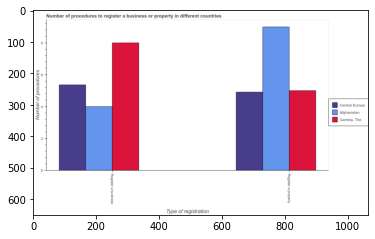

Number of QA =  23





,Type of registration,"Gambia, The",Central Europe,Afghanistan
0,Register a business,8.027131,5.403055,4.042027
1,Register a property,5.051127,4.946382,9.050095


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a property in gambia, the and that in afghanistan ?
PREDICTED =  0.0
EXPECTED =  -4.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a business in central europe and the number of procedures to register a property in afghanistan?
PREDICTED =  0.0
EXPECTED =  -3.6363636363636402




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to register a property and number of procedures to register a business in gambia, the ?
PREDICTED =  -1.0
EXPECTED =  -3.0




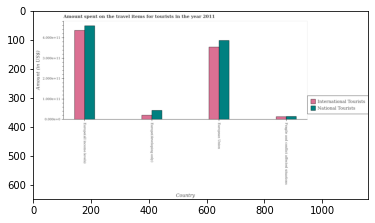

Number of QA =  28





,Country,International Tourists,National Tourists
0,European Union,3.555249,3.868689
1,Europe(all income levels),4.361987,4.573286
2,Europe( developing only),0.232916,0.470140
3,Fragile and conflict affected situations,0.166574,0.172512


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of national tourists in europe(developing only) and that in european union ?
PREDICTED =  -3.322333252025676
EXPECTED =  -342869159045.82




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in european union and the amount spent on travel items of national tourists in europe(all income levels)?
PREDICTED =  -0.8067382861147707
EXPECTED =  -104474661506.40503




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international touri

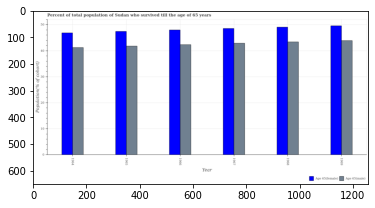

Number of QA =  28





,Year,Age 65(male),Age 65(female)
0,1967,42.685644,48.393507
1,1965,41.622578,47.095633
2,1969,43.741636,49.246918
3,1968,43.249498,48.800854
4,1966,42.281472,47.594911
5,1964,40.923816,46.596861


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in 1965 and that in 1969 ?
PREDICTED =  -2.119057937724804
EXPECTED =  -2.118309999999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in 1964 and the percentage of female population who survived till age of 65 in 1966?
PREDICTED =  -1.3576564980659924
EXPECTED =  -1.1099299999999985




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1966, what is the difference between the percentage of male population who survived till age of 65 and percenta

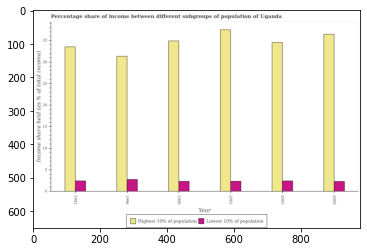

Number of QA =  28





,Year,Lowest 10% of population,Highest 10% of population
0,2009,2.409886,36.300764
1,1996,2.857206,31.077271
2,1992,2.541319,33.336102
3,2002,2.467615,37.275917
4,2005,2.539647,34.262813
5,1999,2.467443,34.578052


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in 1999 and that in 2009 ?
PREDICTED =  0.0575569171936432
EXPECTED =  0.020000000000000018




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by lowest 10% of the population in 1992 and the income share held by highest 10% of the population in 1999?
PREDICTED =  0.0738755926470609
EXPECTED =  0.11000000000000032




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the income share held by lowest 10% of the population and income share held by highest 10% of the 

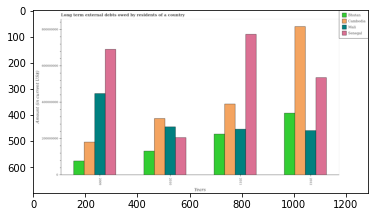

Number of QA =  30





,Years,Cambodia,Senegal,Bhutan,Mali
0,2012,8.202720e+08,5.409815e+08,3.430262e+08,2.482558e+08
1,2009,1.823858e+08,6.931816e+08,7.907330e+07,4.475401e+08
2,2010,3.121398e+08,2.071790e+08,1.338940e+08,2.661106e+08
3,2011,3.929063e+08,7.746333e+08,2.272145e+08,2.545091e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of long-term external debts owed by residents in cambodia in 2009 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  -635676000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of long-term external debts owed by residents in mali in 2010 and the amount of long-term external debts owed by residents in bhutan in 2012?
PREDICTED =  266110585.37050182
EXPECTED =  -75355000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount of long-term external debts owed by residents in senegal and amount of long-term

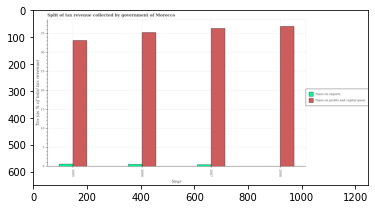

Number of QA =  28





,Year,Taxes on profits and capital gains,Taxes on exports
0,2008,36.691909,NaN
1,2006,34.958345,0.671695
2,2005,32.753295,0.739956
3,2007,36.227055,0.586979


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capital gains in 2005 and that in 2006 ?
PREDICTED =  1.733563007476576
EXPECTED =  -2.087146400684297




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on exports in 2008 and the percentage of revenue obtained from taxes on profits and capital gains in 2006?
PREDICTED =  -0.6716954695546651
EXPECTED =  -0.508637039997158




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of revenue obtained from taxes on exports 

In [ ]:
# IMAGE_IDs = list(map(str, plot_types["hbar_categorical"][:5]))
# NO_CSV = 2

# IMAGE_IDs = []
# files = random.sample(csvs, NO_CSV)
# for f in files:
#   w = f.split("/content/final_csv/")[-1]
#   IMAGE_IDs.append(w.split(".csv")[0])

per_img_data_v = []
IMG_COUNT = 0
for TEST_IMG in v_IMAGE_IDs:

  TOTAL_QA = 0
  TOTAL_CORRECT_QA = 0
  
  IMG_COUNT += 1
  print("Image number = ", IMG_COUNT)
  print("\n\n")
  
  IMAGE_ID = TEST_IMG

  ind, plotqa_questions, plotqa_answers = display_image_qa_pairs(IMAGE_ID)

  df = pd.read_csv('/home/pessat/Capstone/plotqa/TEST/final_csv/' + IMAGE_ID + '.csv')
  

  dic_labels = dict()
  for col in df.columns:
    if col == 'xlabel':
      dic_labels['xlabel'] = df['xlabel'].iloc[-1].strip()
    elif col == 'ylabel':
      dic_labels['ylabel'] = df['ylabel'].iloc[-1].strip()
    elif col == 'title':
      dic_labels['title'] = df['title'].iloc[-1].strip()
  

  df.drop(axis = 1 , labels = ['Unknown' , 'xlabel' , 'ylabel' ,'title' , 'legend orientation'] , inplace= True, errors = 'ignore')
  columns = list(df.columns)

  display(df)

  data = get_list_of_list('/home/pessat/Capstone/plotqa/TEST/final_csv/' + IMAGE_ID + '.csv', False)

  question_answer = dict()
  for i, q in enumerate(plotqa_questions):
      question_answer[q.lower()] = plotqa_answers[i]

  questions = plotqa_questions    

  tapas_questions, tabfact_questions = binary_classifier_predict(questions)
  tapas_find_answers(tapas_questions, columns, data, question_answer, dic_labels)
  tabfact_find_answers(data, tabfact_questions, columns, question_answer) 

  ACCURACY = round(TOTAL_CORRECT_QA * 100 / TOTAL_QA, 4)
  per_img_data_v.append([TEST_IMG, TOTAL_CORRECT_QA, TOTAL_QA, ACCURACY])

In [ ]:
per_img_data_v

[['27406', 16, 28, 57.1429],
 ['26494', 14, 27, 51.8519],
 ['28350', 6, 18, 33.3333],
 ['31519', 8, 18, 44.4444],
 ['32262', 11, 22, 50.0],
 ['24555', 12, 28, 42.8571],
 ['25789', 11, 28, 39.2857],
 ['28740', 9, 30, 30.0],
 ['22788', 12, 27, 44.4444],
 ['31806', 13, 23, 56.5217],
 ['31328', 8, 18, 44.4444],
 ['22978', 9, 27, 33.3333],
 ['33313', 13, 23, 56.5217],
 ['27060', 18, 27, 66.6667],
 ['22827', 9, 27, 33.3333],
 ['22453', 7, 23, 30.4348],
 ['23963', 10, 28, 35.7143],
 ['29659', 7, 30, 23.3333],
 ['33403', 16, 24, 66.6667],
 ['25073', 9, 29, 31.0345],
 ['31785', 10, 24, 41.6667],
 ['28451', 4, 29, 13.7931],
 ['26629', 5, 17, 29.4118],
 ['31215', 9, 28, 32.1429],
 ['33421', 15, 23, 65.2174],
 ['32836', 11, 24, 45.8333],
 ['23616', 9, 27, 33.3333],
 ['30731', 9, 29, 31.0345],
 ['26178', 8, 17, 47.0588],
 ['26079', 7, 17, 41.1765],
 ['23837', 8, 16, 50.0],
 ['29746', 7, 18, 38.8889],
 ['25773', 4, 17, 23.5294],
 ['33111', 14, 22, 63.6364],
 ['28696', 3, 18, 16.6667],
 ['23664', 12,

In [ ]:
df_ver_per_img = pd.DataFrame(per_img_data_v, columns=["Image ID", "Correct QA", "Total QA", "Accuracy"])
df_ver_per_img

,Image ID,Correct QA,Total QA,Accuracy
0,27406,16,28,57.1429
1,26494,14,27,51.8519
2,28350,6,18,33.3333
3,31519,8,18,44.4444
4,32262,11,22,50.0000
...,...,...,...,...
1495,23753,10,27,37.0370
1496,23062,12,27,44.4444
1497,23552,8,27,29.6296
1498,30871,9,29,31.0345


In [ ]:
print(f"AVERAGE ACCURACY FOR VERTICAL IMGS = {round(df_ver_per_img['Accuracy'].mean(), 4)} %")

AVERAGE ACCURACY FOR VERTICAL IMGS = 41.4942 %


## Save the results

In [ ]:
df_ver_per_img.to_csv("/home/pessat/Capstone/vertical_1500.csv", encoding='utf-8', index=False)